# Model_Evaluation
In this notebook, We'll run down the steps used to validate the model.
First and foremost, we need to start by importing the data and then determining which of the data we can resonably expect to use. 

In [18]:
import os
import sys
sys.path.append('../src/')
import numpy as np
import pandas as pd
import geopandas as gpd
import shapely
import matplotlib.pyplot as plt
import shapely.plotting as shapeplt
import pyogrio as pio
import KC_Query_Tools as kqt
from reRoute_Dynamics import Geography_Tools as gt
from reRoute_Dynamics import Object_Params as op
from reRoute_Dynamics import Trip_Simulator as ts
from reRoute_Dynamics import Instance_Tools as it
import multiprocessing
import warnings

import importlib
importlib.reload(gt)
importlib.reload(op)
importlib.reload(ts)
importlib.reload(it)
importlib.reload(kqt)


# Map path
map_path = '/media/sebastian/Sindri/KC_Map/map/Incorporated_Areas_of_King_County___citydst_area.shp'
#map_path = 'D:/KC_Map/map/Incorporated_Areas_of_King_County___citydst_area.shp'

# Use the ridership data to get expected unique riders for a given route, period, and direction!
ridership_data_path = './KC_Example_Data/KC_Route_Data/Ridership/Ridership.csv'

# path for the bus route to bus type indexing:
live_data_index_path = './KC_Example_Data/Misc/bus_time_tracking2.csv'

# route data and save directories
route_data_dir = "./KC_Example_Data/KC_Route_Data/"
bound_data = "./KC_Example_Data/KC_Route_Data/Bound_Data/"

dsm_raster_path = "/media/sebastian/Sindri/Raster_data/KC_West_2021/dsm/"
#dsm_raster_path = "D:/Raster_data/KC_West_2021/dsm/"

route_savepath = './KC_Example_Data/Saved_Routes/'

# Bus, ESS, and Trip paths:
bus_save_path = "./KC_Example_Data/Saved_Objects/Busses/"
bus_path = bus_save_path + "XDE35.txt"

ESS_save_path = "./KC_Example_Data/Saved_Objects/ESSes/"
ESS_path = ESS_save_path + "XDE35_ESS.txt"

trip_save_path = "./KC_Example_Data/Saved_Objects/Trips/"
trip_path = trip_save_path + "base_XDE35_trip.txt"

seed_list = np.arange(0, 5, 1)
render_params = (10, 3)

In [19]:
def blank_kc_canvas():
    '''
    Plotting method to setup a blank canvas in EPSG:4326 with a map of king county.
    '''
    fig, ax = plt.subplots(1,1,figsize=(10, 10), dpi = 100)
    king_county_map = gpd.read_file(map_path).to_crs(epsg=4326)
    king_county_map.plot(ax=ax, zorder=1, color='#BDBDBD')
    ax.set_xlim(-122.6, -121.0)
    ax.set_ylim(47.05, 47.81)
    return fig, ax

def bind_geodata(data, bounds, how = 'intersects'):
    '''
    bind_geodata takes a shapely polygon as bounds and then returns only the data that
    is bound within those boundaries. You can specify the kind of binding preferred.
    
    Params:
    data - dataframe with at least one 'geometry' column
    bounds - shapely polygon
    how - binding specification. Defualt 'intersects'.
    
    Returns:
    dataframe filtered to that which is contained in the bounds. 
    '''
    if how == 'intersects':
        data['bound'] = data.apply(lambda x: bounds.intersects(x.geometry), axis=1)
        bound_data = data[data['bound'] == True]
        return bound_data
    elif how == 'contains':
        data['bound'] = data.apply(lambda x: bounds.contains(x.geometry), axis=1)
        bound_data = data[data['bound'] == True]
        return bound_data
    else:
        data['bound'] = data.apply(lambda x: bounds.intersects(x.geometry), axis=1)
        bound_data = data[data['bound'] == True]
        return bound_data

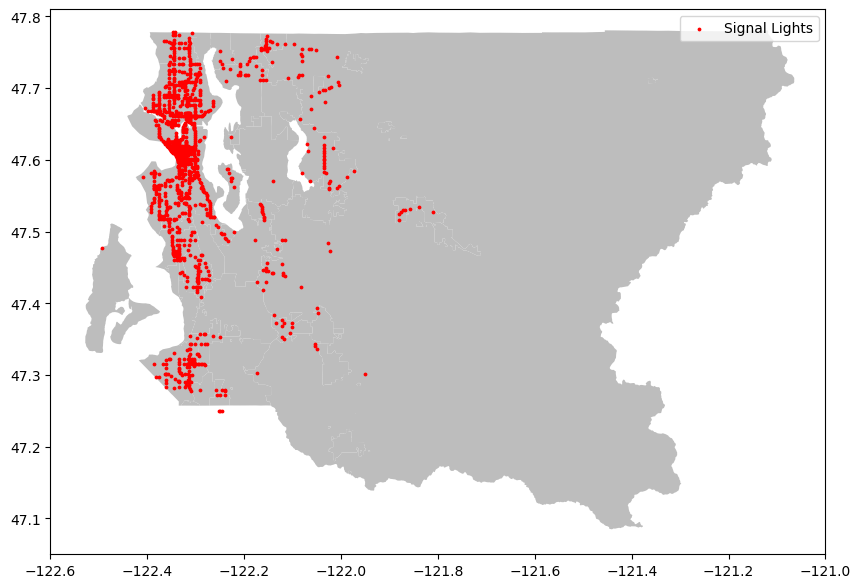

In [20]:
# Load and plot all king county and seattle signals. 

kc_sig = gpd.read_file(route_data_dir + "Signals/KC_Signals.shp")
sea_sig = gpd.read_file(route_data_dir + "Signals/Traffic_Signals.shp")

catsea_sig = sea_sig.filter(['UNITID','geometry'])
catsea_sig['geometry'] = catsea_sig.apply(lambda x: shapely.Point(x['geometry'].geoms[0]),axis=1)
catkc_sig = kc_sig.filter(['SignalID','geometry'])
catsea_sig = catsea_sig.rename(columns={"UNITID":"SIGNAL_ID"})
catsea_sig['SIGNAL_ID'] = catsea_sig['SIGNAL_ID'].apply(lambda x: x if type(x) == type(1) else int(x.split("-")[1])*113)
signals = gpd.GeoDataFrame(pd.concat([catsea_sig,catkc_sig]))

fig, ax = blank_kc_canvas()
signals.plot(ax=ax, c='red',markersize=3, zorder=5)
ax.legend(["Signal Lights"])
plt.show()

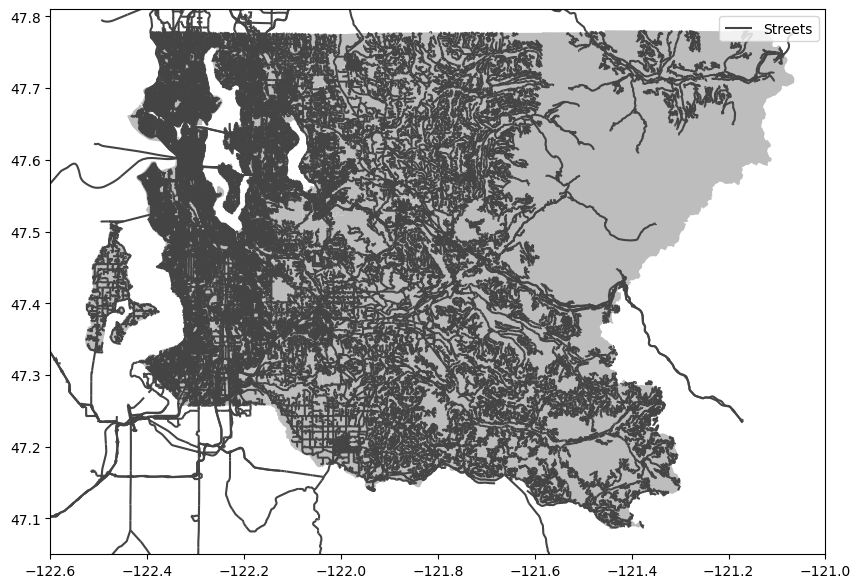

In [21]:
# Load and plot all street data.
kc_lim = pio.read_dataframe(route_data_dir +"Seattle_Streets/KCM_Streets.shp")
fig, ax = blank_kc_canvas()
kc_lim.plot(ax=ax, color='#444444')
ax.legend(["Streets"])
plt.show()

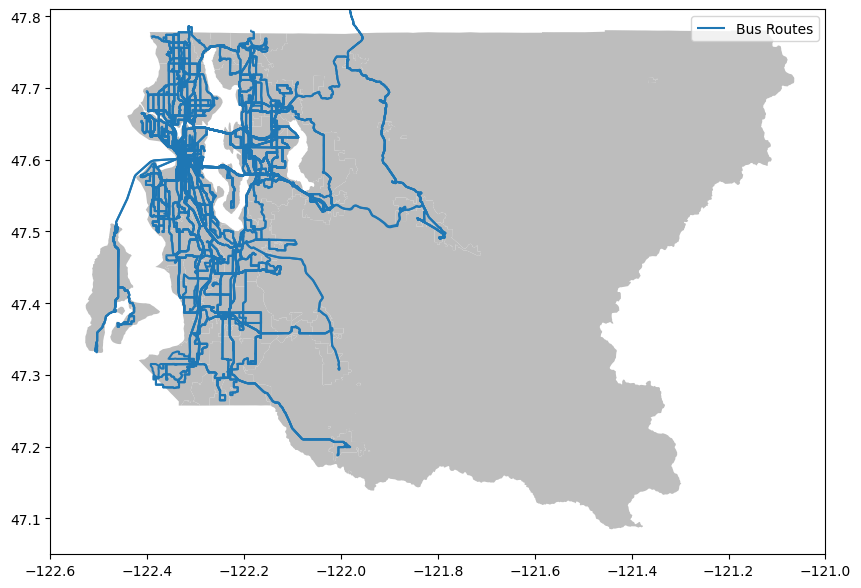

In [22]:
# Load and plot the bus routes.

shapes = pd.read_csv(route_data_dir + "shapes.txt").groupby('shape_id')

data = []
for shape in shapes.groups:
    shape_data = shapes.get_group(shape)
    geometry = shape_data.apply(lambda x: shapely.Point(x['shape_pt_lon'], x['shape_pt_lat']), axis=1)
    data.append({'shape':shape,'geometry':shapely.LineString(geometry)})
shape_routes = gpd.GeoDataFrame(data).set_crs(epsg=4326)

fig, ax = blank_kc_canvas()
shape_routes.plot(ax=ax)
ax.legend(["Bus Routes"])
plt.show()

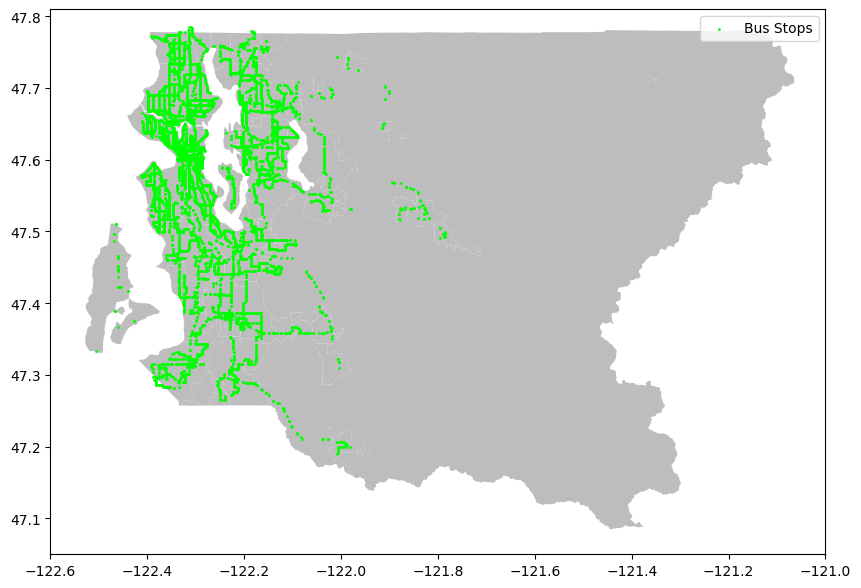

In [23]:
# Load and plot the bus stops.

bus_stops = pd.read_csv(route_data_dir + "stops.txt")
bus_stops['geometry']=bus_stops.apply(lambda x: shapely.Point(x['stop_lon'],x['stop_lat']), axis=1)
bus_stops = gpd.GeoDataFrame(bus_stops.filter(['stop_id','geometry'])).set_crs(epsg=4326)

fig, ax = blank_kc_canvas()
bus_stops.plot(ax=ax, color="lime", zorder = 10, markersize=1)
ax.legend(["Bus Stops"])
plt.show()

Now that we have the available data, we can figure out what a reasonably boundary on this data is based on what exists and what doesn't. Eyeballing it, we can create a rectangle with the corners described below:

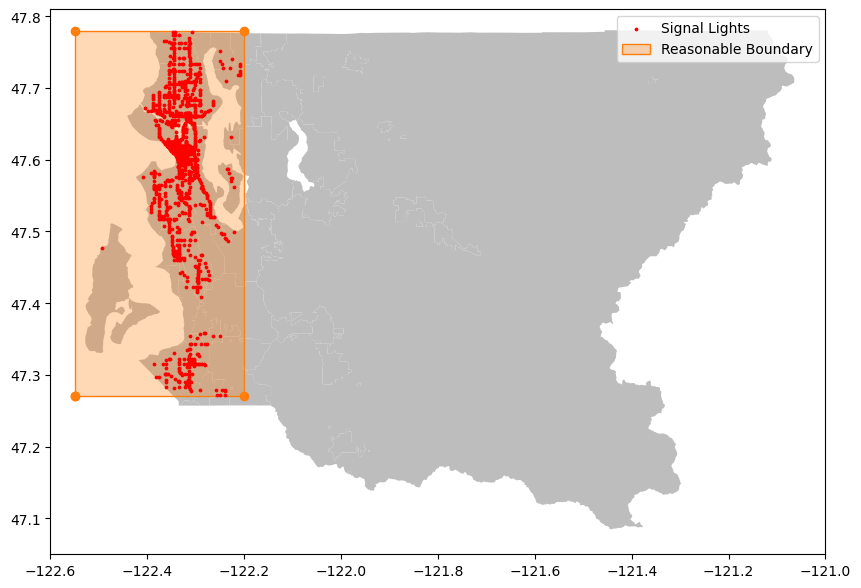

In [24]:
# Demonstrate the bounds fit the data decently enough, then plot
corners = shapely.LineString([(-122.55,47.78),(-122.2,47.27)])
bounds = gt.get_bounding_box(corners)
fig, ax = blank_kc_canvas()
bound_signals = bind_geodata(signals, bounds)
bound_signals.to_file(route_data_dir+"Signals/bound_KCM_signals.shp", driver='ESRI Shapefile')
bound_signals.plot(ax=ax, c='red',markersize=3, zorder=5)
shapeplt.plot_polygon(bounds, ax=ax, color='tab:orange')
ax.legend(["Signal Lights","Reasonable Boundary"])
plt.show()

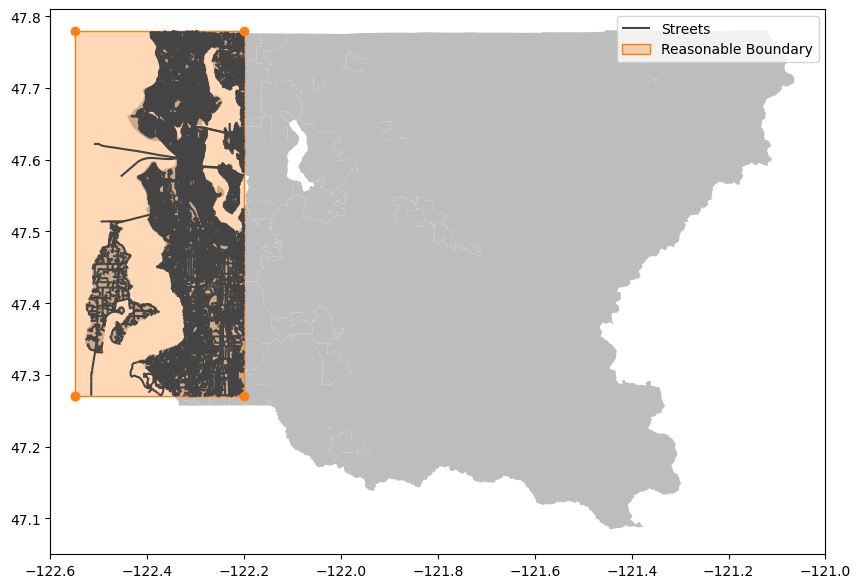

In [25]:
# re-plot with bounds
fig, ax = blank_kc_canvas()
bound_kc_lim = bind_geodata(kc_lim, bounds, how='contains')
bound_kc_lim = bound_kc_lim.filter(['SPEED_LIM', "geometry"])
bound_kc_lim.to_file(route_data_dir+"Seattle_Streets/bound_KCM_Streets.shp", driver='ESRI Shapefile')
bound_kc_lim.plot(ax=ax, color='#444444')
shapeplt.plot_polygon(bounds, ax=ax, color='tab:orange')
ax.legend(["Streets","Reasonable Boundary"])
plt.show()

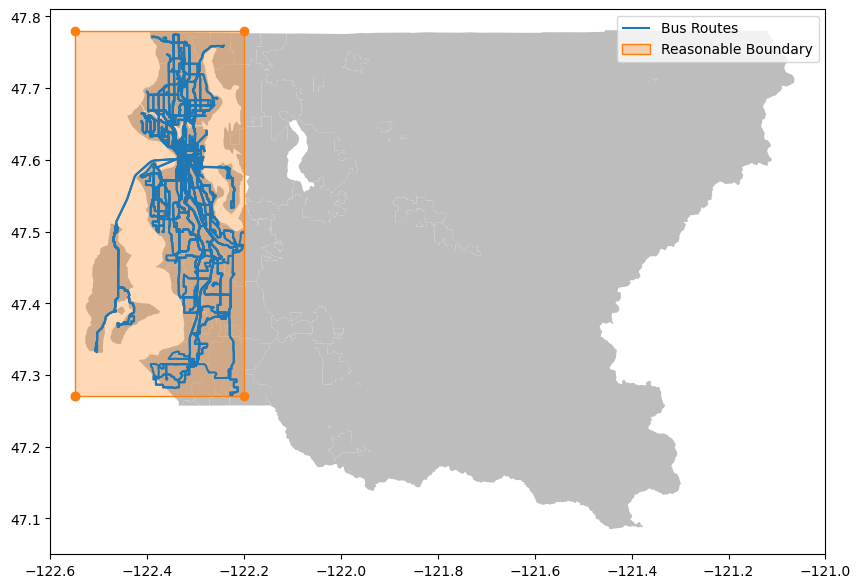

In [26]:
# re plot the routes with the bounds.
fig, ax = blank_kc_canvas()
bound_shape_routes = bind_geodata(shape_routes, bounds, how='contains')
bound_shape_routes.plot(ax=ax)
shapeplt.plot_polygon(bounds, ax=ax, color='tab:orange')
ax.legend(["Bus Routes","Reasonable Boundary"])
plt.show()

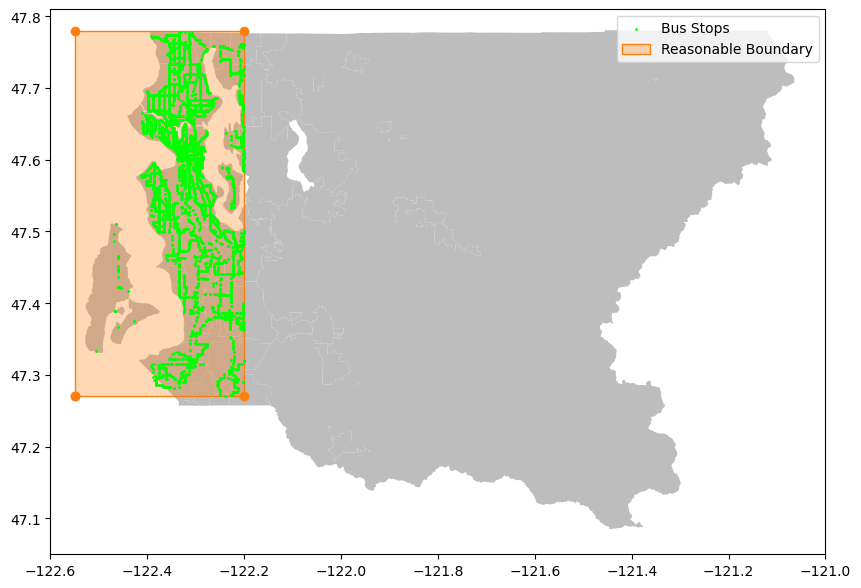

In [27]:
# Re-plot the routes with bounds
fig, ax = blank_kc_canvas()
bound_bus_stops = bind_geodata(bus_stops, bounds)
bound_bus_stops.plot(ax=ax, color="lime", zorder = 10, markersize=1)
shapeplt.plot_polygon(bounds, ax=ax, color='tab:orange')
ax.legend(["Bus Stops", "Reasonable Boundary"])
plt.show()

With the data now confined to what is reasonably expected, we need to take the next steps to generate our model, including formatting the ridership data, and determining which routes we have rider data for.

In [28]:
# extract ridership data for full factorial combinations
formatted_rider_data = kqt.calculate_expected_ridership(ridership_data_path)

# And also get all the routes with ridership data while converting the values to string for inter-operability.
route_options = list(pd.Series(formatted_rider_data['rt'].unique()).apply(str))

Now, we can add another filtration step to filter out the routes that are within the defined 'reasonable boundary', as well as if we have all the data we need for that route.

In [29]:
# Get all the route ids based on the routes in the bounds
route_ids = []
for option in route_options:
    try:
        route_id = kqt.query_route_id(option, route_data_dir + "routes.txt")
        shapes = kqt.query_possible_shapes(route_id, route_data_dir+"trips.txt")
        route_ids.append({"shortname":option,"route_id":route_id, "shape":shapes, "direction":[0,1]})
        
    except: 
        print("{} not found.".format(option))
route_ids = pd.DataFrame(route_ids)

15 not found.
18 not found.
19 not found.
26 not found.
29 not found.
37 not found.
41 not found.
47 not found.
55 not found.
63 not found.
64 not found.
71 not found.
73 not found.
74 not found.
76 not found.
77 not found.
78 not found.
114 not found.
116 not found.
120 not found.
121 not found.
122 not found.
123 not found.
143 not found.
154 not found.
157 not found.
158 not found.
159 not found.
164 not found.
166 not found.
167 not found.
169 not found.
178 not found.
179 not found.
180 not found.
186 not found.
190 not found.
192 not found.
197 not found.
200 not found.
201 not found.
214 not found.
216 not found.
217 not found.
219 not found.
232 not found.
234 not found.
235 not found.
236 not found.
237 not found.
238 not found.
243 not found.
244 not found.
248 not found.
252 not found.
268 not found.
277 not found.
301 not found.
304 not found.
308 not found.
309 not found.
312 not found.
316 not found.
330 not found.
342 not found.
347 not found.
355 not found.
373 not foun

In [30]:
importlib.reload(op)
# make unique rows per shape
route_shapes = route_ids.explode("shape").reset_index(drop=True)

# get the shapes within the bounds
bound_route_options = route_shapes[route_shapes['shape'].isin(bound_shape_routes['shape'].unique())].reset_index(drop=True)
# Create rows for each option
bound_route_options = bound_route_options.explode("direction")

# Load the paths up.
bound_route_options['path'] = bound_route_options.apply(lambda x: route_savepath + 'rt{}_sh{}_d{}.json'.format(x.shortname, x['shape'], x['direction']),axis=1)
bound_route_options = bound_route_options.reset_index(drop=True)

# Load the ridership data
formatted_rider_data = kqt.calculate_expected_ridership(ridership_data_path)
formatted_rider_data['io']=formatted_rider_data['io'].apply(lambda x: 0 if x=='I' else 1)

# Get period ridership for each route option
bound_route_options['rider_dict'] = bound_route_options.apply(lambda x: kqt.get_ridership(x.shortname, x.direction, formatted_rider_data), axis=1)

# Read the bus live data tracking info to determine which bus type is associated with a given route. 
timelog= pd.read_csv(live_data_index_path)

# load up the individual bus types
timelog['btype'] = timelog[timelog.apply(lambda x: len(x['bus']), axis=1) == 4].apply(lambda x: kqt.bus_type_finder(int(x.bus)), axis=1)

# Pass the bus types to each route instance
bound_route_options['bus'] = bound_route_options.apply(lambda x: timelog.groupby('rt').get_group(x['route_id'])['btype'].unique() if x['route_id'] in timelog.groupby('rt').groups else ["NA"], axis=1)

# create individual instances for each bus type a route can take
bound_route_options = bound_route_options.explode('bus').reset_index(drop=True)

# Remove any instances with No bus model information
prepped_routes = bound_route_options[bound_route_options['bus'].apply(lambda x: x != "NA")].reset_index(drop=True)

# Conver busses to bus object paths
prepped_routes['bus'] = prepped_routes['bus'].apply(lambda x: bus_save_path + '{}.txt'.format(x))

# Set up the minimum and maximum for ridership
prepped_routes['ridership_min_max'] = prepped_routes['rider_dict'].apply(lambda x: {k: v for d in x for k, v in d.items()}.values())
prepped_routes['ridership_min_max'] = prepped_routes['ridership_min_max'].apply(lambda x: (min(x), max(x)))

prepped_routes = prepped_routes.reset_index(drop=True)


In [31]:
DTM_rasters_list= gt.get_rasterfiles(dsm_raster_path)

DTM_rasters_list = DTM_rasters_list[DTM_rasters_list.apply(lambda x: 'reproject' in x) == False].reset_index(drop=True)
            
reprojected_DTMs = gt.reproject_rasterfiles(DTM_rasters_list, verbose=True)

[13:52:14.583895 -- Geography_Tools.reproject_rasterfiles()] Reprojecting raster files to: EPSG:4326                  
[13:52:14.594009 -- Geography_Tools.reproject_rasterfiles()] Raster files succesfully reprojected.                  


In [32]:
reprojected_DTMs[0]

'/media/sebastian/Sindri/Raster_data/KC_West_2021/dsm/king_county_west_2021_dsm_90.tif_EPSG4326.tif'

In [33]:
prepped_routes['shortname'].unique()

array(['1', '2', '3', '4', '5', '7', '8', '10', '11', '12', '13', '14',
       '21', '22', '24', '27', '28', '31', '32', '33', '36', '40', '43',
       '44', '45', '48', '49', '50', '60', '62', '65', '67', '70', '75',
       '101', '106', '107', '118', '124', '125', '128', '131', '132',
       '150', '153', '156', '181', '182', '183', '187', '345', '346',
       '348', '372'], dtype=object)

And with all that filtration done, the ridership data collected, and the stops, signals, and streets associated, we can finally render out all the files we need!

In [38]:
var

('./KC_Example_Data/Saved_Routes/rt8_sh31008006_d0.json',
 ['./KC_Example_Data/Saved_Routes/.ipynb_checkpoints',
  './KC_Example_Data/Saved_Routes/rt101_sh10101004_d0.json',
  './KC_Example_Data/Saved_Routes/rt101_sh10101004_d1.json',
  './KC_Example_Data/Saved_Routes/rt101_sh21101006_d0.json',
  './KC_Example_Data/Saved_Routes/rt101_sh21101006_d1.json',
  './KC_Example_Data/Saved_Routes/rt106_sh10106002_d0.json',
  './KC_Example_Data/Saved_Routes/rt106_sh10106002_d1.json',
  './KC_Example_Data/Saved_Routes/rt106_sh10106037_d0.json',
  './KC_Example_Data/Saved_Routes/rt106_sh10106037_d1.json',
  './KC_Example_Data/Saved_Routes/rt106_sh21106108_d0.json',
  './KC_Example_Data/Saved_Routes/rt106_sh21106108_d1.json',
  './KC_Example_Data/Saved_Routes/rt107_sh10107002_d0.json',
  './KC_Example_Data/Saved_Routes/rt107_sh10107002_d1.json',
  './KC_Example_Data/Saved_Routes/rt107_sh21107003_d0.json',
  './KC_Example_Data/Saved_Routes/rt107_sh21107003_d1.json',
  './KC_Example_Data/Saved_Routes

In [35]:
var = ('./KC_Example_Data/Saved_Routes/rt8_sh31008006_d0.json', ['./KC_Example_Data/Saved_Routes/.ipynb_checkpoints', './KC_Example_Data/Saved_Routes/rt101_sh10101004_d0.json', './KC_Example_Data/Saved_Routes/rt101_sh10101004_d1.json', './KC_Example_Data/Saved_Routes/rt101_sh21101006_d0.json', './KC_Example_Data/Saved_Routes/rt101_sh21101006_d1.json', './KC_Example_Data/Saved_Routes/rt106_sh10106002_d0.json', './KC_Example_Data/Saved_Routes/rt106_sh10106002_d1.json', './KC_Example_Data/Saved_Routes/rt106_sh10106037_d0.json', './KC_Example_Data/Saved_Routes/rt106_sh10106037_d1.json', './KC_Example_Data/Saved_Routes/rt106_sh21106108_d0.json', './KC_Example_Data/Saved_Routes/rt106_sh21106108_d1.json', './KC_Example_Data/Saved_Routes/rt107_sh10107002_d0.json', './KC_Example_Data/Saved_Routes/rt107_sh10107002_d1.json', './KC_Example_Data/Saved_Routes/rt107_sh21107003_d0.json', './KC_Example_Data/Saved_Routes/rt107_sh21107003_d1.json', './KC_Example_Data/Saved_Routes/rt107_sh21107005_d0.json', './KC_Example_Data/Saved_Routes/rt107_sh21107005_d1.json', './KC_Example_Data/Saved_Routes/rt10_sh11010006_d0.json', './KC_Example_Data/Saved_Routes/rt10_sh11010006_d1.json', './KC_Example_Data/Saved_Routes/rt10_sh20010004_d0.json', './KC_Example_Data/Saved_Routes/rt10_sh20010004_d1.json', './KC_Example_Data/Saved_Routes/rt118_sh10118005_d0.json', './KC_Example_Data/Saved_Routes/rt118_sh10118005_d1.json', './KC_Example_Data/Saved_Routes/rt118_sh10118008_d0.json', './KC_Example_Data/Saved_Routes/rt118_sh10118008_d1.json', './KC_Example_Data/Saved_Routes/rt118_sh10118010_d0.json', './KC_Example_Data/Saved_Routes/rt118_sh10118010_d1.json', './KC_Example_Data/Saved_Routes/rt118_sh10118013_d0.json', './KC_Example_Data/Saved_Routes/rt118_sh10118013_d1.json', './KC_Example_Data/Saved_Routes/rt118_sh21118002_d0.json', './KC_Example_Data/Saved_Routes/rt118_sh21118002_d1.json', './KC_Example_Data/Saved_Routes/rt118_sh21118003_d0.json', './KC_Example_Data/Saved_Routes/rt118_sh21118003_d1.json', './KC_Example_Data/Saved_Routes/rt118_sh21118004_d0.json', './KC_Example_Data/Saved_Routes/rt118_sh21118004_d1.json', './KC_Example_Data/Saved_Routes/rt11_sh11011010_d0.json', './KC_Example_Data/Saved_Routes/rt11_sh11011010_d1.json', './KC_Example_Data/Saved_Routes/rt11_sh20011009_d0.json', './KC_Example_Data/Saved_Routes/rt11_sh20011009_d1.json', './KC_Example_Data/Saved_Routes/rt124_sh10124001_d0.json', './KC_Example_Data/Saved_Routes/rt124_sh10124001_d1.json', './KC_Example_Data/Saved_Routes/rt124_sh10124002_d0.json', './KC_Example_Data/Saved_Routes/rt124_sh10124002_d1.json', './KC_Example_Data/Saved_Routes/rt124_sh10124004_d0.json', './KC_Example_Data/Saved_Routes/rt124_sh10124004_d1.json', './KC_Example_Data/Saved_Routes/rt124_sh21124050_d0.json', './KC_Example_Data/Saved_Routes/rt124_sh21124050_d1.json', './KC_Example_Data/Saved_Routes/rt124_sh21124051_d0.json', './KC_Example_Data/Saved_Routes/rt124_sh21124051_d1.json', './KC_Example_Data/Saved_Routes/rt124_sh21124059_d0.json', './KC_Example_Data/Saved_Routes/rt124_sh21124059_d1.json', './KC_Example_Data/Saved_Routes/rt124_sh21124060_d0.json', './KC_Example_Data/Saved_Routes/rt124_sh21124060_d1.json', './KC_Example_Data/Saved_Routes/rt125_sh10125009_d0.json', './KC_Example_Data/Saved_Routes/rt125_sh10125009_d1.json', './KC_Example_Data/Saved_Routes/rt125_sh10125013_d0.json', './KC_Example_Data/Saved_Routes/rt125_sh10125013_d1.json', './KC_Example_Data/Saved_Routes/rt125_sh21125001_d0.json', './KC_Example_Data/Saved_Routes/rt125_sh21125001_d1.json', './KC_Example_Data/Saved_Routes/rt128_sh11128008_d0.json', './KC_Example_Data/Saved_Routes/rt128_sh11128008_d1.json', './KC_Example_Data/Saved_Routes/rt128_sh11128009_d0.json', './KC_Example_Data/Saved_Routes/rt128_sh11128009_d1.json', './KC_Example_Data/Saved_Routes/rt128_sh20128010_d0.json', './KC_Example_Data/Saved_Routes/rt128_sh20128010_d1.json', './KC_Example_Data/Saved_Routes/rt128_sh20128011_d0.json', './KC_Example_Data/Saved_Routes/rt128_sh20128011_d1.json', './KC_Example_Data/Saved_Routes/rt12_sh11012004_d0.json', './KC_Example_Data/Saved_Routes/rt12_sh11012004_d1.json', './KC_Example_Data/Saved_Routes/rt12_sh20012005_d0.json', './KC_Example_Data/Saved_Routes/rt12_sh20012005_d1.json', './KC_Example_Data/Saved_Routes/rt131_sh10131003_d0.json', './KC_Example_Data/Saved_Routes/rt131_sh10131003_d1.json', './KC_Example_Data/Saved_Routes/rt131_sh10131006_d0.json', './KC_Example_Data/Saved_Routes/rt131_sh10131006_d1.json', './KC_Example_Data/Saved_Routes/rt131_sh21131002_d0.json', './KC_Example_Data/Saved_Routes/rt131_sh21131002_d1.json', './KC_Example_Data/Saved_Routes/rt131_sh21131007_d0.json', './KC_Example_Data/Saved_Routes/rt131_sh21131007_d1.json', './KC_Example_Data/Saved_Routes/rt132_sh10132002_d0.json', './KC_Example_Data/Saved_Routes/rt132_sh10132002_d1.json', './KC_Example_Data/Saved_Routes/rt132_sh10132006_d0.json', './KC_Example_Data/Saved_Routes/rt132_sh10132006_d1.json', './KC_Example_Data/Saved_Routes/rt13_sh11013009_d0.json', './KC_Example_Data/Saved_Routes/rt13_sh11013009_d1.json', './KC_Example_Data/Saved_Routes/rt13_sh11013013_d0.json', './KC_Example_Data/Saved_Routes/rt13_sh11013013_d1.json', './KC_Example_Data/Saved_Routes/rt13_sh20013011_d0.json', './KC_Example_Data/Saved_Routes/rt13_sh20013011_d1.json', './KC_Example_Data/Saved_Routes/rt13_sh20013012_d0.json', './KC_Example_Data/Saved_Routes/rt13_sh20013012_d1.json', './KC_Example_Data/Saved_Routes/rt14_sh10014002_d0.json', './KC_Example_Data/Saved_Routes/rt14_sh10014002_d1.json', './KC_Example_Data/Saved_Routes/rt14_sh10014005_d0.json', './KC_Example_Data/Saved_Routes/rt14_sh10014005_d1.json', './KC_Example_Data/Saved_Routes/rt14_sh10014007_d0.json', './KC_Example_Data/Saved_Routes/rt14_sh10014007_d1.json', './KC_Example_Data/Saved_Routes/rt14_sh21014006_d0.json', './KC_Example_Data/Saved_Routes/rt14_sh21014006_d1.json', './KC_Example_Data/Saved_Routes/rt14_sh21014008_d0.json', './KC_Example_Data/Saved_Routes/rt14_sh21014008_d1.json', './KC_Example_Data/Saved_Routes/rt14_sh21014011_d0.json', './KC_Example_Data/Saved_Routes/rt14_sh21014011_d1.json', './KC_Example_Data/Saved_Routes/rt14_sh21014013_d0.json', './KC_Example_Data/Saved_Routes/rt14_sh21014013_d1.json', './KC_Example_Data/Saved_Routes/rt150_sh10150004_d0.json', './KC_Example_Data/Saved_Routes/rt150_sh10150004_d1.json', './KC_Example_Data/Saved_Routes/rt150_sh10150005_d0.json', './KC_Example_Data/Saved_Routes/rt150_sh10150005_d1.json', './KC_Example_Data/Saved_Routes/rt150_sh21150002_d0.json', './KC_Example_Data/Saved_Routes/rt150_sh21150002_d1.json', './KC_Example_Data/Saved_Routes/rt150_sh21150007_d0.json', './KC_Example_Data/Saved_Routes/rt150_sh21150007_d1.json', './KC_Example_Data/Saved_Routes/rt153_sh10153002_d0.json', './KC_Example_Data/Saved_Routes/rt153_sh10153002_d1.json', './KC_Example_Data/Saved_Routes/rt153_sh21153003_d0.json', './KC_Example_Data/Saved_Routes/rt153_sh21153003_d1.json', './KC_Example_Data/Saved_Routes/rt156_sh31156003_d0.json', './KC_Example_Data/Saved_Routes/rt156_sh31156003_d1.json', './KC_Example_Data/Saved_Routes/rt156_sh40156002_d0.json', './KC_Example_Data/Saved_Routes/rt156_sh40156002_d1.json', './KC_Example_Data/Saved_Routes/rt181_sh30181003_d0.json', './KC_Example_Data/Saved_Routes/rt181_sh30181003_d1.json', './KC_Example_Data/Saved_Routes/rt181_sh30181004_d0.json', './KC_Example_Data/Saved_Routes/rt181_sh30181004_d1.json', './KC_Example_Data/Saved_Routes/rt181_sh41181005_d0.json', './KC_Example_Data/Saved_Routes/rt181_sh41181005_d1.json', './KC_Example_Data/Saved_Routes/rt181_sh41181006_d0.json', './KC_Example_Data/Saved_Routes/rt181_sh41181006_d1.json', './KC_Example_Data/Saved_Routes/rt183_sh10183003_d0.json', './KC_Example_Data/Saved_Routes/rt183_sh10183003_d1.json', './KC_Example_Data/Saved_Routes/rt183_sh10183005_d0.json', './KC_Example_Data/Saved_Routes/rt183_sh10183005_d1.json', './KC_Example_Data/Saved_Routes/rt183_sh21183004_d0.json', './KC_Example_Data/Saved_Routes/rt183_sh21183004_d1.json', './KC_Example_Data/Saved_Routes/rt187_sh10187004_d0.json', './KC_Example_Data/Saved_Routes/rt187_sh10187004_d1.json', './KC_Example_Data/Saved_Routes/rt187_sh21187002_d0.json', './KC_Example_Data/Saved_Routes/rt187_sh21187002_d1.json', './KC_Example_Data/Saved_Routes/rt1_sh11001003_d0.json', './KC_Example_Data/Saved_Routes/rt1_sh11001003_d1.json', './KC_Example_Data/Saved_Routes/rt1_sh11001004_d0.json', './KC_Example_Data/Saved_Routes/rt1_sh11001004_d1.json', './KC_Example_Data/Saved_Routes/rt1_sh20001002_d0.json', './KC_Example_Data/Saved_Routes/rt1_sh20001002_d1.json', './KC_Example_Data/Saved_Routes/rt1_sh20001005_d0.json', './KC_Example_Data/Saved_Routes/rt1_sh20001005_d1.json', './KC_Example_Data/Saved_Routes/rt21_sh10021002_d0.json', './KC_Example_Data/Saved_Routes/rt21_sh10021002_d1.json', './KC_Example_Data/Saved_Routes/rt21_sh10021007_d0.json', './KC_Example_Data/Saved_Routes/rt21_sh10021007_d1.json', './KC_Example_Data/Saved_Routes/rt21_sh10021372_d0.json', './KC_Example_Data/Saved_Routes/rt21_sh10021372_d1.json', './KC_Example_Data/Saved_Routes/rt21_sh10021380_d0.json', './KC_Example_Data/Saved_Routes/rt21_sh10021380_d1.json', './KC_Example_Data/Saved_Routes/rt21_sh21021004_d0.json', './KC_Example_Data/Saved_Routes/rt21_sh21021004_d1.json', './KC_Example_Data/Saved_Routes/rt21_sh21021005_d0.json', './KC_Example_Data/Saved_Routes/rt21_sh21021005_d1.json', './KC_Example_Data/Saved_Routes/rt21_sh21021008_d0.json', './KC_Example_Data/Saved_Routes/rt21_sh21021008_d1.json', './KC_Example_Data/Saved_Routes/rt22_sh10022002_d0.json', './KC_Example_Data/Saved_Routes/rt22_sh10022002_d1.json', './KC_Example_Data/Saved_Routes/rt22_sh10022007_d0.json', './KC_Example_Data/Saved_Routes/rt22_sh10022007_d1.json', './KC_Example_Data/Saved_Routes/rt22_sh21022005_d0.json', './KC_Example_Data/Saved_Routes/rt22_sh21022005_d1.json', './KC_Example_Data/Saved_Routes/rt24_sh11024006_d0.json', './KC_Example_Data/Saved_Routes/rt24_sh11024006_d1.json', './KC_Example_Data/Saved_Routes/rt24_sh11024007_d0.json', './KC_Example_Data/Saved_Routes/rt24_sh11024007_d1.json', './KC_Example_Data/Saved_Routes/rt24_sh11024009_d0.json', './KC_Example_Data/Saved_Routes/rt24_sh11024009_d1.json', './KC_Example_Data/Saved_Routes/rt24_sh20024001_d0.json', './KC_Example_Data/Saved_Routes/rt24_sh20024001_d1.json', './KC_Example_Data/Saved_Routes/rt24_sh20024004_d0.json', './KC_Example_Data/Saved_Routes/rt24_sh20024004_d1.json', './KC_Example_Data/Saved_Routes/rt24_sh20024005_d0.json', './KC_Example_Data/Saved_Routes/rt24_sh20024005_d1.json', './KC_Example_Data/Saved_Routes/rt27_sh10027004_d0.json', './KC_Example_Data/Saved_Routes/rt27_sh10027004_d1.json', './KC_Example_Data/Saved_Routes/rt27_sh10027005_d0.json', './KC_Example_Data/Saved_Routes/rt27_sh10027005_d1.json', './KC_Example_Data/Saved_Routes/rt27_sh21027002_d0.json', './KC_Example_Data/Saved_Routes/rt27_sh21027002_d1.json', './KC_Example_Data/Saved_Routes/rt27_sh21027034_d0.json', './KC_Example_Data/Saved_Routes/rt27_sh21027034_d1.json', './KC_Example_Data/Saved_Routes/rt28_sh11028002_d0.json', './KC_Example_Data/Saved_Routes/rt28_sh11028002_d1.json', './KC_Example_Data/Saved_Routes/rt28_sh20028004_d0.json', './KC_Example_Data/Saved_Routes/rt28_sh20028004_d1.json', './KC_Example_Data/Saved_Routes/rt2_sh10002005_d0.json', './KC_Example_Data/Saved_Routes/rt2_sh10002005_d1.json', './KC_Example_Data/Saved_Routes/rt2_sh10002006_d0.json', './KC_Example_Data/Saved_Routes/rt2_sh10002006_d1.json', './KC_Example_Data/Saved_Routes/rt2_sh10002017_d0.json', './KC_Example_Data/Saved_Routes/rt2_sh10002017_d1.json', './KC_Example_Data/Saved_Routes/rt2_sh10002019_d0.json', './KC_Example_Data/Saved_Routes/rt2_sh10002019_d1.json', './KC_Example_Data/Saved_Routes/rt2_sh21002004_d0.json', './KC_Example_Data/Saved_Routes/rt2_sh21002004_d1.json', './KC_Example_Data/Saved_Routes/rt2_sh21002008_d0.json', './KC_Example_Data/Saved_Routes/rt2_sh21002008_d1.json', './KC_Example_Data/Saved_Routes/rt2_sh21002013_d0.json', './KC_Example_Data/Saved_Routes/rt2_sh21002013_d1.json', './KC_Example_Data/Saved_Routes/rt31_sh31031006_d0.json', './KC_Example_Data/Saved_Routes/rt31_sh31031006_d1.json', './KC_Example_Data/Saved_Routes/rt31_sh40031005_d0.json', './KC_Example_Data/Saved_Routes/rt31_sh40031005_d1.json', './KC_Example_Data/Saved_Routes/rt32_sh31032002_d0.json', './KC_Example_Data/Saved_Routes/rt32_sh31032002_d1.json', './KC_Example_Data/Saved_Routes/rt32_sh40032001_d0.json', './KC_Example_Data/Saved_Routes/rt32_sh40032001_d1.json', './KC_Example_Data/Saved_Routes/rt33_sh11033003_d0.json', './KC_Example_Data/Saved_Routes/rt33_sh11033003_d1.json', './KC_Example_Data/Saved_Routes/rt33_sh11033004_d0.json', './KC_Example_Data/Saved_Routes/rt33_sh11033004_d1.json', './KC_Example_Data/Saved_Routes/rt33_sh11033005_d0.json', './KC_Example_Data/Saved_Routes/rt33_sh11033005_d1.json', './KC_Example_Data/Saved_Routes/rt33_sh11033006_d0.json', './KC_Example_Data/Saved_Routes/rt33_sh11033006_d1.json', './KC_Example_Data/Saved_Routes/rt33_sh20033002_d0.json', './KC_Example_Data/Saved_Routes/rt33_sh20033002_d1.json', './KC_Example_Data/Saved_Routes/rt33_sh20033007_d0.json', './KC_Example_Data/Saved_Routes/rt33_sh20033007_d1.json', './KC_Example_Data/Saved_Routes/rt33_sh20033008_d0.json', './KC_Example_Data/Saved_Routes/rt33_sh20033008_d1.json', './KC_Example_Data/Saved_Routes/rt345_sh11345003_d0.json', './KC_Example_Data/Saved_Routes/rt345_sh11345003_d1.json', './KC_Example_Data/Saved_Routes/rt345_sh20345002_d0.json', './KC_Example_Data/Saved_Routes/rt345_sh20345002_d1.json', './KC_Example_Data/Saved_Routes/rt346_sh11346008_d0.json', './KC_Example_Data/Saved_Routes/rt346_sh11346008_d1.json', './KC_Example_Data/Saved_Routes/rt346_sh20346004_d0.json', './KC_Example_Data/Saved_Routes/rt346_sh20346004_d1.json', './KC_Example_Data/Saved_Routes/rt348_sh11348016_d0.json', './KC_Example_Data/Saved_Routes/rt348_sh11348016_d1.json', './KC_Example_Data/Saved_Routes/rt348_sh11348017_d0.json', './KC_Example_Data/Saved_Routes/rt348_sh11348017_d1.json', './KC_Example_Data/Saved_Routes/rt348_sh20348014_d0.json', './KC_Example_Data/Saved_Routes/rt348_sh20348014_d1.json', './KC_Example_Data/Saved_Routes/rt348_sh20348015_d0.json', './KC_Example_Data/Saved_Routes/rt348_sh20348015_d1.json', './KC_Example_Data/Saved_Routes/rt36_sh10036009_d0.json', './KC_Example_Data/Saved_Routes/rt36_sh10036009_d1.json', './KC_Example_Data/Saved_Routes/rt36_sh10036012_d0.json', './KC_Example_Data/Saved_Routes/rt36_sh10036012_d1.json', './KC_Example_Data/Saved_Routes/rt36_sh21036002_d0.json', './KC_Example_Data/Saved_Routes/rt36_sh21036002_d1.json', './KC_Example_Data/Saved_Routes/rt36_sh21036003_d0.json', './KC_Example_Data/Saved_Routes/rt36_sh21036003_d1.json', './KC_Example_Data/Saved_Routes/rt372_sh11372006_d0.json', './KC_Example_Data/Saved_Routes/rt372_sh11372006_d1.json', './KC_Example_Data/Saved_Routes/rt372_sh11372007_d0.json', './KC_Example_Data/Saved_Routes/rt372_sh11372007_d1.json', './KC_Example_Data/Saved_Routes/rt372_sh11372009_d0.json', './KC_Example_Data/Saved_Routes/rt372_sh11372009_d1.json', './KC_Example_Data/Saved_Routes/rt372_sh11372013_d0.json', './KC_Example_Data/Saved_Routes/rt372_sh11372013_d1.json', './KC_Example_Data/Saved_Routes/rt372_sh20372008_d0.json', './KC_Example_Data/Saved_Routes/rt372_sh20372008_d1.json', './KC_Example_Data/Saved_Routes/rt372_sh20372014_d0.json', './KC_Example_Data/Saved_Routes/rt372_sh20372014_d1.json', './KC_Example_Data/Saved_Routes/rt372_sh20372015_d0.json', './KC_Example_Data/Saved_Routes/rt372_sh20372015_d1.json', './KC_Example_Data/Saved_Routes/rt3_sh10003020_d0.json', './KC_Example_Data/Saved_Routes/rt3_sh10003020_d1.json', './KC_Example_Data/Saved_Routes/rt3_sh10003023_d0.json', './KC_Example_Data/Saved_Routes/rt3_sh10003023_d1.json', './KC_Example_Data/Saved_Routes/rt3_sh10003026_d0.json', './KC_Example_Data/Saved_Routes/rt3_sh10003026_d1.json', './KC_Example_Data/Saved_Routes/rt3_sh21003021_d0.json', './KC_Example_Data/Saved_Routes/rt3_sh21003021_d1.json', './KC_Example_Data/Saved_Routes/rt3_sh21003022_d0.json', './KC_Example_Data/Saved_Routes/rt3_sh21003022_d1.json', './KC_Example_Data/Saved_Routes/rt3_sh21003027_d0.json', './KC_Example_Data/Saved_Routes/rt3_sh21003027_d1.json', './KC_Example_Data/Saved_Routes/rt40_sh11040009_d0.json', './KC_Example_Data/Saved_Routes/rt40_sh11040009_d1.json', './KC_Example_Data/Saved_Routes/rt40_sh20040007_d0.json', './KC_Example_Data/Saved_Routes/rt40_sh20040007_d1.json', './KC_Example_Data/Saved_Routes/rt43_sh11043003_d0.json', './KC_Example_Data/Saved_Routes/rt43_sh11043003_d1.json', './KC_Example_Data/Saved_Routes/rt43_sh20043002_d0.json', './KC_Example_Data/Saved_Routes/rt43_sh20043002_d1.json', './KC_Example_Data/Saved_Routes/rt44_sh11044004_d0.json', './KC_Example_Data/Saved_Routes/rt44_sh11044004_d1.json', './KC_Example_Data/Saved_Routes/rt44_sh11044007_d0.json', './KC_Example_Data/Saved_Routes/rt44_sh11044007_d1.json', './KC_Example_Data/Saved_Routes/rt44_sh20044003_d0.json', './KC_Example_Data/Saved_Routes/rt44_sh20044003_d1.json', './KC_Example_Data/Saved_Routes/rt44_sh20044006_d0.json', './KC_Example_Data/Saved_Routes/rt44_sh20044006_d1.json', './KC_Example_Data/Saved_Routes/rt45_sh31045010_d0.json', './KC_Example_Data/Saved_Routes/rt45_sh31045010_d1.json', './KC_Example_Data/Saved_Routes/rt45_sh31045012_d0.json', './KC_Example_Data/Saved_Routes/rt45_sh31045012_d1.json', './KC_Example_Data/Saved_Routes/rt45_sh40045006_d0.json', './KC_Example_Data/Saved_Routes/rt45_sh40045006_d1.json', './KC_Example_Data/Saved_Routes/rt45_sh40045008_d0.json', './KC_Example_Data/Saved_Routes/rt45_sh40045008_d1.json', './KC_Example_Data/Saved_Routes/rt48_sh11048002_d0.json', './KC_Example_Data/Saved_Routes/rt48_sh11048002_d1.json', './KC_Example_Data/Saved_Routes/rt48_sh11048008_d0.json', './KC_Example_Data/Saved_Routes/rt48_sh11048008_d1.json', './KC_Example_Data/Saved_Routes/rt48_sh20048006_d0.json', './KC_Example_Data/Saved_Routes/rt48_sh20048006_d1.json', './KC_Example_Data/Saved_Routes/rt48_sh20048009_d0.json', './KC_Example_Data/Saved_Routes/rt48_sh20048009_d1.json', './KC_Example_Data/Saved_Routes/rt49_sh11049009_d0.json', './KC_Example_Data/Saved_Routes/rt49_sh11049009_d1.json', './KC_Example_Data/Saved_Routes/rt49_sh20049008_d0.json', './KC_Example_Data/Saved_Routes/rt49_sh20049008_d1.json', './KC_Example_Data/Saved_Routes/rt49_sh20049013_d0.json', './KC_Example_Data/Saved_Routes/rt49_sh20049013_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh10004004_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh10004004_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh10004012_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh10004012_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh10004014_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh10004014_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh10004015_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh10004015_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh10004017_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh10004017_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh21004007_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh21004007_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh21004009_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh21004009_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh21004013_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh21004013_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh21004016_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh21004016_d1.json', './KC_Example_Data/Saved_Routes/rt4_sh21004025_d0.json', './KC_Example_Data/Saved_Routes/rt4_sh21004025_d1.json', './KC_Example_Data/Saved_Routes/rt50_sh30050002_d0.json', './KC_Example_Data/Saved_Routes/rt50_sh30050002_d1.json', './KC_Example_Data/Saved_Routes/rt50_sh41050005_d0.json', './KC_Example_Data/Saved_Routes/rt50_sh41050005_d1.json', './KC_Example_Data/Saved_Routes/rt5_sh11005003_d0.json', './KC_Example_Data/Saved_Routes/rt5_sh11005003_d1.json', './KC_Example_Data/Saved_Routes/rt5_sh11005004_d0.json', './KC_Example_Data/Saved_Routes/rt5_sh11005004_d1.json', './KC_Example_Data/Saved_Routes/rt5_sh20005010_d0.json', './KC_Example_Data/Saved_Routes/rt5_sh20005010_d1.json', './KC_Example_Data/Saved_Routes/rt60_sh10060003_d0.json', './KC_Example_Data/Saved_Routes/rt60_sh10060003_d1.json', './KC_Example_Data/Saved_Routes/rt60_sh21060004_d0.json', './KC_Example_Data/Saved_Routes/rt60_sh21060004_d1.json', './KC_Example_Data/Saved_Routes/rt62_sh11062004_d0.json', './KC_Example_Data/Saved_Routes/rt62_sh11062004_d1.json', './KC_Example_Data/Saved_Routes/rt62_sh11062012_d0.json', './KC_Example_Data/Saved_Routes/rt62_sh11062012_d1.json', './KC_Example_Data/Saved_Routes/rt62_sh20062001_d0.json', './KC_Example_Data/Saved_Routes/rt62_sh20062001_d1.json', './KC_Example_Data/Saved_Routes/rt62_sh20062003_d0.json', './KC_Example_Data/Saved_Routes/rt62_sh20062003_d1.json', './KC_Example_Data/Saved_Routes/rt65_sh11065005_d0.json', './KC_Example_Data/Saved_Routes/rt65_sh11065005_d1.json', './KC_Example_Data/Saved_Routes/rt65_sh20065004_d0.json', './KC_Example_Data/Saved_Routes/rt65_sh20065004_d1.json', './KC_Example_Data/Saved_Routes/rt67_sh11067005_d0.json', './KC_Example_Data/Saved_Routes/rt67_sh11067005_d1.json', './KC_Example_Data/Saved_Routes/rt67_sh20067004_d0.json', './KC_Example_Data/Saved_Routes/rt67_sh20067004_d1.json', './KC_Example_Data/Saved_Routes/rt70_sh11070014_d0.json', './KC_Example_Data/Saved_Routes/rt70_sh11070014_d1.json', './KC_Example_Data/Saved_Routes/rt70_sh11070016_d0.json', './KC_Example_Data/Saved_Routes/rt70_sh11070016_d1.json', './KC_Example_Data/Saved_Routes/rt70_sh20070013_d0.json', './KC_Example_Data/Saved_Routes/rt70_sh20070013_d1.json', './KC_Example_Data/Saved_Routes/rt70_sh20070015_d0.json', './KC_Example_Data/Saved_Routes/rt70_sh20070015_d1.json', './KC_Example_Data/Saved_Routes/rt75_sh11075002_d0.json', './KC_Example_Data/Saved_Routes/rt75_sh11075002_d1.json', './KC_Example_Data/Saved_Routes/rt75_sh20075007_d0.json', './KC_Example_Data/Saved_Routes/rt75_sh20075007_d1.json', './KC_Example_Data/Saved_Routes/rt7_sh10007006_d0.json', './KC_Example_Data/Saved_Routes/rt7_sh10007006_d1.json', './KC_Example_Data/Saved_Routes/rt7_sh10007012_d0.json', './KC_Example_Data/Saved_Routes/rt7_sh10007012_d1.json', './KC_Example_Data/Saved_Routes/rt7_sh10007014_d0.json', './KC_Example_Data/Saved_Routes/rt7_sh10007014_d1.json', './KC_Example_Data/Saved_Routes/rt7_sh21007003_d0.json', './KC_Example_Data/Saved_Routes/rt7_sh21007003_d1.json', './KC_Example_Data/Saved_Routes/rt7_sh21007008_d0.json', './KC_Example_Data/Saved_Routes/rt7_sh21007008_d1.json', './KC_Example_Data/Saved_Routes/rt7_sh21007015_d0.json', './KC_Example_Data/Saved_Routes/rt7_sh21007015_d1.json', './KC_Example_Data/Saved_Routes/rt7_sh21007016_d0.json', './KC_Example_Data/Saved_Routes/rt7_sh21007016_d1.json'], './KC_Example_Data/KC_Route_Data/', '/media/sebastian/Sindri/Raster_data/KC_West_2021/dsm/', (10, 3, 25))
kqt.render_kc_route_file(*var)

Rendering File ./KC_Example_Data/Saved_Routes/rt8_sh31008006_d0.json
alksjdfa lksdjfhalskdjfhalskdjfhalksjdhfaa
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt8_sh31008006_d0.json


'./KC_Example_Data/Saved_Routes/rt8_sh31008006_d0.json'

In [36]:
gdf = gt.load_from_json('./KC_Example_Data/Saved_Routes/rt8_sh31008006_d0.json').to_gdf()

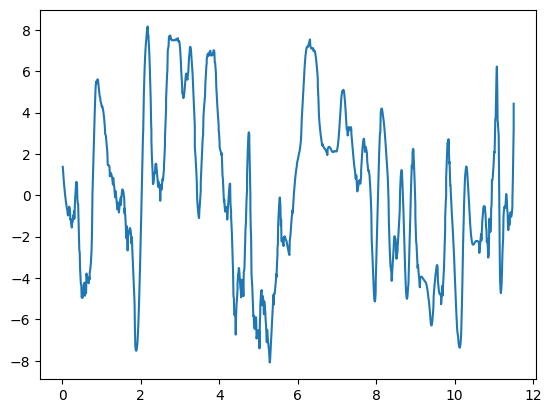

In [37]:
plt.plot(gdf['sum_travel_dx'], gdf['grade'])

In [40]:
# render the routes!!!!
importlib.reload(gt)
importlib.reload(kqt)
kqt.batch_render_kc_routes(prepped_routes['shortname'].unique(),
                           route_data_dir,
                           dsm_raster_path,
                           './KC_Example_Data/Saved_Routes/',
                           batch_size=12, verbose=True, overwrite_save=True)
     

('./KC_Example_Data/Saved_Routes/rt1_sh11001004_d0.json', ['./KC_Example_Data/Saved_Routes/.ipynb_checkpoints'], './KC_Example_Data/KC_Route_Data/', '/media/sebastian/Sindri/Raster_data/KC_West_2021/dsm/', (10, 3, 25))
Rendering File ./KC_Example_Data/Saved_Routes/rt1_sh11001003_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt1_sh11001003_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt1_sh20001002_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt1_sh11001004_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt1_sh20001002_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt1_sh20001005_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt1_sh20001005_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt2_sh21002008_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt1_sh11001004_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt2_sh21002008_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt2_sh10002005_d0.jsonRendering File ./KC_Example_Data/

Traceback (most recent call last):
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/KC_Query_Tools.py", line 336, in render_kc_route_file
    route = gt.Route(i_geo, smellev, limits=limits, stops=stops, signals=signals, signs = [-1]*len(i_geo), smooth_grades=True )
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Geography_Tools.py", line 1039, in __init__
    self.d_X = list(np.sqrt(np.asarray(self.dz)**2 + np.asarray(self.dx)**2))
                            ~~~~~~~~~~~~~~~~~~~~~~~^~~~~~~~~~~~~~~~~~~~~~~~
ValueError: operands could not be broadcast together with shapes (2737,) (2738,) 


Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt132_sh10132006_d0.json
Failed Rendering ./KC_Example_Data/Saved_Routes/rt132_sh21132003_d0.json, Error: operands could not be broadcast together with shapes (2795,) (2796,) 


Traceback (most recent call last):
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/KC_Query_Tools.py", line 336, in render_kc_route_file
    route = gt.Route(i_geo, smellev, limits=limits, stops=stops, signals=signals, signs = [-1]*len(i_geo), smooth_grades=True )
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Geography_Tools.py", line 1039, in __init__
    self.d_X = list(np.sqrt(np.asarray(self.dz)**2 + np.asarray(self.dx)**2))
                            ~~~~~~~~~~~~~~~~~~~~~~~^~~~~~~~~~~~~~~~~~~~~~~~
ValueError: operands could not be broadcast together with shapes (2795,) (2796,) 


Failed Rendering ./KC_Example_Data/Saved_Routes/rt132_sh21132007_d0.json, Error: operands could not be broadcast together with shapes (2737,) (2738,) 


Traceback (most recent call last):
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/KC_Query_Tools.py", line 336, in render_kc_route_file
    route = gt.Route(i_geo, smellev, limits=limits, stops=stops, signals=signals, signs = [-1]*len(i_geo), smooth_grades=True )
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Geography_Tools.py", line 1039, in __init__
    self.d_X = list(np.sqrt(np.asarray(self.dz)**2 + np.asarray(self.dx)**2))
                            ~~~~~~~~~~~~~~~~~~~~~~~^~~~~~~~~~~~~~~~~~~~~~~~
ValueError: operands could not be broadcast together with shapes (2737,) (2738,) 


Failed Rendering ./KC_Example_Data/Saved_Routes/rt132_sh21132003_d1.json, Error: operands could not be broadcast together with shapes (2795,) (2796,) 


Traceback (most recent call last):
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/KC_Query_Tools.py", line 336, in render_kc_route_file
    route = gt.Route(i_geo, smellev, limits=limits, stops=stops, signals=signals, signs = [-1]*len(i_geo), smooth_grades=True )
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Geography_Tools.py", line 1039, in __init__
    self.d_X = list(np.sqrt(np.asarray(self.dz)**2 + np.asarray(self.dx)**2))
                            ~~~~~~~~~~~~~~~~~~~~~~~^~~~~~~~~~~~~~~~~~~~~~~~
ValueError: operands could not be broadcast together with shapes (2795,) (2796,) 


Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt150_sh21150002_d0.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt150_sh21150002_d1.json
('./KC_Example_Data/Saved_Routes/rt150_sh21150007_d0.json', ['./KC_Example_Data/Saved_Routes/.ipynb_checkpoints'], './KC_Example_Data/KC_Route_Data/', '/media/sebastian/Sindri/Raster_data/KC_West_2021/dsm/', (10, 3, 25))
Rendering File ./KC_Example_Data/Saved_Routes/rt153_sh10153002_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt150_sh21150007_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt150_sh10150004_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt150_sh21150007_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt150_sh10150005_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt153_sh21153003_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt153_sh21153003_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt150_sh10150004_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt153_sh10153002_d1

Traceback (most recent call last):
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/KC_Query_Tools.py", line 336, in render_kc_route_file
    route = gt.Route(i_geo, smellev, limits=limits, stops=stops, signals=signals, signs = [-1]*len(i_geo), smooth_grades=True )
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Geography_Tools.py", line 1039, in __init__
    self.d_X = list(np.sqrt(np.asarray(self.dz)**2 + np.asarray(self.dx)**2))
                            ~~~~~~~~~~~~~~~~~~~~~~~^~~~~~~~~~~~~~~~~~~~~~~~
ValueError: operands could not be broadcast together with shapes (1395,) (1506,) 


Failed Rendering ./KC_Example_Data/Saved_Routes/rt182_sh10182002_d1.json, Error: operands could not be broadcast together with shapes (1395,) (1506,) 


Traceback (most recent call last):
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/KC_Query_Tools.py", line 336, in render_kc_route_file
    route = gt.Route(i_geo, smellev, limits=limits, stops=stops, signals=signals, signs = [-1]*len(i_geo), smooth_grades=True )
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Geography_Tools.py", line 1039, in __init__
    self.d_X = list(np.sqrt(np.asarray(self.dz)**2 + np.asarray(self.dx)**2))
                            ~~~~~~~~~~~~~~~~~~~~~~~^~~~~~~~~~~~~~~~~~~~~~~~
ValueError: operands could not be broadcast together with shapes (1395,) (1506,) 


Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt181_sh41181006_d1.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt181_sh41181006_d0.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt156_sh31156003_d1.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt156_sh31156003_d0.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt181_sh41181005_d1.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt181_sh41181005_d0.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt181_sh30181003_d1.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt181_sh30181003_d0.json
('./KC_Example_Data/Saved_Routes/rt182_sh21182004_d0.json', ['./KC_Example_Data/Saved_Routes/.ipynb_checkpoints'], './KC_Example_Data/KC_Route_Data/', '/media/sebastian/Sindri/Raster_data/KC_West_2021/dsm/', (10, 3, 25))
Rendering File ./KC_Example_Data/Saved_Routes/rt183_sh21183004_d1.jsonRendering File ./KC_Example_Data/Saved_Routes/rt182_sh21182004_d1.jsonRendering File ./KC_Exa

Traceback (most recent call last):
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/KC_Query_Tools.py", line 336, in render_kc_route_file
    route = gt.Route(i_geo, smellev, limits=limits, stops=stops, signals=signals, signs = [-1]*len(i_geo), smooth_grades=True )
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Geography_Tools.py", line 1039, in __init__
    self.d_X = list(np.sqrt(np.asarray(self.dz)**2 + np.asarray(self.dx)**2))
                            ~~~~~~~~~~~~~~~~~~~~~~~^~~~~~~~~~~~~~~~~~~~~~~~
ValueError: operands could not be broadcast together with shapes (1232,) (1344,) 


Failed Rendering ./KC_Example_Data/Saved_Routes/rt182_sh21182004_d0.json, Error: operands could not be broadcast together with shapes (1232,) (1344,) 


Traceback (most recent call last):
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/KC_Query_Tools.py", line 336, in render_kc_route_file
    route = gt.Route(i_geo, smellev, limits=limits, stops=stops, signals=signals, signs = [-1]*len(i_geo), smooth_grades=True )
            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Geography_Tools.py", line 1039, in __init__
    self.d_X = list(np.sqrt(np.asarray(self.dz)**2 + np.asarray(self.dx)**2))
                            ~~~~~~~~~~~~~~~~~~~~~~~^~~~~~~~~~~~~~~~~~~~~~~~
ValueError: operands could not be broadcast together with shapes (1232,) (1344,) 


Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt187_sh10187004_d0.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt187_sh10187004_d1.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt183_sh10183005_d1.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt183_sh21183004_d1.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt183_sh10183003_d1.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt183_sh10183005_d0.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt183_sh21183004_d0.json
Succesfully Rendered ./KC_Example_Data/Saved_Routes/rt183_sh10183003_d0.json
('./KC_Example_Data/Saved_Routes/rt345_sh20345002_d0.json', ['./KC_Example_Data/Saved_Routes/.ipynb_checkpoints'], './KC_Example_Data/KC_Route_Data/', '/media/sebastian/Sindri/Raster_data/KC_West_2021/dsm/', (10, 3, 25))
Rendering File ./KC_Example_Data/Saved_Routes/rt346_sh20346004_d0.jsonRendering File ./KC_Example_Data/Saved_Routes/rt345_sh11345003_d1.jsonRendering File ./KC_Exa

[[],
 ['./KC_Example_Data/Saved_Routes/rt1_sh11001004_d0.json',
  './KC_Example_Data/Saved_Routes/rt1_sh11001004_d1.json',
  './KC_Example_Data/Saved_Routes/rt1_sh20001002_d0.json',
  './KC_Example_Data/Saved_Routes/rt1_sh20001002_d1.json',
  './KC_Example_Data/Saved_Routes/rt1_sh11001003_d0.json',
  './KC_Example_Data/Saved_Routes/rt1_sh11001003_d1.json',
  './KC_Example_Data/Saved_Routes/rt1_sh20001005_d0.json',
  './KC_Example_Data/Saved_Routes/rt1_sh20001005_d1.json',
  './KC_Example_Data/Saved_Routes/rt2_sh21002008_d0.json',
  './KC_Example_Data/Saved_Routes/rt2_sh21002008_d1.json',
  './KC_Example_Data/Saved_Routes/rt2_sh10002005_d0.json',
  './KC_Example_Data/Saved_Routes/rt2_sh10002005_d1.json'],
 ['./KC_Example_Data/Saved_Routes/rt2_sh10002006_d0.json',
  './KC_Example_Data/Saved_Routes/rt2_sh10002006_d1.json',
  './KC_Example_Data/Saved_Routes/rt2_sh10002019_d0.json',
  './KC_Example_Data/Saved_Routes/rt2_sh10002019_d1.json',
  './KC_Example_Data/Saved_Routes/rt2_sh21002004_d

Here, we have one last filtration step to make sure that we have bus models prepared. 

In [41]:
# filter the routes to the available data, based on the rendered routes and rendered busses. 
available_to_run = prepped_routes[prepped_routes['path'].isin(pd.Series(os.listdir(route_savepath)).apply(lambda x: route_savepath+x))]
available_to_run = available_to_run[available_to_run['bus'].isin(pd.Series(os.listdir(bus_save_path)).apply(lambda x: bus_save_path+x))]
available_routes = available_to_run.groupby(['shortname'])
print("Available Routes to Simulate: {}".format(list(available_routes.groups.keys())))

Available Routes to Simulate: ['1', '10', '101', '107', '11', '118', '124', '131', '132', '14', '150', '21', '24', '27', '28', '3', '33', '345', '346', '348', '36', '4', '40', '45', '48', '49', '5', '50', '62', '65', '67', '70', '75', '8']


## Setting Up The Model Evaluation
This next segment is dedicated towards both running a monte carlo simulation as well as evaluating the accuracy of the model when compared to reality. 

---
First things first, we're going to need some additional methods to help process the data. 

In [42]:
def process_result_list(res_list, ess):
    '''
    Method for processing a list of outputs from ts.run_trip()
    '''
    def subprocess(res, ess):
        res = pd.DataFrame(res)
        bp = res['BP']
        volt = res['v']
        
        milage = res['dx'].sum()/1609.344 # to miles
        time_elapsed = res['dt'].sum() # in seconds
        net_en = (bp/1000*res['dt']).sum()/3600
        SOH_Loss = res['SOH_loss'].sum()
        
        return {"miles":milage,
                "kwh":net_en,
                "tot_time":time_elapsed,
                "v":volt,
                "dt":res['dt'],
                'g':res['grade'],
                'vel':res['v_f'],
                'dx':res['gdx'],
                'geo':res['geometry'],
                'P':res['P'],
                'BP':res['BP'],
                'SOH_loss':res['SOH_loss']}
    
    dat = pd.Series(res_list)
    out = dat.apply(lambda x: subprocess(x, ess))

    return out

def rsq(a, b):
    '''
    returns the r^2 value between two datasets
    '''
    # a is the raw data, b is the model
    ssres = ((a - b)**2).sum() 
    sstot = ((a-a.mean())**2).sum()
    r2 = 1 - (ssres/sstot)
    return r2

def mse(a, b):
    '''
    returns the mean squared error between two datasets
    '''
    return ((a-b)**2).mean()

def ensure_in_range(point, point_bounds):
    '''
    verifies that a point in n dimensions lies within the n bounds [(min, max) * n],
    and if it isnt, set the point to be within the bounds.
    '''
    for i in range(len(point)):
        param_bounds = point_bounds[i]
        if point[i] < min(param_bounds):
            point[i] = min(param_bounds)
        elif point[i]> max(param_bounds):
            point[i] = max(param_bounds)
        else:
            point[i]=point[i]
    return point

def calculate_statistics_from_hist(vals, bins, bcon):
    '''
    takes the three return values from a matplotlib.pyplot.hist and returns the mean and standard deviation
    of the values in the bins.
    '''
    mids = 0.5*(bins[1:] + bins[:-1])
    mean = np.average(mids, weights=vals)
    std = np.sqrt(np.average((mids-mean)**2, weights=vals))
    print("", end='\r')
    return mean, std

def load_gps_log(path):
    '''
    takes a path of a custom gps log, loads and processes it
    '''
    lines = []
    with open(path) as file:
        lines = [line.rstrip() for line in file]
    line  = lines[0]
    tser = pd.DataFrame(pd.Series(line.split("||"))[1:-1].reset_index(drop=True).apply(lambda x: (datetime.strptime(x.split("|")[0], '%m/%d/%Y %H:%M:%S'), shapely.Point(ast.literal_eval(x.split("|")[1])))))
    tser[['t','geometry']] = tser.iloc[:,0].tolist()
    tser = tser[['t', 'geometry']]
    tser['dt'] = tser['t'].diff().apply(lambda x: x.total_seconds()).shift(-1)
    tser['gdx'] = gt.query_distance_traveled(tser['geometry'])
    tser['gdx'] = tser['gdx']*1000
    tser['re'] = gt.query_elevation_series(tser['geometry'], reprojected_DSMs)*0.3048
    tser['re'] = pd.Series(gt.smooth_elevation(tser['re'],40,3))
    tser['tdx'] = tser.apply(lambda x: np.sqrt(x['gdx']**2 + x['re']**2), axis=1)
    tser = tser[:-1]
    tser['v'] = tser['gdx']/tser['dt']
    tser['v2'] = tser['tdx']/tser['dt']
    #print(rsq(tser['v'], tser['v2']))
    #print(mse(tser['v'], tser['v2']))
    return tser#[['gdx','v']]

def load_phone_log(drivepath, pathfile, timefile):
    '''
    Used to parse a phone GPS log for data. 
    '''
    ppath = (drivepath + pathfile)
    tpath = (drivepath + timefile)
    pdata = pd.read_csv(ppath)
    tdata = pd.read_csv(tpath)
    pdata['stime'] = float(tdata.iloc[0]['system time'])
    pdata['stime']+=pdata['Time (s)']

    skipdict = tdata.groupby('experiment time').groups
    timeskip_times = list(skipdict.keys())[1:-1]
    for entry in timeskip_times:
        if len(pdata[abs(pdata['Time (s)'].apply(float) - float(entry)) < .01].index) >0:
            start_index = pdata[abs(pdata['Time (s)'].apply(float) - float(entry)) < .01].index[0]
            pause_time_indexes = skipdict[entry]
            pause_time = tdata[pause_time_indexes[0]:pause_time_indexes[1]+1]['system time'].diff().iloc[-1]
            pdata.at[start_index:, 'stime'] = pdata.loc[start_index:, 'stime'] + pause_time

    pdata['dt'] = pdata['stime'].diff().shift(-1)
    pdata = pdata[pdata['dt'] > .1]
    pdata['geometry'] = pdata.apply(lambda x: shapely.Point(x['Latitude (°)'], x['Longitude (°)']), axis=1)
    pdata['gdx'] = gt.query_distance_traveled(pdata['geometry'])
    pdata['gdx'] = pdata['gdx']*1000
    pdata['re'] = gt.query_elevation_series(pdata['geometry'], reprojected_DSMs)*0.3048
    pdata['re'] = pd.Series(gt.smooth_elevation(pdata['re'],40,3))
    pdata['tdx'] = pdata.apply(lambda x: np.sqrt(x['gdx']**2 + x['re']**2), axis=1)
    pdata = pdata[:-1]
    pdata['v'] = pdata['gdx']/pdata['dt']
    pdata['v2'] = pdata['tdx']/pdata['dt']
    out=pdata[['geometry', 'dt', 'gdx', 're', 'tdx', 'v', 'v2']][1:-1]
    return out

def t_value_eqn(x1, s1, n1, x2, s2, n2):
    '''
    Performs a two-tailed t-test. 
    '''
    return (x1 - x2)/(np.sqrt(((s1**2)/n1) + ((s2**2 )/ n2)))

def parsecoord(string):
    '''
    Parses a string value of nEm and converts it to a float n*10^m
    '''
    offby = float(string.split("E")[1])
    val = float(string.split("E")[0])
    val = val*(10**offby)
    return val


In [43]:
import numpy as np
from scipy.stats import t as sci_t
#(3244,484,69)(2123,179,96)(2113,225,72)(1821,223,60)
# gps (3077.78,134.07,3)(2117.95,165.64,3)(2781.06,174.32,3)(1742.45,9.54,2)
# mc (2969.17,469.74,300)(2138.03,278.10,300)(2697.24,373.01,300)(1888.27,257.56,300)
params = (1821,223,60,1888.27,257.56,300)
tval = t_value_eqn(*params)
print(tval)
print(sci_t.sf(abs(tval), params[2] + params[5] -2 )*2)

-2.07605608094876
0.03860199792452719


Now, we begin to set up the variables and tools needed for the simulation. 

In [45]:
# Run the trip Monte Carlo Simulation for the selected Route
importlib.reload(op)
import random
from reRoute_Dynamics import Trip_Simulator as ts
import itertools
from datetime import datetime
from scipy.stats import t as sci_t
import ast
importlib.reload(random)
importlib.reload(gt)
importlib.reload(op)

seeds = np.arange(0, 300, 1)
seed_range = (0, 300)
traffic_min_max = (.1, 1)
signal_min_max = (.1, 1)
wind_speed_min_max = (0, 15)
wind_directions_min_max = (0, 360)
p_aux_min_max = (3000, 10000)
b_factors = (.1, 1)
a_factors = (0,1)
batch_size = 13
t_sigs = (1, 150)
t_stops = (20, 150)
abs_ridership = (15,60)
max_dist = (150, 400)

drivepath = "/media/sebastian/Sindri/GPS LOGS/"
#drivepath = "D:/GPS LOGS/"

subsets = [1, 2, 3]
ids = [45, 70, 8, 49]
# Set up a dictionary to contain the specific monte carlo runs of each route that align with the data collection
specific_runs = {"45":3, "8":1,"49":1,"70":5}
routes = {}

# Create each combinatiou of route and run and aquire their corresponding path
for r in itertools.product(ids,subsets):
    indiv_path = '{}-{}.txt'.format(r[0], r[1])
    alt_path = '{}-{}p.csv'.format(r[0],r[1])
    if indiv_path in os.listdir(drivepath):
        if str(r[0]) in routes.keys():
            routes[str(r[0])].append(drivepath + indiv_path)
        else:
            routes[str(r[0])]=[drivepath + indiv_path]
    elif alt_path in os.listdir(drivepath):
        routes[str(r[0])].append(drivepath + alt_path)

# Load the raster data
DSM_rasters_list= gt.get_rasterfiles(dsm_raster_path)#+ "_reproject.tif"
DSM_rasters_list = DSM_rasters_list[DSM_rasters_list.apply(lambda x: 'reproject' in x) == False].reset_index(drop=True)
reprojected_DSMs = gt.reproject_rasterfiles(DSM_rasters_list, verbose=False)


Route 45, Sample /media/sebastian/Sindri/GPS LOGS/45-1.txt: Total Runtime - 2893.0 seconds.
Route 45, Sample /media/sebastian/Sindri/GPS LOGS/45-2p.csv: Total Runtime - 3206.9812529087067 seconds.
Route 45, Sample /media/sebastian/Sindri/GPS LOGS/45-3p.csv: Total Runtime - 3133.370563030243 seconds.
Route 70, Sample /media/sebastian/Sindri/GPS LOGS/70-1.txt: Total Runtime - 2343.0 seconds.
Route 70, Sample /media/sebastian/Sindri/GPS LOGS/70-2p.csv: Total Runtime - 2061.7236328125 seconds.
Route 70, Sample /media/sebastian/Sindri/GPS LOGS/70-3p.csv: Total Runtime - 1949.1267051696777 seconds.
Route 8, Sample /media/sebastian/Sindri/GPS LOGS/8-1.txt: Total Runtime - 2673.0 seconds.
Route 8, Sample /media/sebastian/Sindri/GPS LOGS/8-2.txt: Total Runtime - 3027.0 seconds.
Route 8, Sample /media/sebastian/Sindri/GPS LOGS/8-3p.csv: Total Runtime - 2643.1898679733276 seconds.
Route 49, Sample /media/sebastian/Sindri/GPS LOGS/49-1.txt: Total Runtime - 1752.0 seconds.
Route 49, Sample /media/s

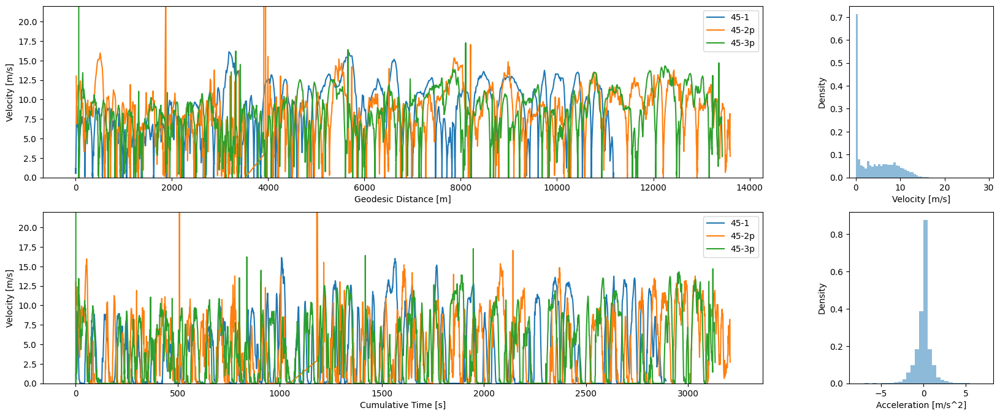

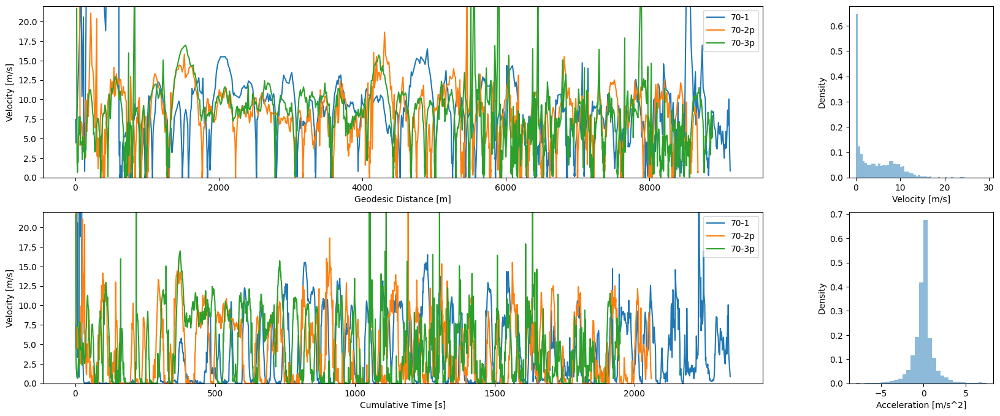

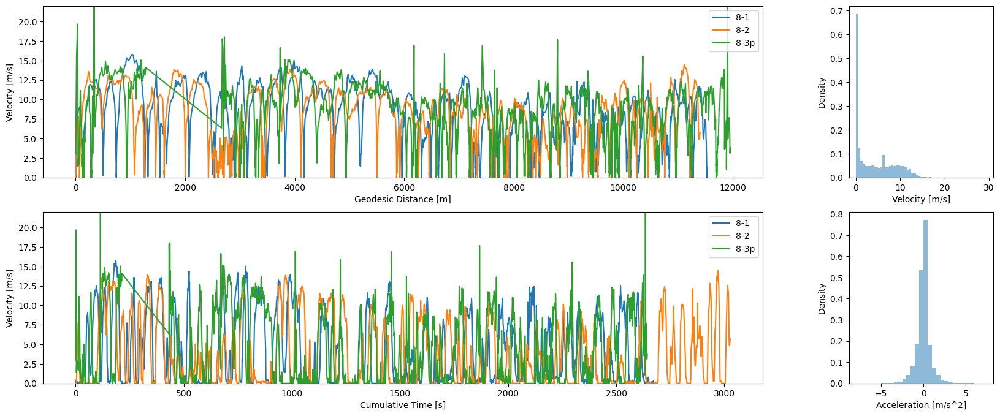

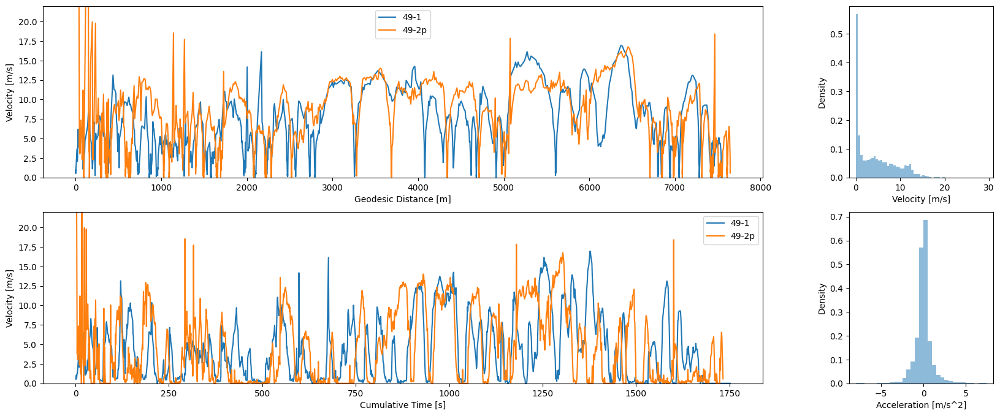

In [46]:
# Set up an empty dictionary to export the runtime statistics
stats = {}
v_hists = {}
a_hists = {}
for route_shortname in routes.keys():
    
    # Set up empty lists for the dataframes, keys, and runtimes
    totalroll = []
    key = []
    runtimes = []
    
    # Set up a plot
    fig, ax = plt.subplots(2, 2, figsize = (20, 8), dpi=100, width_ratios = [10, 2])
    
    # Loop through each sample for the current route
    for sample in routes[route_shortname][:]:
        
        # Empty variable to hold the data
        roll = None
        
        # Check which type of file it is. Depending, load them accordingly.
        if ".csv" in sample:
            roll = load_phone_log(drivepath, sample.split("/")[-1], sample.split("/")[-1].replace("p", 't'))
        else:
            roll = load_gps_log(sample)
            
        # Generate a plot of velocity versus distance and time
        ax[0, 0].plot(roll['gdx'].cumsum(), roll['v'])
        ax[1,0].plot(roll['dt'].cumsum(), roll['v'])
        roll['a']=roll['v'].diff()/roll['dt']
        
        # Add the data to the rolling data collection
        totalroll.append(roll)
        
        # Append the data sample name to the key
        key.append(sample.split("/")[-1].split(".")[0])
        
        # Print the route runtime
        print("Route {}, Sample {}: Total Runtime - {} seconds.".format(route_shortname, sample, roll['dt'].sum()))
        
        
        runtimes.append(roll['dt'].sum())
    
    
    totalroll = pd.concat(totalroll)
    
    # Set up the histogram bins
    vbins = np.arange(0, 30, .5)
    abins = np.arange(-8, 8, .5)
    tbins = np.arange(500, 6000, 100)
    
    
    vct, vbt, vp = ax[0,1].hist(totalroll['v'], alpha=.5, weights=totalroll['dt'], density=True,bins=vbins)

    act, abt, ap = ax[1,1].hist(totalroll['a'], alpha=.5, weights=totalroll['dt'], density=True,bins=abins)
    
    ax[0,0].set_xlabel("Geodesic Distance [m]")
    ax[0,0].set_ylabel("Velocity [m/s]")
    ax[0,0].legend(key)
    ax[0,0].set_ylim(0, 22)
    
    ax[1,0].set_xlabel("Cumulative Time [s]")
    ax[1,0].set_ylabel("Velocity [m/s]")
    ax[1,0].legend(key)
    ax[1,0].set_ylim(0, 22)
    
    ax[0,1].set_xlabel("Velocity [m/s]")
    ax[0,1].set_ylabel("Density")
    
    ax[1,1].set_xlabel("Acceleration [m/s^2]")
    ax[1,1].set_ylabel("Density")
    stats[route_shortname] = (np.asarray(runtimes).mean(), np.asarray(runtimes).std(), len(runtimes))
    v_hists[route_shortname] = (vct, vbt, vp)
    a_hists[route_shortname] = (act, abt, ap)

### Full sim

In [47]:
row = available_routes.get_group(('8',)).reset_index(drop=True).iloc[1, :]

In [48]:
importlib.reload(ts)
importlib.reload(op)
row = available_routes.get_group(('8',)).reset_index(drop=True).iloc[1, :]
seed = 4
random.seed(int(seed))
route = gt.load_from_json(row.path)
bus = op.load_bus_params(row.bus)
trip = op.load_trip_params(trip_path)
trip.m_riders = 45
trip.traffic = .3
trip.chance_sig = .2
trip.v_wind = 2
trip.wind_bearing = gt.compass_heading(180)
trip.seed=int(seed)
trip.t_sig = 75
trip.t_stop = 40

bus.f_br = random.uniform(*b_factors)
bus.f_a = random.uniform(*a_factors)
bus.dmax = random.uniform(*max_dist)
ess = op.load_ESS_params(ESS_path)
ess.P_aux = random.randrange(*(p_aux_min_max))

Q_init = ess.Q_cell
Q_lost = 0
i=0
while (Q_lost/Q_init*100 < 1):

    res = ts.simulate_trip(route, trip, bus, ess)
    res = pd.DataFrame(res)
    Q_lost += (res['dQ']*res['n_dec']).sum()
    i +=1
    print(i, Q_lost/Q_init*100, end='\r')

KeyboardInterrupt: 

Text(0, 0.5, 'SOH Loss [%]')

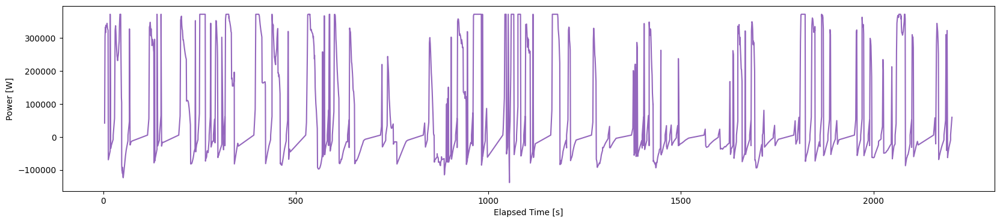

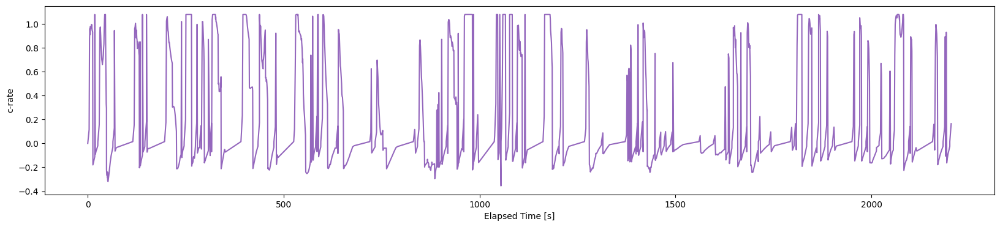

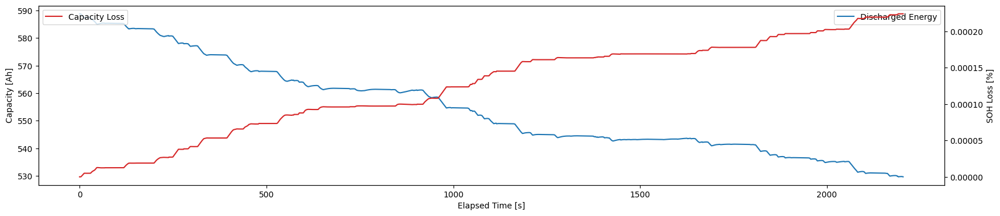

In [49]:
importlib.reload(ts)
importlib.reload(op)
row = available_routes.get_group(('8',)).reset_index(drop=True).iloc[1, :]
seed = 4
random.seed(int(seed))
route = gt.load_from_json(row.path)
bus = op.load_bus_params(row.bus)
trip = op.load_trip_params(trip_path)
trip.m_riders = 45
trip.traffic = .3
trip.chance_sig = .2
trip.v_wind = 2
trip.wind_bearing = gt.compass_heading(180)
trip.seed=int(seed)
trip.t_sig = 75
trip.t_stop = 40

ess = op.load_ESS_params(ESS_path)
ess.P_aux = random.randrange(*(p_aux_min_max))

bus.f_br = random.uniform(*b_factors)
bus.f_a = random.uniform(*a_factors)
bus.dmax = random.uniform(*max_dist)
res = ts.simulate_trip(route, trip, bus, ess)
res = pd.DataFrame(res)

#ESS Power
fig, ax = plt.subplots(1,1 , figsize=(20, 4), dpi = 100)
ax.plot(res['dt'].cumsum(), res['BP'], c="tab:purple")

#ax.set_ylim(0, 20)
ax.set_xlabel('Elapsed Time [s]')
ax.set_ylabel('Power [W]')

    
#C-rate
fig, ax = plt.subplots(1,1 , figsize=(20, 4), dpi = 100)
ax.plot(res['dt'].cumsum(),res['c_rate'], c="tab:purple")
ax.set_xlabel('Elapsed Time [s]')
ax.set_ylabel('c-rate')

# ESS Capacity
fig, ax = plt.subplots(1,1 , figsize=(20, 4), dpi = 100)
ax.plot(res['dt'].cumsum(),(ess.Q_cell*ess.module_S_P[1]*ess.bus_S_P[1] - res['dQ'].cumsum()), c="tab:blue")
ax.set_xlabel('Elapsed Time [s]')
ax.set_ylabel('Capacity [Ah]')
ax.legend(['Discharged Energy', 'Capacity Loss'])

# Capacity Loss
ax2 = ax.twinx()
ax2.plot(res['dt'].cumsum(),res['SOH_loss'].cumsum(), c="tab:red")
ax2.legend(['Capacity Loss'])
ax2.set_ylabel("SOH Loss [%]")

ESS Capacity: 588.8 Ah


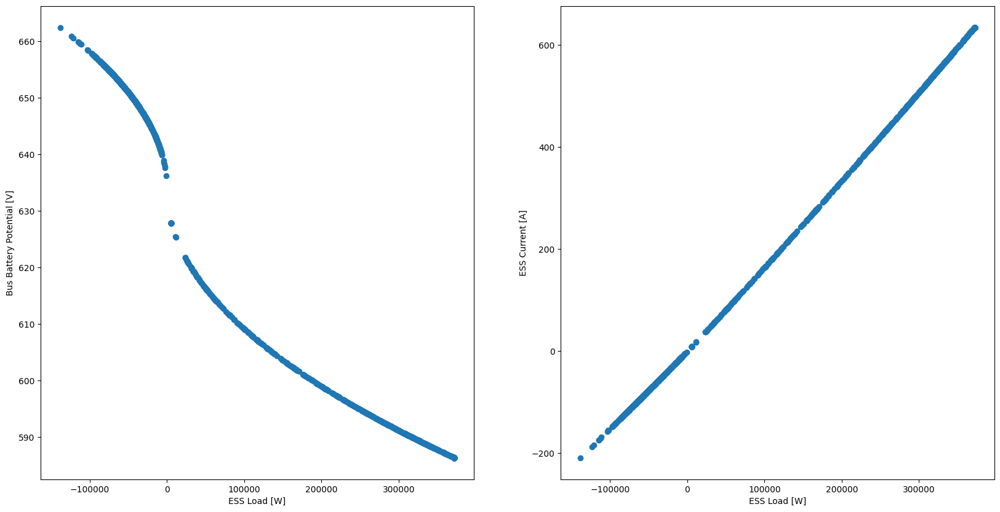

In [50]:
fig, ax = plt.subplots(1,2, figsize = (20, 10), dpi=100)
ax[0].scatter(res['BP'], res['v']*ess.bus_S_P[0]*ess.module_S_P[0])
ax[0].set_xlabel('ESS Load [W]')
ax[0].set_ylabel('Bus Battery Potential [V]')

ax[1].scatter(res['BP'], res['BP']/(res['v']*ess.bus_S_P[0]*ess.module_S_P[0]))
ax[1].set_xlabel('ESS Load [W]')
ax[1].set_ylabel('ESS Current [A]')

print('ESS Capacity: {} Ah'.format((ess.Q_cell*ess.module_S_P[1]*ess.bus_S_P[1])))


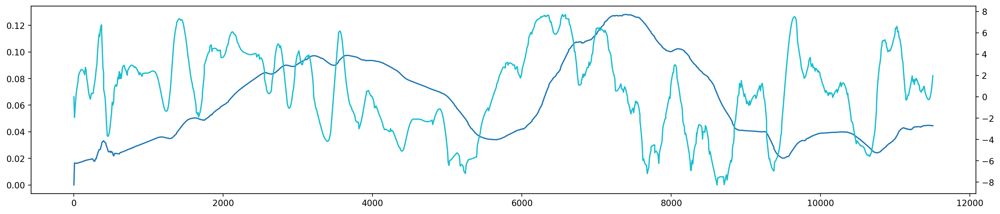

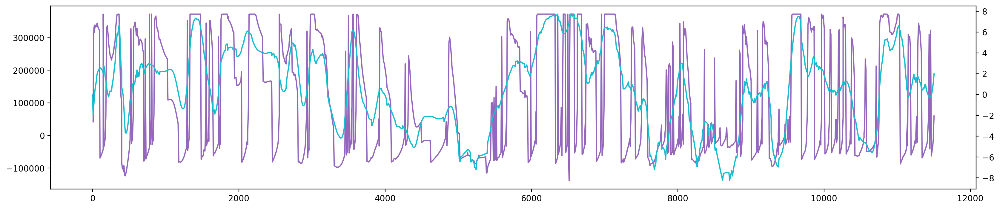

In [54]:

fig, ax = plt.subplots(1,1 , figsize=(20, 4), dpi = 200)
ax.plot(res['dx'].cumsum(),(res['elevation']), c="tab:blue")
ax2 = ax.twinx()
ax2.plot(res['dx'].cumsum(),(res['grade']), c="tab:cyan")
#ax2.plot(res['dx'].cumsum(),gt.smooth_elevation(gt.calculate_grades(res['gdx'],res['elevation']*1000), lg=25), c='tab:green')

fig, ax = plt.subplots(1,1 , figsize=(20, 4), dpi = 200)
ax.plot(res['dx'].cumsum(),(res['BP']), c="tab:purple")
ax2 = ax.twinx()
ax2.plot(res['dx'].cumsum(),(res['grade']), c="tab:cyan")

In [242]:
gt.calculate_grades(res['gdx'],res['elevation']) - res['grade']

0       0.210005
1       1.682447
2       1.470970
3       0.949033
4       0.497505
          ...   
1413    0.401823
1414    0.560425
1415    0.720406
1416    0.721127
1417    0.881767
Name: grade, Length: 1418, dtype: float64

In [228]:
res['elevation']

0       0.000000
1       0.016522
2       0.016429
3       0.016370
4       0.016340
          ...   
1413    0.044720
1414    0.044668
1415    0.044600
1416    0.044600
1417    0.044518
Name: elevation, Length: 1418, dtype: float64

(array([  5.,  12., 151., 255., 215.,  84.,  54.,  31.,  35.,  45.,  33.,
         33.,  63.,  80.,  71., 251.,   0.,   0.,   0.]),
 array([-5.00000000e-01, -4.00000000e-01, -3.00000000e-01, -2.00000000e-01,
        -1.00000000e-01, -1.11022302e-16,  1.00000000e-01,  2.00000000e-01,
         3.00000000e-01,  4.00000000e-01,  5.00000000e-01,  6.00000000e-01,
         7.00000000e-01,  8.00000000e-01,  9.00000000e-01,  1.00000000e+00,
         1.10000000e+00,  1.20000000e+00,  1.30000000e+00,  1.40000000e+00]),
 <BarContainer object of 19 artists>)

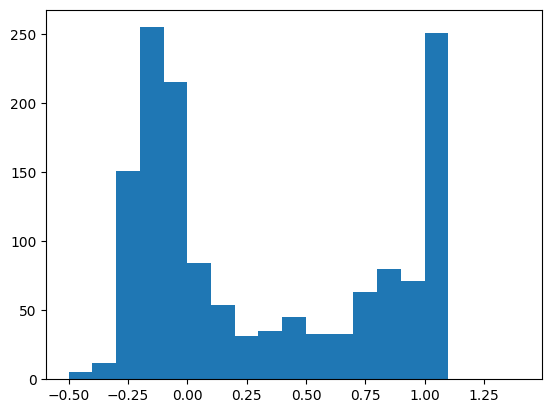

In [212]:
plt.hist(res['c_rate'], bins = np.arange(-.5, 1.5, .1))

(array([  0., 104.,  18.,  20.,  21.,  20.,  30.,  29.,  29.,  31.,  37.,
         74.,  42.,  64.,  52.,  75.,  71.,  35.,  45.,  60.,  90.,  53.,
         25.,  38.,  46.,  35.,  30.,  18.,  22.,  14., 190.]),
 array([-8. , -7.5, -7. , -6.5, -6. , -5.5, -5. , -4.5, -4. , -3.5, -3. ,
        -2.5, -2. , -1.5, -1. , -0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,
         3. ,  3.5,  4. ,  4.5,  5. ,  5.5,  6. ,  6.5,  7. ,  7.5]),
 <BarContainer object of 31 artists>)

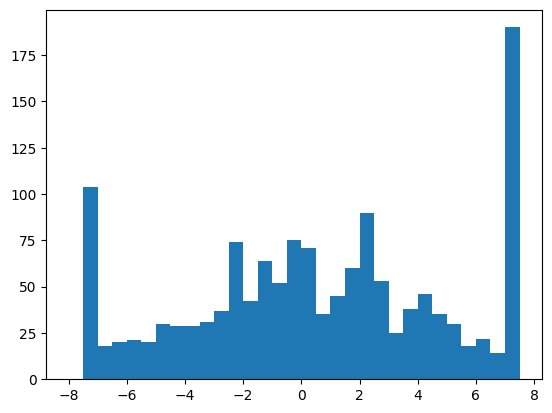

In [215]:
plt.hist(res['grade'],bins = np.arange(-8,8, .5))

np.float64(3.4779043330571393)

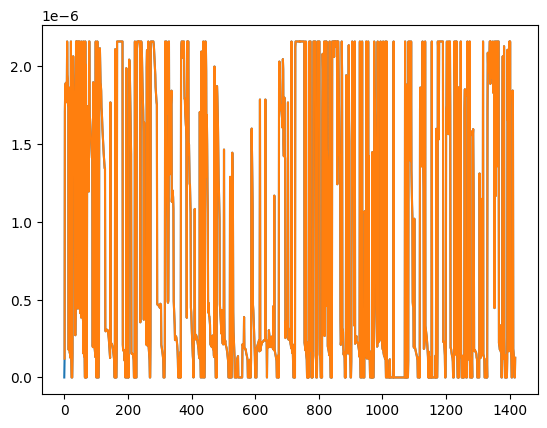

In [98]:
plt.plot(res['n_dec'])
plt.plot(res['C_rate'].apply(lambda x: decay_by_c_rate(x)))

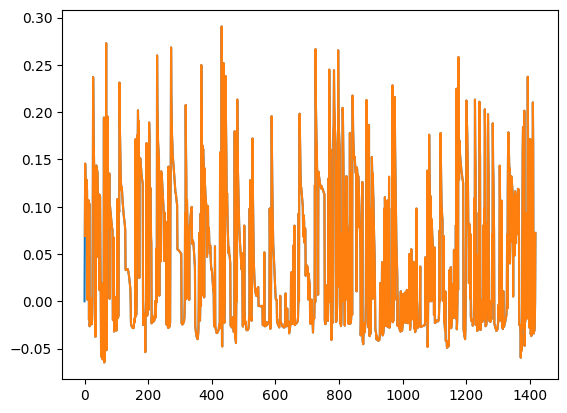

In [99]:
plt.plot(res['dQ'])
plt.plot(res['DQ'])

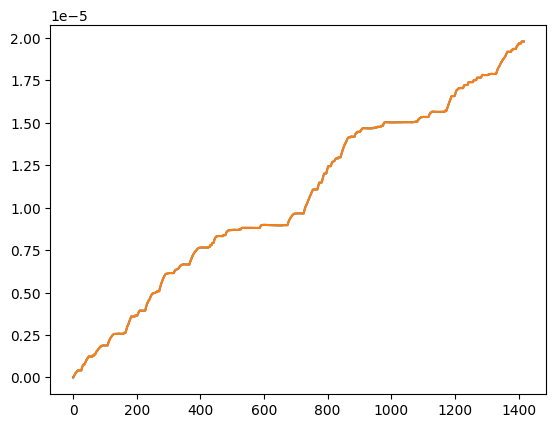

In [106]:
plt.plot(res['SOH_loss'].cumsum())
plt.plot((res['Capacity_Fade']*100/(ess.Q_cell*ess.module_S_P[1]*ess.bus_S_P[1])).cumsum())

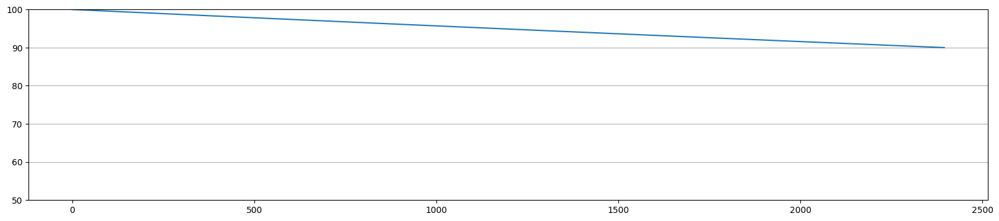

In [133]:
def decay_by_c_rate(c_rate):
    c=abs(c_rate)
    if c < .1:
        return 0
    elif .1 <= c < .5:
        return .000011*c
    elif .5 <= c < 1.5:
        return .000022*c
    else:
        return .000066*c

Qi = ess.Q_cell
SOC = Qi/Qi * 100
SOH = 100
Qmax = Qi
t_tot = 0
SOH_array = []
i=0
while SOH > 90:
    while SOC > 0:
        P = 7.585
        dt = 1
        v = ess.calc_voltage_simple(P)
        dQ = (P*dt/3600/v)
        c = (P*dt/v)/(ess.Q_cell)
        dCap = decay_by_c_rate(c)*dQ
        Qmax -= dCap
        SOC -= (dQ/Qmax + dCap/Qmax)*100
        SOH = Qmax/Qi * 100
        t_tot+=dt

    while SOC < 100:
        P = -7.585
        dt = 1
        v = ess.calc_voltage_simple(P)
        dQ = (P*dt/3600/v)
        c = (P*dt/v)/(ess.Q_cell)
        dCap = decay_by_c_rate(c)*dQ
        Qmax += dCap
        SOC -= (dQ/Qmax + dCap/Qmax)*100
        SOH = Qmax/Qi * 100
        t_tot+=dt
    SOH_array.append(SOH)
    i+= 1
    print(i, SOH, end='\r')
fig, ax = plt.subplots(1,1 , figsize=(20, 4), dpi = 100)
ax.plot(np.arange(0, i), SOH_array)
ax.set_ylim(50, 100)
ax.grid(axis='y')

In [32]:
fig, ax = blank_kc_canvas()
gser = gpd.GeoSeries(res['geometry'][1:]).set_crs(epsg=4326)
gser.plot(aspect=1, markersize=1, ax=ax, zorder=30)
ax.set_xlim(-)

SyntaxError: invalid syntax (4073524111.py, line 4)

In [126]:
route_frame = available_routes.get_group(('1',))

In [67]:
available_routes = available_to_run.groupby('direction').get_group(1).groupby('shortname')
available_routes.get_group('1')

,shortname,route_id,shape,direction,path,rider_dict,bus,ridership_min_max
1,1,100001,11001004,1,./KC_Example_Data/Saved_Routes/rt1_sh11001004_...,"[{'AM': 23.624358974358973}, {'MID': 26.029824...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(10.424999999999999, 40.59166666666667)"
3,1,100001,20001002,1,./KC_Example_Data/Saved_Routes/rt1_sh20001002_...,"[{'AM': 23.624358974358973}, {'MID': 26.029824...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(10.424999999999999, 40.59166666666667)"
5,1,100001,11001003,1,./KC_Example_Data/Saved_Routes/rt1_sh11001003_...,"[{'AM': 23.624358974358973}, {'MID': 26.029824...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(10.424999999999999, 40.59166666666667)"
7,1,100001,20001005,1,./KC_Example_Data/Saved_Routes/rt1_sh20001005_...,"[{'AM': 23.624358974358973}, {'MID': 26.029824...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(10.424999999999999, 40.59166666666667)"


In [130]:
route_frame.groupby('direction').get_group(1)

,shortname,route_id,shape,direction,path,rider_dict,bus,ridership_min_max
1,1,100001,11001004,1,./KC_Example_Data/Saved_Routes/rt1_sh11001004_...,"[{'AM': 23.624358974358973}, {'MID': 26.029824...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(10.424999999999999, 40.59166666666667)"
3,1,100001,20001002,1,./KC_Example_Data/Saved_Routes/rt1_sh20001002_...,"[{'AM': 23.624358974358973}, {'MID': 26.029824...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(10.424999999999999, 40.59166666666667)"
5,1,100001,11001003,1,./KC_Example_Data/Saved_Routes/rt1_sh11001003_...,"[{'AM': 23.624358974358973}, {'MID': 26.029824...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(10.424999999999999, 40.59166666666667)"
7,1,100001,20001005,1,./KC_Example_Data/Saved_Routes/rt1_sh20001005_...,"[{'AM': 23.624358974358973}, {'MID': 26.029824...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(10.424999999999999, 40.59166666666667)"


In [55]:
list(routes.keys())[:]

['45', '70', '8', '49']

In [70]:
#list(available_routes.groups.keys())
for route_shortname in list(available_routes.groups.keys())[0:1]:
#for route_shortname in unsimd_routes[:]:
    print("-----------------------{}-------------------".format(route_shortname))

    selected_route_instances = available_routes.get_group(route_shortname).reset_index(drop=True)
    selected_route_instances['results'] = [[]]*len(selected_route_instances)
    #print(specific_runs)
    #current_route_index = specific_runs[route_shortname]
    #current_route_instance = selected_route_instances.iloc[current_route_index:current_route_index+1]
    
    route_frame = available_routes.get_group(route_shortname)
    #route_frame = route_frame[specific_runs[route_shortname]:specific_runs[route_shortname]+1]
    route_frame = route_frame.groupby('direction').get_group(1)
    route_frame['bus'] = len(route_frame)*[['./KC_Example_Data/Saved_Objects/Busses/XDE60.txt','./KC_Example_Data/Saved_Objects/Busses/XDE40.txt','./KC_Example_Data/Saved_Objects/Busses/XDE35.txt']]
    selected_route_instances = route_frame.explode('bus').reset_index()
    selected_route_instances['results'] = [[]]*len(selected_route_instances)
    #specific_runs[route_shortname]:specific_runs[route_shortname]+1
    for index, row in selected_route_instances[:].iterrows():
    #for index, row in selected_route_instances[:].iterrows():
        route = gt.load_from_json(row.path)
        busses= []
        trips = []
        esses= []
        for seed in seeds:
            random.seed(int(seed))
            bus = op.load_bus_params(row.bus)
            trip = op.load_trip_params(trip_path)
            trip.m_riders = random.uniform(*row.ridership_min_max)
            trip.traffic = random.uniform(*traffic_min_max)
            trip.chance_sig = random.uniform(*signal_min_max)
            trip.v_wind = random.uniform(*wind_speed_min_max)
            trip.wind_bearing = gt.compass_heading(random.randrange(*wind_directions_min_max))
            trip.seed=int(seed)
            trip.t_sig = random.uniform(*t_sigs)
            trip.t_stop = random.uniform(*t_stops)
            trips.append(trip)
            ess = op.load_ESS_params(ESS_path)
            ess.P_aux = random.randrange(*(p_aux_min_max))
            esses.append(ess)
            bus.f_br = random.uniform(*b_factors)
            bus.f_a = random.uniform(*a_factors)
            bus.dmax = random.uniform(*max_dist)
            #print(bus.f_br)
            busses.append(bus)

        all_runs = list(zip([route]*len(trips), trips, busses, esses))
        batched_runs = [all_runs[i:i + batch_size] for i in range(0, len(all_runs), batch_size)]

        res_list = []
        for i in range(len(batched_runs)):
            print(index/len(selected_route_instances[:])*100, i/len(batched_runs)*100, end= '\r')
            batch = batched_runs[i]
            with multiprocessing.Pool(batch_size) as pool:
                res_list.extend(pool.starmap(ts.simulate_trip, batch))

        proc_res = process_result_list(res_list, ess)

        selected_route_instances.at[index, 'results'] = list(proc_res)

    pre_MC = selected_route_instances[:]
    
    # Get the selected instances and plot against the 
    mi_kwh_bins = np.arange(.1, 1, .01)
    kwh_bins = np.arange(0, 50, 1)
    volt_bins = np.arange(20, 50, .5)
    time_bins = np.arange(500, 6000, 100)
    grade_bins = np.arange(-7.5, 7.5, .25)
    vel_bins = np.arange(0, 30, .5)
    vbins = np.arange(0, 30, .5)
    abins = np.arange(-8, 8, .5)
    tbins = np.arange(500, 6000, 100)

    for i in range(len(pre_MC)):
        MC = selected_route_instances[i:i+1]
        for index, row in MC.iterrows():
            # ---- Path Plotting
            if len(MC['results'][index]) != 0:
                #print(MC['results'][index][0].keys())
                fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=100)

                gt.load_from_json(row.path).to_gdf().geometry.apply(lambda x: shapely.ops.transform(gt._flip, x)).plot(ax=ax, markersize=1, cmap="viridis",alpha = .2, zorder = 1)
                ax.set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
                ax.set_xlabel("Longitude")
                ax.set_ylabel("Latitude")
                ax.legend(["Model", "Collected Data"])

                res = pd.DataFrame(row['results'])
                
                ddfs = res.apply(lambda x: gpd.GeoDataFrame([x['dt'],x['g'],x['vel'],x['dx'],x['geo']]).T[1:], axis=1)
                lddfs = pd.concat(list(ddfs))
                lddfs = gpd.GeoDataFrame(lddfs)

                lddfs = lddfs[lddfs['dt']!=0].reset_index(drop=True)
                sim = lddfs.groupby('geometry',sort=False).apply(lambda x: (x['dt'].mean(),
                                                                 x['grade'].mean(),
                                                                 x['v_f'].mean(),
                                                                 x['gdx'].mean(),
                                                                 x['v_f'].std(),
                                                                 x['dt'].std(),
                                                                 x['v_f'].min(),
                                                                 x['v_f'].max(),
                                                                 x['dt'].min(),
                                                                 x['dt'].max()), include_groups=False)
                aggregated_sim = pd.DataFrame(sim)
                aggregated_sim['dt'],aggregated_sim['grade'],aggregated_sim['v_f'],aggregated_sim['gdx'],aggregated_sim['sv_f'],aggregated_sim['sdt'],aggregated_sim['mav'],aggregated_sim['miv'],aggregated_sim['mat'],aggregated_sim['mit'] = zip(*aggregated_sim[0])
                aggregated_sim['geometry'] = aggregated_sim.index
                aggregated_sim['gdx']=gt.query_distance_traveled(aggregated_sim['geometry']).cumsum()
                aggregated_sim=gpd.GeoDataFrame(aggregated_sim[['dt',
                                                                'grade',
                                                                'v_f',
                                                                'gdx',
                                                                'geometry',
                                                                'sv_f',
                                                                'sdt',
                                                                'mav',
                                                                'miv',
                                                                'mat',
                                                                'mit']].reset_index(drop=True))



                
                ## ---- Monte Carlo Profile
                fig, ax = plt.subplots(2, 1, figsize=(20,8), dpi=100)
                plt.tight_layout(pad=2, w_pad=2, h_pad=2)
                ax[0].plot(aggregated_sim['gdx'], aggregated_sim['v_f'])
                ax[0].fill_between(aggregated_sim['gdx'], aggregated_sim['v_f']-aggregated_sim['sv_f'],aggregated_sim['v_f']+aggregated_sim['sv_f'],alpha=.3,zorder = .5)
                ax[0].fill_between(aggregated_sim['gdx'], aggregated_sim['miv'],aggregated_sim['mav'],alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")


                ax[0].set_ylim(0, 30)
                ax[0].legend(["Model", "Standard Deviation", "Min/Max", "Collected Data"])
                ax[0].set_xlabel("Geodesic Distance")
                ax[0].set_ylabel("Velocity [m/s]")

                ax[1].plot(aggregated_sim['dt'].cumsum(), aggregated_sim['v_f'])
                ax[1].fill_between(aggregated_sim['dt'].cumsum(), aggregated_sim['v_f']-aggregated_sim['sv_f'],aggregated_sim['v_f']+aggregated_sim['sv_f'],alpha=.3,zorder = .5)
                ax[1].fill_between(aggregated_sim['dt'].cumsum(), aggregated_sim['miv'],aggregated_sim['mav'],alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")
                ax[1].set_ylim(0, 30)
                ax[1].legend(["Model", "Standard Deviation", "Min/Max", "Collected Data"])
                ax[1].set_xlabel("Elapsed Time [s]")
                ax[1].set_ylabel("Velocity [m/s]")
                plt.show()
                


                # ---- Histogram Plotting
                fig, ax = plt.subplots(1,3, figsize = (12, 4), dpi=100)

                cm, bm, p = ax[0].hist(lddfs['v_f'], alpha=.5, weights=lddfs['dt'],density=True,bins=vbins)

                # Load the collected histogram
                v_hist = v_hists[route_shortname]
                ct, bt, p = ax[0].hist(v_hist[1][:-1], alpha=.5, weights=v_hist[0], density=True, bins=v_hist[1])

                v_r2 = rsq(ct, cm)
                ax[0].set_title("R^2: {}".format(v_r2))

                cm, bm, p = ax[1].hist(lddfs['v_f'].diff()/lddfs['dt'], alpha=.5, weights=lddfs['dt'],density=True,bins=abins)

                # Load the collected a histogram
                a_hist = a_hists[route_shortname]
                ct, bt, p = ax[1].hist(a_hist[1][:-1], alpha=.5, weights=a_hist[0], density=True, bins=a_hist[1])

                a_r2 = rsq(ct, cm)
                ax[1].set_title("R^2: {}".format(a_r2))

                # Plot runtime
                cm, bm, p = ax[2].hist(ddfs.apply(lambda x: x['dt'].sum()),alpha=.5, bins=tbins, color="tab:blue")

                ax[0].legend(["Model", "Collected Data"])
                ax[0].set_xlabel("Velocity [m/s]")
                ax[1].set_xlabel("Acceleration [m/s^2]")
                ax[2].set_xlabel("Total Runtime [s]")
                ax[0].set_ylabel("Time Density")
                ax[2].set_ylabel("Simulation count")


                plt.show()

                # Plot the statistics ----------------
                fig, ax = plt.subplots(1, 5, figsize = (20,4), dpi=100)
                plt.tight_layout()



                milage = pd.Series(res['miles']/res['kwh'])
                mimin, mimax, mimean, mistd = milage.min(), milage.max(), milage.mean(), milage.std()
                
                cap_fade = res['SOH_loss'].cumsum()
                
                ax[0].hist(milage, bins=mi_kwh_bins)
                ax[0].set_ylim(0, 100)
                ax[0].set_xlim(mi_kwh_bins.min(), mi_kwh_bins.max())
                ax[0].set_xlabel("mi/kWh")
                ax[0].set_ylabel("Counts")
                ax[0].set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
                ax[0].grid()

                ax[1].hist(res['kwh'], bins=kwh_bins)
                enmin, enmax, enmean, enstd = res['kwh'].min(), res['kwh'].max(), res['kwh'].mean(), res['kwh'].std()
                ax[1].set_ylim(0, 100)
                ax[1].set_xlabel("kWh")
                ax[1].set_xlim(kwh_bins.min(), kwh_bins.max())
                ax[1].grid()

                ax[2].hist(res['tot_time'], bins=time_bins)
                tmin, tmax, tmean, tstd = res['tot_time'].min(), res['tot_time'].max(), res['tot_time'].mean(), res['tot_time'].std()
                ax[2].set_ylim(0, 60)
                ax[2].set_xlim(time_bins.min(), time_bins.max())
                ax[2].set_xlabel("Runtime [s]")
                ax[2].grid()
                ax[0].legend(["Model", "Collected Data"])

                print(tmean, tstd, len(seeds), stats[route_shortname][0], stats[route_shortname][1], stats[route_shortname][2])
                t_val = t_value_eqn(tmean, tstd, len(seeds), stats[route_shortname][0], stats[route_shortname][1], stats[route_shortname][2])
                p_val = sci_t.sf(abs(t_val), len(seeds) + stats[route_shortname][2] - 2)*2

                t = pd.concat(list(res['dt'])).reset_index(drop=True)


                g = pd.concat(list(res['g'])).reset_index(drop=True)
                gvals, gbins, gbcon = ax[4-1].hist(g.apply(abs), bins=grade_bins, weights=t, density=True,alpha = 0)
                ax[4-1].hist(g, bins=grade_bins, weights=t, density=True, color='tab:blue')
                #g.hist(ax=ax[4], bins=grade_bins, weights=t, density=True)
                ax[4-1].set_xlim(-7.5, 7.5)
                ax[4-1].set_ylim(0, .75)
                ax[4-1].set_xlabel("Grade [%]")
                ax[4-1].set_ylabel("Time Density")
                ax[4-1].grid()

                vel = pd.concat(list(res['v'])).reset_index(drop=True)
                velvals, velbins, velbcon = ax[5-1].hist(vel, bins=vel_bins, weights=t, density=True)
                ax[5-1].set_xlim(vel_bins.min(), vel_bins.max())
                ax[5-1].set_ylim(0, 1)
                ax[5-1].set_xlabel("Voltage [V]")
                #ax[5-1].set_ylabel("Time Density")
                ax[5-1].grid()


                plt.show()

                print("-------------------------------------------model statistics---------------------------------------")
                # Print the statistics
                print("Milage min/max/mean/std [mi/kWh]: \t{}".format((mimin, mimax, mimean, mistd)))
                print("Energy min/max/mean/std [kWh]: \t\t{}".format((enmin, enmax, enmean, enstd)))
                print("Time min/max/mean/std [s]: \t\t{}".format((tmin, tmax, tmean, tstd)))
                print("Two-Tailed T Test: \t\tT-score: {}, P Value: {}".format(t_val, p_val))
                print("|Grade| mean/std [%]: \t\t\t{}".format(calculate_statistics_from_hist(gvals, gbins, gbcon)))
                print("Velocity mean/std [m/s]: \t\t{}".format(calculate_statistics_from_hist(velvals, velbins, velbcon)))

                print("--------------------------------------------------------------------------------------------------")
                print()
                out_df = pd.DataFrame(MC['results'][index])
                out_df['v'] = out_df['v'].apply(lambda x: x.to_dict())
                out_df['dt'] = out_df['dt'].apply(lambda x: x.to_dict())
                out_df['g'] = out_df['g'].apply(lambda x: x.to_dict())
                out_df['vel'] = out_df['vel'].apply(lambda x: x.to_dict())
                out_df['dx'] = out_df['dx'].apply(lambda x: x.to_dict())
                out_df['geo'] = out_df['geo'].apply(lambda x: x.to_dict())
                out_df['P'] = out_df['P'].apply(lambda x: x.to_dict())
                out_df['SOH_loss'] = out_df['SOH_loss'].apply(lambda x: x.to_dict())
                out_df['95'] = pd.Series(row.results).apply(lambda x: x['kwh']).quantile(.95)
                out_df['97'] = pd.Series(row.results).apply(lambda x: x['kwh']).quantile(.97)
                out_df['99'] = pd.Series(row.results).apply(lambda x: x['kwh']).quantile(.99)
                out_df['99.9'] = pd.Series(row.results).apply(lambda x: x['kwh']).quantile(.999)
                out_df.to_pickle('../../rRD-MISC//MC_Saves_4/{}_{}_{}_{}.pk'.format(route_shortname, row['shape'], row.direction, row.bus.split('/')[-1].split('.')[0]))

-----------------------1-------------------


/home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics/Physics_Engine.py:536: RuntimeWarning: invalid value encountered in scalar divide
  i_dt = (-v_f + np.sqrt(v_f**2 + 2*i_dx*step_a))/step_a


You shouldn't be here
mass 20638.0, a_counter nan, velocity nan, braking_Factor 0.23252352082437383, braking_accel 1.5, i_factor 1.1
Pmax 300000.0, pcurrent nan, pmin nan


TypeError: '>=' not supported between instances of 'NoneType' and 'int'

In [ ]:
#### ex = [(3244,484,69),(2123,179,96),(2133,225,72),(1821,223,60)] # Expected
gps = [(3077.7839386463165, 134.0732670404012, 3), (2117.950112660726 ,165.64038531754207, 3), (2781.0632893244424, 174.3288276721066, 3),(1742.452257990837, 9.547742009162903, 2)] #GPS
sim = [(3150.8825382271384, 456.89272883501616, 300), (2160.4974389799927, 273.00624583111227, 300), (2696.2330659817367, 372.93536942606386, 300), (1887.5085546880503, 258.76716834861446, 300)] #sim
i = 3
ex_gps = ex[i] + gps[i]
ex_sim = ex[i] + sim[i]
gps_sim = gps[i] + sim[i]
ls = [ex_gps, ex_sim, gps_sim]

for n in ls:
    t_val = t_value_eqn(*n)
    
    p_val = sci_t.sf(abs(t_val), n[2] + n[5] - 2)*2
    print(t_val, p_val)

-----------------------11-------------------


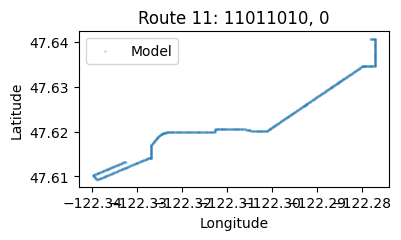

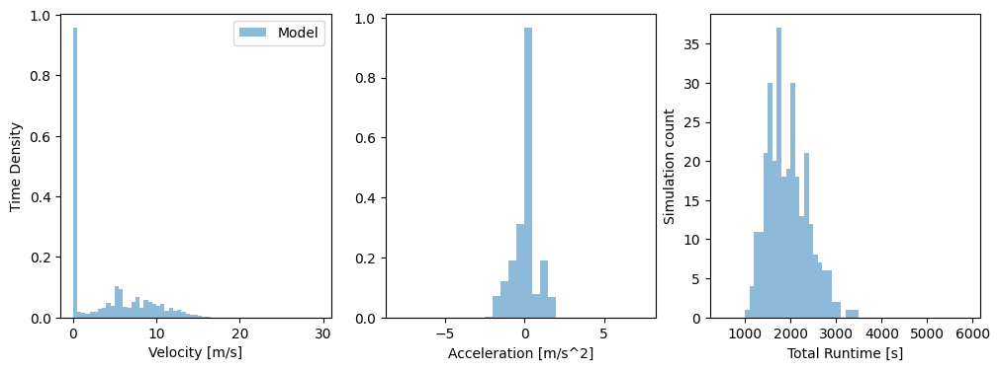

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


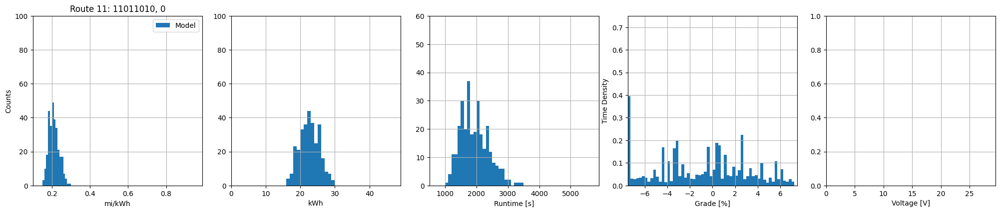

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15781937347712965), np.float64(0.2936357135938094), np.float64(0.21106843566631184), np.float64(0.026782903644552807))
Energy min/max/mean/std [kWh]: 		(np.float64(16.059599218116002), np.float64(29.88018373501809), np.float64(22.694233323288998), np.float64(2.818585498403221))
Time min/max/mean/std [s]: 		(np.float64(1092.3555866826778), np.float64(3451.407737371369), np.float64(1939.7431025919846), np.float64(447.89424162819546))
|Grade| mean/std [%]: 			(np.float64(2.96645618127507), np.float64(1.9494573333019325))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



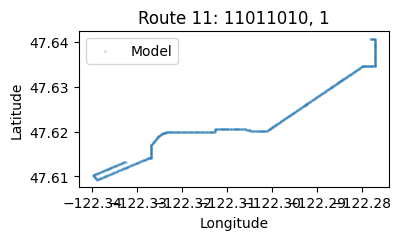

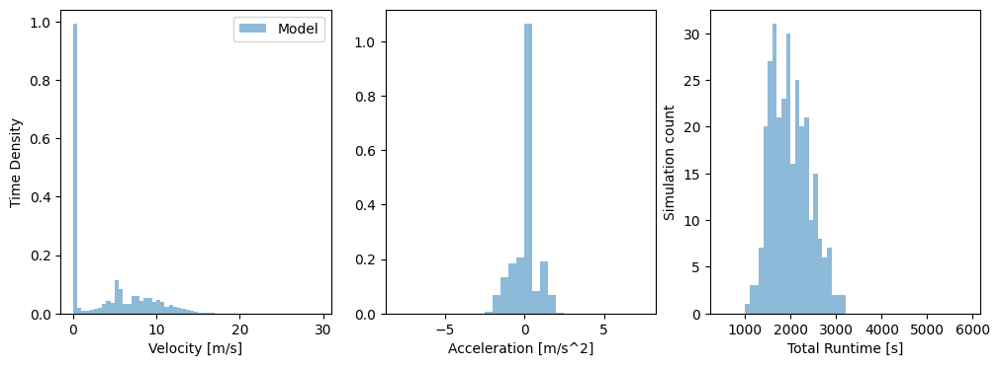

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


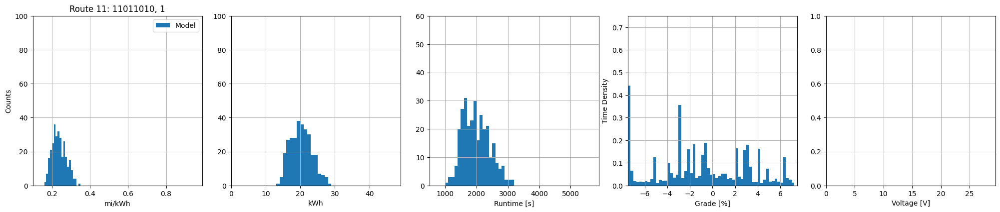

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1657764997508713), np.float64(0.348852708483568), np.float64(0.23849739941201112), np.float64(0.03656781737941115))
Energy min/max/mean/std [kWh]: 		(np.float64(13.517821526981901), np.float64(28.446303665307855), np.float64(20.234540859272553), np.float64(3.0698414770713596))
Time min/max/mean/std [s]: 		(np.float64(1067.7341034965161), np.float64(3153.5609155119164), np.float64(1991.6711899200734), np.float64(424.76919080277065))
|Grade| mean/std [%]: 			(np.float64(2.989846528022642), np.float64(1.8258137535753605))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



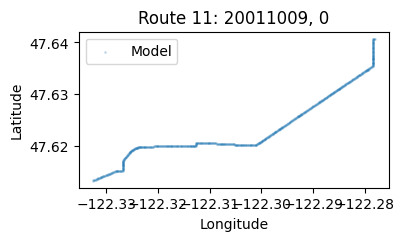

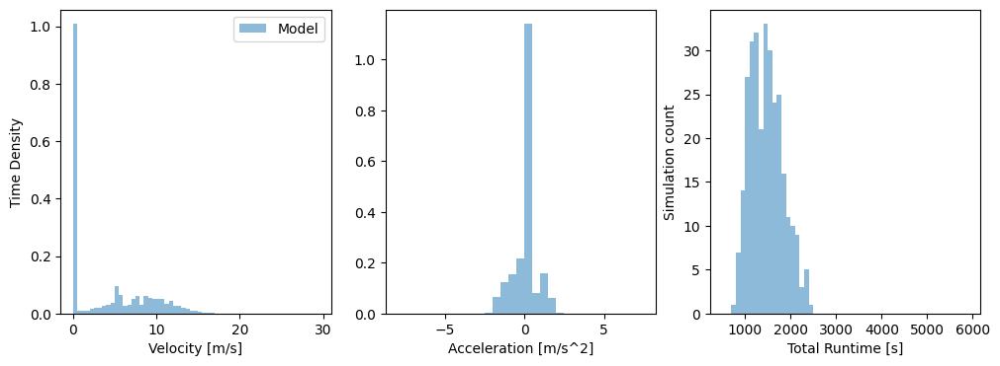

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


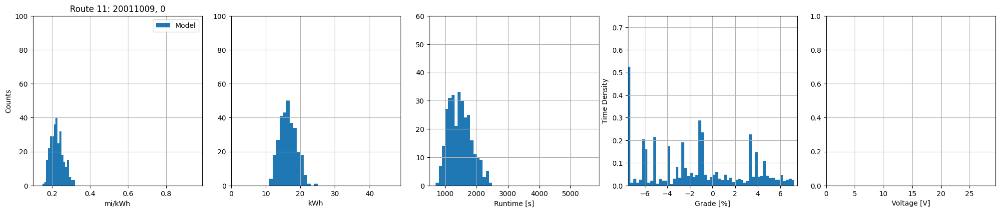

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15105539858547315), np.float64(0.31748349775278684), np.float64(0.22711327620087796), np.float64(0.03309112851429984))
Energy min/max/mean/std [kWh]: 		(np.float64(11.517930963604266), np.float64(24.208025952353317), np.float64(16.440213146370674), np.float64(2.3713015072878596))
Time min/max/mean/std [s]: 		(np.float64(754.4237201607359), np.float64(2409.344926689747), np.float64(1471.902228626977), np.float64(357.46051556131107))
|Grade| mean/std [%]: 			(np.float64(3.3795684670547734), np.float64(1.9594458573353506))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



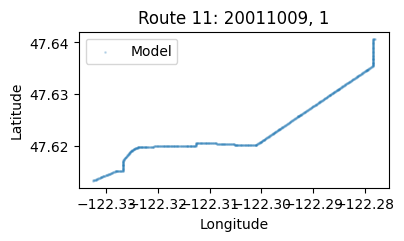

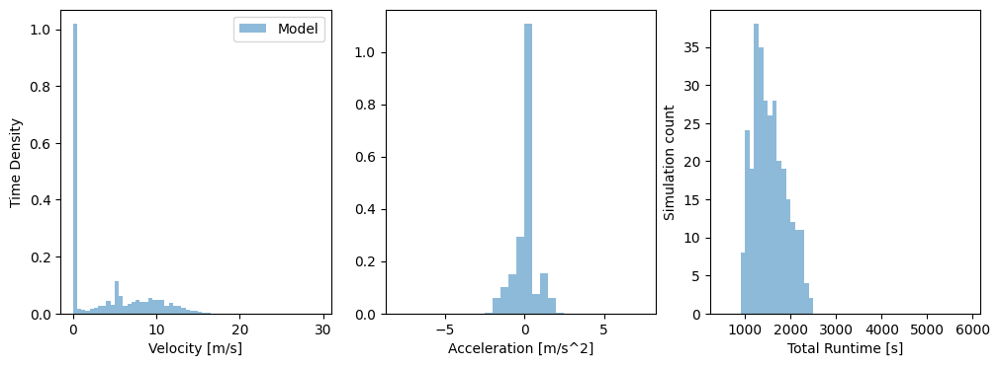

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


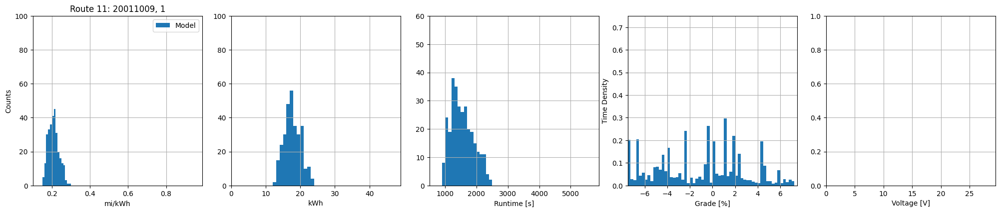

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15402034579362933), np.float64(0.2952893807638936), np.float64(0.20977012742942303), np.float64(0.02805561284839268))
Energy min/max/mean/std [kWh]: 		(np.float64(12.383053689303402), np.float64(23.740917065462757), np.float64(17.74003124207339), np.float64(2.346168435527958))
Time min/max/mean/std [s]: 		(np.float64(901.8935405222751), np.float64(2457.937451859958), np.float64(1540.8509016596543), np.float64(360.05544622506045))
|Grade| mean/std [%]: 			(np.float64(3.0488335305461116), np.float64(2.075718182116143))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------118-------------------


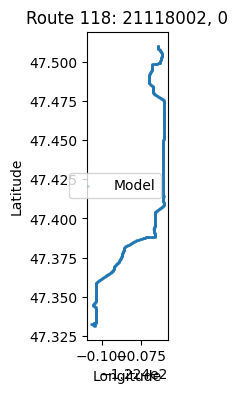

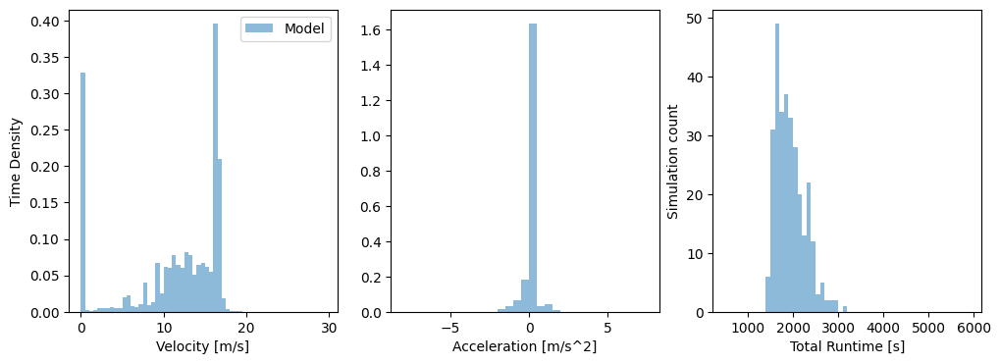

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


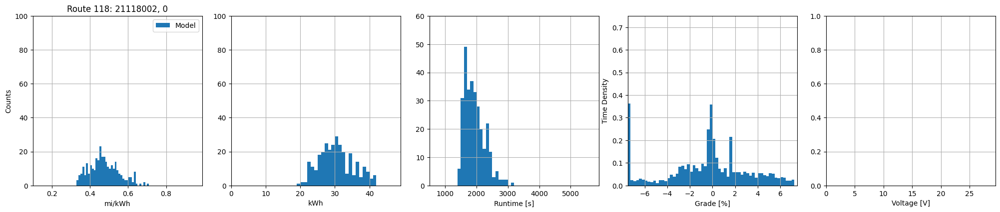

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.3360965233939841), np.float64(0.7098441806256125), np.float64(0.4756297047810715), np.float64(0.07753438365989006))
Energy min/max/mean/std [kWh]: 		(np.float64(19.852247679756008), np.float64(41.92843872798405), np.float64(30.40955078307395), np.float64(4.902370930348861))
Time min/max/mean/std [s]: 		(np.float64(1434.8592420416903), np.float64(3105.1461056086832), np.float64(1938.755083566676), np.float64(316.9696451774696))
|Grade| mean/std [%]: 			(np.float64(2.3189795394877506), np.float64(1.994570163718342))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



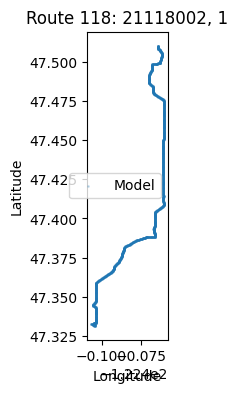

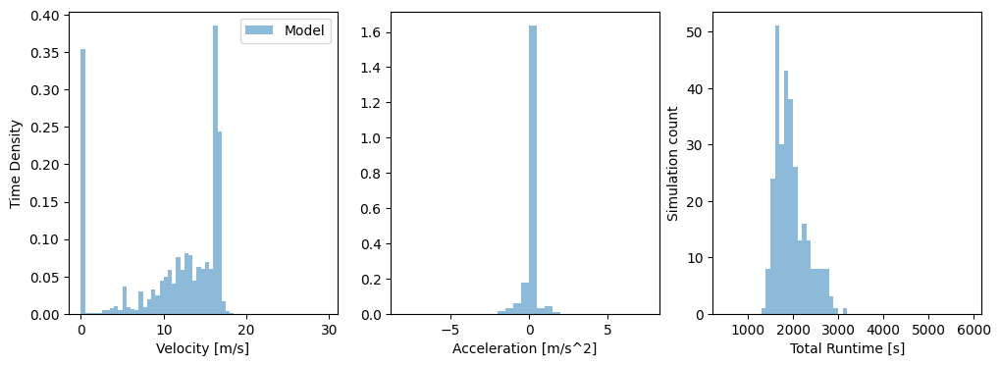

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


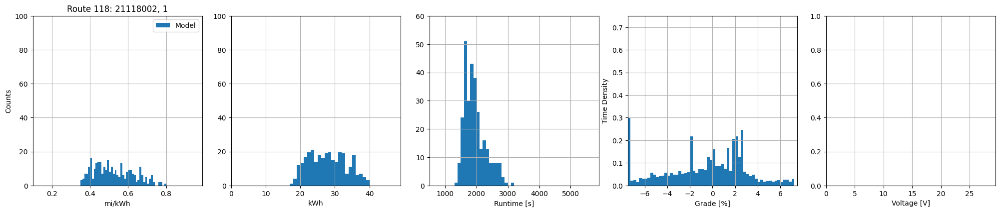

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.3551886499352037), np.float64(0.7932026116674467), np.float64(0.5237486869920217), np.float64(0.10362725937795483))
Energy min/max/mean/std [kWh]: 		(np.float64(17.767920895868), np.float64(39.67908676438324), np.float64(27.950408614548657), np.float64(5.384173779388928))
Time min/max/mean/std [s]: 		(np.float64(1399.0018151835802), np.float64(3120.8473873896464), np.float64(1955.2686429966118), np.float64(344.65462397365303))
|Grade| mean/std [%]: 			(np.float64(2.515050857473476), np.float64(1.7996220465935597))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



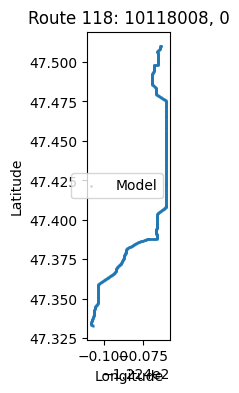

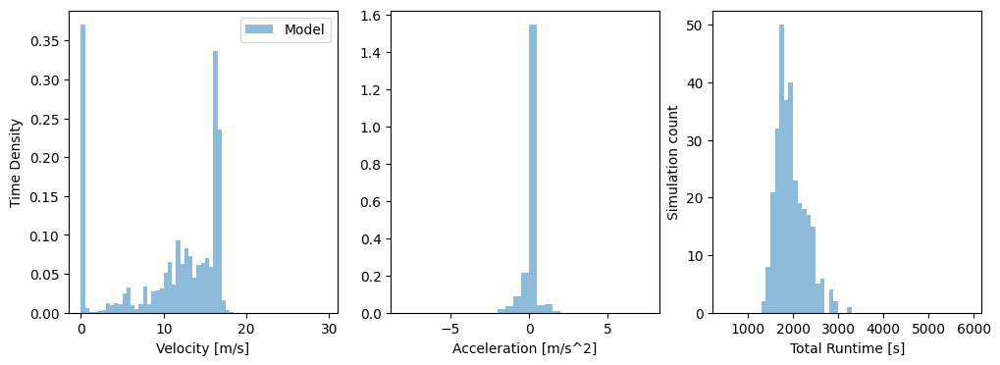

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


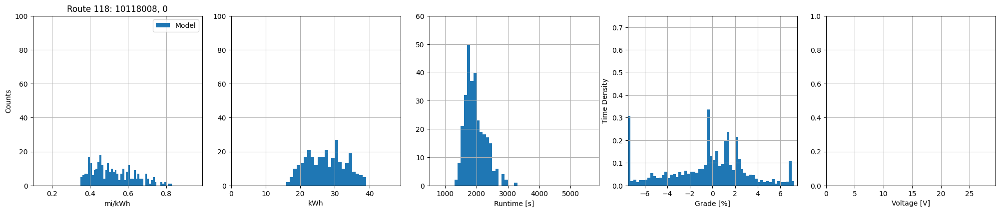

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.35314402007176576), np.float64(0.8215428426598669), np.float64(0.5208749643138701), np.float64(0.10929687572267857))
Energy min/max/mean/std [kWh]: 		(np.float64(16.669712102890394), np.float64(38.77987984773774), np.float64(27.413302278147007), np.float64(5.480611207190675))
Time min/max/mean/std [s]: 		(np.float64(1387.4849892999605), np.float64(3238.2610676117943), np.float64(1962.2249076028797), np.float64(327.49637266877056))
|Grade| mean/std [%]: 			(np.float64(2.36116829045739), np.float64(1.952176505078798))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



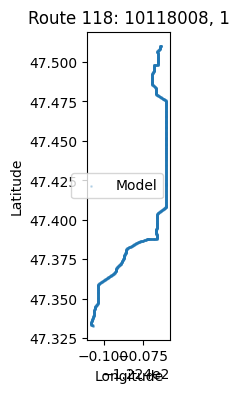

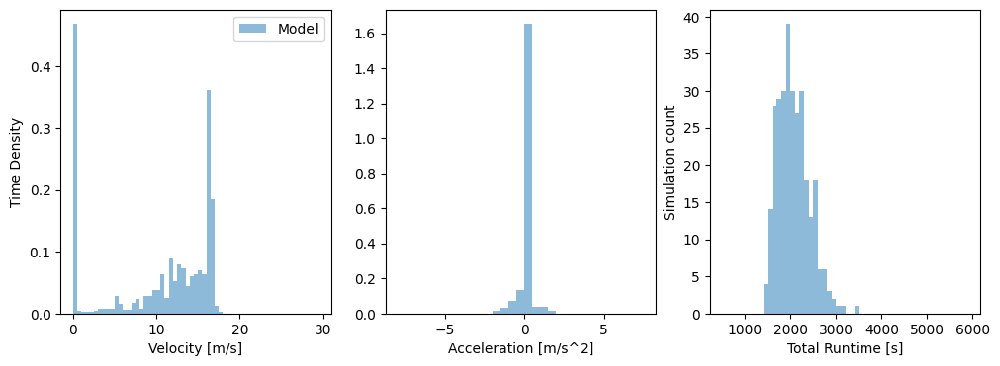

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


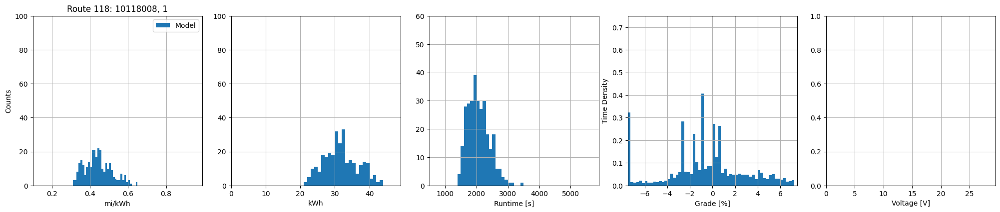

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.31221773622439725), np.float64(0.6496212960964611), np.float64(0.44251172468091765), np.float64(0.06974895259015254))
Energy min/max/mean/std [kWh]: 		(np.float64(21.07751099611597), np.float64(43.8552920707338), np.float64(31.69901807316295), np.float64(4.902124829342646))
Time min/max/mean/std [s]: 		(np.float64(1406.3648020051742), np.float64(3423.592535183386), np.float64(2065.6685494624753), np.float64(345.6770177143633))
|Grade| mean/std [%]: 			(np.float64(2.2105837866217297), np.float64(1.830406229128802))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



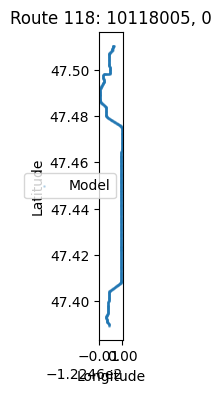

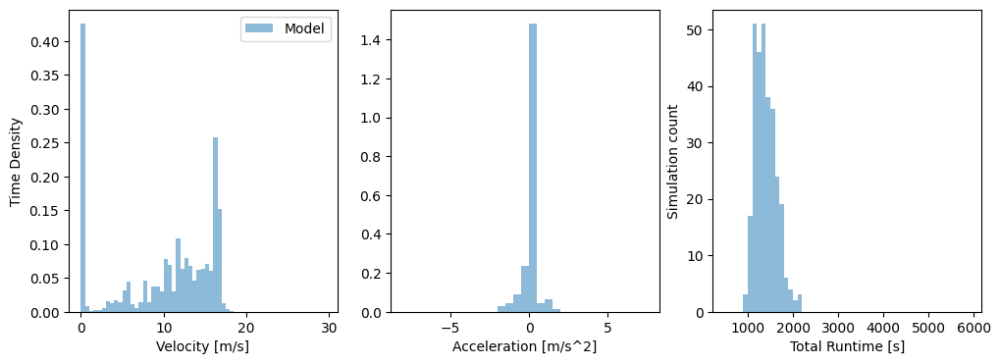

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


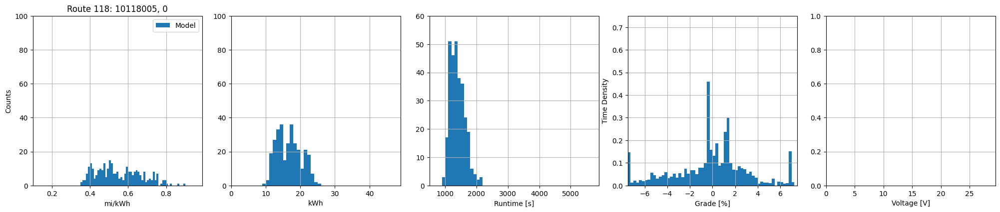

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.3525716123747817), np.float64(0.8909676859268496), np.float64(0.5515359766226312), np.float64(0.11724319083346194))
Energy min/max/mean/std [kWh]: 		(np.float64(9.900616761013437), np.float64(25.019398315687173), np.float64(16.71983352140097), np.float64(3.5073139100775244))
Time min/max/mean/std [s]: 		(np.float64(948.9097963313967), np.float64(2172.561466382883), np.float64(1396.319609765786), np.float64(232.6831971518041))
|Grade| mean/std [%]: 			(np.float64(2.200241660703559), np.float64(1.958508010193542))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



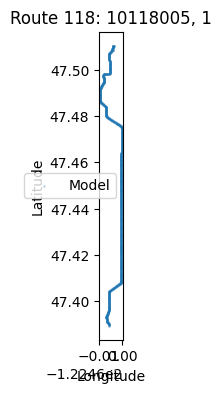

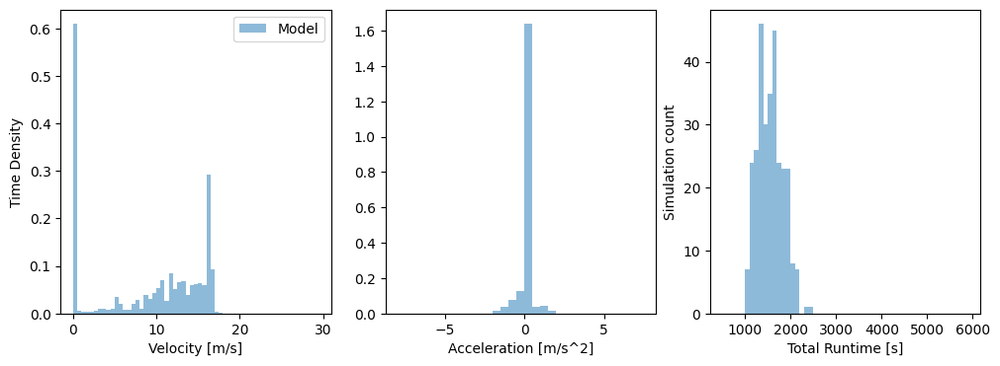

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


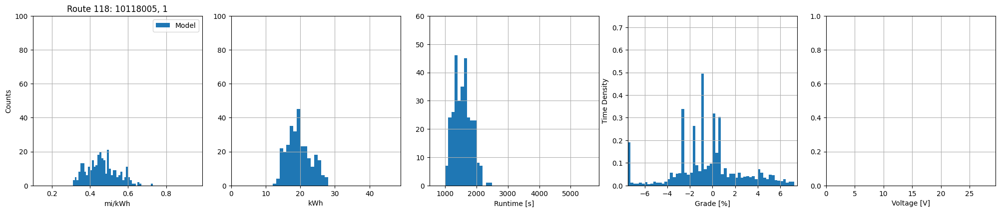

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.31662914691790073), np.float64(0.7280662559893046), np.float64(0.46274739415772104), np.float64(0.07918256526321409))
Energy min/max/mean/std [kWh]: 		(np.float64(12.117310952047262), np.float64(27.862896714947), np.float64(19.627224017001403), np.float64(3.3653613267509743))
Time min/max/mean/std [s]: 		(np.float64(1001.3728274644043), np.float64(2405.227231646853), np.float64(1557.1146543707232), np.float64(279.2347848998376))
|Grade| mean/std [%]: 			(np.float64(2.0237674681956315), np.float64(1.7188988478384053))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



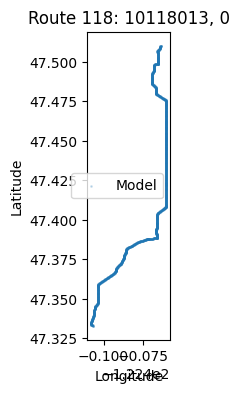

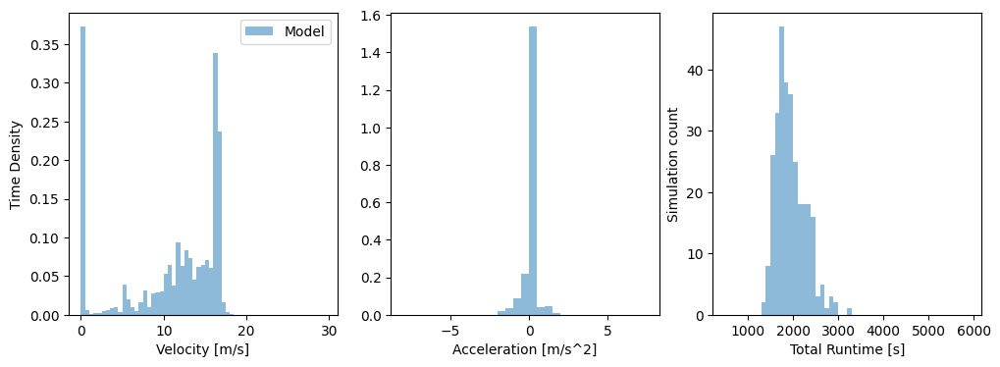

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


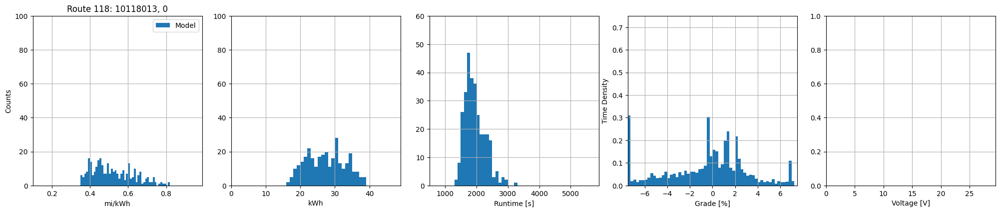

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.3524546868449492), np.float64(0.8178250457990976), np.float64(0.5201748100047673), np.float64(0.10905945857875546))
Energy min/max/mean/std [kWh]: 		(np.float64(16.702787465168754), np.float64(38.756635770553615), np.float64(27.37960244364209), np.float64(5.474916055210643))
Time min/max/mean/std [s]: 		(np.float64(1378.3735867031191), np.float64(3226.27626999922), np.float64(1949.7715656320688), np.float64(323.8292316083612))
|Grade| mean/std [%]: 			(np.float64(2.363454662967928), np.float64(1.9582425347386476))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



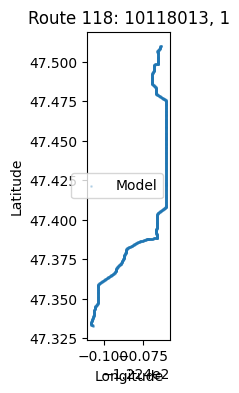

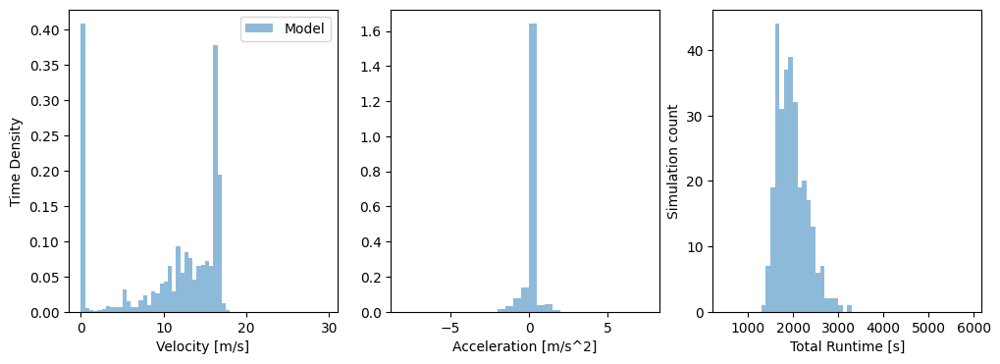

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


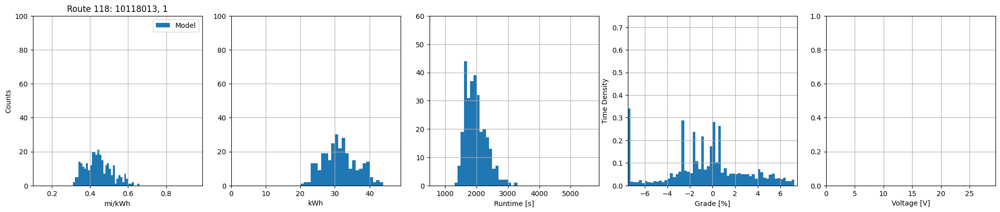

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.3146774221182759), np.float64(0.6589114742864488), np.float64(0.4447154464240822), np.float64(0.07016959717964703))
Energy min/max/mean/std [kWh]: 		(np.float64(20.727317883218145), np.float64(43.4014855355647), np.float64(31.46512769414357), np.float64(4.881824138418885))
Time min/max/mean/std [s]: 		(np.float64(1389.2556574149276), np.float64(3257.6823670182794), np.float64(1975.5538541367987), np.float64(331.30400433506344))
|Grade| mean/std [%]: 			(np.float64(2.2680764011916454), np.float64(1.8642782338432087))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



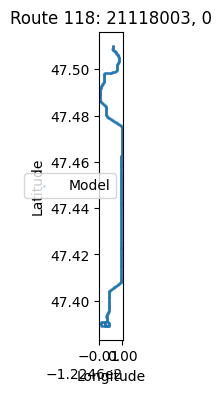

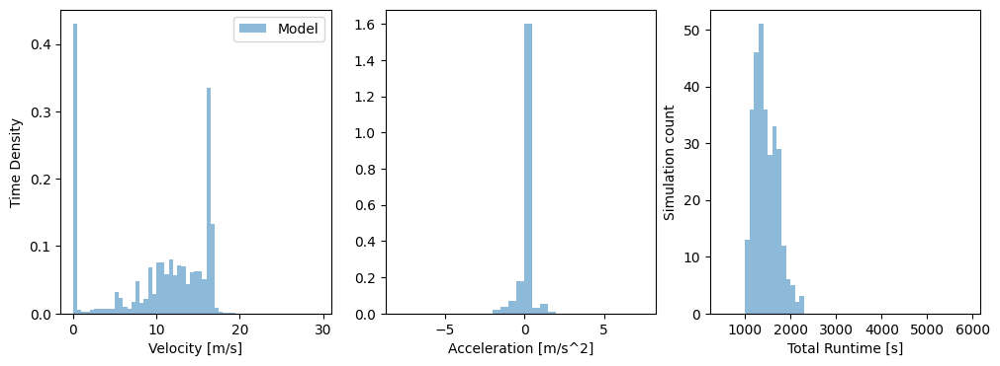

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


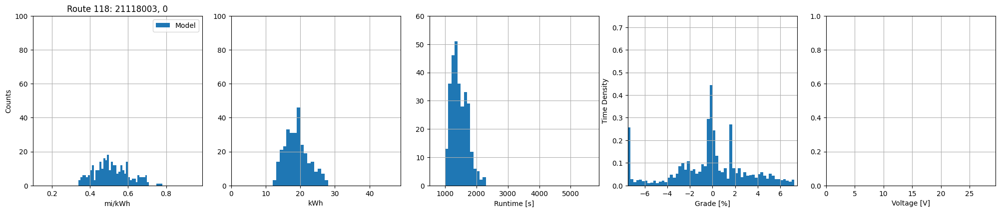

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.34330133146775066), np.float64(0.7720803752919226), np.float64(0.5147860825165637), np.float64(0.09113878225836711))
Energy min/max/mean/std [kWh]: 		(np.float64(12.25561645673677), np.float64(27.56272721954202), np.float64(18.963697350529873), np.float64(3.3765768596956804))
Time min/max/mean/std [s]: 		(np.float64(1019.744347161718), np.float64(2277.5300531588005), np.float64(1458.583787658065), np.float64(256.4192664161622))
|Grade| mean/std [%]: 			(np.float64(2.1364888812580687), np.float64(1.9379359376041287))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



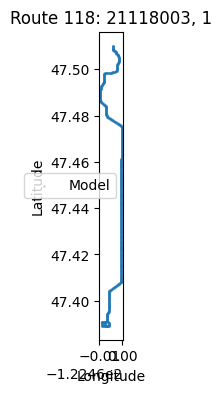

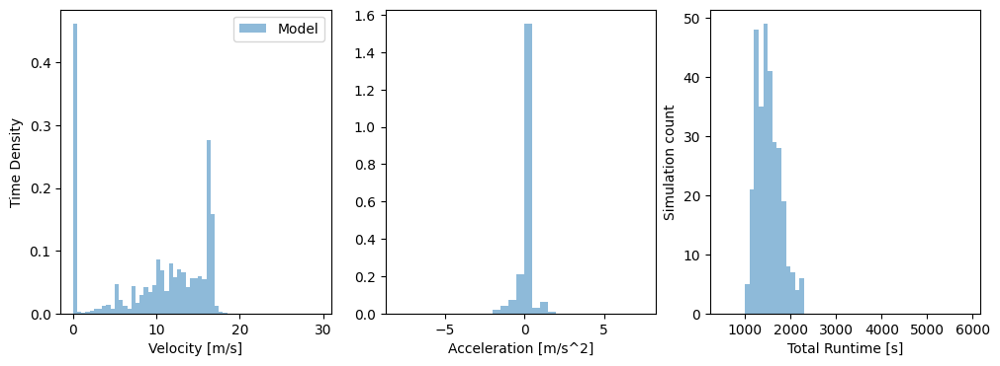

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


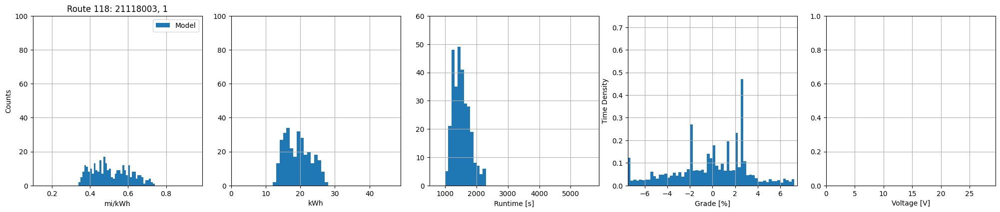

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.34121054180505234), np.float64(0.7374865324530817), np.float64(0.5115260866741732), np.float64(0.09886614617597529))
Energy min/max/mean/std [kWh]: 		(np.float64(12.830607299417409), np.float64(27.73185153206903), np.float64(19.201620429450646), np.float64(3.7162405676830947))
Time min/max/mean/std [s]: 		(np.float64(1015.2848964513726), np.float64(2279.5098301618627), np.float64(1516.5331866456681), np.float64(264.89256495834894))
|Grade| mean/std [%]: 			(np.float64(2.5000786072190815), np.float64(1.7582326468184468))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



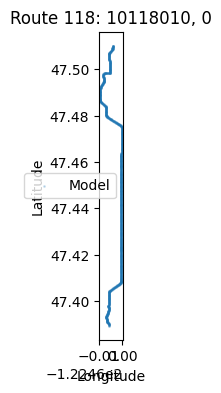

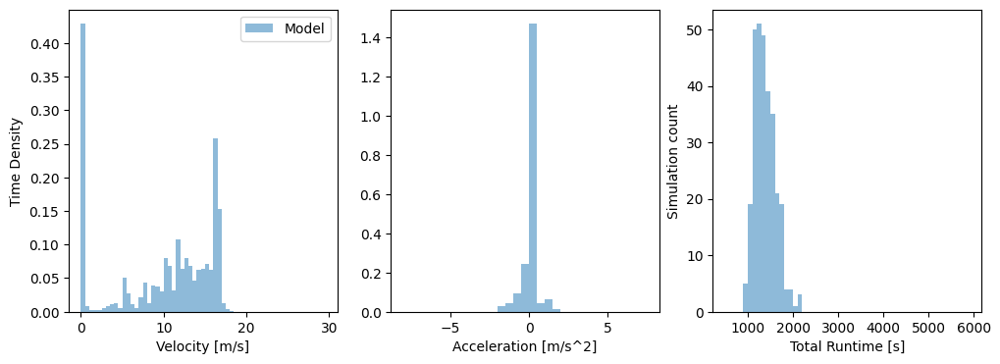

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


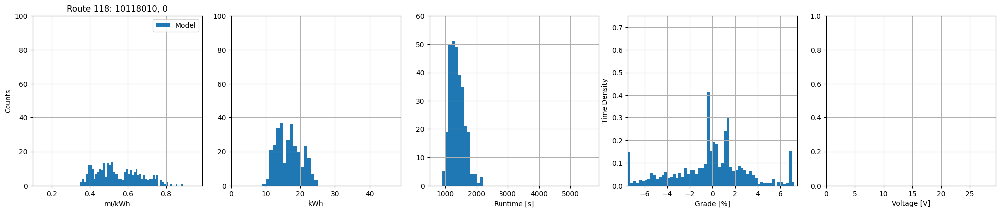

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.35219424304983293), np.float64(0.8886241477789848), np.float64(0.5505786835078497), np.float64(0.11713665454573269))
Energy min/max/mean/std [kWh]: 		(np.float64(9.887425277731777), np.float64(24.947042816681158), np.float64(16.68461870662818), np.float64(3.5058185585922828))
Time min/max/mean/std [s]: 		(np.float64(932.8192935916376), np.float64(2165.133161793316), np.float64(1383.3456993321643), np.float64(229.5927189929262))
|Grade| mean/std [%]: 			(np.float64(2.201256872648452), np.float64(1.965903360495571))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



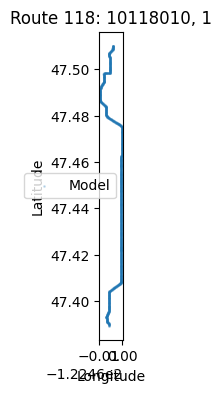

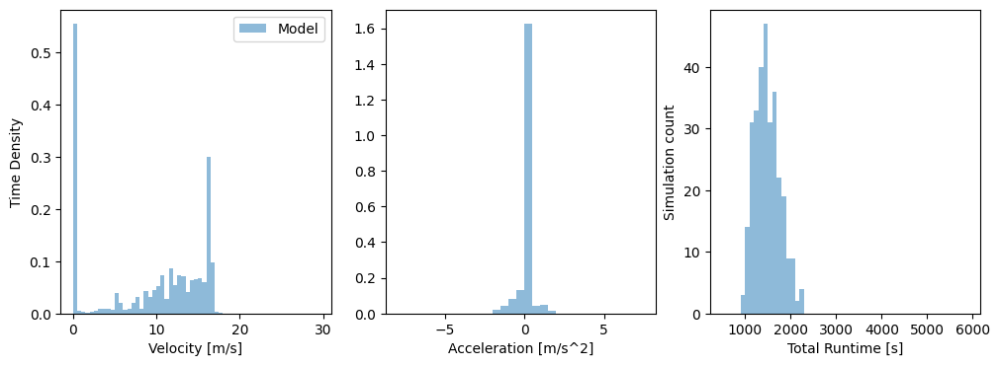

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


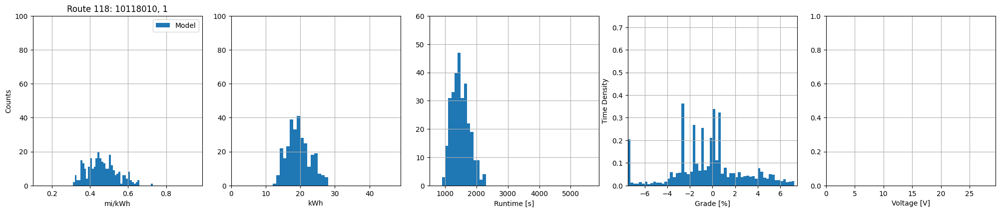

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.3170685536143105), np.float64(0.7281543051007558), np.float64(0.464032712869041), np.float64(0.07933143025648381))
Energy min/max/mean/std [kWh]: 		(np.float64(12.067871780213139), np.float64(27.714110056007506), np.float64(19.491007823543843), np.float64(3.3206363038046858))
Time min/max/mean/std [s]: 		(np.float64(981.1322477650339), np.float64(2293.581558081499), np.float64(1488.896781659502), np.float64(276.9287557659323))
|Grade| mean/std [%]: 			(np.float64(2.068756135534289), np.float64(1.758161521068538))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



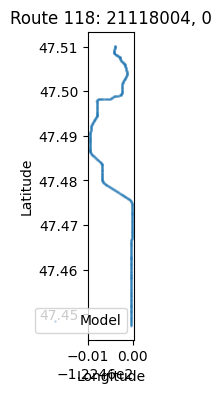

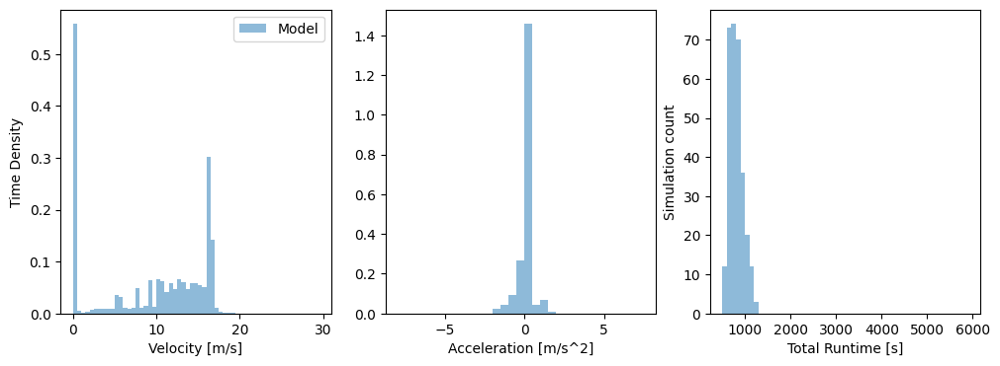

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


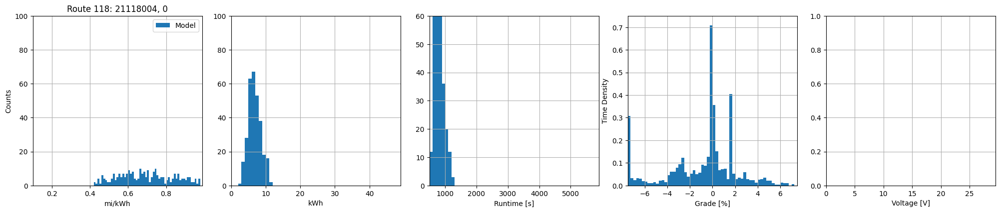

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.4261627926412235), np.float64(1.757266867325781), np.float64(0.7557153792995259), np.float64(0.22045990958480677))
Energy min/max/mean/std [kWh]: 		(np.float64(2.7116917894568133), np.float64(11.18156305124342), np.float64(6.782611591826802), np.float64(1.7558941343010164))
Time min/max/mean/std [s]: 		(np.float64(512.6842436222314), np.float64(1233.6167218479557), np.float64(804.8031829053378), np.float64(151.8376348562036))
|Grade| mean/std [%]: 			(np.float64(1.7677734740170972), np.float64(1.797488216360234))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



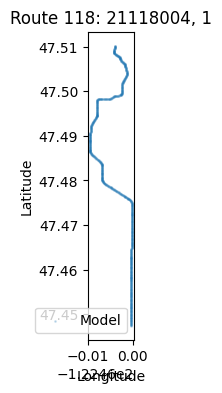

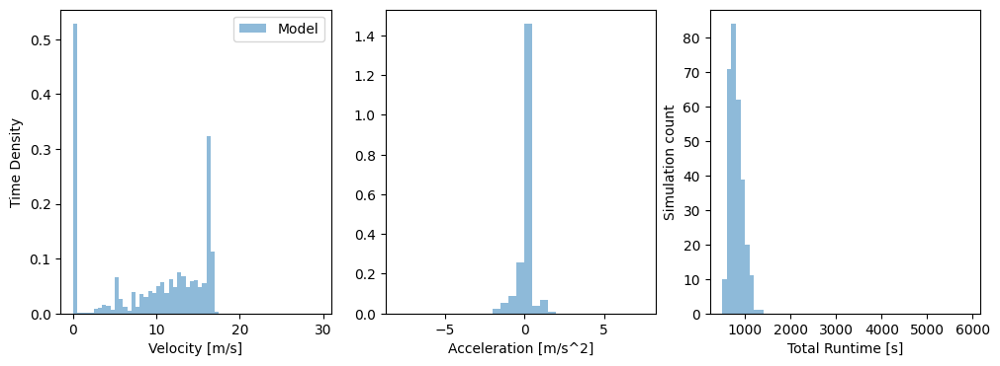

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


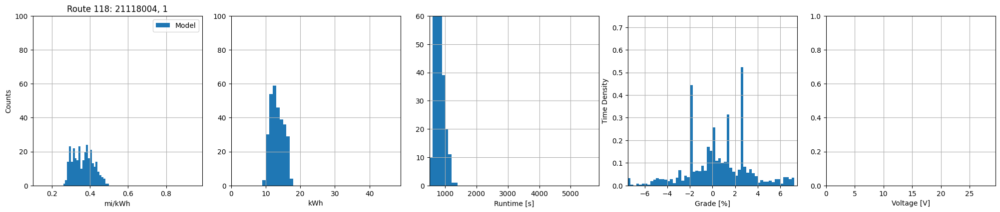

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2687511328684313), np.float64(0.4978678033266854), np.float64(0.364881072485739), np.float64(0.05225935374468583))
Energy min/max/mean/std [kWh]: 		(np.float64(9.572296679064186), np.float64(17.732905046878845), np.float64(13.33144544684054), np.float64(1.9137520026728843))
Time min/max/mean/std [s]: 		(np.float64(487.07167958566237), np.float64(1361.5105004026311), np.float64(803.7185923454953), np.float64(147.3221011539753))
|Grade| mean/std [%]: 			(np.float64(2.1464797239738367), np.float64(1.6479954716271157))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------124-------------------


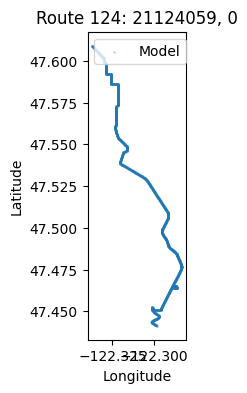

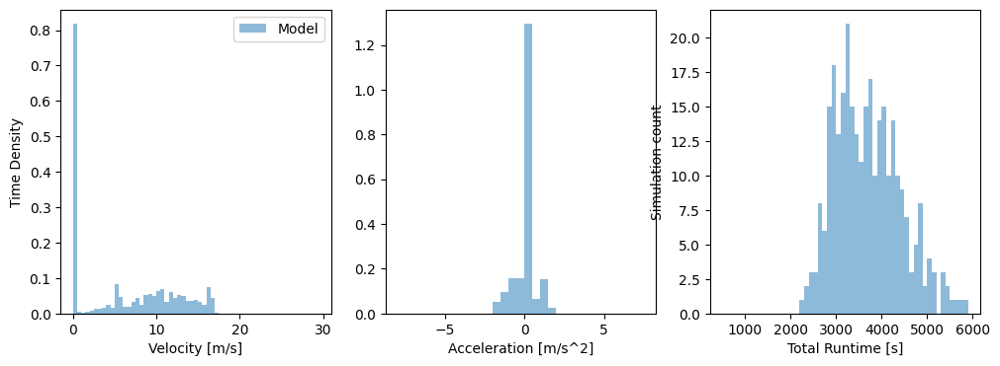

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


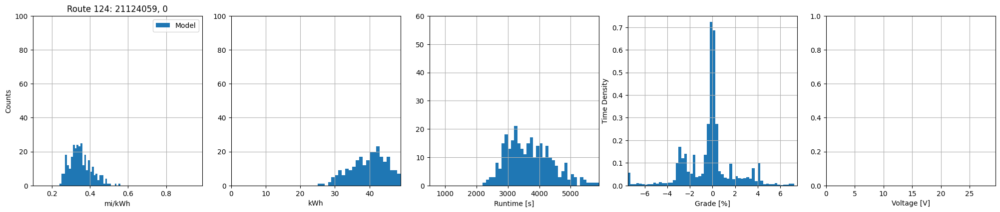

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.24827565380652225), np.float64(0.5518163220977552), np.float64(0.3506362743774437), np.float64(0.05721781591748783))
Energy min/max/mean/std [kWh]: 		(np.float64(25.810118562482803), np.float64(57.36545037619838), np.float64(41.66270412742906), np.float64(6.549166942519963))
Time min/max/mean/std [s]: 		(np.float64(2299.1379198880054), np.float64(5846.633005948253), np.float64(3695.6884916938716), np.float64(725.2238330260574))
|Grade| mean/std [%]: 			(np.float64(1.3781324134952566), np.float64(1.5353697927096503))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



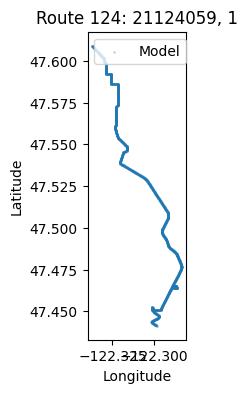

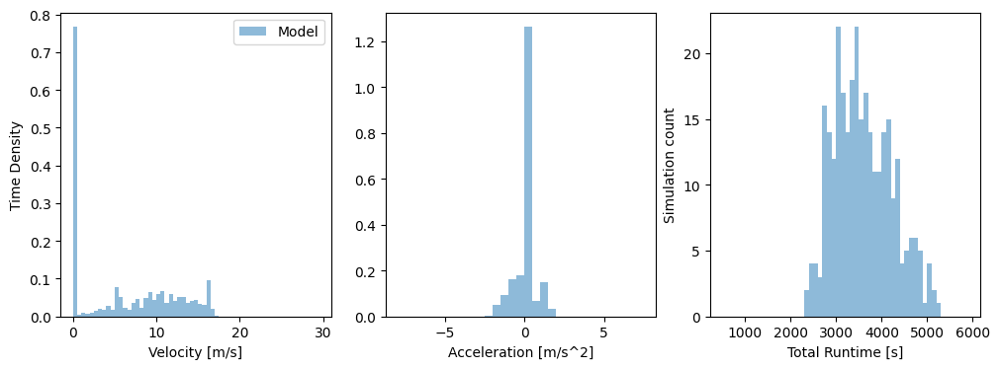

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


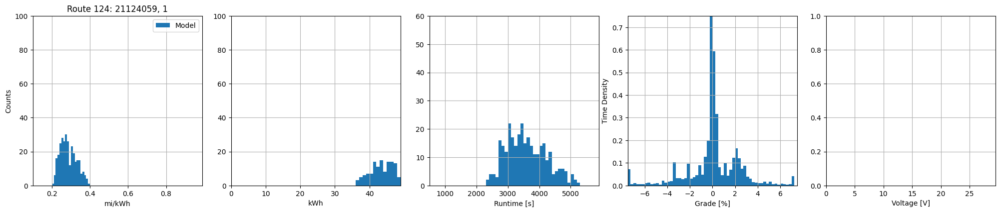

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20916388229682412), np.float64(0.3931980699009555), np.float64(0.28674796733669744), np.float64(0.04264713512868255))
Energy min/max/mean/std [kWh]: 		(np.float64(36.22494667662465), np.float64(68.09769908220008), np.float64(50.754000377177285), np.float64(7.383848949631703))
Time min/max/mean/std [s]: 		(np.float64(2375.760845825897), np.float64(5200.018510434217), np.float64(3599.498866663065), np.float64(636.8678029595253))
|Grade| mean/std [%]: 			(np.float64(1.3492043688477975), np.float64(1.5807453334624955))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



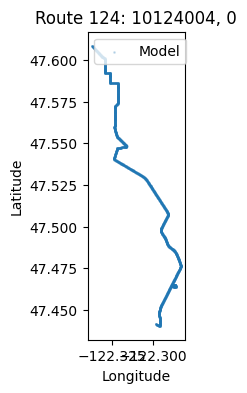

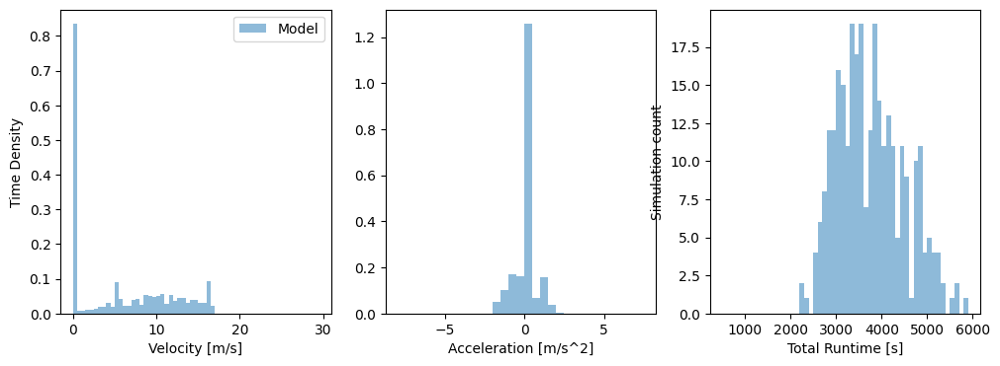

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


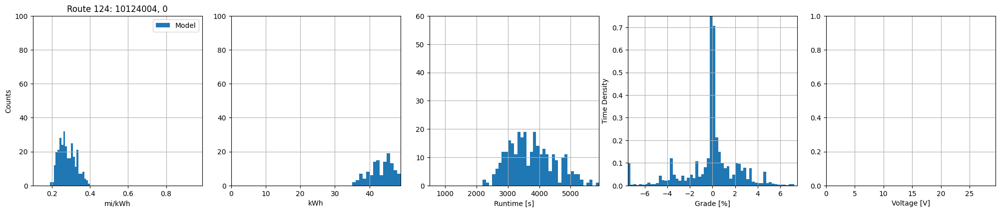

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19022937855035552), np.float64(0.39779774817612007), np.float64(0.28104504364249794), np.float64(0.04392651447775264))
Energy min/max/mean/std [kWh]: 		(np.float64(35.063611696188325), np.float64(73.32319477652796), np.float64(50.82826409132103), np.float64(7.804939313414926))
Time min/max/mean/std [s]: 		(np.float64(2225.774969580043), np.float64(6525.095651643044), np.float64(3779.7344438063355), np.float64(754.5186689450364))
|Grade| mean/std [%]: 			(np.float64(1.3161992890510723), np.float64(1.5489962604853107))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



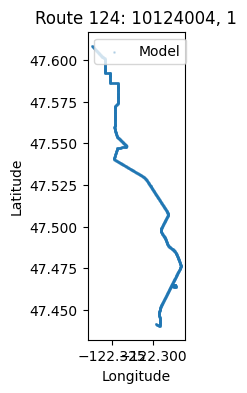

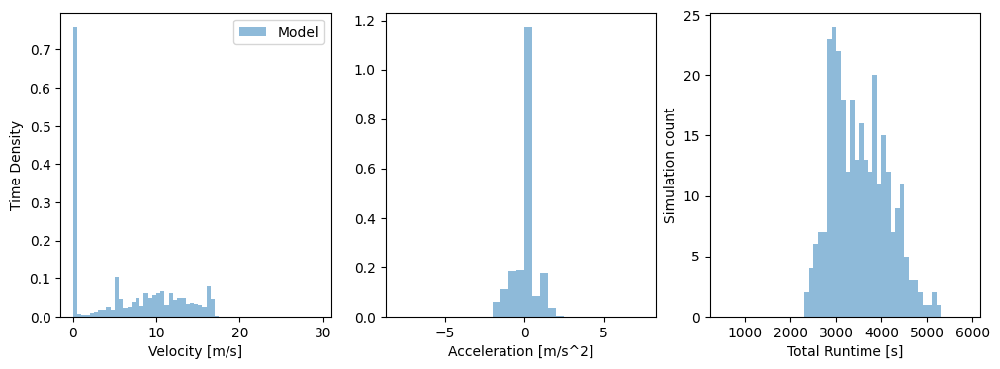

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


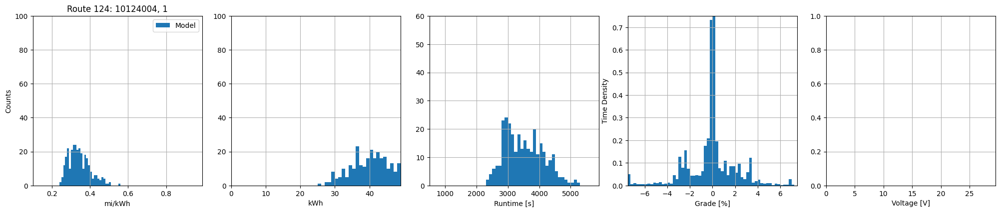

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2428391744068523), np.float64(0.5540084313049619), np.float64(0.344416673170343), np.float64(0.05674819531347027))
Energy min/max/mean/std [kWh]: 		(np.float64(25.175953111368234), np.float64(57.435915452703924), np.float64(41.5403721706199), np.float64(6.481558569254301))
Time min/max/mean/std [s]: 		(np.float64(2314.45753971677), np.float64(5242.049590636203), np.float64(3520.7784033373705), np.float64(612.9153723052071))
|Grade| mean/std [%]: 			(np.float64(1.3248064272456952), np.float64(1.5089733206574591))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



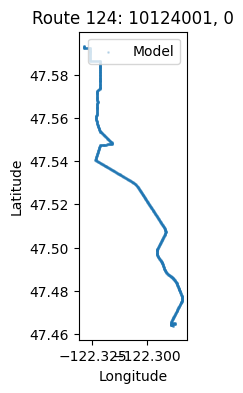

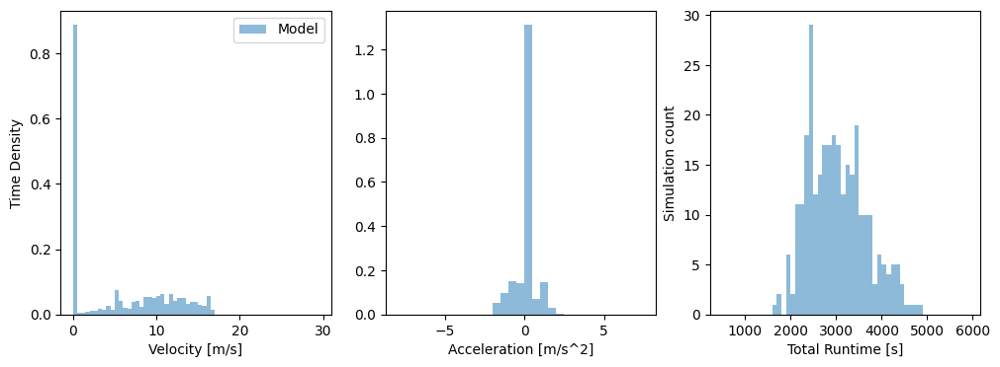

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


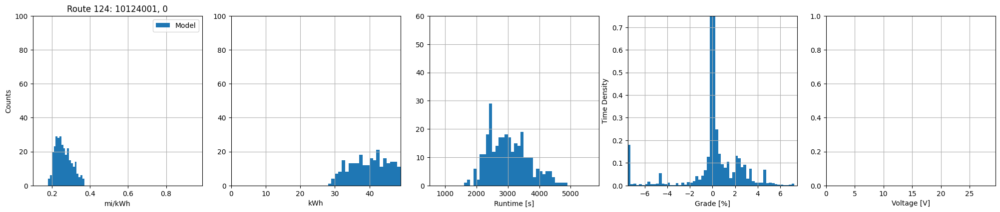

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1813085690395469), np.float64(0.3681373619614273), np.float64(0.2611256798169942), np.float64(0.042400004714977055))
Energy min/max/mean/std [kWh]: 		(np.float64(28.806425553246562), np.float64(58.48990793368042), np.float64(41.66076032498487), np.float64(6.582985311999712))
Time min/max/mean/std [s]: 		(np.float64(1687.1607444768601), np.float64(4842.067892935025), np.float64(3020.840308132846), np.float64(640.0412992824381))
|Grade| mean/std [%]: 			(np.float64(1.123206957029397), np.float64(1.4976332734662259))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



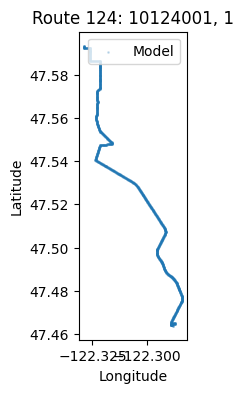

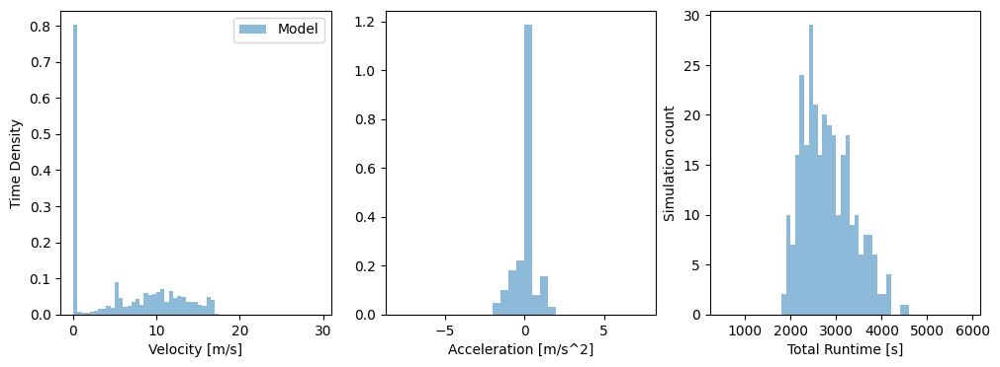

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


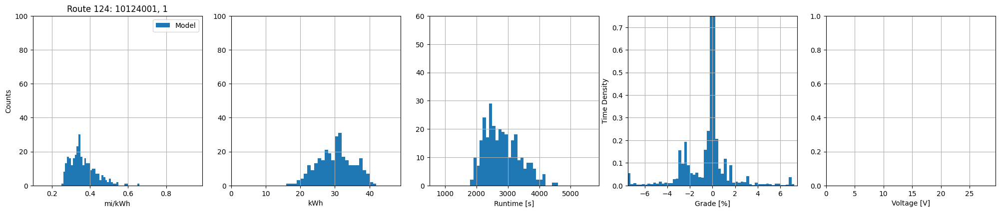

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.25296796552981676), np.float64(0.653480877049271), np.float64(0.362829768567278), np.float64(0.06729078097355977))
Energy min/max/mean/std [kWh]: 		(np.float64(16.227208351865016), np.float64(41.91902450426324), np.float64(30.14610548710242), np.float64(5.108683650623778))
Time min/max/mean/std [s]: 		(np.float64(1806.780542313767), np.float64(4584.1719116522845), np.float64(2811.6160641378033), np.float64(551.0746909991087))
|Grade| mean/std [%]: 			(np.float64(1.103797330928286), np.float64(1.4592282859407033))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



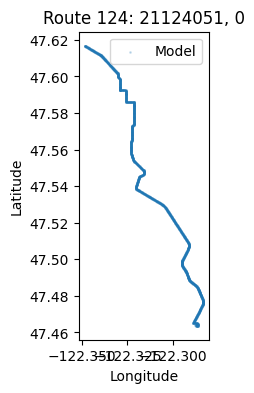

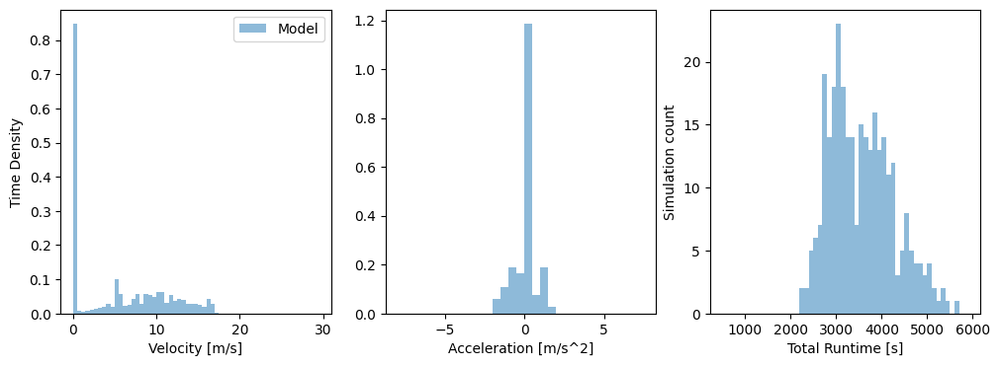

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


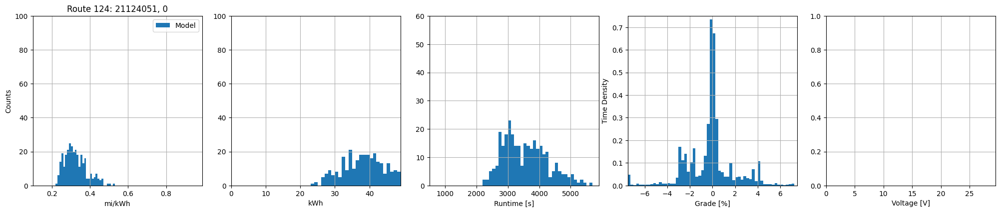

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22988723997314633), np.float64(0.528330316522374), np.float64(0.32494736637883825), np.float64(0.057949214615868654))
Energy min/max/mean/std [kWh]: 		(np.float64(23.274569275892595), np.float64(53.48996557569118), np.float64(38.979070163697074), np.float64(6.5375383602468675))
Time min/max/mean/std [s]: 		(np.float64(2235.344268377185), np.float64(5667.002912553286), np.float64(3563.359402453549), np.float64(699.4661965639946))
|Grade| mean/std [%]: 			(np.float64(1.295945386127119), np.float64(1.4501233255875106))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



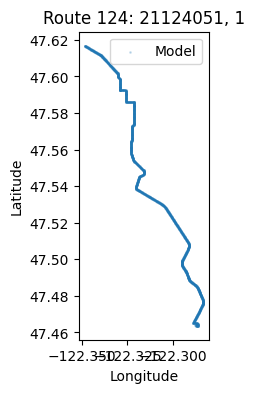

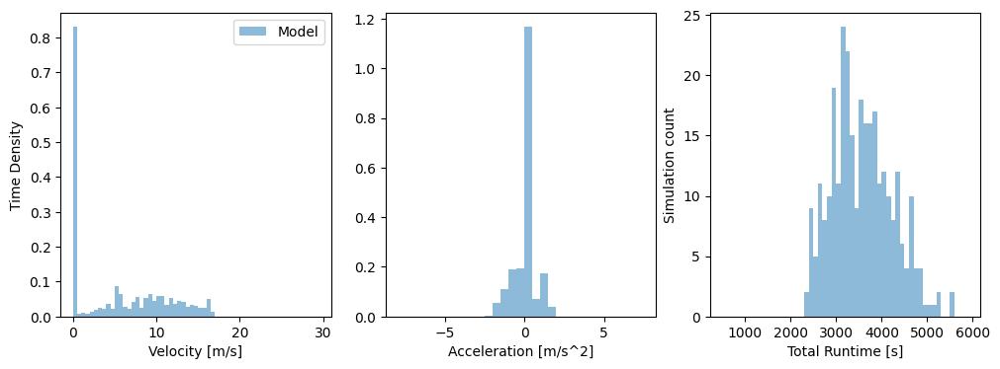

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


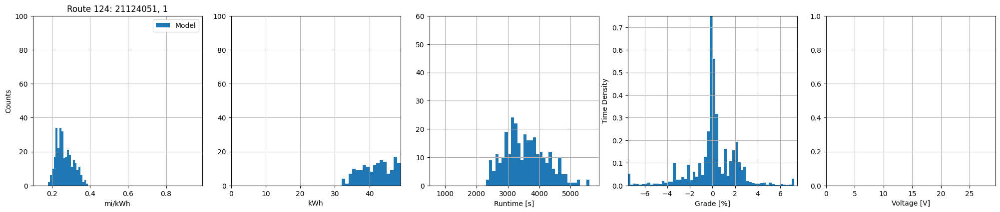

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1871429782767837), np.float64(0.3836520954615581), np.float64(0.26768789419171135), np.float64(0.0436540580298508))
Energy min/max/mean/std [kWh]: 		(np.float64(32.05304352230645), np.float64(65.71027898821754), np.float64(47.1312735480655), np.float64(7.451402306204322))
Time min/max/mean/std [s]: 		(np.float64(2377.6529461343207), np.float64(5557.110772012709), np.float64(3572.2430260051196), np.float64(659.5090308930121))
|Grade| mean/std [%]: 			(np.float64(1.2676004755125443), np.float64(1.448235169014069))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



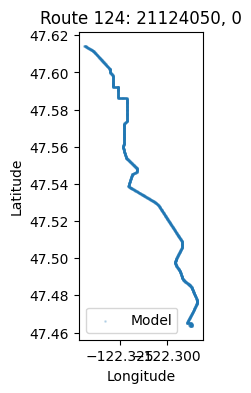

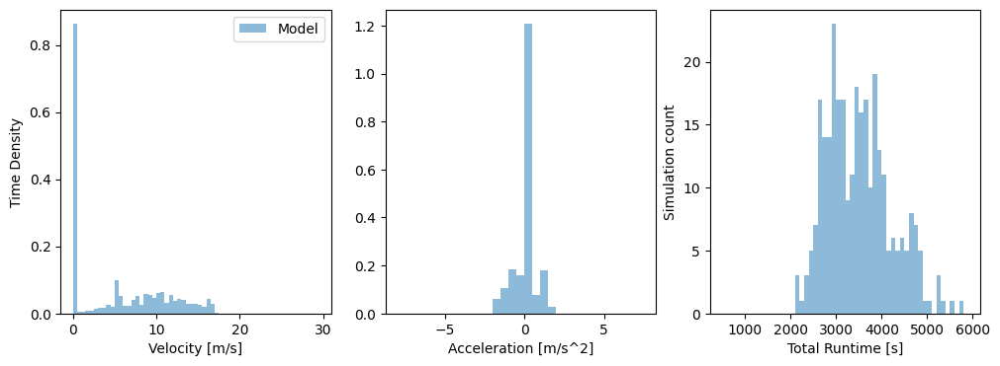

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


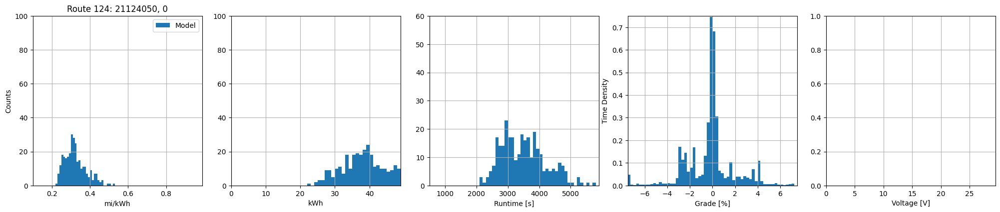

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2243050479587018), np.float64(0.5264383488659891), np.float64(0.3233724181867426), np.float64(0.057008769877253646))
Energy min/max/mean/std [kWh]: 		(np.float64(22.864972549196782), np.float64(53.6635198592656), np.float64(38.31622280884201), np.float64(6.3586181806785955))
Time min/max/mean/std [s]: 		(np.float64(2172.7644648072223), np.float64(5757.623326686438), np.float64(3500.843045384419), np.float64(701.9946706214536))
|Grade| mean/std [%]: 			(np.float64(1.295054059034048), np.float64(1.4620277225677412))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



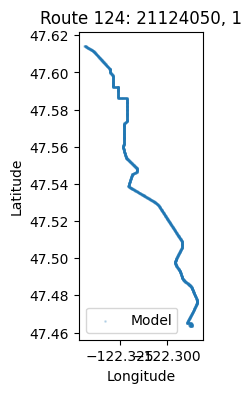

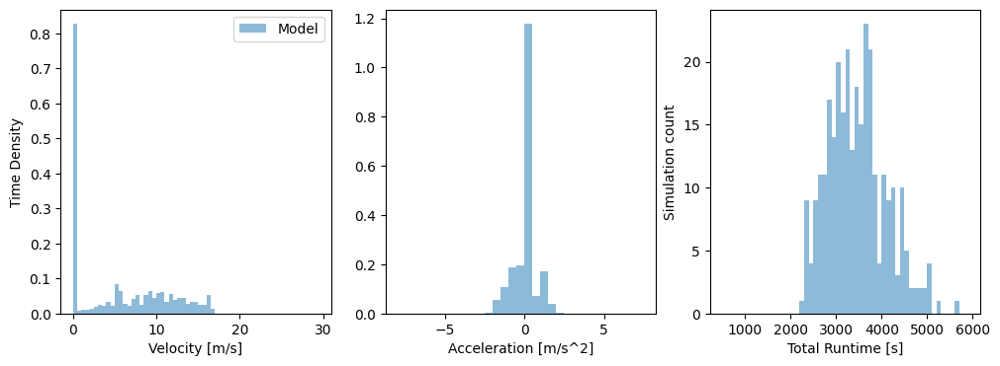

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


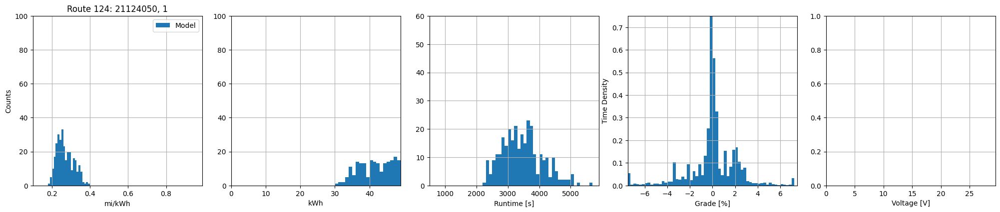

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18857674407710423), np.float64(0.3955094453982557), np.float64(0.2698766375129504), np.float64(0.04386588779877856))
Energy min/max/mean/std [kWh]: 		(np.float64(30.43557188477879), np.float64(63.83372570907128), np.float64(45.75225316097623), np.float64(7.195487855263823))
Time min/max/mean/std [s]: 		(np.float64(2238.2647630379674), np.float64(5678.379743067726), np.float64(3461.032743230207), np.float64(642.1937979494517))
|Grade| mean/std [%]: 			(np.float64(1.257660152972558), np.float64(1.4627000588266121))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



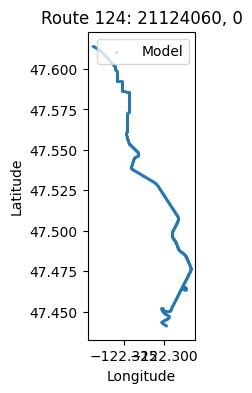

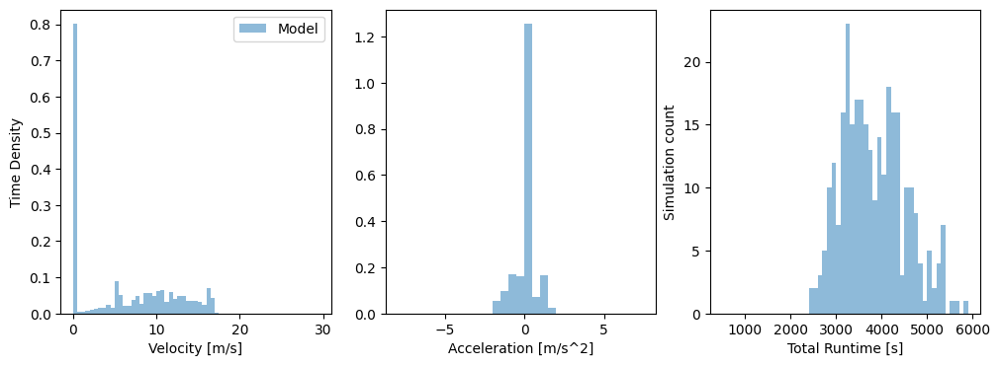

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


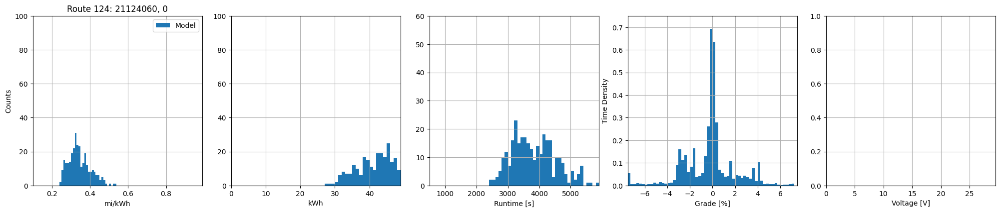

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2445879856194737), np.float64(0.5359125100693902), np.float64(0.34457248188934403), np.float64(0.05679645694854015))
Energy min/max/mean/std [kWh]: 		(np.float64(27.497604029965412), np.float64(60.24952517299632), np.float64(43.88362688649051), np.float64(6.929632629260972))
Time min/max/mean/std [s]: 		(np.float64(2421.0001131087856), np.float64(6000.884403469173), np.float64(3840.6322261864357), np.float64(715.4001480494024))
|Grade| mean/std [%]: 			(np.float64(1.398812745707623), np.float64(1.511914597339793))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



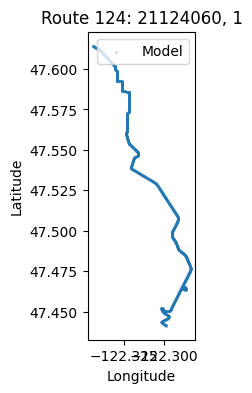

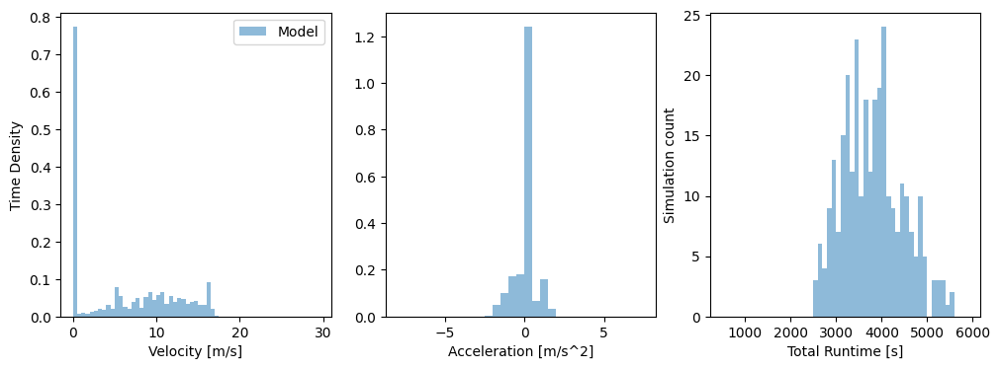

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


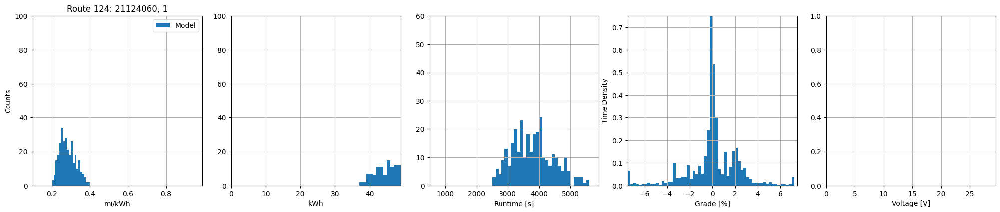

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20578107877705043), np.float64(0.39721878678491923), np.float64(0.2848240885552998), np.float64(0.042176269661118836))
Energy min/max/mean/std [kWh]: 		(np.float64(37.10148392678649), np.float64(71.61691697264972), np.float64(52.8555402307683), np.float64(7.64178952984582))
Time min/max/mean/std [s]: 		(np.float64(2510.617909517853), np.float64(5970.645643727032), np.float64(3811.1109573384756), np.float64(670.6313365306336))
|Grade| mean/std [%]: 			(np.float64(1.351805985721296), np.float64(1.5344767700377655))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



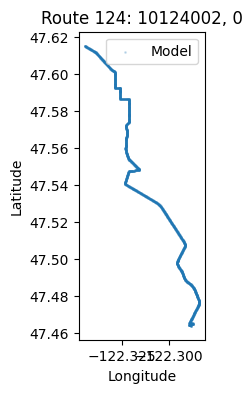

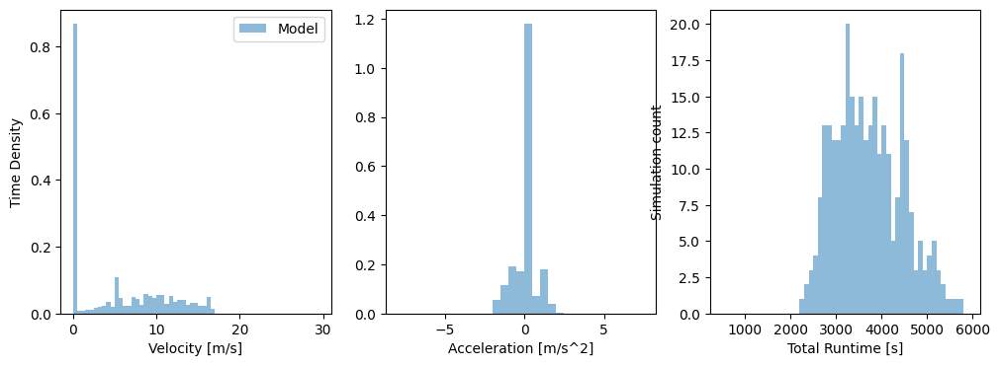

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


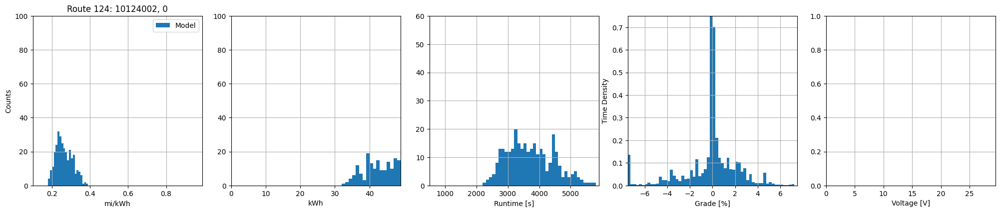

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18301931658991807), np.float64(0.3805393797086215), np.float64(0.26485539122280527), np.float64(0.04288291287885898))
Energy min/max/mean/std [kWh]: 		(np.float64(32.55015385824832), np.float64(67.67927882930553), np.float64(47.9760187226013), np.float64(7.611073543068768))
Time min/max/mean/std [s]: 		(np.float64(2258.6769327684233), np.float64(6360.608879275649), np.float64(3737.856100641081), np.float64(766.3121493704489))
|Grade| mean/std [%]: 			(np.float64(1.265398059430268), np.float64(1.475170030343391))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



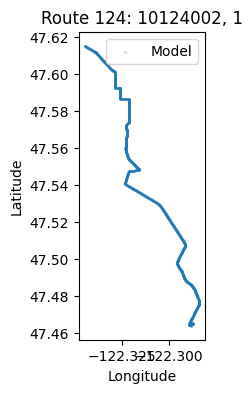

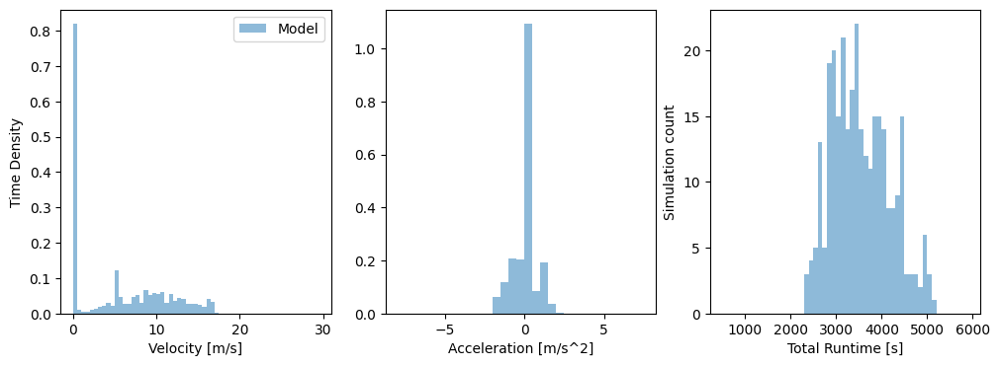

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


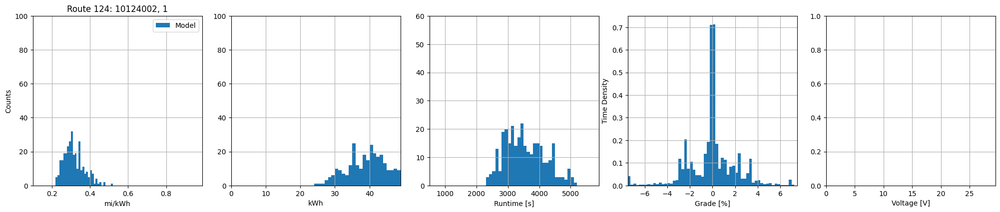

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2219609481925276), np.float64(0.5144069970030867), np.float64(0.31605007300586757), np.float64(0.053279347506443295))
Energy min/max/mean/std [kWh]: 		(np.float64(24.078155498613754), np.float64(55.80248131158524), np.float64(40.24715491880306), np.float64(6.42758630898907))
Time min/max/mean/std [s]: 		(np.float64(2343.317131147165), np.float64(5163.727609692741), np.float64(3547.240296754459), np.float64(636.9365964384456))
|Grade| mean/std [%]: 			(np.float64(1.3202440855479656), np.float64(1.4261362746513648))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------131-------------------


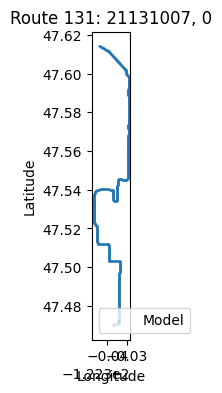

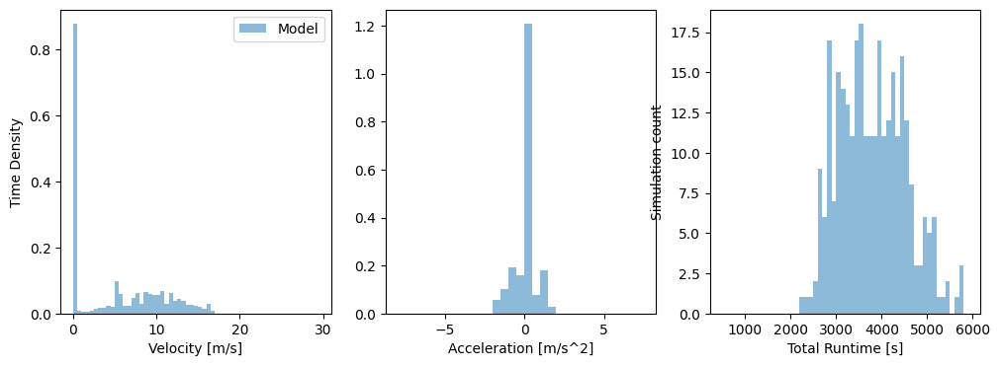

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


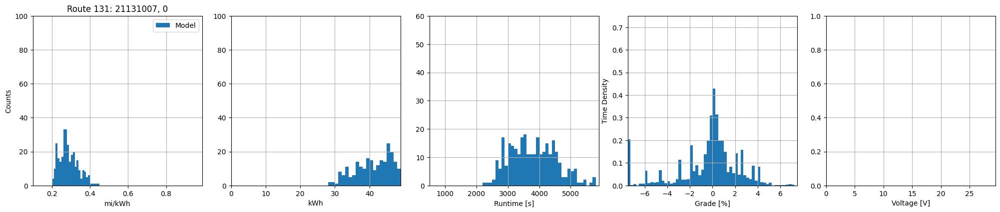

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20016104872498328), np.float64(0.4410266734927697), np.float64(0.2884087640999443), np.float64(0.049386013378801254))
Energy min/max/mean/std [kWh]: 		(np.float64(28.124717972857166), np.float64(61.968854027808284), np.float64(44.22309577276232), np.float64(7.261976098268402))
Time min/max/mean/std [s]: 		(np.float64(2259.5444288117737), np.float64(6071.181895271598), np.float64(3815.43189655163), np.float64(749.3631645599417))
|Grade| mean/std [%]: 			(np.float64(1.6097399387526459), np.float64(1.55400820035023))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



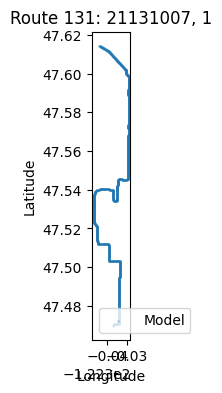

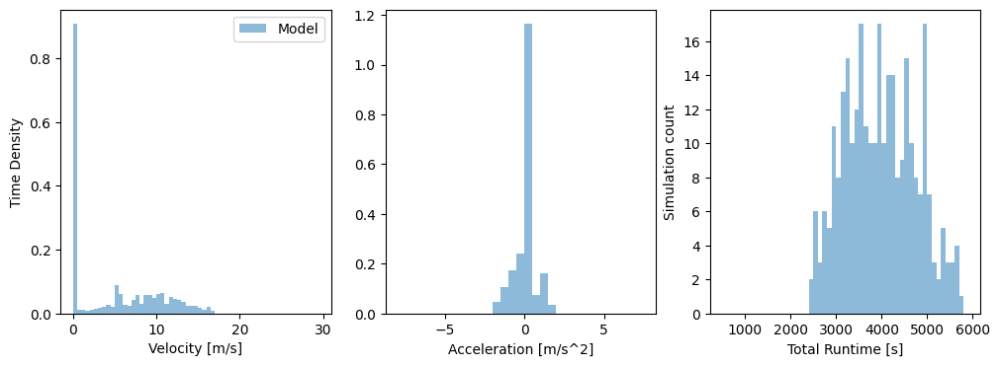

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


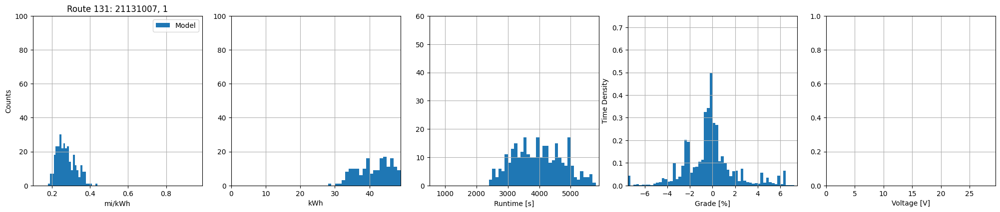

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18353786049892762), np.float64(0.43192151172603266), np.float64(0.275459542025108), np.float64(0.048524418836224624))
Energy min/max/mean/std [kWh]: 		(np.float64(28.716572915257764), np.float64(67.57900278139859), np.float64(46.37965413045225), np.float64(7.845303422078711))
Time min/max/mean/std [s]: 		(np.float64(2462.4535356378037), np.float64(6307.204033116919), np.float64(4006.2548588624186), np.float64(812.0676293658511))
|Grade| mean/std [%]: 			(np.float64(1.5345291671106076), np.float64(1.5633255093884624))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



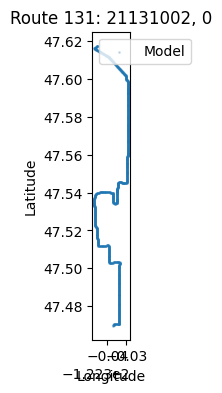

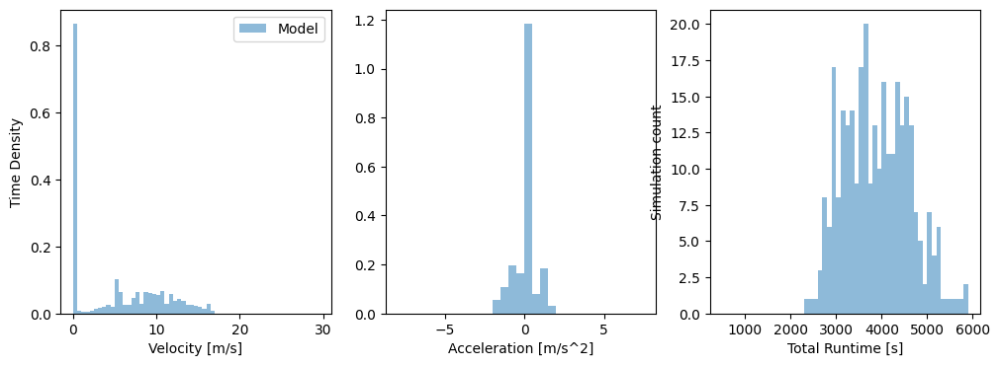

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


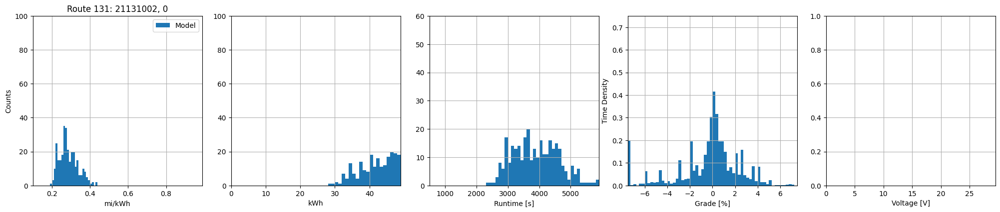

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19899088118670155), np.float64(0.43983857503140206), np.float64(0.28703553279591754), np.float64(0.04849401374746421))
Energy min/max/mean/std [kWh]: 		(np.float64(28.89918562673466), np.float64(63.877181455892845), np.float64(45.50425967455652), np.float64(7.3886700449467995))
Time min/max/mean/std [s]: 		(np.float64(2322.2443603779607), np.float64(6189.841336818179), np.float64(3917.495525758339), np.float64(752.7016204480926))
|Grade| mean/std [%]: 			(np.float64(1.623017829147155), np.float64(1.5528118080147257))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



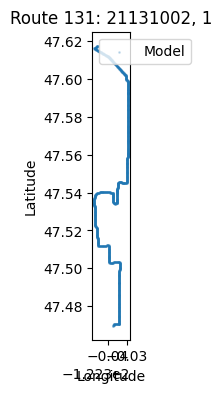

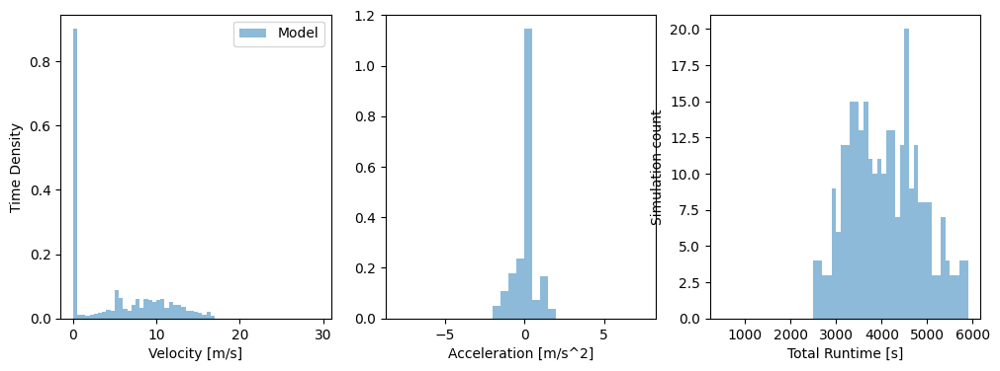

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


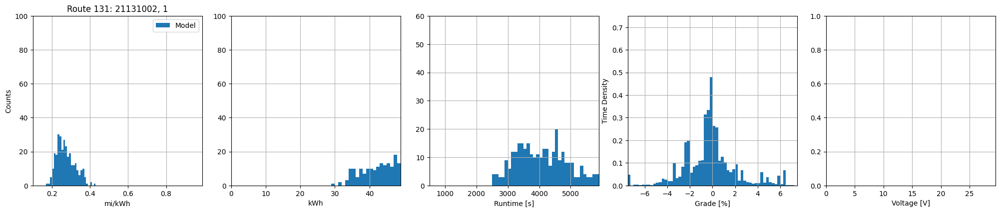

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17346551234338034), np.float64(0.424228893198876), np.float64(0.2733438869283073), np.float64(0.04767511979706842))
Energy min/max/mean/std [kWh]: 		(np.float64(29.96123390967918), np.float64(73.27347625858425), np.float64(47.86920617521531), np.float64(8.034885208204097))
Time min/max/mean/std [s]: 		(np.float64(2512.5302838509824), np.float64(6804.35443861125), np.float64(4118.565511423399), np.float64(840.6324022091991))
|Grade| mean/std [%]: 			(np.float64(1.5590656670080862), np.float64(1.561050603699476))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



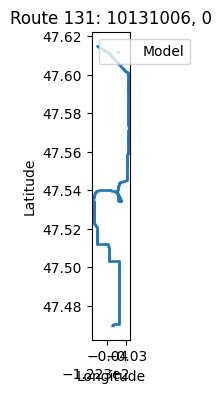

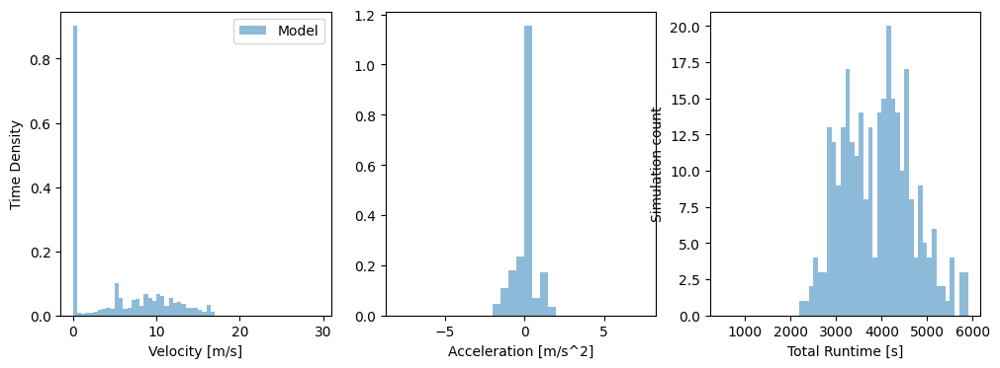

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


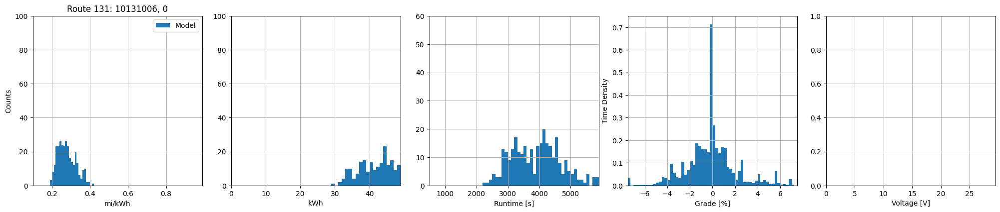

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19184222367289255), np.float64(0.41703630746709264), np.float64(0.27934622808510295), np.float64(0.04698393955006431))
Energy min/max/mean/std [kWh]: 		(np.float64(29.883292057782796), np.float64(64.96180838681231), np.float64(45.84550594845444), np.float64(7.478171362972108))
Time min/max/mean/std [s]: 		(np.float64(2205.088605156075), np.float64(6478.844252675849), np.float64(3944.108527295459), np.float64(814.7539677345047))
|Grade| mean/std [%]: 			(np.float64(1.5038483140742949), np.float64(1.508102900839464))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



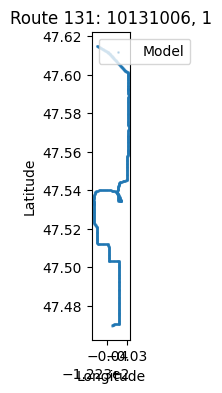

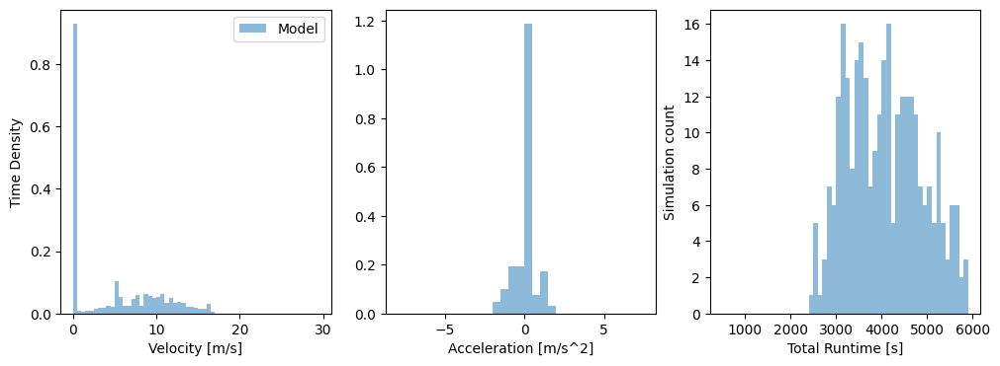

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


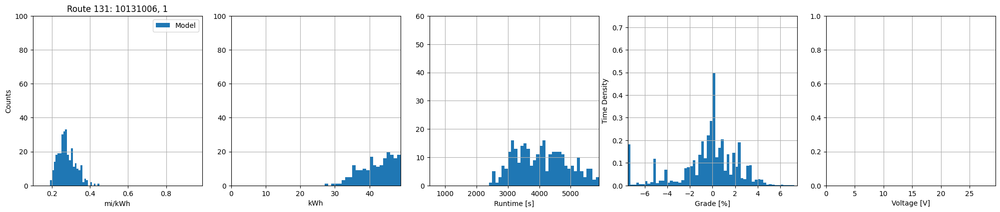

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1978110854074487), np.float64(0.4488999537131675), np.float64(0.2785854960370273), np.float64(0.04590290412720667))
Energy min/max/mean/std [kWh]: 		(np.float64(27.76233610120483), np.float64(63.002087901849016), np.float64(45.90831025901599), np.float64(7.2940467558717))
Time min/max/mean/std [s]: 		(np.float64(2453.029221954571), np.float64(6537.03013222014), np.float64(4118.290916256422), np.float64(861.276251287104))
|Grade| mean/std [%]: 			(np.float64(1.6150923586758583), np.float64(1.5217397688149321))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



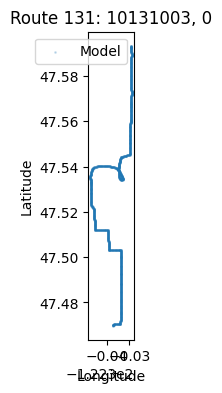

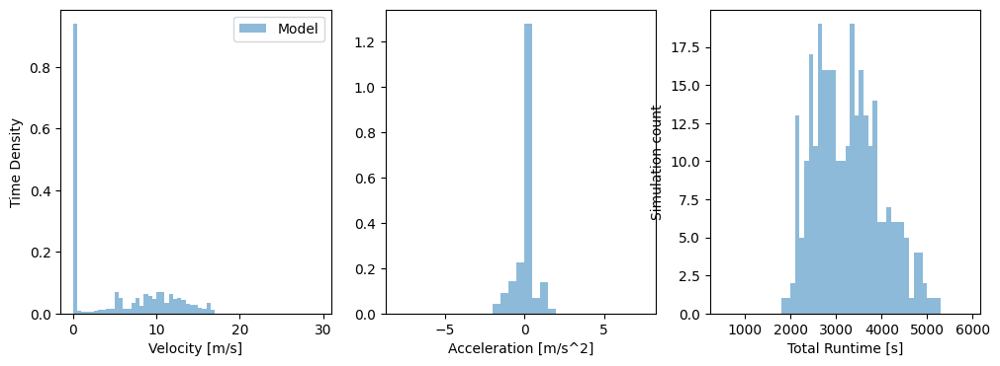

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


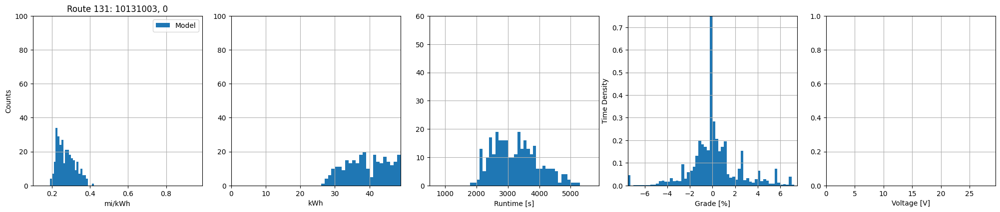

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1941925022573414), np.float64(0.41017781875325976), np.float64(0.275466207173636), np.float64(0.04729638786618657))
Energy min/max/mean/std [kWh]: 		(np.float64(26.03840050163248), np.float64(54.998901592142325), np.float64(39.880596040961464), np.float64(6.578128667687448))
Time min/max/mean/std [s]: 		(np.float64(1863.9738227055464), np.float64(5299.080357857724), np.float64(3265.2317235544865), np.float64(730.7449168147303))
|Grade| mean/std [%]: 			(np.float64(1.425344334435243), np.float64(1.553280283997119))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



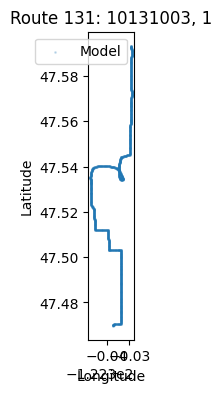

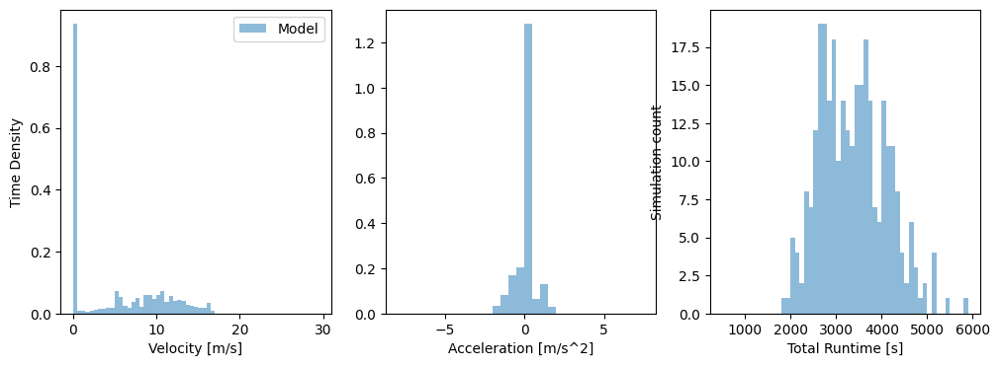

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


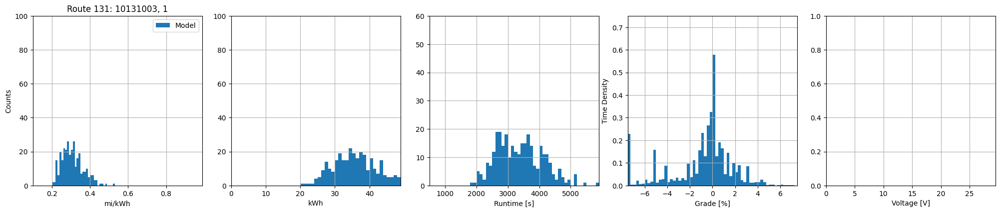

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2042568148927598), np.float64(0.5250436570323929), np.float64(0.3077962676831856), np.float64(0.05577904025076801))
Energy min/max/mean/std [kWh]: 		(np.float64(20.34223311707693), np.float64(52.28986104381926), np.float64(35.793217262586296), np.float64(6.205589528833968))
Time min/max/mean/std [s]: 		(np.float64(1849.39220021812), np.float64(5881.220125573049), np.float64(3379.964576033683), np.float64(729.5059178005665))
|Grade| mean/std [%]: 			(np.float64(1.5427643018848198), np.float64(1.6187309123538218))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------132-------------------


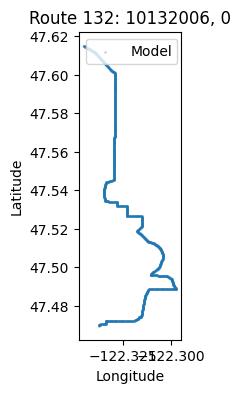

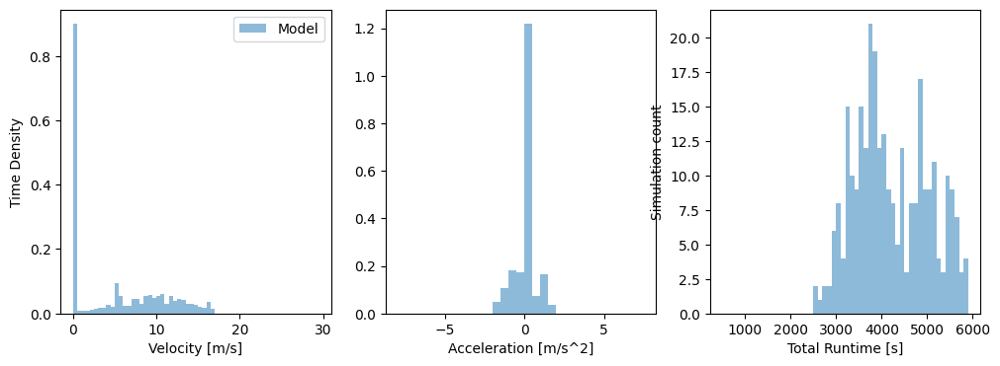

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


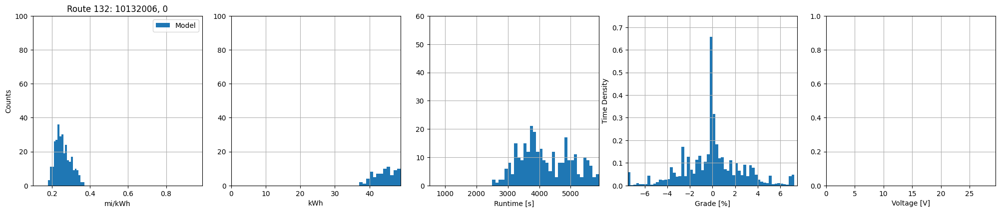

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18294981364401303), np.float64(0.36419661474836235), np.float64(0.25865604875678677), np.float64(0.04002542157574298))
Energy min/max/mean/std [kWh]: 		(np.float64(37.88647168176103), np.float64(75.42027213050731), np.float64(54.58808962988602), np.float64(8.177886354907447))
Time min/max/mean/std [s]: 		(np.float64(2531.4959018075233), np.float64(6726.439787191972), np.float64(4284.040950787728), np.float64(883.1460637987932))
|Grade| mean/std [%]: 			(np.float64(1.8111604263862862), np.float64(1.7402272565120387))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



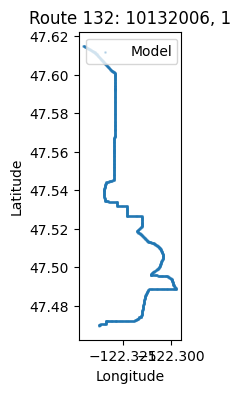

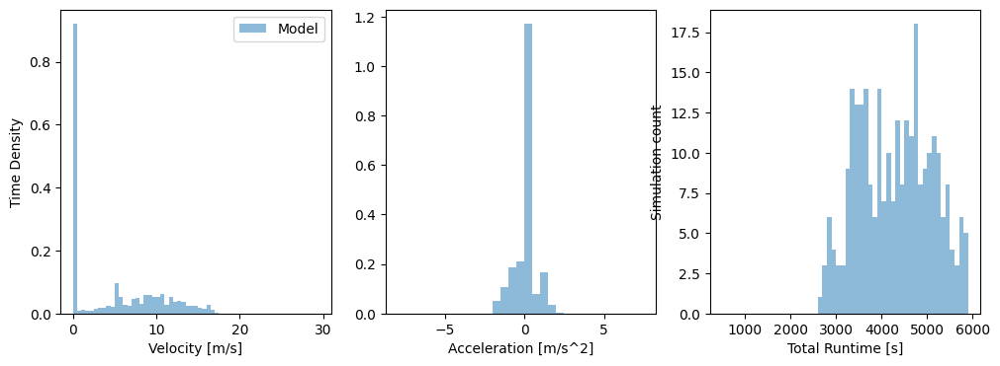

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


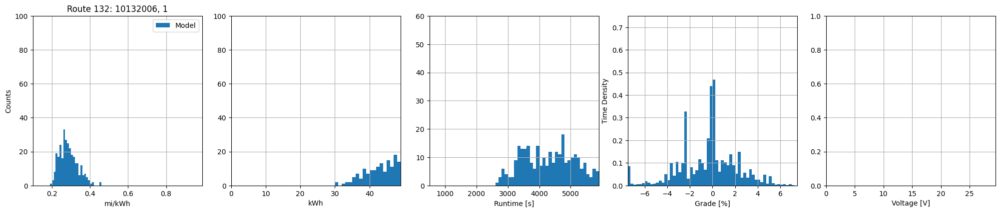

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19822133584218019), np.float64(0.45688023295212693), np.float64(0.28807858487099725), np.float64(0.04791582681680302))
Energy min/max/mean/std [kWh]: 		(np.float64(30.19963092853522), np.float64(69.60711043075005), np.float64(49.162316163805386), np.float64(7.801212093306344))
Time min/max/mean/std [s]: 		(np.float64(2646.0298263426203), np.float64(7249.950849246564), np.float64(4461.601144597886), np.float64(959.1919274658097))
|Grade| mean/std [%]: 			(np.float64(1.7676489993931923), np.float64(1.5456671540795772))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



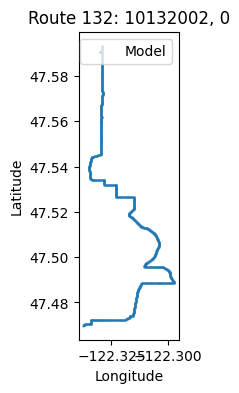

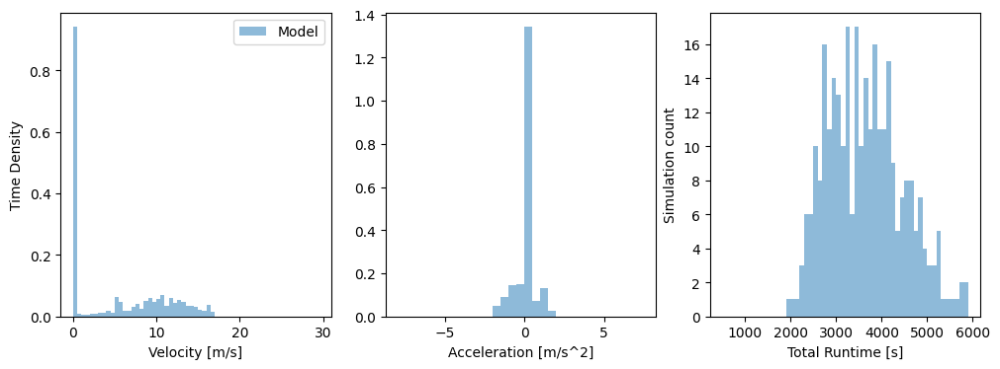

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


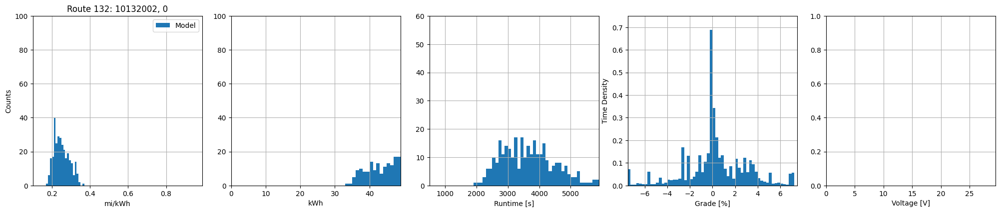

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.179660343840581), np.float64(0.36095644988205217), np.float64(0.25188408613213553), np.float64(0.039866307246715735))
Energy min/max/mean/std [kWh]: 		(np.float64(33.28955967410599), np.float64(66.88221240834493), np.float64(48.87000385694181), np.float64(7.4891235359241195))
Time min/max/mean/std [s]: 		(np.float64(1984.251243924063), np.float64(5891.574139081025), np.float64(3644.6042452242227), np.float64(822.2278680985177))
|Grade| mean/std [%]: 			(np.float64(1.8310479091608576), np.float64(1.8297878707900013))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



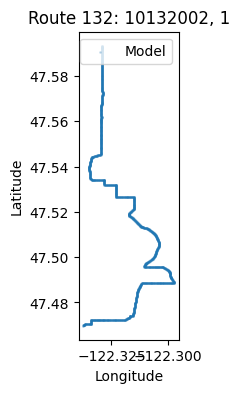

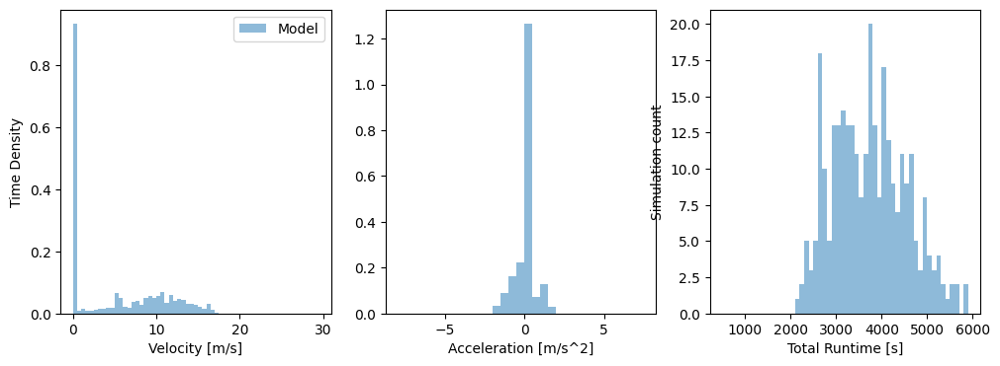

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


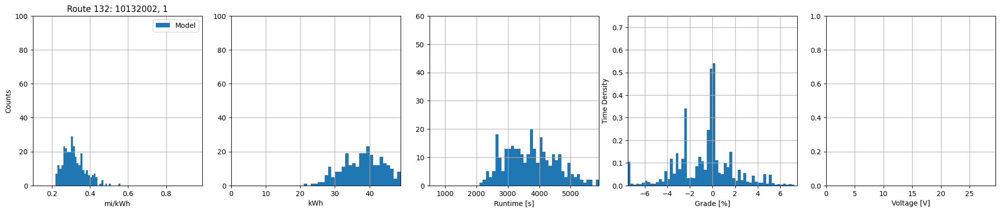

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22193610988078), np.float64(0.5546922793138781), np.float64(0.3174732655263739), np.float64(0.05717509078365713))
Energy min/max/mean/std [kWh]: 		(np.float64(21.661854579543416), np.float64(54.14019150532692), np.float64(39.00631478778494), np.float64(6.618875190408623))
Time min/max/mean/std [s]: 		(np.float64(2177.808194330369), np.float64(6339.692726405361), np.float64(3748.265606779515), np.float64(825.3088349205008))
|Grade| mean/std [%]: 			(np.float64(1.716102641085579), np.float64(1.6166406319212623))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------14-------------------


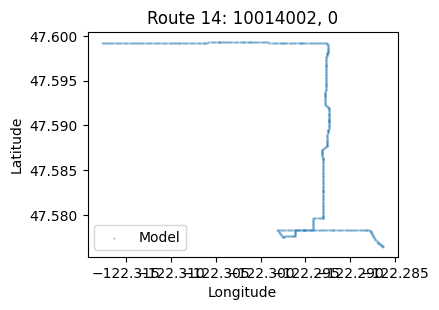

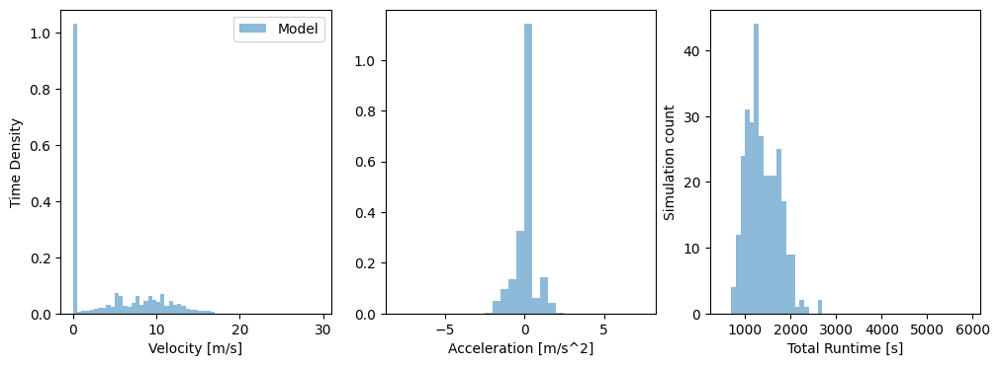

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


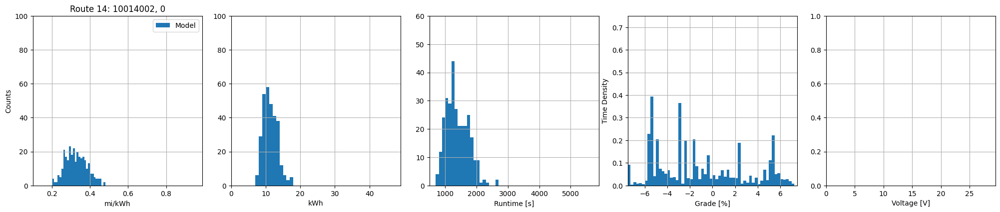

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20232158975266568), np.float64(0.47918091844312327), np.float64(0.32771308643656194), np.float64(0.05680700223850899))
Energy min/max/mean/std [kWh]: 		(np.float64(7.504880084003282), np.float64(17.774649437336258), np.float64(11.314154786381053), np.float64(2.0195759709451417))
Time min/max/mean/std [s]: 		(np.float64(752.120179312748), np.float64(2635.609958727586), np.float64(1387.8963547579683), np.float64(353.322623941161))
|Grade| mean/std [%]: 			(np.float64(3.5030003006461365), np.float64(1.855748653313475))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



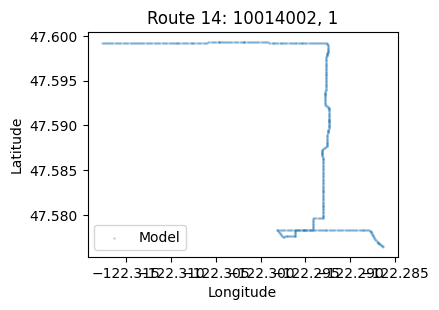

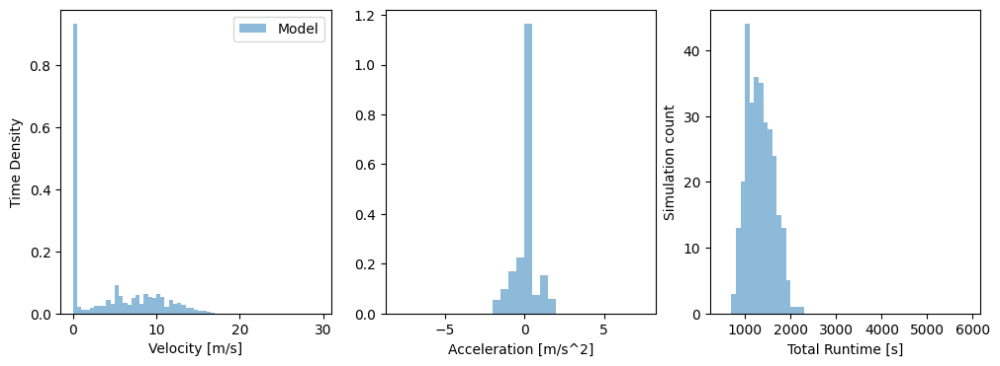

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


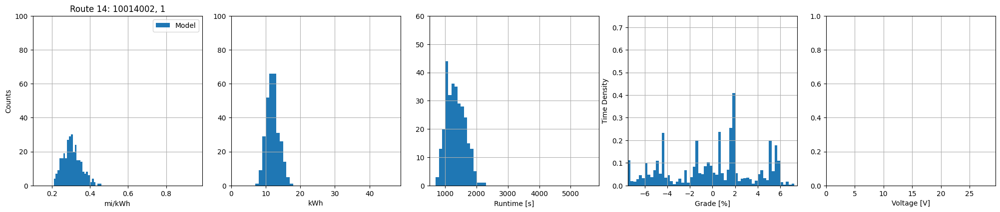

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2113190640003985), np.float64(0.4557088254544723), np.float64(0.3064843935515817), np.float64(0.04732528314017663))
Energy min/max/mean/std [kWh]: 		(np.float64(7.892642220364839), np.float64(17.02045545672139), np.float64(12.01299447562012), np.float64(1.837932815728518))
Time min/max/mean/std [s]: 		(np.float64(751.1826040912553), np.float64(2273.4765003370358), np.float64(1328.3651131231593), np.float64(294.81284137302913))
|Grade| mean/std [%]: 			(np.float64(3.0460424101556267), np.float64(2.0090315577177833))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



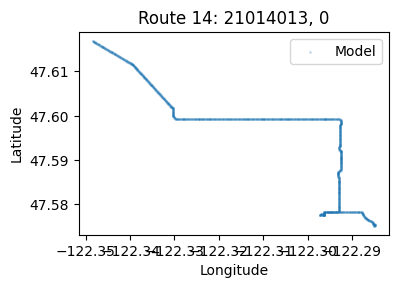

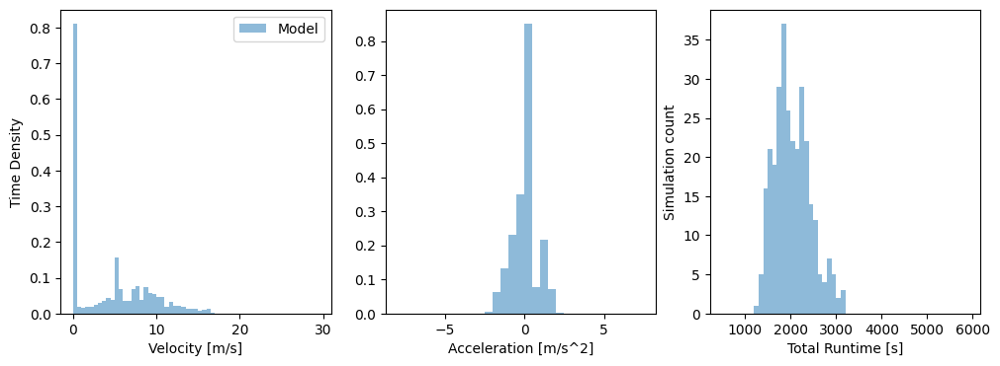

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


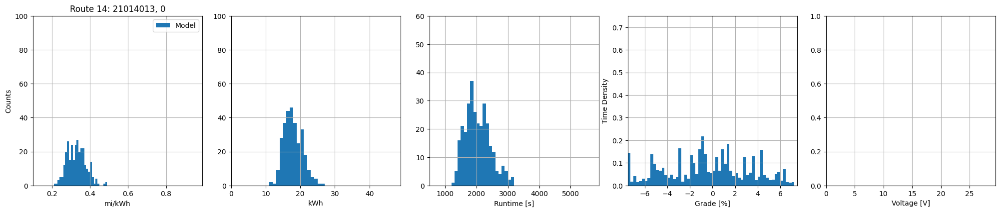

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2168922493983669), np.float64(0.4855297441035729), np.float64(0.33029946495608953), np.float64(0.048106108639036374))
Energy min/max/mean/std [kWh]: 		(np.float64(11.920178465856718), np.float64(26.68422323181416), np.float64(17.895803461486135), np.float64(2.619162384566675))
Time min/max/mean/std [s]: 		(np.float64(1299.242390995777), np.float64(3197.030504721368), np.float64(2039.1725854016072), np.float64(401.4392402492337))
|Grade| mean/std [%]: 			(np.float64(2.8475407630920118), np.float64(1.9371310109540247))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



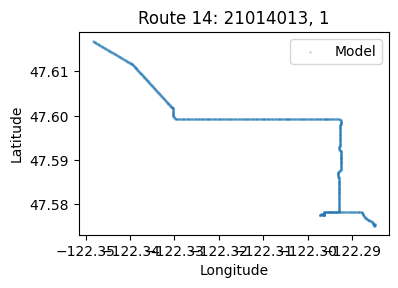

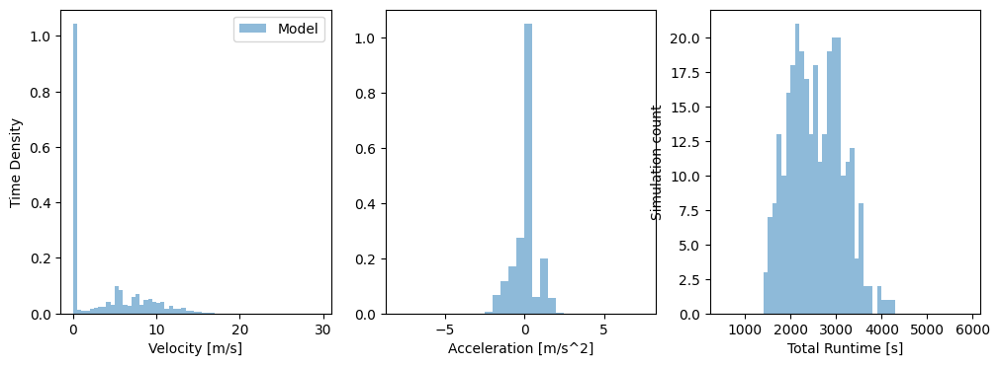

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


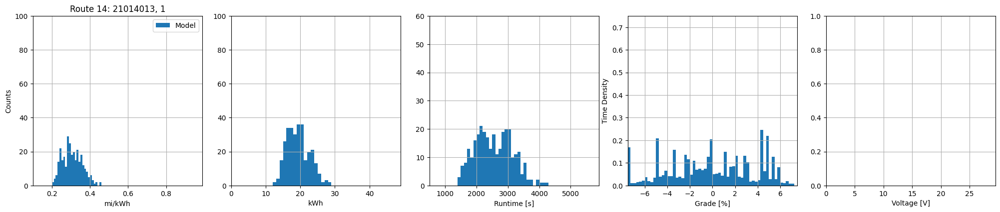

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2006130908858167), np.float64(0.45364799525843935), np.float64(0.30767233557632256), np.float64(0.05125094162542077))
Energy min/max/mean/std [kWh]: 		(np.float64(12.758398967470672), np.float64(28.850670156887606), np.float64(19.34003590380665), np.float64(3.2454214909685986))
Time min/max/mean/std [s]: 		(np.float64(1417.6206824856147), np.float64(4293.742309777088), np.float64(2554.6222999673087), np.float64(581.7075427034068))
|Grade| mean/std [%]: 			(np.float64(2.9759853213879595), np.float64(1.8406274226525867))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



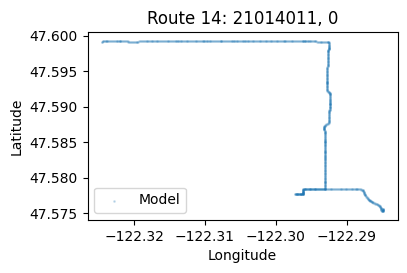

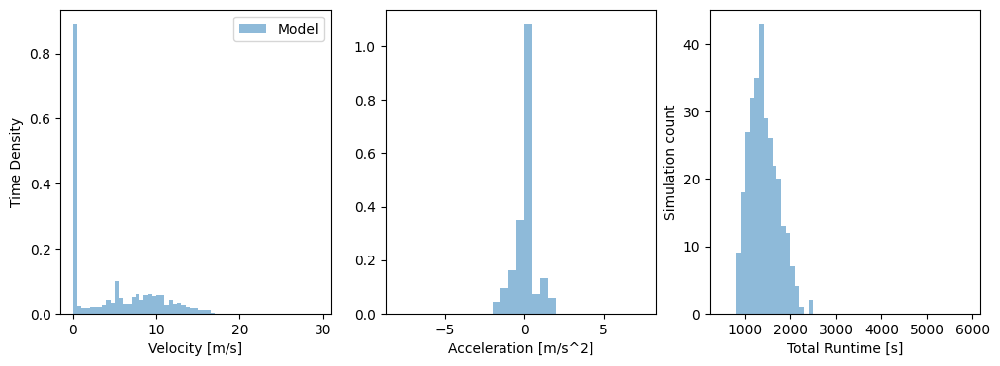

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


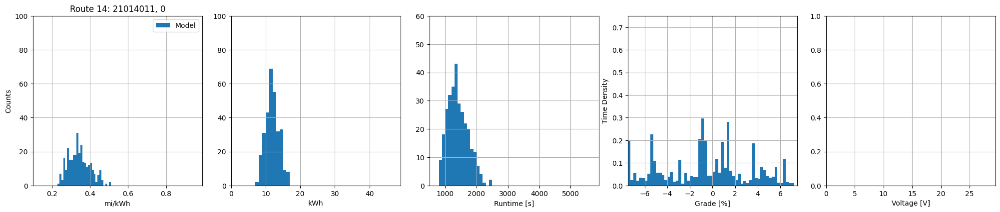

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2399477884829446), np.float64(0.5096944631496192), np.float64(0.344034904148772), np.float64(0.055557914442897705))
Energy min/max/mean/std [kWh]: 		(np.float64(7.858587987854104), np.float64(16.69312649600874), np.float64(11.943859454366912), np.float64(1.9058078688687172))
Time min/max/mean/std [s]: 		(np.float64(800.5750288358668), np.float64(2415.51913461066), np.float64(1411.9618393208375), np.float64(320.6281905856593))
|Grade| mean/std [%]: 			(np.float64(2.9034612325780147), np.float64(2.083724490424345))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



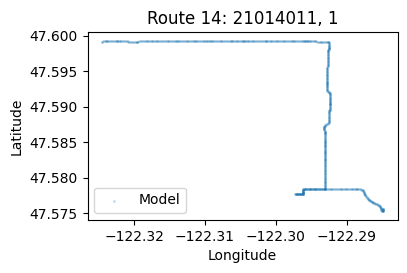

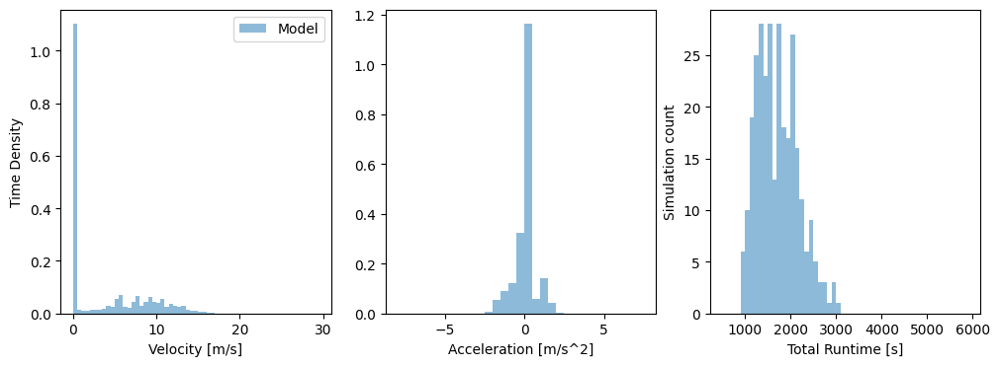

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


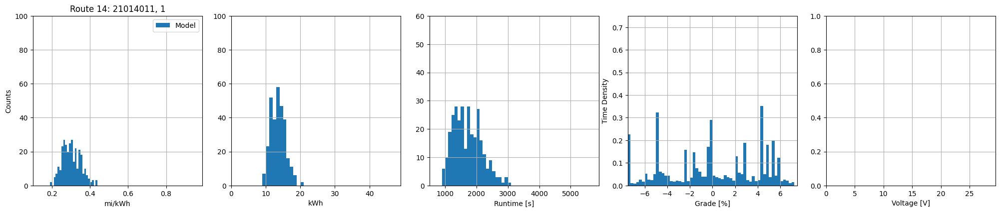

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1935819214677722), np.float64(0.43899827934294167), np.float64(0.302641307360133), np.float64(0.04754022873043685))
Energy min/max/mean/std [kWh]: 		(np.float64(9.12543716990233), np.float64(20.694345760516587), np.float64(13.565188627939861), np.float64(2.1369465384750956))
Time min/max/mean/std [s]: 		(np.float64(930.1686800163045), np.float64(3004.270324874733), np.float64(1714.8910869364734), np.float64(449.4510352896955))
|Grade| mean/std [%]: 			(np.float64(3.2747258851386185), np.float64(1.9640744097485465))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



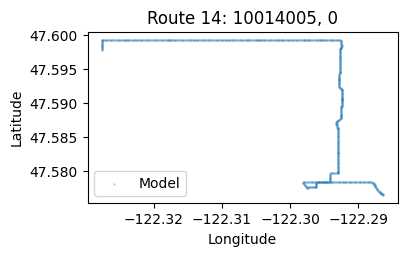

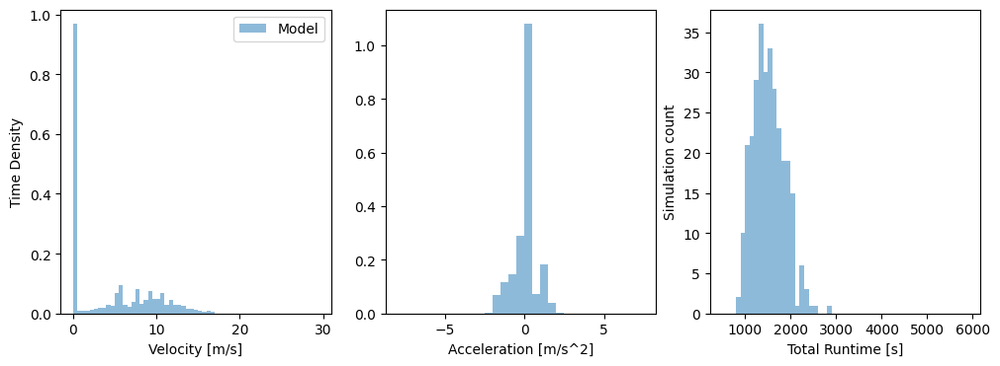

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


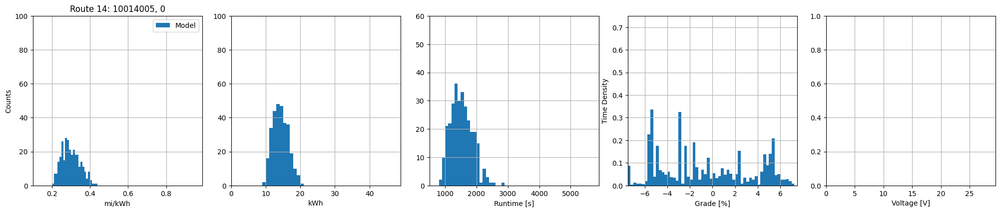

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20369478365466204), np.float64(0.43093180222712435), np.float64(0.2997429723857092), np.float64(0.047593372785700534))
Energy min/max/mean/std [kWh]: 		(np.float64(9.660895279522752), np.float64(20.438358504999318), np.float64(14.24017676815296), np.float64(2.256077218908848))
Time min/max/mean/std [s]: 		(np.float64(836.1845231667288), np.float64(2801.5135385471594), np.float64(1530.5142481670905), np.float64(348.01960928359415))
|Grade| mean/std [%]: 			(np.float64(3.5180283460071924), np.float64(1.8449604488848226))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



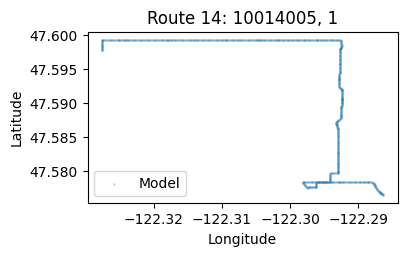

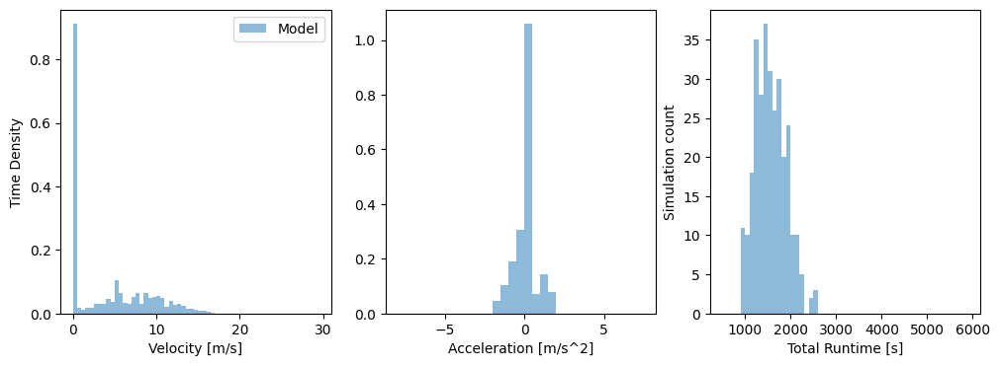

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


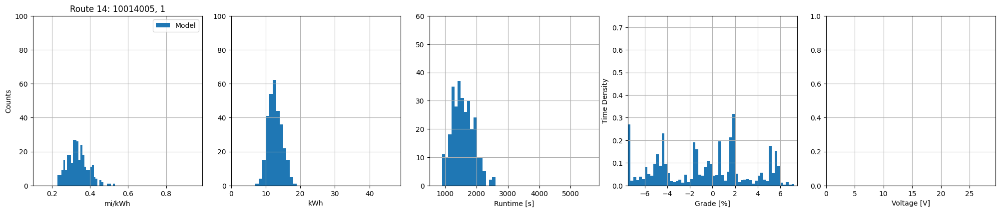

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.23021314351622368), np.float64(0.5268023877297534), np.float64(0.3351016118915855), np.float64(0.05344721746983106))
Energy min/max/mean/std [kWh]: 		(np.float64(7.902674162996953), np.float64(18.083883287157487), np.float64(12.736701186504643), np.float64(2.012101019863257))
Time min/max/mean/std [s]: 		(np.float64(908.3975223251446), np.float64(2591.7395083415067), np.float64(1566.8543522754605), np.float64(339.4891168398004))
|Grade| mean/std [%]: 			(np.float64(3.114250329986479), np.float64(1.995589675000112))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



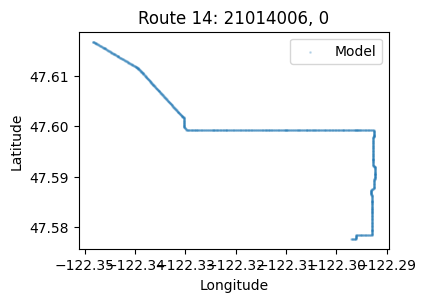

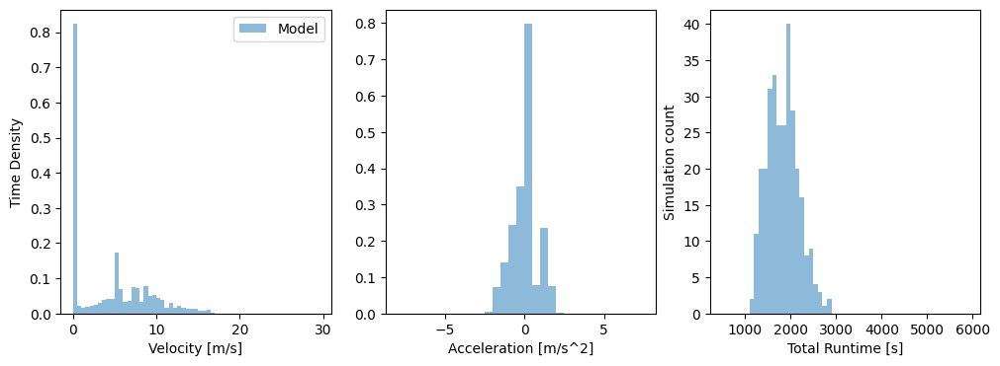

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


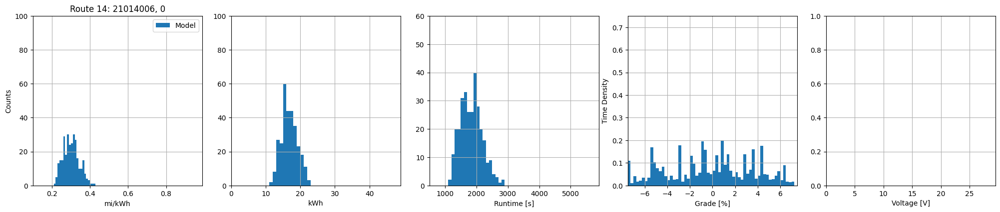

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2194933367632058), np.float64(0.42780548120117745), np.float64(0.3013764708263935), np.float64(0.04131999723911906))
Energy min/max/mean/std [kWh]: 		(np.float64(11.650835277388568), np.float64(22.708166296711013), np.float64(16.849079507316564), np.float64(2.3044355882190017))
Time min/max/mean/std [s]: 		(np.float64(1134.8173213565346), np.float64(2872.4578449371074), np.float64(1834.3344430841241), np.float64(342.9555217037251))
|Grade| mean/std [%]: 			(np.float64(2.976750545236341), np.float64(1.9513692378971468))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



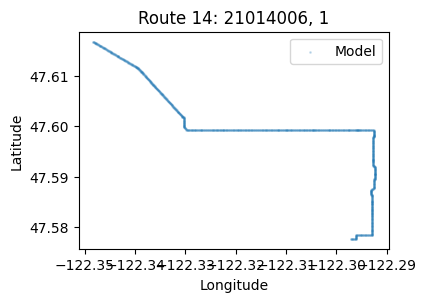

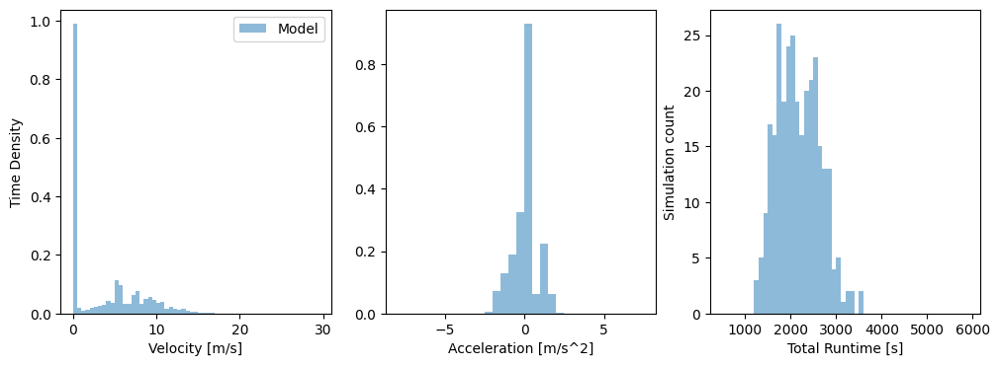

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


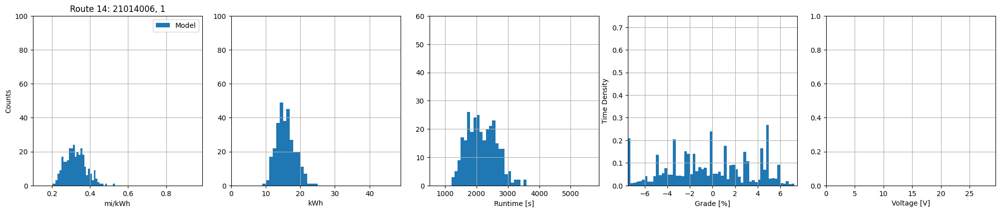

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2075771483437186), np.float64(0.523615851815242), np.float64(0.3250948804569825), np.float64(0.0545978645285138))
Energy min/max/mean/std [kWh]: 		(np.float64(9.519556312300768), np.float64(24.01319522472073), np.float64(15.76493390719667), np.float64(2.64077745416397))
Time min/max/mean/std [s]: 		(np.float64(1212.6437102618033), np.float64(3577.669856434163), np.float64(2175.0506623087663), np.float64(464.7910863361691))
|Grade| mean/std [%]: 			(np.float64(2.9221457539546063), np.float64(1.8157256912079045))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



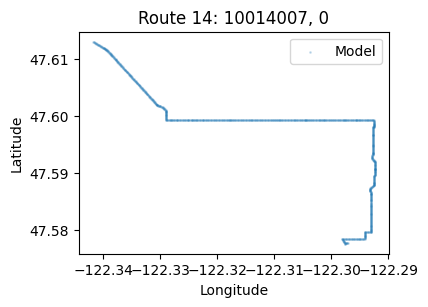

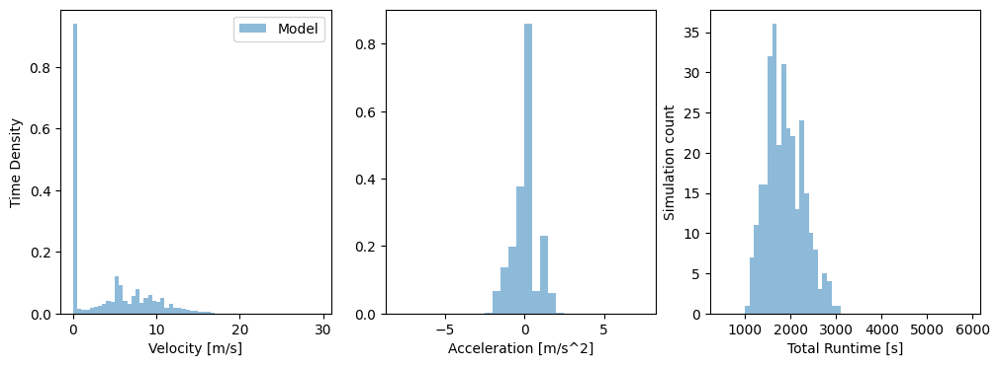

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


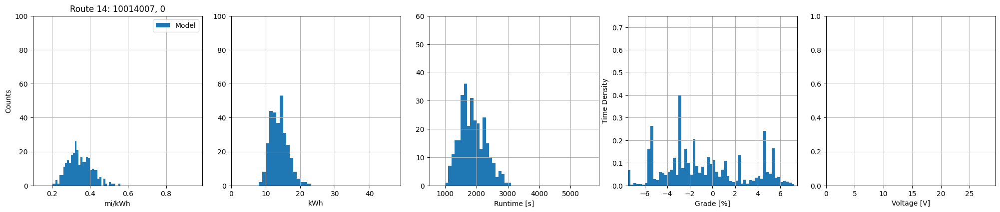

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20635840712793588), np.float64(0.5598888445586114), np.float64(0.3463597161436441), np.float64(0.061214874171438005))
Energy min/max/mean/std [kWh]: 		(np.float64(8.299314858771437), np.float64(22.51758904121046), np.float64(13.839720457839658), np.float64(2.4728582329773303))
Time min/max/mean/std [s]: 		(np.float64(1047.9237117490068), np.float64(3095.29715224779), np.float64(1875.0702117347419), np.float64(407.3685671748739))
|Grade| mean/std [%]: 			(np.float64(3.093918104293408), np.float64(1.822832552553207))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



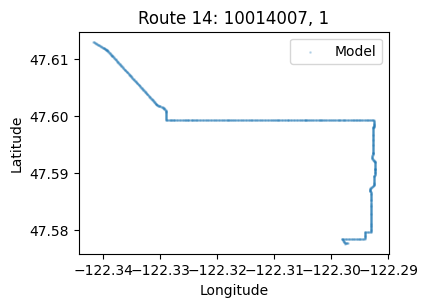

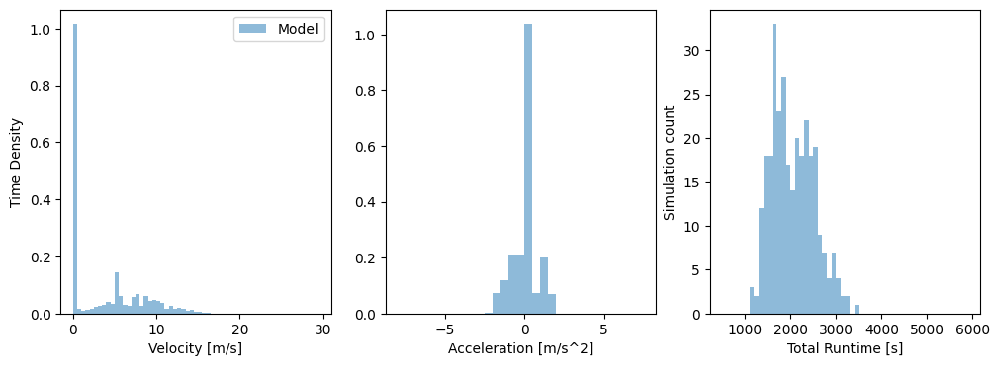

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


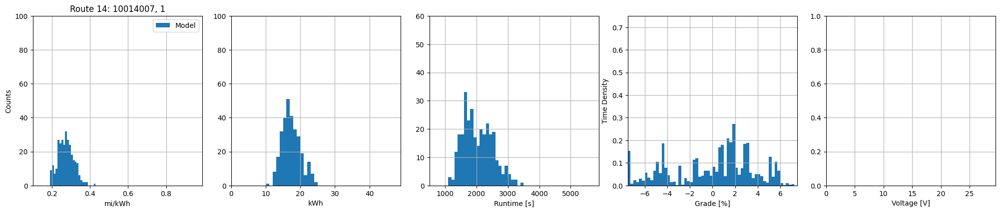

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19231043608689163), np.float64(0.42330732881005684), np.float64(0.27393705672143853), np.float64(0.04116903972912882))
Energy min/max/mean/std [kWh]: 		(np.float64(10.977045035011017), np.float64(24.162306043020507), np.float64(17.348451548291855), np.float64(2.6257818583393586))
Time min/max/mean/std [s]: 		(np.float64(1135.6265074672274), np.float64(3406.4478664934754), np.float64(2046.8837406080627), np.float64(466.12853044094504))
|Grade| mean/std [%]: 			(np.float64(2.8330915238790277), np.float64(1.8043751948206626))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



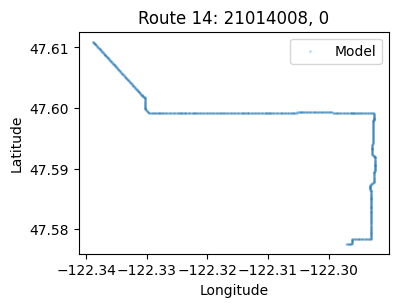

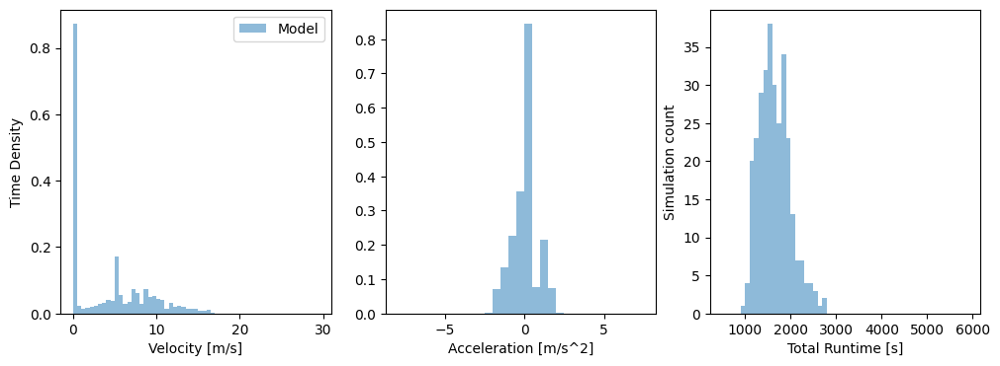

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


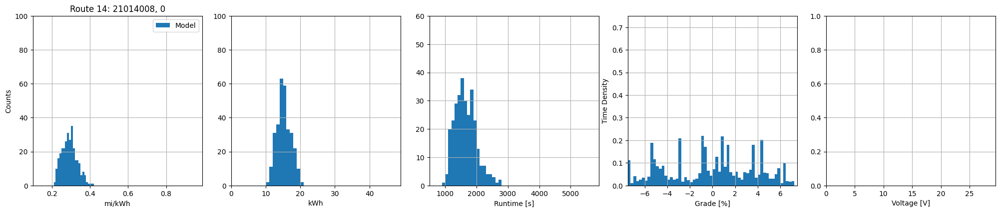

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21738261408339526), np.float64(0.41222141969073367), np.float64(0.29243431637180195), np.float64(0.03936726030223534))
Energy min/max/mean/std [kWh]: 		(np.float64(10.623675049284017), np.float64(20.145614816596296), np.float64(15.244468671043839), np.float64(2.032176073777869))
Time min/max/mean/std [s]: 		(np.float64(982.3267209110877), np.float64(2773.9629106108405), np.float64(1651.1434862692138), np.float64(343.0643754457594))
|Grade| mean/std [%]: 			(np.float64(3.083971222860184), np.float64(2.000917723847443))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



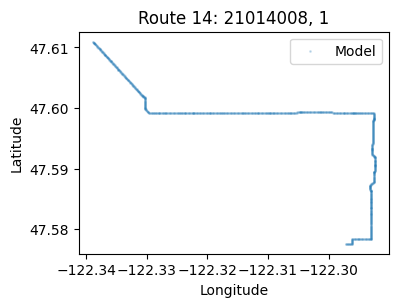

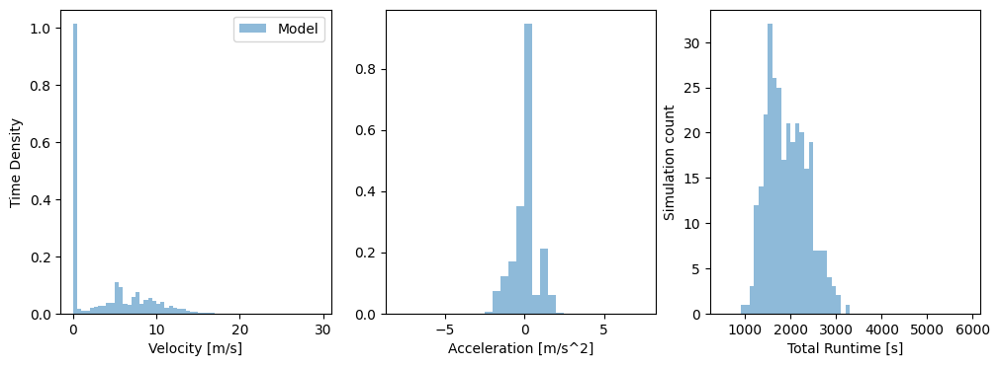

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


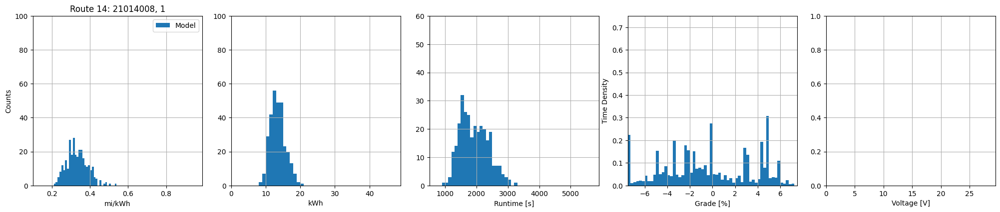

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21659819748440548), np.float64(0.5343988077210797), np.float64(0.3332079206692718), np.float64(0.05504912569640206))
Energy min/max/mean/std [kWh]: 		(np.float64(8.195686784527998), np.float64(20.220691109040757), np.float64(13.50301381942711), np.float64(2.2307492743865005))
Time min/max/mean/std [s]: 		(np.float64(960.6026723403779), np.float64(3249.1130062392153), np.float64(1928.201554638087), np.float64(445.0441185048192))
|Grade| mean/std [%]: 			(np.float64(3.0888506922572976), np.float64(1.8404130311603715))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------150-------------------


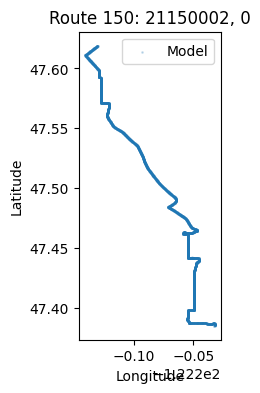

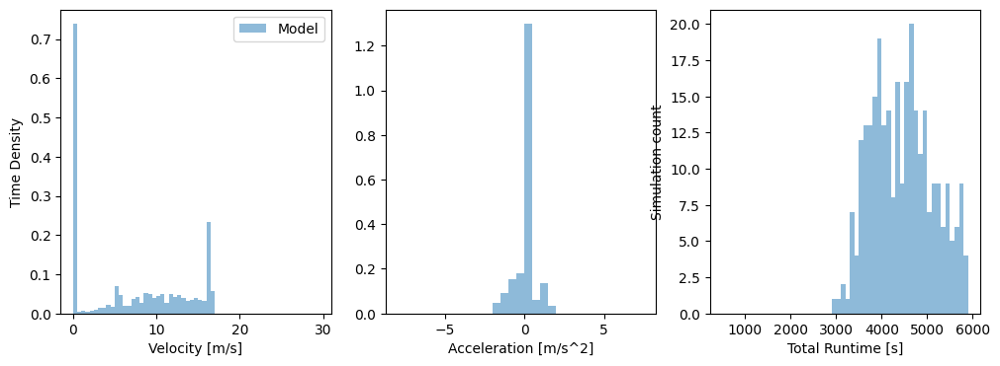

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


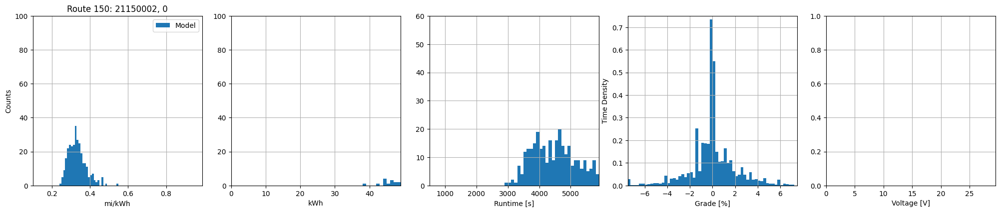

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2497089343604381), np.float64(0.5405865984965259), np.float64(0.33357893261340554), np.float64(0.04701729551982859))
Energy min/max/mean/std [kWh]: 		(np.float64(38.34071772460821), np.float64(83.00254947523878), np.float64(63.28490010956712), np.float64(8.345710530099732))
Time min/max/mean/std [s]: 		(np.float64(2987.6307298709735), np.float64(6373.207452991614), np.float64(4529.7547922388885), np.float64(737.7351157308665))
|Grade| mean/std [%]: 			(np.float64(1.2970434201522034), np.float64(1.423799457143937))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



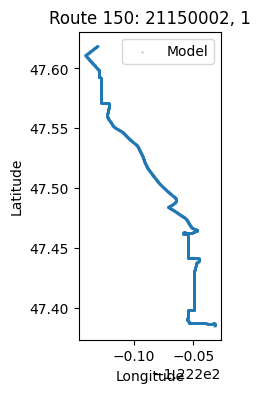

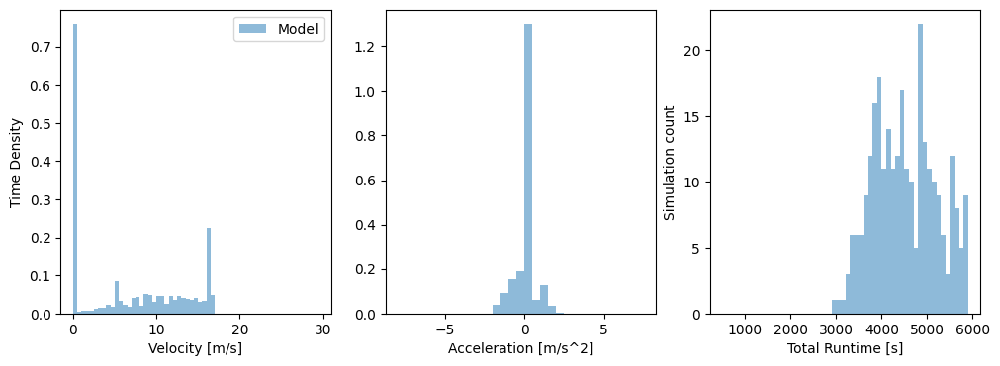

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


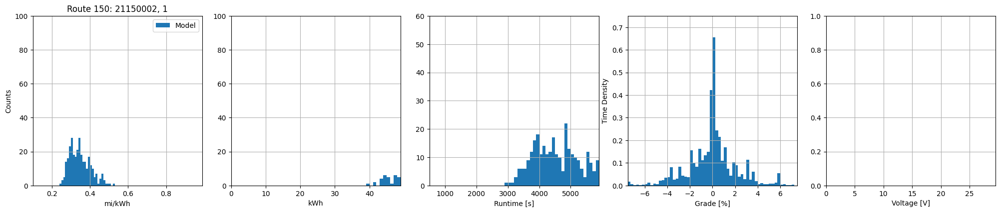

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.24624690030804577), np.float64(0.5245095605561939), np.float64(0.3481547067907883), np.float64(0.054475178921296635))
Energy min/max/mean/std [kWh]: 		(np.float64(39.51619752341364), np.float64(84.1700885246848), np.float64(60.9281235235772), np.float64(9.0911534775412))
Time min/max/mean/std [s]: 		(np.float64(2995.906017859528), np.float64(7002.288935407331), np.float64(4647.4731904238815), np.float64(811.2898370449138))
|Grade| mean/std [%]: 			(np.float64(1.4327035195652176), np.float64(1.4761901079415638))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



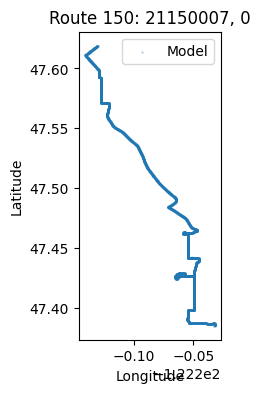

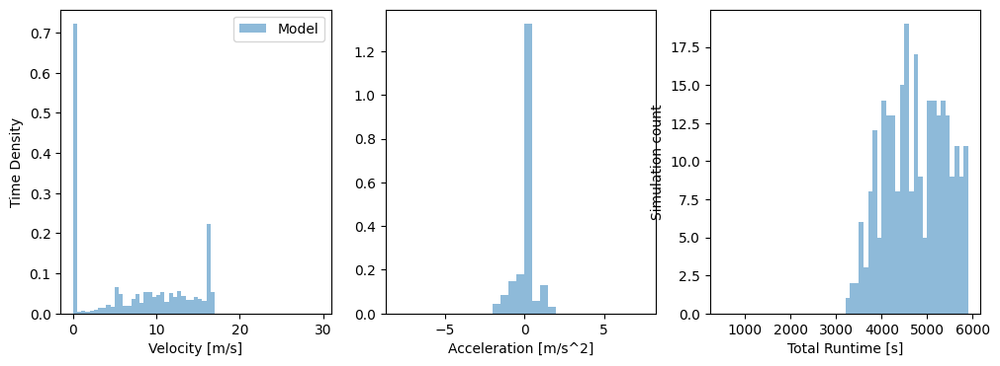

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


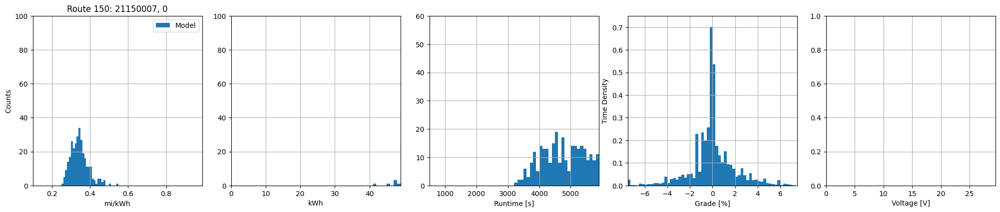

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.25853918709372875), np.float64(0.5417217665673761), np.float64(0.34476770589998984), np.float64(0.04600603114888926))
Energy min/max/mean/std [kWh]: 		(np.float64(41.819997683590515), np.float64(87.62618648903364), np.float64(66.80895600576956), np.float64(8.402996353339649))
Time min/max/mean/std [s]: 		(np.float64(3273.827753257271), np.float64(6804.472423728613), np.float64(4897.375977466419), np.float64(775.3611482253039))
|Grade| mean/std [%]: 			(np.float64(1.2388193866312682), np.float64(1.386231101366231))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



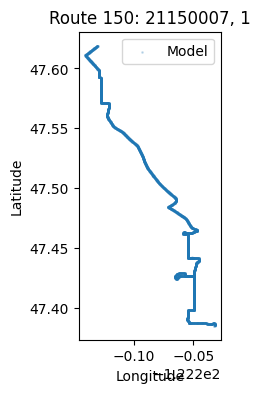

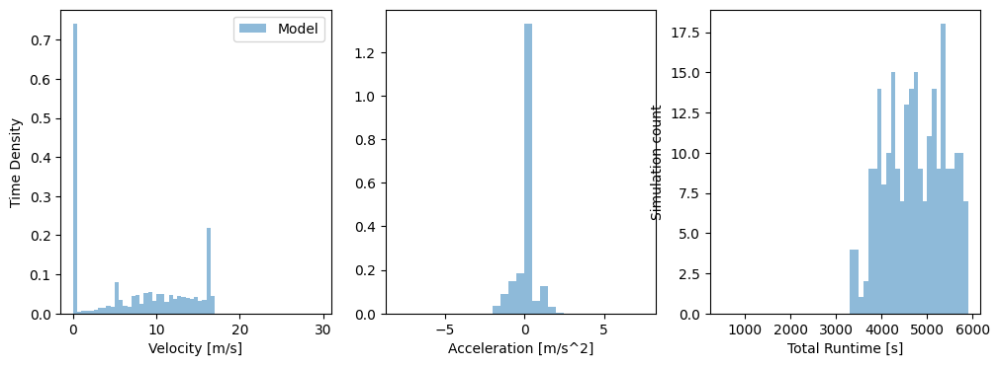

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


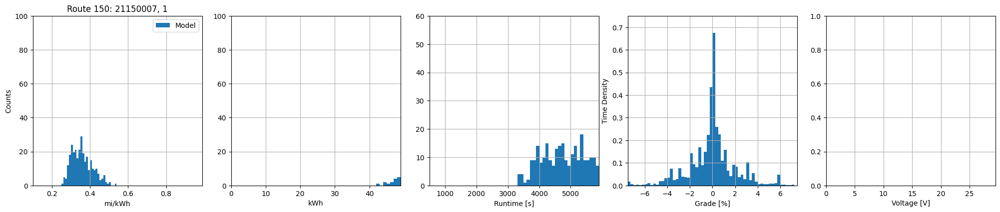

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2511348482272372), np.float64(0.5320773127330544), np.float64(0.3586613862862615), np.float64(0.054658599041159314))
Energy min/max/mean/std [kWh]: 		(np.float64(42.578156467878806), np.float64(90.20998572869267), np.float64(64.58456336862628), np.float64(9.491780170973463))
Time min/max/mean/std [s]: 		(np.float64(3356.8972211448445), np.float64(7133.983110490006), np.float64(5019.902331912387), np.float64(878.6263054554248))
|Grade| mean/std [%]: 			(np.float64(1.3455542172333221), np.float64(1.440871470610978))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



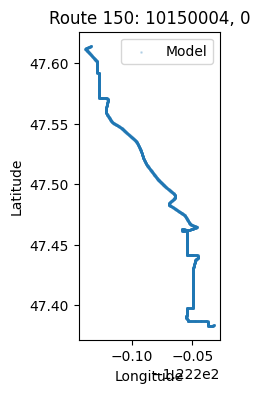

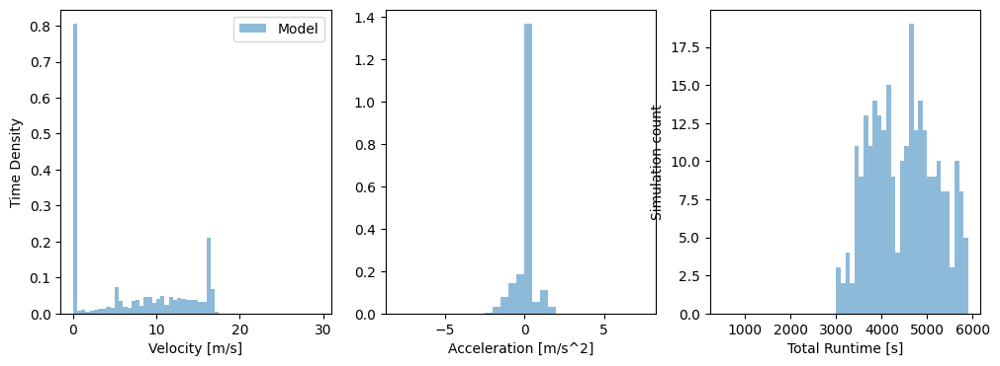

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


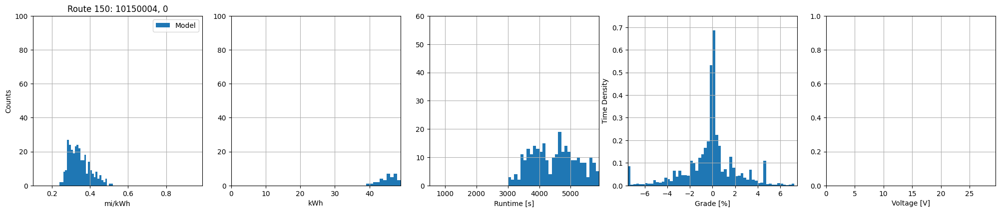

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2445031247833382), np.float64(0.5123849968566889), np.float64(0.3454370556447211), np.float64(0.05508787935382259))
Energy min/max/mean/std [kWh]: 		(np.float64(39.92512541262162), np.float64(83.66778656582264), np.float64(60.650111961845205), np.float64(9.137723473044371))
Time min/max/mean/std [s]: 		(np.float64(3023.9941682305966), np.float64(6968.731023227361), np.float64(4657.7027902253685), np.float64(860.2807540506369))
|Grade| mean/std [%]: 			(np.float64(1.4048787021989713), np.float64(1.5442787908899231))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



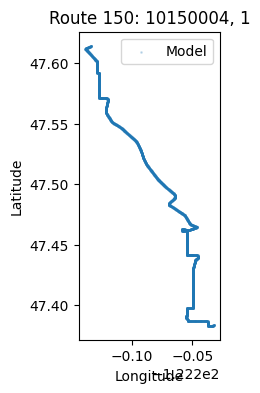

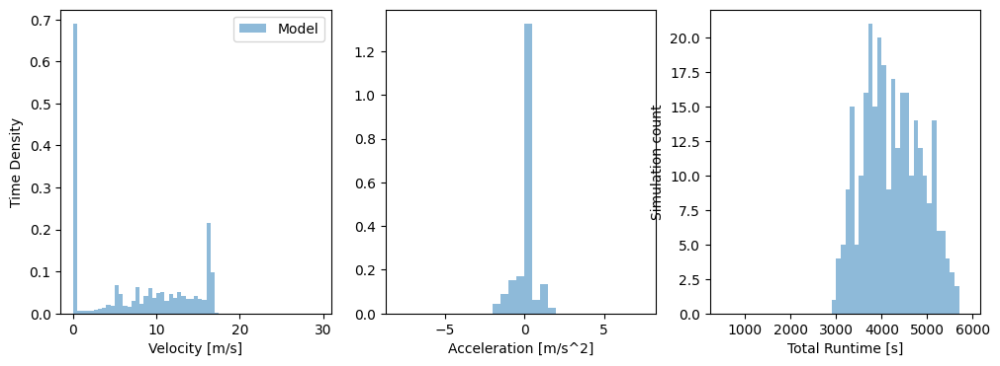

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


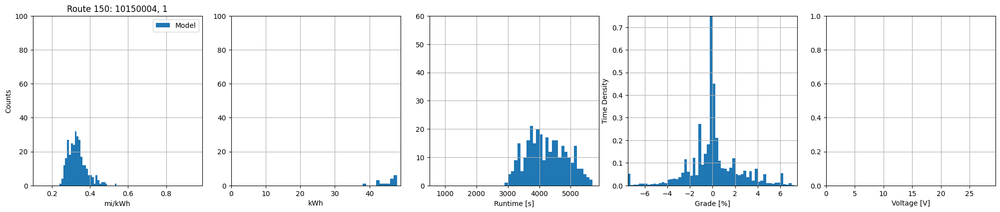

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.24780852135023534), np.float64(0.5334286075140381), np.float64(0.33256750277471253), np.float64(0.0473470973314155))
Energy min/max/mean/std [kWh]: 		(np.float64(38.34975024385666), np.float64(82.5510509470306), np.float64(62.66666920061724), np.float64(8.28770674911807))
Time min/max/mean/std [s]: 		(np.float64(2968.739938978578), np.float64(6504.909446559044), np.float64(4250.777513348098), np.float64(654.8245839094119))
|Grade| mean/std [%]: 			(np.float64(1.4503039100744117), np.float64(1.5699750815045816))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



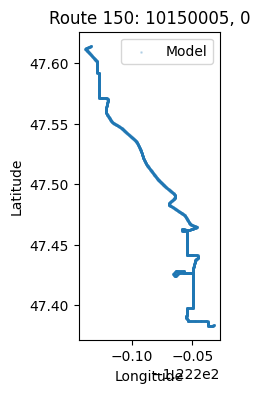

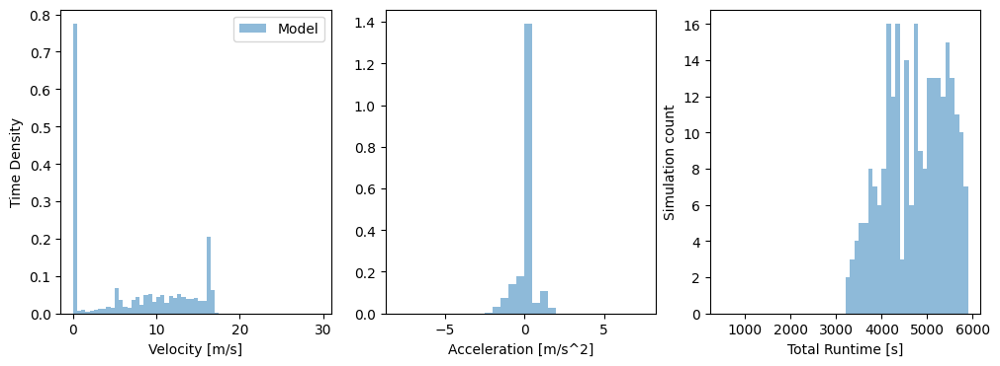

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


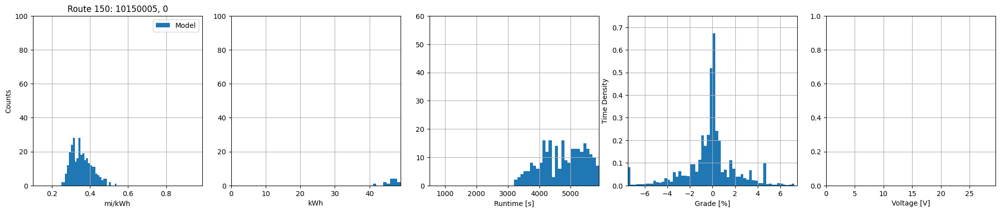

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.25701013764843555), np.float64(0.5374065047213938), np.float64(0.3569598115188221), np.float64(0.05429913843137097))
Energy min/max/mean/std [kWh]: 		(np.float64(41.6543945563539), np.float64(87.09906461136154), np.float64(64.11003233002866), np.float64(9.365270173539658))
Time min/max/mean/std [s]: 		(np.float64(3229.6735676088674), np.float64(7036.991377443617), np.float64(4988.015923251594), np.float64(863.6855584736682))
|Grade| mean/std [%]: 			(np.float64(1.3418808287004196), np.float64(1.5067661782428061))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



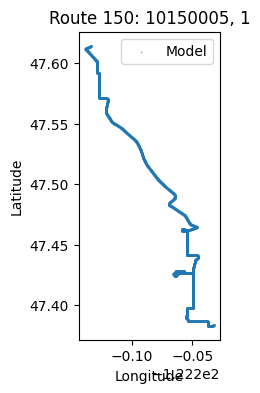

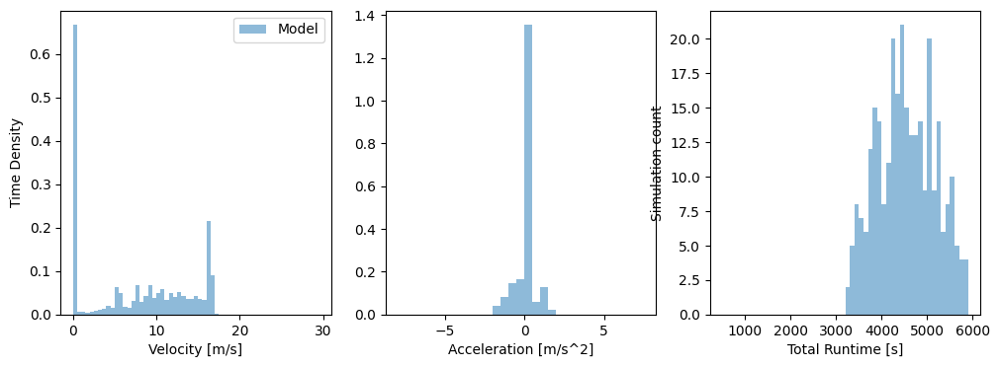

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


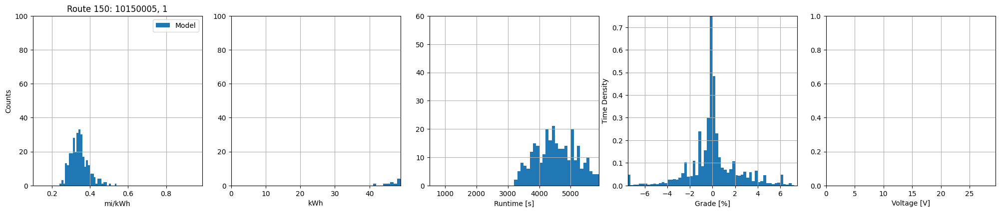

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.24943658339696784), np.float64(0.5352840546142186), np.float64(0.34512238768576947), np.float64(0.04745144017216705))
Energy min/max/mean/std [kWh]: 		(np.float64(41.819116137918705), np.float64(89.74267423741557), np.float64(66.01779705902351), np.float64(8.5954366873763))
Time min/max/mean/std [s]: 		(np.float64(3246.706401592513), np.float64(6641.712615447392), np.float64(4593.094473476373), np.float64(687.1907007967146))
|Grade| mean/std [%]: 			(np.float64(1.3437030835061257), np.float64(1.5335388083918657))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------21-------------------


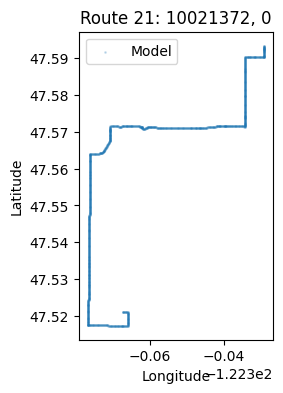

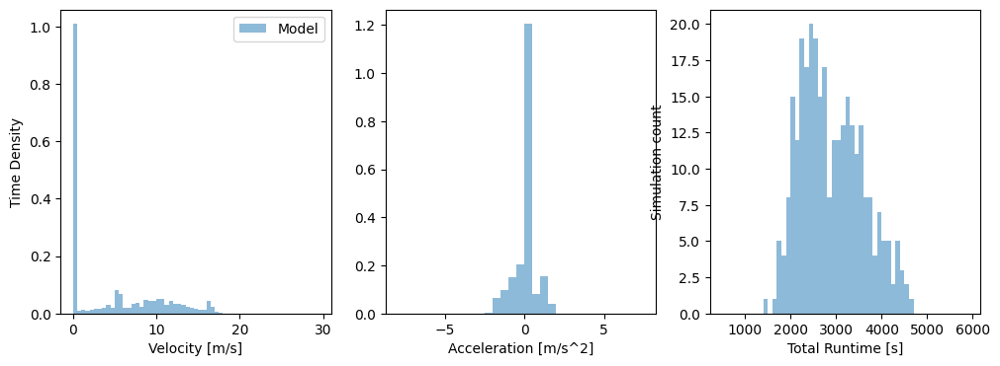

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


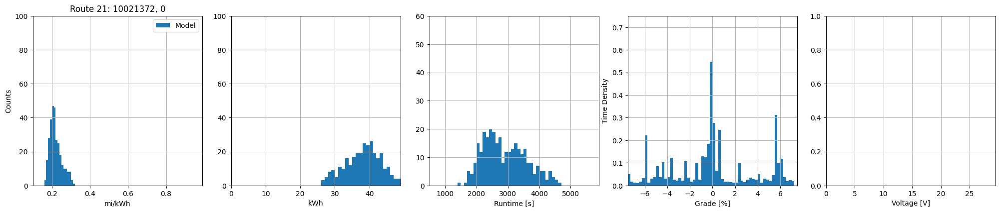

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16203499512668573), np.float64(0.3124055662904948), np.float64(0.22031989382516315), np.float64(0.03171433301437775))
Energy min/max/mean/std [kWh]: 		(np.float64(26.43023897936138), np.float64(50.95784258878689), np.float64(38.20516704797171), np.float64(5.144601406078246))
Time min/max/mean/std [s]: 		(np.float64(1450.721695482662), np.float64(4606.803731199127), np.float64(2902.167724374975), np.float64(688.4031270639197))
|Grade| mean/std [%]: 			(np.float64(2.7696190349904635), np.float64(2.361388259291915))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



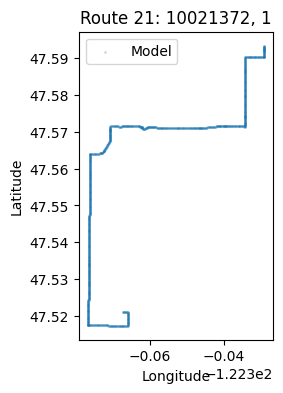

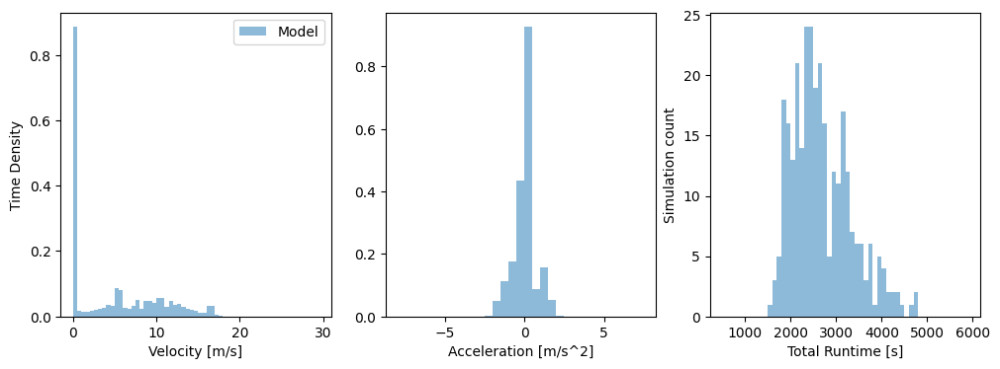

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


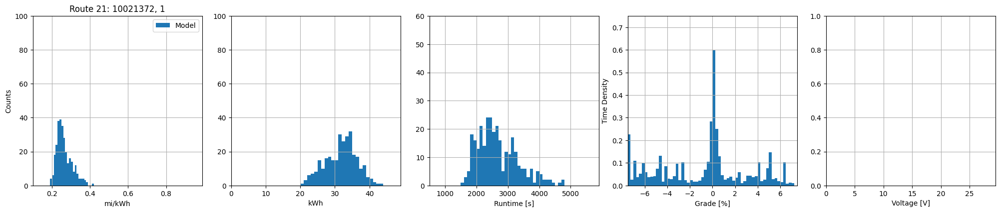

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19157801560188936), np.float64(0.4120338768710314), np.float64(0.2655036630272666), np.float64(0.04122121540856669))
Energy min/max/mean/std [kWh]: 		(np.float64(20.04191946592354), np.float64(43.10489255010338), np.float64(31.795093475347592), np.float64(4.547616456792724))
Time min/max/mean/std [s]: 		(np.float64(1542.6941780812417), np.float64(4778.998886765627), np.float64(2680.93243936642), np.float64(648.3585545005058))
|Grade| mean/std [%]: 			(np.float64(2.738882595939544), np.float64(2.366705194931138))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



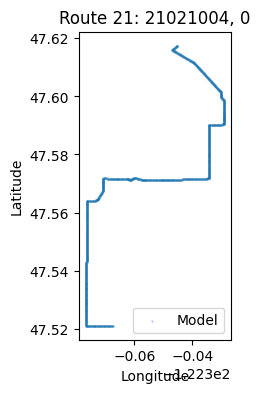

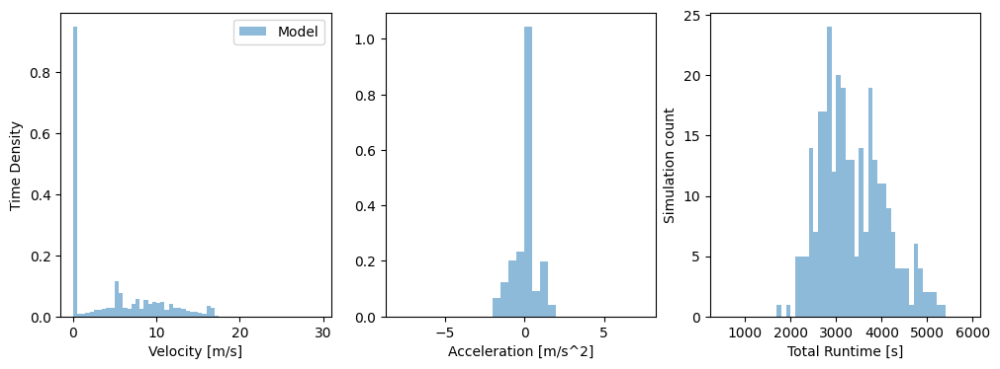

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


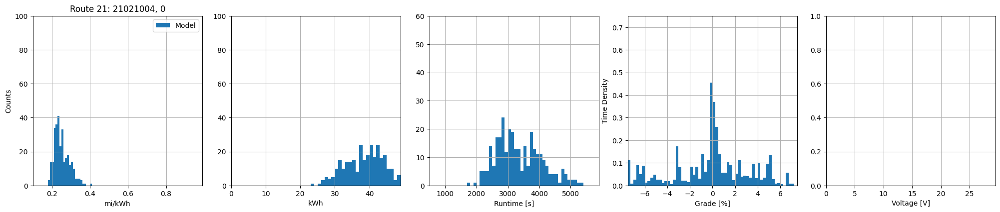

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18696732575310646), np.float64(0.40546744025547304), np.float64(0.2522393433224232), np.float64(0.039811599567439106))
Energy min/max/mean/std [kWh]: 		(np.float64(23.58710015815697), np.float64(51.152259281958884), np.float64(38.79436774039492), np.float64(5.682337787146323))
Time min/max/mean/std [s]: 		(np.float64(1783.9176401458144), np.float64(5375.401677180582), np.float64(3357.5369413866133), np.float64(714.761970315225))
|Grade| mean/std [%]: 			(np.float64(2.310890812516983), np.float64(2.1157345029621237))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



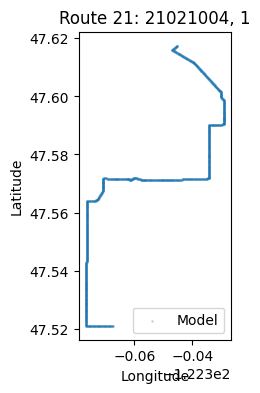

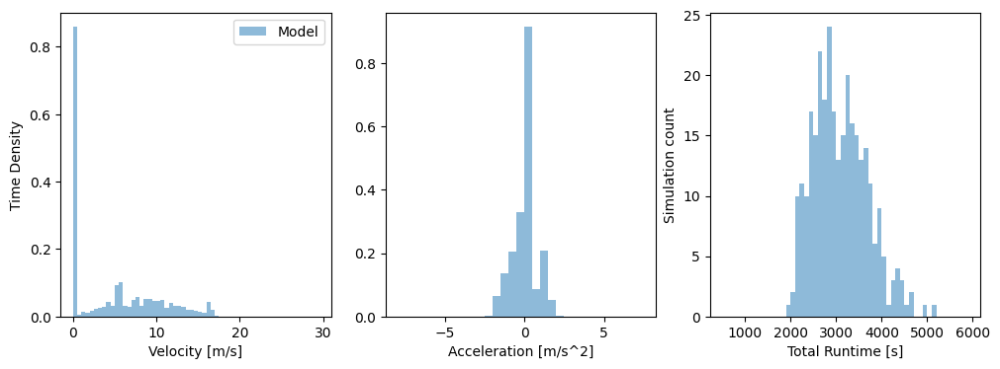

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


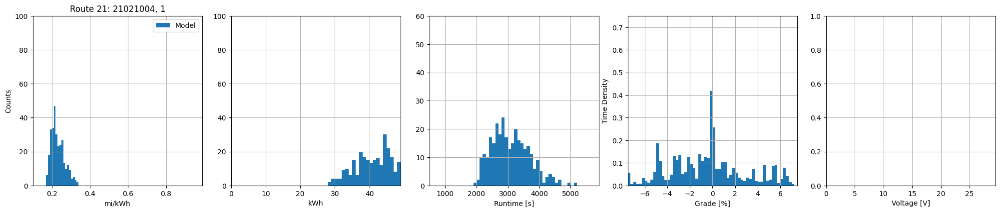

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17296981386719248), np.float64(0.3388638095068725), np.float64(0.2318014201340279), np.float64(0.034703328390270974))
Energy min/max/mean/std [kWh]: 		(np.float64(28.221441228270187), np.float64(55.28840478332631), np.float64(42.12776123655725), np.float64(5.924216119528065))
Time min/max/mean/std [s]: 		(np.float64(1975.7411249872923), np.float64(5183.135840005489), np.float64(3096.2089305865697), np.float64(596.6868018013614))
|Grade| mean/std [%]: 			(np.float64(2.517561120182919), np.float64(2.023091338893463))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



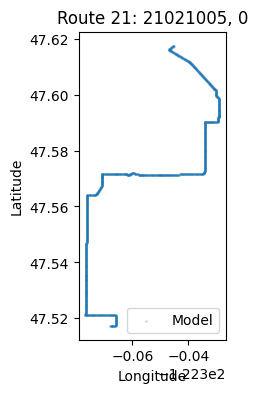

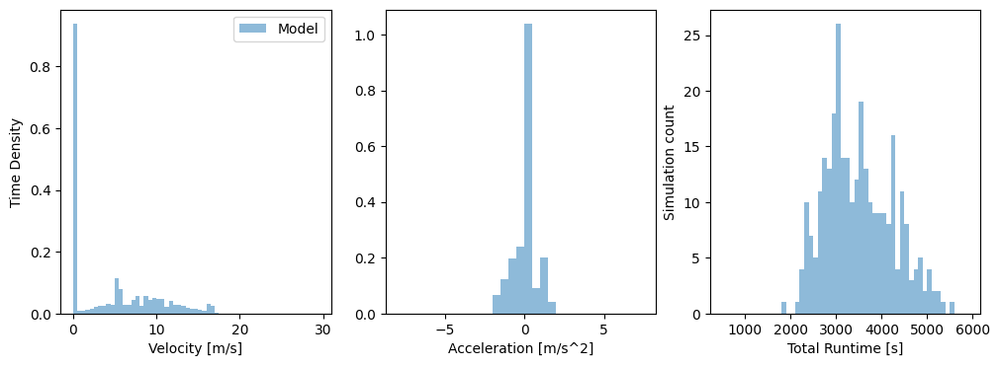

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


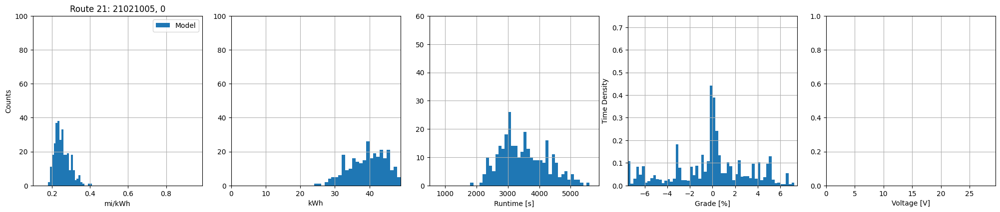

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1887386974386078), np.float64(0.40460534910729534), np.float64(0.2541688995522529), np.float64(0.039365524103638694))
Energy min/max/mean/std [kWh]: 		(np.float64(24.6813804946836), np.float64(52.91028658682848), np.float64(40.172444865247165), np.float64(5.819249927549111))
Time min/max/mean/std [s]: 		(np.float64(1890.4987135099307), np.float64(5587.1689394647865), np.float64(3499.030022903731), np.float64(740.7709529195884))
|Grade| mean/std [%]: 			(np.float64(2.336262848868002), np.float64(2.1180263256424454))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



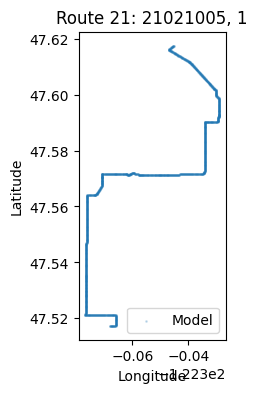

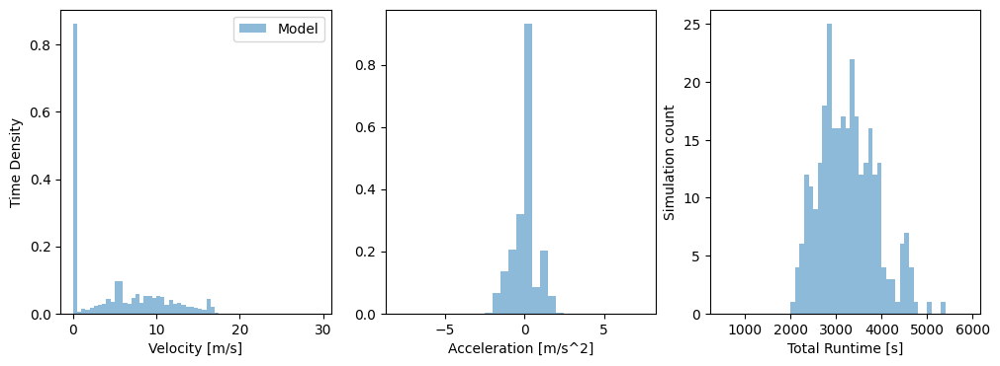

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


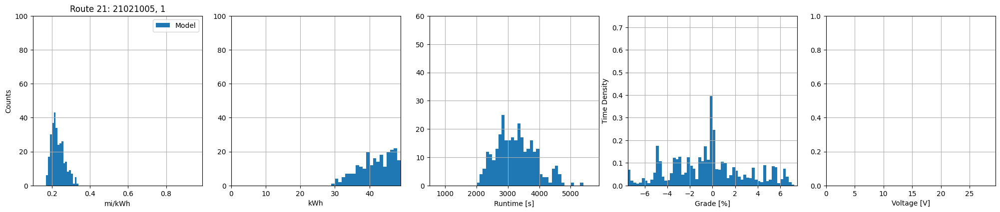

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1727372131180723), np.float64(0.33444782569127113), np.float64(0.23188403617433134), np.float64(0.03437383886201971))
Energy min/max/mean/std [kWh]: 		(np.float64(29.85795093442152), np.float64(57.809933304806655), np.float64(43.96090069005193), np.float64(6.153904660272748))
Time min/max/mean/std [s]: 		(np.float64(2032.2511998074713), np.float64(5308.564079342426), np.float64(3254.8707979635496), np.float64(619.2123308305717))
|Grade| mean/std [%]: 			(np.float64(2.524530454928685), np.float64(2.018569469822151))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



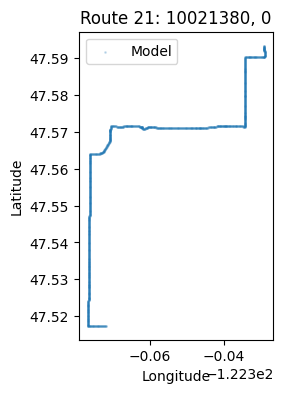

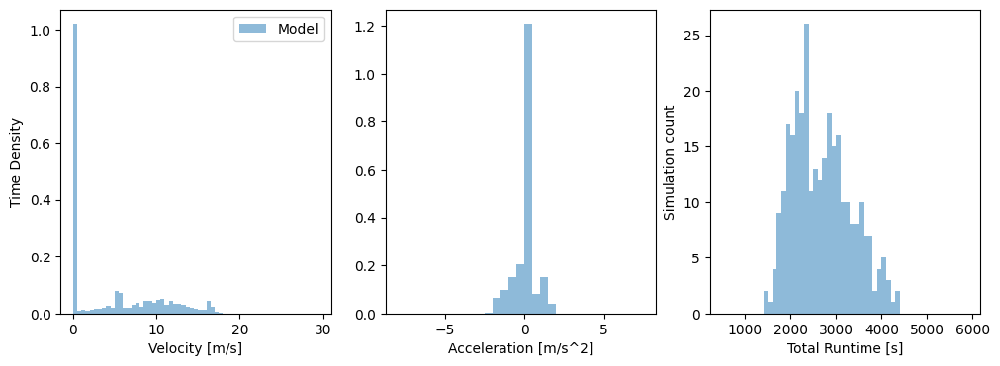

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


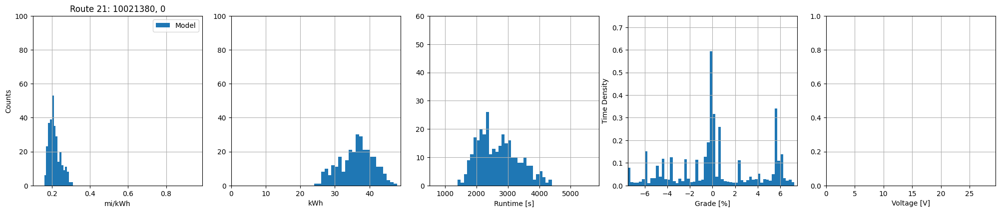

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16047373383581923), np.float64(0.3087522656465804), np.float64(0.21505170519500524), np.float64(0.030484690043017106))
Energy min/max/mean/std [kWh]: 		(np.float64(24.796666883460606), np.float64(47.70891097096849), np.float64(36.27184254238821), np.float64(4.810651814443849))
Time min/max/mean/std [s]: 		(np.float64(1476.3235114985055), np.float64(4354.982229324357), np.float64(2689.081571327504), np.float64(646.24675222575))
|Grade| mean/std [%]: 			(np.float64(2.7437747764760614), np.float64(2.366146805307888))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



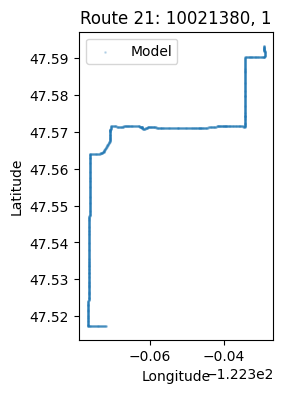

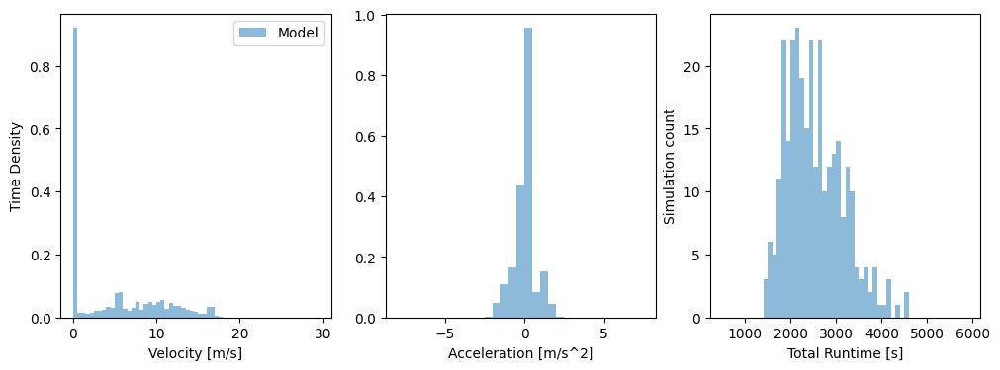

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


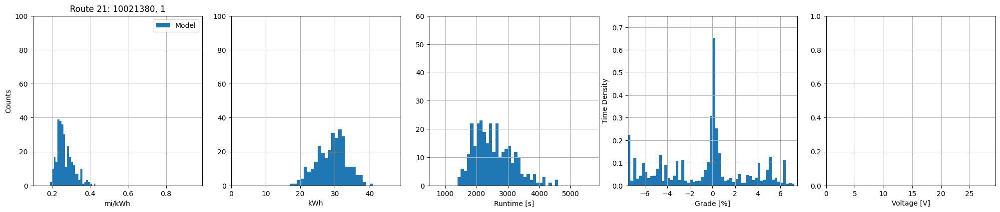

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19025296087771448), np.float64(0.4289982725257267), np.float64(0.2687059936597448), np.float64(0.04308491209049521))
Energy min/max/mean/std [kWh]: 		(np.float64(17.848630401555873), np.float64(40.246583148523044), np.float64(29.16849857626686), np.float64(4.2904669059233145))
Time min/max/mean/std [s]: 		(np.float64(1423.4989570887112), np.float64(4580.630702601069), np.float64(2537.512877102821), np.float64(618.8430474047567))
|Grade| mean/std [%]: 			(np.float64(2.6695788017045126), np.float64(2.3798224599817592))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



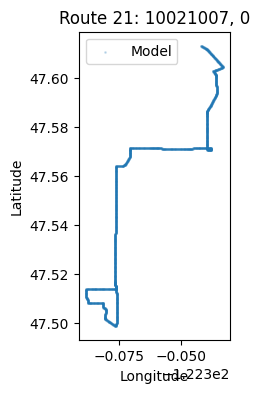

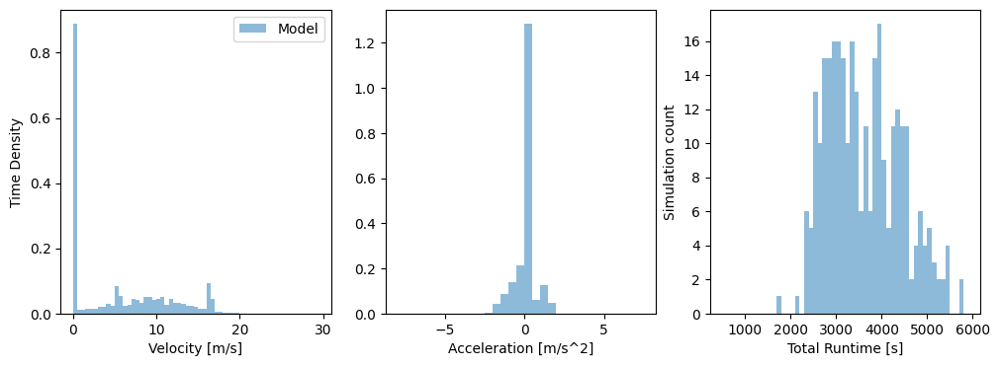

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


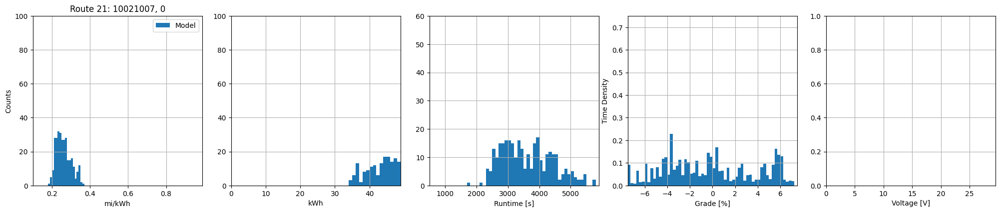

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18980551698000753), np.float64(0.3614641538125326), np.float64(0.26116165046540324), np.float64(0.038805330805478794))
Energy min/max/mean/std [kWh]: 		(np.float64(34.13937962746351), np.float64(65.01476967092435), np.float64(48.25872999443514), np.float64(6.895732083900448))
Time min/max/mean/std [s]: 		(np.float64(1730.6177752661765), np.float64(5754.162577191595), np.float64(3613.2875962879943), np.float64(805.6050394100979))
|Grade| mean/std [%]: 			(np.float64(3.278933670077524), np.float64(2.0002182793414383))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



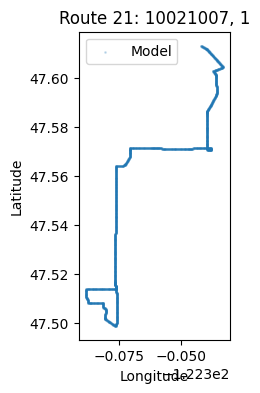

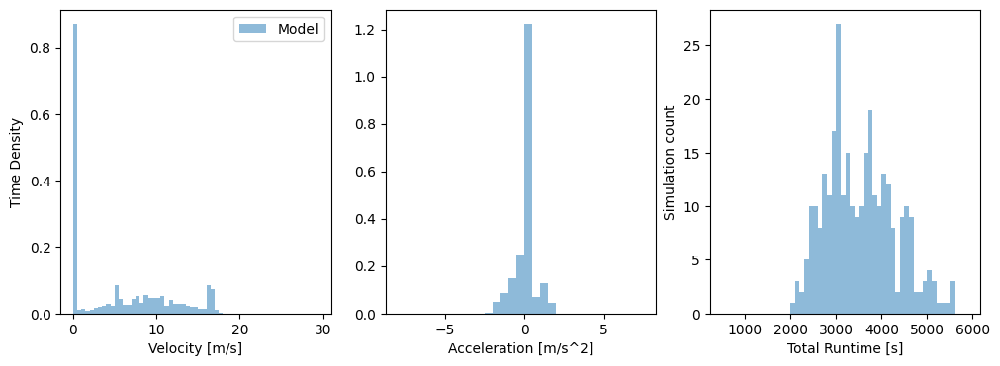

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


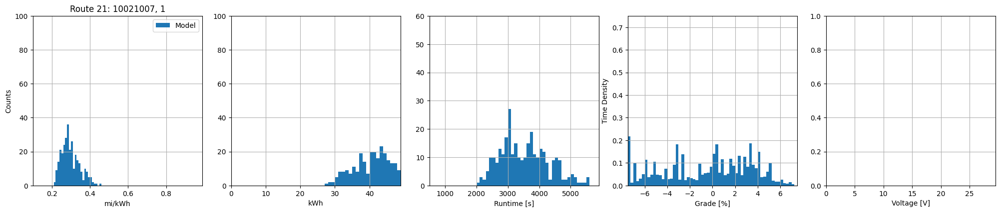

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21290283594390005), np.float64(0.4562494644743518), np.float64(0.2983892474345571), np.float64(0.04742950785874979))
Energy min/max/mean/std [kWh]: 		(np.float64(27.05049624269619), np.float64(57.96904663002076), np.float64(42.35561420192252), np.float64(6.3858138564214615))
Time min/max/mean/std [s]: 		(np.float64(2002.5415963492817), np.float64(5561.129998831453), np.float64(3538.1873217718085), np.float64(759.2082966578295))
|Grade| mean/std [%]: 			(np.float64(3.0570836533154218), np.float64(1.8974511788779862))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



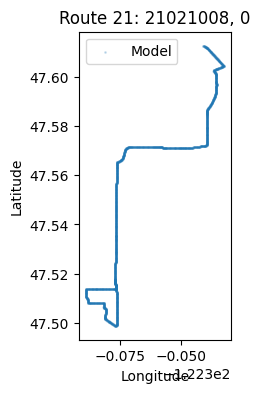

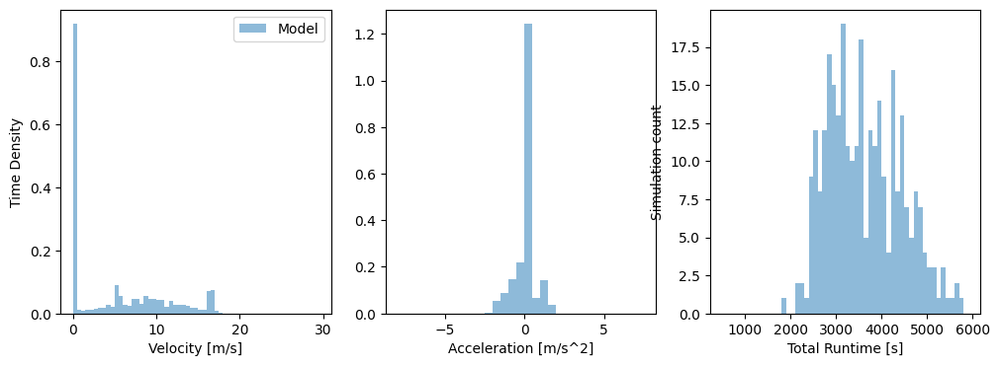

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


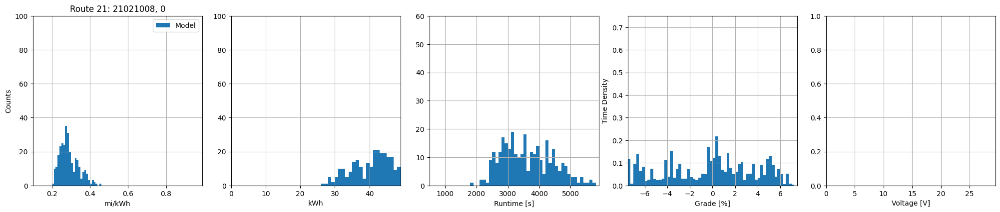

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20616787847053952), np.float64(0.45125178318522546), np.float64(0.29064615105586766), np.float64(0.04934944057463622))
Energy min/max/mean/std [kWh]: 		(np.float64(26.51556678772109), np.float64(58.036183346746995), np.float64(42.28221667984195), np.float64(6.712861041465751))
Time min/max/mean/std [s]: 		(np.float64(1814.4392871707262), np.float64(6131.27751952497), np.float64(3633.893256050106), np.float64(816.0327616982244))
|Grade| mean/std [%]: 			(np.float64(3.1546198069415743), np.float64(2.138905569328146))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



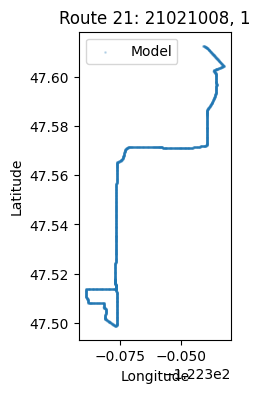

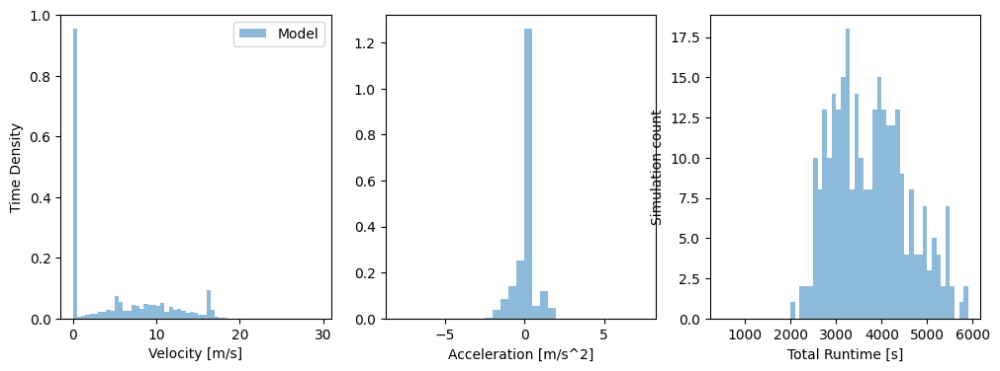

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


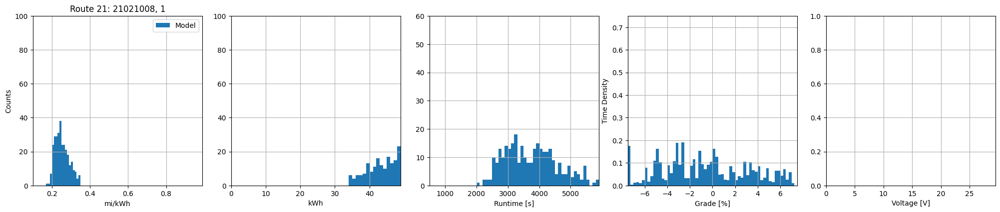

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17980963644968365), np.float64(0.34923759598604914), np.float64(0.25359406801116274), np.float64(0.03712648286370045))
Energy min/max/mean/std [kWh]: 		(np.float64(34.25911010184992), np.float64(66.54020045215707), np.float64(48.16061198465161), np.float64(6.8106455817114995))
Time min/max/mean/std [s]: 		(np.float64(2096.163428213265), np.float64(6110.843693994059), np.float64(3782.3711308911475), np.float64(858.7074886877903))
|Grade| mean/std [%]: 			(np.float64(3.047272086418663), np.float64(1.9280115969370535))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



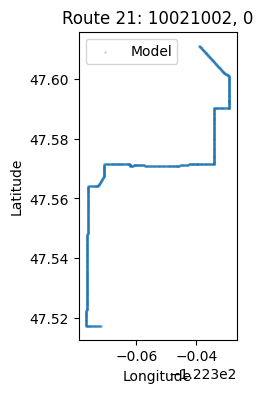

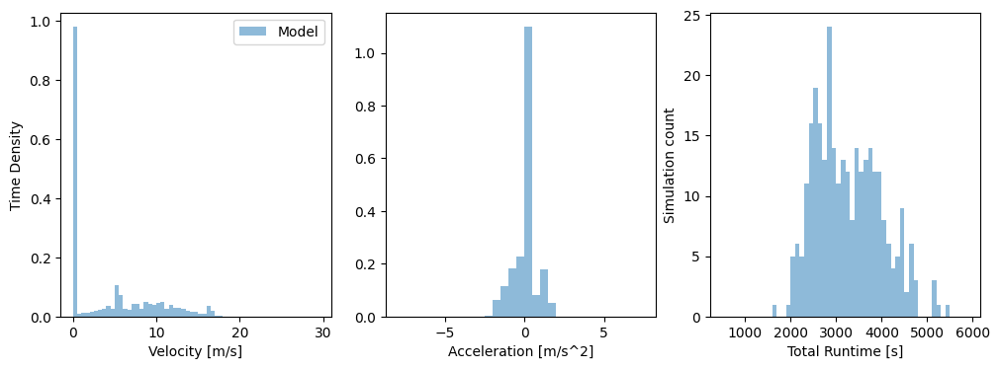

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


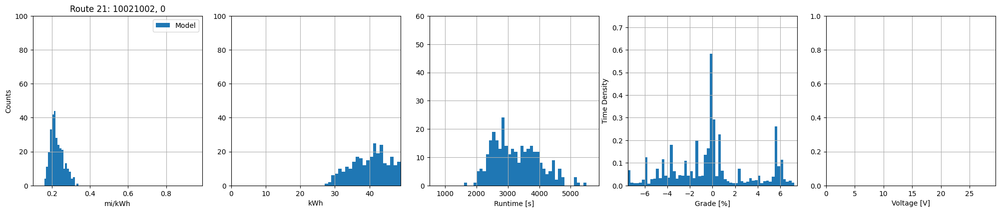

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16510359967308674), np.float64(0.33350160985384064), np.float64(0.22697555597121924), np.float64(0.03412813942966609))
Energy min/max/mean/std [kWh]: 		(np.float64(27.082366820592384), np.float64(54.7051242444358), np.float64(40.64975096744576), np.float64(5.801863805417549))
Time min/max/mean/std [s]: 		(np.float64(1678.4542810087978), np.float64(5464.427662695218), np.float64(3258.8563798028663), np.float64(731.9722682623556))
|Grade| mean/std [%]: 			(np.float64(2.5570435283605075), np.float64(2.2403132699354864))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



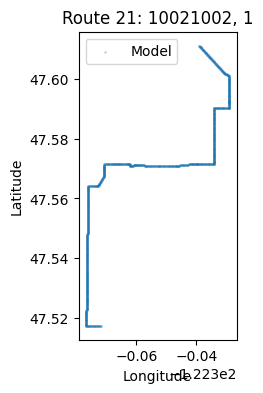

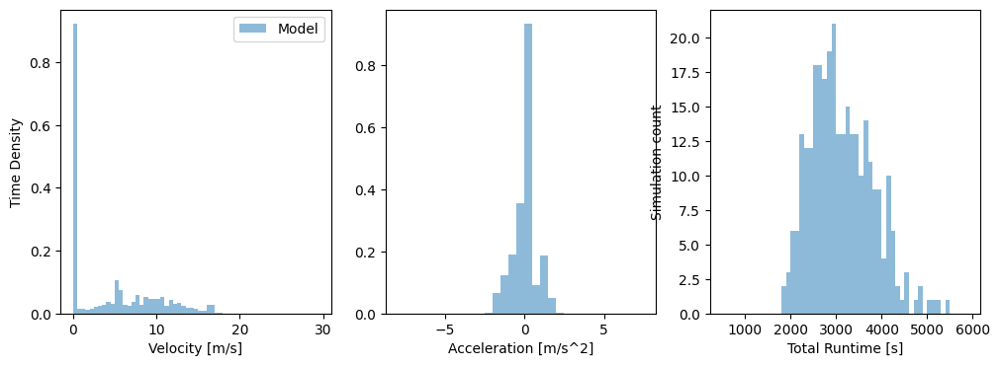

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


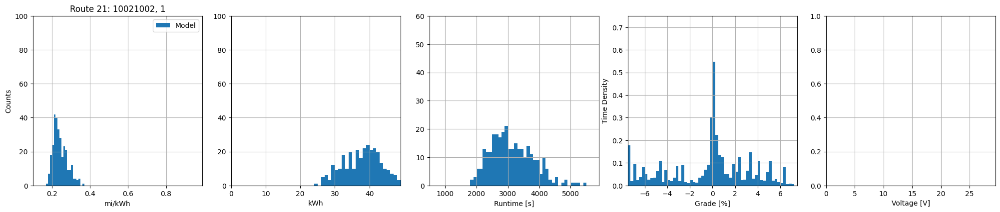

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17741797131483683), np.float64(0.3637123171690299), np.float64(0.2434094534613026), np.float64(0.03670197967635387))
Energy min/max/mean/std [kWh]: 		(np.float64(24.835470612741023), np.float64(50.91348129843029), np.float64(37.900950788161104), np.float64(5.341539481776589))
Time min/max/mean/std [s]: 		(np.float64(1842.3584028680934), np.float64(5495.591648214551), np.float64(3129.933642107058), np.float64(683.7510133599425))
|Grade| mean/std [%]: 			(np.float64(2.516506463314138), np.float64(2.2104496446074924))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------24-------------------


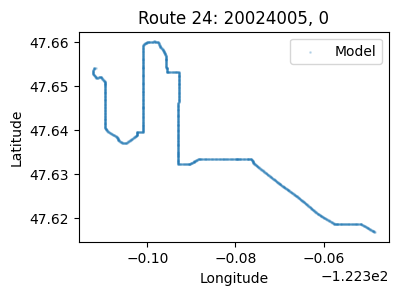

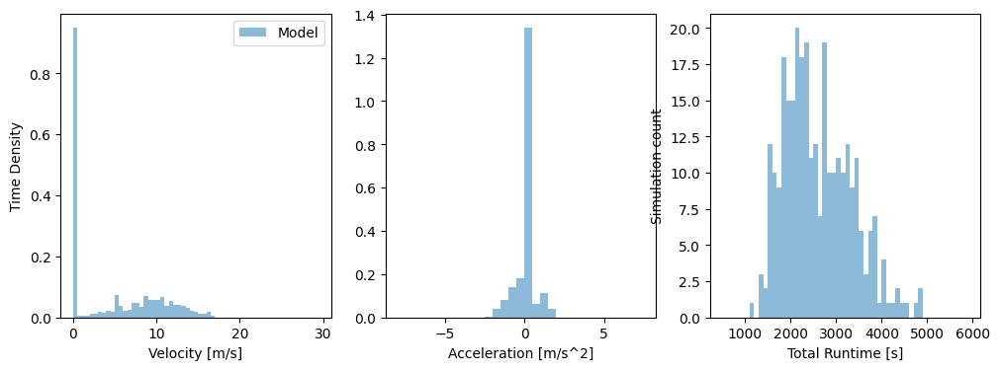

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


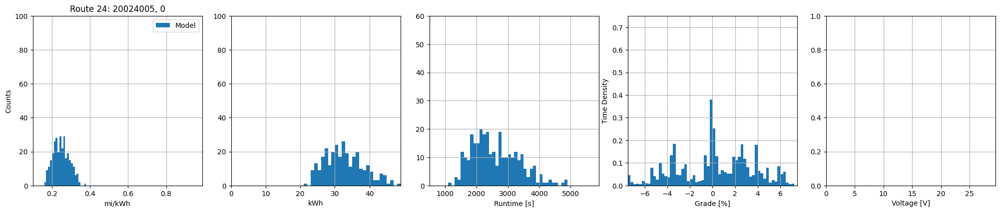

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1647911663035829), np.float64(0.3729953296228376), np.float64(0.24942817546432736), np.float64(0.041783712021071555))
Energy min/max/mean/std [kWh]: 		(np.float64(21.255908261544384), np.float64(48.11152615936772), np.float64(32.696306382915054), np.float64(5.555589321861963))
Time min/max/mean/std [s]: 		(np.float64(1109.8742171495564), np.float64(4871.1342087780085), np.float64(2601.5815887274425), np.float64(739.0493701627568))
|Grade| mean/std [%]: 			(np.float64(2.616916398423545), np.float64(1.8816036053730218))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



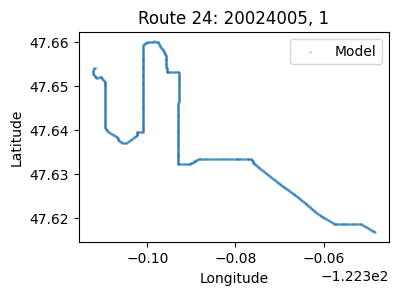

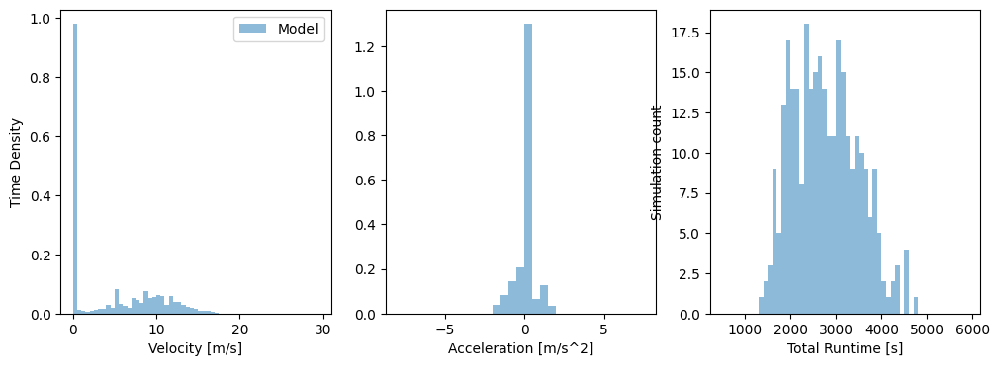

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


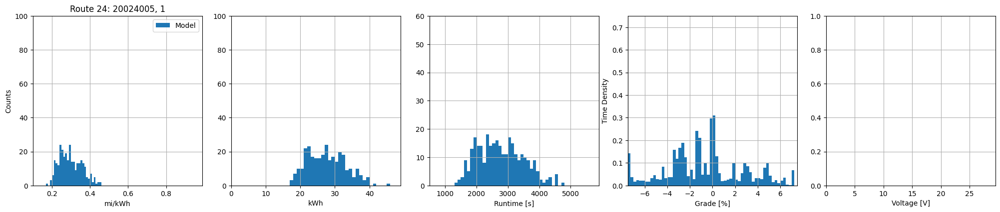

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1739401792182744), np.float64(0.4596417521689297), np.float64(0.29820760970709453), np.float64(0.05962905475965892))
Energy min/max/mean/std [kWh]: 		(np.float64(17.25136766621093), np.float64(45.58721795645093), np.float64(27.65668584909926), np.float64(5.484848324641753))
Time min/max/mean/std [s]: 		(np.float64(1330.979185765861), np.float64(4778.201546295073), np.float64(2769.9807308293302), np.float64(713.768529173806))
|Grade| mean/std [%]: 			(np.float64(2.515821906412741), np.float64(1.9234496360312001))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



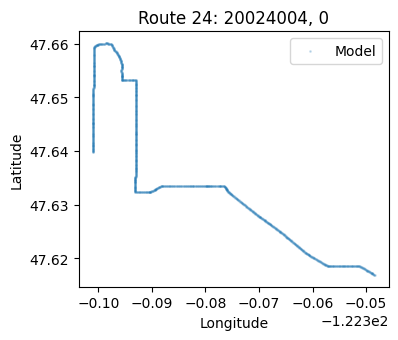

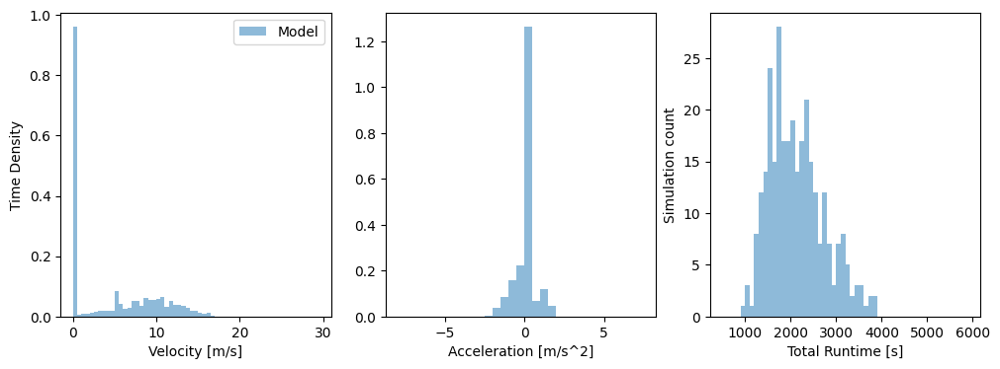

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


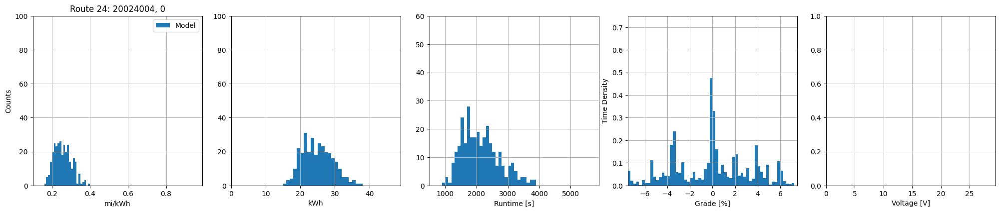

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16707521380319096), np.float64(0.39436625040932627), np.float64(0.2574994673148596), np.float64(0.04502004026314969))
Energy min/max/mean/std [kWh]: 		(np.float64(15.800050445259137), np.float64(37.29462024040843), np.float64(24.938738225796243), np.float64(4.3391691705879065))
Time min/max/mean/std [s]: 		(np.float64(943.9339866656319), np.float64(3826.256283211169), np.float64(2138.795126309859), np.float64(600.6790428809866))
|Grade| mean/std [%]: 			(np.float64(2.5224675212373886), np.float64(1.9706268385273111))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



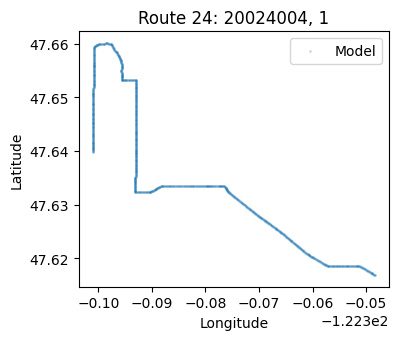

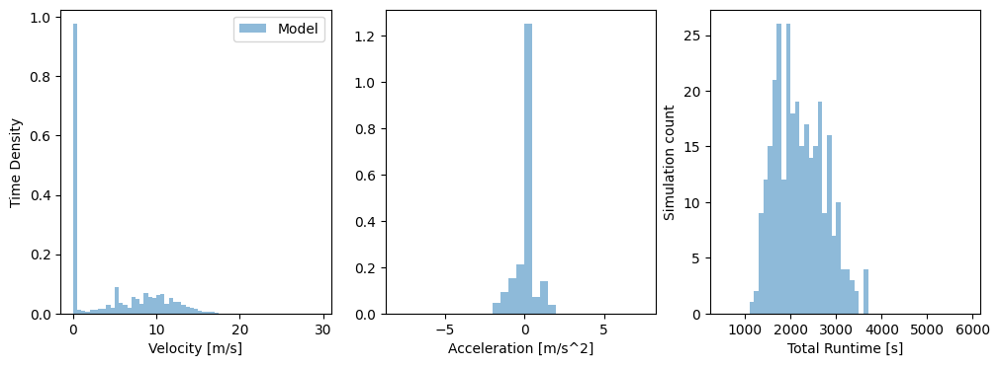

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


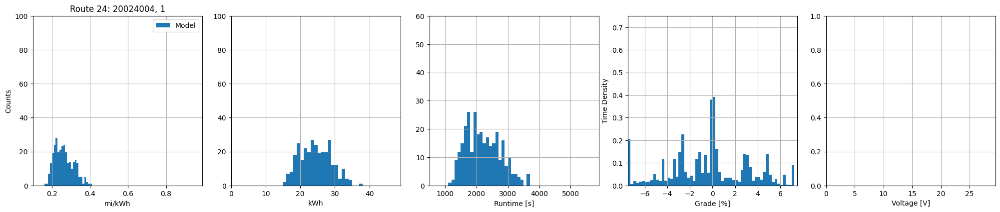

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16805585688915506), np.float64(0.40297420903809483), np.float64(0.2634329168253906), np.float64(0.04897974338659361))
Energy min/max/mean/std [kWh]: 		(np.float64(15.466467198282311), np.float64(37.08640389696322), np.float64(24.462684417166432), np.float64(4.428412639051806))
Time min/max/mean/std [s]: 		(np.float64(1126.7526674804326), np.float64(3694.231238342525), np.float64(2208.888695710389), np.float64(545.0390259218585))
|Grade| mean/std [%]: 			(np.float64(2.416473114946278), np.float64(1.9751582345924914))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



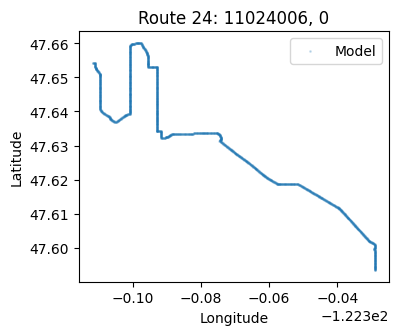

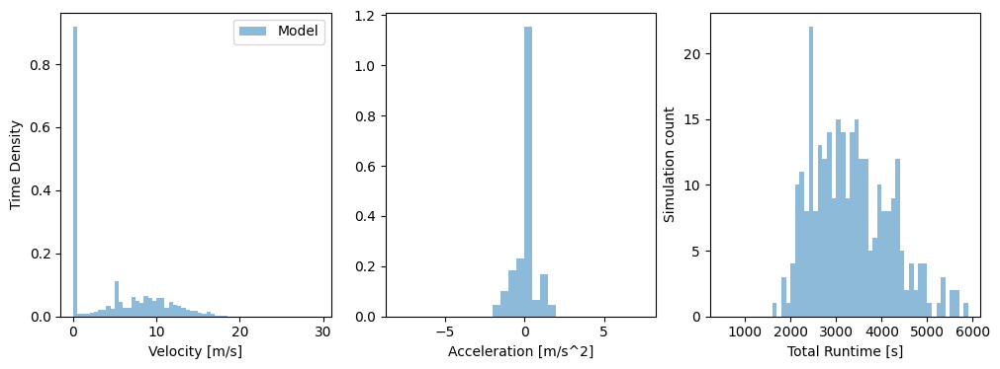

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


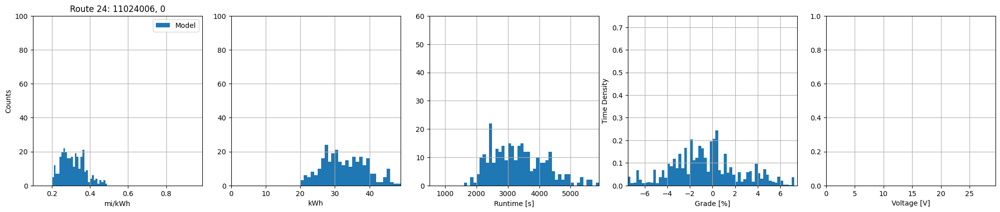

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20064274027287132), np.float64(0.48680725591234414), np.float64(0.3114684445005881), np.float64(0.061733185219618986))
Energy min/max/mean/std [kWh]: 		(np.float64(20.30756088686668), np.float64(49.27099767558884), np.float64(32.97717144450787), np.float64(6.435593832946823))
Time min/max/mean/std [s]: 		(np.float64(1676.3099689509918), np.float64(6220.792340851271), np.float64(3363.254970966889), np.float64(902.5449742301145))
|Grade| mean/std [%]: 			(np.float64(2.364365914538558), np.float64(1.8151283049456661))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



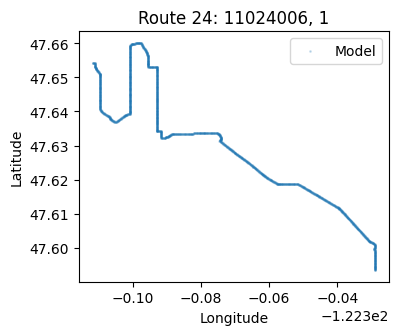

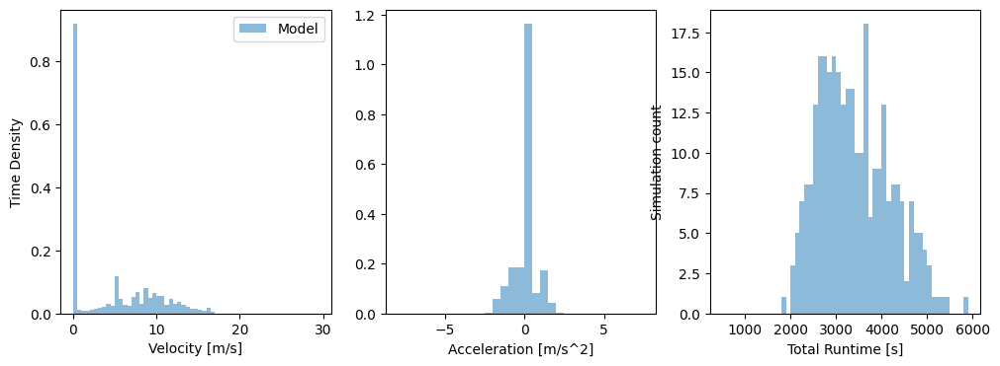

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


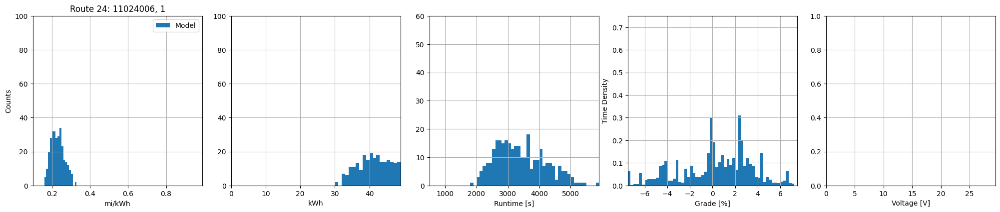

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16095705495452559), np.float64(0.32547099677194763), np.float64(0.23024649719702353), np.float64(0.03442897402211289))
Energy min/max/mean/std [kWh]: 		(np.float64(30.37513621803984), np.float64(61.42151311579489), np.float64(43.8965040515562), np.float64(6.529732609411527))
Time min/max/mean/std [s]: 		(np.float64(1843.090141969988), np.float64(5861.295117997712), np.float64(3410.413402000799), np.float64(784.9820063466905))
|Grade| mean/std [%]: 			(np.float64(2.484173635652398), np.float64(1.7911530421613049))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



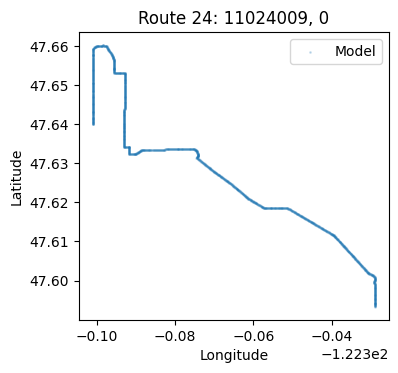

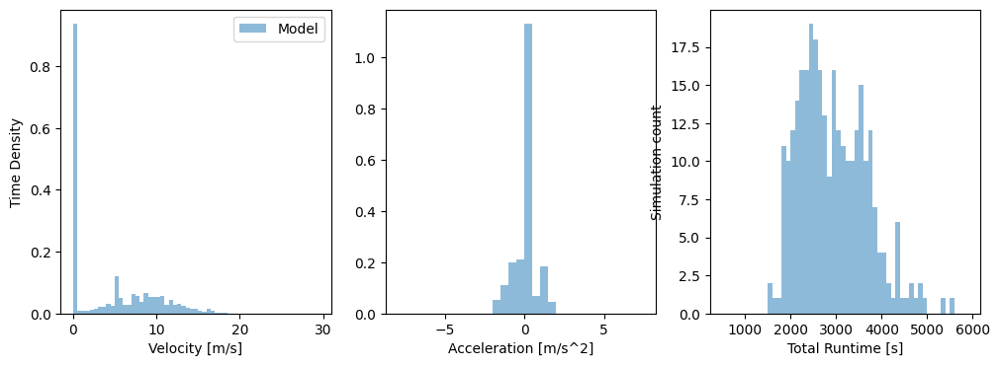

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


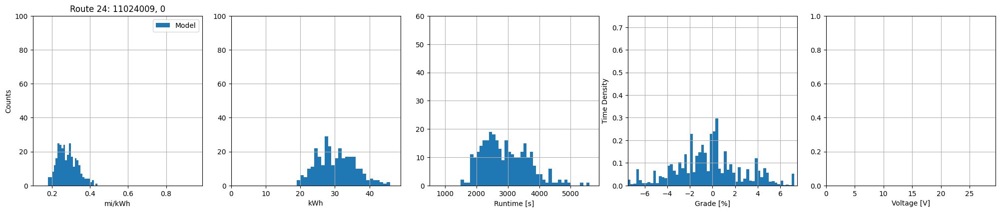

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1824876813759712), np.float64(0.4345812077409288), np.float64(0.2815653968399622), np.float64(0.051395313843570906))
Energy min/max/mean/std [kWh]: 		(np.float64(19.005599064186434), np.float64(45.26045885879484), np.float64(30.30424638707973), np.float64(5.459143047610623))
Time min/max/mean/std [s]: 		(np.float64(1516.7007426801101), np.float64(5576.49223504514), np.float64(2925.321314563769), np.float64(744.3126657818292))
|Grade| mean/std [%]: 			(np.float64(2.236385186526182), np.float64(1.8317927967998073))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



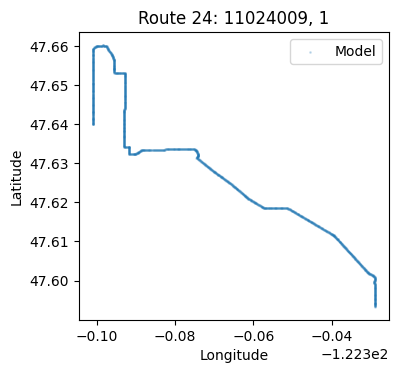

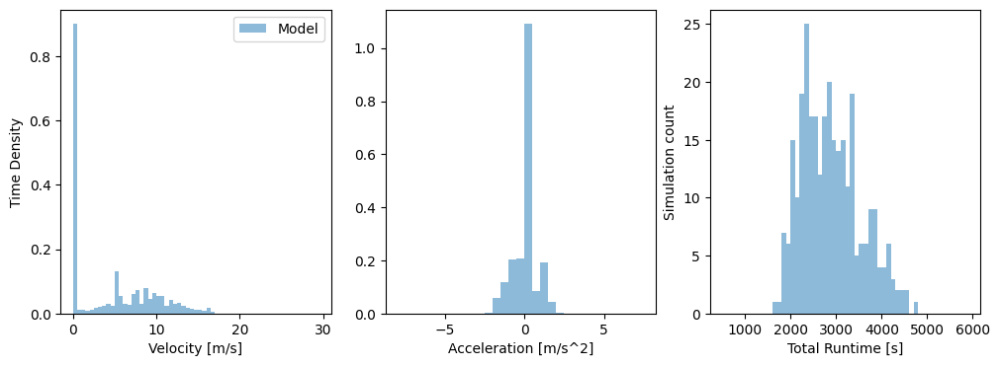

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


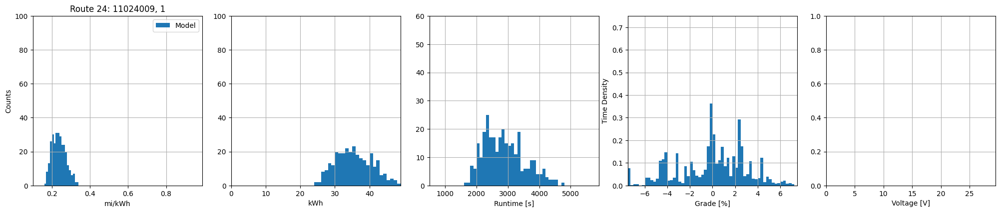

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16416971579546855), np.float64(0.3379415302672774), np.float64(0.23756119684577612), np.float64(0.035726266977030574))
Energy min/max/mean/std [kWh]: 		(np.float64(24.441132280284002), np.float64(50.311798398642985), np.float64(35.55082881098624), np.float64(5.297199896485581))
Time min/max/mean/std [s]: 		(np.float64(1615.2125233274), np.float64(4794.088621094032), np.float64(2887.917135992536), np.float64(646.3988515367644))
|Grade| mean/std [%]: 			(np.float64(2.2584733513360504), np.float64(1.7191446471493914))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



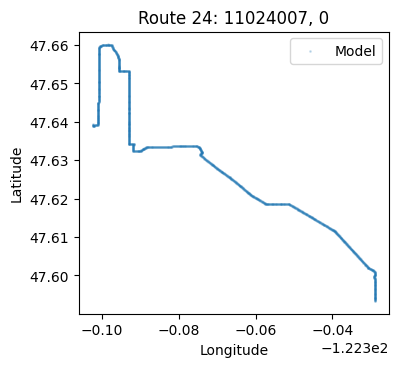

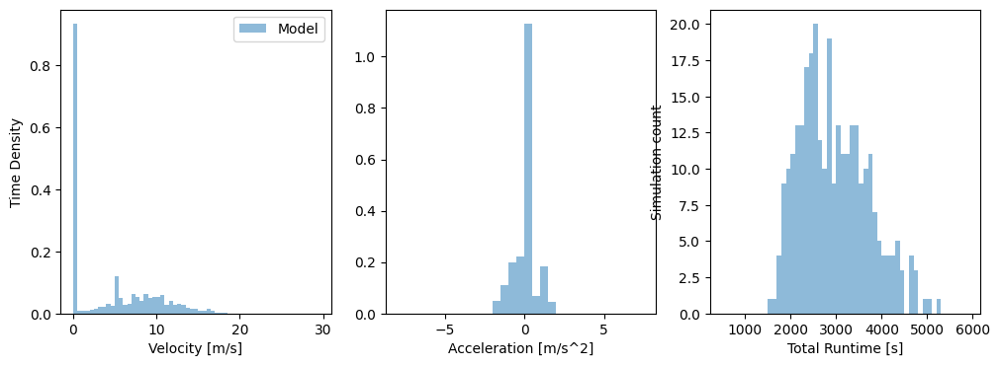

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


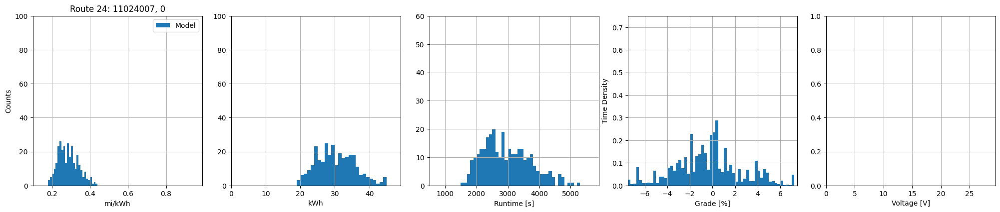

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18720877972021646), np.float64(0.4378141429930854), np.float64(0.2867230693401368), np.float64(0.052868952235001876))
Energy min/max/mean/std [kWh]: 		(np.float64(19.201863286614685), np.float64(44.906266315413376), np.float64(30.312475735360287), np.float64(5.526970208671857))
Time min/max/mean/std [s]: 		(np.float64(1574.6092118546358), np.float64(5223.547253127148), np.float64(2964.2192243253667), np.float64(757.4905305711696))
|Grade| mean/std [%]: 			(np.float64(2.2366169479081104), np.float64(1.8262448199947499))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



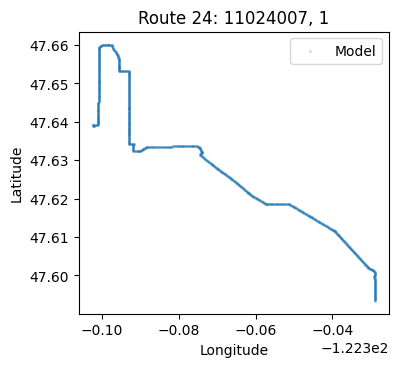

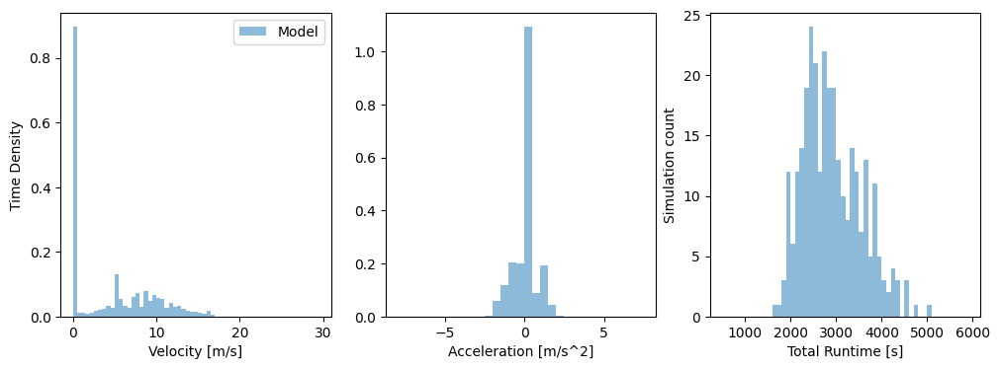

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


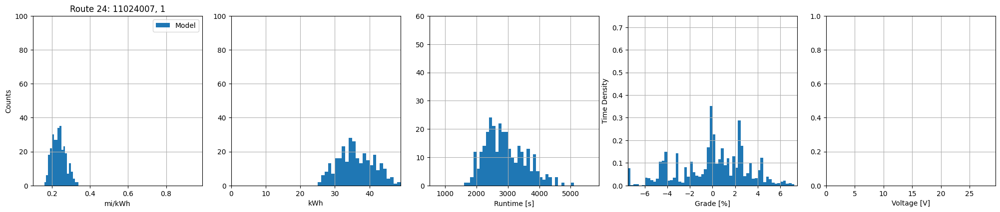

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16323653299650343), np.float64(0.3345010951171573), np.float64(0.23677722974619053), np.float64(0.03550429738961114))
Energy min/max/mean/std [kWh]: 		(np.float64(25.132961647541233), np.float64(51.501971037452364), np.float64(36.30049925136851), np.float64(5.399239712733162))
Time min/max/mean/std [s]: 		(np.float64(1626.965913616018), np.float64(5021.293996628683), np.float64(2912.008796160432), np.float64(643.1139328657871))
|Grade| mean/std [%]: 			(np.float64(2.2762722564469557), np.float64(1.7175531283261398))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



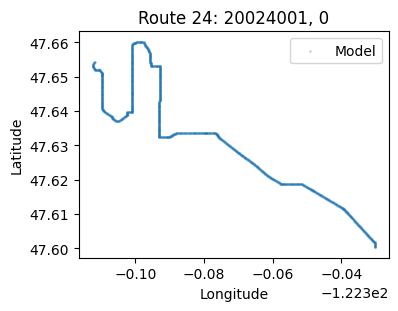

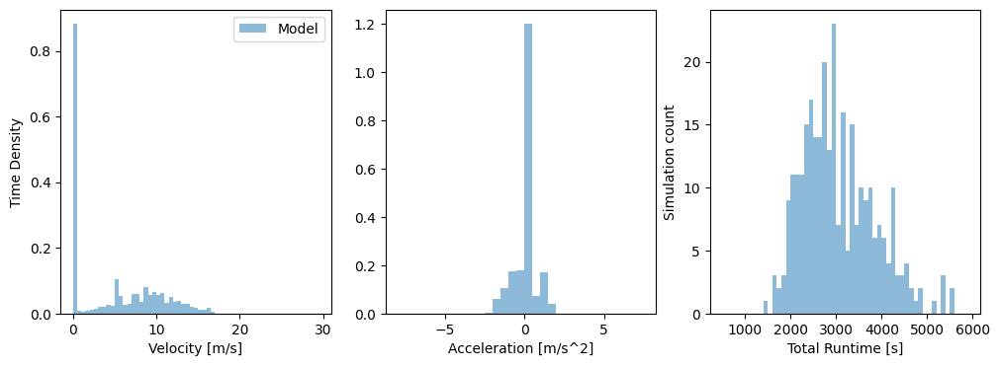

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


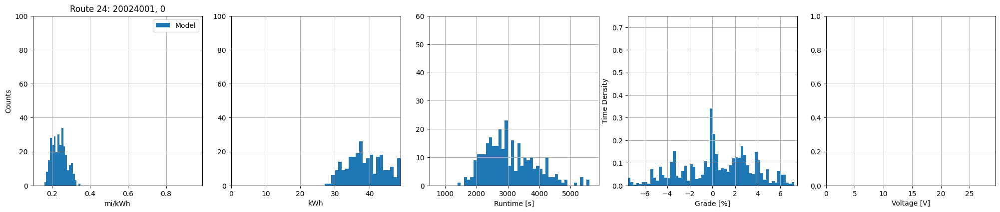

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16712442970967523), np.float64(0.34436262834607734), np.float64(0.23929514156470486), np.float64(0.03785296374540872))
Energy min/max/mean/std [kWh]: 		(np.float64(27.269683647388284), np.float64(56.18963039271946), np.float64(40.23737844607114), np.float64(6.404773628525612))
Time min/max/mean/std [s]: 		(np.float64(1414.6895933697326), np.float64(5550.130340518355), np.float64(3053.620349191653), np.float64(799.8420903461158))
|Grade| mean/std [%]: 			(np.float64(2.5284647195851258), np.float64(1.826120344517895))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



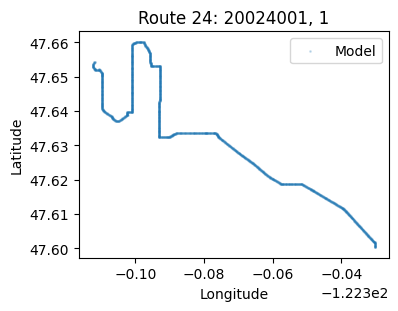

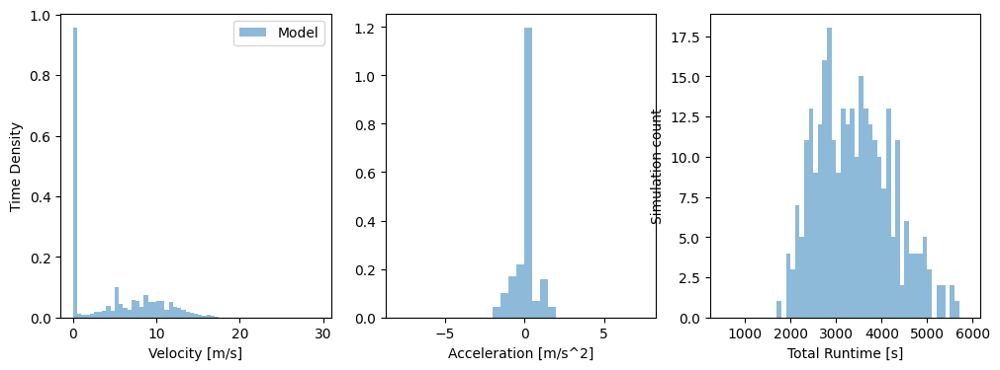

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


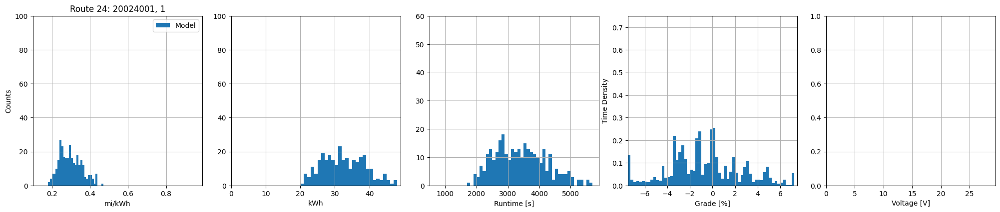

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18238588070110065), np.float64(0.4675513693398405), np.float64(0.29818029712323135), np.float64(0.05851309960324554))
Energy min/max/mean/std [kWh]: 		(np.float64(20.08696229759014), np.float64(51.49349660189646), np.float64(32.70852087810167), np.float64(6.355886826307002))
Time min/max/mean/std [s]: 		(np.float64(1759.1153287732418), np.float64(5664.298829815616), np.float64(3404.5729590585506), np.float64(820.3341844012077))
|Grade| mean/std [%]: 			(np.float64(2.389994369878383), np.float64(1.807310936578997))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------27-------------------


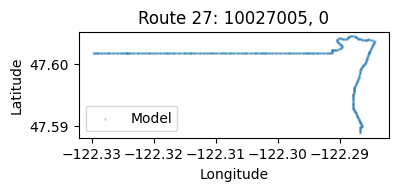

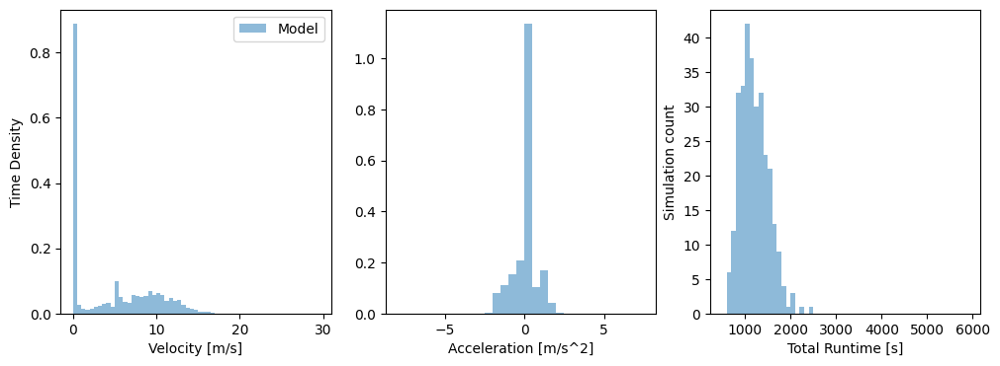

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


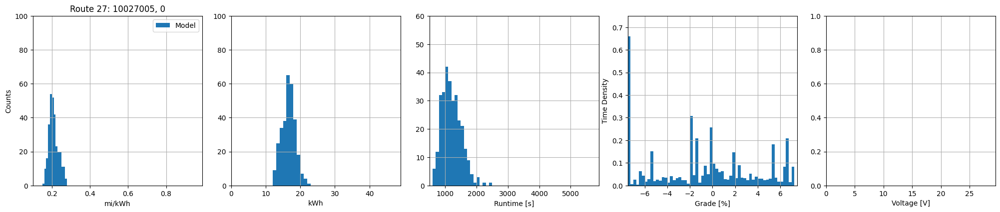

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15321113936609088), np.float64(0.2782768408001392), np.float64(0.2100243046399804), np.float64(0.025525965881794278))
Energy min/max/mean/std [kWh]: 		(np.float64(12.352959484432185), np.float64(22.4366358352447), np.float64(16.602529186733495), np.float64(1.9629945766125754))
Time min/max/mean/std [s]: 		(np.float64(620.0287278111799), np.float64(2445.9031435995053), np.float64(1206.3457498073399), np.float64(307.15116915501545))
|Grade| mean/std [%]: 			(np.float64(3.1368421989808795), np.float64(2.2698384563284617))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



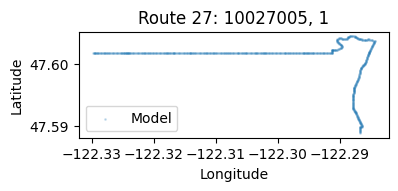

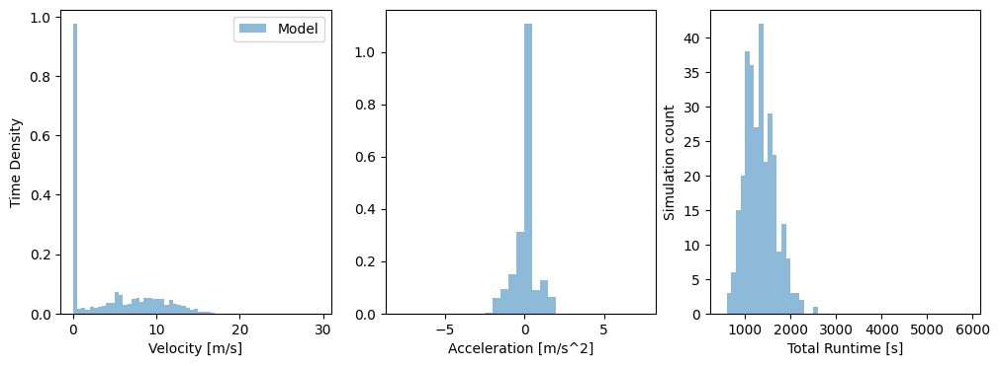

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


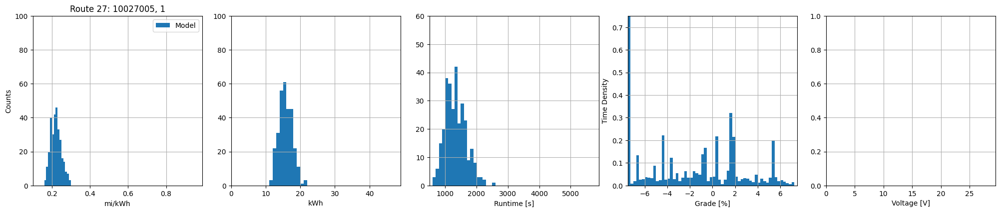

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.160211926095906), np.float64(0.294509120603918), np.float64(0.2219230081324641), np.float64(0.027423018527061936))
Energy min/max/mean/std [kWh]: 		(np.float64(11.673083434215863), np.float64(21.4580126506258), np.float64(15.725639790352076), np.float64(1.927091864156337))
Time min/max/mean/std [s]: 		(np.float64(667.3239455807956), np.float64(2560.3148380196653), np.float64(1332.9662420259451), np.float64(333.890141703289))
|Grade| mean/std [%]: 			(np.float64(2.9955744272734774), np.float64(2.0081889610991412))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



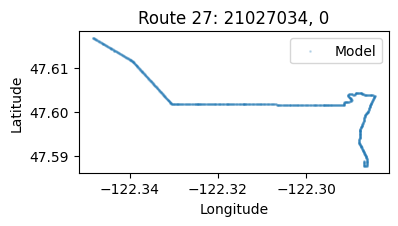

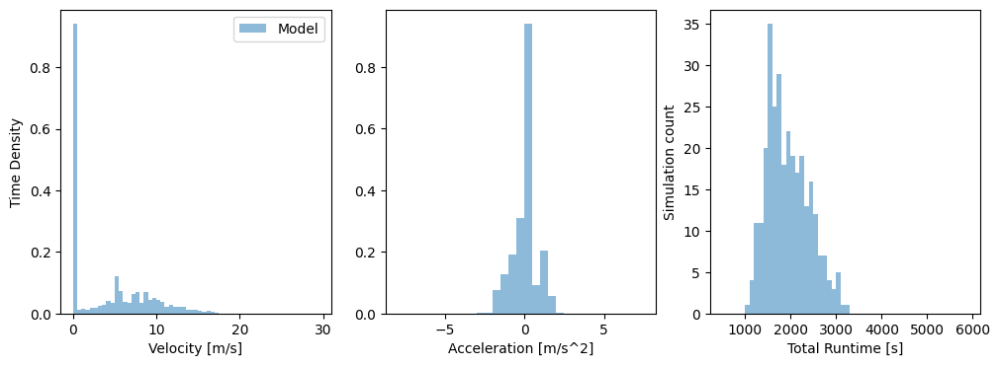

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


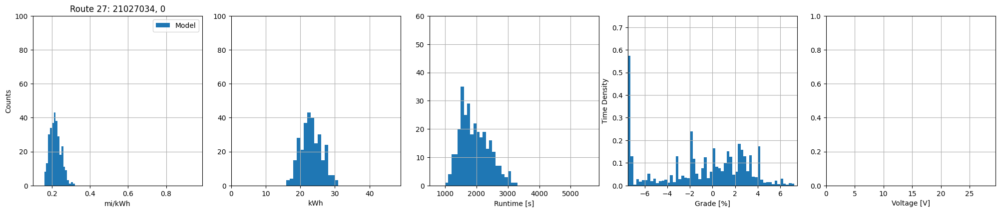

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16174449877791486), np.float64(0.3113295998048611), np.float64(0.21914401010912818), np.float64(0.028726621899412986))
Energy min/max/mean/std [kWh]: 		(np.float64(16.055074882541476), np.float64(30.903184193496763), np.float64(23.193715989249746), np.float64(2.9848262444678544))
Time min/max/mean/std [s]: 		(np.float64(1040.1149560278318), np.float64(3294.098073332113), np.float64(1947.2654858821204), np.float64(461.0073832926806))
|Grade| mean/std [%]: 			(np.float64(2.627617836291438), np.float64(1.825579834708421))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



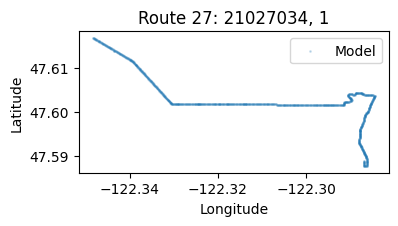

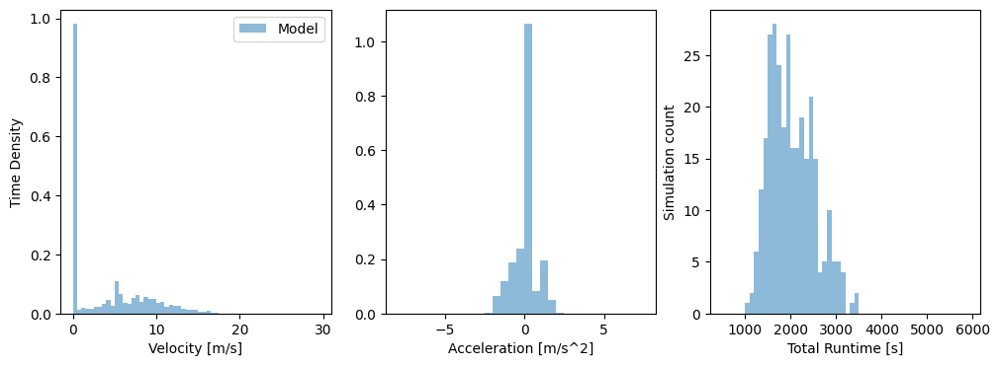

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


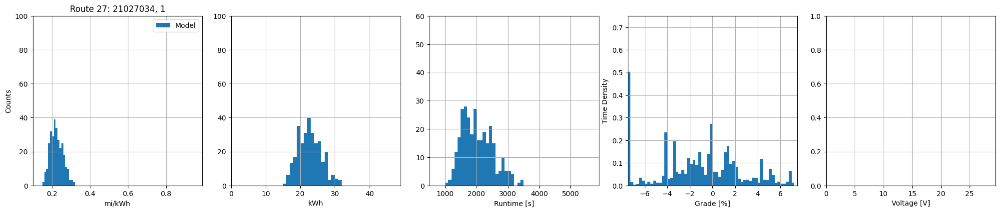

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15629647846906164), np.float64(0.3172352305760917), np.float64(0.22443393756171745), np.float64(0.032624391704398965))
Energy min/max/mean/std [kWh]: 		(np.float64(15.75384322739008), np.float64(31.975602634514672), np.float64(22.738234698398937), np.float64(3.2968084130337623))
Time min/max/mean/std [s]: 		(np.float64(1085.64139705673), np.float64(3479.2337782005834), np.float64(2026.86668005112), np.float64(488.15985680247985))
|Grade| mean/std [%]: 			(np.float64(2.4816078150165435), np.float64(1.8169638442930738))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



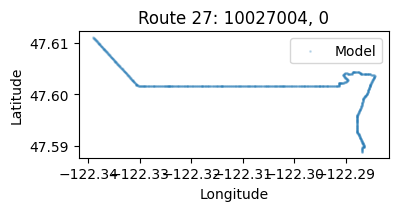

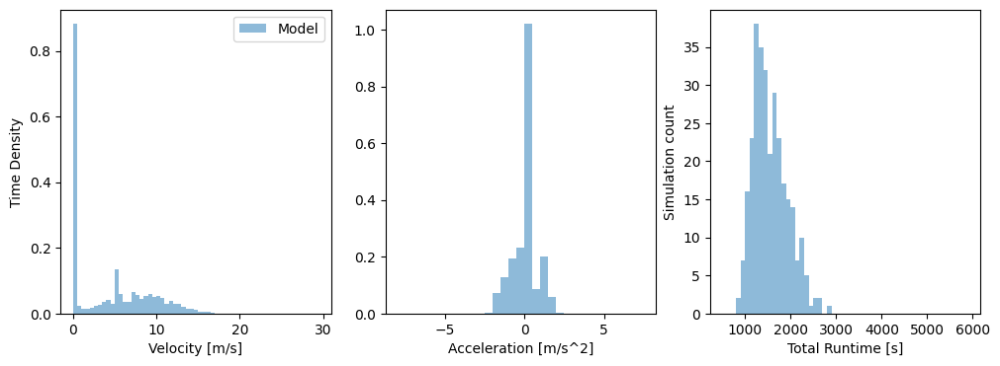

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


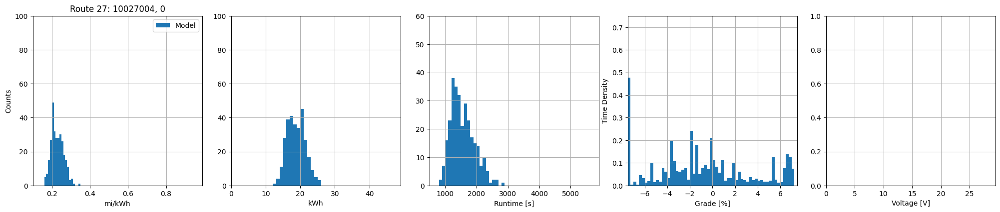

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16639896789254535), np.float64(0.34901557808157196), np.float64(0.22891951632657775), np.float64(0.03199454402381809))
Energy min/max/mean/std [kWh]: 		(np.float64(12.114922257913951), np.float64(25.410593880543942), np.float64(18.825981984325818), np.float64(2.5886903361340985))
Time min/max/mean/std [s]: 		(np.float64(855.0948663192603), np.float64(2887.281236464942), np.float64(1564.6193995798558), np.float64(379.68864453930803))
|Grade| mean/std [%]: 			(np.float64(3.040021687550134), np.float64(2.1826066067595757))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



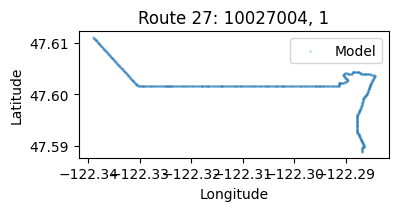

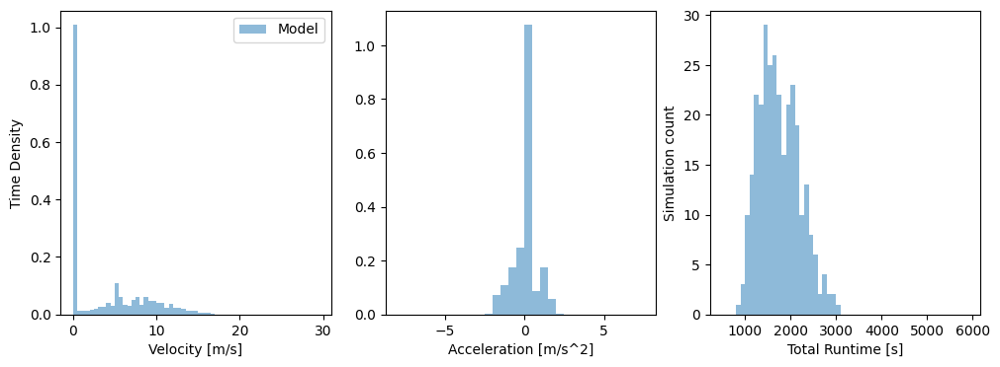

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


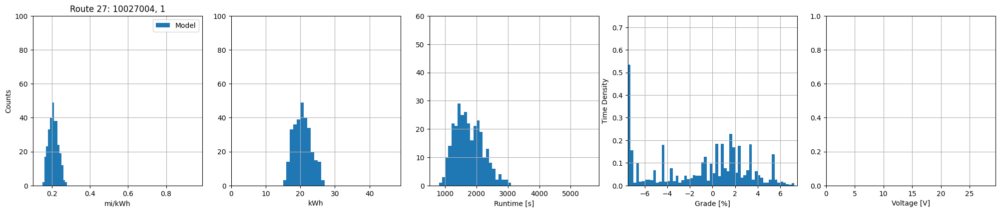

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1593575263530668), np.float64(0.2777429727340727), np.float64(0.2082985205526456), np.float64(0.025065913215881853))
Energy min/max/mean/std [kWh]: 		(np.float64(15.224783959044734), np.float64(26.535155588763512), np.float64(20.59476758510144), np.float64(2.4774270214476086))
Time min/max/mean/std [s]: 		(np.float64(899.8650932600079), np.float64(3032.436516358548), np.float64(1754.303901458749), np.float64(441.74127058607434))
|Grade| mean/std [%]: 			(np.float64(2.8932085991893732), np.float64(2.0438991373609188))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



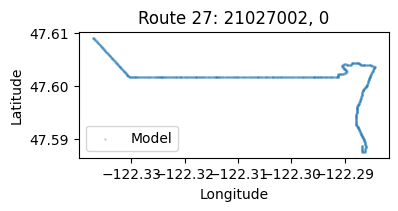

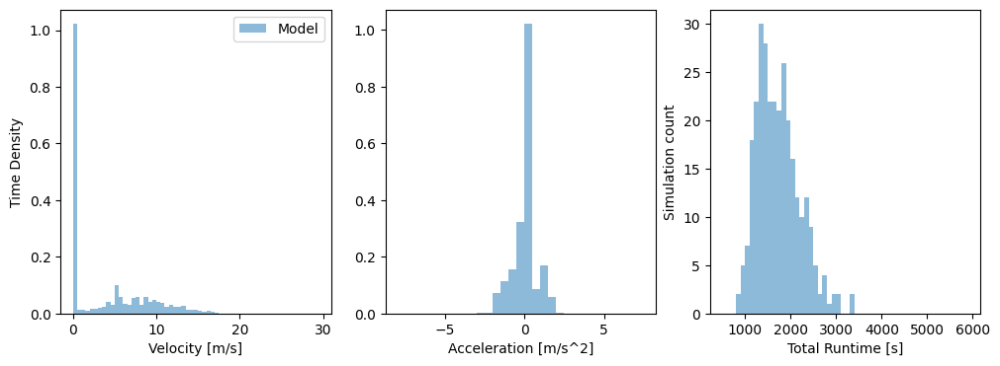

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


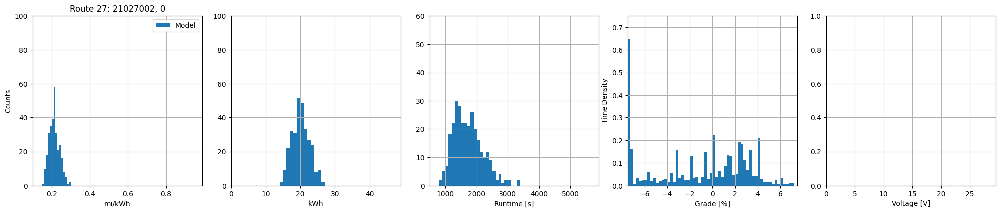

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1596673663286932), np.float64(0.29356236446843326), np.float64(0.2139346363189128), np.float64(0.026765920500801507))
Energy min/max/mean/std [kWh]: 		(np.float64(14.459934570902893), np.float64(26.58584957150546), np.float64(20.148971072721977), np.float64(2.4912613625399023))
Time min/max/mean/std [s]: 		(np.float64(855.648294733759), np.float64(3387.5757822454952), np.float64(1732.7005357660416), np.float64(469.0021060508938))
|Grade| mean/std [%]: 			(np.float64(2.8508220950107814), np.float64(1.914891976564586))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



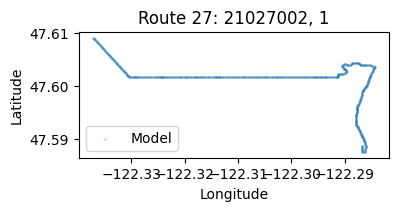

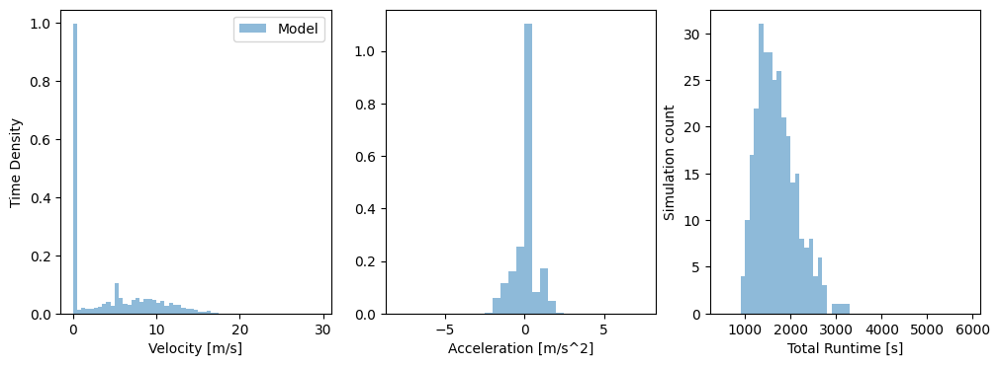

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


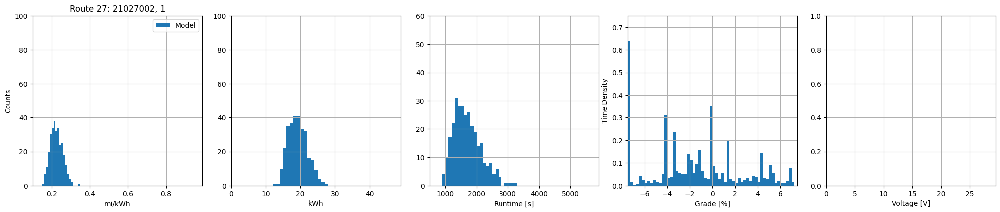

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15215427318394376), np.float64(0.34167417331218136), np.float64(0.22477859284650273), np.float64(0.0317238970055305))
Energy min/max/mean/std [kWh]: 		(np.float64(12.42173376180998), np.float64(27.893962656175404), np.float64(19.25814314062022), np.float64(2.7206177384859074))
Time min/max/mean/std [s]: 		(np.float64(919.7966099766086), np.float64(3227.32524649297), np.float64(1704.185848830808), np.float64(440.1059724599442))
|Grade| mean/std [%]: 			(np.float64(2.7851193716871125), np.float64(1.9207111122204121))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------28-------------------


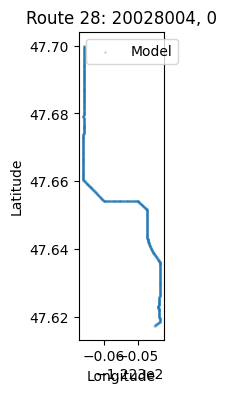

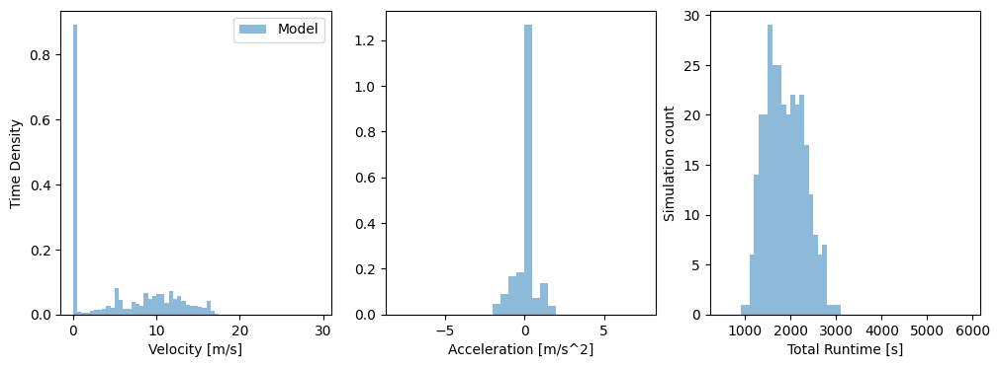

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


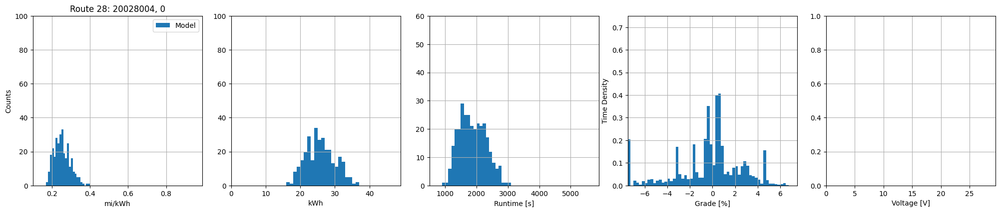

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17584806502960895), np.float64(0.39796737431305473), np.float64(0.2538974747095632), np.float64(0.04189866797305643))
Energy min/max/mean/std [kWh]: 		(np.float64(16.038256246201325), np.float64(36.29669013296214), np.float64(25.80983382368536), np.float64(4.159236975528279))
Time min/max/mean/std [s]: 		(np.float64(987.519971266276), np.float64(3041.065991219167), np.float64(1882.940867637759), np.float64(418.37851712716423))
|Grade| mean/std [%]: 			(np.float64(1.802581973222052), np.float64(1.6287240125428493))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



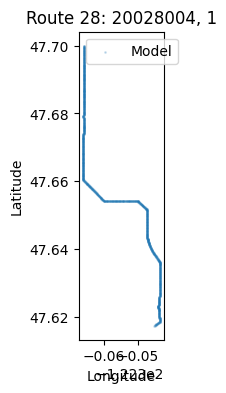

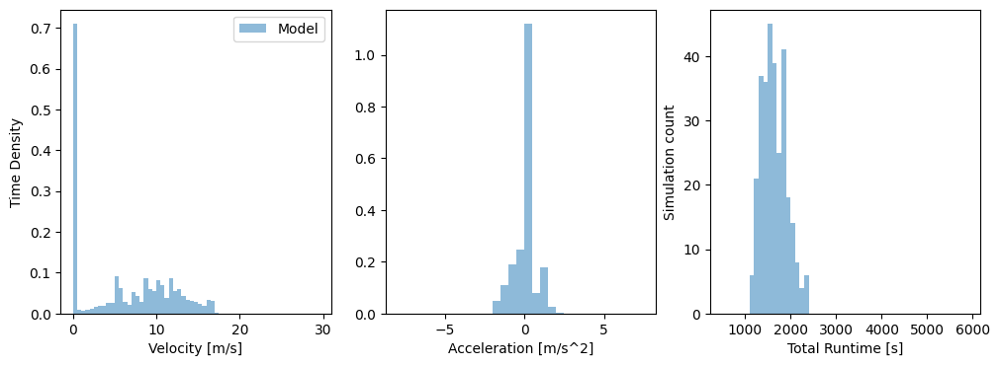

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


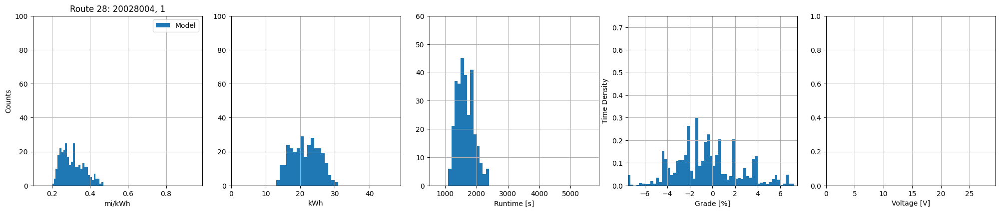

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20684094208555168), np.float64(0.46623536993727593), np.float64(0.30869573858882526), np.float64(0.05957085709574065))
Energy min/max/mean/std [kWh]: 		(np.float64(13.690613501511283), np.float64(30.85969434380781), np.float64(21.422493554271277), np.float64(3.9476281181103166))
Time min/max/mean/std [s]: 		(np.float64(1119.355153004329), np.float64(2390.4723531114264), np.float64(1643.7581803099265), np.float64(269.2353551864286))
|Grade| mean/std [%]: 			(np.float64(2.260927960600729), np.float64(1.6239656691612137))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



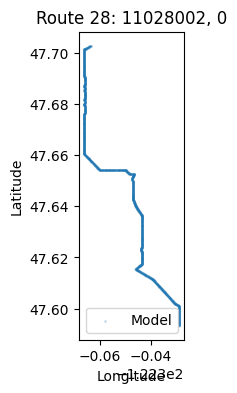

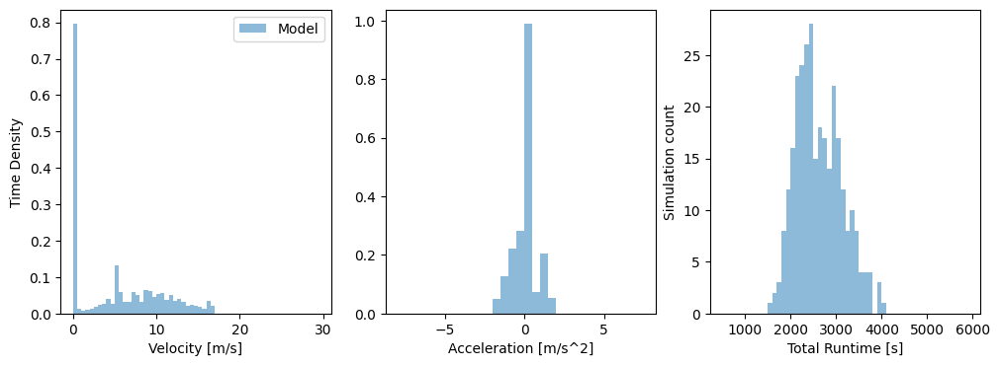

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


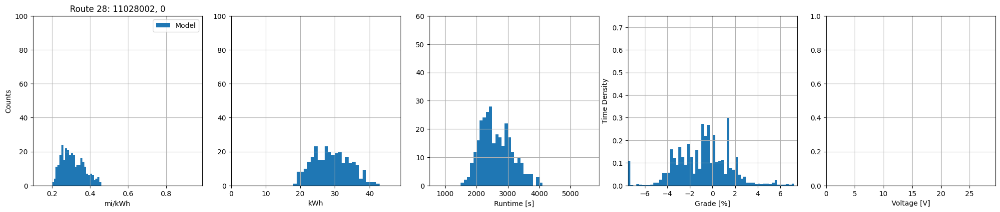

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20392194870701413), np.float64(0.4587109843358144), np.float64(0.3096370772610845), np.float64(0.058103362330448466))
Energy min/max/mean/std [kWh]: 		(np.float64(18.9300776036063), np.float64(42.582147660718796), np.float64(29.013748697403752), np.float64(5.29151934074863))
Time min/max/mean/std [s]: 		(np.float64(1518.1258358271443), np.float64(4040.1252917394604), np.float64(2628.292919516387), np.float64(503.028109396943))
|Grade| mean/std [%]: 			(np.float64(1.832116709769084), np.float64(1.3772470665707797))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



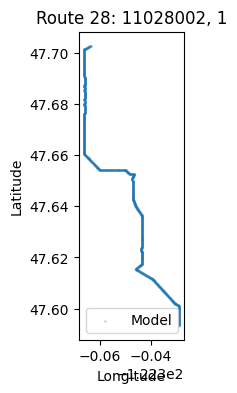

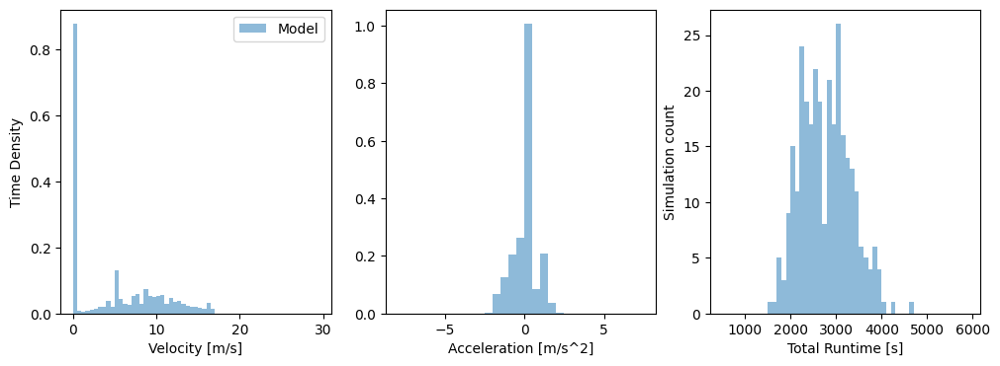

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


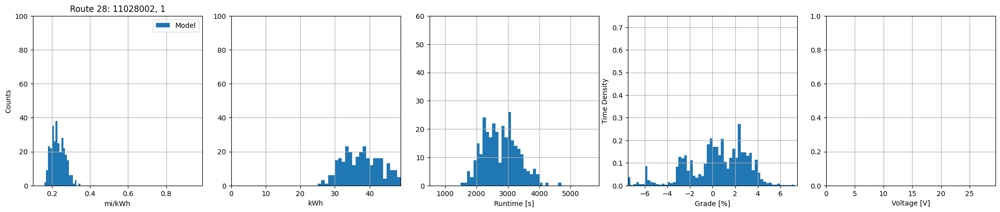

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16487122202967228), np.float64(0.34617385006817347), np.float64(0.23340680319876866), np.float64(0.03500921603231431))
Energy min/max/mean/std [kWh]: 		(np.float64(25.083216303809444), np.float64(52.66627767470399), np.float64(38.03082994665058), np.float64(5.62771468638292))
Time min/max/mean/std [s]: 		(np.float64(1574.416899621025), np.float64(4671.097233359691), np.float64(2771.0872161644465), np.float64(548.3999177406334))
|Grade| mean/std [%]: 			(np.float64(2.0870624689154442), np.float64(1.4782737193879303))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------3-------------------


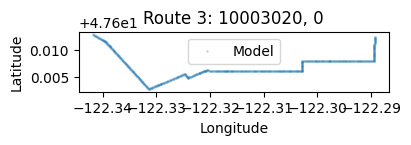

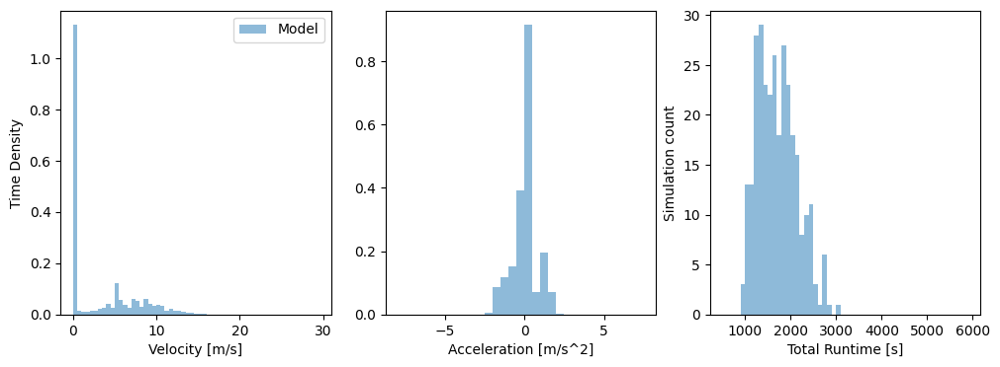

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


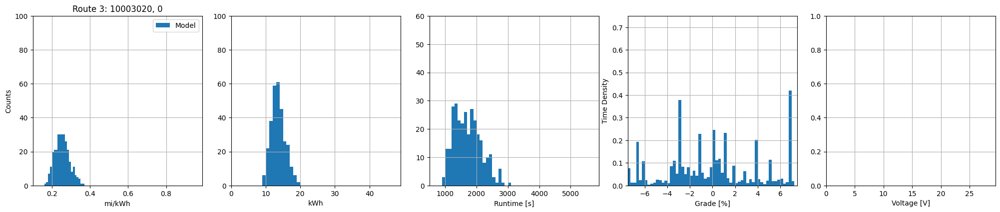

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16966808555794566), np.float64(0.36106519459400316), np.float64(0.25402247565501795), np.float64(0.0381462611374249))
Energy min/max/mean/std [kWh]: 		(np.float64(9.380869097857916), np.float64(19.96312574130014), np.float64(13.636663297929012), np.float64(2.059644906266685))
Time min/max/mean/std [s]: 		(np.float64(927.8147135477502), np.float64(3035.0420158907673), np.float64(1717.0013958898694), np.float64(427.68008801454107))
|Grade| mean/std [%]: 			(np.float64(3.198481760452698), np.float64(2.2858280868318115))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



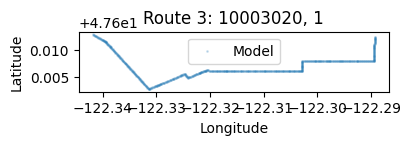

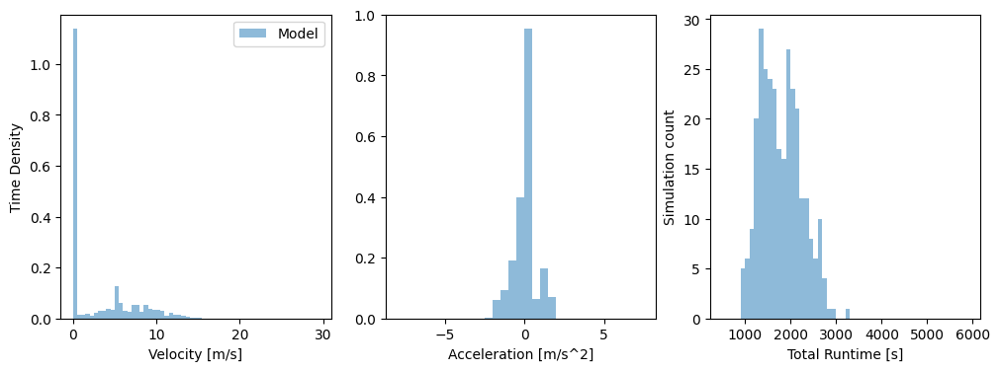

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


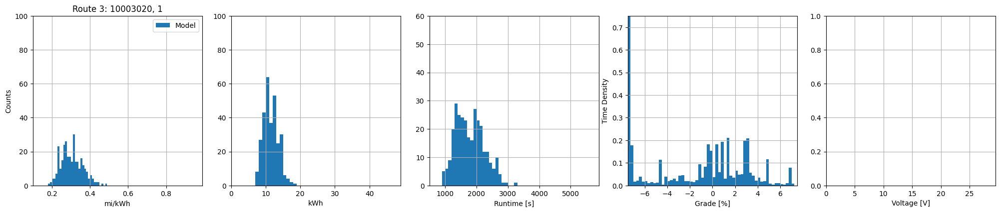

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1813142166183862), np.float64(0.4808842251385207), np.float64(0.3047215896533626), np.float64(0.055885460606111506))
Energy min/max/mean/std [kWh]: 		(np.float64(7.044612704679482), np.float64(18.683825157631055), np.float64(11.492234970502802), np.float64(2.105178718191973))
Time min/max/mean/std [s]: 		(np.float64(952.8340708133383), np.float64(3270.5924981741455), np.float64(1791.7411433025636), np.float64(451.56450620955803))
|Grade| mean/std [%]: 			(np.float64(2.728799985312934), np.float64(2.139985025279934))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



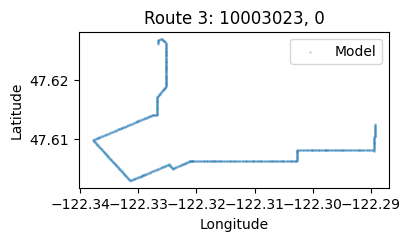

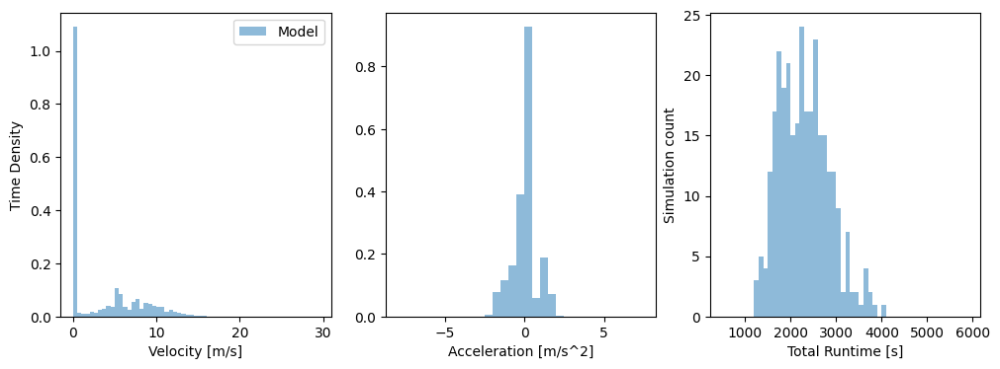

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


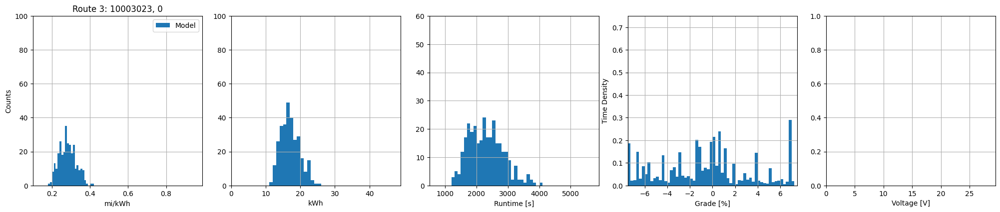

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.185341643430728), np.float64(0.4110301226190273), np.float64(0.2827315288822453), np.float64(0.04374618217680726))
Energy min/max/mean/std [kWh]: 		(np.float64(11.460872263606214), np.float64(25.41665027153886), np.float64(17.06713167252764), np.float64(2.677819594468637))
Time min/max/mean/std [s]: 		(np.float64(1201.9227070177317), np.float64(4002.623793930887), np.float64(2303.94466193119), np.float64(549.0732195682983))
|Grade| mean/std [%]: 			(np.float64(3.004687544401434), np.float64(2.3419370886527187))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



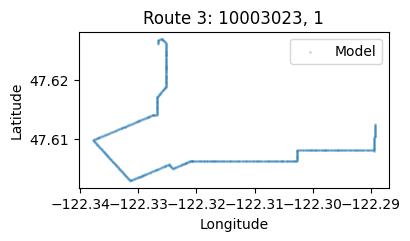

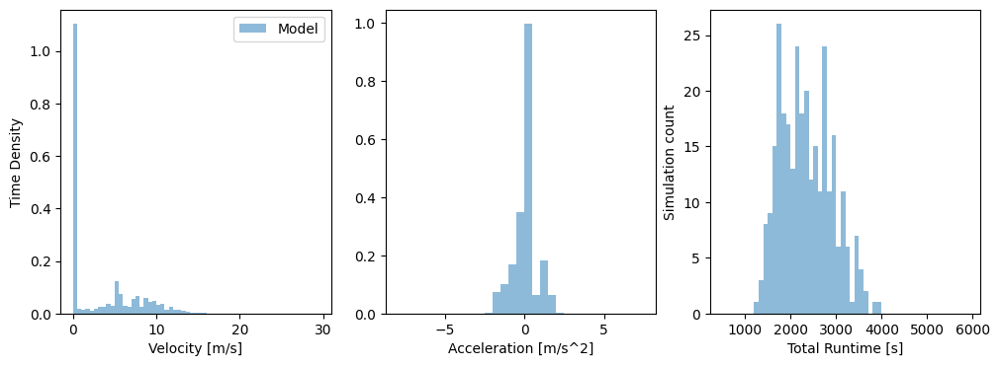

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


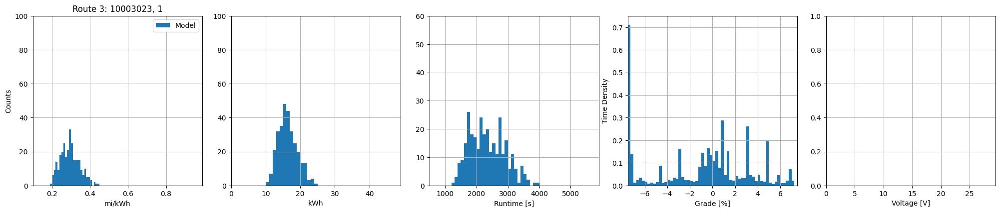

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19072253258651456), np.float64(0.44340350600269407), np.float64(0.2952202594669357), np.float64(0.04935337439733638))
Energy min/max/mean/std [kWh]: 		(np.float64(10.62388670882426), np.float64(24.699067017324083), np.float64(16.404904842693075), np.float64(2.7499780142299723))
Time min/max/mean/std [s]: 		(np.float64(1247.1164935626339), np.float64(3930.0051350825142), np.float64(2344.029514165291), np.float64(562.3181556087815))
|Grade| mean/std [%]: 			(np.float64(2.6854445544823), np.float64(2.1615110368606496))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



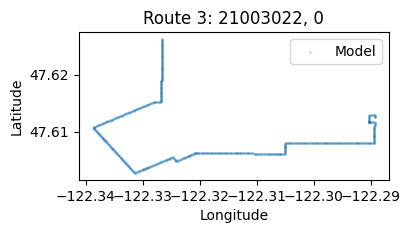

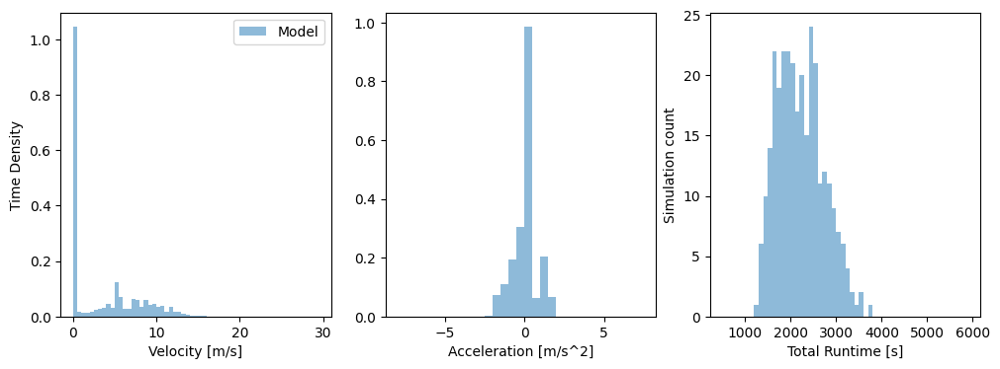

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


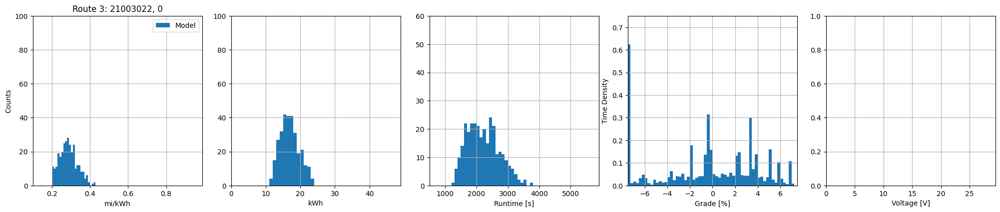

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20132834300163102), np.float64(0.4218075226089355), np.float64(0.28703780791000205), np.float64(0.0465417014941281))
Energy min/max/mean/std [kWh]: 		(np.float64(11.239266527332845), np.float64(23.547639140890332), np.float64(16.951184784857464), np.float64(2.7426220532718943))
Time min/max/mean/std [s]: 		(np.float64(1259.334702083956), np.float64(3744.3401888670937), np.float64(2219.3700876688226), np.float64(504.1599424402594))
|Grade| mean/std [%]: 			(np.float64(2.846958169586339), np.float64(1.981835121775115))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



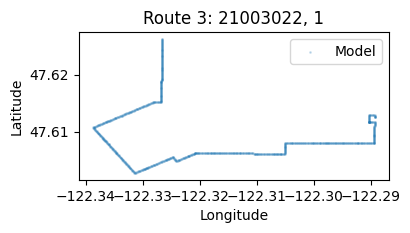

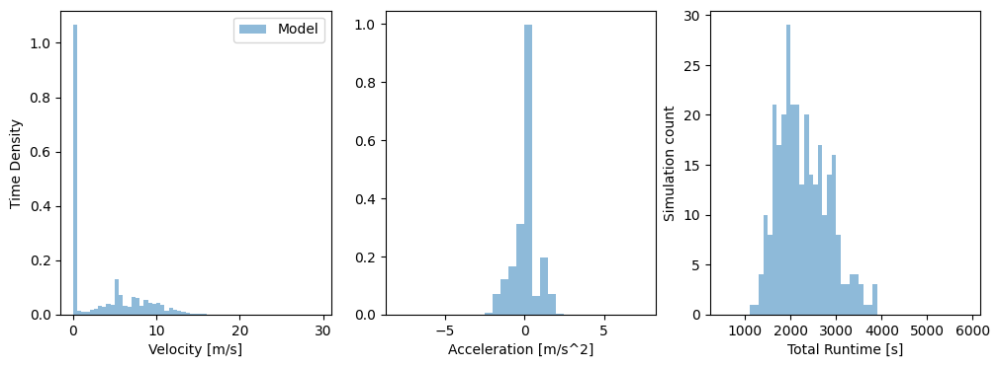

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


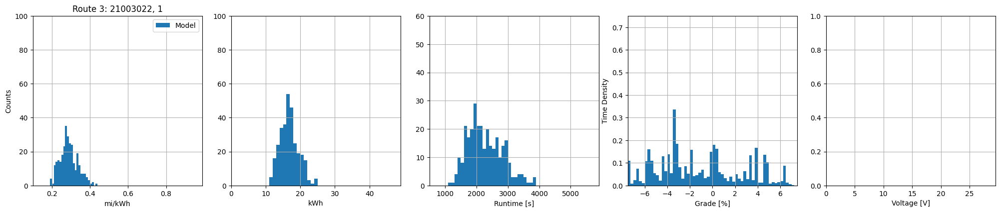

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19139778605909494), np.float64(0.4300059344667947), np.float64(0.2898493892097669), np.float64(0.04639622959203942))
Energy min/max/mean/std [kWh]: 		(np.float64(11.026460803515496), np.float64(24.772719054405478), np.float64(16.777780116219045), np.float64(2.684755570114062))
Time min/max/mean/std [s]: 		(np.float64(1190.711723697417), np.float64(3888.723848034354), np.float64(2282.2186915650427), np.float64(553.4355231269207))
|Grade| mean/std [%]: 			(np.float64(3.191925509847829), np.float64(1.8997470861642747))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



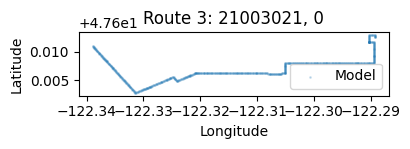

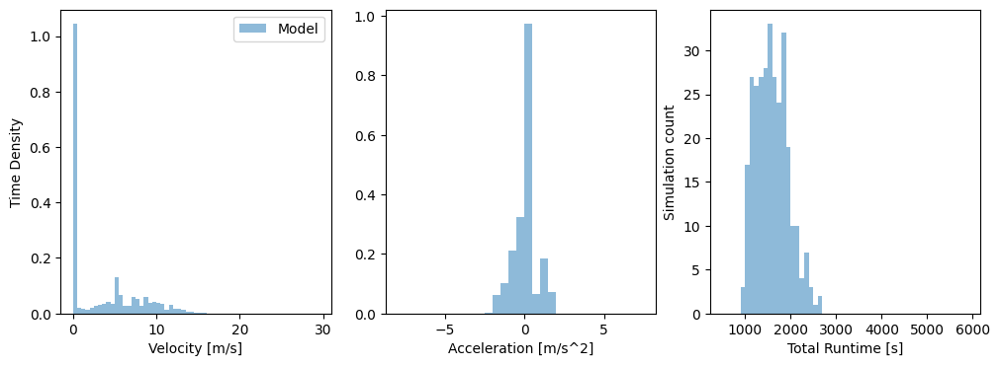

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


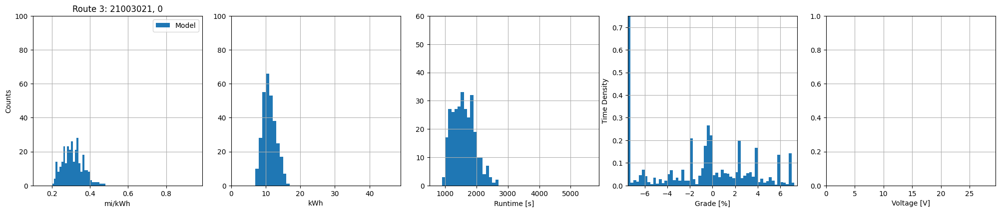

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20811882950866464), np.float64(0.4719920422921199), np.float64(0.31111873264698797), np.float64(0.05292929746049395))
Energy min/max/mean/std [kWh]: 		(np.float64(7.083671379396395), np.float64(16.065036158337346), np.float64(11.05851074448834), np.float64(1.880198390100595))
Time min/max/mean/std [s]: 		(np.float64(945.8816002404845), np.float64(2628.634873833836), np.float64(1593.5610687806693), np.float64(354.9009378830622))
|Grade| mean/std [%]: 			(np.float64(2.7638468537296474), np.float64(2.1438054383343177))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



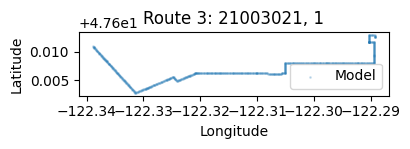

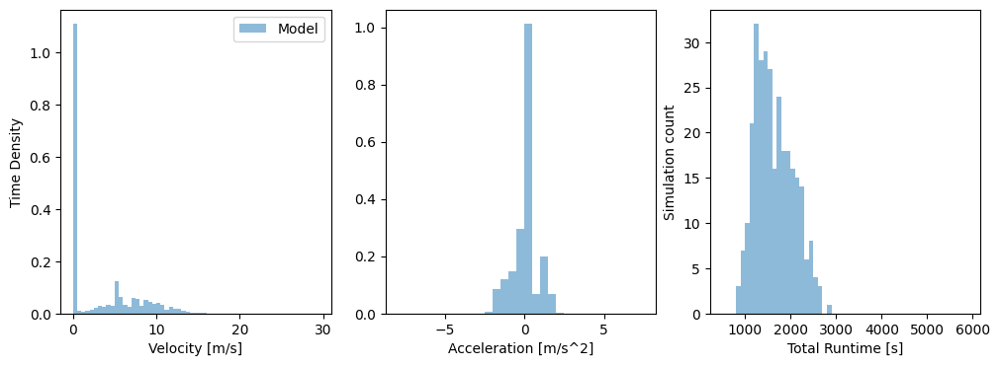

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


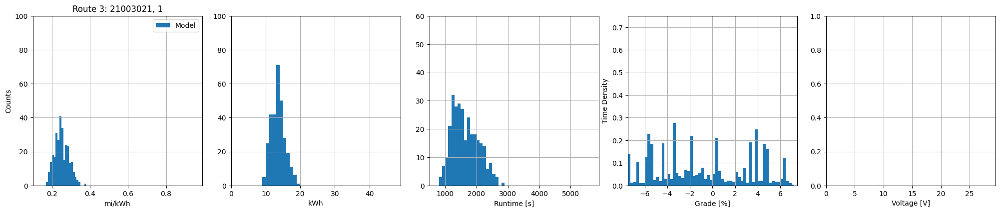

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17429603136686617), np.float64(0.3700589398959672), np.float64(0.25130326499711686), np.float64(0.036665117834281))
Energy min/max/mean/std [kWh]: 		(np.float64(9.037113567267149), np.float64(19.187268007170996), np.float64(13.592056408208782), np.float64(1.9885590168591913))
Time min/max/mean/std [s]: 		(np.float64(885.9371982405498), np.float64(2805.722513359002), np.float64(1648.625826180833), np.float64(419.981908013086))
|Grade| mean/std [%]: 			(np.float64(3.554479503224943), np.float64(1.8673296038363956))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



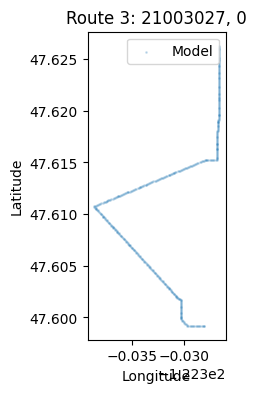

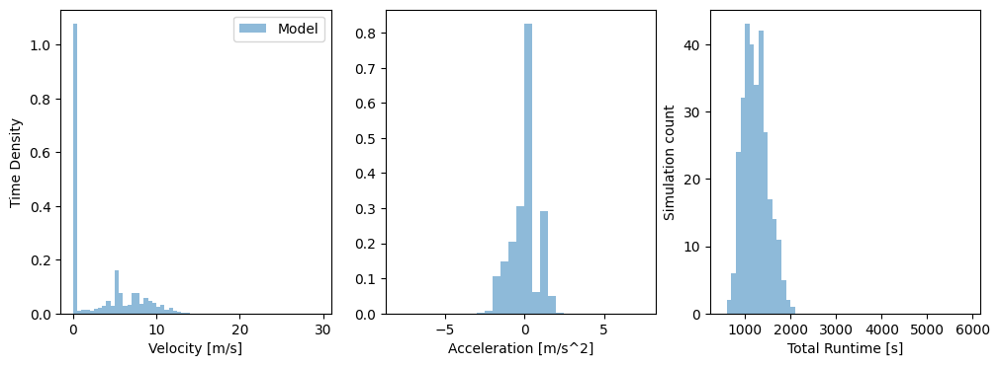

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


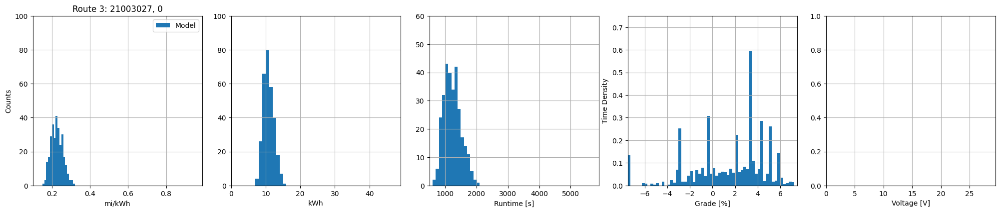

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15915228792272032), np.float64(0.3124656935215399), np.float64(0.22648375674814253), np.float64(0.030738093257676333))
Energy min/max/mean/std [kWh]: 		(np.float64(7.719286508449498), np.float64(15.155372529267947), np.float64(10.847887300299956), np.float64(1.4846385569744192))
Time min/max/mean/std [s]: 		(np.float64(644.3137449810305), np.float64(2000.2691105061579), np.float64(1233.7977419205251), np.float64(272.5694013964762))
|Grade| mean/std [%]: 			(np.float64(2.9071932760703776), np.float64(1.6786084737400817))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



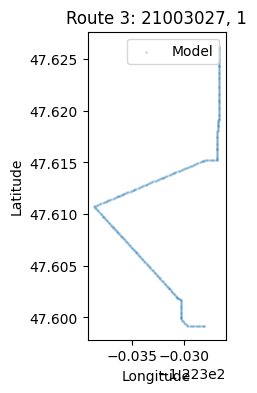

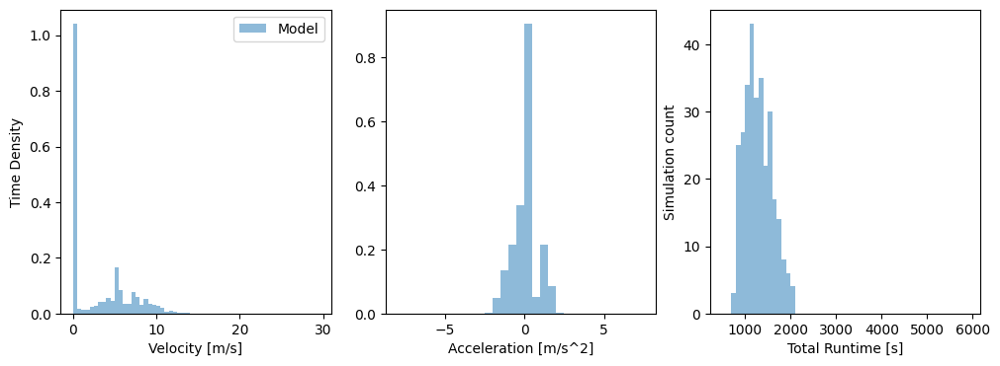

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


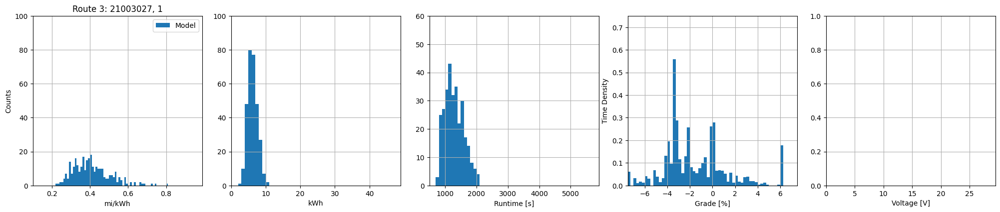

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2242551782167562), np.float64(0.8046061435552851), np.float64(0.4082943721025604), np.float64(0.09654631677001624))
Energy min/max/mean/std [kWh]: 		(np.float64(2.997435119513479), np.float64(10.754510692893827), np.float64(6.220206790936135), np.float64(1.3937566255886975))
Time min/max/mean/std [s]: 		(np.float64(760.3432379947857), np.float64(2087.1575266125865), np.float64(1292.2688020500004), np.float64(299.18688877170223))
|Grade| mean/std [%]: 			(np.float64(2.581803041702266), np.float64(1.7390600869224677))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



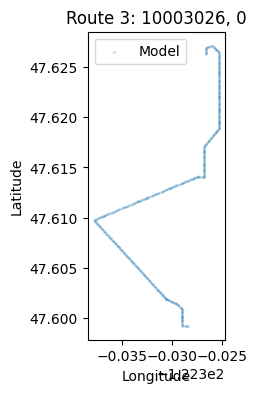

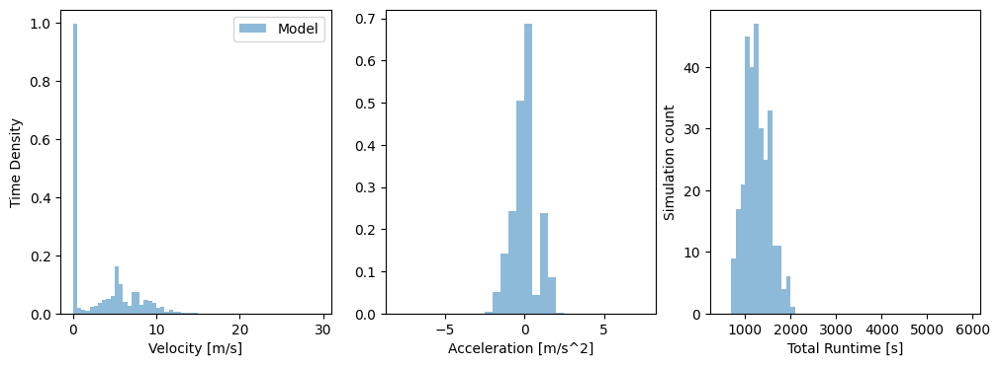

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


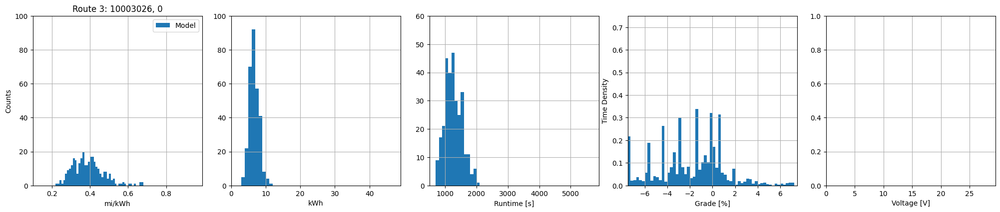

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22649153643611863), np.float64(0.6736144490503624), np.float64(0.39033157843044225), np.float64(0.08121432977175524))
Energy min/max/mean/std [kWh]: 		(np.float64(3.718280649127443), np.float64(11.058636496039872), np.float64(6.683779546122394), np.float64(1.3396287532922149))
Time min/max/mean/std [s]: 		(np.float64(732.1437912438026), np.float64(2071.1856857854373), np.float64(1266.275381685625), np.float64(275.1587267225842))
|Grade| mean/std [%]: 			(np.float64(2.394812463106306), np.float64(1.9451159216653668))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



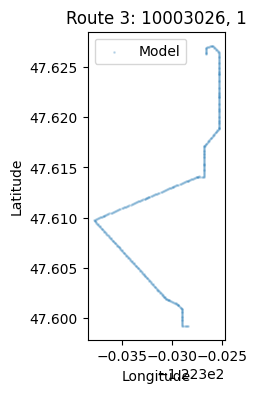

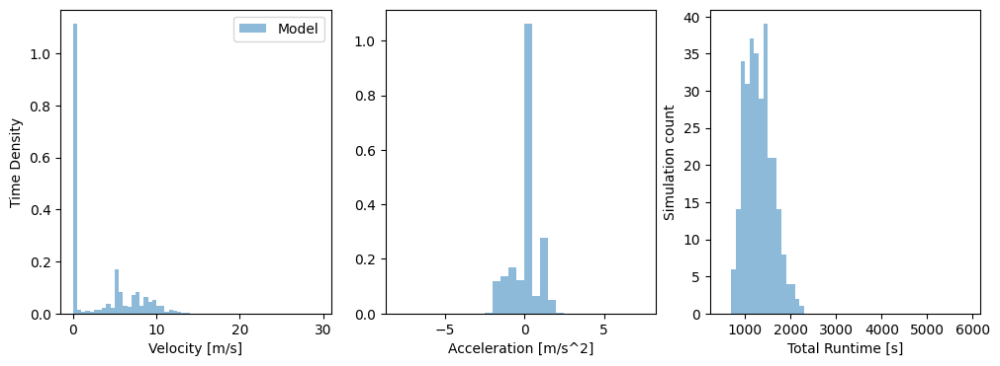

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


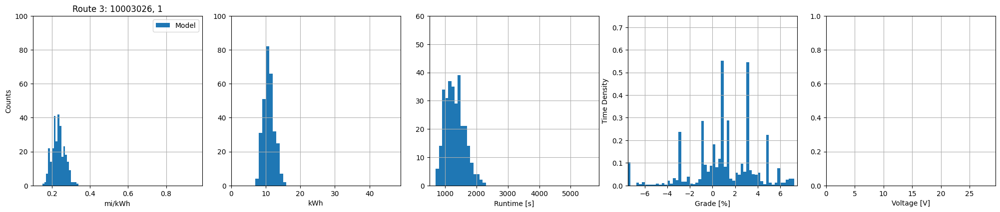

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1593088976904357), np.float64(0.3388596895863383), np.float64(0.23444363170290614), np.float64(0.033501380910577805))
Energy min/max/mean/std [kWh]: 		(np.float64(7.389778389386796), np.float64(15.718506922352377), np.float64(10.901772792342774), np.float64(1.575235799947864))
Time min/max/mean/std [s]: 		(np.float64(751.6608723140921), np.float64(2222.542992302113), np.float64(1309.2000071708455), np.float64(301.3410958150758))
|Grade| mean/std [%]: 			(np.float64(2.283039008529827), np.float64(1.7137682309163165))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------33-------------------


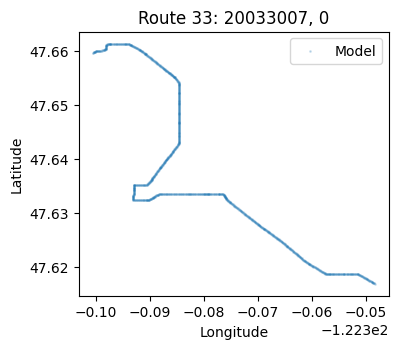

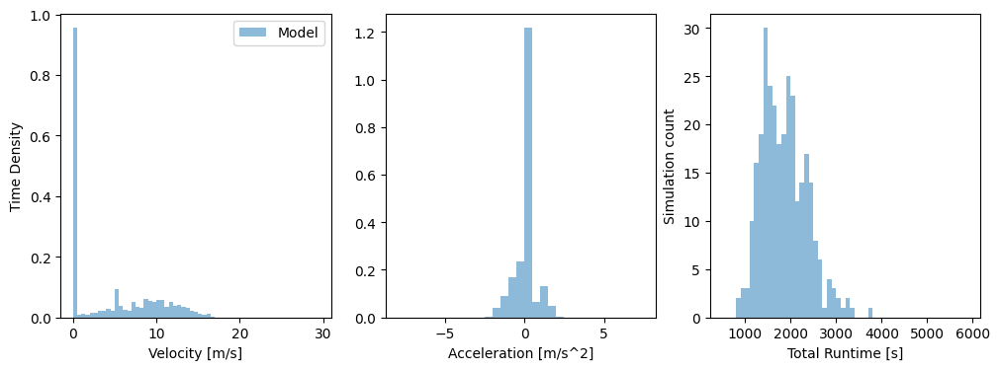

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


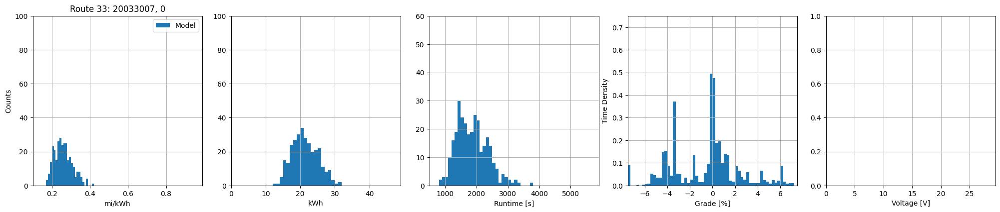

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17013606453627603), np.float64(0.41428653985063674), np.float64(0.2596154740096871), np.float64(0.04633867788351316))
Energy min/max/mean/std [kWh]: 		(np.float64(12.957467763593163), np.float64(31.551831762633757), np.float64(21.325514772429187), np.float64(3.7292272680301752))
Time min/max/mean/std [s]: 		(np.float64(881.9530947311871), np.float64(3770.5575012853346), np.float64(1860.2304381509916), np.float64(497.3507889813621))
|Grade| mean/std [%]: 			(np.float64(2.086508803060218), np.float64(1.8768666925802449))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



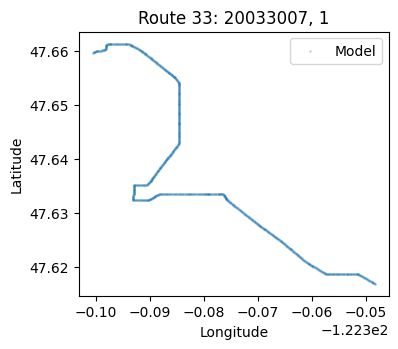

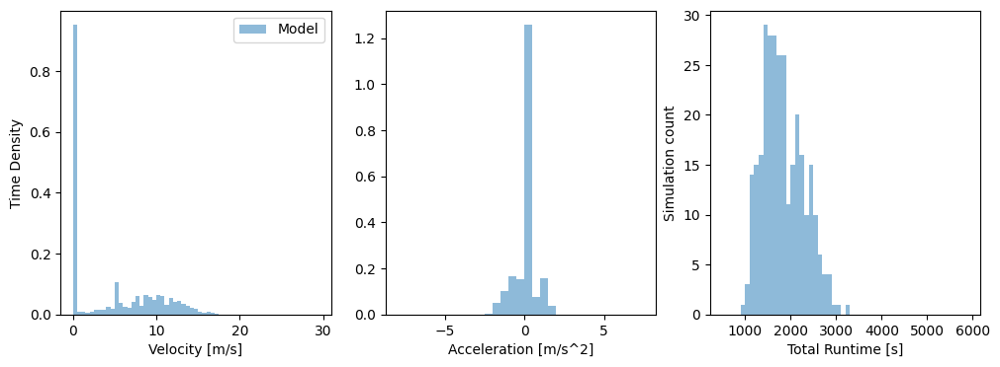

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


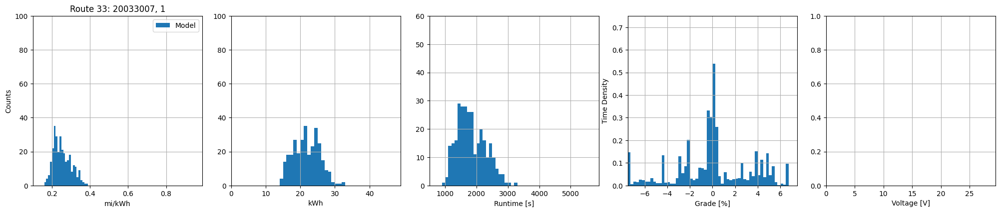

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16279254960334183), np.float64(0.3821632410110288), np.float64(0.2539308485285929), np.float64(0.04543652073712294))
Energy min/max/mean/std [kWh]: 		(np.float64(14.048789924179198), np.float64(32.98020150669841), np.float64(21.802505930318233), np.float64(3.771534827422601))
Time min/max/mean/std [s]: 		(np.float64(947.396066436439), np.float64(3290.33862006653), np.float64(1834.8935876508046), np.float64(451.674698467587))
|Grade| mean/std [%]: 			(np.float64(2.213123825541098), np.float64(2.0271076594855284))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



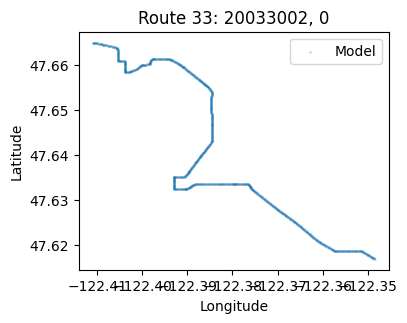

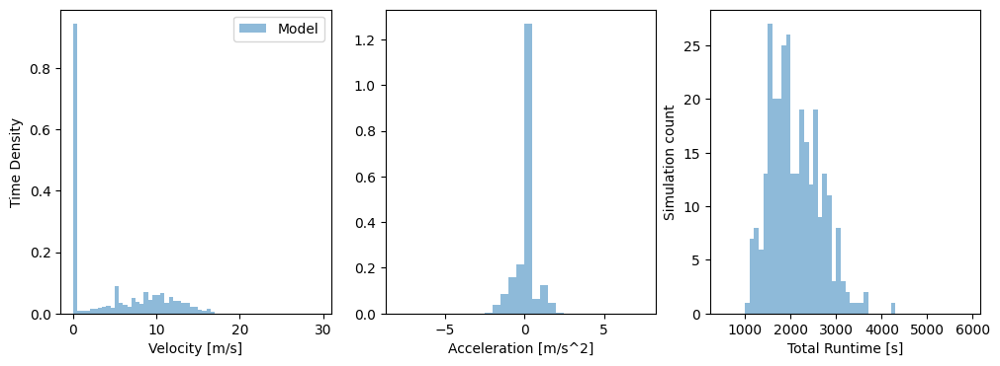

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


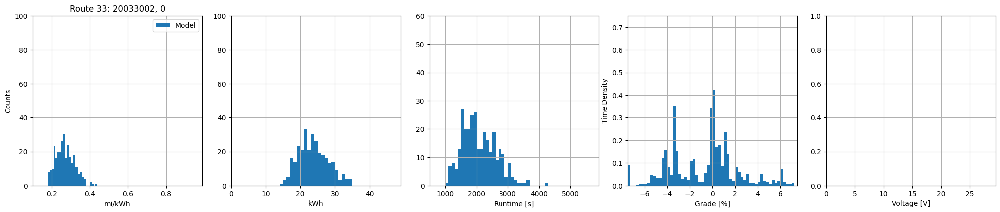

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18121021090669165), np.float64(0.43507858641829605), np.float64(0.27165455266528116), np.float64(0.04898547591144029))
Energy min/max/mean/std [kWh]: 		(np.float64(14.386272797039524), np.float64(34.54087493770919), np.float64(23.790755652780955), np.float64(4.272368353410783))
Time min/max/mean/std [s]: 		(np.float64(1006.8767983463022), np.float64(4279.614154043014), np.float64(2095.533766551668), np.float64(547.8090312249738))
|Grade| mean/std [%]: 			(np.float64(2.1755069115873944), np.float64(1.8063035306167012))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



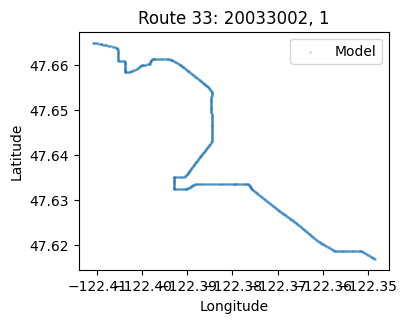

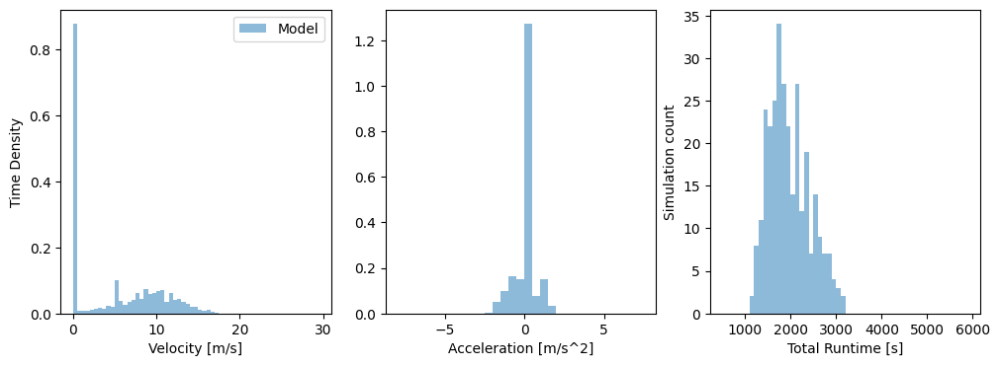

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


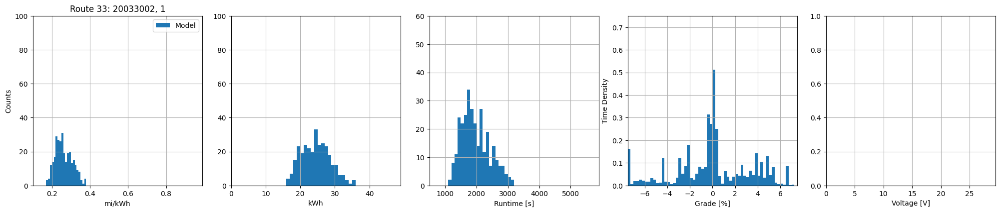

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17639478491776975), np.float64(0.37531234363296584), np.float64(0.26246615341257873), np.float64(0.04435048274117919))
Energy min/max/mean/std [kWh]: 		(np.float64(16.67828944651498), np.float64(35.48612790836492), np.float64(24.527520578582603), np.float64(4.1032106287014))
Time min/max/mean/std [s]: 		(np.float64(1103.7342060544065), np.float64(3190.3135545362165), np.float64(1974.276915957719), np.float64(445.55517959044164))
|Grade| mean/std [%]: 			(np.float64(2.231898129282238), np.float64(2.006985376747346))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



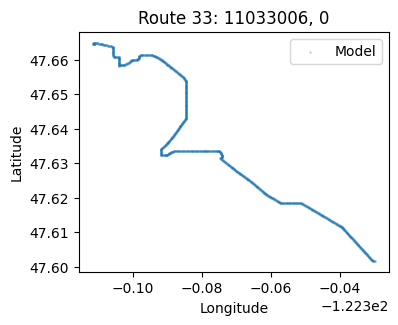

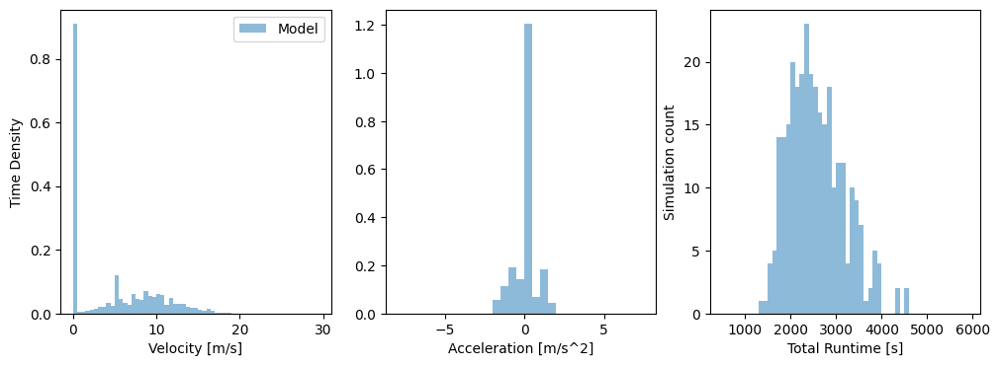

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


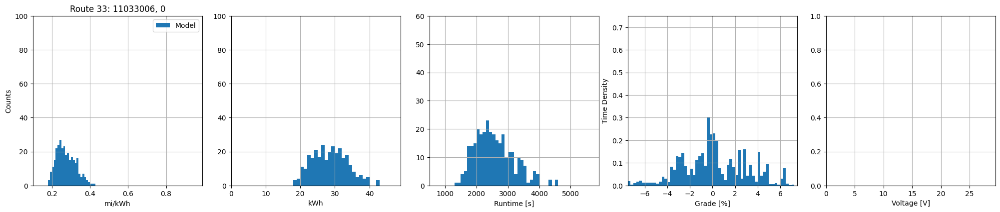

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18034459297393704), np.float64(0.4207018936909557), np.float64(0.27533441133619135), np.float64(0.04970667949371766))
Energy min/max/mean/std [kWh]: 		(np.float64(18.140818653245095), np.float64(42.3183009519302), np.float64(28.609651044610388), np.float64(5.061298717317002))
Time min/max/mean/std [s]: 		(np.float64(1324.2384452561662), np.float64(4532.24884765762), np.float64(2569.458940031059), np.float64(608.966841206922))
|Grade| mean/std [%]: 			(np.float64(2.21073560079628), np.float64(1.7380081333875965))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



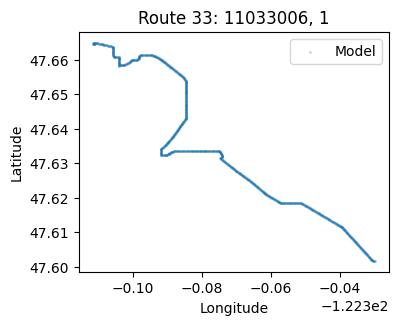

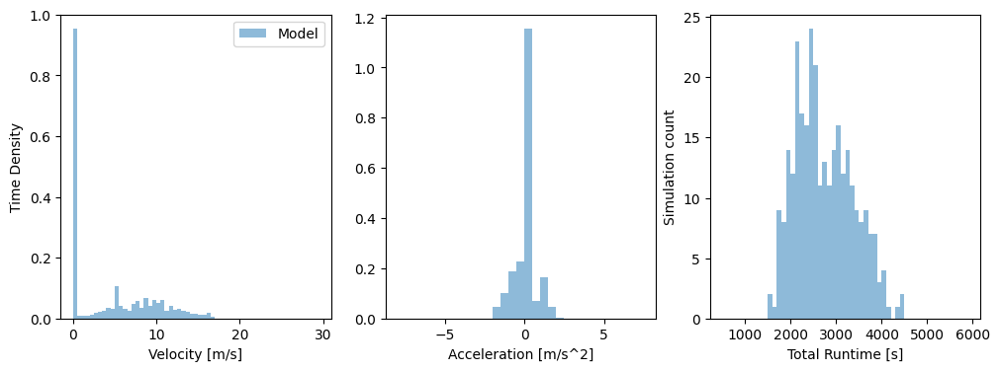

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


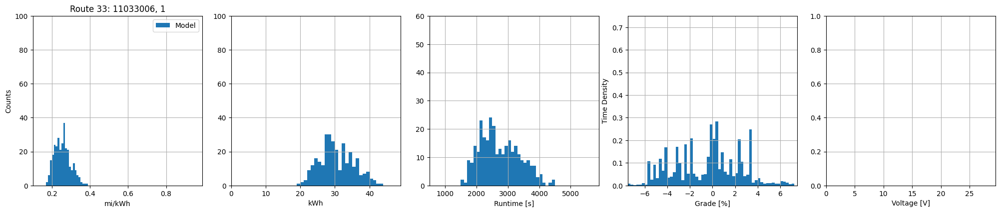

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17629475031052907), np.float64(0.3889175196202759), np.float64(0.25664032558576577), np.float64(0.0414571621048294))
Energy min/max/mean/std [kWh]: 		(np.float64(19.627808503349645), np.float64(43.300203694429534), np.float64(30.514609397441053), np.float64(4.874586064853887))
Time min/max/mean/std [s]: 		(np.float64(1548.1631944545807), np.float64(4446.023050623835), np.float64(2738.0978869544965), np.float64(625.8692357243965))
|Grade| mean/std [%]: 			(np.float64(2.3558370542796925), np.float64(1.7126849188807853))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



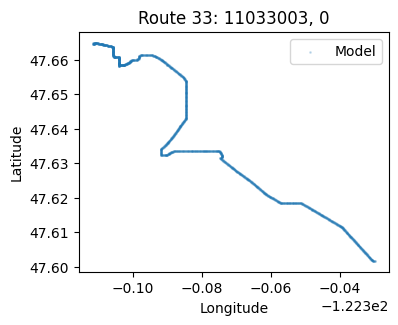

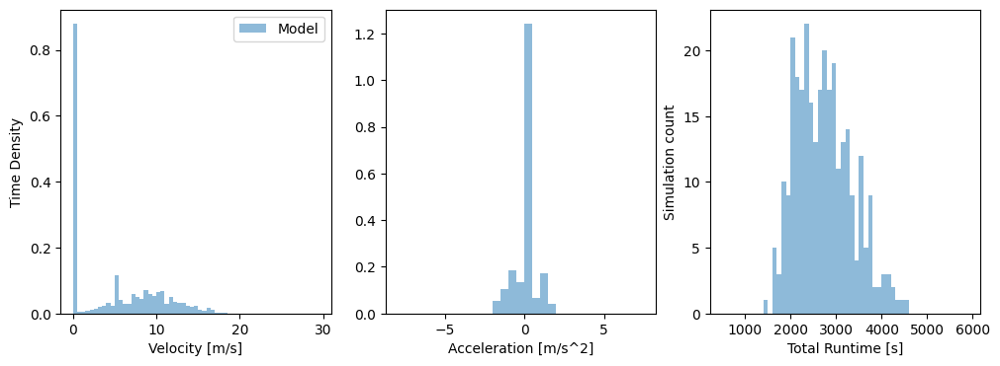

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


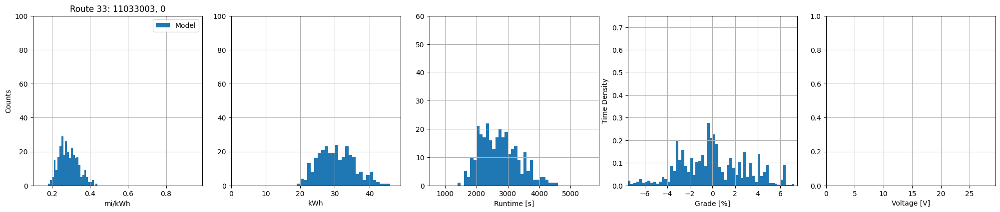

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18622740550173744), np.float64(0.43169297342857416), np.float64(0.2878321408891339), np.float64(0.04942936589164275))
Energy min/max/mean/std [kWh]: 		(np.float64(19.742826255034853), np.float64(45.76576335237728), np.float64(30.4805108269283), np.float64(5.189792212612833))
Time min/max/mean/std [s]: 		(np.float64(1483.1127253447416), np.float64(4579.483487985062), np.float64(2735.2552148683626), np.float64(618.7956780494857))
|Grade| mean/std [%]: 			(np.float64(2.2769527504461666), np.float64(1.754817037555815))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



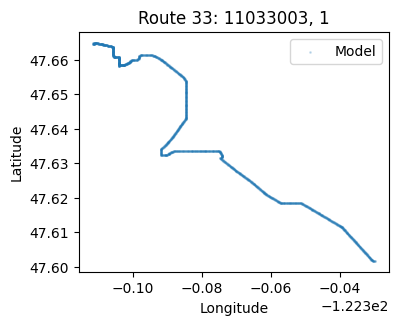

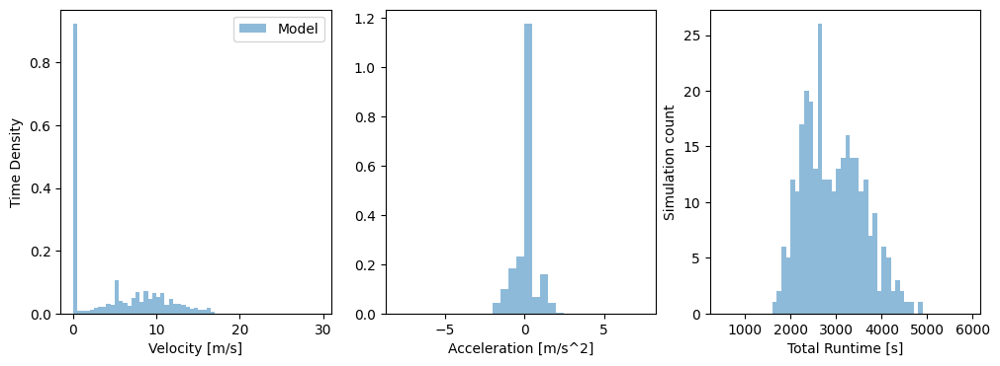

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


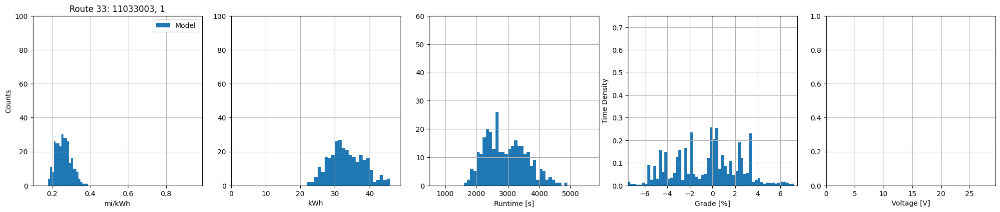

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18703946559402934), np.float64(0.3865063842592995), np.float64(0.2615352126515149), np.float64(0.039364976937627326))
Energy min/max/mean/std [kWh]: 		(np.float64(22.054130465790692), np.float64(45.57360232635162), np.float64(33.32715916420104), np.float64(4.978582608267276))
Time min/max/mean/std [s]: 		(np.float64(1662.8127192163768), np.float64(4844.137462596048), np.float64(2936.9998987806816), np.float64(659.4418932410339))
|Grade| mean/std [%]: 			(np.float64(2.3722418617805716), np.float64(1.7058319808307416))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



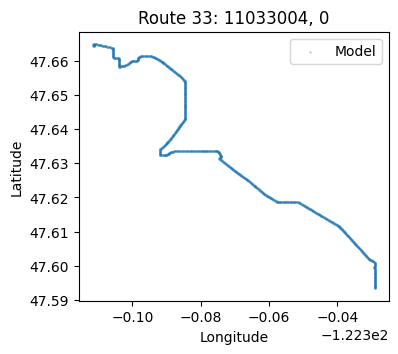

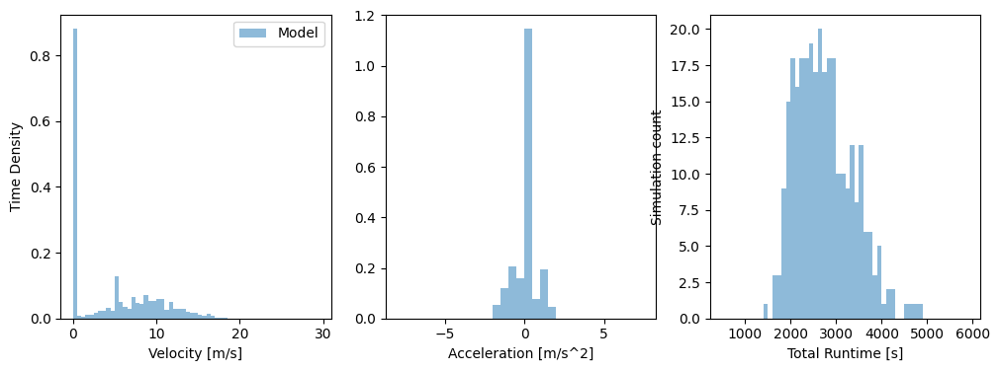

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


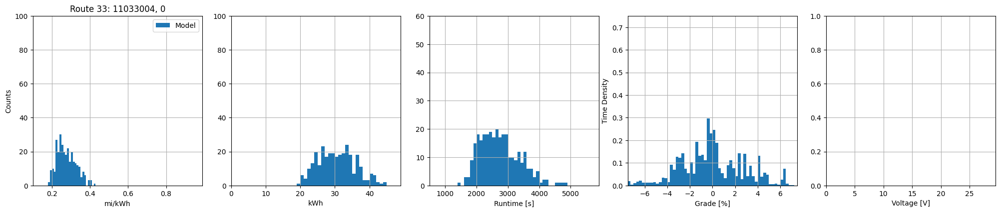

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1830367765476554), np.float64(0.4287942739475046), np.float64(0.2773164998730472), np.float64(0.049605446707157747))
Energy min/max/mean/std [kWh]: 		(np.float64(19.163300011462788), np.float64(44.893236593433926), np.float64(30.566798993037427), np.float64(5.361624279185731))
Time min/max/mean/std [s]: 		(np.float64(1451.7413936826097), np.float64(4869.195156378535), np.float64(2742.360572979906), np.float64(627.1171065837449))
|Grade| mean/std [%]: 			(np.float64(2.117493413166318), np.float64(1.699833301275516))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



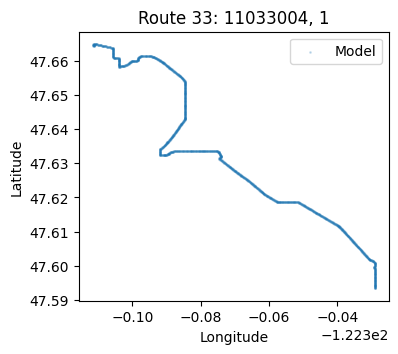

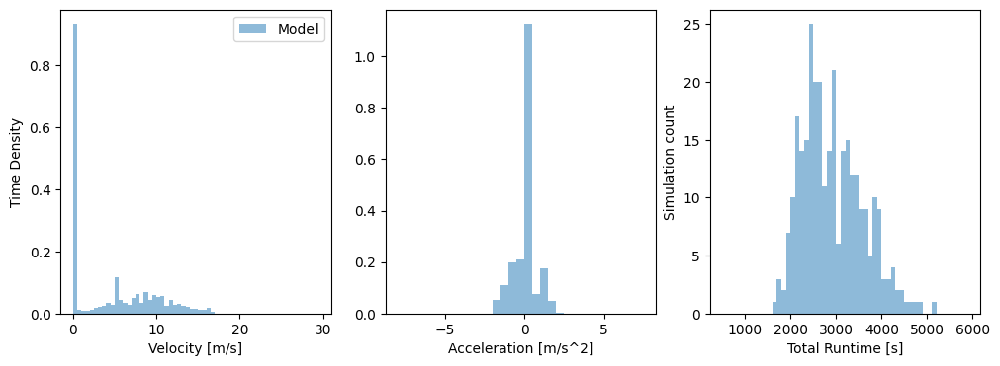

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


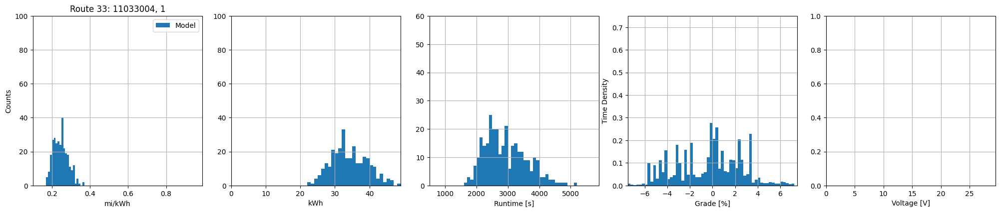

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17065469323926766), np.float64(0.3662466379798208), np.float64(0.24633436018452048), np.float64(0.03813225389842001))
Energy min/max/mean/std [kWh]: 		(np.float64(22.44048684525703), np.float64(48.160133809989155), np.float64(34.15503723628278), np.float64(5.215200040949041))
Time min/max/mean/std [s]: 		(np.float64(1613.955399092478), np.float64(5101.777910083907), np.float64(2927.675994216402), np.float64(669.8019952305029))
|Grade| mean/std [%]: 			(np.float64(2.3041568233075127), np.float64(1.682016742547611))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



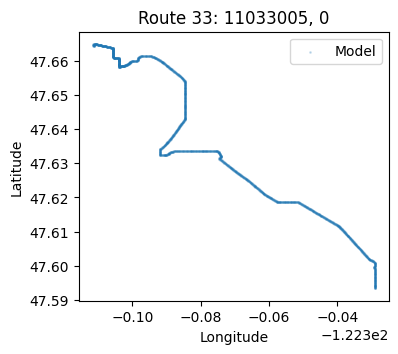

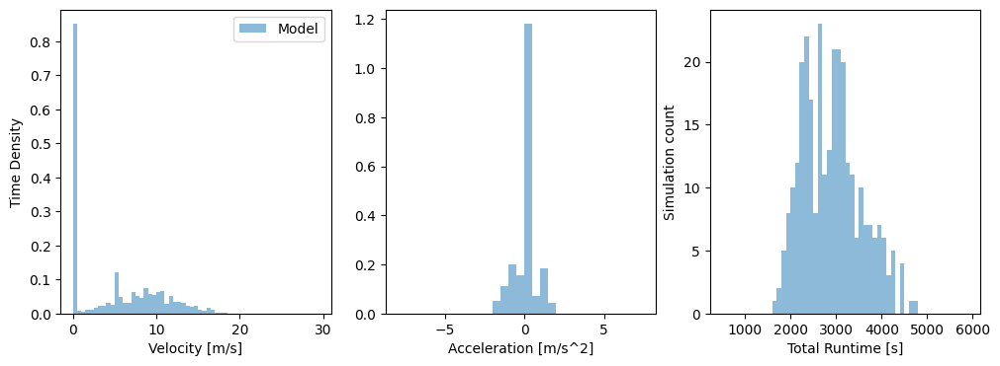

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


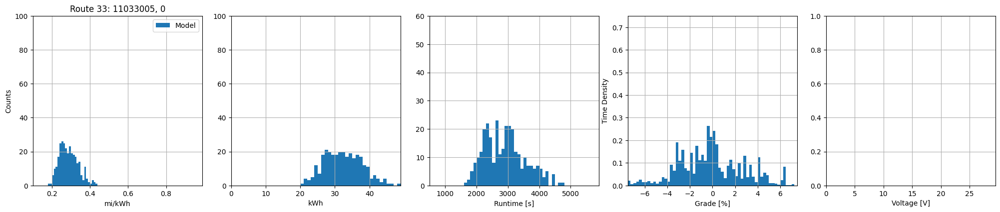

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18815188537698865), np.float64(0.4359894764634398), np.float64(0.28896896089607393), np.float64(0.049027623448315294))
Energy min/max/mean/std [kWh]: 		(np.float64(20.890586621790742), np.float64(48.408103410706616), np.float64(32.409773996609), np.float64(5.3768755762457))
Time min/max/mean/std [s]: 		(np.float64(1610.6156737711851), np.float64(4779.13354896996), np.float64(2904.32219451044), np.float64(642.462457327184))
|Grade| mean/std [%]: 			(np.float64(2.185204458205313), np.float64(1.717939420601742))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



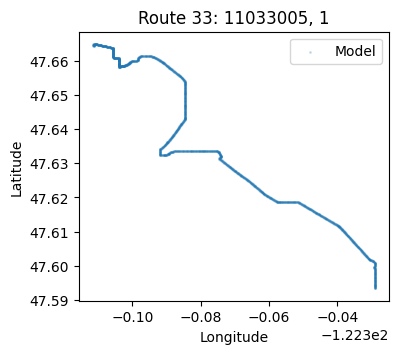

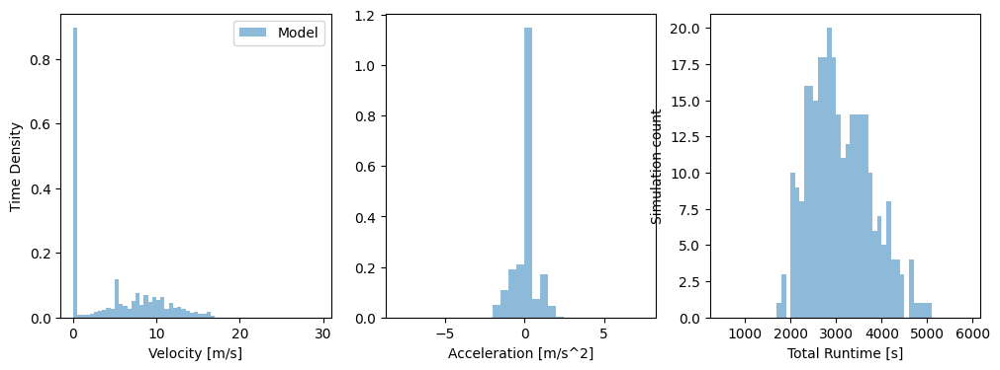

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


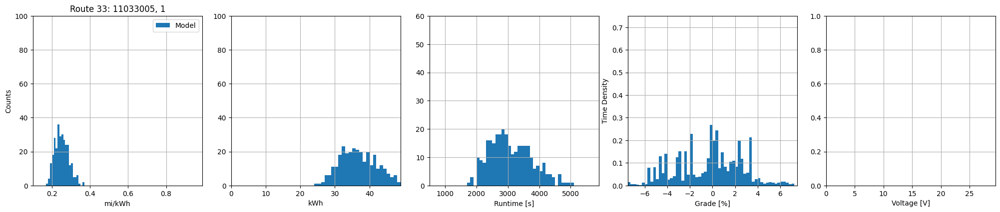

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1761001564874225), np.float64(0.3672447267189999), np.float64(0.2520707519436729), np.float64(0.036543962124083056))
Energy min/max/mean/std [kWh]: 		(np.float64(24.80421317060023), np.float64(51.72747525620457), np.float64(36.89157487553326), np.float64(5.299045939700263))
Time min/max/mean/std [s]: 		(np.float64(1728.1194492989694), np.float64(5002.577112536482), np.float64(3090.7319604563386), np.float64(668.6994279204035))
|Grade| mean/std [%]: 			(np.float64(2.299003964837727), np.float64(1.6748639273759518))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



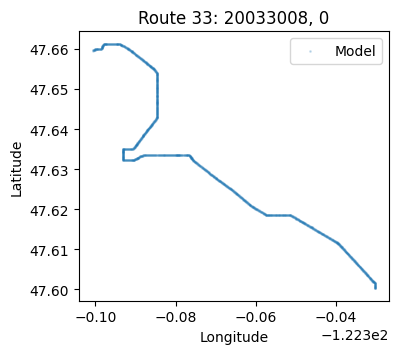

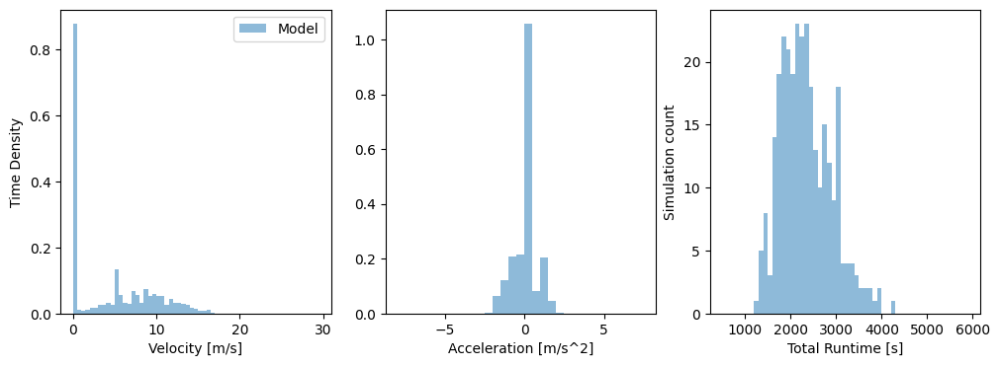

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


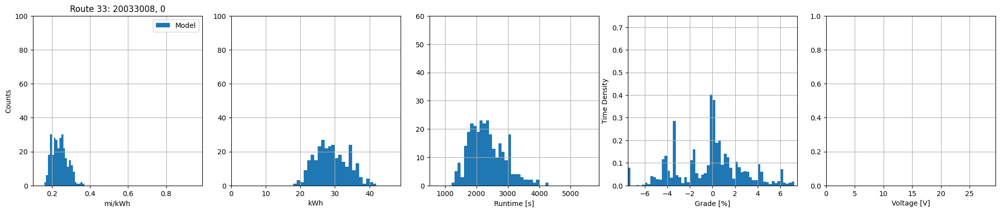

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1632155165765508), np.float64(0.3627838496839955), np.float64(0.24146494705740992), np.float64(0.03975051831091379))
Energy min/max/mean/std [kWh]: 		(np.float64(18.82776732615845), np.float64(41.84902302677045), np.float64(29.048846983314956), np.float64(4.724225373653905))
Time min/max/mean/std [s]: 		(np.float64(1258.7838972198738), np.float64(4280.330400303734), np.float64(2341.2488925574503), np.float64(559.265954610229))
|Grade| mean/std [%]: 			(np.float64(2.10777872227144), np.float64(1.7881807431662304))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



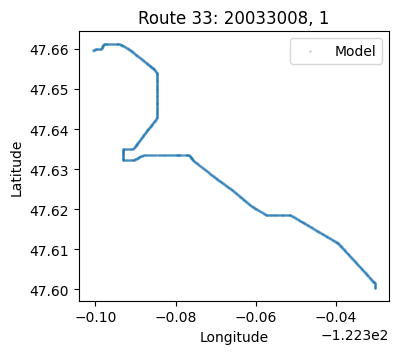

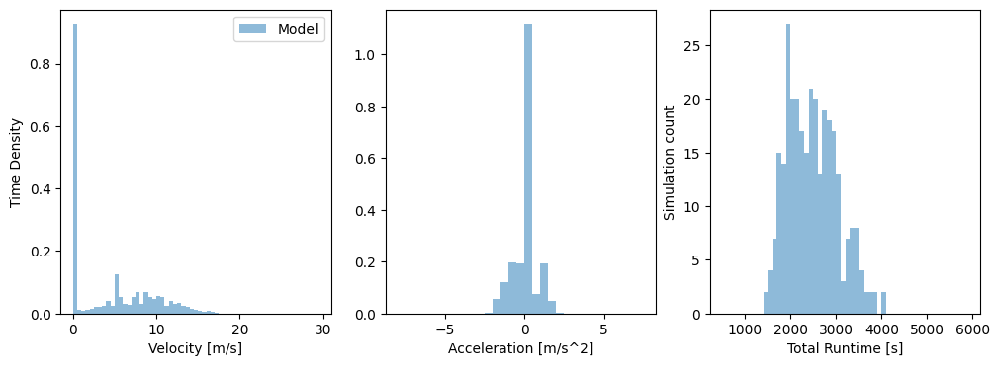

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


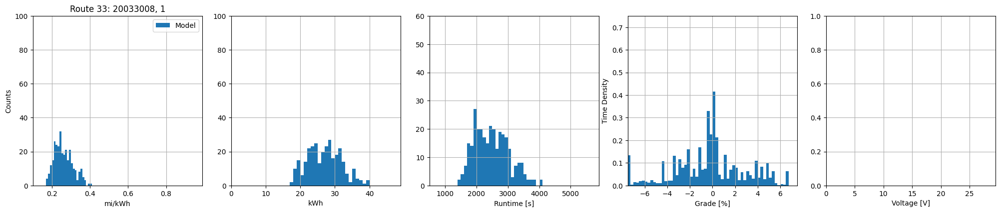

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1710549417768863), np.float64(0.40052526815598993), np.float64(0.26183306160444497), np.float64(0.04835096178858707))
Energy min/max/mean/std [kWh]: 		(np.float64(17.055525579862607), np.float64(39.935525308154965), np.float64(26.96010280055899), np.float64(4.83486417179424))
Time min/max/mean/std [s]: 		(np.float64(1401.9055512746263), np.float64(4074.168211375688), np.float64(2480.7977184693054), np.float64(547.0677579670473))
|Grade| mean/std [%]: 			(np.float64(2.1190037383579745), np.float64(1.8354418227544445))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------345-------------------


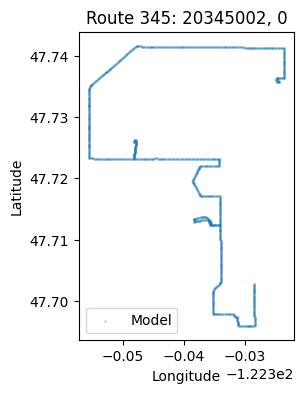

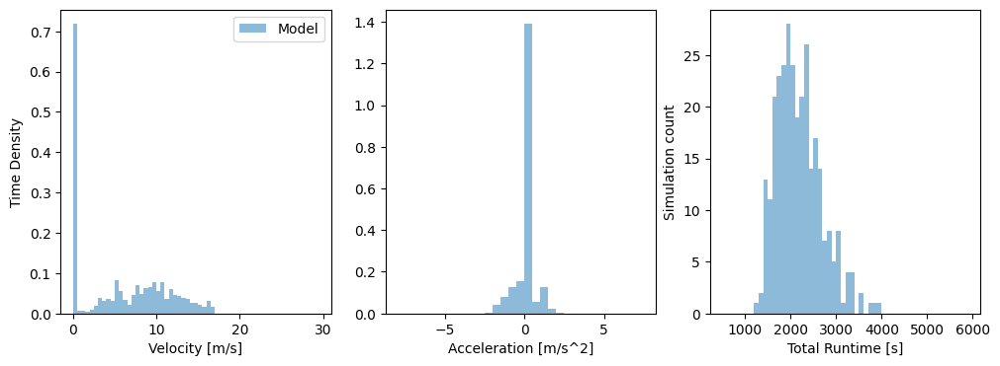

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


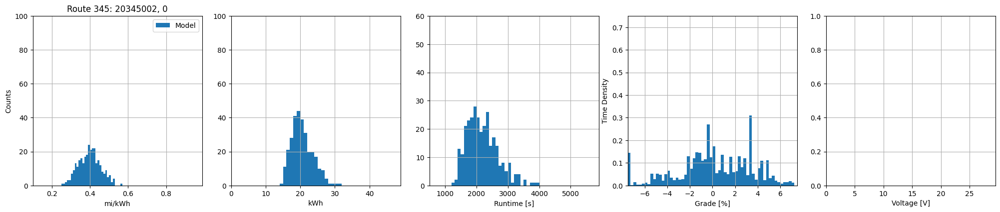

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2544425440346594), np.float64(0.5635100787899586), np.float64(0.39848621004030177), np.float64(0.056882875233066274))
Energy min/max/mean/std [kWh]: 		(np.float64(14.227435972224699), np.float64(31.509288653376053), np.float64(20.546399570547507), np.float64(3.0545370486672336))
Time min/max/mean/std [s]: 		(np.float64(1220.375745972527), np.float64(3904.7793469886424), np.float64(2186.2883604626822), np.float64(495.7024432945263))
|Grade| mean/std [%]: 			(np.float64(2.400183000660196), np.float64(1.7246078782194763))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



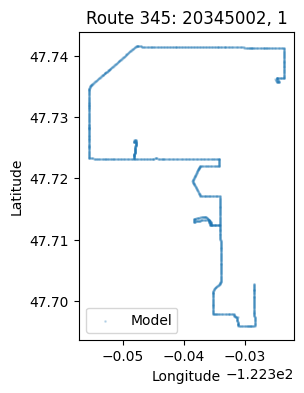

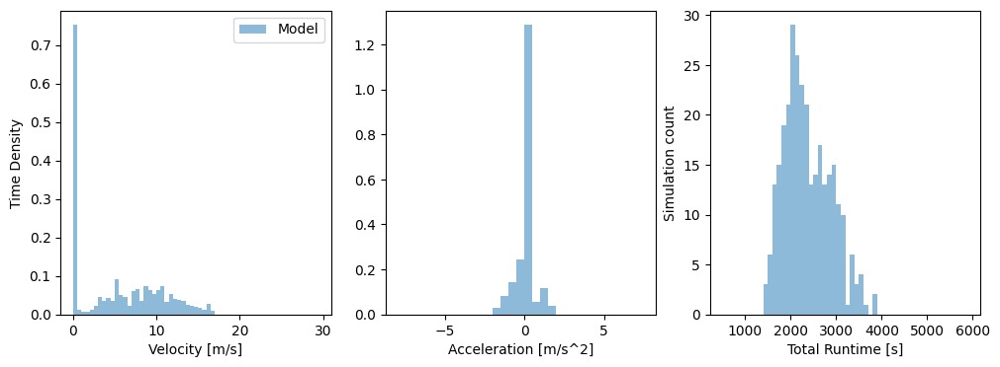

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


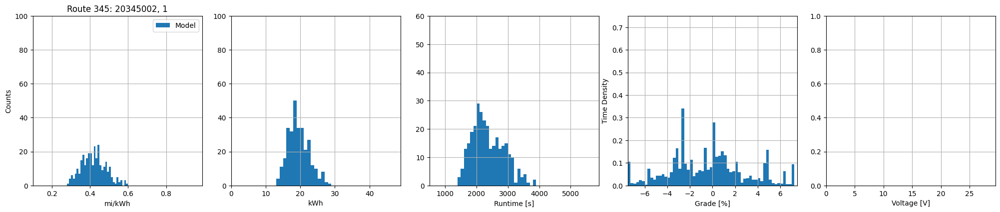

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.28331885868899803), np.float64(0.59769144294175), np.float64(0.4198900761190983), np.float64(0.06355829018471121))
Energy min/max/mean/std [kWh]: 		(np.float64(13.414286320446141), np.float64(28.298872104741314), np.float64(19.53994961518246), np.float64(3.0076455087687823))
Time min/max/mean/std [s]: 		(np.float64(1400.8415562785874), np.float64(3890.9512163697304), np.float64(2369.0171916107824), np.float64(509.5400984255203))
|Grade| mean/std [%]: 			(np.float64(2.576617288257753), np.float64(1.8980104656537908))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



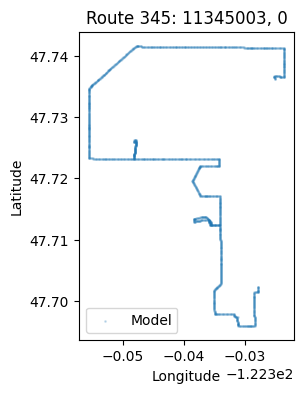

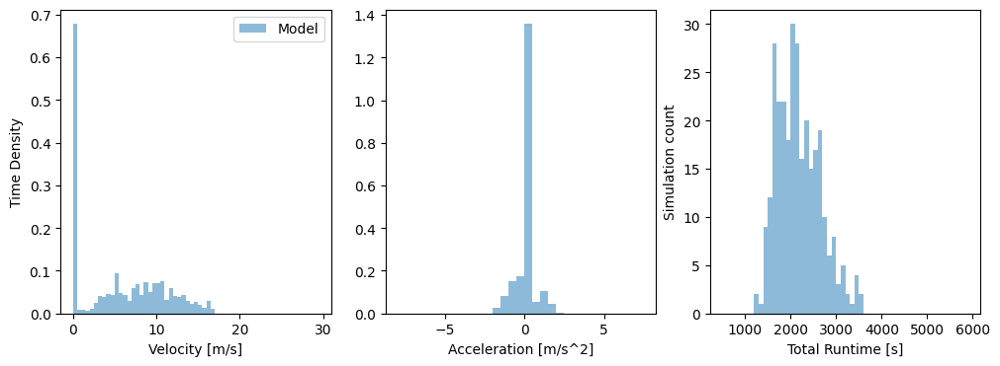

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


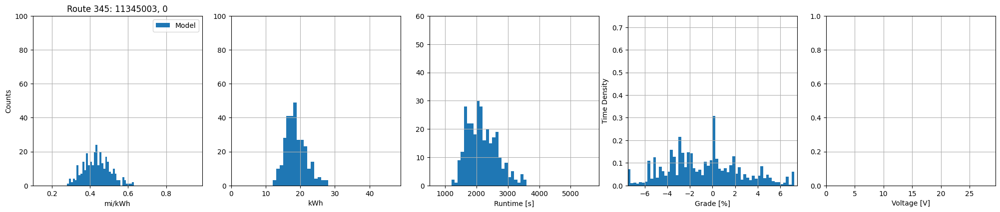

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2870898380129534), np.float64(0.6280274382909836), np.float64(0.43702048314030323), np.float64(0.06824496642064498))
Energy min/max/mean/std [kWh]: 		(np.float64(12.680882799774258), np.float64(27.740244639558068), np.float64(18.6798432792704), np.float64(2.9954333697419893))
Time min/max/mean/std [s]: 		(np.float64(1260.3260948113107), np.float64(3549.180121615596), np.float64(2182.3339775767367), np.float64(473.04082113557286))
|Grade| mean/std [%]: 			(np.float64(2.670977057536311), np.float64(1.8629869538945338))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



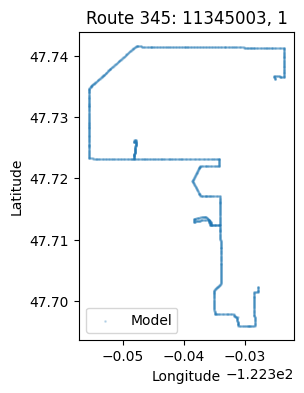

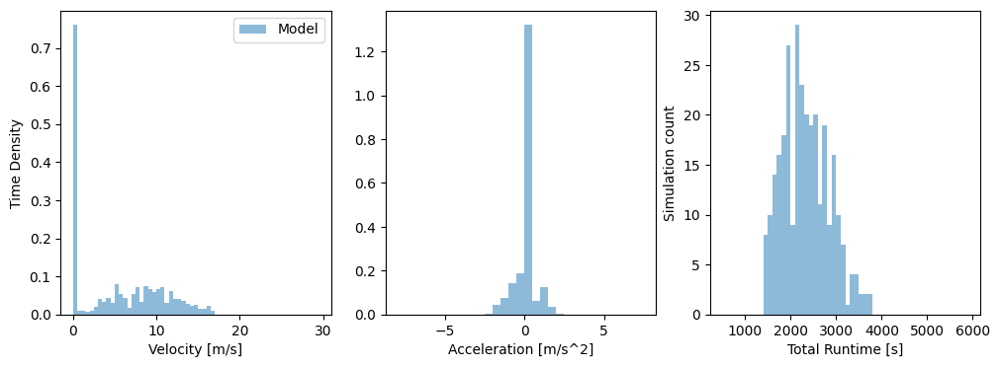

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


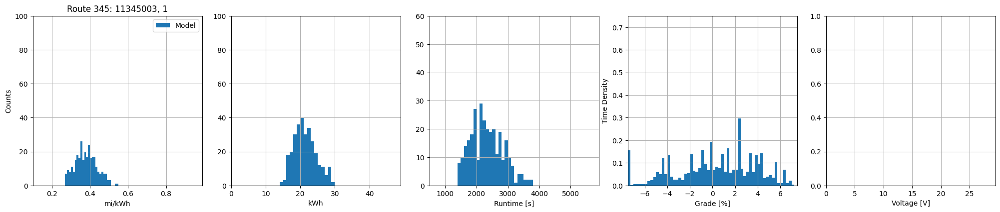

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2712217269253139), np.float64(0.5402411188330225), np.float64(0.38073725823879007), np.float64(0.05616300582051669))
Energy min/max/mean/std [kWh]: 		(np.float64(14.742497019220945), np.float64(29.365284169323203), np.float64(21.381020263157385), np.float64(3.1953180400942736))
Time min/max/mean/std [s]: 		(np.float64(1408.406688924149), np.float64(3754.8529314436832), np.float64(2333.1107122021613), np.float64(512.3151625335065))
|Grade| mean/std [%]: 			(np.float64(2.689535080092882), np.float64(1.7565752847247667))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------346-------------------


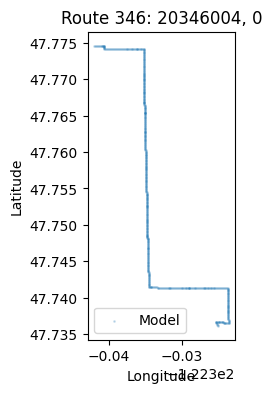

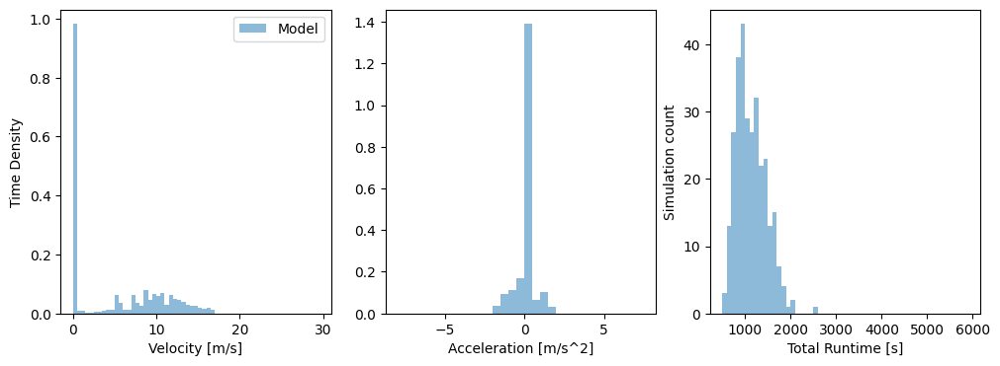

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


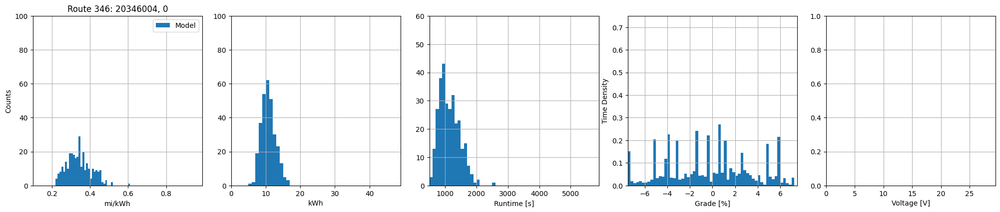

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22108687587088777), np.float64(0.6045925494935175), np.float64(0.34314621663287814), np.float64(0.06422616927034429))
Energy min/max/mean/std [kWh]: 		(np.float64(5.900176602288498), np.float64(16.134846541152488), np.float64(10.758339814611203), np.float64(1.9993261072227833))
Time min/max/mean/std [s]: 		(np.float64(516.2649604268042), np.float64(2575.5680908571535), np.float64(1139.2692490495483), np.float64(325.2900112528666))
|Grade| mean/std [%]: 			(np.float64(2.9539683958890035), np.float64(1.9206770571879164))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



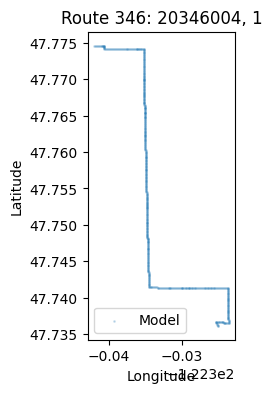

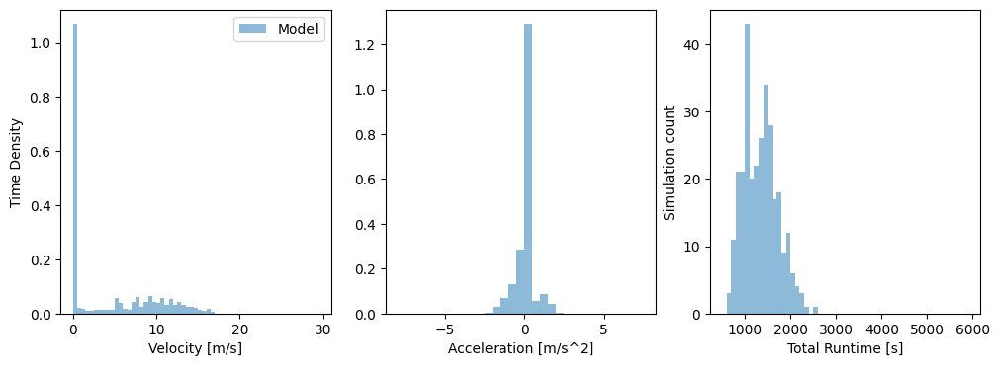

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


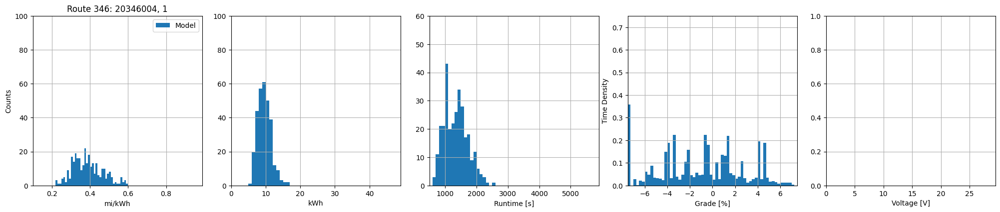

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22162131355371315), np.float64(0.5988225246036271), np.float64(0.38744483862810236), np.float64(0.07816318431473904))
Energy min/max/mean/std [kWh]: 		(np.float64(5.959313371090882), np.float64(16.102111392440143), np.float64(9.587379415896136), np.float64(1.936899921754387))
Time min/max/mean/std [s]: 		(np.float64(614.7238061554355), np.float64(2587.4597518263504), np.float64(1346.4309324914357), np.float64(375.41449766535453))
|Grade| mean/std [%]: 			(np.float64(2.768890801715177), np.float64(1.7716698226975653))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



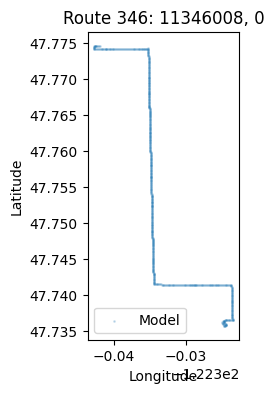

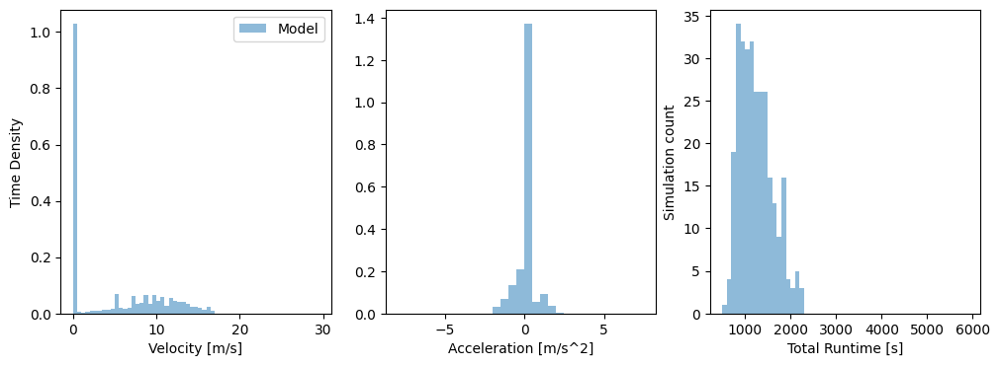

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


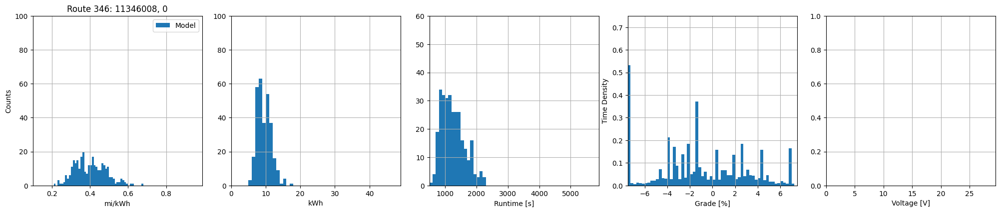

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21090326600981638), np.float64(0.6725801659274049), np.float64(0.4020155438905587), np.float64(0.0816437398941692))
Energy min/max/mean/std [kWh]: 		(np.float64(5.460857502144913), np.float64(17.414924455117678), np.float64(9.524397084186509), np.float64(1.9868217129233525))
Time min/max/mean/std [s]: 		(np.float64(593.0198729956508), np.float64(2294.4360101152215), np.float64(1249.6312929677897), np.float64(367.1172289556205))
|Grade| mean/std [%]: 			(np.float64(2.845907584883069), np.float64(1.748200614318129))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



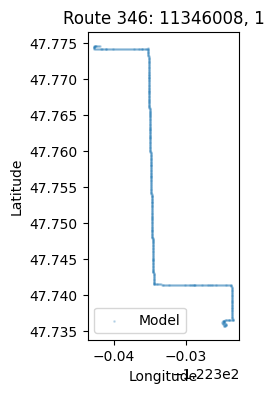

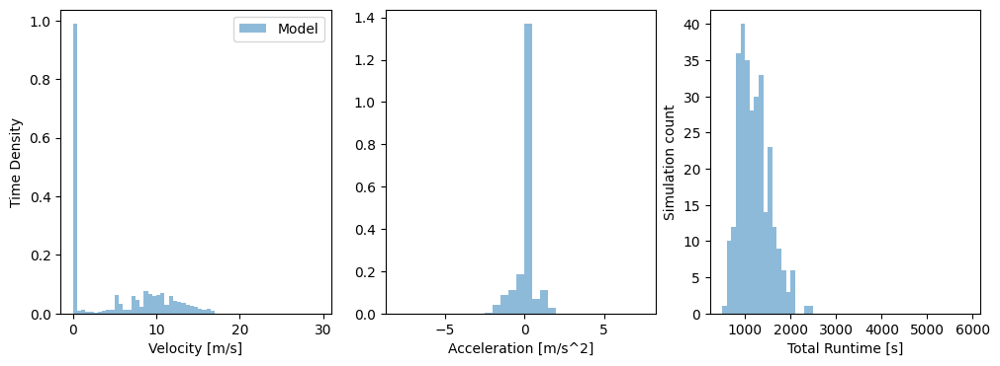

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


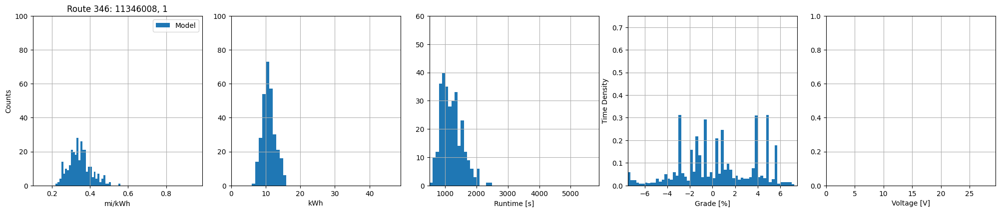

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22978435797974153), np.float64(0.5595443841508305), np.float64(0.34720417862221803), np.float64(0.05828110134673222))
Energy min/max/mean/std [kWh]: 		(np.float64(6.563269442344786), np.float64(15.982117279090646), np.float64(10.87188310652453), np.float64(1.8045692010710326))
Time min/max/mean/std [s]: 		(np.float64(570.8327694939629), np.float64(2483.26949803399), np.float64(1204.331203846507), np.float64(341.3630742211988))
|Grade| mean/std [%]: 			(np.float64(2.683503000728731), np.float64(1.8182450655336195))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------348-------------------


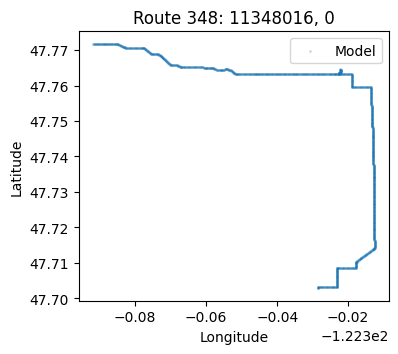

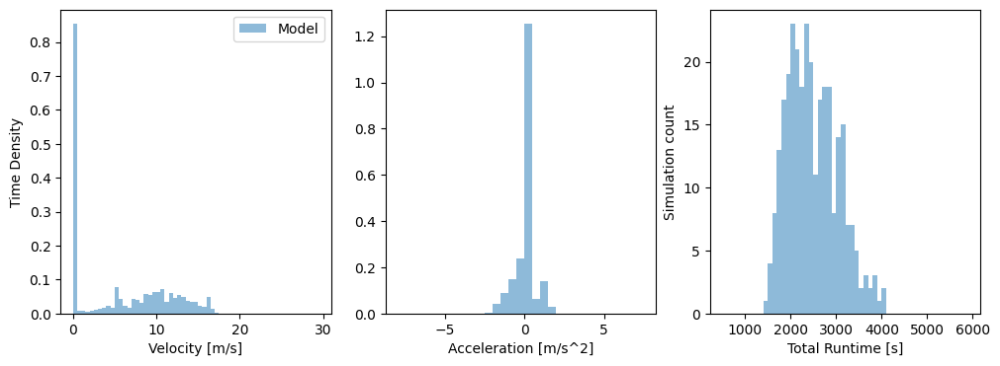

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


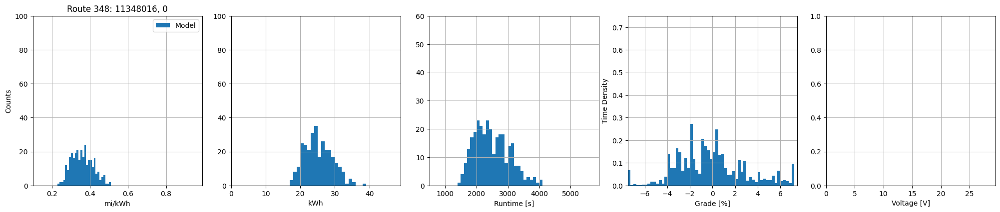

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2319506219241109), np.float64(0.5095845334435484), np.float64(0.35992341451225135), np.float64(0.05615781845958446))
Energy min/max/mean/std [kWh]: 		(np.float64(17.450765674113182), np.float64(38.33850588762434), np.float64(25.31663604705345), np.float64(3.987700693039113))
Time min/max/mean/std [s]: 		(np.float64(1480.316313194938), np.float64(4086.1923042045496), np.float64(2493.7958107174863), np.float64(549.139905822974))
|Grade| mean/std [%]: 			(np.float64(2.2574826845019293), np.float64(1.7694860631657692))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



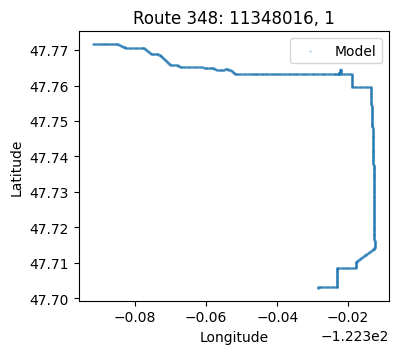

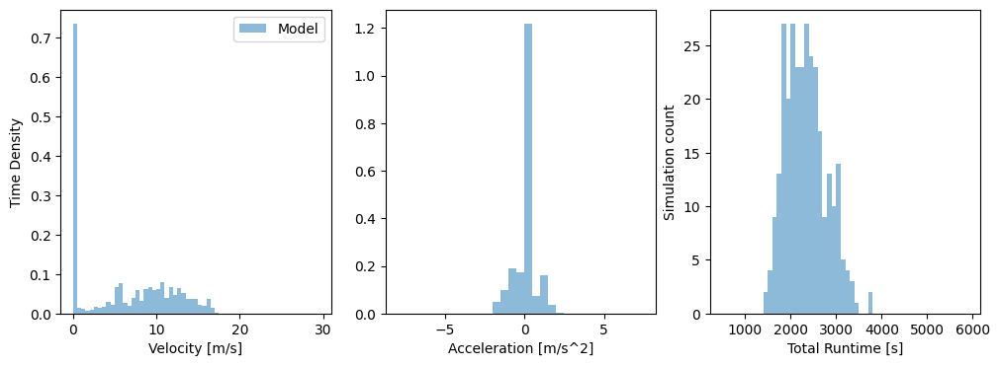

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


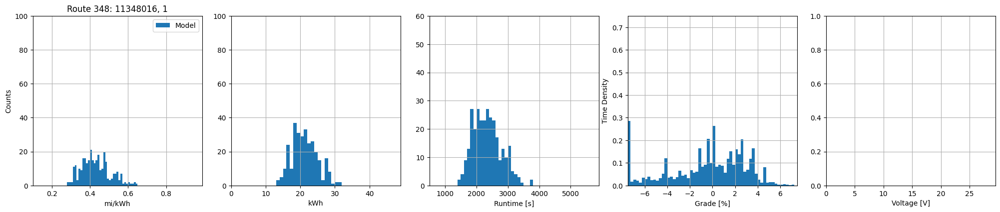

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.28200316781116386), np.float64(0.6430675067857685), np.float64(0.43007872816703646), np.float64(0.07447482213531599))
Energy min/max/mean/std [kWh]: 		(np.float64(13.82782417369101), np.float64(31.532356479065882), np.float64(21.29031305310424), np.float64(3.6410896200180725))
Time min/max/mean/std [s]: 		(np.float64(1434.530709972279), np.float64(3747.4920593756656), np.float64(2337.659587770861), np.float64(442.6235003622157))
|Grade| mean/std [%]: 			(np.float64(2.3197999633476805), np.float64(1.701548284935854))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



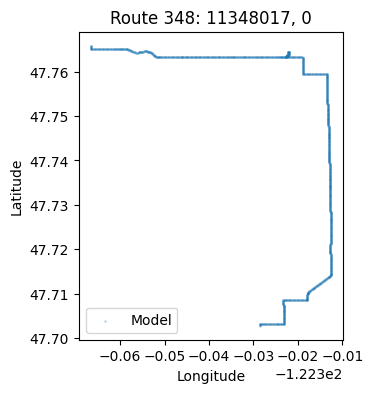

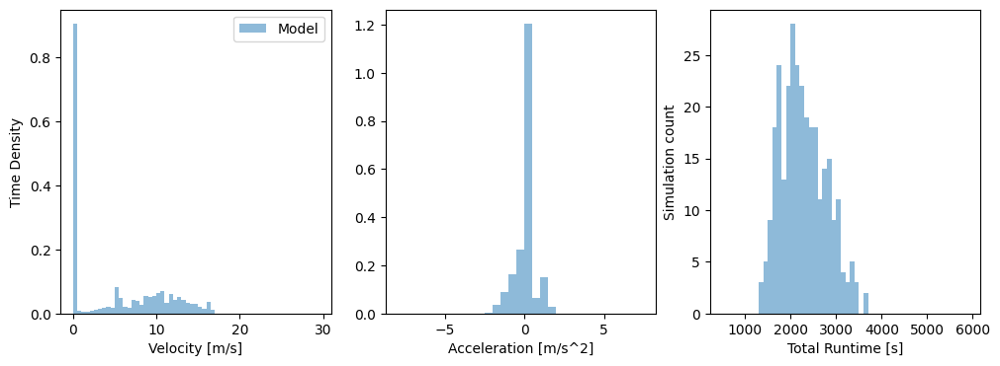

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


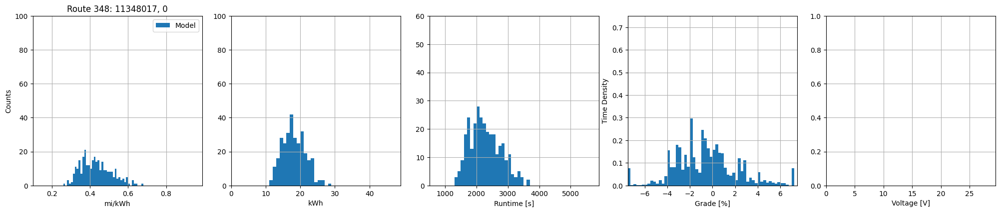

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2613967473530311), np.float64(0.6764453968327623), np.float64(0.431510179197494), np.float64(0.07963701788166842))
Energy min/max/mean/std [kWh]: 		(np.float64(11.195312812955319), np.float64(28.971354445350766), np.float64(18.140757727257686), np.float64(3.2879464157976432))
Time min/max/mean/std [s]: 		(np.float64(1369.8248179825673), np.float64(3675.6714883321947), np.float64(2280.785620354519), np.float64(495.2352192664069))
|Grade| mean/std [%]: 			(np.float64(2.093234699800488), np.float64(1.5929599283573503))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



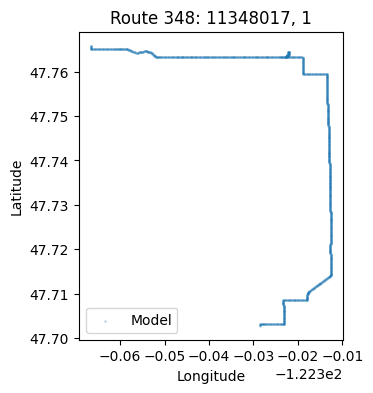

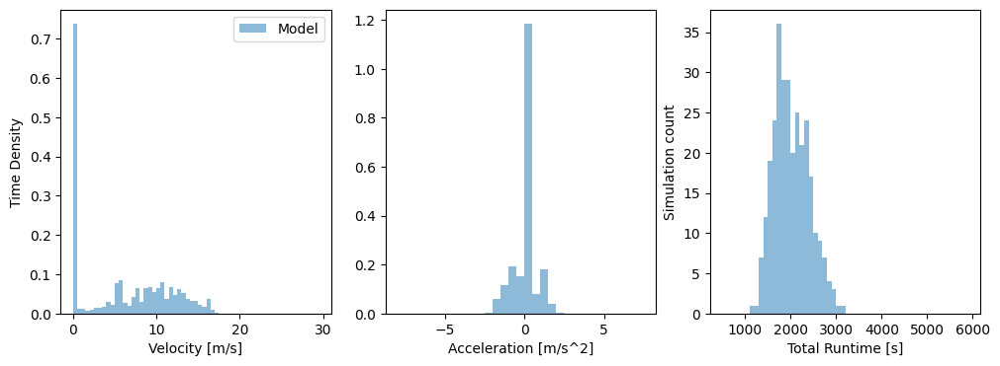

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


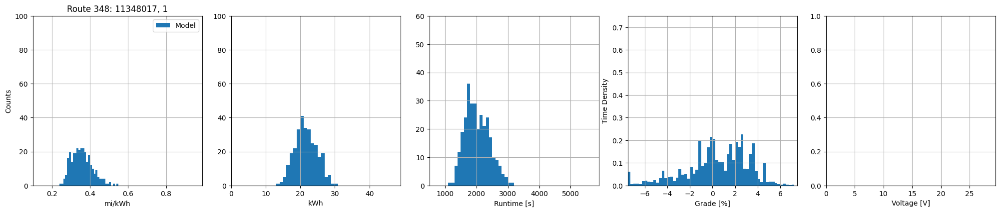

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2460500104724442), np.float64(0.5472559610746953), np.float64(0.3578045631759498), np.float64(0.05416463306962674))
Energy min/max/mean/std [kWh]: 		(np.float64(13.837322503041941), np.float64(30.776496251971484), np.float64(21.636598003706833), np.float64(3.188478332768169))
Time min/max/mean/std [s]: 		(np.float64(1184.8169744263118), np.float64(3180.93844887714), np.float64(2021.2282715829838), np.float64(384.55868854322745))
|Grade| mean/std [%]: 			(np.float64(2.1494800501487767), np.float64(1.553240624283409))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



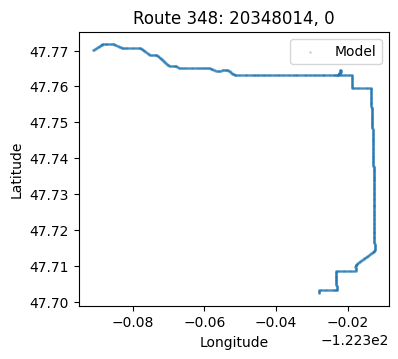

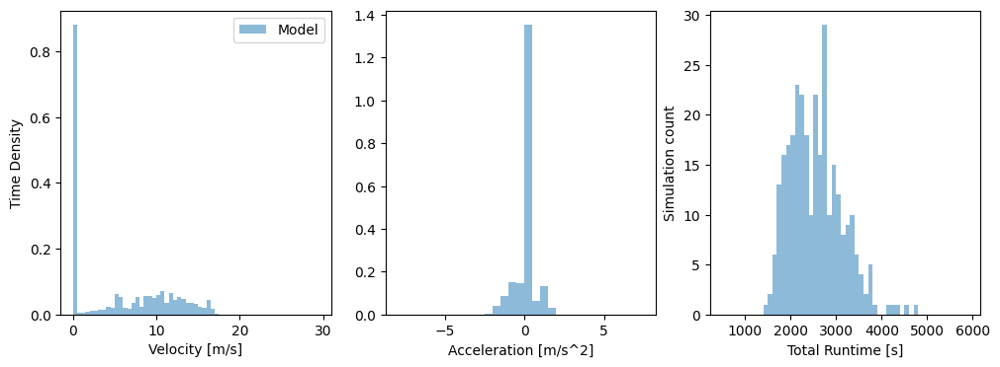

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


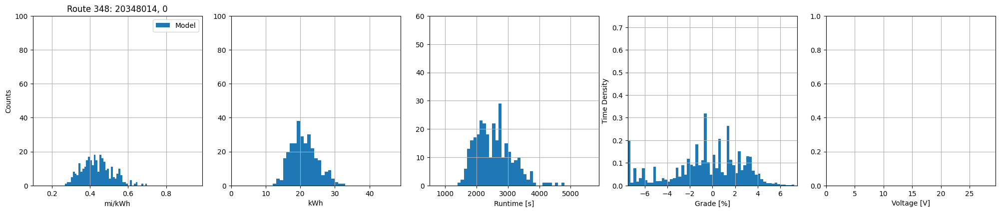

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2756275793410906), np.float64(0.6903130223546996), np.float64(0.43673120447503133), np.float64(0.07857529718443526))
Energy min/max/mean/std [kWh]: 		(np.float64(12.898493487611708), np.float64(32.30445242287204), np.float64(21.049469290844936), np.float64(3.784806046073192))
Time min/max/mean/std [s]: 		(np.float64(1483.6207687370984), np.float64(4799.6944672214795), np.float64(2549.0798333299153), np.float64(578.861987317691))
|Grade| mean/std [%]: 			(np.float64(2.285799240419014), np.float64(1.7321310283564921))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



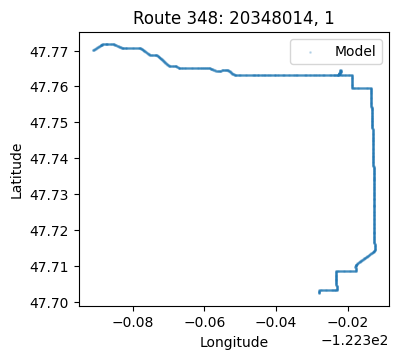

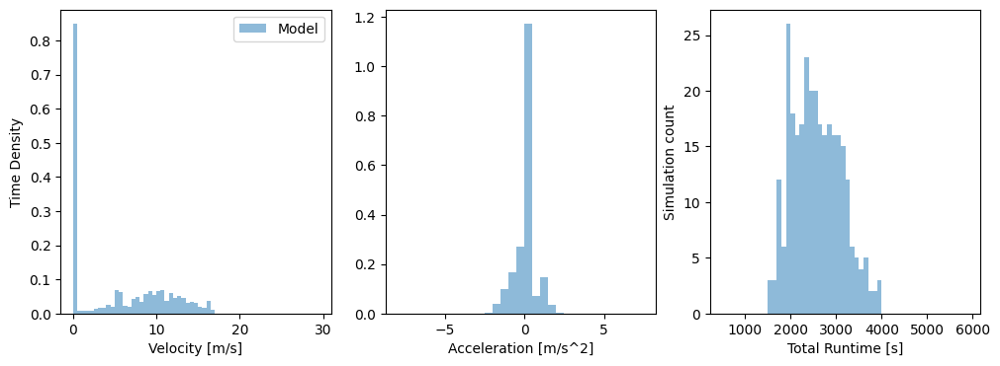

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


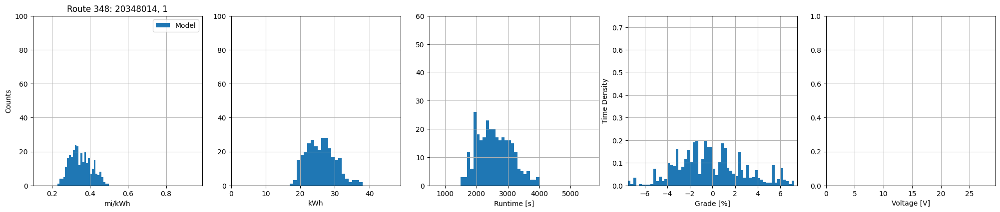

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.23869045002439268), np.float64(0.4977667313490059), np.float64(0.35180859374528856), np.float64(0.05557728245361248))
Energy min/max/mean/std [kWh]: 		(np.float64(17.887128705349905), np.float64(37.301943114905114), np.float64(25.944491803108235), np.float64(4.108564179134213))
Time min/max/mean/std [s]: 		(np.float64(1504.4323376669452), np.float64(3929.5937428903476), np.float64(2576.2300099685585), np.float64(534.2021916910787))
|Grade| mean/std [%]: 			(np.float64(2.3474505986235465), np.float64(1.7157984869182052))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



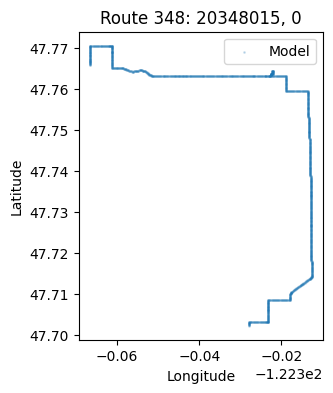

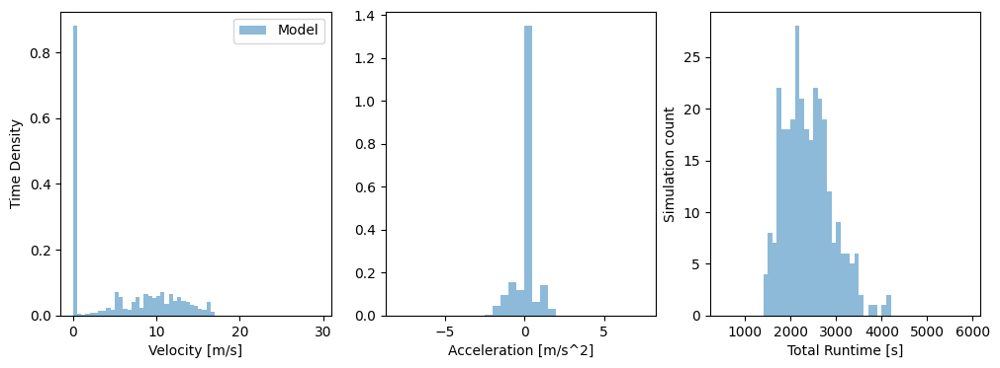

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


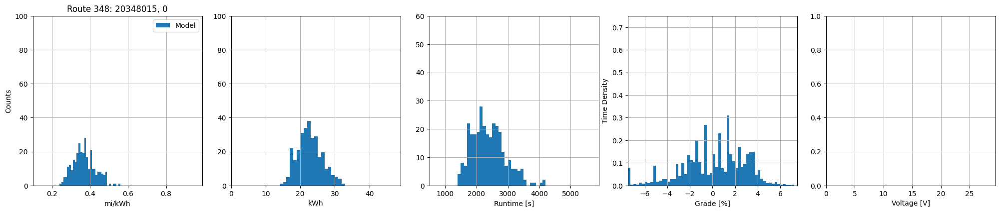

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.24991310905429567), np.float64(0.554272482184106), np.float64(0.37004375945514234), np.float64(0.057550213124674024))
Energy min/max/mean/std [kWh]: 		(np.float64(14.856578600898898), np.float64(32.94982295664399), np.float64(22.792617198522098), np.float64(3.549167079715785))
Time min/max/mean/std [s]: 		(np.float64(1411.9866628020309), np.float64(4130.199438015302), np.float64(2388.8534002043557), np.float64(527.6215557719299))
|Grade| mean/std [%]: 			(np.float64(2.14645048793626), np.float64(1.4335187447236686))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



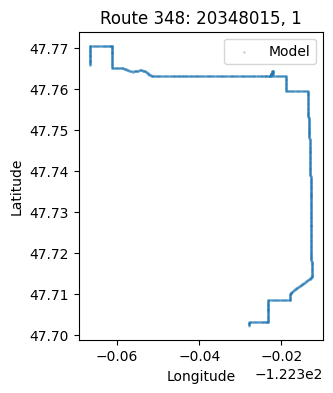

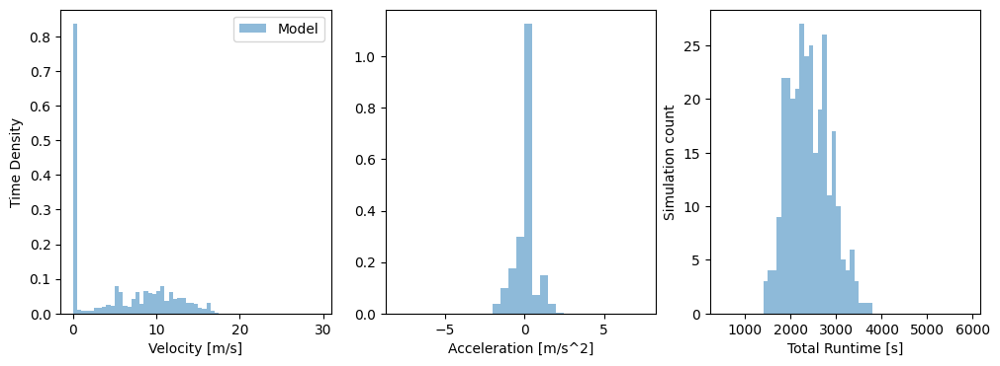

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


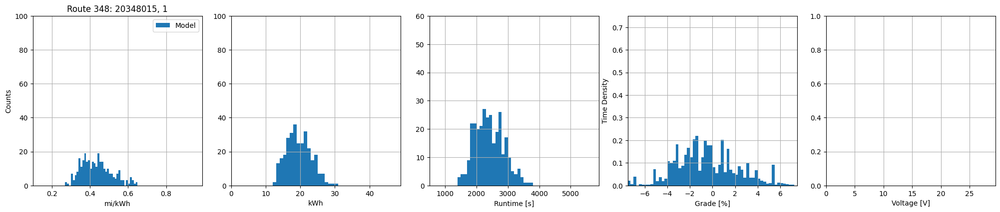

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2744380509511796), np.float64(0.6481044940840512), np.float64(0.4346939782037689), np.float64(0.07963586189418886))
Energy min/max/mean/std [kWh]: 		(np.float64(12.705143956719425), np.float64(30.004078763113988), np.float64(19.568423146078192), np.float64(3.50753318261579))
Time min/max/mean/std [s]: 		(np.float64(1450.3009073650167), np.float64(3785.9220756252075), np.float64(2411.283311562681), np.float64(456.78617016906094))
|Grade| mean/std [%]: 			(np.float64(2.19928650012223), np.float64(1.5591255392032208))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------36-------------------


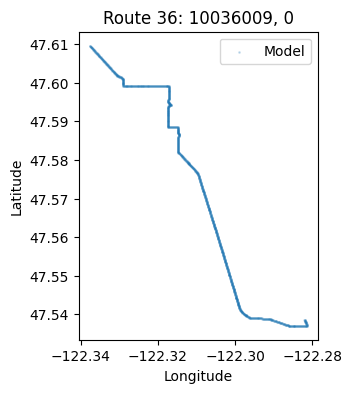

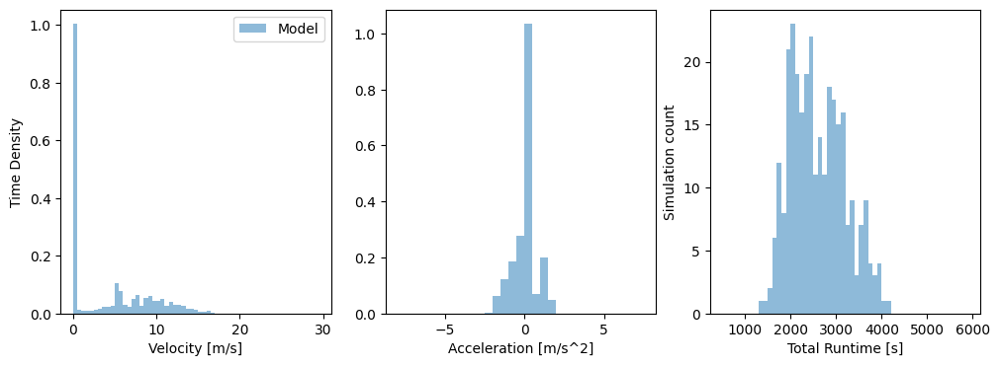

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


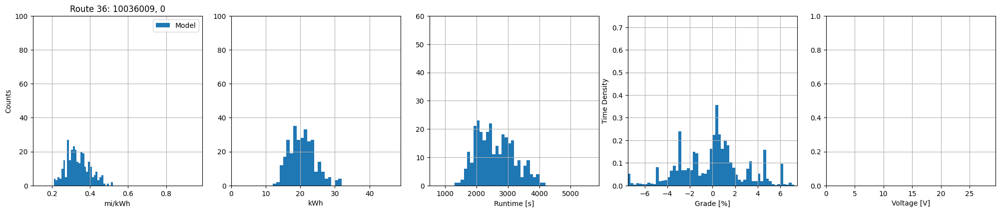

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21107810910533406), np.float64(0.5188489804313526), np.float64(0.3372025620991601), np.float64(0.06072429277956086))
Energy min/max/mean/std [kWh]: 		(np.float64(12.947483248535818), np.float64(31.826078559868353), np.float64(20.573991433967887), np.float64(3.7290433503976237))
Time min/max/mean/std [s]: 		(np.float64(1386.1170244968391), np.float64(4104.170717599804), np.float64(2598.0928963325096), np.float64(594.1308895816252))
|Grade| mean/std [%]: 			(np.float64(2.103678422424312), np.float64(1.6987491097385148))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



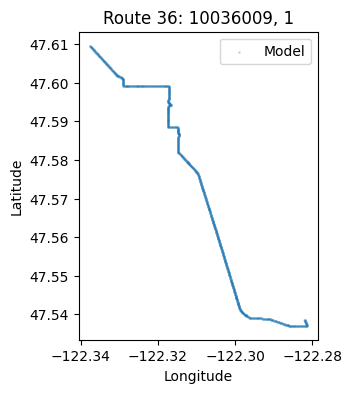

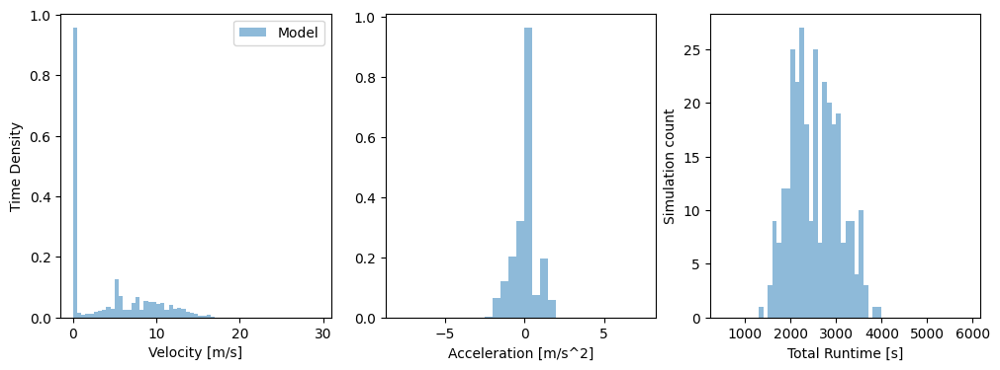

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


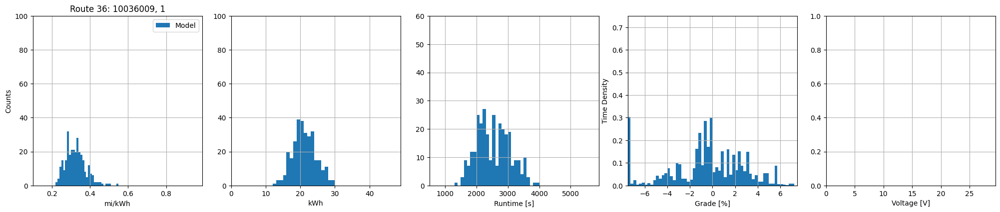

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22971752731758555), np.float64(0.5419213147161451), np.float64(0.3252706811072894), np.float64(0.053149857630218025))
Energy min/max/mean/std [kWh]: 		(np.float64(12.397539727360769), np.float64(29.246749722360725), np.float64(21.18280222213317), np.float64(3.3178050238627166))
Time min/max/mean/std [s]: 		(np.float64(1381.6238771980175), np.float64(3974.452883668975), np.float64(2546.4807026902563), np.float64(523.4569658160632))
|Grade| mean/std [%]: 			(np.float64(2.1094161498987773), np.float64(1.670642760282781))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



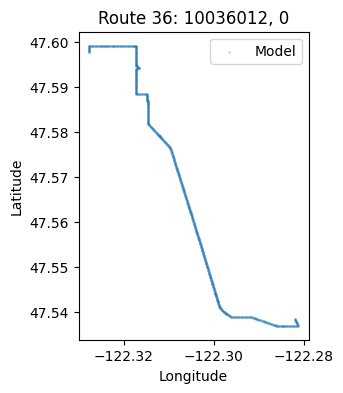

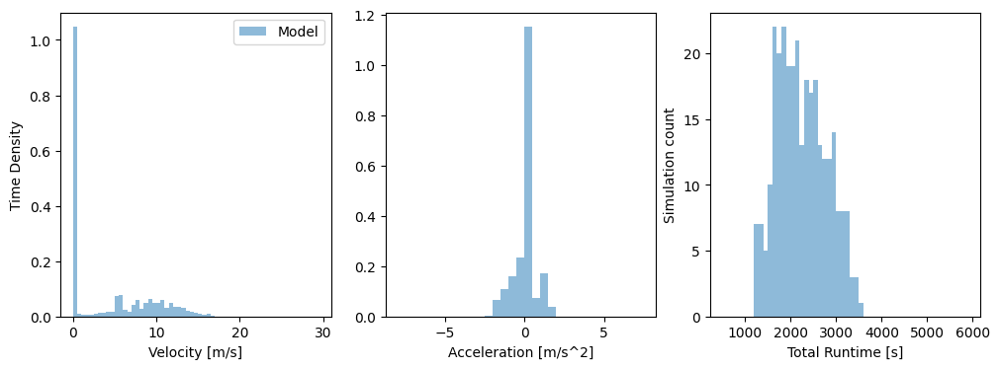

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


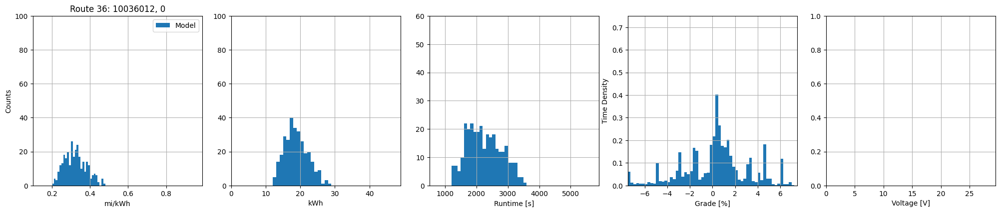

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20875335871665324), np.float64(0.47298465612199964), np.float64(0.3235980629433753), np.float64(0.056779514967538726))
Energy min/max/mean/std [kWh]: 		(np.float64(12.492933668563555), np.float64(28.30596820816133), np.float64(18.827392871673062), np.float64(3.31329242744829))
Time min/max/mean/std [s]: 		(np.float64(1207.3317942625483), np.float64(3514.8613092943638), np.float64(2253.3915457838725), np.float64(540.7878262081134))
|Grade| mean/std [%]: 			(np.float64(2.0898897482038596), np.float64(1.77081311394815))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



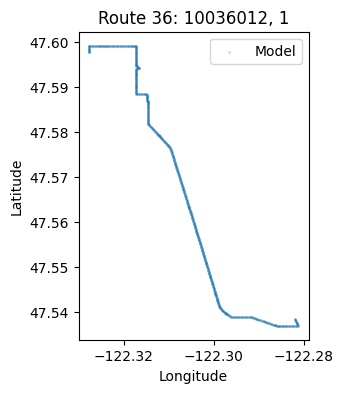

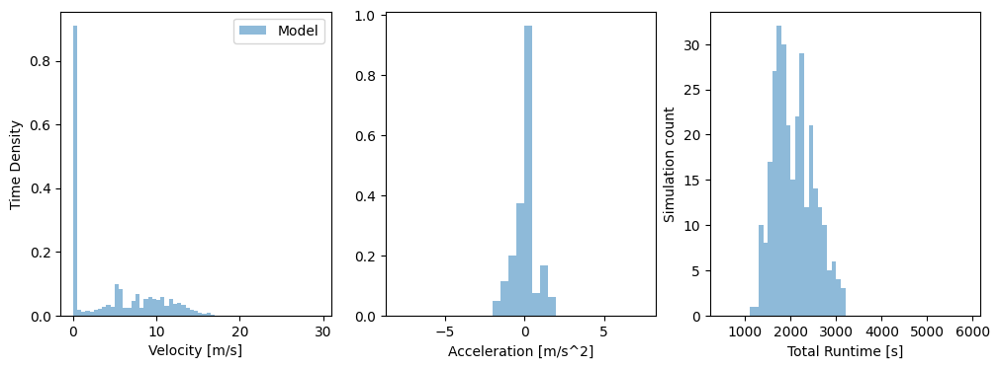

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


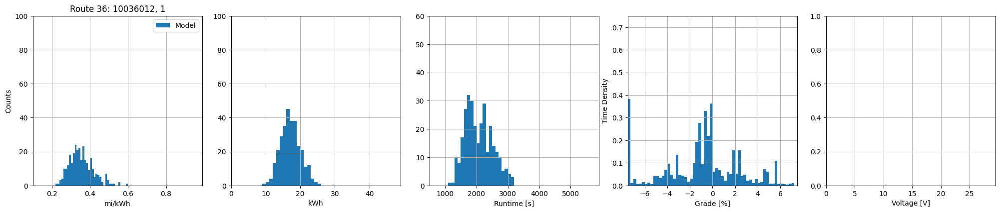

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2295218855516389), np.float64(0.5964822641751688), np.float64(0.35453468916613456), np.float64(0.06228525896839515))
Energy min/max/mean/std [kWh]: 		(np.float64(9.907211071279825), np.float64(25.74689414586893), np.float64(17.160845646749536), np.float64(2.889665497960298))
Time min/max/mean/std [s]: 		(np.float64(1188.5056093342664), np.float64(3140.2118051452107), np.float64(2074.5970881870676), np.float64(430.9746296958043))
|Grade| mean/std [%]: 			(np.float64(2.105781346777331), np.float64(1.785436216297447))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



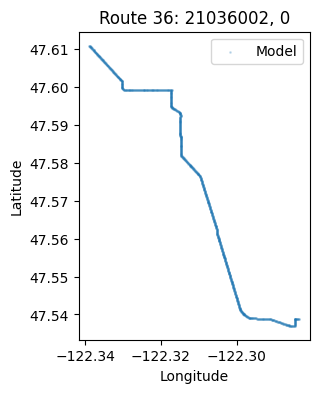

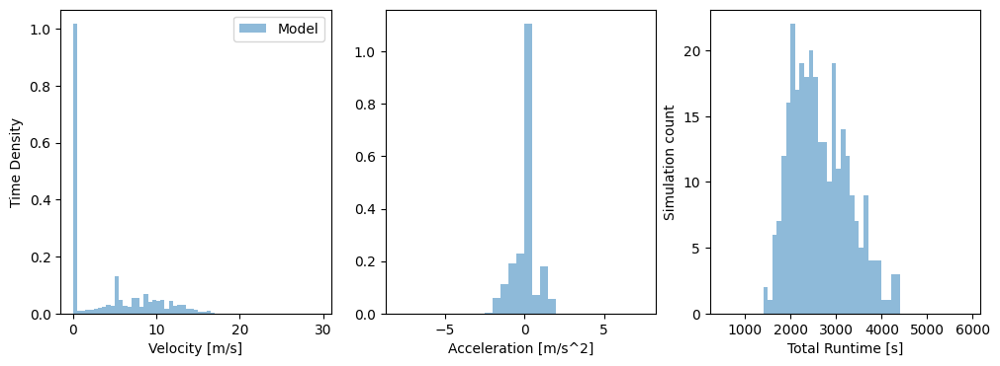

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


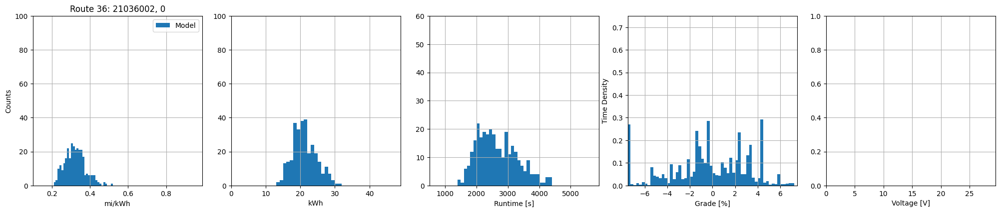

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2127956650114518), np.float64(0.510737830291159), np.float64(0.32283981021087876), np.float64(0.053686042139728746))
Energy min/max/mean/std [kWh]: 		(np.float64(13.053685632599727), np.float64(31.33057751405823), np.float64(21.217292735099235), np.float64(3.4974514142298156))
Time min/max/mean/std [s]: 		(np.float64(1452.012631057651), np.float64(4369.1865284380365), np.float64(2659.8101350707034), np.float64(635.5642997892098))
|Grade| mean/std [%]: 			(np.float64(2.4387902324634316), np.float64(1.6322797850460877))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



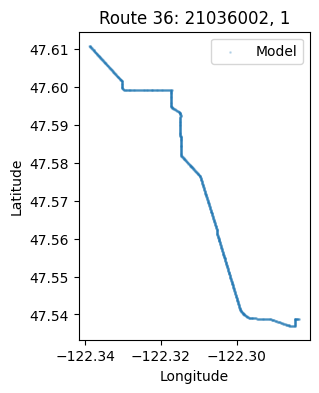

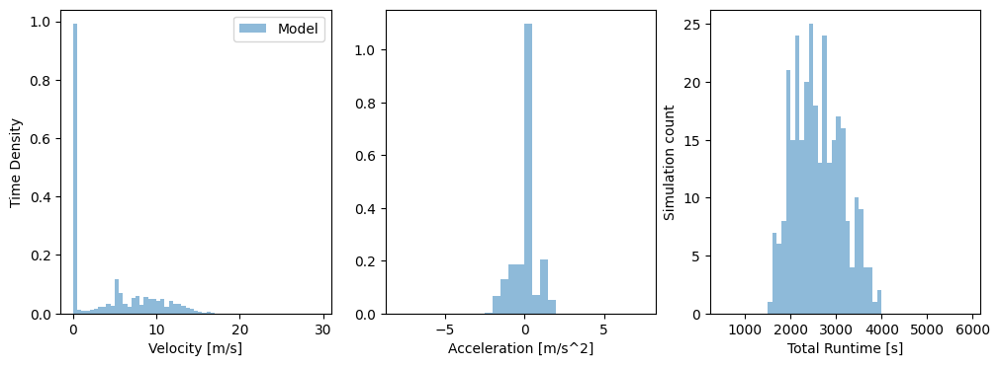

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


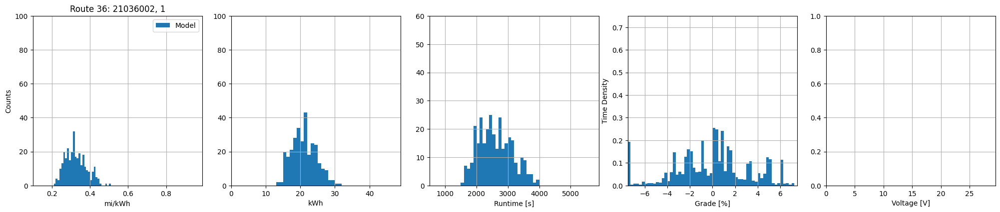

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21437446558656922), np.float64(0.5079376292490767), np.float64(0.3260281610030037), np.float64(0.055198533608590804))
Energy min/max/mean/std [kWh]: 		(np.float64(13.125559620575606), np.float64(31.09962568536556), np.float64(21.026817952325192), np.float64(3.4948165130615556))
Time min/max/mean/std [s]: 		(np.float64(1512.8039570238411), np.float64(3954.735466452058), np.float64(2601.9177965351196), np.float64(535.3684458396918))
|Grade| mean/std [%]: 			(np.float64(2.294210140297297), np.float64(1.7577585459435643))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



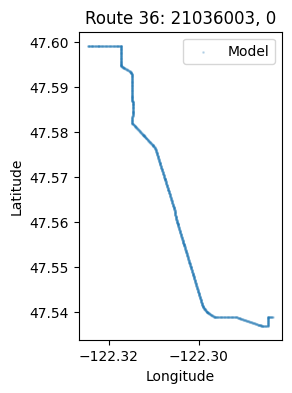

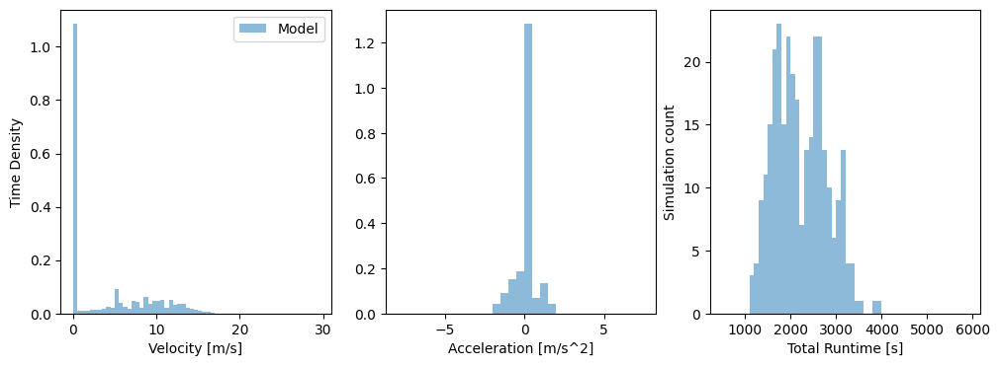

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


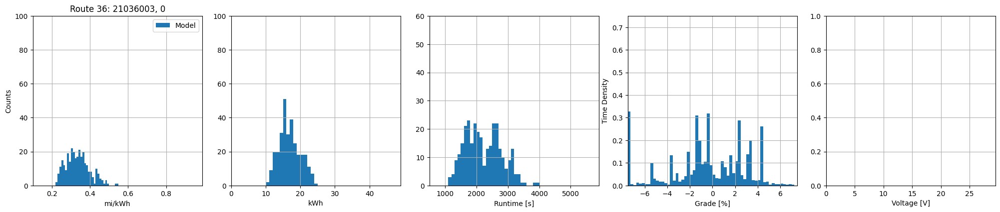

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22823054802809625), np.float64(0.5439886353795823), np.float64(0.33612593105446364), np.float64(0.06170442824559623))
Energy min/max/mean/std [kWh]: 		(np.float64(10.091889952706742), np.float64(24.054069410103807), np.float64(16.87558243712052), np.float64(3.040767454161497))
Time min/max/mean/std [s]: 		(np.float64(1127.6841956337164), np.float64(3910.94780624996), np.float64(2225.737667582838), np.float64(568.2147876152012))
|Grade| mean/std [%]: 			(np.float64(2.2942192254888316), np.float64(1.5566819325470223))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



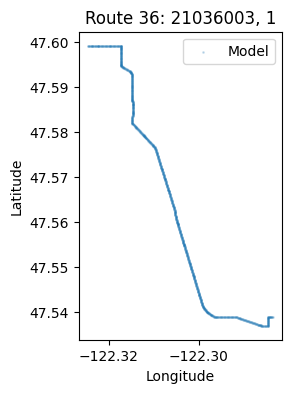

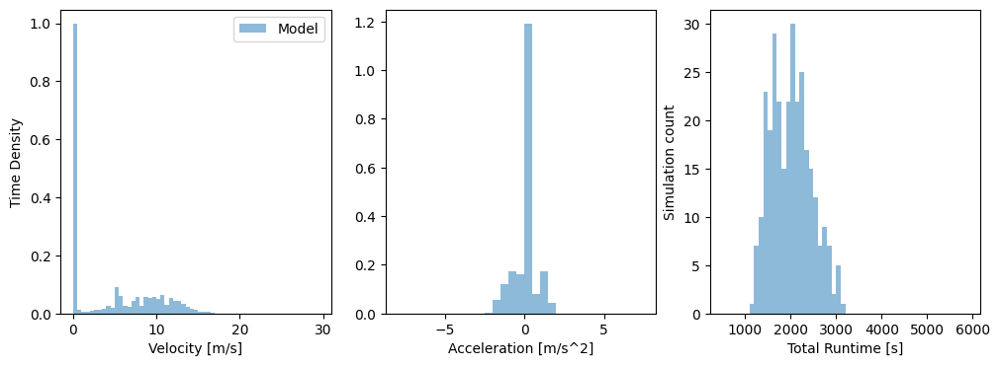

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


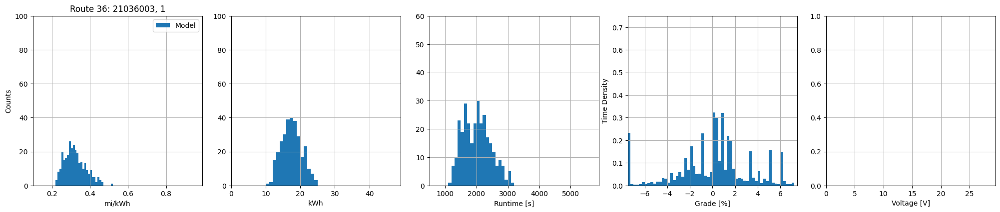

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.22409903797815742), np.float64(0.5126778052368278), np.float64(0.3223027279116634), np.float64(0.0553553928501971))
Energy min/max/mean/std [kWh]: 		(np.float64(10.70851911856551), np.float64(24.498186732858162), np.float64(17.52127718566509), np.float64(2.906686378882741))
Time min/max/mean/std [s]: 		(np.float64(1103.0381429049698), np.float64(3155.375923004438), np.float64(2006.412428452773), np.float64(439.216804519268))
|Grade| mean/std [%]: 			(np.float64(2.1122876368114403), np.float64(1.7967839627389832))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------4-------------------


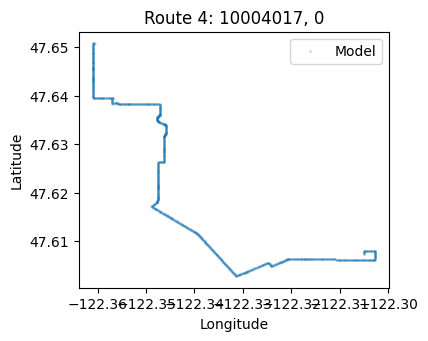

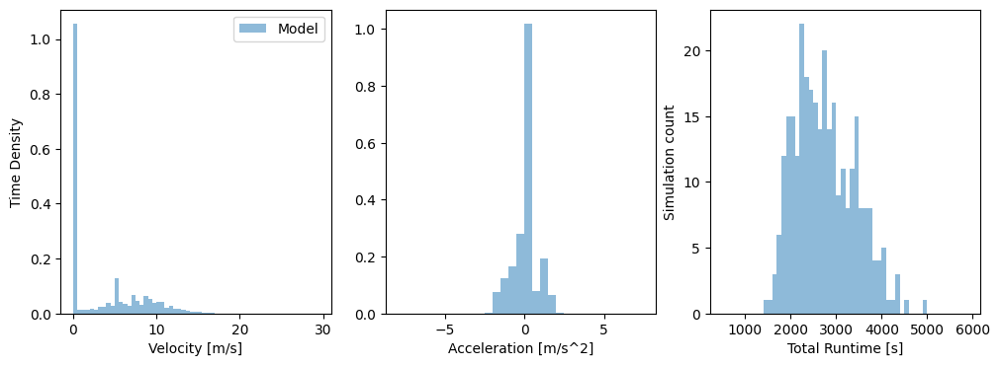

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


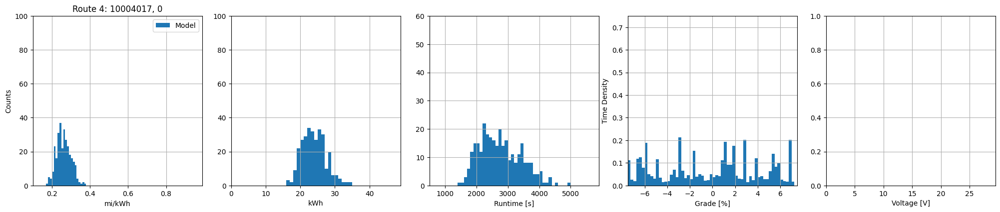

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17835533888085034), np.float64(0.3789277843635364), np.float64(0.2622726077924861), np.float64(0.03721096606809527))
Energy min/max/mean/std [kWh]: 		(np.float64(16.27708390435988), np.float64(34.58174775412175), np.float64(23.994962782650255), np.float64(3.438822422316183))
Time min/max/mean/std [s]: 		(np.float64(1487.376633524496), np.float64(4983.10124196007), np.float64(2756.383173833196), np.float64(658.4928390335876))
|Grade| mean/std [%]: 			(np.float64(3.6492644992487473), np.float64(2.08451663174226))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



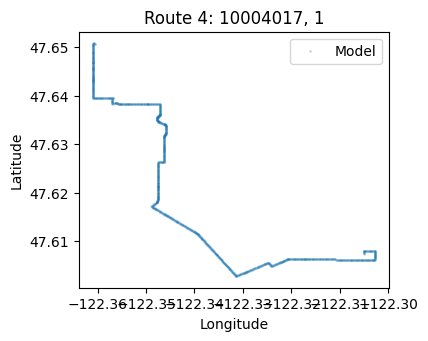

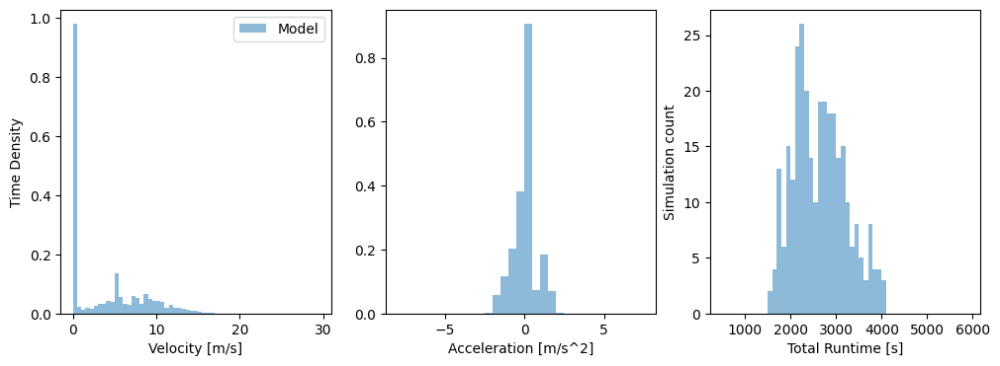

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


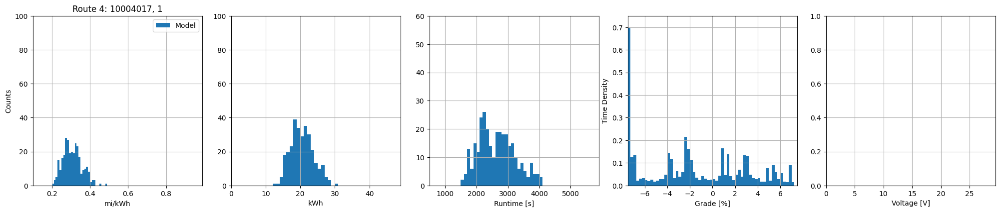

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.205135520094406), np.float64(0.4851735484762814), np.float64(0.3085161145347585), np.float64(0.04941063470786693))
Energy min/max/mean/std [kWh]: 		(np.float64(12.712384815000044), np.float64(30.06652795893713), np.float64(20.501054691020776), np.float64(3.255298678788692))
Time min/max/mean/std [s]: 		(np.float64(1507.7325854037035), np.float64(4074.5358921083607), np.float64(2645.6622230187363), np.float64(579.1347561765156))
|Grade| mean/std [%]: 			(np.float64(3.426651133624763), np.float64(1.989665761594819))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



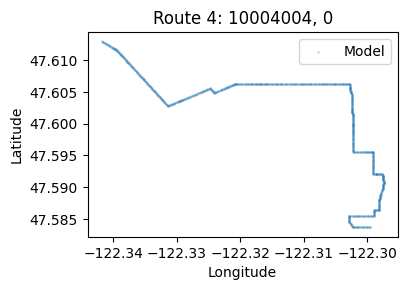

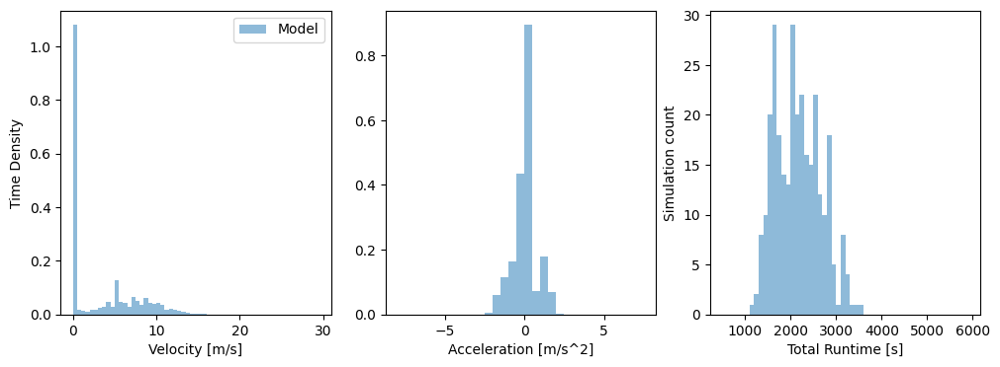

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


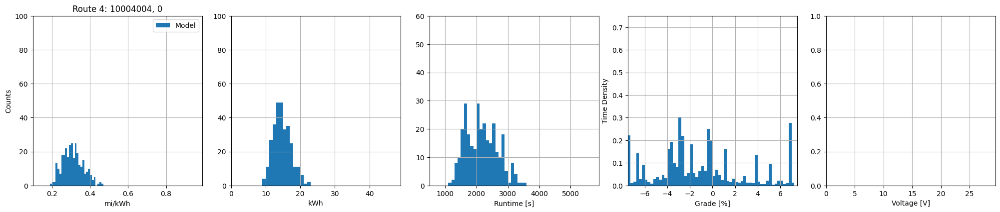

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1948952987490533), np.float64(0.46812018920852017), np.float64(0.3108925228179723), np.float64(0.05339075078893265))
Energy min/max/mean/std [kWh]: 		(np.float64(9.511143668847888), np.float64(22.844873131513232), np.float64(14.747680270633452), np.float64(2.5493777638587813))
Time min/max/mean/std [s]: 		(np.float64(1150.4831183233005), np.float64(3556.2277845539506), np.float64(2166.788750564439), np.float64(503.8614795868499))
|Grade| mean/std [%]: 			(np.float64(3.0933859822523195), np.float64(2.1218243535679515))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



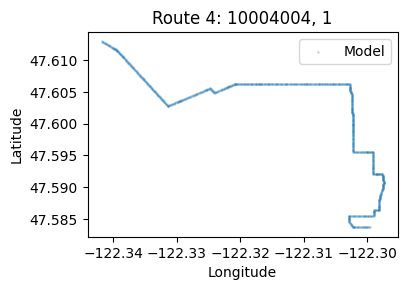

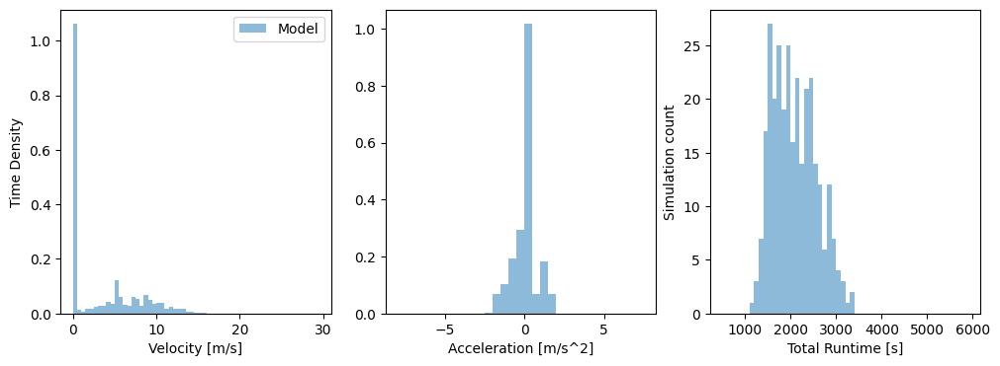

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


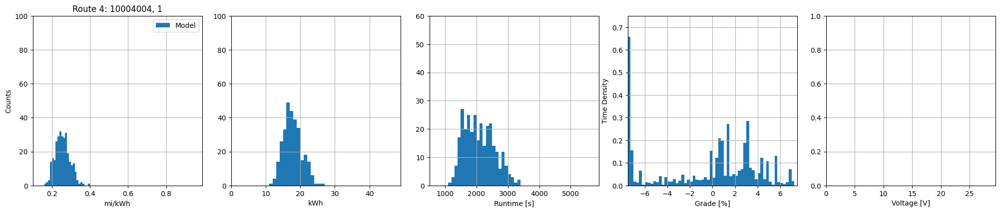

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16920881091676038), np.float64(0.3900287253059377), np.float64(0.2563264895485482), np.float64(0.03801149497525134))
Energy min/max/mean/std [kWh]: 		(np.float64(11.414992858824926), np.float64(26.311721534962174), np.float64(17.753017946857508), np.float64(2.6463317860857742))
Time min/max/mean/std [s]: 		(np.float64(1197.6468568961177), np.float64(3397.749057915607), np.float64(2087.818255557094), np.float64(473.37270579735775))
|Grade| mean/std [%]: 			(np.float64(2.949299547604462), np.float64(2.0833634159582592))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



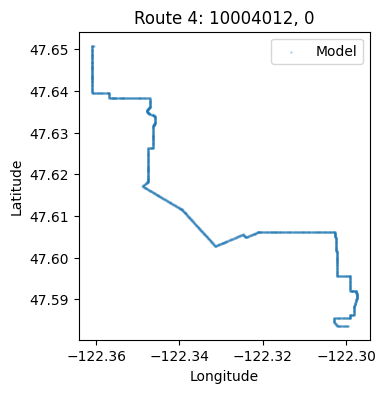

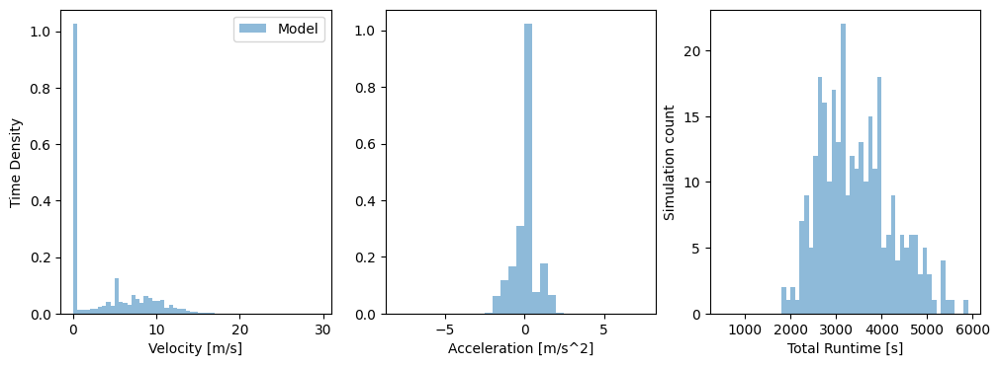

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


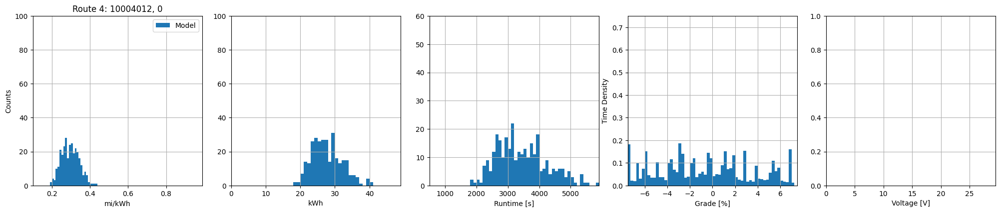

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19676259154741477), np.float64(0.4336945824925513), np.float64(0.2970299459565024), np.float64(0.04606370326697514))
Energy min/max/mean/std [kWh]: 		(np.float64(18.503904215720283), np.float64(40.78541022562786), np.float64(27.681556532039043), np.float64(4.377493780137626))
Time min/max/mean/std [s]: 		(np.float64(1839.6227397815242), np.float64(5876.4820887763435), np.float64(3449.0638634838074), np.float64(797.5452338839916))
|Grade| mean/std [%]: 			(np.float64(3.297962620542995), np.float64(2.072975428053578))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



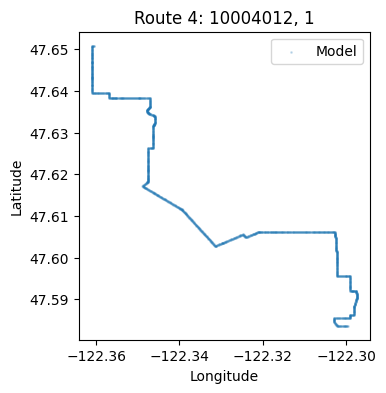

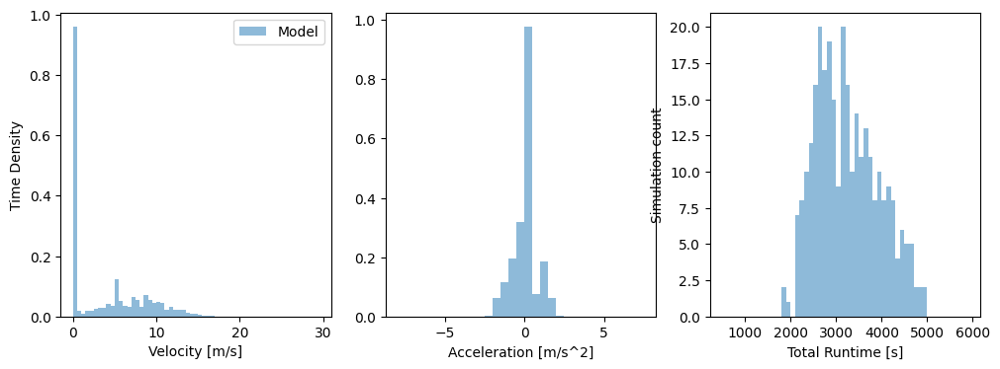

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


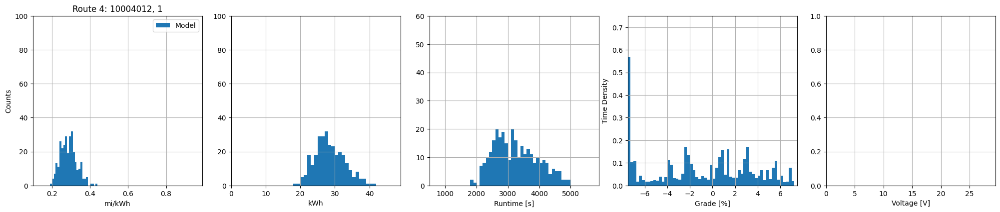

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19437059045520835), np.float64(0.4398206244301242), np.float64(0.28825719656473975), np.float64(0.04349240329549987))
Energy min/max/mean/std [kWh]: 		(np.float64(18.245379005273676), np.float64(41.28553588415936), np.float64(28.471208548324483), np.float64(4.2863420289043095))
Time min/max/mean/std [s]: 		(np.float64(1878.9414714863237), np.float64(4956.536876712474), np.float64(3252.4599612577485), np.float64(694.4602187511696))
|Grade| mean/std [%]: 			(np.float64(3.224548770370156), np.float64(2.0423276396602397))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



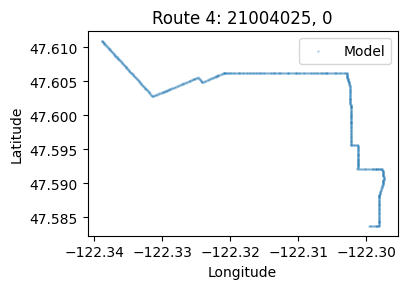

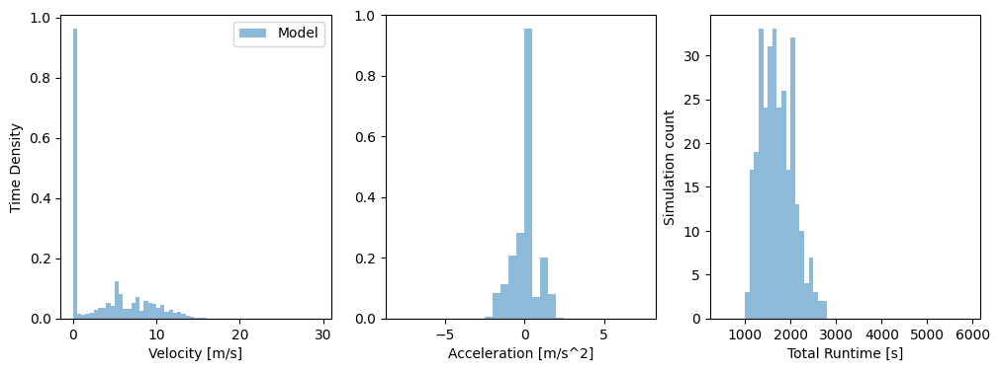

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


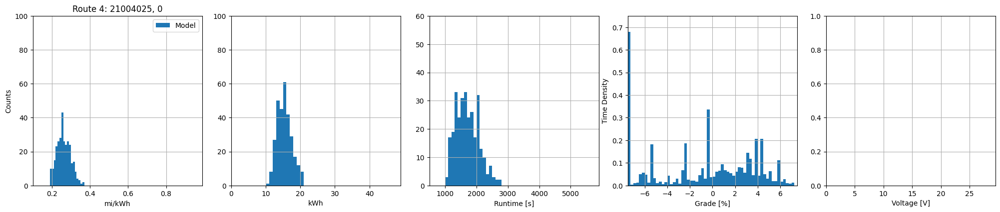

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19061788956349632), np.float64(0.3668924972710844), np.float64(0.2625448026856242), np.float64(0.03570001468770464))
Energy min/max/mean/std [kWh]: 		(np.float64(10.840344181750151), np.float64(20.864993087626925), np.float64(15.430401735244308), np.float64(2.10731518858617))
Time min/max/mean/std [s]: 		(np.float64(1088.4635017428395), np.float64(2751.6174077980213), np.float64(1711.4083867031738), np.float64(365.3606916526502))
|Grade| mean/std [%]: 			(np.float64(3.0396168929027874), np.float64(1.9248619691243112))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



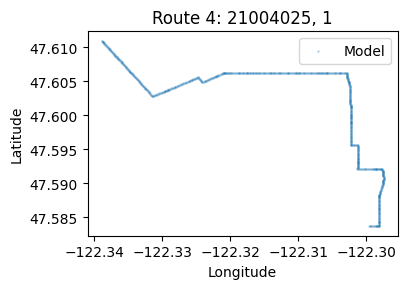

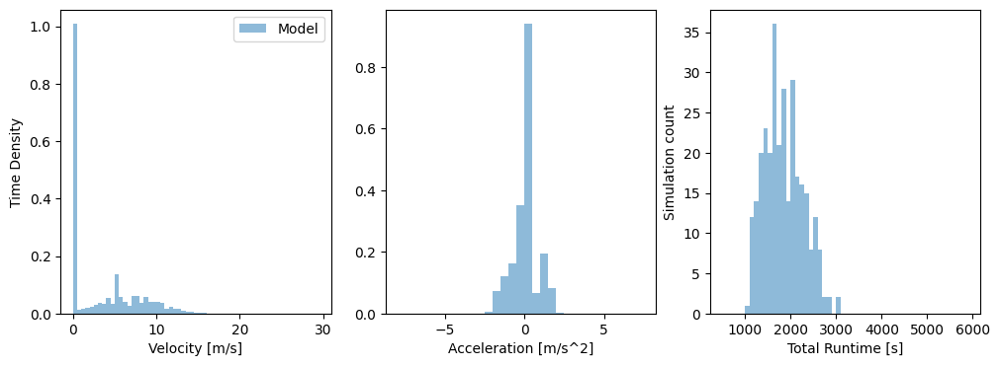

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


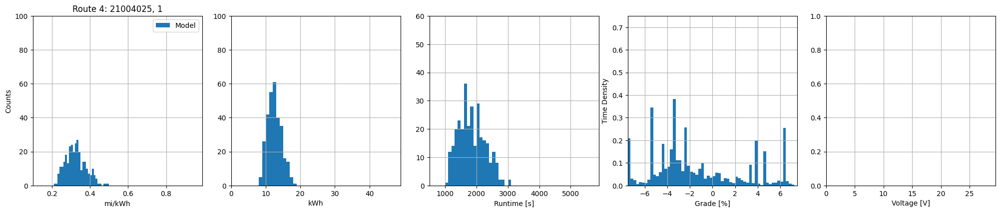

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2198371544052933), np.float64(0.49655232658881426), np.float64(0.32621362706469714), np.float64(0.05286234910149448))
Energy min/max/mean/std [kWh]: 		(np.float64(8.010348051594264), np.float64(18.09319708747801), np.float64(12.511001438020287), np.float64(2.0083855922563627))
Time min/max/mean/std [s]: 		(np.float64(1082.3249481033843), np.float64(3080.0114606433144), np.float64(1850.2841366316945), np.float64(419.7313271536085))
|Grade| mean/std [%]: 			(np.float64(3.5457905636959874), np.float64(1.7279275910441374))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



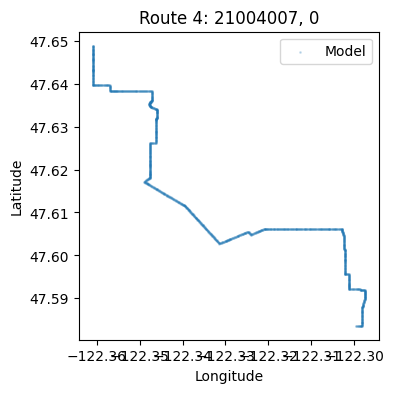

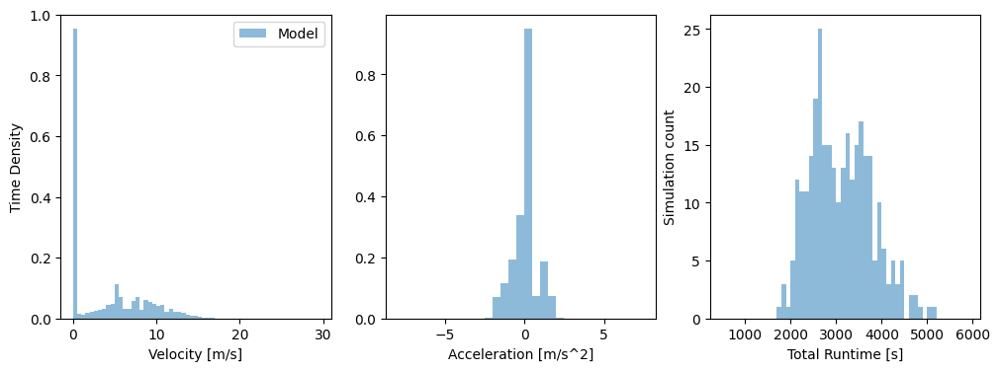

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


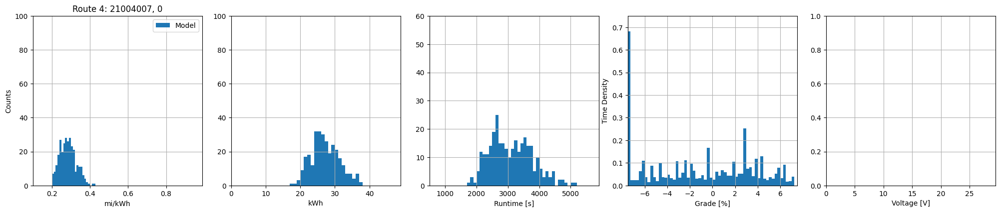

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20044435439901837), np.float64(0.4235754507722227), np.float64(0.28474485491415397), np.float64(0.04288500206827086))
Energy min/max/mean/std [kWh]: 		(np.float64(17.918166266049678), np.float64(37.864350811522755), np.float64(27.256104504847706), np.float64(4.07864590061377))
Time min/max/mean/std [s]: 		(np.float64(1784.6411134539355), np.float64(5123.379039736292), np.float64(3110.237262171662), np.float64(670.8919730875651))
|Grade| mean/std [%]: 			(np.float64(3.3705027090459594), np.float64(1.935539668901506))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



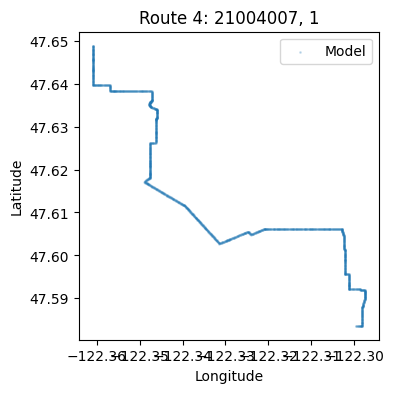

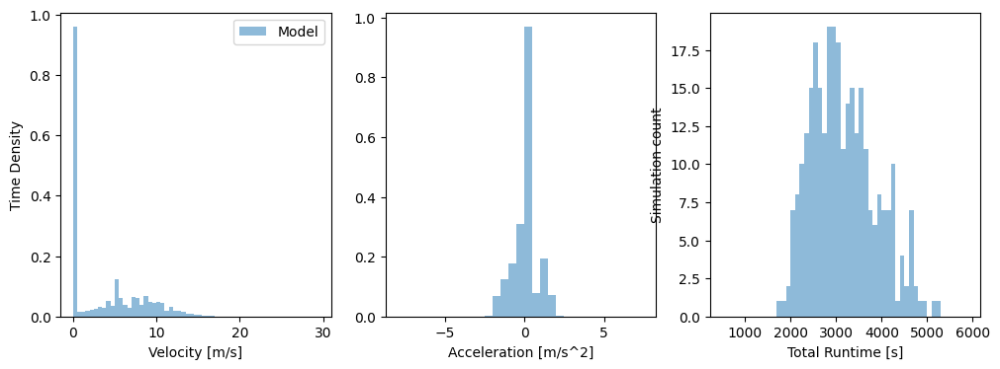

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


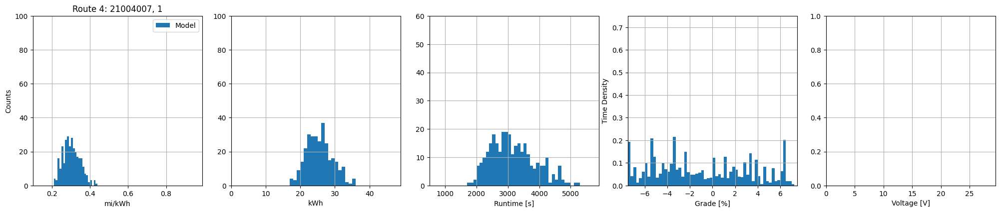

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21166231212660372), np.float64(0.43631847564694337), np.float64(0.303412760113238), np.float64(0.04442222048604428))
Energy min/max/mean/std [kWh]: 		(np.float64(17.39541138138722), np.float64(35.85871901767054), np.float64(25.551284207957586), np.float64(3.73488823833672))
Time min/max/mean/std [s]: 		(np.float64(1779.527399889606), np.float64(5275.888850846557), np.float64(3165.572343858613), np.float64(713.5034349966941))
|Grade| mean/std [%]: 			(np.float64(3.586889991287538), np.float64(1.9313545469348903))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



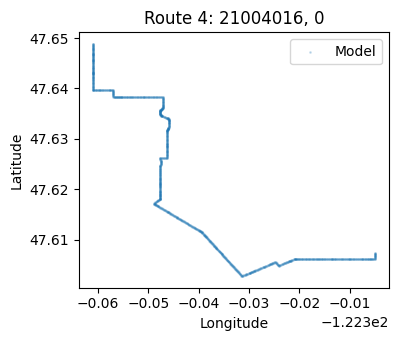

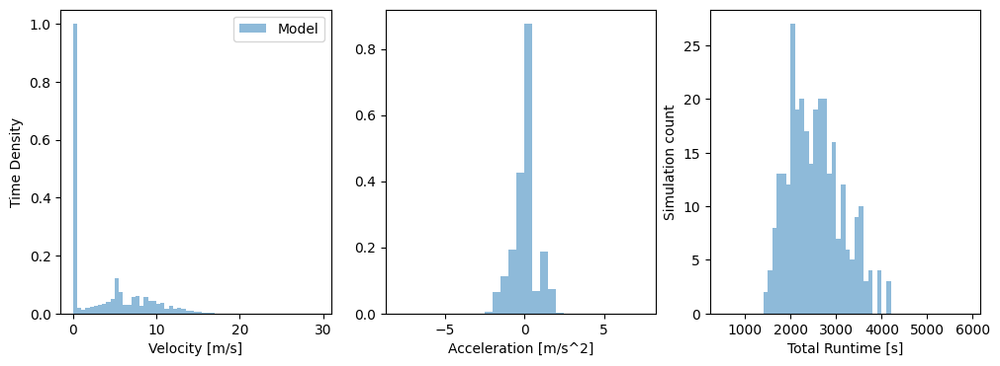

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


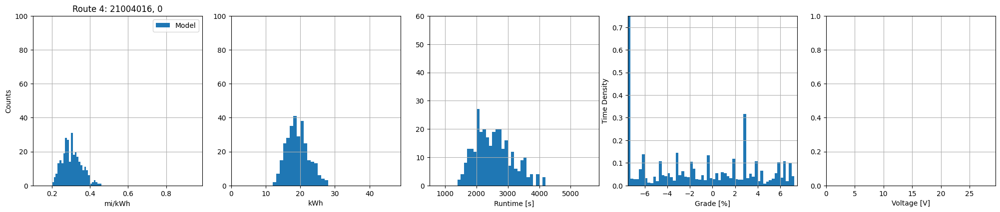

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.20616885626714207), np.float64(0.4502053395099286), np.float64(0.3049755110991125), np.float64(0.05011870980513874))
Energy min/max/mean/std [kWh]: 		(np.float64(12.696047173678142), np.float64(27.724013858104673), np.float64(19.247763499354424), np.float64(3.1509640269576975))
Time min/max/mean/std [s]: 		(np.float64(1406.9983571493904), np.float64(4155.696323547995), np.float64(2547.907908349028), np.float64(589.8197133684031))
|Grade| mean/std [%]: 			(np.float64(3.558713053599917), np.float64(2.0247095900793783))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



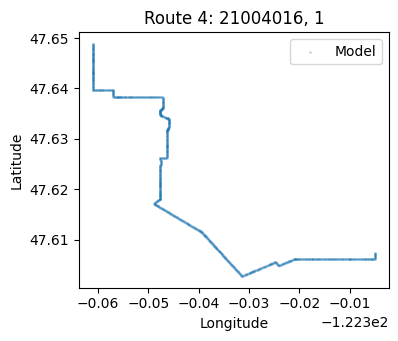

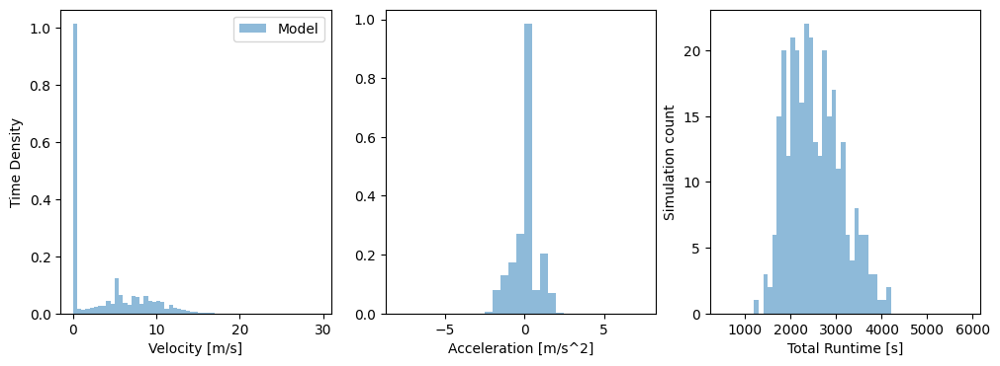

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


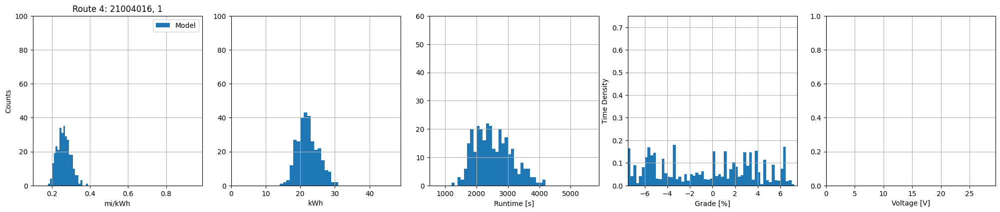

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18743992759377648), np.float64(0.3835359453194787), np.float64(0.26223116498827587), np.float64(0.035279705171672754))
Energy min/max/mean/std [kWh]: 		(np.float64(14.903623235871507), np.float64(30.495504878999515), np.float64(22.192170568646223), np.float64(2.9848365675413984))
Time min/max/mean/std [s]: 		(np.float64(1249.9085757876987), np.float64(4135.379539301322), np.float64(2535.52580598263), np.float64(589.9224014823756))
|Grade| mean/std [%]: 			(np.float64(3.673151859182661), np.float64(1.984836393935729))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



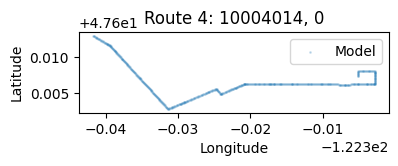

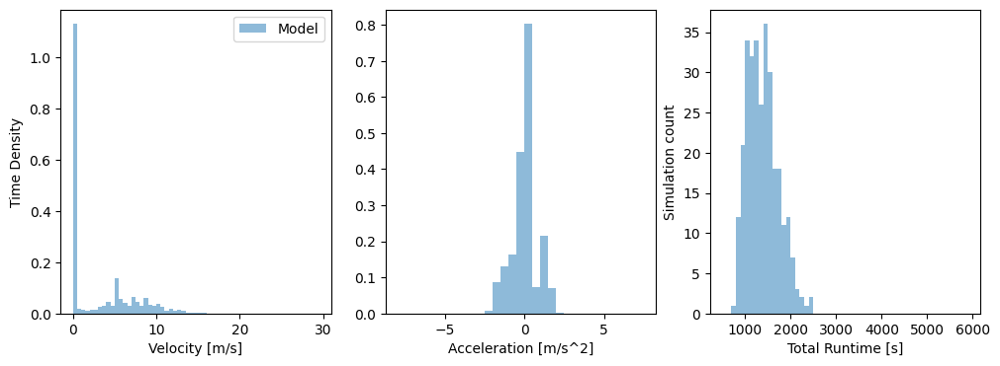

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


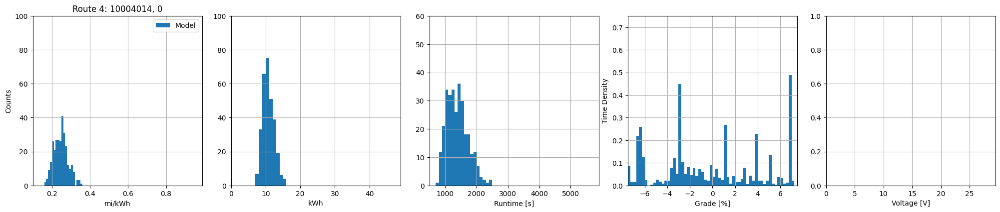

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16582218853784436), np.float64(0.3556318579605909), np.float64(0.24664697274482003), np.float64(0.03656136743843704))
Energy min/max/mean/std [kWh]: 		(np.float64(7.297306588875891), np.float64(15.650225842470544), np.float64(10.756042688055201), np.float64(1.615260310818641))
Time min/max/mean/std [s]: 		(np.float64(797.2268250169885), np.float64(2480.363990587056), np.float64(1389.1620323337188), np.float64(337.65397721347676))
|Grade| mean/std [%]: 			(np.float64(3.832065095113447), np.float64(2.2130637160902737))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



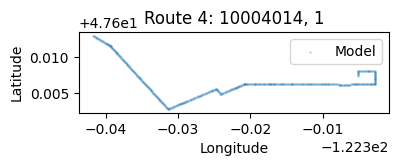

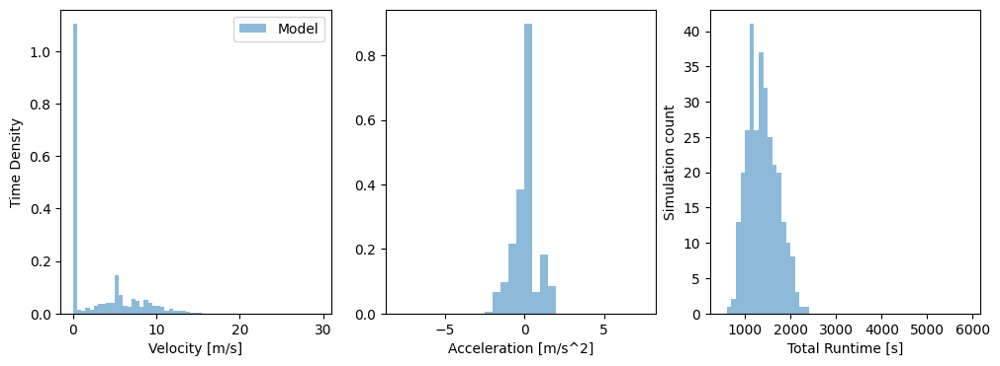

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


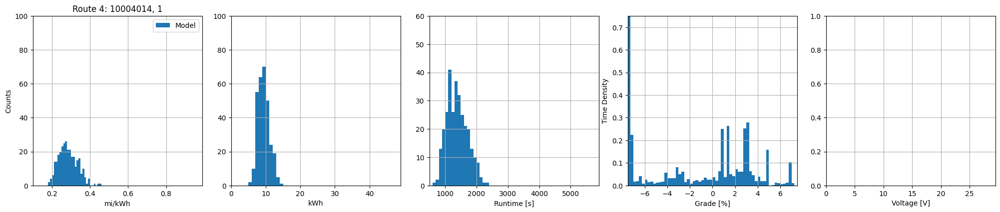

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18461620837223058), np.float64(0.4522182640606413), np.float64(0.2848341905553721), np.float64(0.049422966348419674))
Energy min/max/mean/std [kWh]: 		(np.float64(5.738808410846663), np.float64(14.057237986911483), np.float64(9.385335249955467), np.float64(1.6224340407612214))
Time min/max/mean/std [s]: 		(np.float64(698.2737521391931), np.float64(2343.523238568079), np.float64(1383.6331625561347), np.float64(327.4197382226959))
|Grade| mean/std [%]: 			(np.float64(3.2136855552949726), np.float64(2.0195051224515757))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



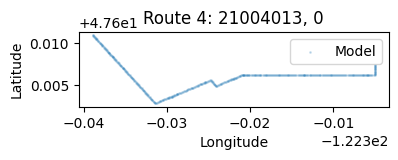

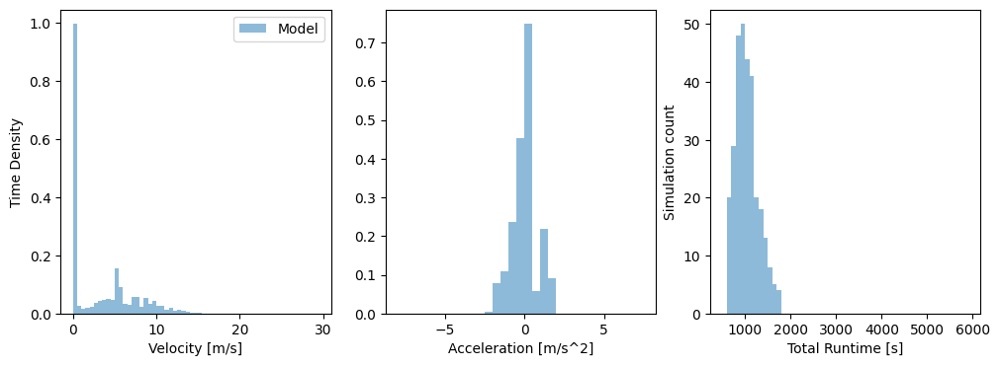

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


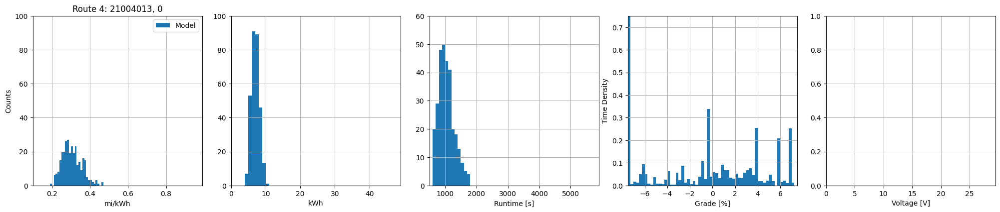

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19908784274487498), np.float64(0.46710404298511204), np.float64(0.30561809515961147), np.float64(0.050200400524044494))
Energy min/max/mean/std [kWh]: 		(np.float64(4.503009243475196), np.float64(10.56505406973546), np.float64(7.064915367371594), np.float64(1.1383520546448544))
Time min/max/mean/std [s]: 		(np.float64(611.3802463384391), np.float64(1747.6313487550588), np.float64(1042.4968310114564), np.float64(250.50851578978015))
|Grade| mean/std [%]: 			(np.float64(3.2936299089657326), np.float64(2.2813503770385712))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



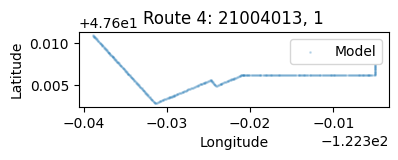

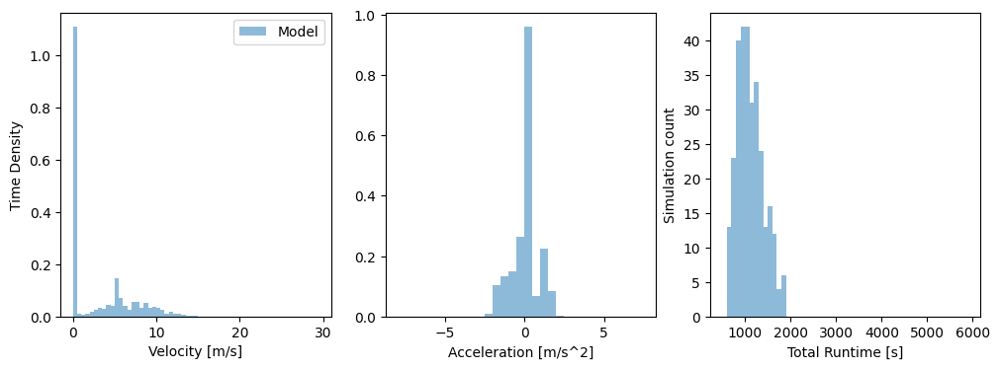

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


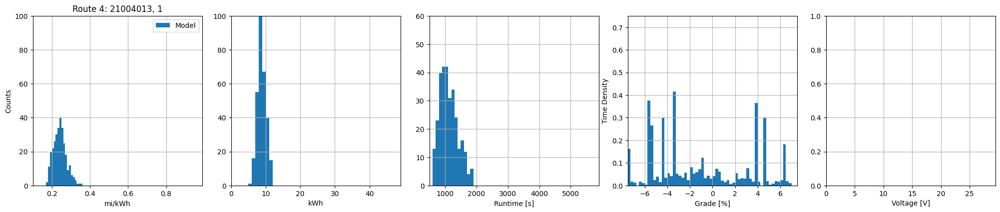

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17665860705513145), np.float64(0.3537663398083722), np.float64(0.24224640338174386), np.float64(0.033648834008650465))
Energy min/max/mean/std [kWh]: 		(np.float64(5.946560128422048), np.float64(11.908238416177216), np.float64(8.84943472697735), np.float64(1.2127558723588683))
Time min/max/mean/std [s]: 		(np.float64(611.4351627191259), np.float64(1832.0741058165597), np.float64(1121.3656783089425), np.float64(285.10809044883587))
|Grade| mean/std [%]: 			(np.float64(3.735463542816396), np.float64(1.734961283745601))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



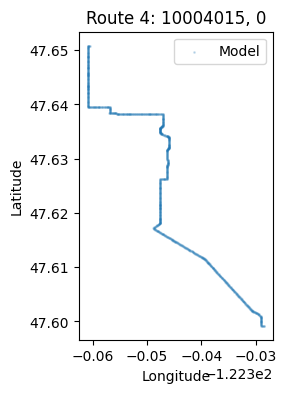

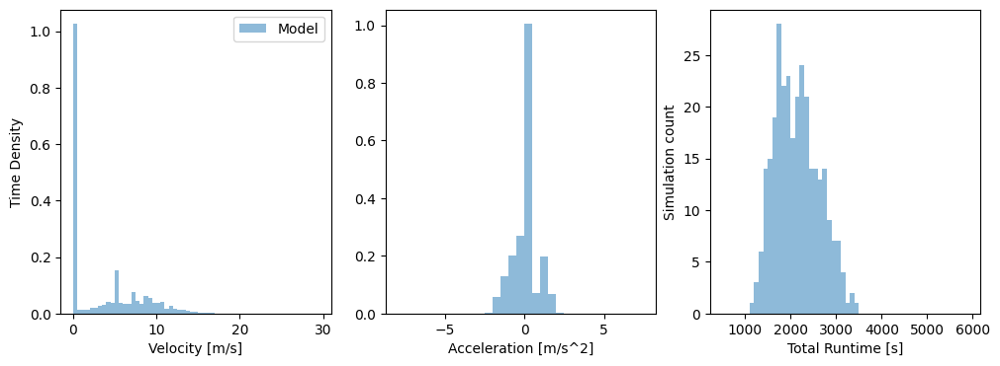

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


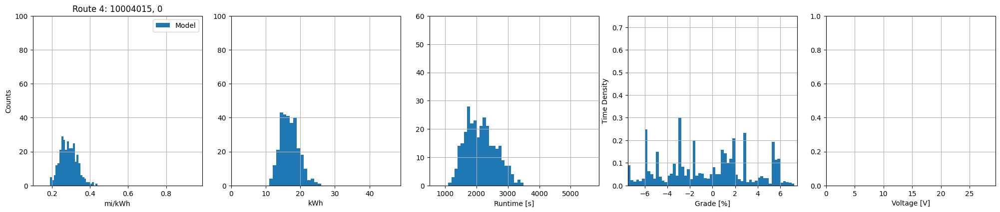

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19012364189938208), np.float64(0.4306898274842561), np.float64(0.28801953084939297), np.float64(0.04443430166464125))
Energy min/max/mean/std [kWh]: 		(np.float64(11.037441568008063), np.float64(25.003275538497878), np.float64(16.89987216408222), np.float64(2.622392775500657))
Time min/max/mean/std [s]: 		(np.float64(1176.078453507243), np.float64(3438.109825448001), np.float64(2140.500993996028), np.float64(478.3759747208321))
|Grade| mean/std [%]: 			(np.float64(3.2061205964758526), np.float64(1.9133237974547277))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



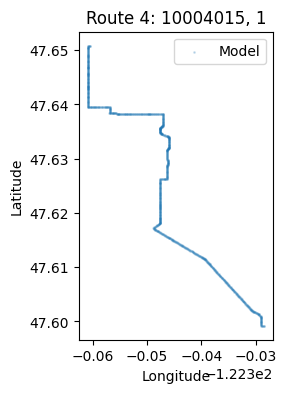

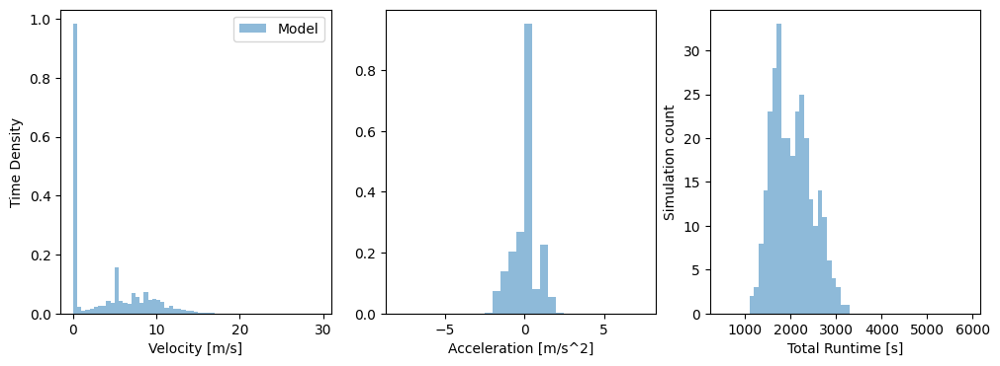

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


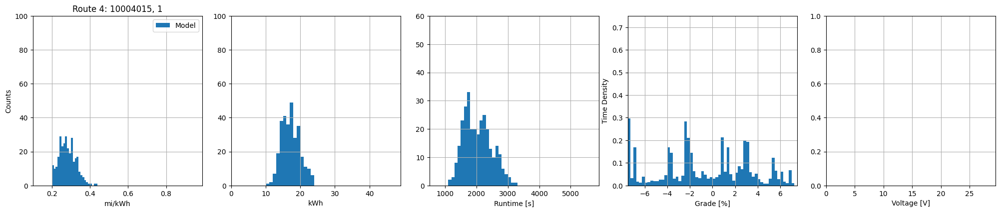

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2004925079033168), np.float64(0.43220975192715494), np.float64(0.28217854299456385), np.float64(0.04379454038312575))
Energy min/max/mean/std [kWh]: 		(np.float64(10.998343676250895), np.float64(23.709571203599836), np.float64(17.247774195171264), np.float64(2.646055583531632))
Time min/max/mean/std [s]: 		(np.float64(1116.3105769401022), np.float64(3216.9656275656253), np.float64(2037.1349364213734), np.float64(434.295784280227))
|Grade| mean/std [%]: 			(np.float64(3.1187737785879284), np.float64(1.8695653176737692))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



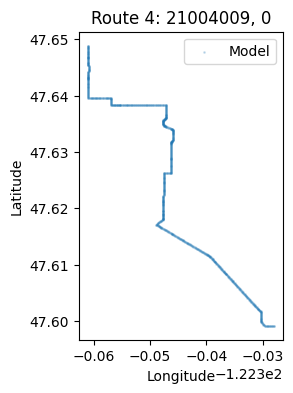

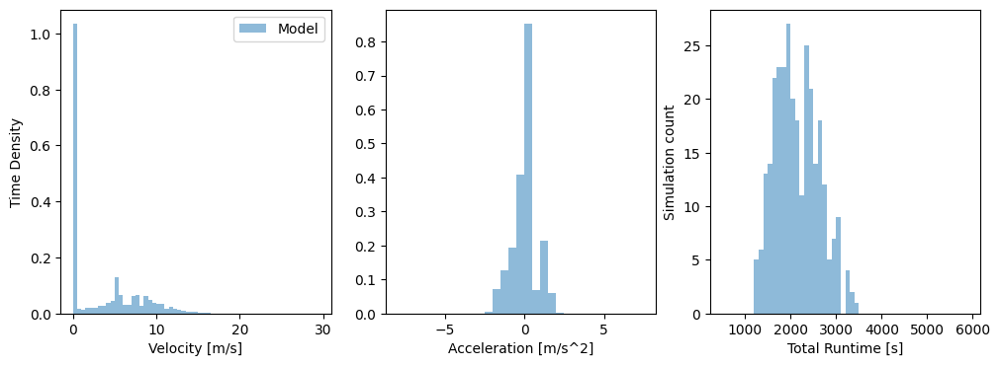

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


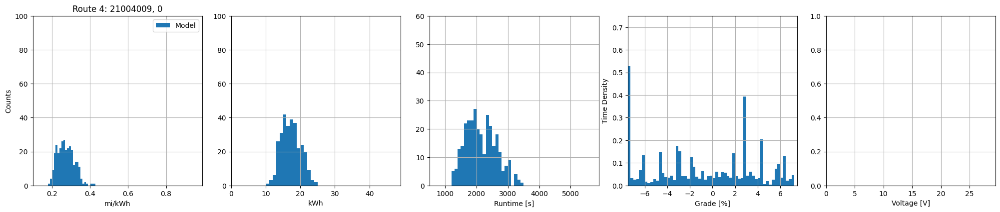

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1863517583474194), np.float64(0.4279822907696723), np.float64(0.27397684772775077), np.float64(0.04394793421426667))
Energy min/max/mean/std [kWh]: 		(np.float64(10.81141923073002), np.float64(24.829902383924562), np.float64(17.31741503699651), np.float64(2.7316354750322653))
Time min/max/mean/std [s]: 		(np.float64(1204.8846871290636), np.float64(3491.970927503374), np.float64(2145.8637149490173), np.float64(484.0349985694036))
|Grade| mean/std [%]: 			(np.float64(3.4849281132169816), np.float64(1.8908664382299394))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



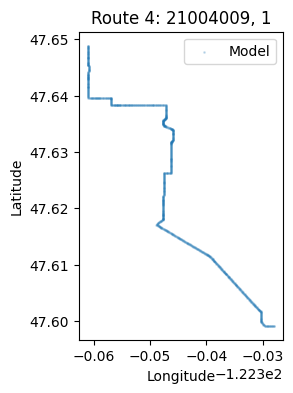

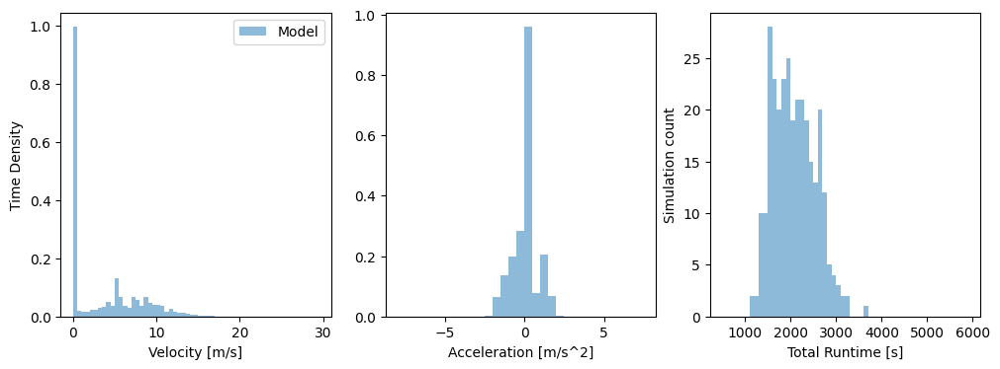

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


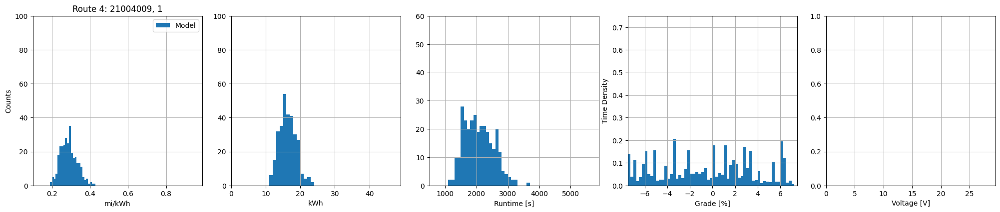

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19560670832512217), np.float64(0.42031426427444324), np.float64(0.28867213048974794), np.float64(0.04317397699236789))
Energy min/max/mean/std [kWh]: 		(np.float64(11.008330207813238), np.float64(23.654394329342644), np.float64(16.38628889422895), np.float64(2.4467914453418227))
Time min/max/mean/std [s]: 		(np.float64(1126.2896779234425), np.float64(3621.8741397448994), np.float64(2077.432164545245), np.float64(459.8229832339079))
|Grade| mean/std [%]: 			(np.float64(3.4248564839331967), np.float64(2.0634669636382093))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------40-------------------


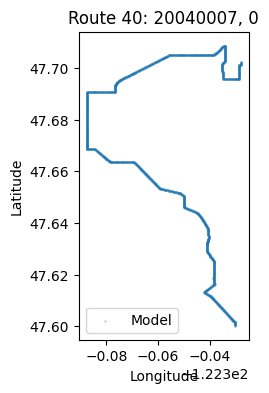

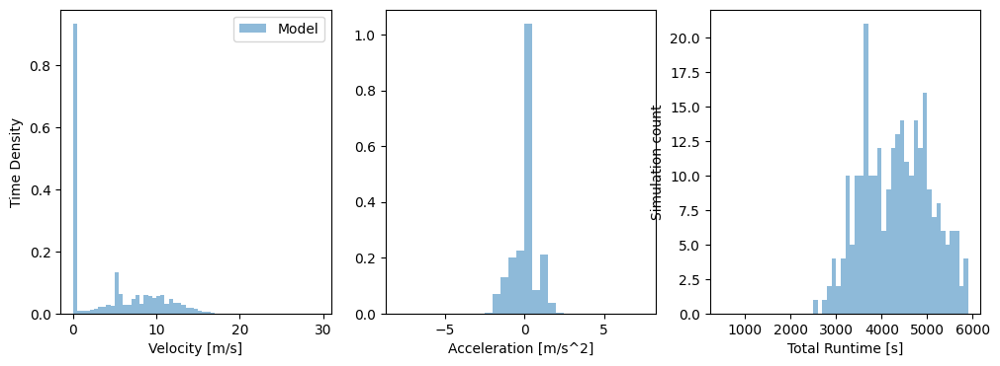

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


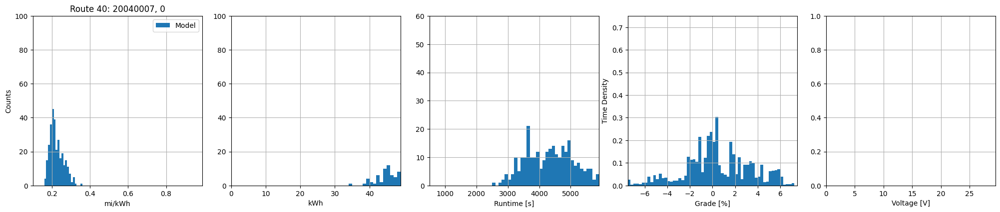

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16791113250276427), np.float64(0.35957410420733776), np.float64(0.2252949543506882), np.float64(0.03555029625749669))
Energy min/max/mean/std [kWh]: 		(np.float64(34.9827477475251), np.float64(74.9139738177903), np.float64(57.13411218385959), np.float64(8.404059726043176))
Time min/max/mean/std [s]: 		(np.float64(2599.1111551504882), np.float64(7000.78560144254), np.float64(4511.526473957751), np.float64(917.1807079990674))
|Grade| mean/std [%]: 			(np.float64(2.2082236023885553), np.float64(1.8224167239226923))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



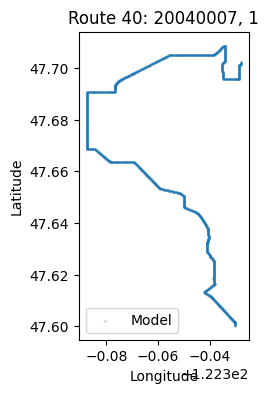

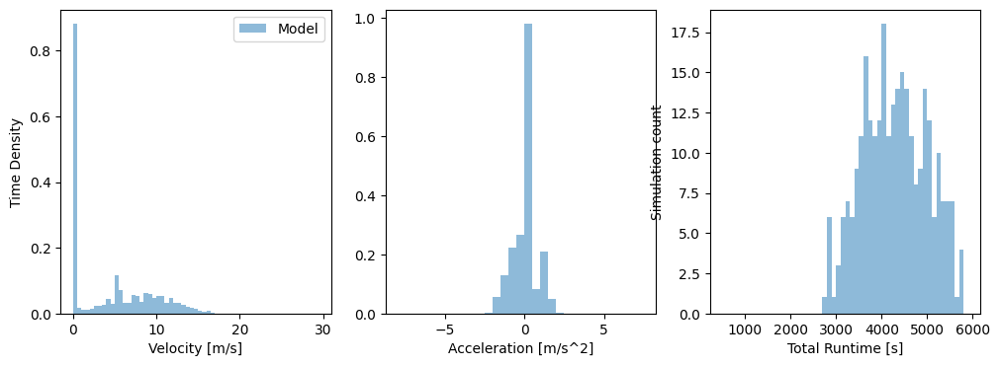

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


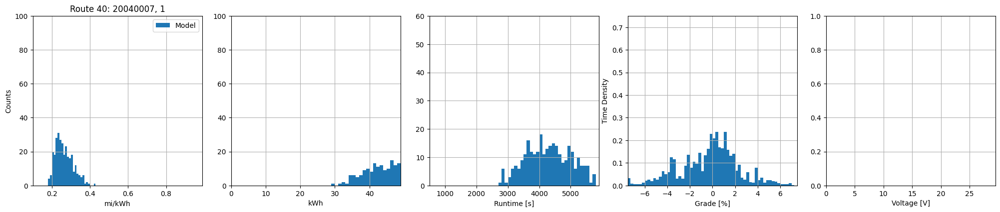

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18356026423682187), np.float64(0.422757641852837), np.float64(0.2644856916564113), np.float64(0.04563099355702428))
Energy min/max/mean/std [kWh]: 		(np.float64(29.753496469780867), np.float64(68.52527728012521), np.float64(48.90970666856175), np.float64(8.009790930182668))
Time min/max/mean/std [s]: 		(np.float64(2707.8168819822213), np.float64(7337.701357203323), np.float64(4421.319135696269), np.float64(853.1603368951679))
|Grade| mean/std [%]: 			(np.float64(1.937949178980688), np.float64(1.6048753376133433))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



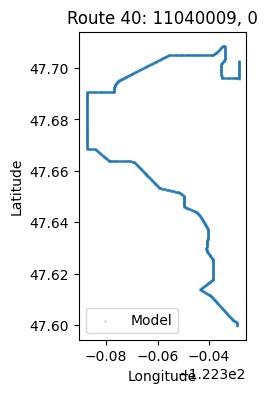

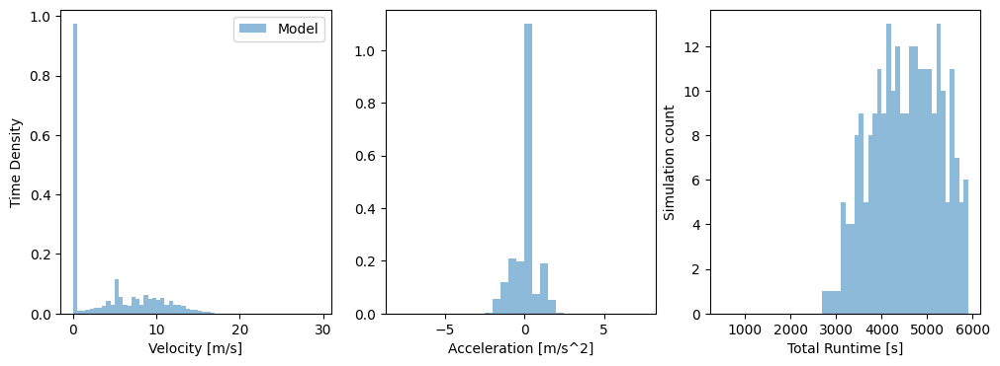

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


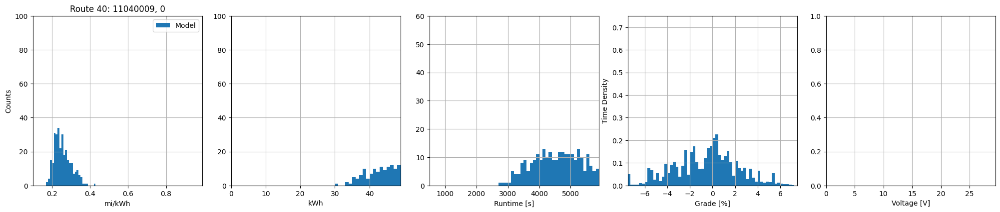

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17983976532653953), np.float64(0.42109603989141775), np.float64(0.25641015160554304), np.float64(0.04418215235178925))
Energy min/max/mean/std [kWh]: 		(np.float64(30.1586126829447), np.float64(70.61659776050078), np.float64(50.92433189720023), np.float64(8.289303747591124))
Time min/max/mean/std [s]: 		(np.float64(2762.315020596471), np.float64(8265.856198979507), np.float64(4861.224958476687), np.float64(1051.1389491039138))
|Grade| mean/std [%]: 			(np.float64(2.1466815207057195), np.float64(1.6539245829069356))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



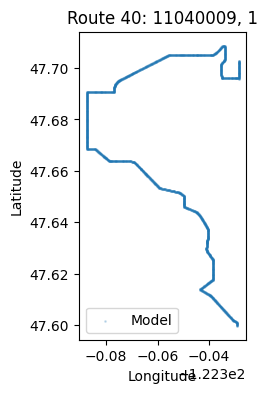

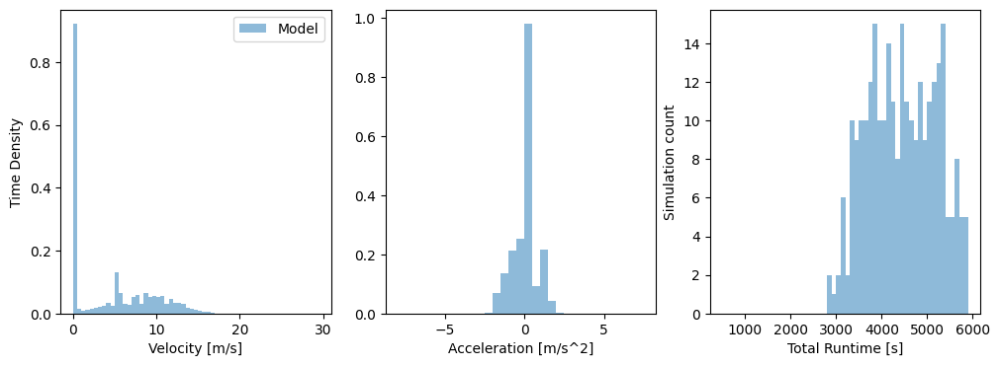

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


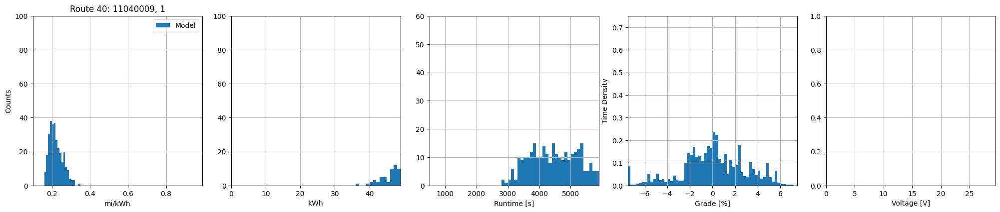

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16460226645352385), np.float64(0.34396884469400985), np.float64(0.22192048228824546), np.float64(0.03477283098626315))
Energy min/max/mean/std [kWh]: 		(np.float64(36.92072673501595), np.float64(77.15312792422853), np.float64(58.55491775633366), np.float64(8.639518425806259))
Time min/max/mean/std [s]: 		(np.float64(2812.2405170697343), np.float64(7334.613096557876), np.float64(4587.083927007061), np.float64(876.9806403014534))
|Grade| mean/std [%]: 			(np.float64(2.0926389010226436), np.float64(1.6855514735848292))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------45-------------------


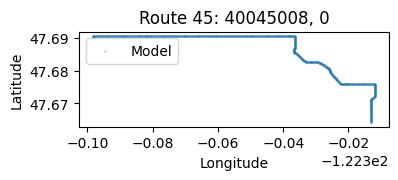

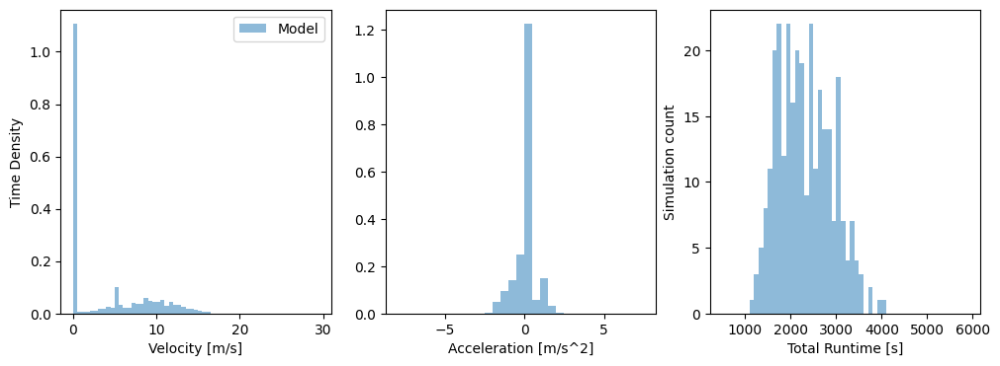

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


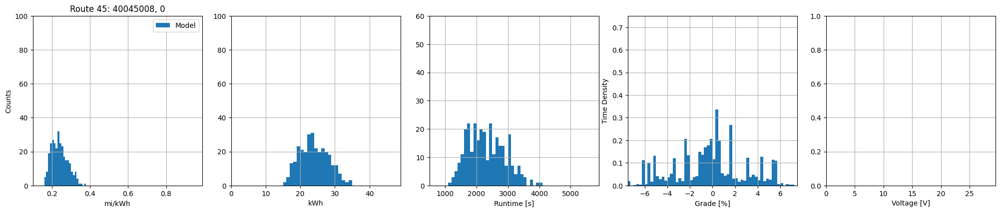

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16138668696918274), np.float64(0.37009411068116455), np.float64(0.2402604129753214), np.float64(0.042172708767842716))
Energy min/max/mean/std [kWh]: 		(np.float64(15.142855989170206), np.float64(34.72580003798608), np.float64(24.031979446473567), np.float64(4.118476729179288))
Time min/max/mean/std [s]: 		(np.float64(1150.1380384512036), np.float64(4046.8345891246295), np.float64(2320.3868776310633), np.float64(584.4996742001953))
|Grade| mean/std [%]: 			(np.float64(2.3826613065050233), np.float64(1.9267871573470738))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



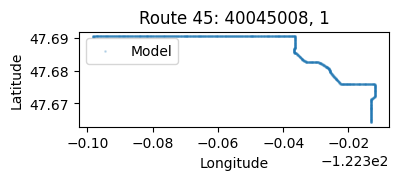

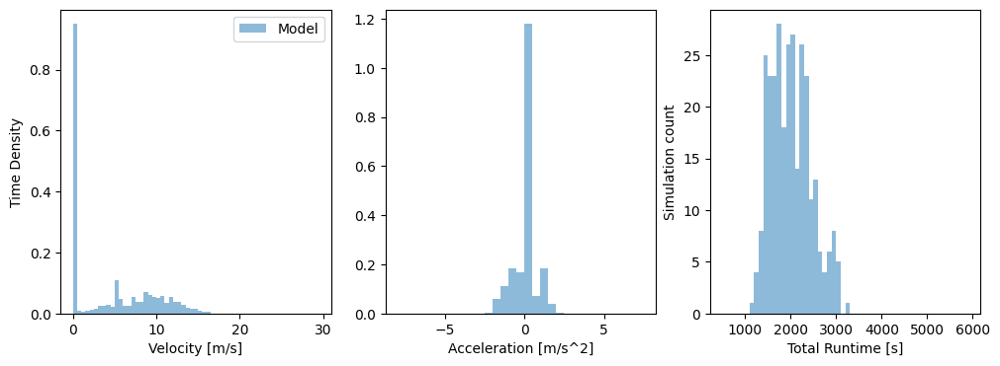

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


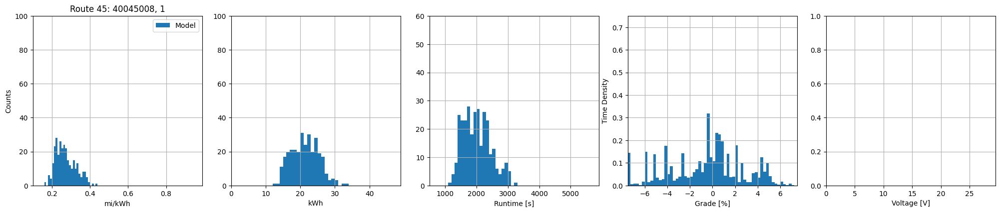

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16951262418432142), np.float64(0.43857937992168533), np.float64(0.2719499256864207), np.float64(0.05246768844317671))
Energy min/max/mean/std [kWh]: 		(np.float64(12.776503193399476), np.float64(33.05659902967188), np.float64(21.350786165947344), np.float64(3.9725781805609777))
Time min/max/mean/std [s]: 		(np.float64(1178.8028569305447), np.float64(3234.25835556162), np.float64(2015.1670006158497), np.float64(437.6483881277625))
|Grade| mean/std [%]: 			(np.float64(2.392830697459664), np.float64(1.8783239861879224))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



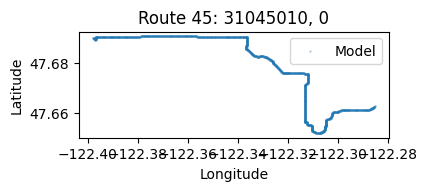

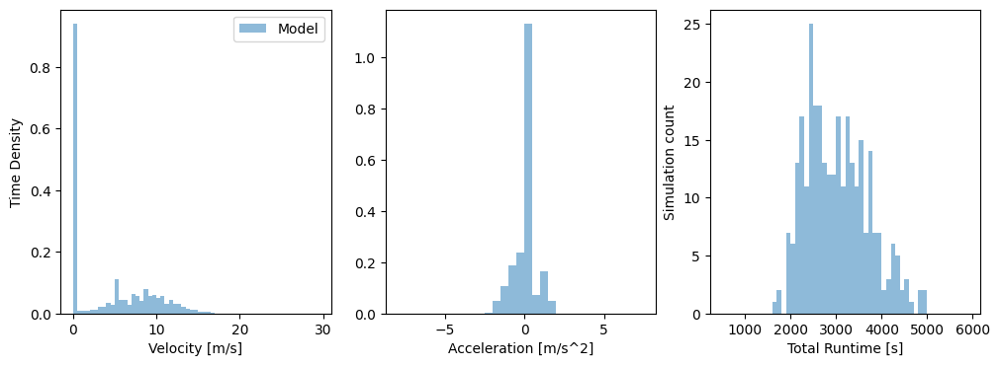

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


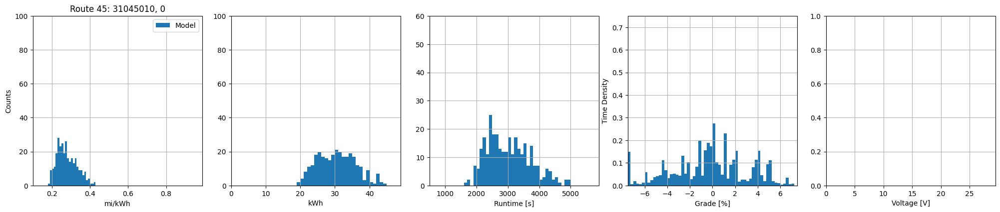

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18455384986356566), np.float64(0.42146323910457323), np.float64(0.2797250813938869), np.float64(0.05154506158676815))
Energy min/max/mean/std [kWh]: 		(np.float64(19.56250949595657), np.float64(44.67464982862717), np.float64(30.459049267465193), np.float64(5.474076590245686))
Time min/max/mean/std [s]: 		(np.float64(1603.93113425456), np.float64(4953.51920770749), np.float64(3019.9919469355864), np.float64(688.6803529330482))
|Grade| mean/std [%]: 			(np.float64(2.3938764304600944), np.float64(1.846373841014488))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



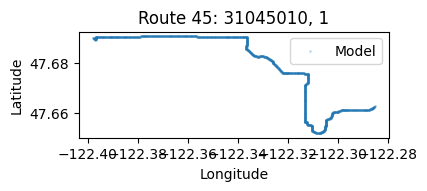

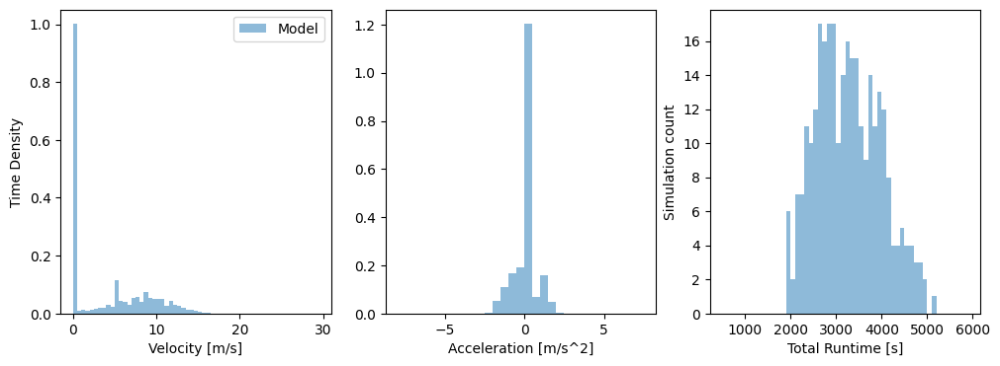

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


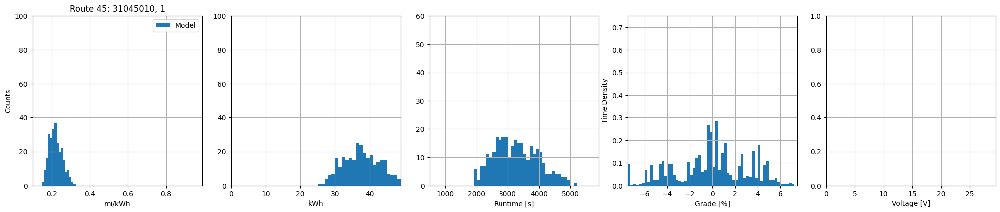

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1575224249168867), np.float64(0.3275429082843084), np.float64(0.22158341222970118), np.float64(0.03320498571940637))
Energy min/max/mean/std [kWh]: 		(np.float64(25.17590067623732), np.float64(52.349293953051955), np.float64(38.04061535759663), np.float64(5.617671510268247))
Time min/max/mean/std [s]: 		(np.float64(1903.5908875697626), np.float64(5152.924909555964), np.float64(3265.373035228468), np.float64(709.5144968270947))
|Grade| mean/std [%]: 			(np.float64(2.4313830520058666), np.float64(1.8502302966373338))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



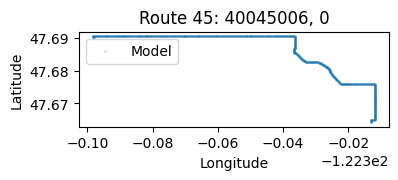

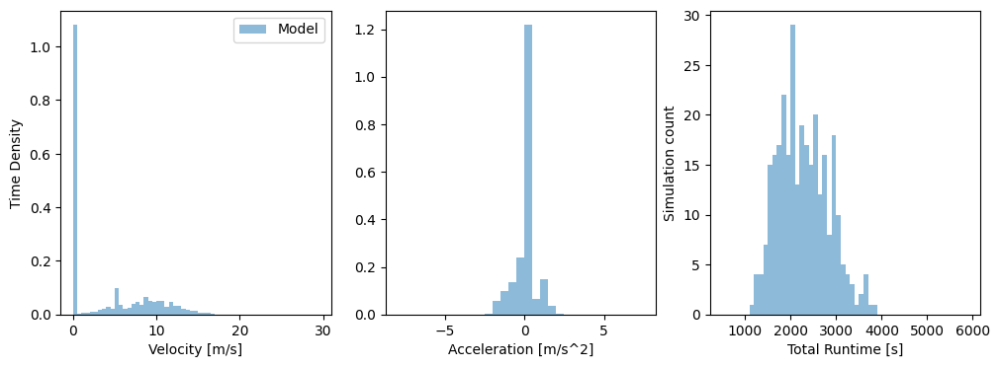

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


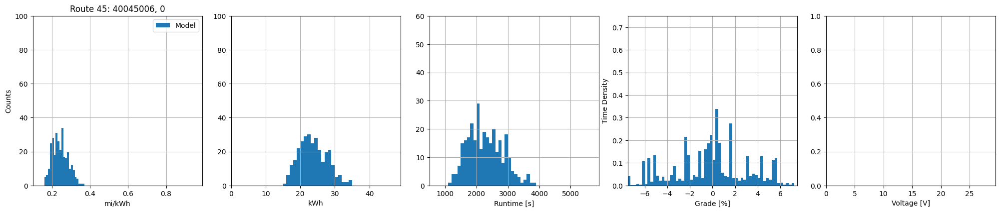

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16484412626221487), np.float64(0.3682568828141143), np.float64(0.24403332275289652), np.float64(0.04075776954494431))
Energy min/max/mean/std [kWh]: 		(np.float64(15.313383113887982), np.float64(34.2096431260669), np.float64(23.754776914135473), np.float64(3.9559365782626563))
Time min/max/mean/std [s]: 		(np.float64(1148.712996222217), np.float64(3804.906373955936), np.float64(2281.0667173155666), np.float64(554.7466048713505))
|Grade| mean/std [%]: 			(np.float64(2.462634026151891), np.float64(1.9706558334663333))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



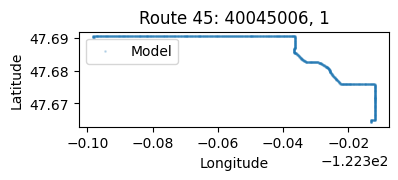

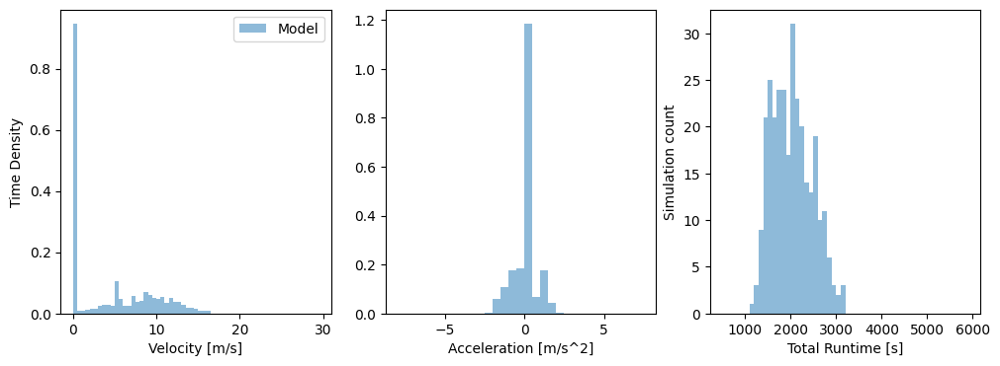

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


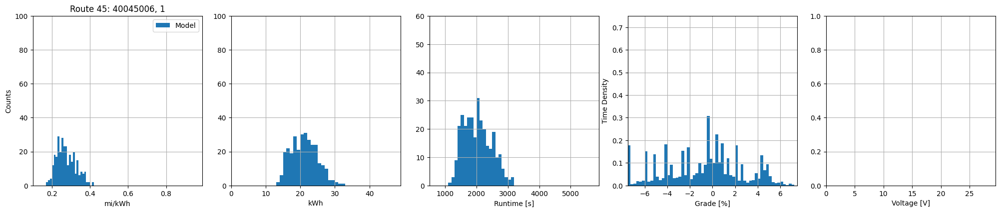

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1745321749578281), np.float64(0.4190333298263693), np.float64(0.275323520779469), np.float64(0.049745107498804834))
Energy min/max/mean/std [kWh]: 		(np.float64(13.457516508266757), np.float64(32.31007666646526), np.float64(21.142799102557234), np.float64(3.750300176234508))
Time min/max/mean/std [s]: 		(np.float64(1184.1920505147286), np.float64(3196.8459717172036), np.float64(2031.7325469425891), np.float64(436.31455424429487))
|Grade| mean/std [%]: 			(np.float64(2.5329363002338576), np.float64(1.8918106807788149))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



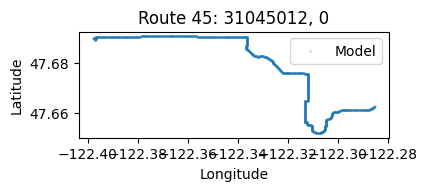

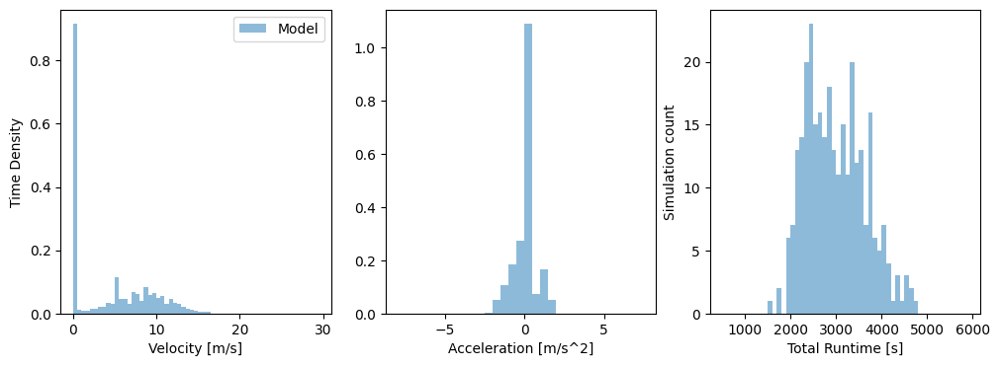

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


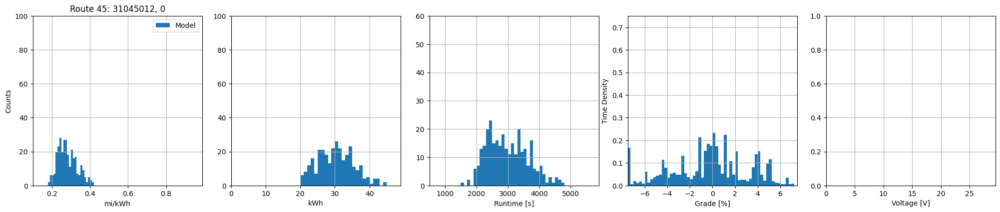

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18704438885843858), np.float64(0.4132564792373872), np.float64(0.28230039510186494), np.float64(0.049948013297657655))
Energy min/max/mean/std [kWh]: 		(np.float64(20.03566151745838), np.float64(44.266855522532325), np.float64(30.23294622962733), np.float64(5.227537275237544))
Time min/max/mean/std [s]: 		(np.float64(1595.0709838773648), np.float64(4791.395340074821), np.float64(2990.88255890206), np.float64(648.8275178215192))
|Grade| mean/std [%]: 			(np.float64(2.4402200642137553), np.float64(1.8824907488183906))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



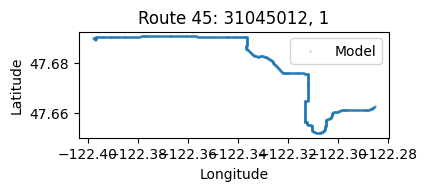

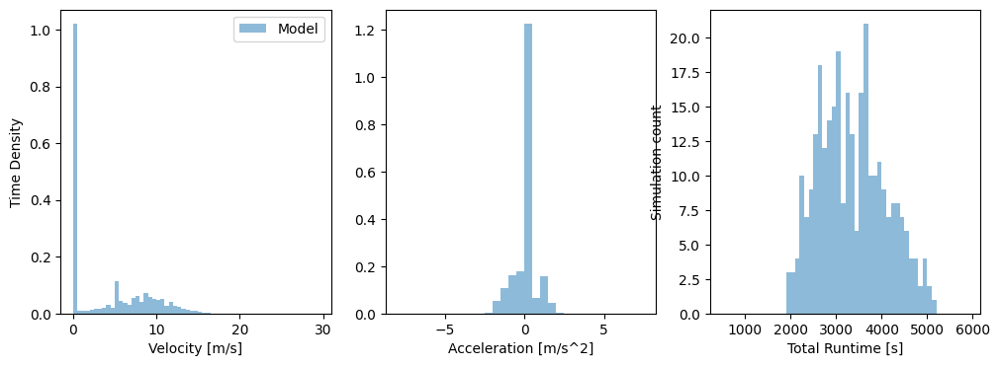

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


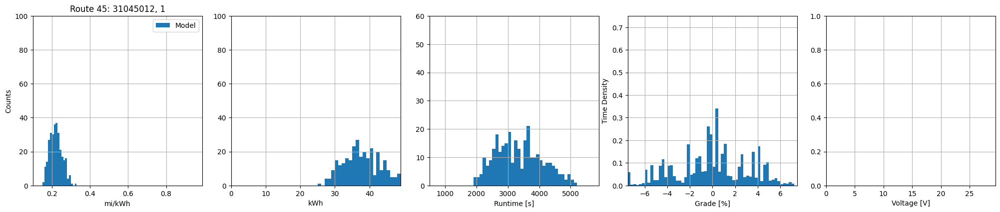

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15819753345655474), np.float64(0.3288605503050016), np.float64(0.22193605496280383), np.float64(0.03268272694506049))
Energy min/max/mean/std [kWh]: 		(np.float64(25.18187859861951), np.float64(52.348012467147775), np.float64(38.11846896962309), np.float64(5.565384013611735))
Time min/max/mean/std [s]: 		(np.float64(1931.083939601327), np.float64(5145.921164949561), np.float64(3356.8094219364034), np.float64(735.1108291443377))
|Grade| mean/std [%]: 			(np.float64(2.4085865909538073), np.float64(1.8466755325323592))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------48-------------------


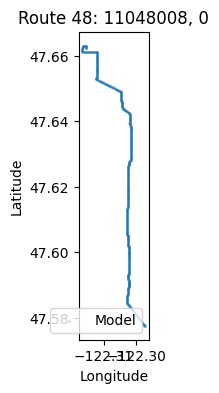

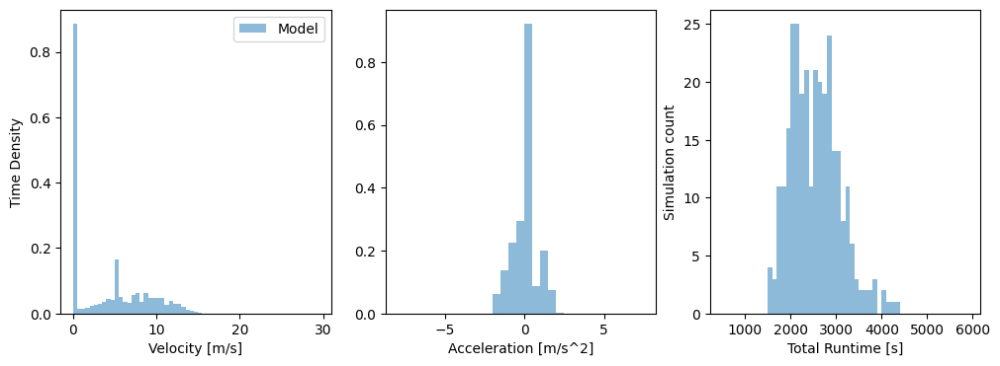

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


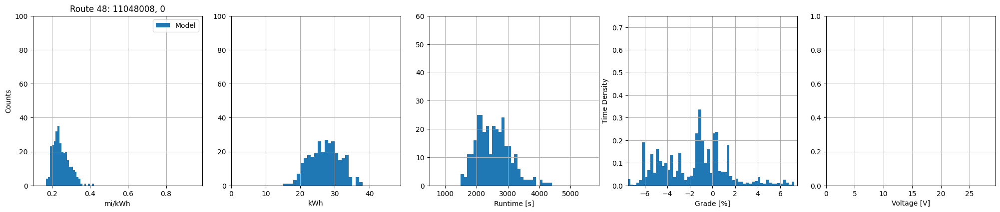

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1747959702468524), np.float64(0.41379684734493066), np.float64(0.24905244980506205), np.float64(0.04222904150089079))
Energy min/max/mean/std [kWh]: 		(np.float64(15.903247942288887), np.float64(37.647972386150585), np.float64(27.140351354009326), np.float64(4.3314761339017))
Time min/max/mean/std [s]: 		(np.float64(1534.0088543547408), np.float64(4341.794230094516), np.float64(2543.6723134551626), np.float64(535.3793205842424))
|Grade| mean/std [%]: 			(np.float64(2.5601766883212003), np.float64(2.011827608935441))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



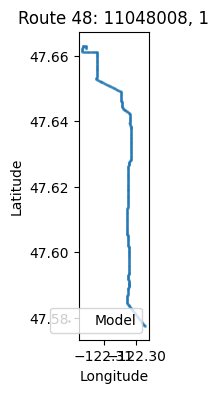

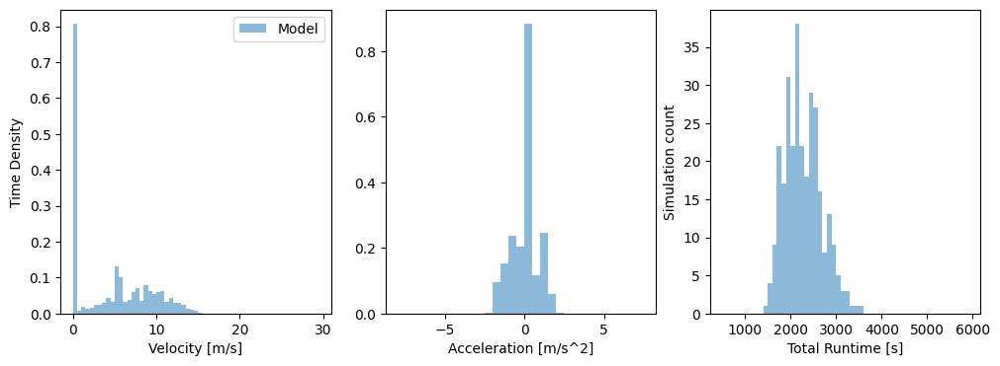

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


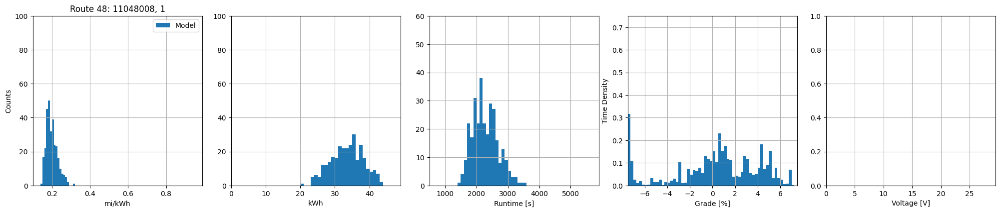

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.14969490465966942), np.float64(0.31851529178314336), np.float64(0.20023548803304347), np.float64(0.029653917958785768))
Energy min/max/mean/std [kWh]: 		(np.float64(20.66394858977654), np.float64(43.967986949376794), np.float64(33.54561070005062), np.float64(4.649398958079627))
Time min/max/mean/std [s]: 		(np.float64(1470.2993566197968), np.float64(3550.262457223218), np.float64(2281.5604855935153), np.float64(404.0208128578392))
|Grade| mean/std [%]: 			(np.float64(2.6768787115370576), np.float64(2.0503655784676273))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



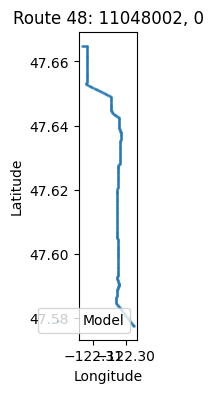

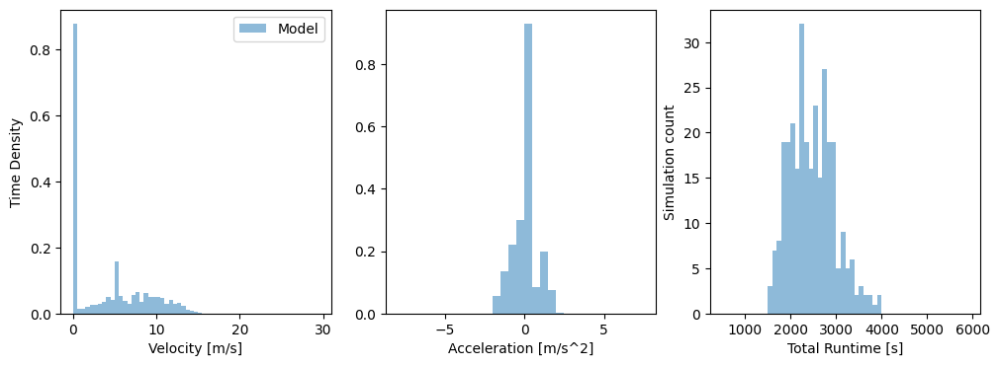

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


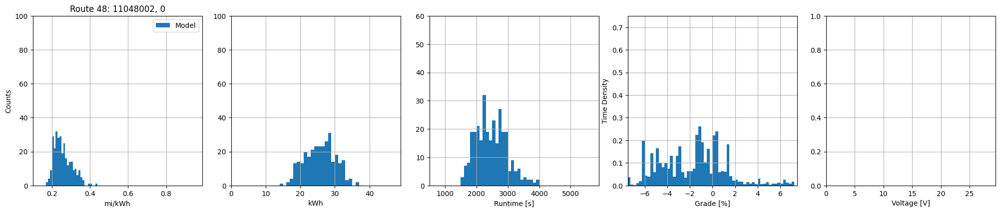

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1780544074948169), np.float64(0.43114040839351114), np.float64(0.2583523151398049), np.float64(0.0459760987521814))
Energy min/max/mean/std [kWh]: 		(np.float64(14.99141292330322), np.float64(36.300162299194184), np.float64(25.764224936015914), np.float64(4.293972418674576))
Time min/max/mean/std [s]: 		(np.float64(1526.234482912027), np.float64(3967.9751966762988), np.float64(2475.295575652396), np.float64(490.65536271413623))
|Grade| mean/std [%]: 			(np.float64(2.5738106398589395), np.float64(1.9859439994332524))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



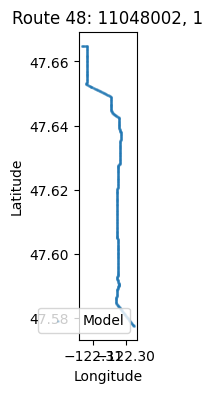

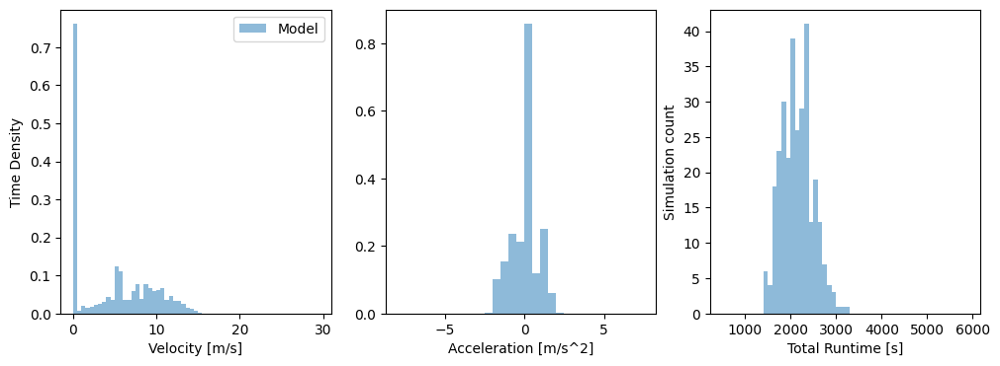

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


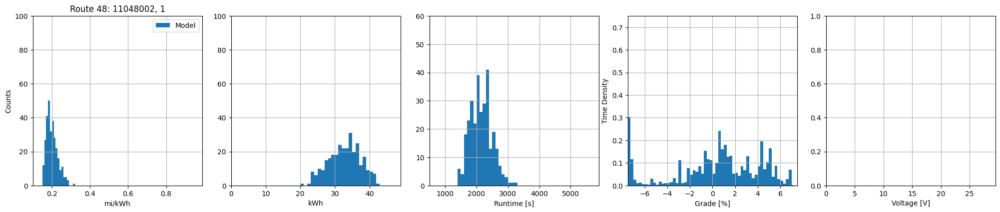

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15140959791141484), np.float64(0.317570999544116), np.float64(0.2013691622897022), np.float64(0.029962836206802398))
Energy min/max/mean/std [kWh]: 		(np.float64(20.353441551025735), np.float64(42.689914422094155), np.float64(32.76176888853454), np.float64(4.540905687979489))
Time min/max/mean/std [s]: 		(np.float64(1431.5222891748658), np.float64(3260.725647203526), np.float64(2147.6523440168403), np.float64(346.41425266114925))
|Grade| mean/std [%]: 			(np.float64(2.747293440856385), np.float64(2.0528161674996332))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



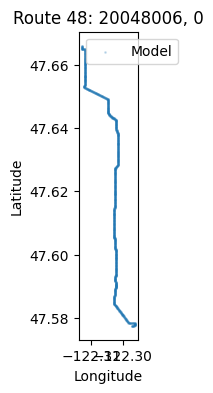

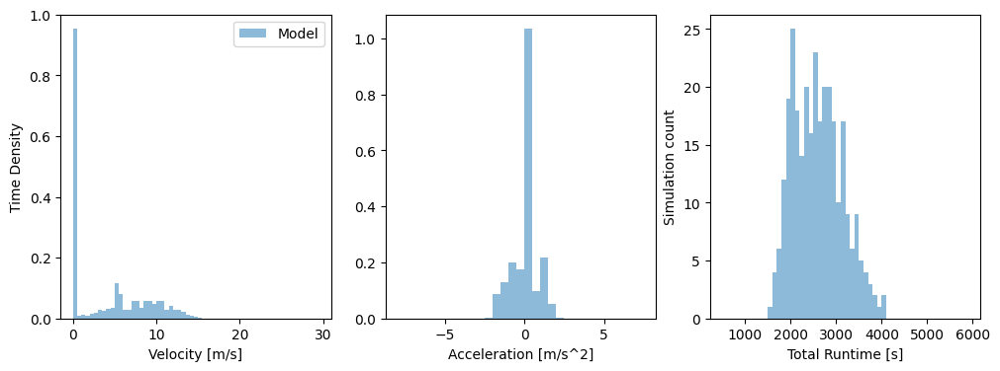

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


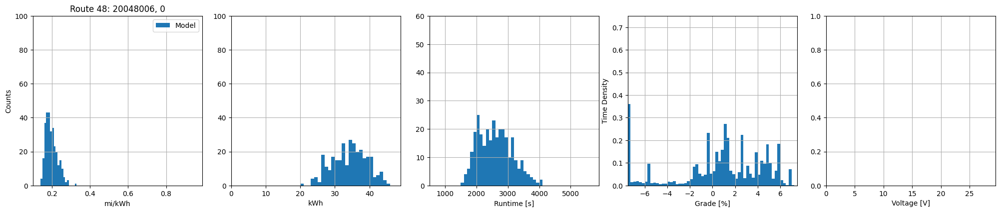

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.14631155465987222), np.float64(0.3208732147486904), np.float64(0.1979291687036125), np.float64(0.03095704784667992))
Energy min/max/mean/std [kWh]: 		(np.float64(20.651690228773617), np.float64(45.29084698132956), np.float64(34.2485303548668), np.float64(5.0164580722339))
Time min/max/mean/std [s]: 		(np.float64(1548.467707104437), np.float64(4057.245354594785), np.float64(2597.4376253393266), np.float64(532.3350369457145))
|Grade| mean/std [%]: 			(np.float64(2.8073601866966564), np.float64(2.0337682549575886))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



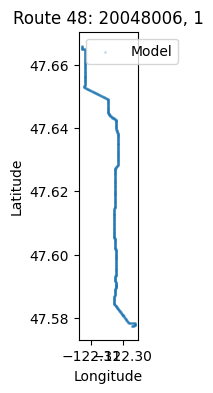

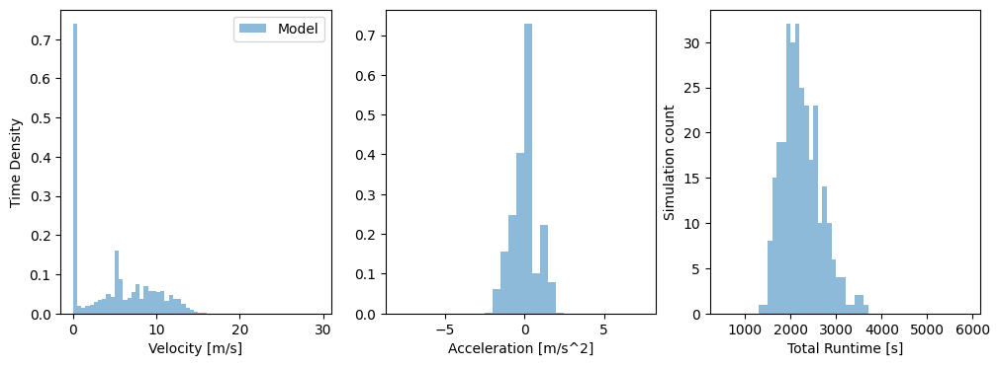

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


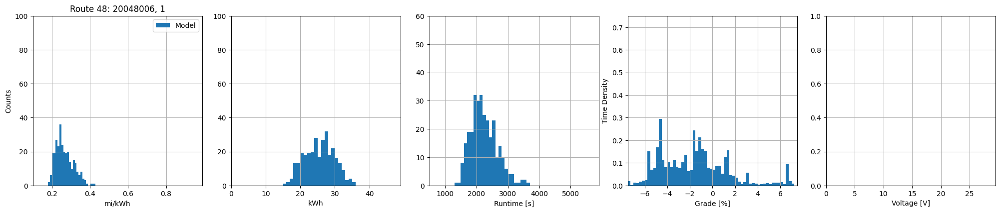

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18679556070368478), np.float64(0.4275581429220373), np.float64(0.26694492373716616), np.float64(0.0467365559346368))
Energy min/max/mean/std [kWh]: 		(np.float64(15.498229737611783), np.float64(35.47404606528036), np.float64(25.546981982259908), np.float64(4.229292221514539))
Time min/max/mean/std [s]: 		(np.float64(1375.9809317735728), np.float64(3656.5494615479993), np.float64(2239.083957985823), np.float64(422.1085730222782))
|Grade| mean/std [%]: 			(np.float64(2.790666712026), np.float64(1.8803616129089746))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



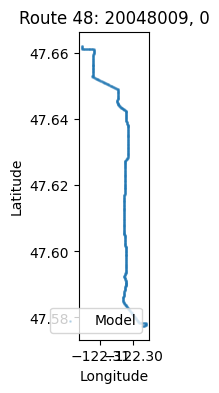

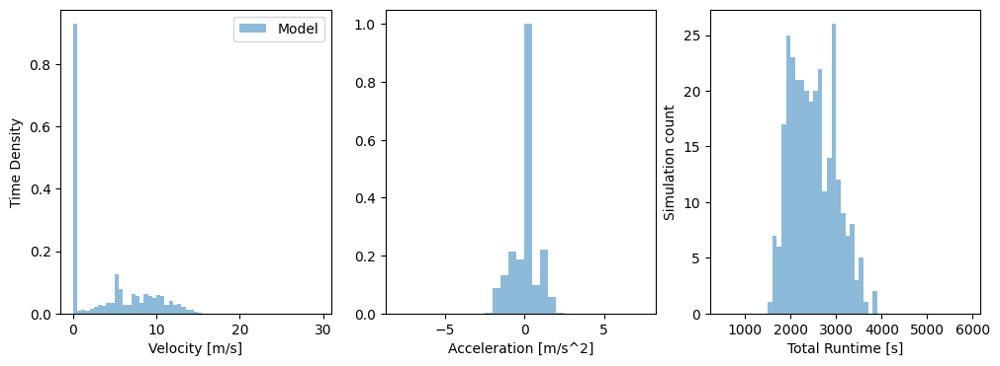

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


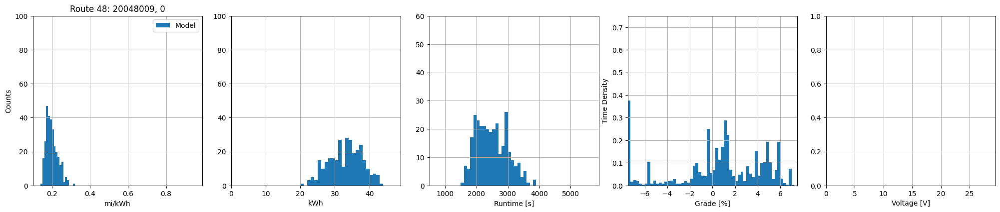

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.14964602453919276), np.float64(0.31156216435812056), np.float64(0.20012273062888114), np.float64(0.030656575292212006))
Energy min/max/mean/std [kWh]: 		(np.float64(20.785638183436706), np.float64(43.27557942109077), np.float64(33.07439057347525), np.float64(4.74813359553329))
Time min/max/mean/std [s]: 		(np.float64(1530.347503304725), np.float64(3879.390798422024), np.float64(2488.318389811754), np.float64(490.7597598853448))
|Grade| mean/std [%]: 			(np.float64(2.7940656347849315), np.float64(2.088203414349087))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



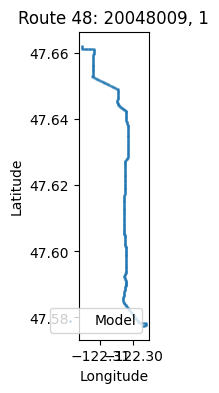

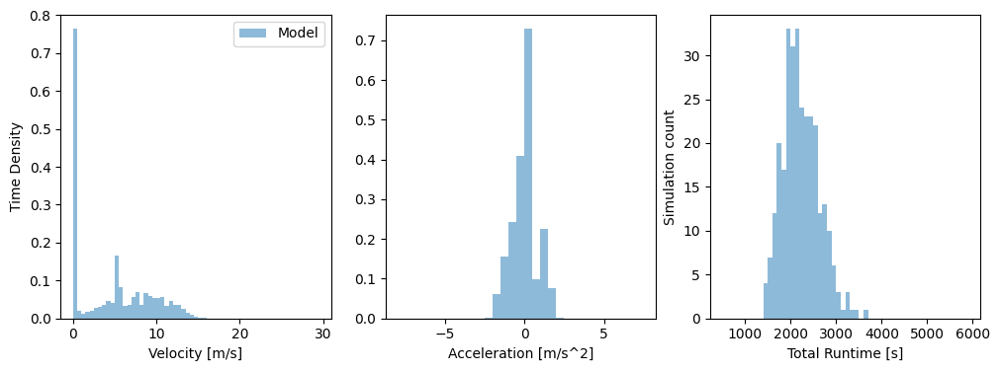

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


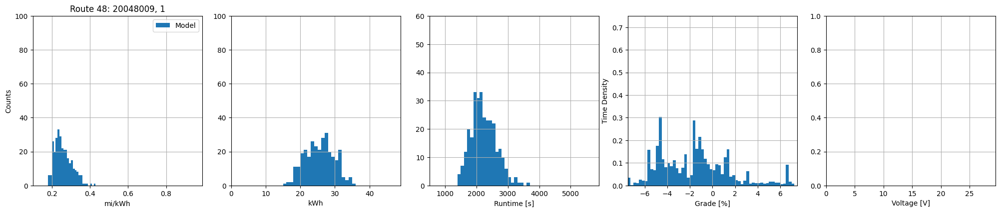

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18299267799251426), np.float64(0.42304412634867034), np.float64(0.2596536803120915), np.float64(0.04434811264692859))
Energy min/max/mean/std [kWh]: 		(np.float64(15.307166177301397), np.float64(35.38724507116774), np.float64(25.629429694246202), np.float64(4.132991884765887))
Time min/max/mean/std [s]: 		(np.float64(1407.0517439501891), np.float64(3662.517293339978), np.float64(2226.402120984266), np.float64(398.84236457770527))
|Grade| mean/std [%]: 			(np.float64(2.814991136296246), np.float64(1.8938668091097486))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------49-------------------


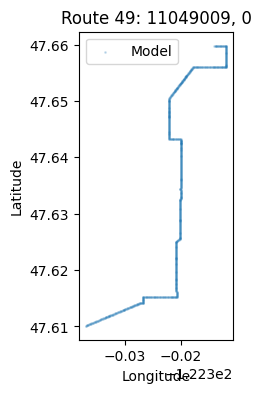

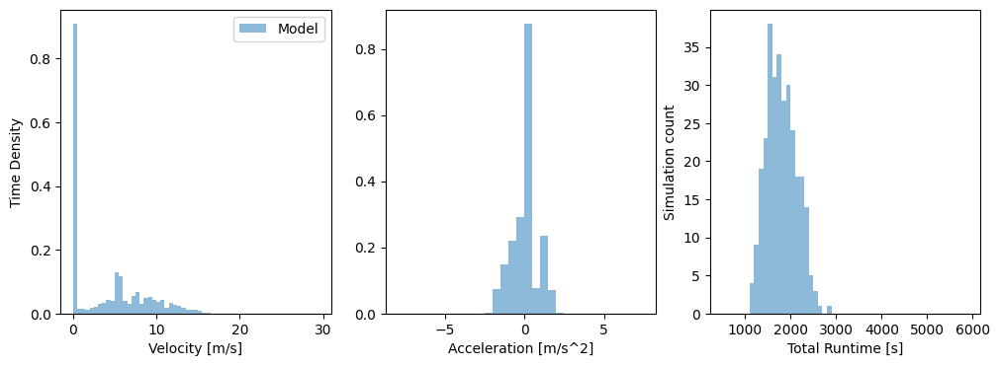

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


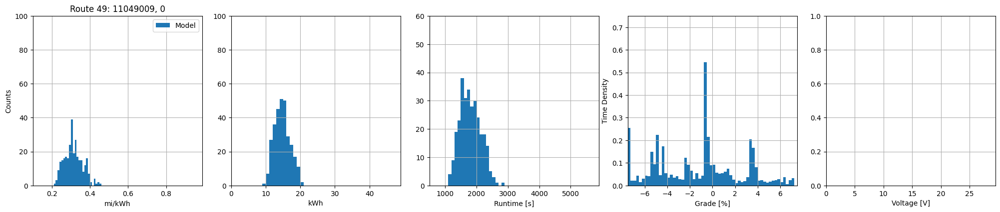

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21672013453242975), np.float64(0.4550230454787467), np.float64(0.3142116450992539), np.float64(0.047768733293553))
Energy min/max/mean/std [kWh]: 		(np.float64(9.964587982147417), np.float64(20.921531727358527), np.float64(14.762550935391161), np.float64(2.231753380191685))
Time min/max/mean/std [s]: 		(np.float64(1156.1471626164985), np.float64(2814.3246339742127), np.float64(1805.2301646535673), np.float64(324.96527708413805))
|Grade| mean/std [%]: 			(np.float64(2.865008335954735), np.float64(2.041432948206028))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



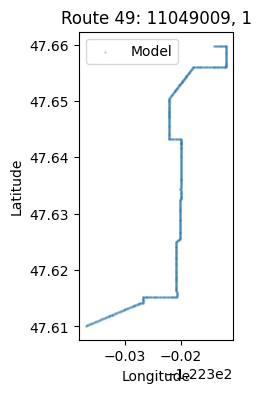

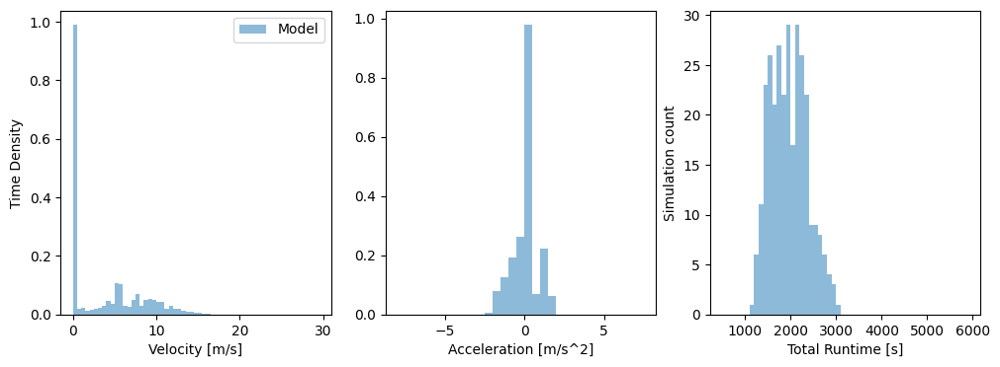

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


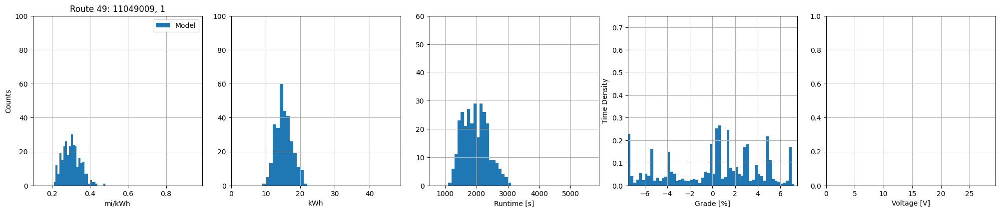

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21303624698301787), np.float64(0.4786153315776888), np.float64(0.3035792619297735), np.float64(0.046523833769744186))
Energy min/max/mean/std [kWh]: 		(np.float64(9.47266836963634), np.float64(21.28165688640013), np.float64(15.281244839854201), np.float64(2.31338050973252))
Time min/max/mean/std [s]: 		(np.float64(1157.588078709327), np.float64(3022.115957797899), np.float64(1966.51153753724), np.float64(403.13036142976244))
|Grade| mean/std [%]: 			(np.float64(3.0484582293710076), np.float64(2.114060278677187))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



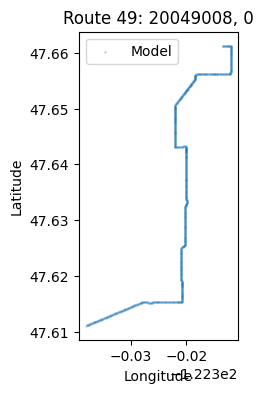

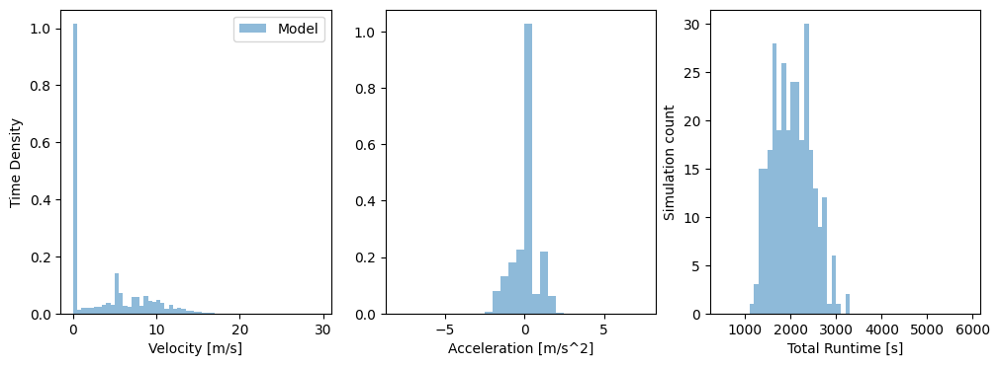

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


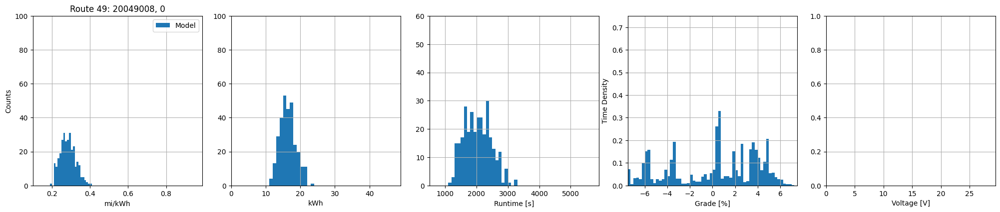

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19321528591127857), np.float64(0.4024440144786494), np.float64(0.28427962886231445), np.float64(0.03963460296779851))
Energy min/max/mean/std [kWh]: 		(np.float64(11.386774748517775), np.float64(23.717271230092205), np.float64(16.432237262499857), np.float64(2.282737653298745))
Time min/max/mean/std [s]: 		(np.float64(1190.9813755963119), np.float64(3240.8823954515456), np.float64(2039.7183334256592), np.float64(430.26940216160324))
|Grade| mean/std [%]: 			(np.float64(3.2199419377571474), np.float64(1.9220738118967984))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



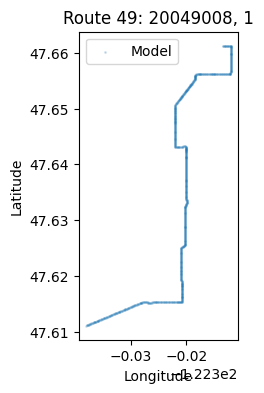

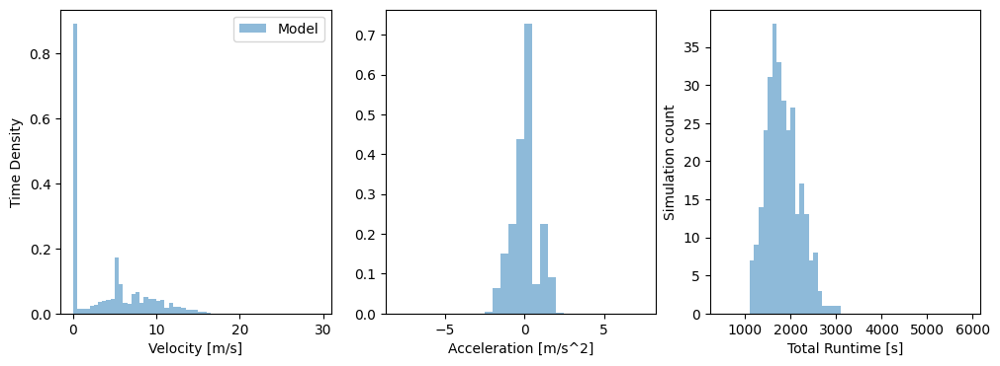

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


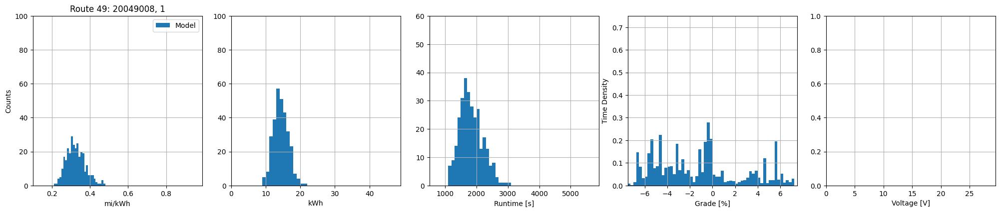

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21625695533136147), np.float64(0.47148368906255317), np.float64(0.3258349904386743), np.float64(0.048540736624197))
Energy min/max/mean/std [kWh]: 		(np.float64(9.71981126394568), np.float64(21.19114487991814), np.float64(14.372332717663182), np.float64(2.1121088568750324))
Time min/max/mean/std [s]: 		(np.float64(1149.8657872378444), np.float64(3041.45708010301), np.float64(1830.3571926111488), np.float64(362.3065637833533))
|Grade| mean/std [%]: 			(np.float64(3.3514750994340337), np.float64(2.128447045898337))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



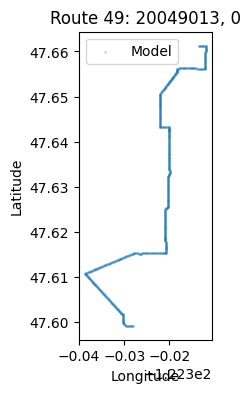

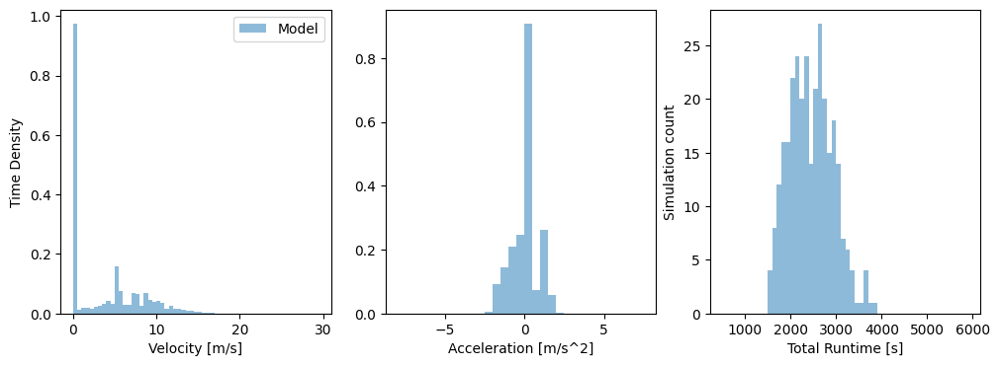

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


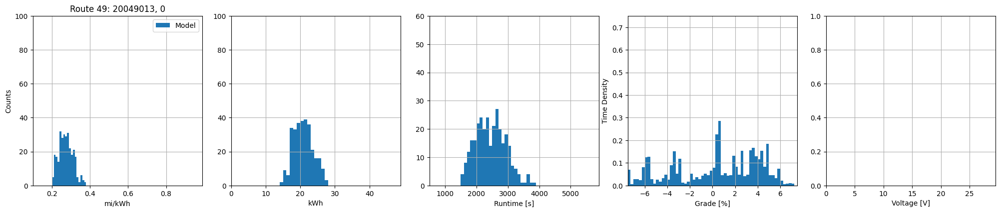

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2019991658443273), np.float64(0.3780186744380217), np.float64(0.2741283448521147), np.float64(0.03686030467823194))
Energy min/max/mean/std [kWh]: 		(np.float64(14.871493336736409), np.float64(27.830323826185452), np.float64(20.877340927589746), np.float64(2.7953363470223587))
Time min/max/mean/std [s]: 		(np.float64(1517.6546239009817), np.float64(3874.2463760873984), np.float64(2452.8624057261422), np.float64(473.2546501122537))
|Grade| mean/std [%]: 			(np.float64(3.1328123735747306), np.float64(1.8954528566311546))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



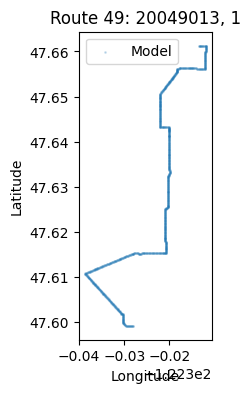

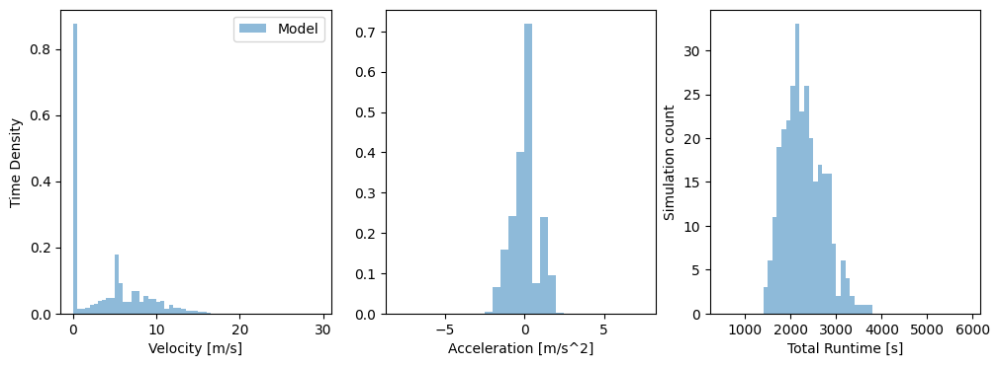

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


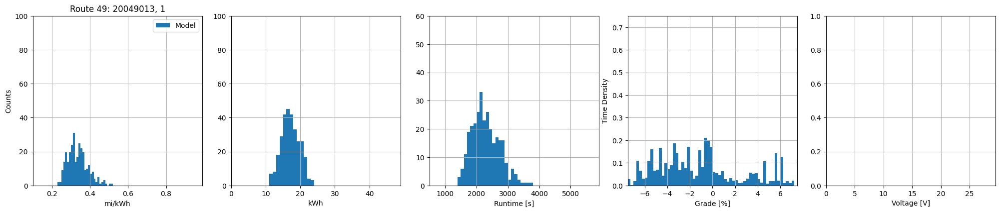

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.23633757788694204), np.float64(0.5109673716994002), np.float64(0.3355812690001908), np.float64(0.05280756818785487))
Energy min/max/mean/std [kWh]: 		(np.float64(11.002582532019382), np.float64(23.78784080194424), np.float64(17.15195974238471), np.float64(2.5923256300105866))
Time min/max/mean/std [s]: 		(np.float64(1435.4500182610068), np.float64(3737.890185037827), np.float64(2293.965789752106), np.float64(440.52154362570957))
|Grade| mean/std [%]: 			(np.float64(3.2108229802430257), np.float64(2.0553214508306694))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------5-------------------


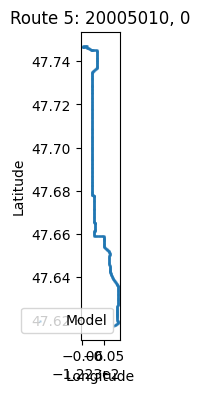

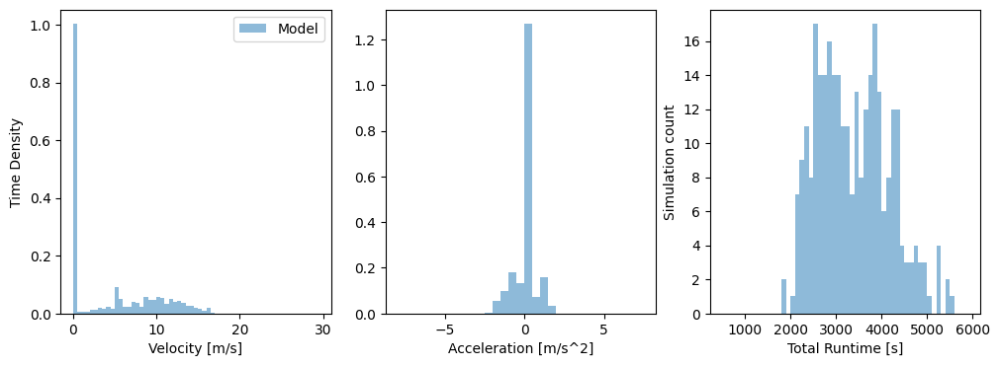

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


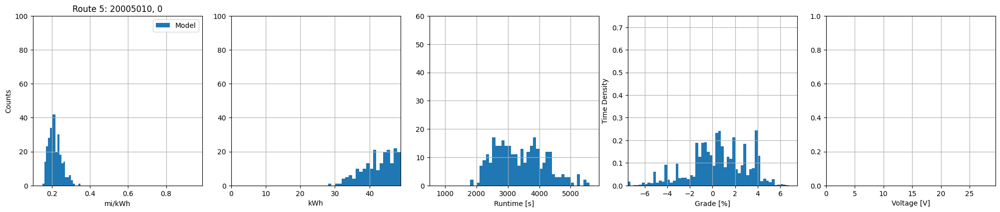

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15996480036713542), np.float64(0.3403402768574533), np.float64(0.2168312601086987), np.float64(0.0328665444319542))
Energy min/max/mean/std [kWh]: 		(np.float64(28.44602810145623), np.float64(60.52162136498078), np.float64(45.62431200860046), np.float64(6.568950114134979))
Time min/max/mean/std [s]: 		(np.float64(1832.532681649826), np.float64(5914.930279411161), np.float64(3394.880784393824), np.float64(801.5243593367823))
|Grade| mean/std [%]: 			(np.float64(2.0337564692333756), np.float64(1.5118752569573732))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



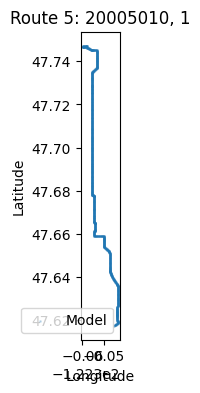

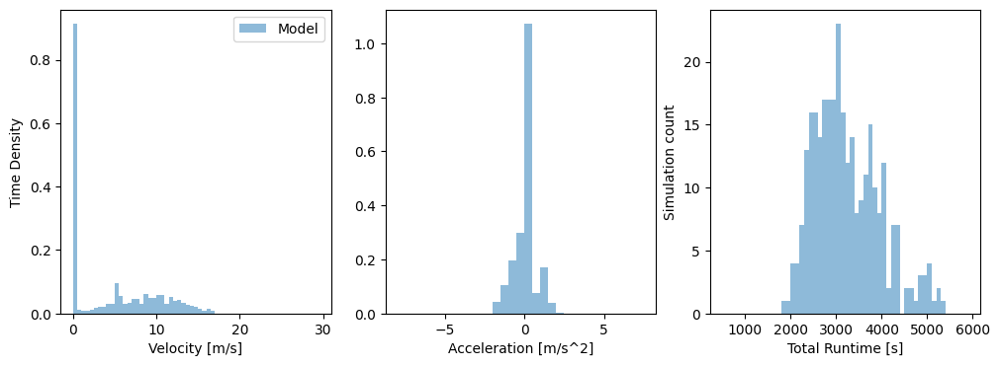

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


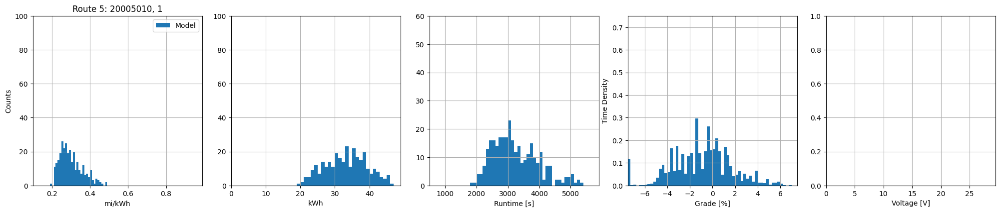

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19473262027033536), np.float64(0.4865693698729656), np.float64(0.30145215000468784), np.float64(0.0598505088516392))
Energy min/max/mean/std [kWh]: 		(np.float64(19.893847224642396), np.float64(49.70783372095293), np.float64(33.29968470745223), np.float64(6.159649878132602))
Time min/max/mean/std [s]: 		(np.float64(1871.962383588116), np.float64(5372.4407964320035), np.float64(3240.7125119605867), np.float64(724.7298747537873))
|Grade| mean/std [%]: 			(np.float64(1.9528643710934752), np.float64(1.4707380309278324))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



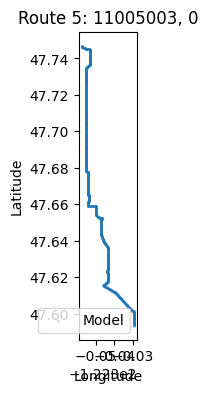

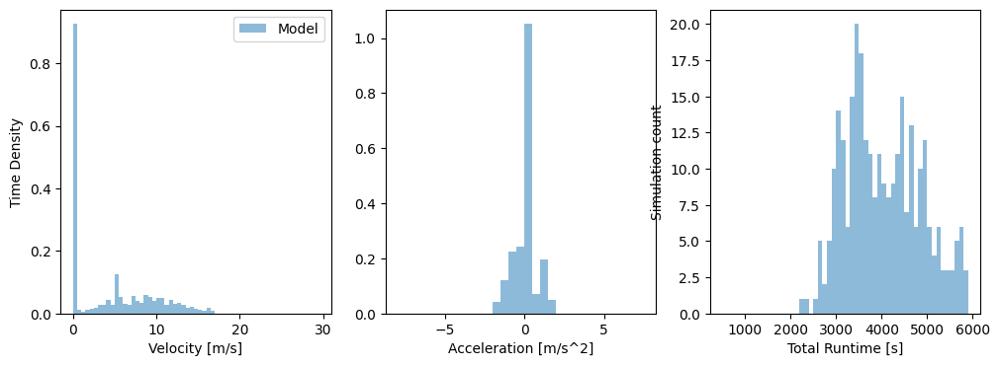

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


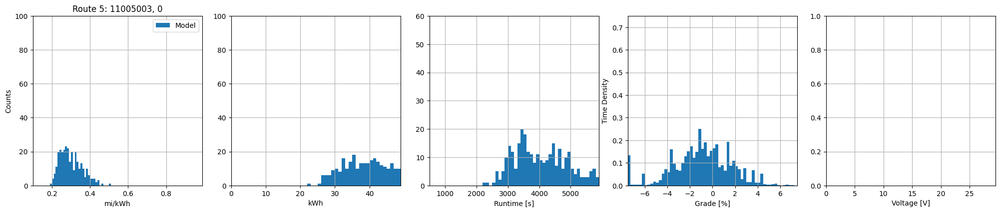

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19642238146048627), np.float64(0.5061578680253099), np.float64(0.3014286217554223), np.float64(0.058093684352894685))
Energy min/max/mean/std [kWh]: 		(np.float64(22.854355442513683), np.float64(58.89304334802828), np.float64(39.752586116039794), np.float64(7.328757165052425))
Time min/max/mean/std [s]: 		(np.float64(2261.885988842754), np.float64(6858.944819586589), np.float64(4109.418228215434), np.float64(902.7552463610984))
|Grade| mean/std [%]: 			(np.float64(1.9300920112783566), np.float64(1.4151342462422136))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



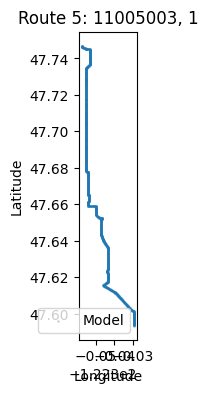

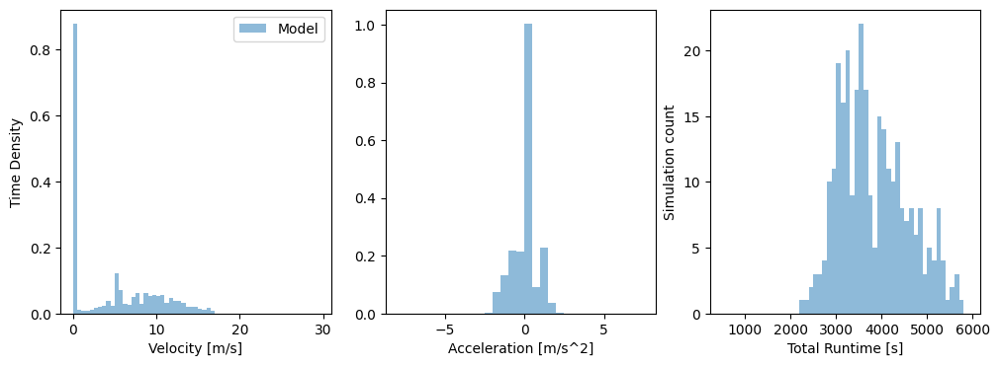

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


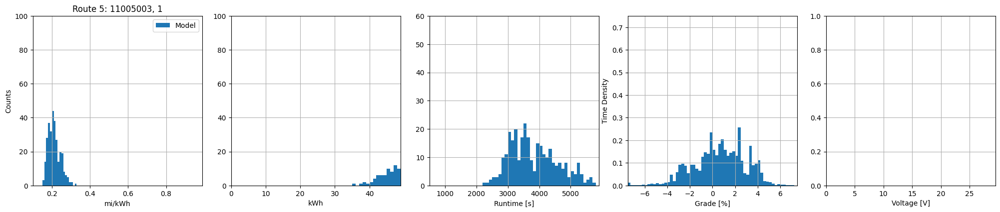

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15637950897613276), np.float64(0.32665634086178164), np.float64(0.21268051907796404), np.float64(0.03145640470083441))
Energy min/max/mean/std [kWh]: 		(np.float64(35.407317733262666), np.float64(73.96125570546015), np.float64(55.51828354550402), np.float64(7.828263236980877))
Time min/max/mean/std [s]: 		(np.float64(2239.4894489242897), np.float64(5714.720848540437), np.float64(3829.1835969831436), np.float64(755.1063862868181))
|Grade| mean/std [%]: 			(np.float64(1.9092628079360439), np.float64(1.3579586328334607))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



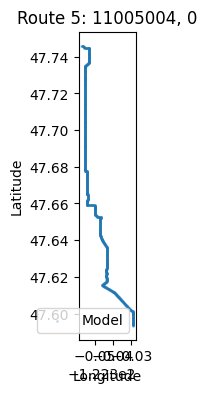

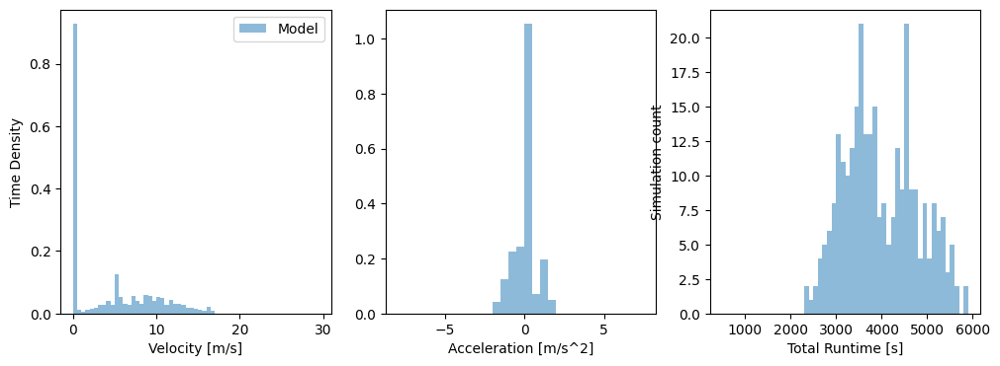

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


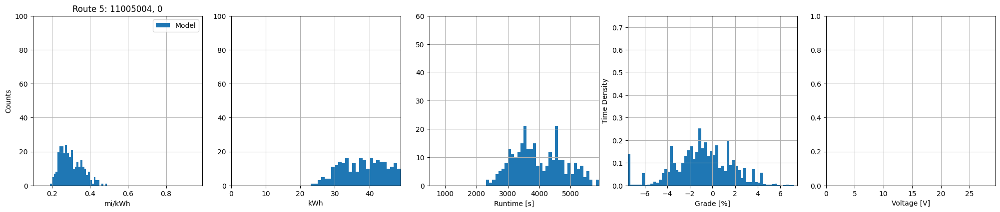

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19890668836067532), np.float64(0.48547356415600224), np.float64(0.3012054928031753), np.float64(0.058298949082475626))
Energy min/max/mean/std [kWh]: 		(np.float64(23.664123596483595), np.float64(57.75726557862863), np.float64(39.52241464239077), np.float64(7.320386182555591))
Time min/max/mean/std [s]: 		(np.float64(2303.455672167865), np.float64(6881.127020661126), np.float64(4081.116280749414), np.float64(902.5122643930205))
|Grade| mean/std [%]: 			(np.float64(1.9617710477685755), np.float64(1.4142090976271071))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



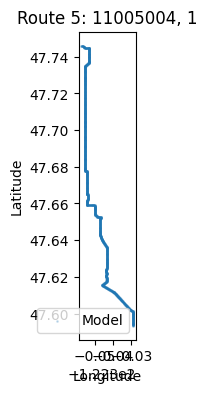

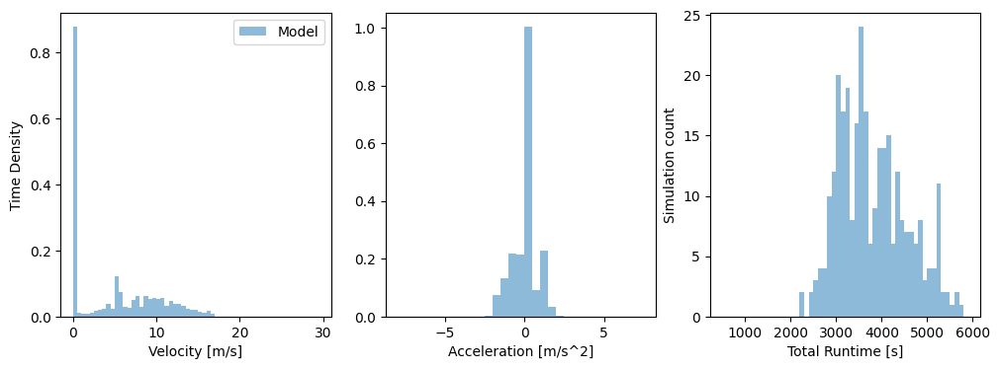

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


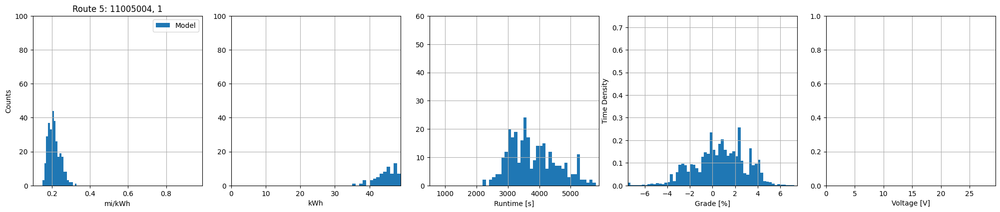

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15650561408640762), np.float64(0.326814301926984), np.float64(0.21237890378031346), np.float64(0.03132115360081035))
Energy min/max/mean/std [kWh]: 		(np.float64(35.14701255506622), np.float64(73.39382960831759), np.float64(55.20760015829387), np.float64(7.7561110076922235))
Time min/max/mean/std [s]: 		(np.float64(2232.312848030695), np.float64(5703.12692713545), np.float64(3804.4090838239313), np.float64(749.0797812484626))
|Grade| mean/std [%]: 			(np.float64(1.908794233801387), np.float64(1.3576799640382622))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------50-------------------


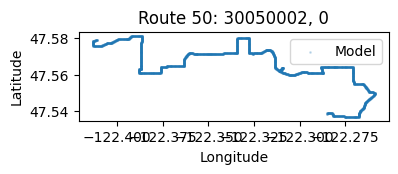

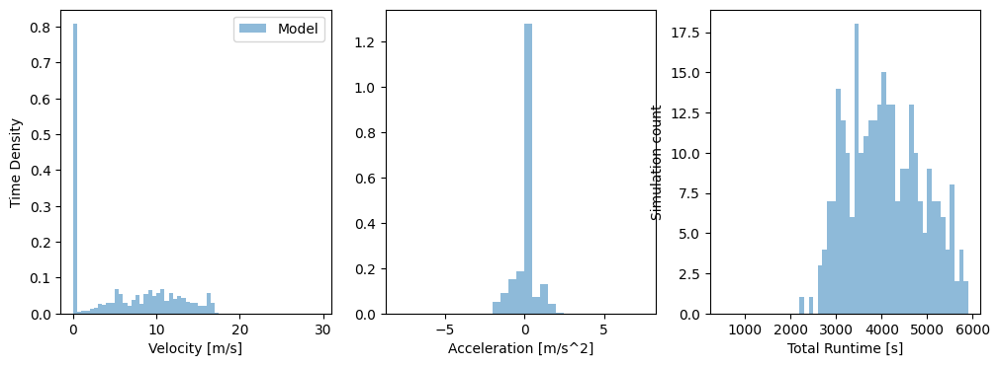

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


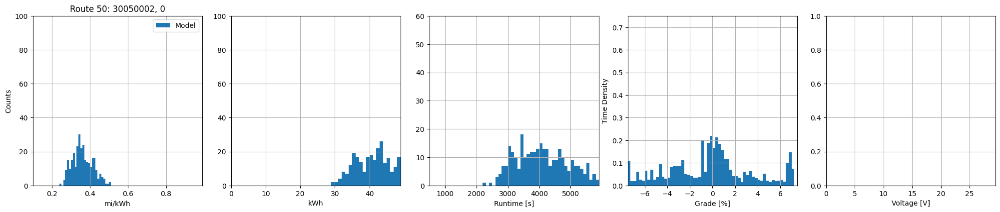

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.24315729216096735), np.float64(0.5056559016969526), np.float64(0.3621654659774122), np.float64(0.053131163343386814))
Energy min/max/mean/std [kWh]: 		(np.float64(29.72556054822466), np.float64(61.81556386353247), np.float64(42.39798690650481), np.float64(6.2140542379977415))
Time min/max/mean/std [s]: 		(np.float64(2292.333553681408), np.float64(6687.9764112394605), np.float64(4145.99011829627), np.float64(881.6410600359206))
|Grade| mean/std [%]: 			(np.float64(2.686520839268218), np.float64(2.2513749842077675))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



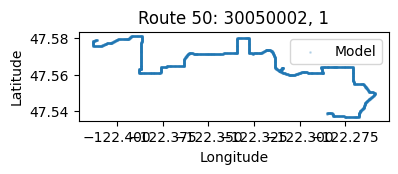

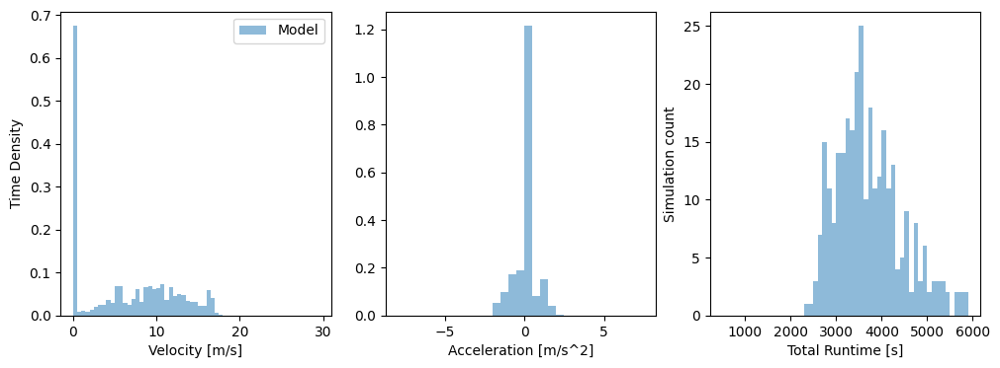

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


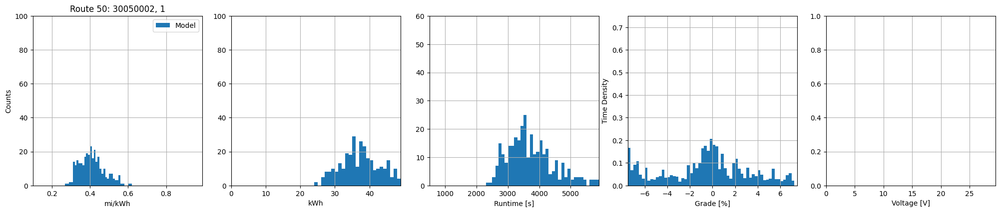

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.27230901191709195), np.float64(0.6137949621302924), np.float64(0.410206506098314), np.float64(0.06495096227749364))
Energy min/max/mean/std [kWh]: 		(np.float64(24.486379913512657), np.float64(55.19323993690822), np.float64(37.53742289264089), np.float64(5.801043534967571))
Time min/max/mean/std [s]: 		(np.float64(2309.330533775587), np.float64(5859.40838627942), np.float64(3725.5653635347403), np.float64(728.1944732678808))
|Grade| mean/std [%]: 			(np.float64(2.743622902625167), np.float64(2.2558108726207884))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



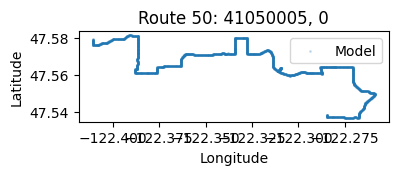

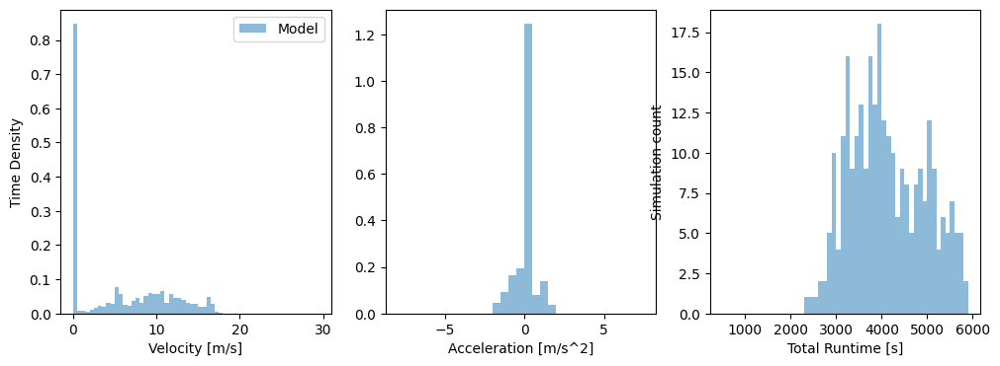

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


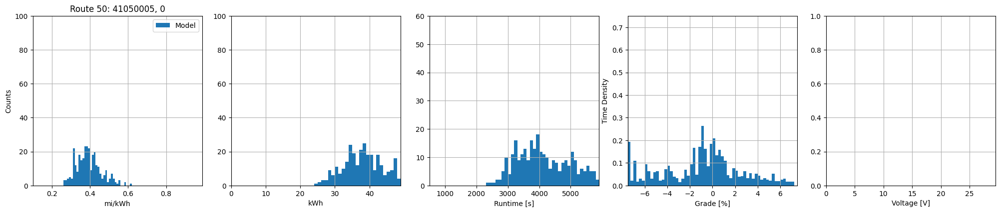

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.26161527116606587), np.float64(0.6135494767576346), np.float64(0.3940018172517535), np.float64(0.06495174105303393))
Energy min/max/mean/std [kWh]: 		(np.float64(24.1894030882505), np.float64(56.72985197586082), np.float64(38.6720378174496), np.float64(6.250226093310651))
Time min/max/mean/std [s]: 		(np.float64(2362.2508143615605), np.float64(7043.021084859582), np.float64(4257.5427569108415), np.float64(964.5360848670952))
|Grade| mean/std [%]: 			(np.float64(2.4937680771319686), np.float64(2.0929458083352013))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



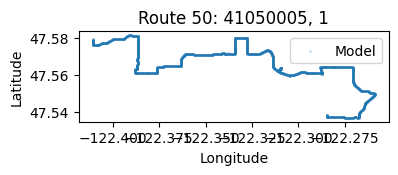

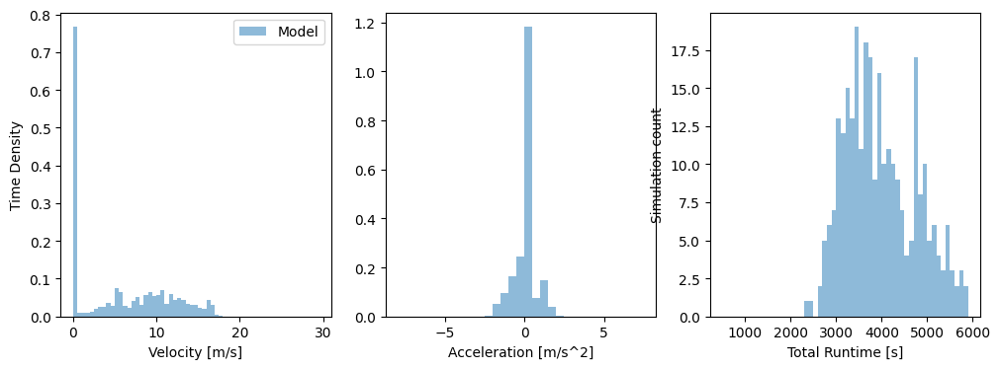

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


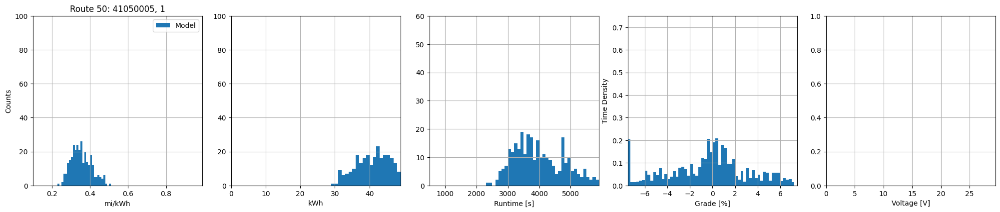

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.2378498249043643), np.float64(0.5012261257259016), np.float64(0.3542522440773779), np.float64(0.05215176721145861))
Energy min/max/mean/std [kWh]: 		(np.float64(29.61361575027141), np.float64(62.40541861745018), np.float64(42.80068276095877), np.float64(6.2384757203546))
Time min/max/mean/std [s]: 		(np.float64(2312.1781225395084), np.float64(6474.284243611092), np.float64(4052.870908805725), np.float64(857.9759821646139))
|Grade| mean/std [%]: 			(np.float64(2.4624941931705924), np.float64(2.0094686853521755))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------62-------------------


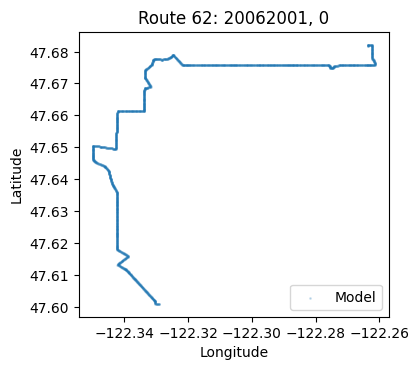

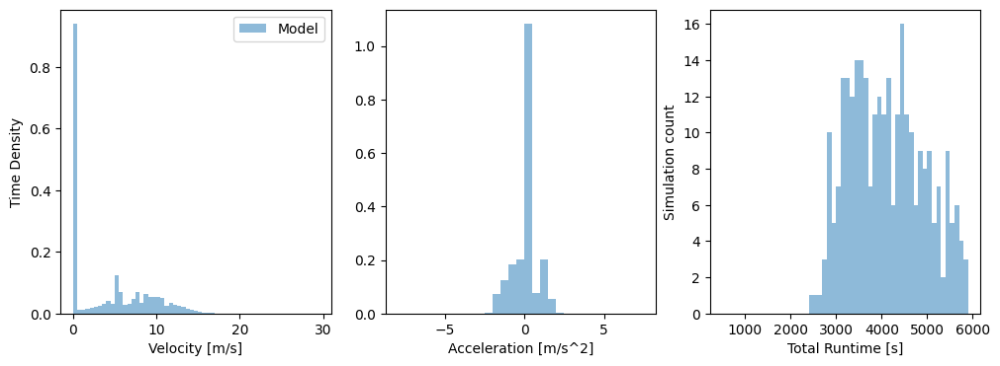

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


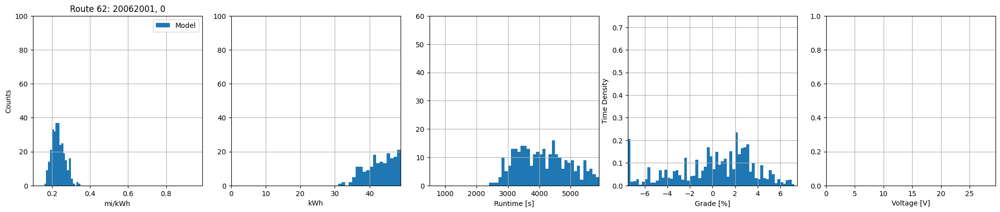

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16981042916410224), np.float64(0.3465316671385498), np.float64(0.23469722824060113), np.float64(0.03372332651256372))
Energy min/max/mean/std [kWh]: 		(np.float64(31.07406747324258), np.float64(63.412762450958546), np.float64(46.80707047244068), np.float64(6.564016389851986))
Time min/max/mean/std [s]: 		(np.float64(2473.306476951253), np.float64(6879.211730797982), np.float64(4204.262933213887), np.float64(906.1709575307042))
|Grade| mean/std [%]: 			(np.float64(2.594916592511305), np.float64(1.7575147523616435))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



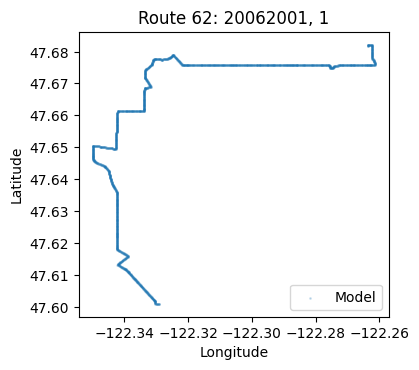

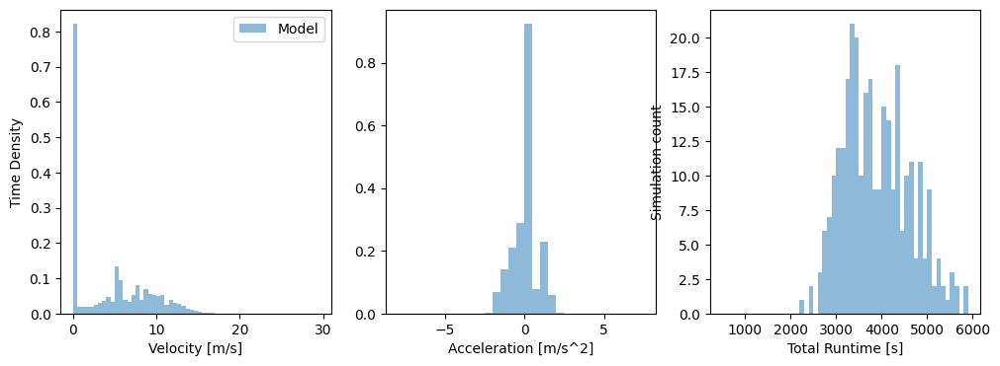

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


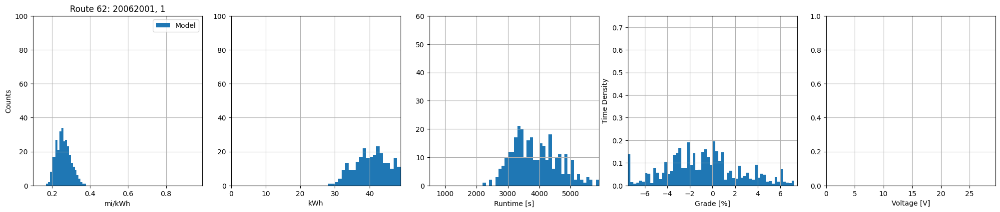

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17945359749072107), np.float64(0.3767477153900304), np.float64(0.2606387962184372), np.float64(0.03809300548636675))
Energy min/max/mean/std [kWh]: 		(np.float64(28.582895952283224), np.float64(60.00738296600856), np.float64(42.20008729164958), np.float64(6.166424531257404))
Time min/max/mean/std [s]: 		(np.float64(2205.9696341295585), np.float64(5910.7881910384585), np.float64(3891.027922455625), np.float64(738.7791668076031))
|Grade| mean/std [%]: 			(np.float64(2.548072549328514), np.float64(1.8407536082023261))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



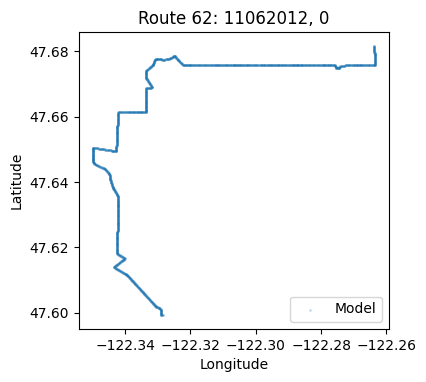

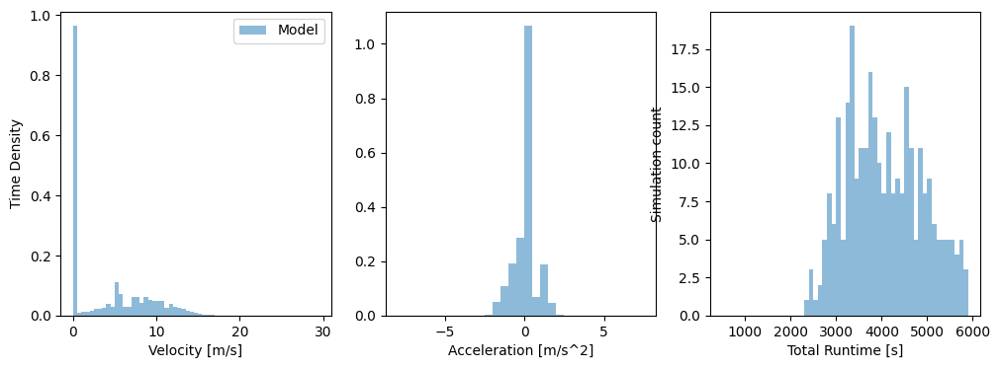

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


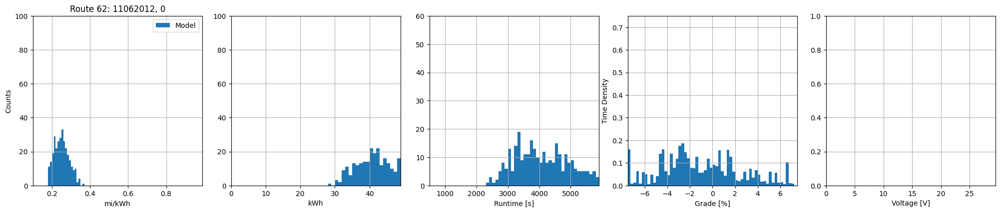

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18057112085395424), np.float64(0.36736192392321515), np.float64(0.25177202921115904), np.float64(0.03863242537785995))
Energy min/max/mean/std [kWh]: 		(np.float64(28.946576062072804), np.float64(58.89020250227842), np.float64(43.226898669074494), np.float64(6.580268334502224))
Time min/max/mean/std [s]: 		(np.float64(2323.6684324285916), np.float64(6904.990116420436), np.float64(4156.1152686838095), np.float64(935.0365353705942))
|Grade| mean/std [%]: 			(np.float64(2.8589354589197065), np.float64(1.8391870537598456))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



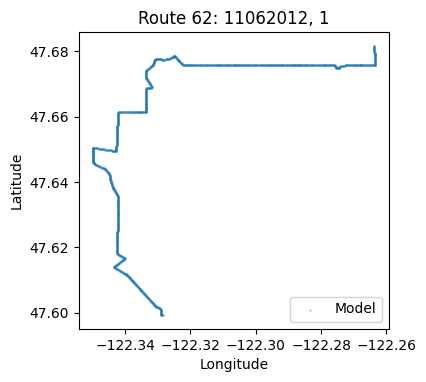

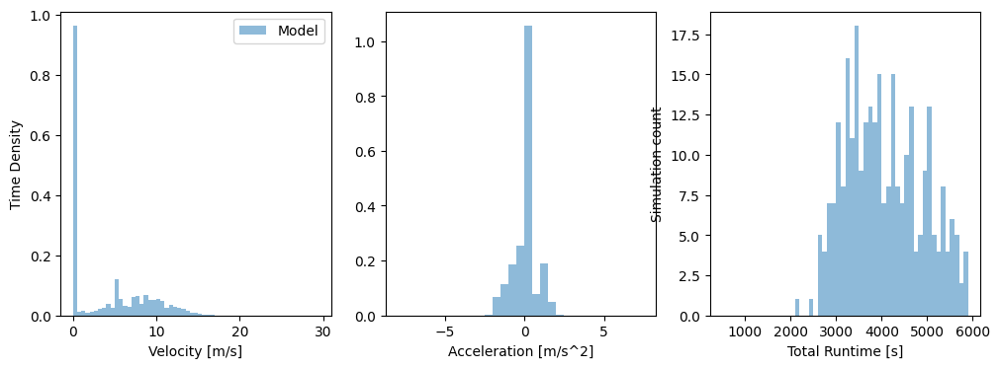

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


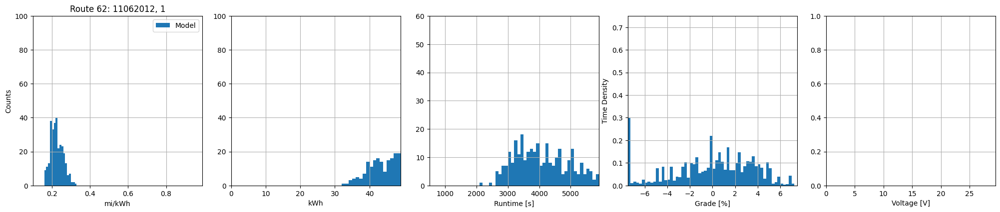

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1656204295195007), np.float64(0.3252840021801234), np.float64(0.22606824130073552), np.float64(0.03266965097989231))
Energy min/max/mean/std [kWh]: 		(np.float64(32.68842729432977), np.float64(64.20115251555727), np.float64(48.0002387786178), np.float64(6.805003217311579))
Time min/max/mean/std [s]: 		(np.float64(2131.6466033118513), np.float64(7197.436649309168), np.float64(4156.885253034402), np.float64(947.4245545635166))
|Grade| mean/std [%]: 			(np.float64(2.566608815685024), np.float64(1.7582598818541904))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



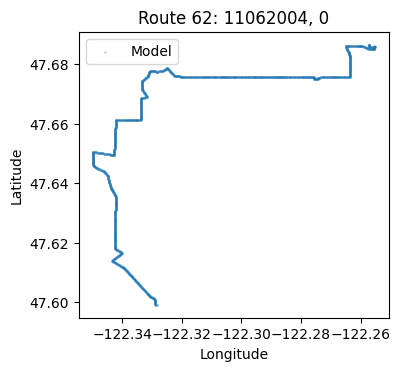

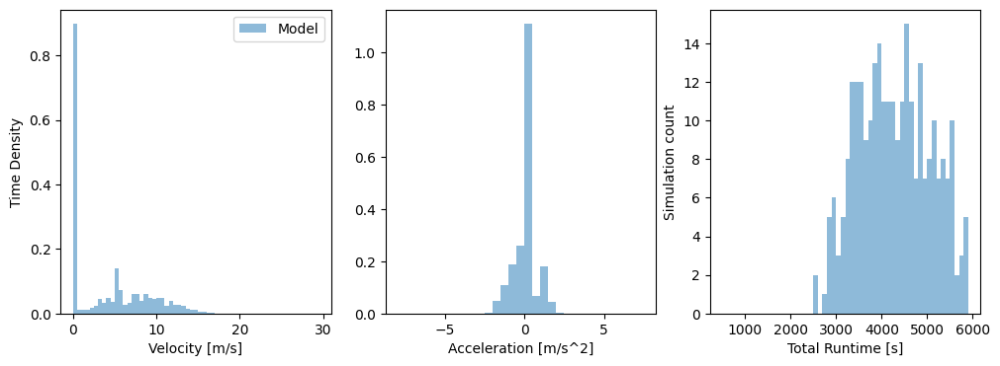

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


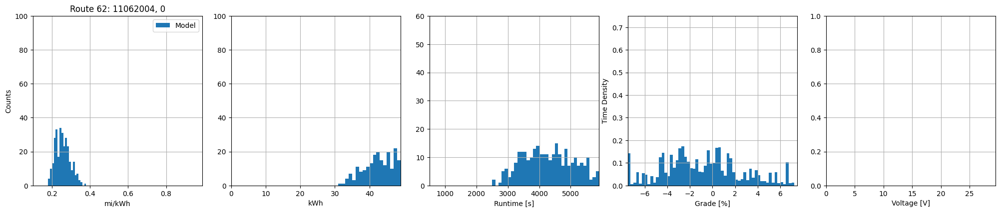

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18447605978948453), np.float64(0.3704674446406982), np.float64(0.25699393790760705), np.float64(0.03795071599683839))
Energy min/max/mean/std [kWh]: 		(np.float64(31.404085725497758), np.float64(63.066131200324726), np.float64(46.24316371110547), np.float64(6.709715101606767))
Time min/max/mean/std [s]: 		(np.float64(2533.1113491682754), np.float64(7784.871040883863), np.float64(4430.983496165968), np.float64(937.6905772923227))
|Grade| mean/std [%]: 			(np.float64(2.728700083821717), np.float64(1.8827414344576208))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



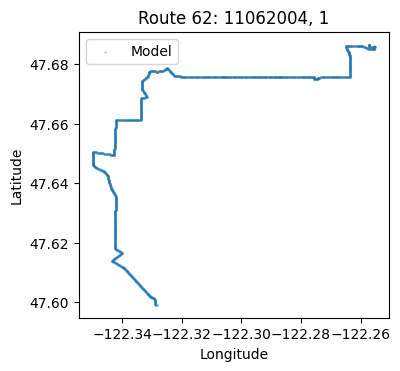

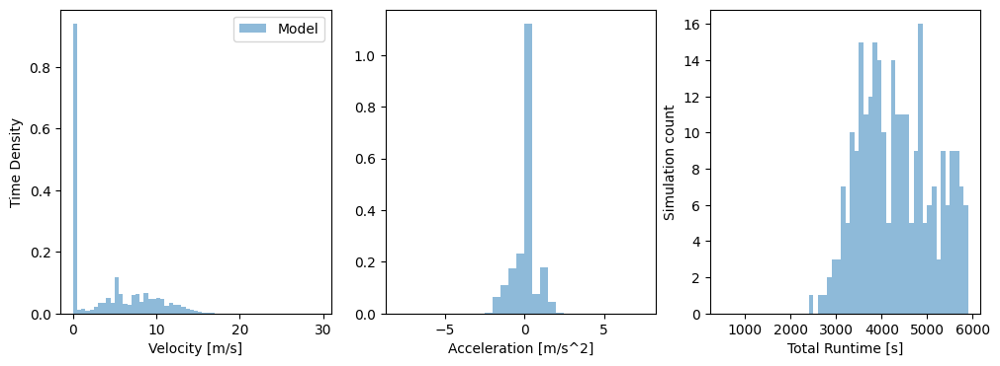

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


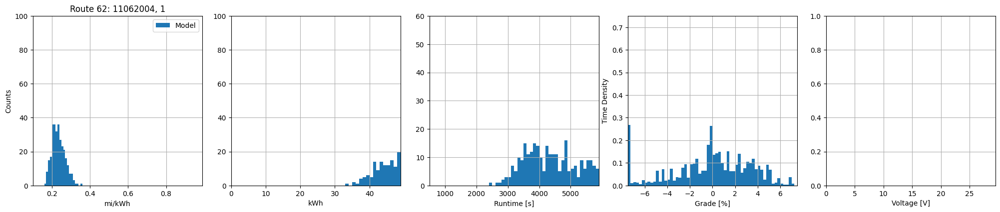

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16724661634972127), np.float64(0.3522426904117747), np.float64(0.235030269401013), np.float64(0.033668030660915))
Energy min/max/mean/std [kWh]: 		(np.float64(33.02756268267446), np.float64(69.56025653016549), np.float64(50.4921914188007), np.float64(7.065804701707843))
Time min/max/mean/std [s]: 		(np.float64(2454.705541650753), np.float64(7546.926452751069), np.float64(4561.136183557371), np.float64(1025.5870806681912))
|Grade| mean/std [%]: 			(np.float64(2.3681296040921582), np.float64(1.7891188025186582))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



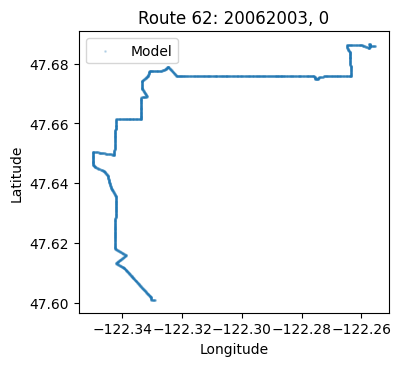

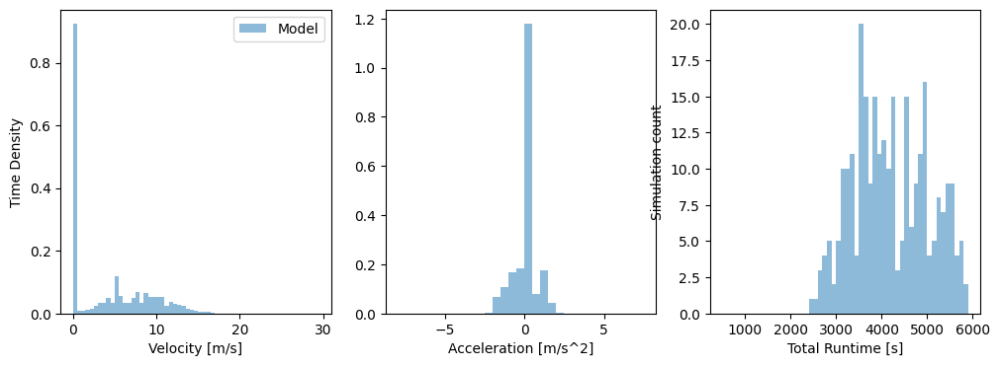

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


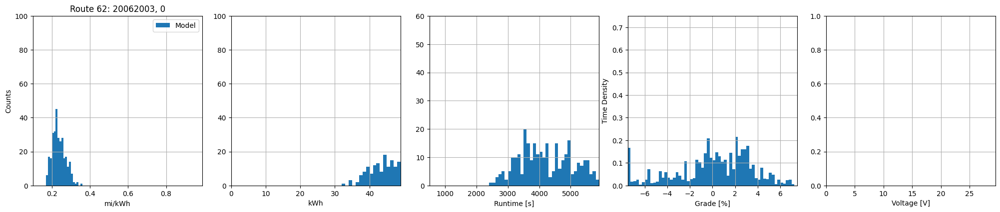

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17502201110697982), np.float64(0.3539015674478472), np.float64(0.23718684856006955), np.float64(0.03435791524135174))
Energy min/max/mean/std [kWh]: 		(np.float64(32.39099169530033), np.float64(65.49589197184032), np.float64(49.31429563735926), np.float64(6.91956971047874))
Time min/max/mean/std [s]: 		(np.float64(2466.192215599284), np.float64(7213.861342756469), np.float64(4341.87344708929), np.float64(955.1582806462867))
|Grade| mean/std [%]: 			(np.float64(2.4212250282900185), np.float64(1.7640178661674506))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



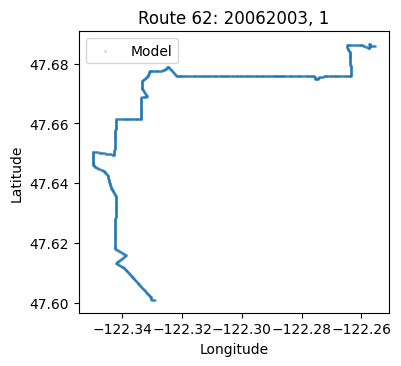

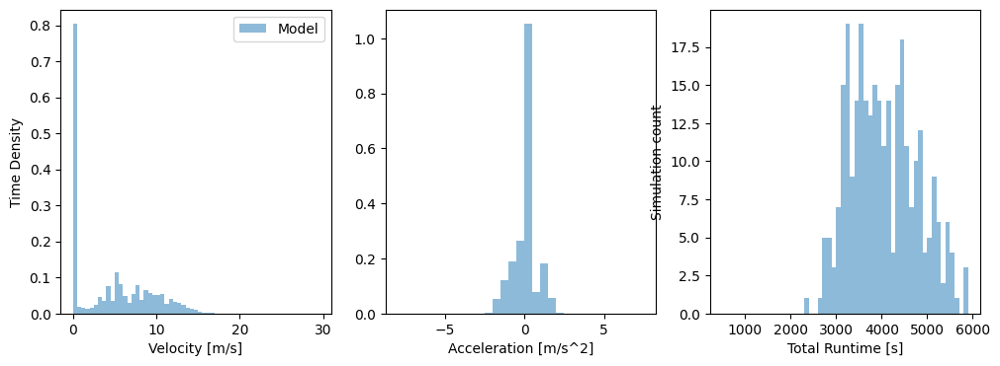

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


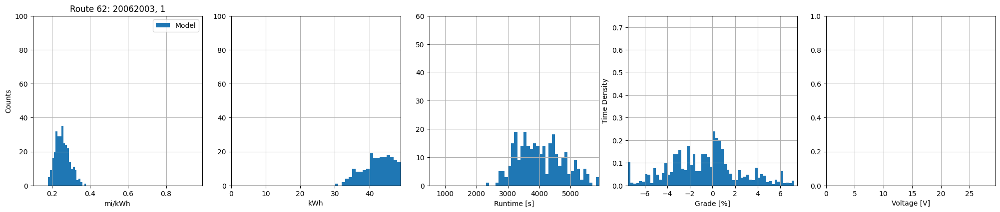

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18100437330997096), np.float64(0.3726461809836507), np.float64(0.2560729856092416), np.float64(0.03736655791744438))
Energy min/max/mean/std [kWh]: 		(np.float64(30.7618424305944), np.float64(63.33152559883673), np.float64(45.70589084623292), np.float64(6.568107200636368))
Time min/max/mean/std [s]: 		(np.float64(2310.428839486988), np.float64(6280.518442044606), np.float64(4069.019412098983), np.float64(770.1589034369105))
|Grade| mean/std [%]: 			(np.float64(2.373621130148663), np.float64(1.8357856398262717))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------65-------------------


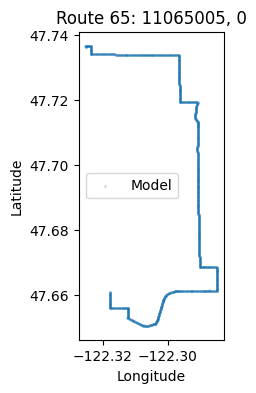

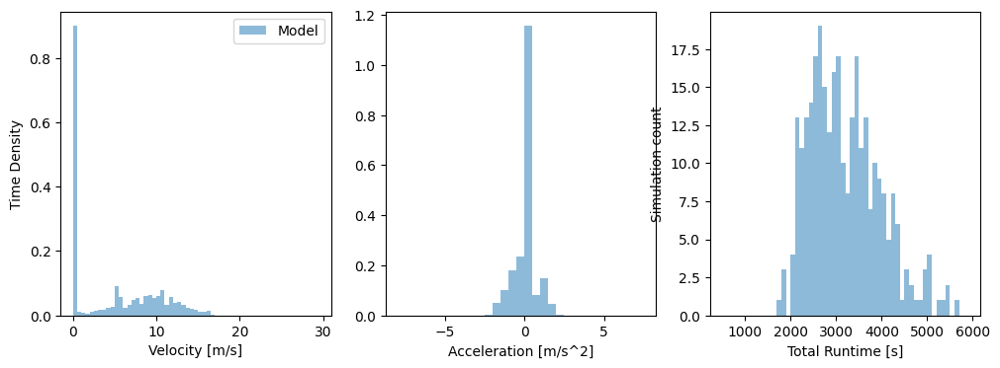

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


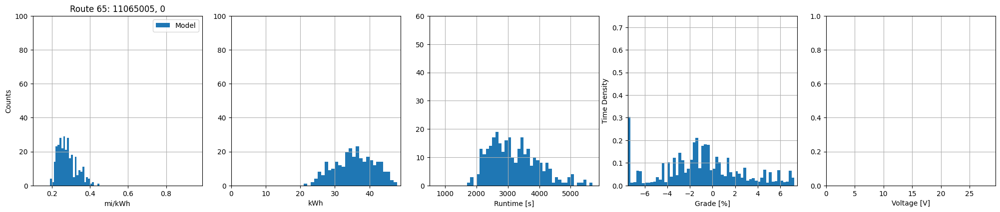

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19230541932996822), np.float64(0.448911616099072), np.float64(0.28049178326104746), np.float64(0.048844443551452725))
Energy min/max/mean/std [kWh]: 		(np.float64(21.815903216217986), np.float64(50.92634624430048), np.float64(35.91820289871589), np.float64(5.893733639403426))
Time min/max/mean/std [s]: 		(np.float64(1738.4326159362245), np.float64(5686.320703668924), np.float64(3199.904181120931), np.float64(777.7512492532752))
|Grade| mean/std [%]: 			(np.float64(2.5940557748890596), np.float64(1.950264609940686))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



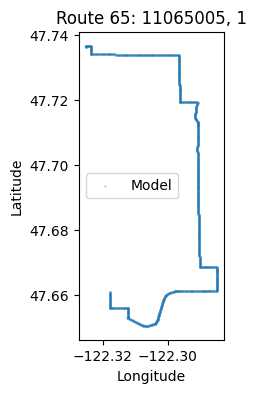

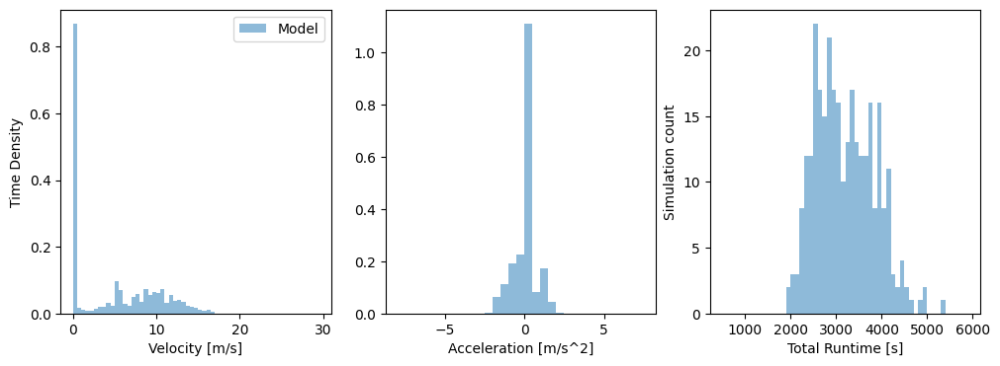

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


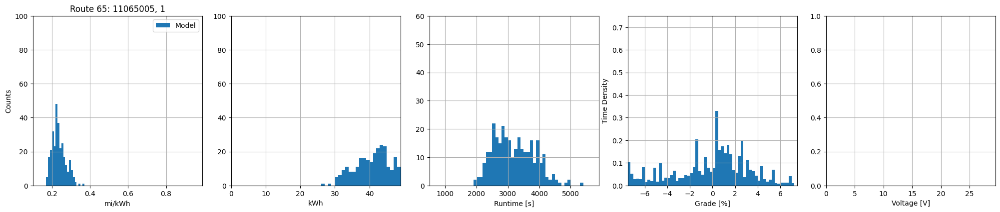

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17251894527377265), np.float64(0.3629233400650327), np.float64(0.23682859643778642), np.float64(0.03526410791661172))
Energy min/max/mean/std [kWh]: 		(np.float64(26.98207680019454), np.float64(56.761449698629335), np.float64(42.2250332608035), np.float64(6.001967114011898))
Time min/max/mean/std [s]: 		(np.float64(1912.3235675682326), np.float64(5366.208736660697), np.float64(3200.3617234464105), np.float64(645.9894069235442))
|Grade| mean/std [%]: 			(np.float64(2.4949231336551243), np.float64(1.9194105278934335))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



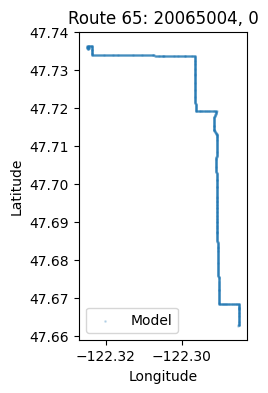

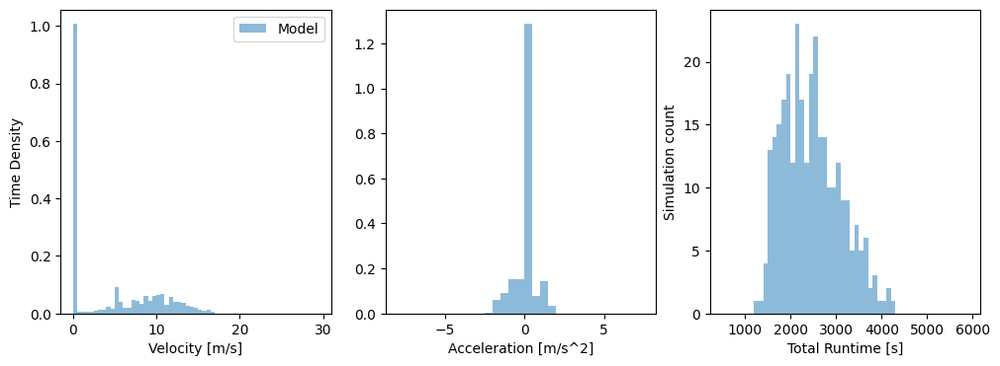

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


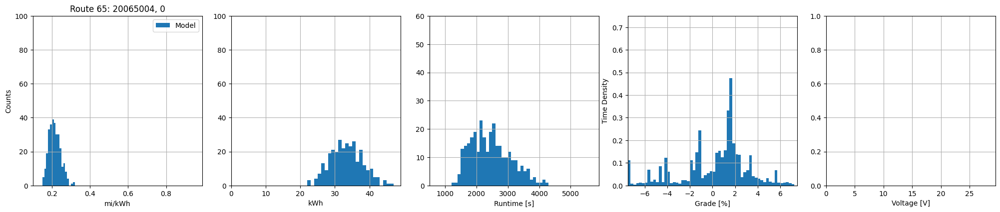

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15010445763738262), np.float64(0.3115112600122245), np.float64(0.2150943216540305), np.float64(0.030161305298352318))
Energy min/max/mean/std [kWh]: 		(np.float64(22.56214124215674), np.float64(46.823133420174), np.float64(33.30604766649592), np.float64(4.583339355850527))
Time min/max/mean/std [s]: 		(np.float64(1256.5958363625443), np.float64(4287.544447454891), np.float64(2455.416930015323), np.float64(631.1024340992153))
|Grade| mean/std [%]: 			(np.float64(2.2418163458471114), np.float64(1.5900495362862033))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



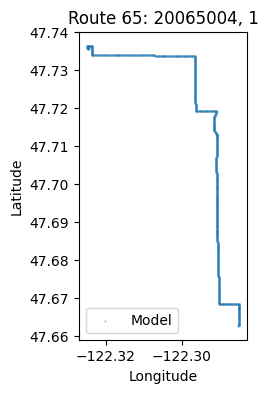

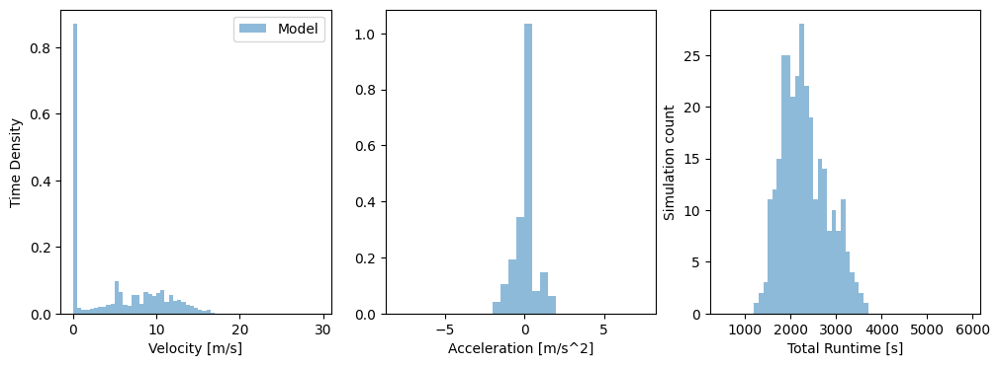

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


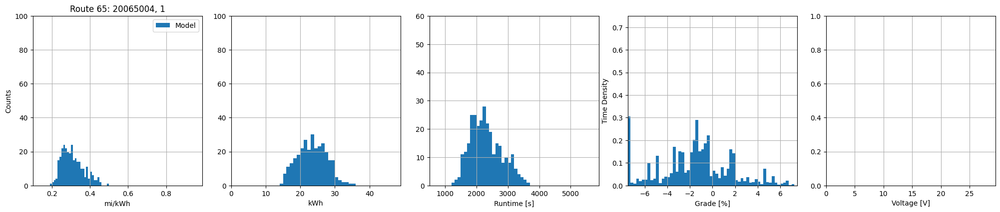

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.19868079868116645), np.float64(0.4904865592283029), np.float64(0.30940423567122244), np.float64(0.05746366510949165))
Energy min/max/mean/std [kWh]: 		(np.float64(14.332810788508256), np.float64(35.38364600097671), np.float64(23.474815983148954), np.float64(4.16281631587037))
Time min/max/mean/std [s]: 		(np.float64(1239.1692893825082), np.float64(3693.6156234884047), np.float64(2305.7315087229254), np.float64(498.43297381222874))
|Grade| mean/std [%]: 			(np.float64(2.400193050332102), np.float64(1.7197962490329979))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------67-------------------


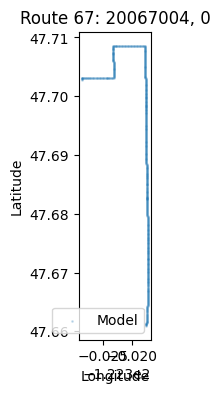

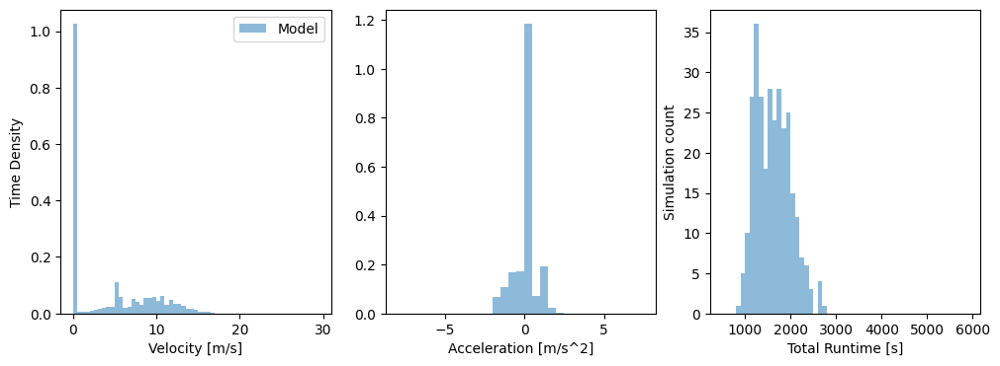

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


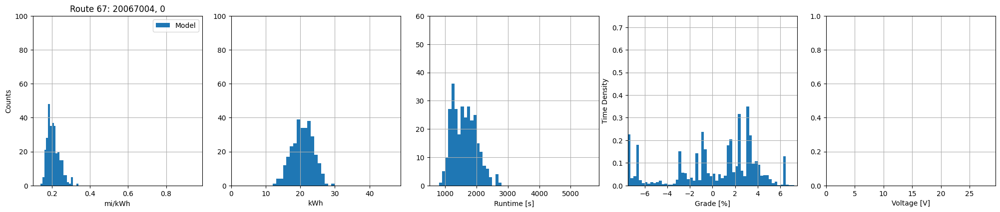

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.14413021561946462), np.float64(0.33116608699031774), np.float64(0.2081426977549811), np.float64(0.032798818656071656))
Energy min/max/mean/std [kWh]: 		(np.float64(12.6982319830192), np.float64(29.176559401079956), np.float64(20.669349378707977), np.float64(3.021536802000739))
Time min/max/mean/std [s]: 		(np.float64(871.7374686228359), np.float64(2780.24114186482), np.float64(1615.017789497283), np.float64(383.03548927186563))
|Grade| mean/std [%]: 			(np.float64(2.861575026755527), np.float64(1.8122273202748782))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



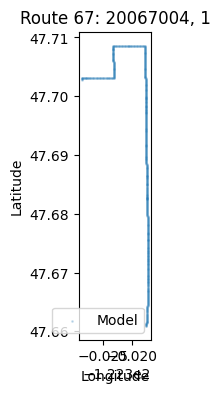

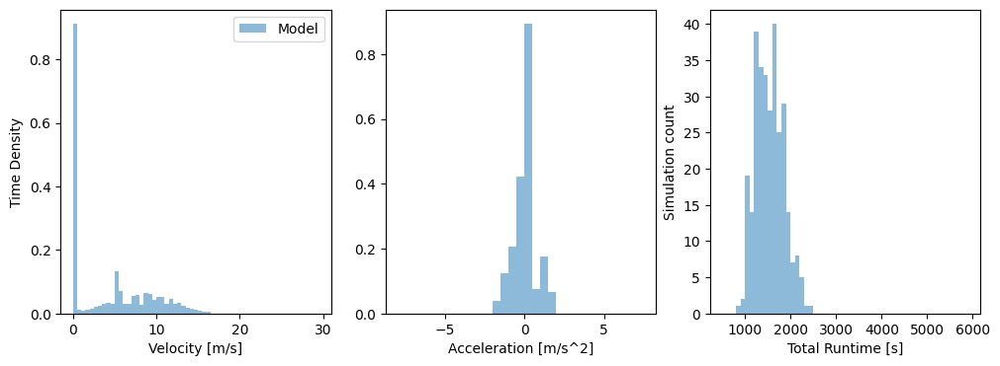

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


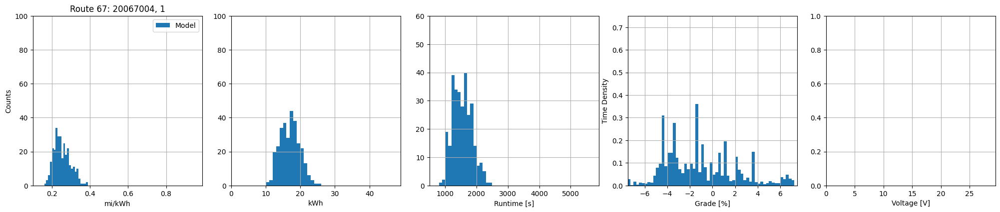

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16762239712307), np.float64(0.3876364460022286), np.float64(0.25447051606988746), np.float64(0.04321280812376978))
Energy min/max/mean/std [kWh]: 		(np.float64(10.845788452766955), np.float64(25.081510359476667), np.float64(16.98682187556299), np.float64(2.8048661460836746))
Time min/max/mean/std [s]: 		(np.float64(895.470804429182), np.float64(2404.4650487534755), np.float64(1544.5775265883844), np.float64(305.01563537215947))
|Grade| mean/std [%]: 			(np.float64(2.755622925729298), np.float64(1.6995551209920263))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



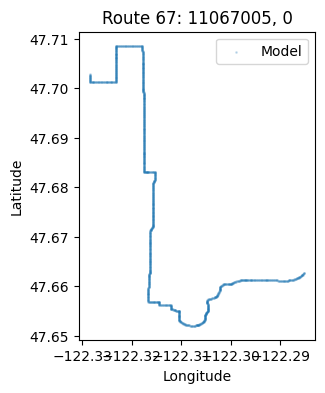

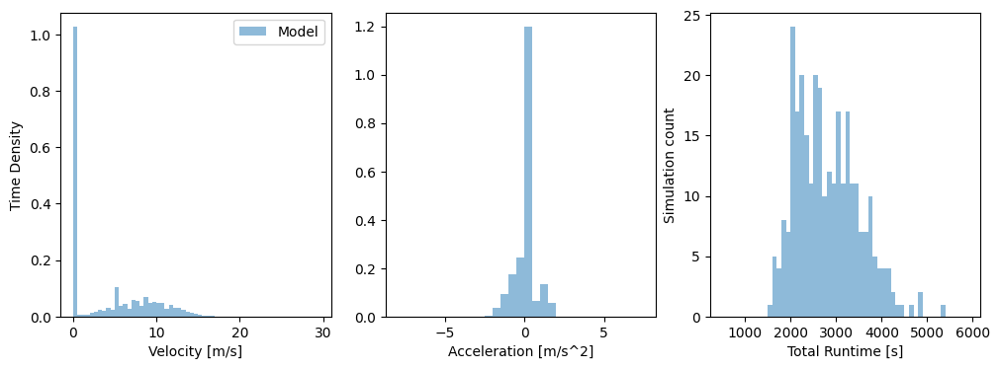

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


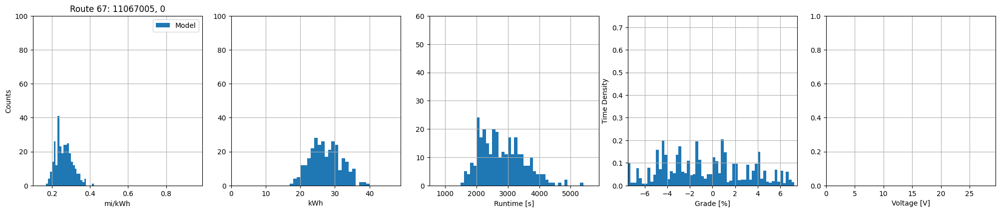

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17890436640398003), np.float64(0.41054348301165294), np.float64(0.2641162643328308), np.float64(0.04342831961352211))
Energy min/max/mean/std [kWh]: 		(np.float64(17.16529634215426), np.float64(39.390321705856486), np.float64(27.39019076200772), np.float64(4.404516687895811))
Time min/max/mean/std [s]: 		(np.float64(1592.27583804261), np.float64(5332.075657057661), np.float64(2812.203899685795), np.float64(691.0797566453057))
|Grade| mean/std [%]: 			(np.float64(3.0631481363104975), np.float64(1.8857509594318493))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



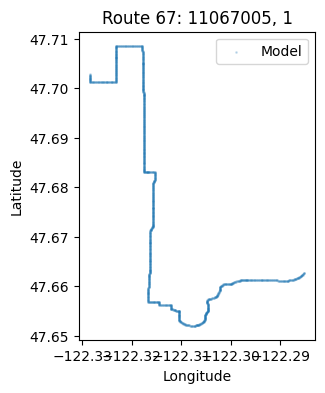

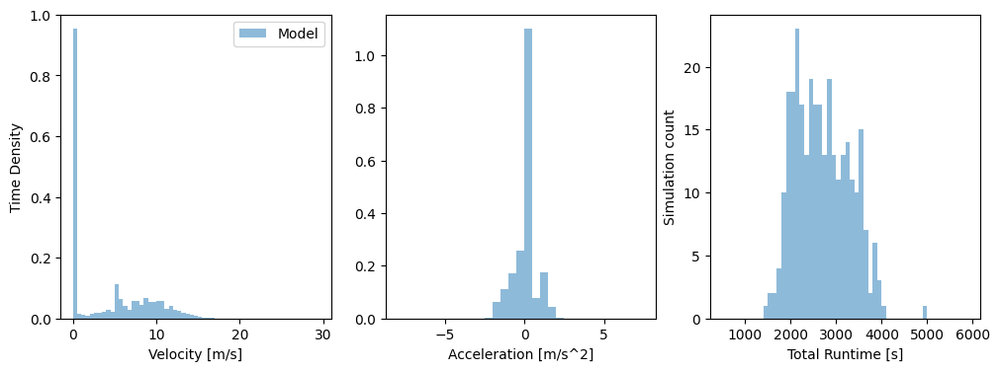

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


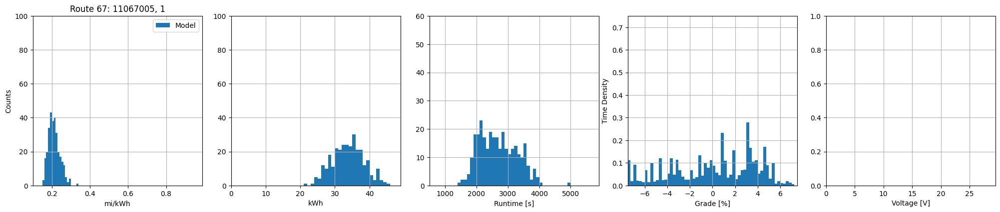

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1566089979696488), np.float64(0.3312518029219488), np.float64(0.21241580094649418), np.float64(0.03001010270105465))
Energy min/max/mean/std [kWh]: 		(np.float64(21.27628279619559), np.float64(45.00256771378432), np.float64(33.81533130859975), np.float64(4.5892785489891725))
Time min/max/mean/std [s]: 		(np.float64(1495.5736429410956), np.float64(4936.989758272073), np.float64(2698.0359637574834), np.float64(597.8423041238326))
|Grade| mean/std [%]: 			(np.float64(3.023880814726579), np.float64(1.8405897187289542))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------70-------------------


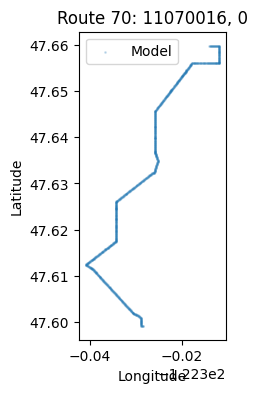

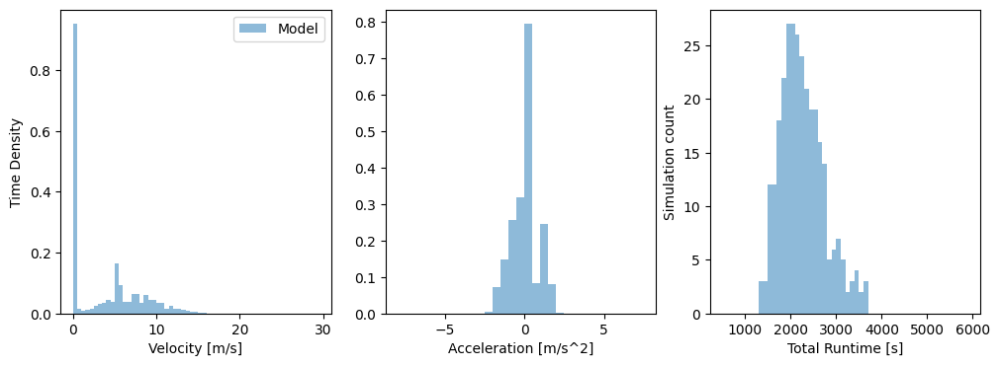

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


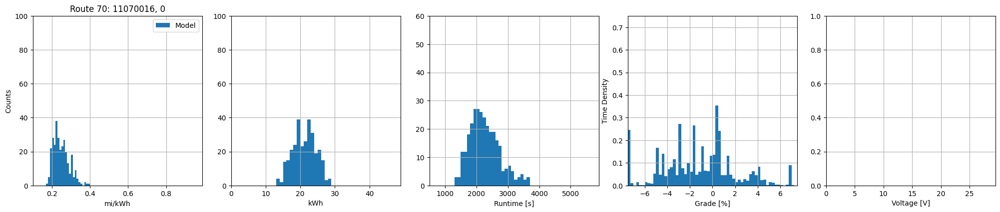

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17952154167122078), np.float64(0.39020416914969513), np.float64(0.24937552495344212), np.float64(0.04146964513244701))
Energy min/max/mean/std [kWh]: 		(np.float64(13.216089486888608), np.float64(28.72620839611533), np.float64(21.218812428411333), np.float64(3.3145826743875135))
Time min/max/mean/std [s]: 		(np.float64(1350.3527722114195), np.float64(3682.8223695971765), np.float64(2262.252598553074), np.float64(479.9759231398384))
|Grade| mean/std [%]: 			(np.float64(2.3425016993728764), np.float64(1.77331689977539))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



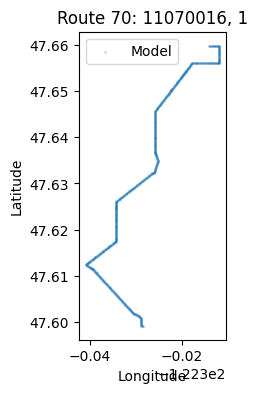

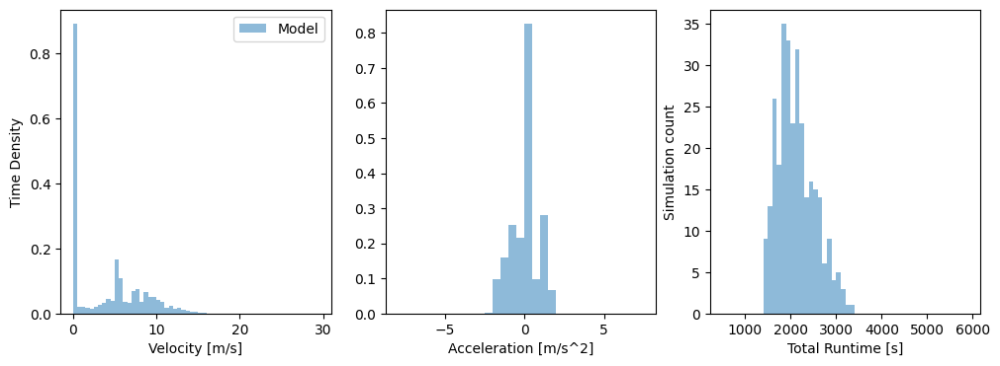

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


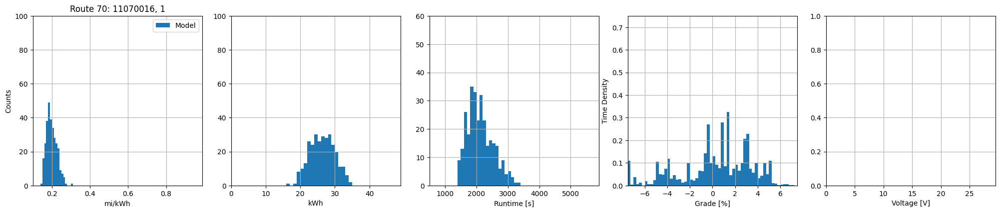

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1475369159178768), np.float64(0.30694299048180823), np.float64(0.1991359280346605), np.float64(0.027891938598327625))
Energy min/max/mean/std [kWh]: 		(np.float64(16.801729374763624), np.float64(34.95513666848382), np.float64(26.389336121893283), np.float64(3.570535589279831))
Time min/max/mean/std [s]: 		(np.float64(1411.897401937762), np.float64(3346.7409865175878), np.float64(2122.7674615392684), np.float64(405.64249973250514))
|Grade| mean/std [%]: 			(np.float64(2.380212193585918), np.float64(1.6862328613587247))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



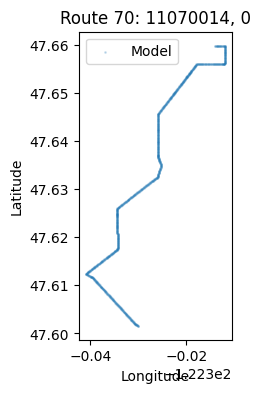

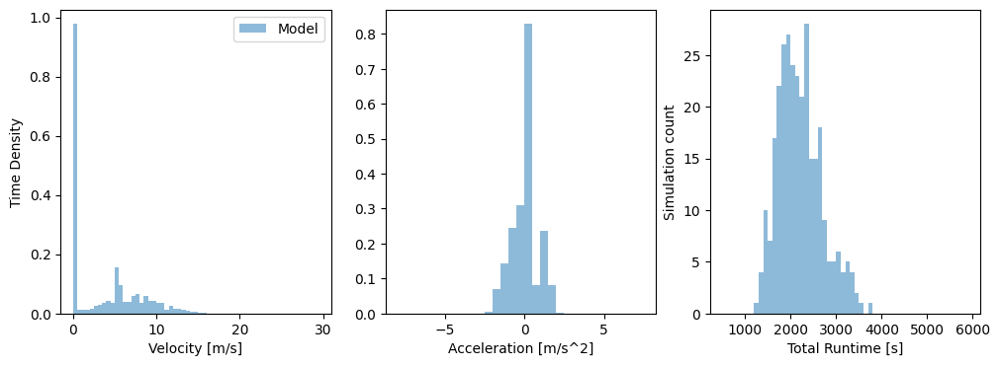

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


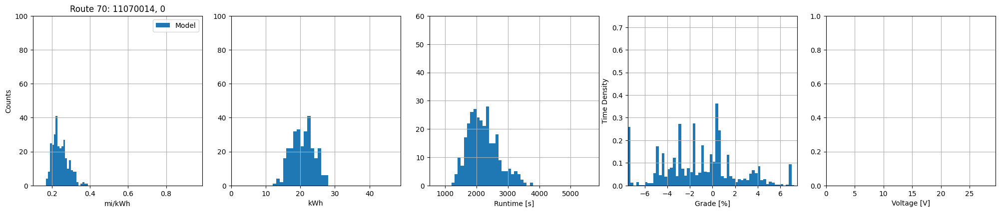

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17708227992547387), np.float64(0.38526123531323625), np.float64(0.24505430603070996), np.float64(0.04048705574896503))
Energy min/max/mean/std [kWh]: 		(np.float64(12.831385120009982), np.float64(27.916035891312205), np.float64(20.69460682885161), np.float64(3.2274638045475683))
Time min/max/mean/std [s]: 		(np.float64(1293.3240115085848), np.float64(3705.961931973345), np.float64(2207.9532207844427), np.float64(479.9002477758874))
|Grade| mean/std [%]: 			(np.float64(2.3931306315208265), np.float64(1.7915569858083271))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



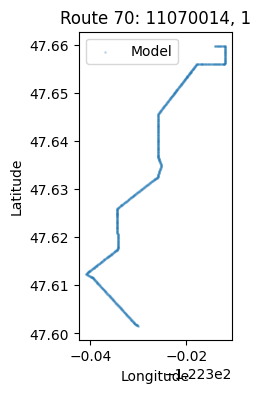

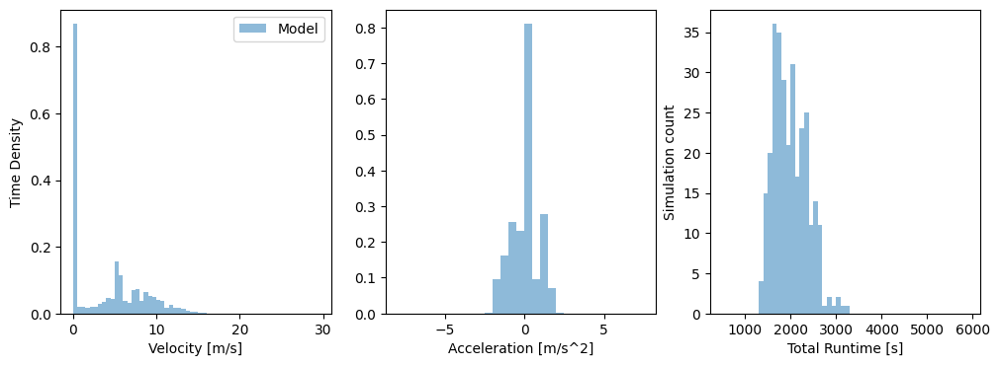

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


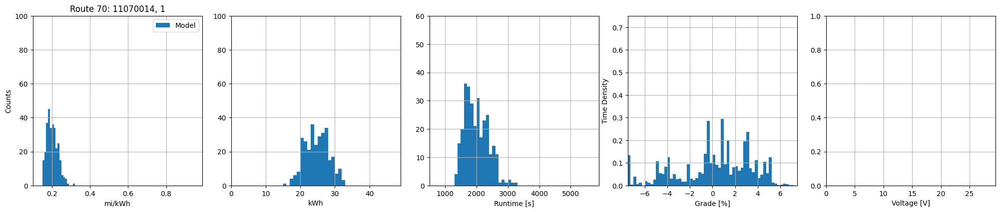

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15044543906719213), np.float64(0.3145015931841093), np.float64(0.20333690829324183), np.float64(0.028755876041406517))
Energy min/max/mean/std [kWh]: 		(np.float64(15.718130641776877), np.float64(32.85827180514909), np.float64(24.781876653324044), np.float64(3.387364238742973))
Time min/max/mean/std [s]: 		(np.float64(1363.769659601189), np.float64(3270.5917098668265), np.float64(1998.058264973758), np.float64(372.93871721403235))
|Grade| mean/std [%]: 			(np.float64(2.448459443842192), np.float64(1.7271238080718094))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



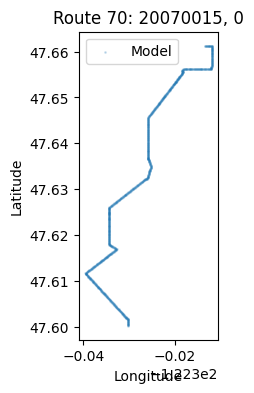

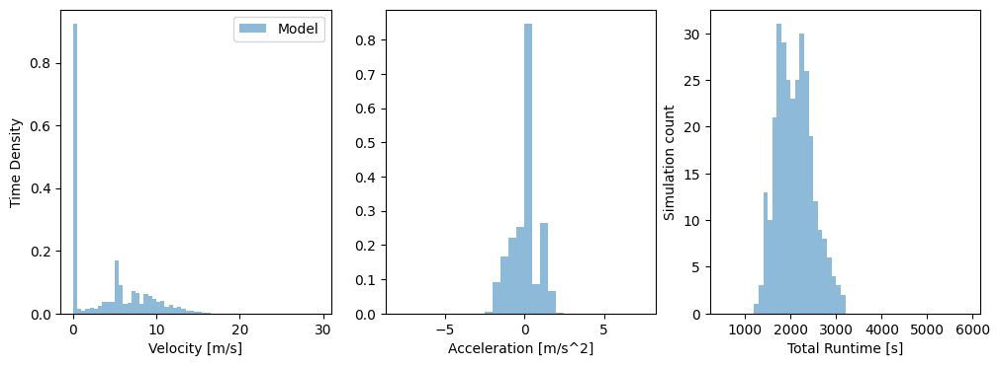

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


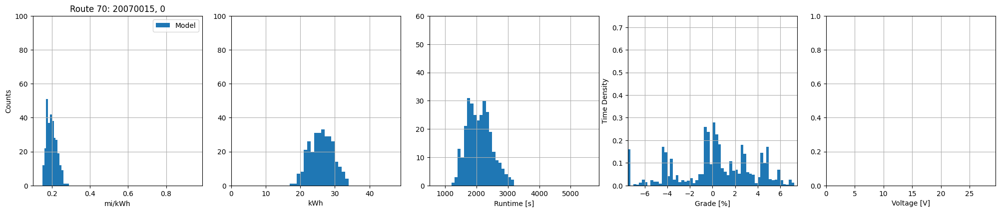

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.15213853953794884), np.float64(0.28808363199134107), np.float64(0.19937676005473423), np.float64(0.02645640757704738))
Energy min/max/mean/std [kWh]: 		(np.float64(17.755818274222268), np.float64(33.62172814956115), np.float64(26.094354159083554), np.float64(3.354559486265929))
Time min/max/mean/std [s]: 		(np.float64(1288.4776242649623), np.float64(3130.5205985486305), np.float64(2091.718427020413), np.float64(390.13315713820907))
|Grade| mean/std [%]: 			(np.float64(2.4532224621279193), np.float64(1.9093256327224197))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



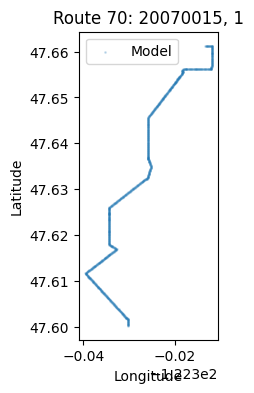

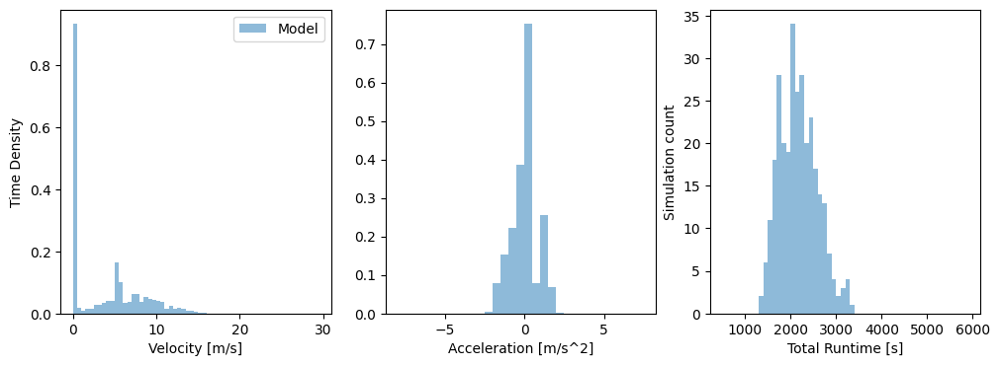

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


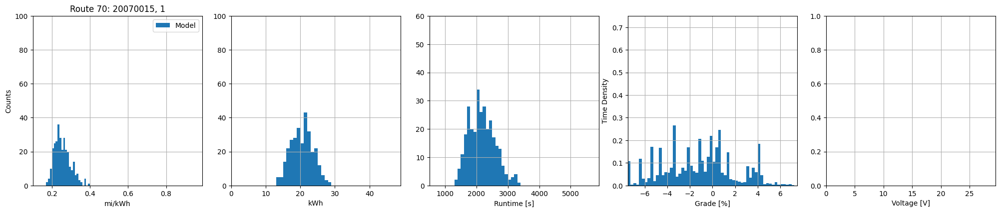

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17932720579788822), np.float64(0.3910242921124715), np.float64(0.2559354815144063), np.float64(0.04174982691520916))
Energy min/max/mean/std [kWh]: 		(np.float64(13.079125393953266), np.float64(28.519129185478302), np.float64(20.49081205788362), np.float64(3.184183365273424))
Time min/max/mean/std [s]: 		(np.float64(1373.2846480806259), np.float64(3371.9392714091373), np.float64(2177.412759656795), np.float64(410.965753783689))
|Grade| mean/std [%]: 			(np.float64(2.562462706687861), np.float64(1.8589958555219914))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



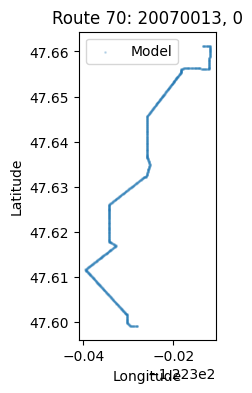

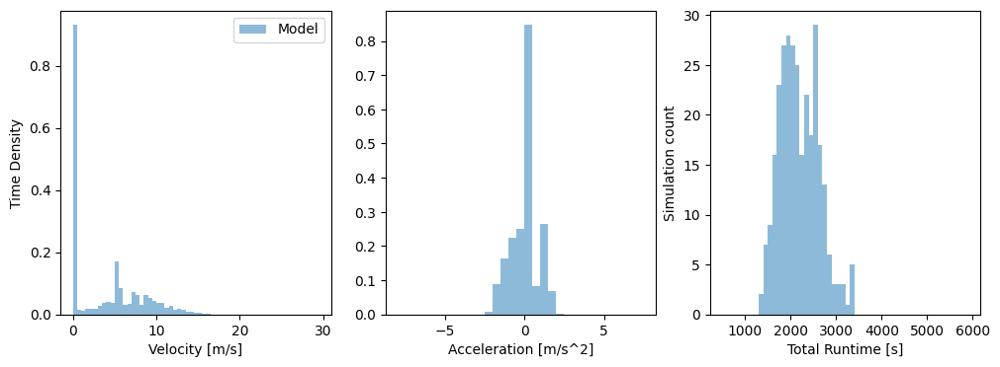

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


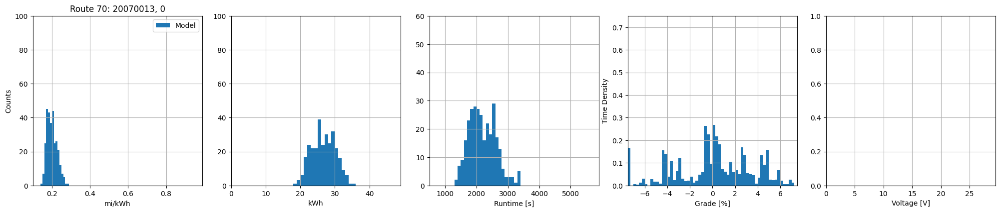

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1497787740654617), np.float64(0.2868655721957443), np.float64(0.20076508689074518), np.float64(0.02662285219073955))
Energy min/max/mean/std [kWh]: 		(np.float64(18.376590452931453), np.float64(35.19598266295761), np.float64(26.70515662956912), np.float64(3.42445797049207))
Time min/max/mean/std [s]: 		(np.float64(1347.5867866817098), np.float64(3364.1898045004664), np.float64(2193.321328565133), np.float64(421.7925193774759))
|Grade| mean/std [%]: 			(np.float64(2.4343818454302144), np.float64(1.8761243190320673))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



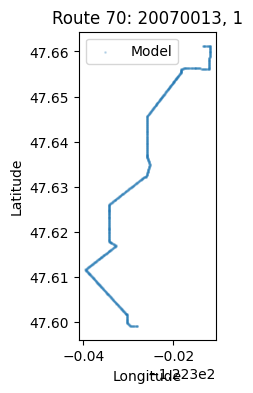

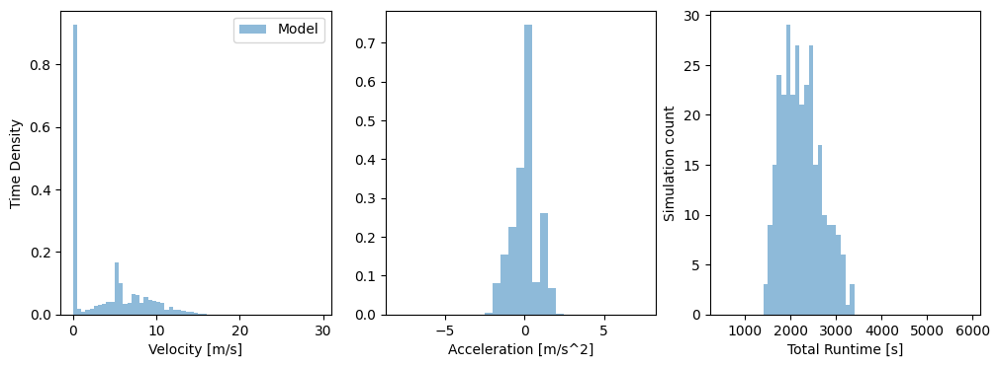

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


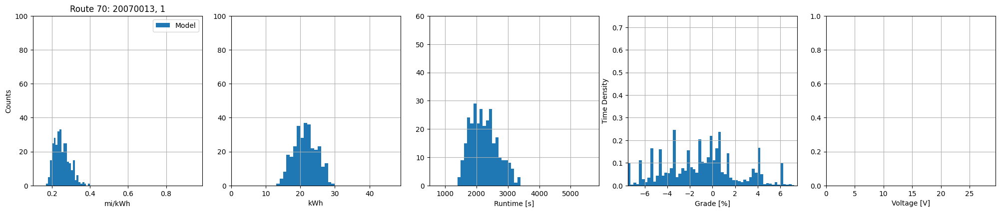

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17790447343172247), np.float64(0.3936463716794882), np.float64(0.25173894009012976), np.float64(0.04009717596864625))
Energy min/max/mean/std [kWh]: 		(np.float64(13.389441059432581), np.float64(29.626601232626278), np.float64(21.445984690685428), np.float64(3.2623282803659834))
Time min/max/mean/std [s]: 		(np.float64(1433.0375141690895), np.float64(3365.158181105582), np.float64(2241.069453175339), np.float64(425.9266556157751))
|Grade| mean/std [%]: 			(np.float64(2.603567985371063), np.float64(1.9363898412881415))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------75-------------------


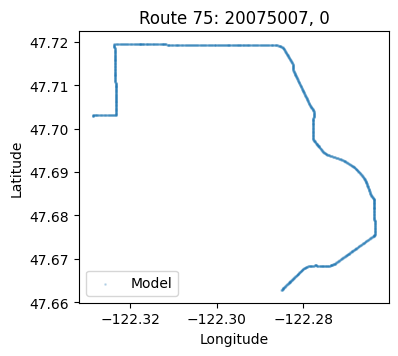

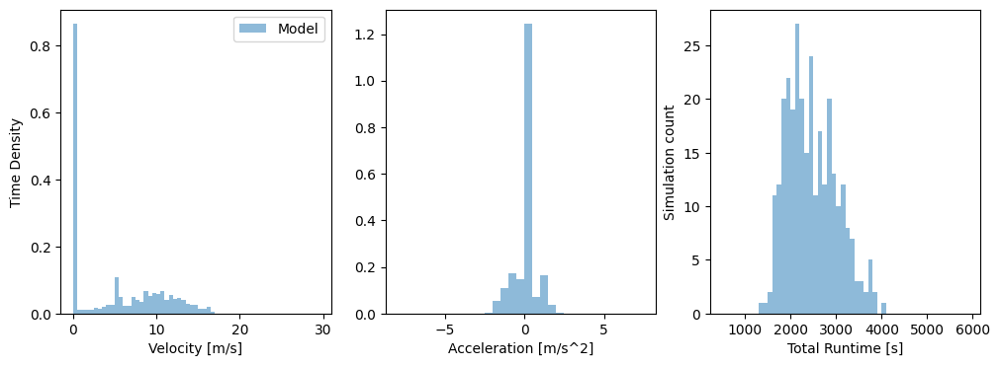

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


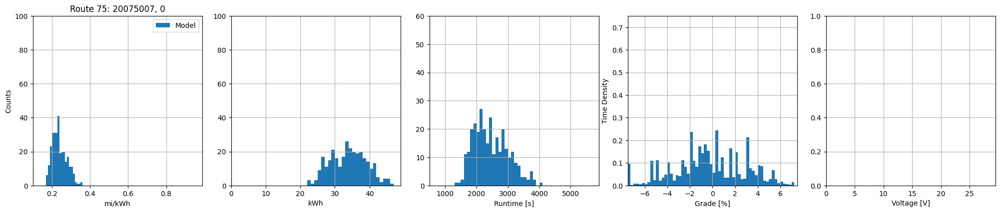

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17074543632125852), np.float64(0.35811884494096174), np.float64(0.23979692538058472), np.float64(0.03783468559113649))
Energy min/max/mean/std [kWh]: 		(np.float64(22.19861320047028), np.float64(46.55902898444746), np.float64(33.95039620321066), np.float64(5.159295493245651))
Time min/max/mean/std [s]: 		(np.float64(1345.3046509993335), np.float64(4071.5763391677965), np.float64(2462.50587183918), np.float64(545.699971791535))
|Grade| mean/std [%]: 			(np.float64(2.4060006534714398), np.float64(1.6926946321260556))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



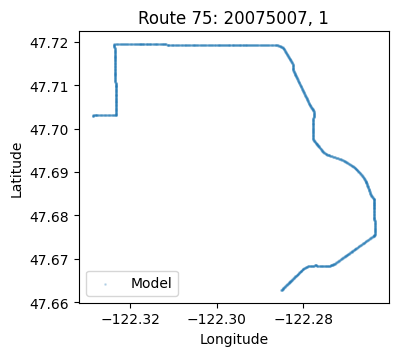

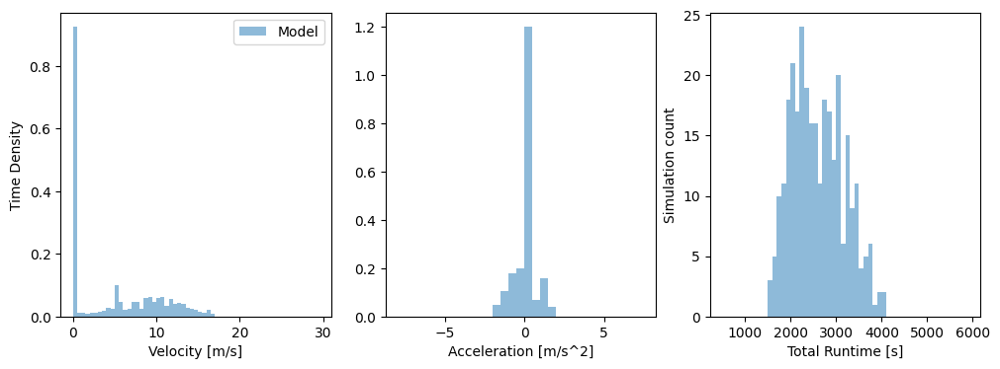

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


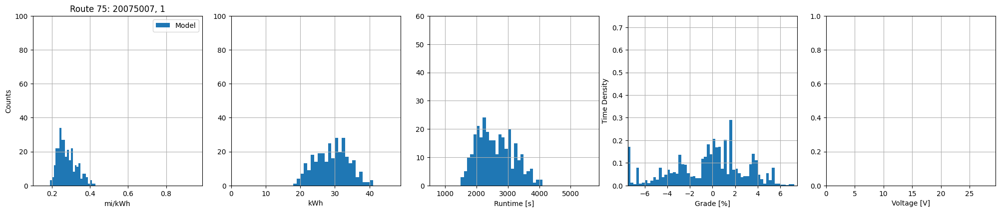

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1947214210947959), np.float64(0.429921530469934), np.float64(0.28023759858480596), np.float64(0.048668827119871264))
Energy min/max/mean/std [kWh]: 		(np.float64(18.491728646231703), np.float64(40.827517773467626), np.float64(29.182444387536666), np.float64(4.787507908432801))
Time min/max/mean/std [s]: 		(np.float64(1508.2818077935635), np.float64(4039.4580385247), np.float64(2601.146680862956), np.float64(572.8353562148958))
|Grade| mean/std [%]: 			(np.float64(2.3250352703706896), np.float64(1.7836217271445638))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



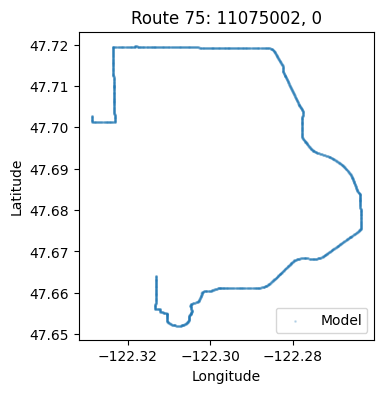

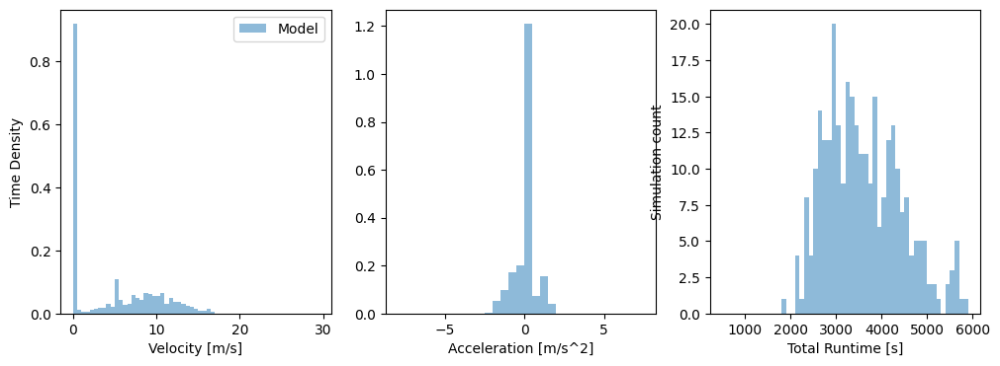

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


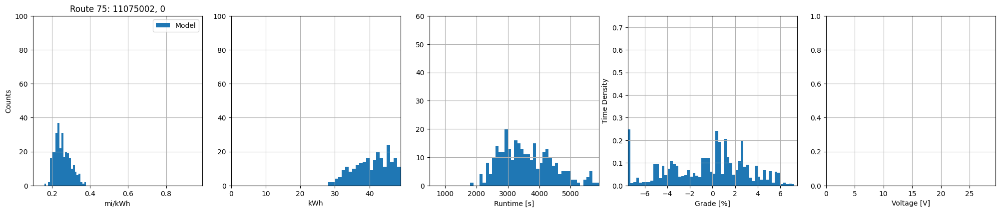

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16844926423112236), np.float64(0.37936385334378014), np.float64(0.25659063482254035), np.float64(0.041542880809789434))
Energy min/max/mean/std [kWh]: 		(np.float64(28.365374506036627), np.float64(63.88153621962414), np.float64(43.000920553362896), np.float64(6.703683016760975))
Time min/max/mean/std [s]: 		(np.float64(1892.3235472921392), np.float64(6427.347776382849), np.float64(3616.6309971193828), np.float64(859.4925984088072))
|Grade| mean/std [%]: 			(np.float64(2.5926532725855265), np.float64(1.8006656654484687))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



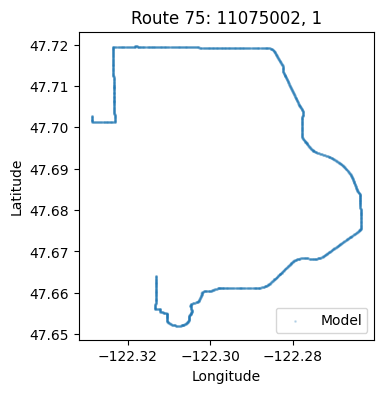

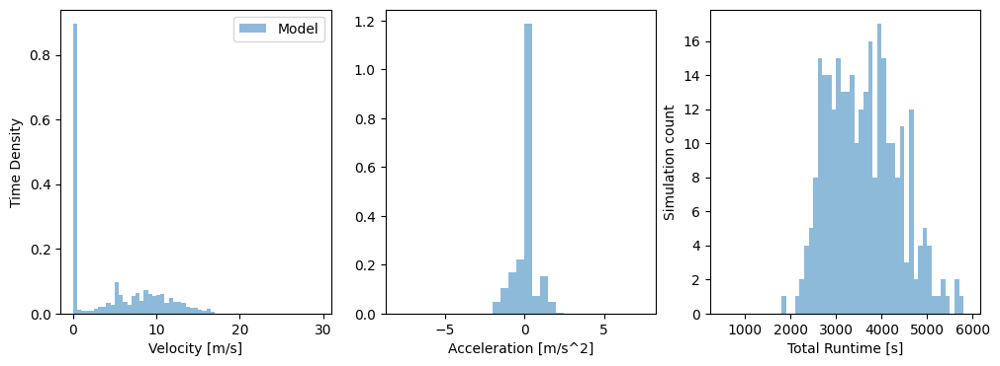

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


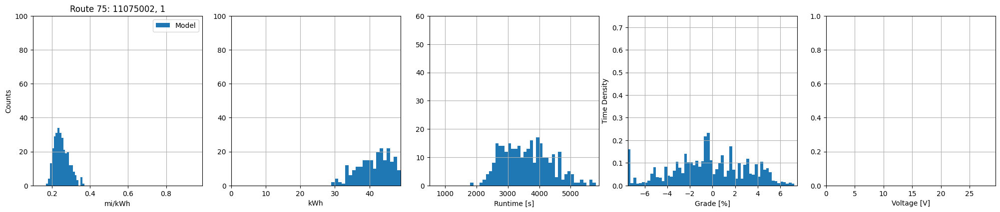

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17995887259244098), np.float64(0.3687733837377054), np.float64(0.25079800558324783), np.float64(0.03795795838960222))
Energy min/max/mean/std [kWh]: 		(np.float64(29.175337928727977), np.float64(59.786371934183585), np.float64(43.846489160828014), np.float64(6.382405531265298))
Time min/max/mean/std [s]: 		(np.float64(1836.835929306395), np.float64(6060.208178551296), np.float64(3613.9103836407226), np.float64(771.3259363391077))
|Grade| mean/std [%]: 			(np.float64(2.5258480312120715), np.float64(1.76209778260829))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------

-----------------------8-------------------


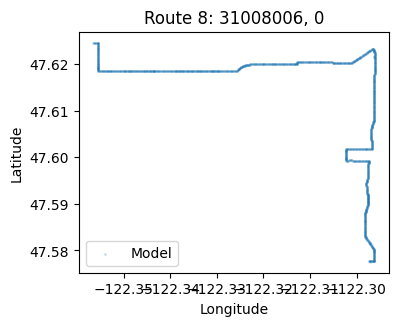

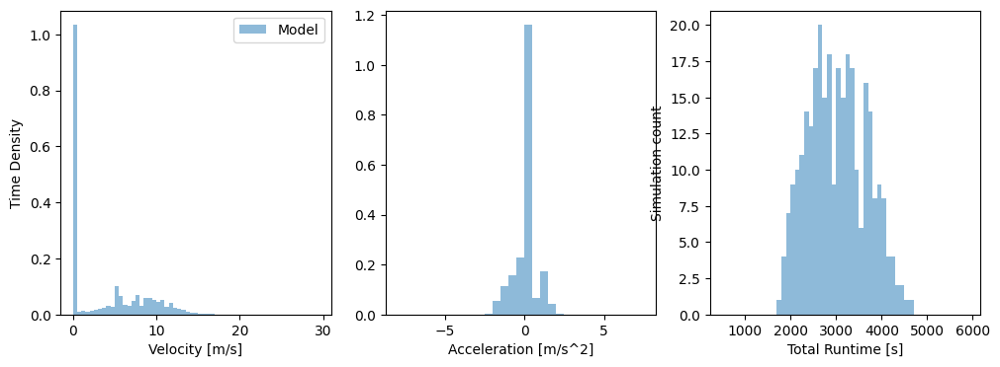

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


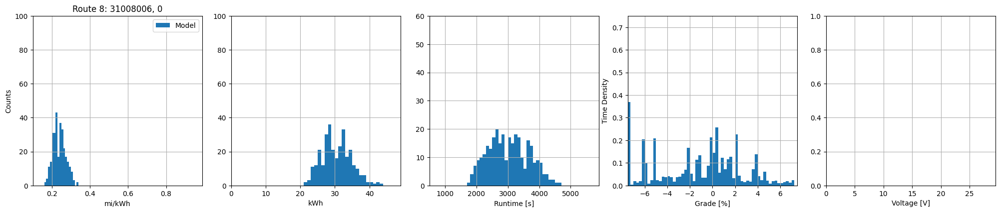

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16379765517733955), np.float64(0.3393052121383453), np.float64(0.23911100882545488), np.float64(0.033146501063319934))
Energy min/max/mean/std [kWh]: 		(np.float64(21.072123183838244), np.float64(43.650693408013595), np.float64(30.4770459885506), np.float64(4.225677181019402))
Time min/max/mean/std [s]: 		(np.float64(1778.8987173328496), np.float64(4668.304844288519), np.float64(3026.4393993052854), np.float64(639.670241307213))
|Grade| mean/std [%]: 			(np.float64(2.6467884966161144), np.float64(2.039928993269091))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



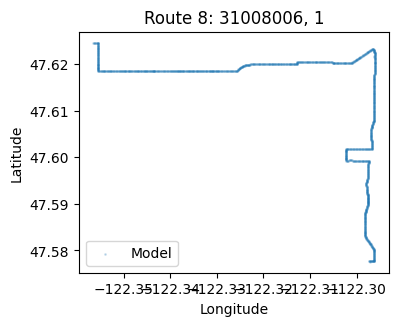

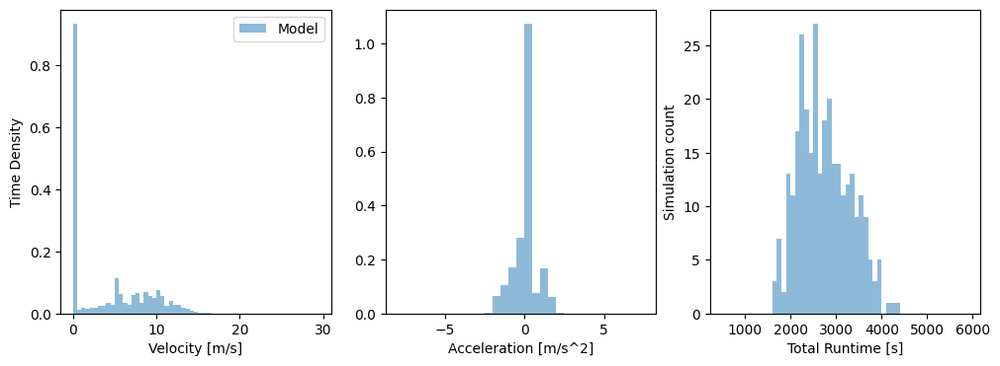

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


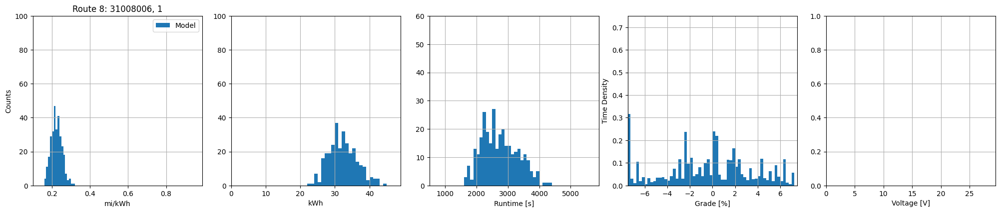

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1615053790882457), np.float64(0.3131246728420317), np.float64(0.2249674936652579), np.float64(0.028278800950227456))
Energy min/max/mean/std [kWh]: 		(np.float64(22.831867520423636), np.float64(44.266148211688744), np.float64(32.283741702234074), np.float64(4.082242517275319))
Time min/max/mean/std [s]: 		(np.float64(1603.8181608680945), np.float64(4328.954921834229), np.float64(2740.24592576617), np.float64(568.4957705114648))
|Grade| mean/std [%]: 			(np.float64(2.7916750037679083), np.float64(2.0450777922079064))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



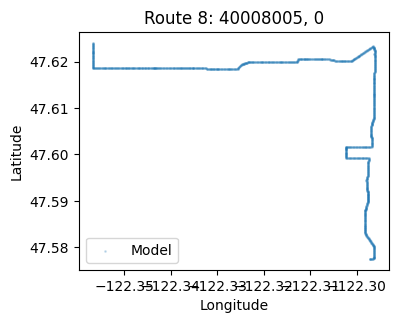

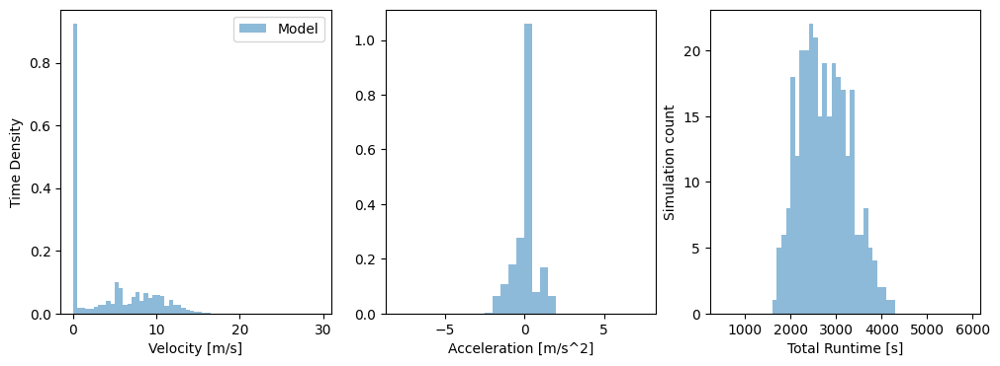

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


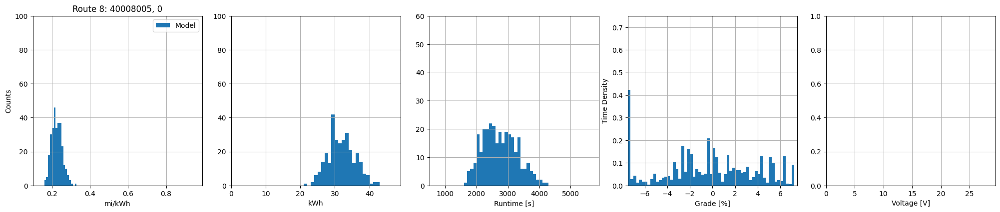

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16865847836843686), np.float64(0.32345974002880434), np.float64(0.22627528673272954), np.float64(0.027819056037837523))
Energy min/max/mean/std [kWh]: 		(np.float64(21.98974747313522), np.float64(42.17278650778152), np.float64(31.902670007977353), np.float64(3.869507609554087))
Time min/max/mean/std [s]: 		(np.float64(1650.3736132392264), np.float64(4213.503187241148), np.float64(2748.9663494130455), np.float64(540.6523934090346))
|Grade| mean/std [%]: 			(np.float64(2.9184271659082723), np.float64(2.020295425868387))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



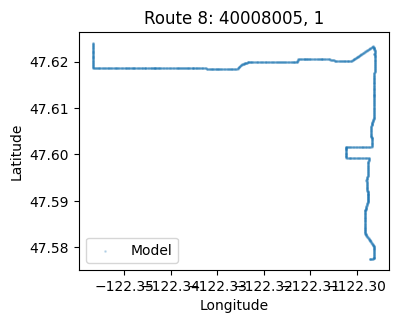

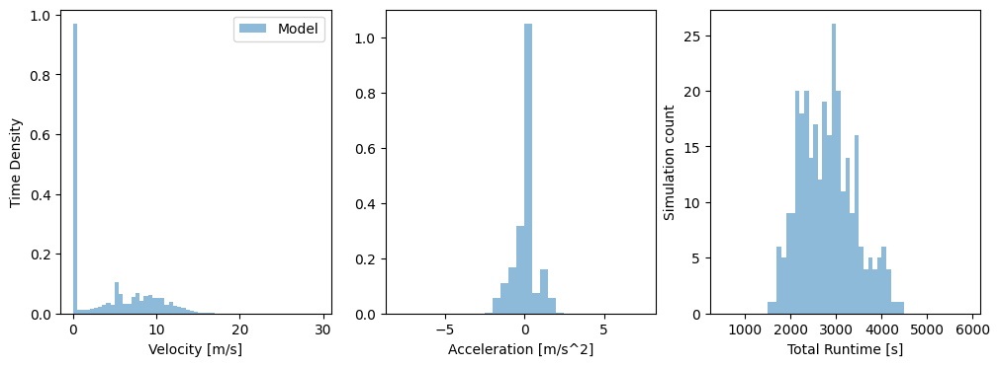

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


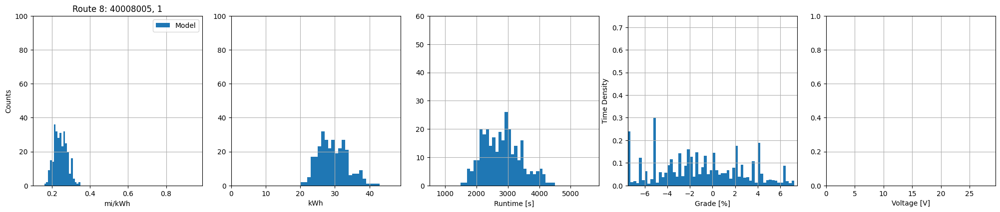

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.16920448283687126), np.float64(0.349267488656894), np.float64(0.24640864854266029), np.float64(0.03474684560847258))
Energy min/max/mean/std [kWh]: 		(np.float64(20.368414435920982), np.float64(42.04395083796642), np.float64(29.4513180636856), np.float64(4.192542092478733))
Time min/max/mean/std [s]: 		(np.float64(1572.9779066479723), np.float64(4467.9198876954215), np.float64(2808.962786694389), np.float64(599.8850800413775))
|Grade| mean/std [%]: 			(np.float64(3.0559536858203344), np.float64(1.9022449694444161))
Velocity mean/std [m/s]: 		(np.float64(nan), np.float64(nan))
--------------------------------------------------------------------------------------------------



In [67]:
for route_shortname in list(routes.keys())[:]:
#for route_shortname in unsimd_routes[:]:
    print("-----------------------{}-------------------".format(route_shortname))
    selected_route_instances = available_routes.get_group((route_shortname,)).reset_index(drop=True)
    selected_route_instances['results'] = [[]]*len(selected_route_instances)
    #current_route_index = specific_runs[route_shortname]
    #current_route_instance = selected_route_instances.iloc[current_route_index]
    
    for index, row in selected_route_instances[current_route_index:current_route_index+1].iterrows():
    #for index, row in selected_route_instances[:].iterrows():

        route = gt.load_from_json(row.path)
        busses= []
        trips = []
        esses= []
        for seed in seeds:
            random.seed(int(seed))
            bus = op.load_bus_params(row.bus)
            trip = op.load_trip_params(trip_path)
            trip.m_riders = random.uniform(*row.ridership_min_max)
            trip.traffic = random.uniform(*traffic_min_max)
            trip.chance_sig = random.uniform(*signal_min_max)
            trip.v_wind = random.uniform(*wind_speed_min_max)
            trip.wind_bearing = gt.compass_heading(random.randrange(*wind_directions_min_max))
            trip.seed=int(seed)
            trip.t_sig = random.uniform(*t_sigs)
            trip.t_stop = random.uniform(*t_stops)
            trips.append(trip)
            ess = op.load_ESS_params(ESS_path)
            ess.P_aux = random.randrange(*(p_aux_min_max))
            esses.append(ess)
            bus.f_br = random.uniform(*b_factors)
            bus.f_a = random.uniform(*a_factors)
            bus.dmax = random.uniform(*max_dist)
            #print(bus.f_br)
            busses.append(bus)

        all_runs = list(zip([route]*len(trips), trips, busses, esses))
        batched_runs = [all_runs[i:i + batch_size] for i in range(0, len(all_runs), batch_size)]

        res_list = []
        for i in range(len(batched_runs)):
            print(index/len(selected_route_instances[:])*100, i/len(batched_runs)*100, end= '\r')
            batch = batched_runs[i]
            with multiprocessing.Pool(batch_size) as pool:
                res_list.extend(pool.starmap(ts.simulate_trip, batch))

        proc_res = process_result_list(res_list, ess)
        #print(list(proc_res))
        selected_route_instances.at[index, 'results'] = list(proc_res)

    pre_MC = selected_route_instances[:]
    
    # Get the selected instances and plot against the 
    mi_kwh_bins = np.arange(.1, 1, .01)
    kwh_bins = np.arange(0, 50, 1)
    volt_bins = np.arange(20, 50, .5)
    time_bins = np.arange(500, 6000, 100)
    grade_bins = np.arange(-7.5, 7.5, .25)
    vel_bins = np.arange(0, 30, .5)
    vbins = np.arange(0, 30, .5)
    abins = np.arange(-8, 8, .5)
    tbins = np.arange(500, 6000, 100)

    for i in range(len(pre_MC)):
        MC = selected_route_instances[i:i+1]
        for index, row in MC.iterrows():
            # ---- Path Plotting
            if len(MC['results'][index]) != 0:
                fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=100)

                gt.load_from_json(row.path).to_gdf().geometry.apply(lambda x: shapely.ops.transform(gt._flip, x)).plot(ax=ax, markersize=1, color="tab:blue", alpha = .2, zorder = 1)
                ax.set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
                ax.set_xlabel("Longitude")
                ax.set_ylabel("Latitude")
                ax.legend(["Model", "Collected Data"])

                res = pd.DataFrame(row['results'])

                ddfs = res.apply(lambda x: gpd.GeoDataFrame([x['dt'],x['g'],x['vel'],x['dx'],x['geo']]).T[1:], axis=1)
                lddfs = pd.concat(list(ddfs))
                lddfs = gpd.GeoDataFrame(lddfs)

                lddfs = lddfs[lddfs['dt']!=0].reset_index(drop=True)
                sim = lddfs.groupby('geometry',sort=False).apply(lambda x: (x['dt'].mean(),
                                                                 x['grade'].mean(),
                                                                 x['v_f'].mean(),
                                                                 x['gdx'].mean(),
                                                                 x['v_f'].std(),
                                                                 x['dt'].std(),
                                                                 x['v_f'].min(),
                                                                 x['v_f'].max(),
                                                                 x['dt'].min(),
                                                                 x['dt'].max()), include_groups=False)
                aggregated_sim = pd.DataFrame(sim)
                aggregated_sim['dt'],aggregated_sim['grade'],aggregated_sim['v_f'],aggregated_sim['gdx'],aggregated_sim['sv_f'],aggregated_sim['sdt'],aggregated_sim['mav'],aggregated_sim['miv'],aggregated_sim['mat'],aggregated_sim['mit'] = zip(*aggregated_sim[0])
                aggregated_sim['geometry'] = aggregated_sim.index
                aggregated_sim['gdx']=gt.query_distance_traveled(aggregated_sim['geometry']).cumsum()
                aggregated_sim=gpd.GeoDataFrame(aggregated_sim[['dt',
                                                                'grade',
                                                                'v_f',
                                                                'gdx',
                                                                'geometry',
                                                                'sv_f',
                                                                'sdt',
                                                                'mav',
                                                                'miv',
                                                                'mat',
                                                                'mit']].reset_index(drop=True))



                '''
                ## ---- Monte Carlo Profile
                fig, ax = plt.subplots(2, 1, figsize=(20,8), dpi=100)
                plt.tight_layout(pad=2, w_pad=2, h_pad=2)
                ax[0].plot(aggregated_sim['gdx'], aggregated_sim['v_f'])
                ax[0].fill_between(aggregated_sim['gdx'], aggregated_sim['v_f']-aggregated_sim['sv_f'],aggregated_sim['v_f']+aggregated_sim['sv_f'],alpha=.3,zorder = .5)
                ax[0].fill_between(aggregated_sim['gdx'], aggregated_sim['miv'],aggregated_sim['mav'],alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")


                ax[0].set_ylim(0, 30)
                ax[0].legend(["Model", "Standard Deviation", "Min/Max", "Collected Data"])
                ax[0].set_xlabel("Geodesic Distance")
                ax[0].set_ylabel("Velocity [m/s]")

                ax[1].plot(aggregated_sim['dt'].cumsum(), aggregated_sim['v_f'])
                ax[1].fill_between(aggregated_sim['dt'].cumsum(), aggregated_sim['v_f']-aggregated_sim['sv_f'],aggregated_sim['v_f']+aggregated_sim['sv_f'],alpha=.3,zorder = .5)
                ax[1].fill_between(aggregated_sim['dt'].cumsum(), aggregated_sim['miv'],aggregated_sim['mav'],alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")
                ax[1].set_ylim(0, 30)
                ax[1].legend(["Model", "Standard Deviation", "Min/Max", "Collected Data"])
                ax[1].set_xlabel("Elapsed Time [s]")
                ax[1].set_ylabel("Velocity [m/s]")
                plt.show()
                '''


                # ---- Histogram Plotting
                fig, ax = plt.subplots(1,3, figsize = (12, 4), dpi=100)

                cm, bm, p = ax[0].hist(lddfs['v_f'], alpha=.5, weights=lddfs['dt'],density=True,bins=vbins)

                # Load the collected histogram
                #v_hist = v_hists[route_shortname]
                #ct, bt, p = ax[0].hist(v_hist[1][:-1], alpha=.5, weights=v_hist[0], density=True, bins=v_hist[1])

                #v_r2 = rsq(ct, cm)
                #ax[0].set_title("R^2: {}".format(v_r2))

                cm, bm, p = ax[1].hist(lddfs['v_f'].diff()/lddfs['dt'], alpha=.5, weights=lddfs['dt'],density=True,bins=abins)

                # Load the collected a histogram
                #a_hist = a_hists[route_shortname]
                #ct, bt, p = ax[1].hist(a_hist[1][:-1], alpha=.5, weights=a_hist[0], density=True, bins=a_hist[1])

                #a_r2 = rsq(ct, cm)
                #ax[1].set_title("R^2: {}".format(a_r2))

                # Plot runtime
                cm, bm, p = ax[2].hist(ddfs.apply(lambda x: x['dt'].sum()),alpha=.5, bins=tbins, color="tab:blue")

                ax[0].legend(["Model", "Collected Data"])
                ax[0].set_xlabel("Velocity [m/s]")
                ax[1].set_xlabel("Acceleration [m/s^2]")
                ax[2].set_xlabel("Total Runtime [s]")
                ax[0].set_ylabel("Time Density")
                ax[2].set_ylabel("Simulation count")


                plt.show()

                # Plot the statistics ----------------
                fig, ax = plt.subplots(1, 5, figsize = (20,4), dpi=100)
                plt.tight_layout()



                milage = pd.Series(res['miles']/res['kwh'])
                mimin, mimax, mimean, mistd = milage.min(), milage.max(), milage.mean(), milage.std()
                ax[0].hist(milage, bins=mi_kwh_bins)
                ax[0].set_ylim(0, 100)
                ax[0].set_xlim(mi_kwh_bins.min(), mi_kwh_bins.max())
                ax[0].set_xlabel("mi/kWh")
                ax[0].set_ylabel("Counts")
                ax[0].set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
                ax[0].grid()

                ax[1].hist(res['kwh'], bins=kwh_bins)
                enmin, enmax, enmean, enstd = res['kwh'].min(), res['kwh'].max(), res['kwh'].mean(), res['kwh'].std()
                ax[1].set_ylim(0, 100)
                ax[1].set_xlabel("kWh")
                ax[1].set_xlim(kwh_bins.min(), kwh_bins.max())
                ax[1].grid()

                ax[2].hist(res['tot_time'], bins=time_bins)
                tmin, tmax, tmean, tstd = res['tot_time'].min(), res['tot_time'].max(), res['tot_time'].mean(), res['tot_time'].std()
                ax[2].set_ylim(0, 60)
                ax[2].set_xlim(time_bins.min(), time_bins.max())
                ax[2].set_xlabel("Runtime [s]")
                ax[2].grid()
                ax[0].legend(["Model", "Collected Data"])

                #print(tmean, tstd, len(seeds), stats[route_shortname][0], stats[route_shortname][1], stats[route_shortname][2])
                #t_val = t_value_eqn(tmean, tstd, len(seeds), stats[route_shortname][0], stats[route_shortname][1], stats[route_shortname][2])
                #p_val = sci_t.sf(abs(t_val), len(seeds) + stats[route_shortname][2] - 2)*2

                t = pd.concat(list(res['dt'])).reset_index(drop=True)


                g = pd.concat(list(res['g'])).reset_index(drop=True)
                gvals, gbins, gbcon = ax[4-1].hist(g.apply(abs), bins=grade_bins, weights=t, density=True,alpha = 0)
                ax[4-1].hist(g, bins=grade_bins, weights=t, density=True, color='tab:blue')
                #g.hist(ax=ax[4], bins=grade_bins, weights=t, density=True)
                ax[4-1].set_xlim(-7.5, 7.5)
                ax[4-1].set_ylim(0, .75)
                ax[4-1].set_xlabel("Grade [%]")
                ax[4-1].set_ylabel("Time Density")
                ax[4-1].grid()

                vel = pd.concat(list(res['v'])).reset_index(drop=True)
                velvals, velbins, velbcon = ax[5-1].hist(vel, bins=vel_bins, weights=t, density=True)
                ax[5-1].set_xlim(vel_bins.min(), vel_bins.max())
                ax[5-1].set_ylim(0, 1)
                ax[5-1].set_xlabel("Voltage [V]")
                #ax[5-1].set_ylabel("Time Density")
                ax[5-1].grid()


                plt.show()

                print("-------------------------------------------model statistics---------------------------------------")
                # Print the statistics
                print("Milage min/max/mean/std [mi/kWh]: \t{}".format((mimin, mimax, mimean, mistd)))
                print("Energy min/max/mean/std [kWh]: \t\t{}".format((enmin, enmax, enmean, enstd)))
                print("Time min/max/mean/std [s]: \t\t{}".format((tmin, tmax, tmean, tstd)))
                #print("Two-Tailed T Test: \t\tT-score: {}, P Value: {}".format(t_val, p_val))
                print("|Grade| mean/std [%]: \t\t\t{}".format(calculate_statistics_from_hist(gvals, gbins, gbcon)))
                print("Velocity mean/std [m/s]: \t\t{}".format(calculate_statistics_from_hist(velvals, velbins, velbcon)))

                print("--------------------------------------------------------------------------------------------------")
                print()
                out_df = pd.DataFrame(MC['results'][index])
                out_df['v'] = out_df['v'].apply(lambda x: x.to_dict())
                out_df['dt'] = out_df['dt'].apply(lambda x: x.to_dict())
                out_df['g'] = out_df['g'].apply(lambda x: x.to_dict())
                out_df['vel'] = out_df['vel'].apply(lambda x: x.to_dict())
                out_df['dx'] = out_df['dx'].apply(lambda x: x.to_dict())
                out_df['geo'] = out_df['geo'].apply(lambda x: x.to_dict())
                out_df['P'] = out_df['P'].apply(lambda x: x.to_dict())
                out_df.to_pickle('./KC_Example_Data/MC_Saves/{}_{}.pk'.format(route_shortname, index))

With that, we can begin loading collected GPS data we are going to compare the Monte Carlo simulation against.

Route 45, Sample D:/GPS LOGS/45-1.txt: Total Runtime - 2893.0 seconds.
Route 45, Sample D:/GPS LOGS/45-2p.csv: Total Runtime - 3206.9812529087067 seconds.
Route 45, Sample D:/GPS LOGS/45-3p.csv: Total Runtime - 3133.370563030243 seconds.
Route 70, Sample D:/GPS LOGS/70-1.txt: Total Runtime - 2343.0 seconds.
Route 70, Sample D:/GPS LOGS/70-2p.csv: Total Runtime - 2061.7236328125 seconds.
Route 70, Sample D:/GPS LOGS/70-3p.csv: Total Runtime - 1949.1267051696777 seconds.
Route 8, Sample D:/GPS LOGS/8-1.txt: Total Runtime - 2673.0 seconds.
Route 8, Sample D:/GPS LOGS/8-2.txt: Total Runtime - 3027.0 seconds.
Route 8, Sample D:/GPS LOGS/8-3p.csv: Total Runtime - 2643.1898679733276 seconds.
Route 49, Sample D:/GPS LOGS/49-1.txt: Total Runtime - 1752.0 seconds.
Route 49, Sample D:/GPS LOGS/49-2p.csv: Total Runtime - 1732.9045159816742 seconds.


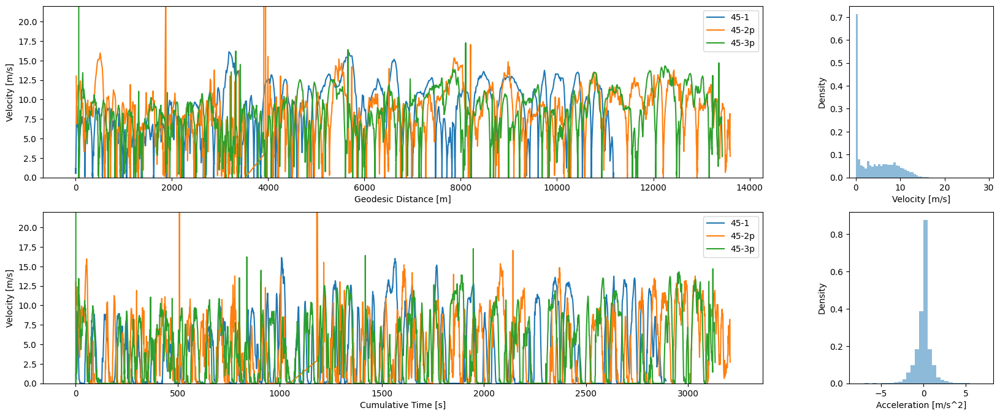

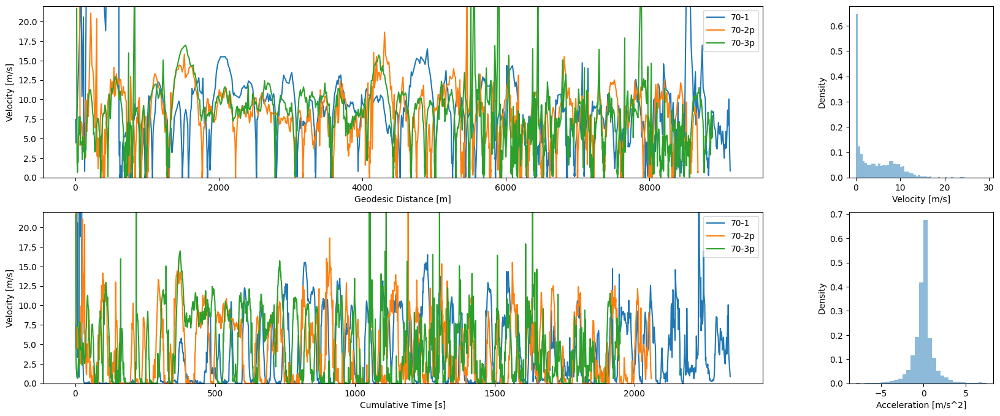

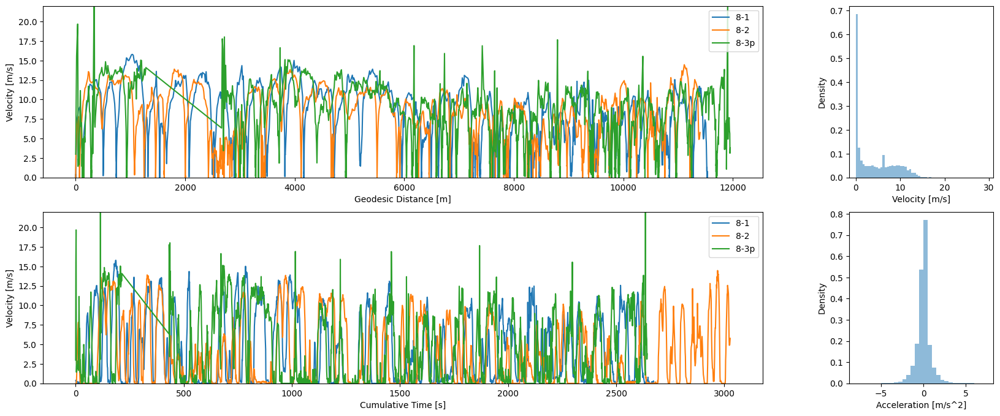

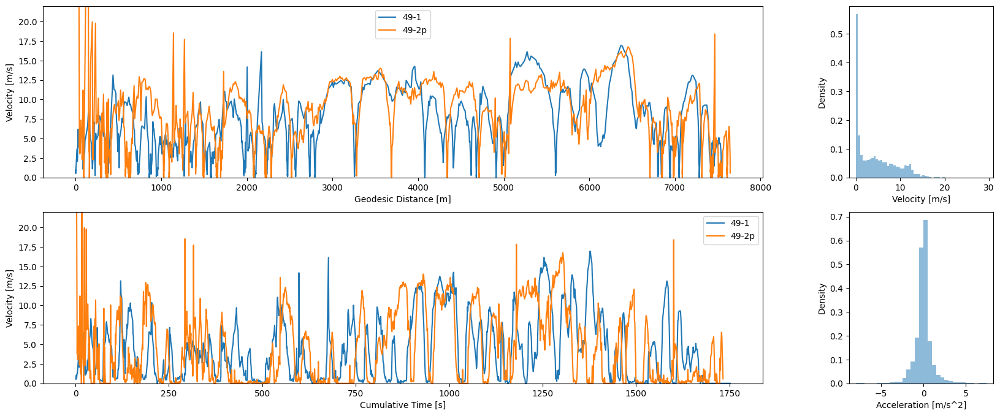

In [38]:
# Set up an empty dictionary to export the runtime statistics
stats = {}
v_hists = {}
a_hists = {}
for route_shortname in routes.keys():
    
    # Set up empty lists for the dataframes, keys, and runtimes
    totalroll = []
    key = []
    runtimes = []
    
    # Set up a plot
    fig, ax = plt.subplots(2, 2, figsize = (20, 8), dpi=100, width_ratios = [10, 2])
    
    # Loop through each sample for the current route
    for sample in routes[route_shortname][:]:
        
        # Empty variable to hold the data
        roll = None
        
        # Check which type of file it is. Depending, load them accordingly.
        if ".csv" in sample:
            roll = load_phone_log(drivepath, sample.split("/")[-1], sample.split("/")[-1].replace("p", 't'))
        else:
            roll = load_gps_log(sample)
            
        # Generate a plot of velocity versus distance and time
        ax[0, 0].plot(roll['gdx'].cumsum(), roll['v'])
        ax[1,0].plot(roll['dt'].cumsum(), roll['v'])
        roll['a']=roll['v'].diff()/roll['dt']
        
        # Add the data to the rolling data collection
        totalroll.append(roll)
        
        # Append the data sample name to the key
        key.append(sample.split("/")[-1].split(".")[0])
        
        # Print the route runtime
        print("Route {}, Sample {}: Total Runtime - {} seconds.".format(route_shortname, sample, roll['dt'].sum()))
        
        
        runtimes.append(roll['dt'].sum())
    
    
    totalroll = pd.concat(totalroll)
    
    # Set up the histogram bins
    vbins = np.arange(0, 30, .5)
    abins = np.arange(-8, 8, .5)
    tbins = np.arange(500, 6000, 100)
    
    
    vct, vbt, vp = ax[0,1].hist(totalroll['v'], alpha=.5, weights=totalroll['dt'], density=True,bins=vbins)

    act, abt, ap = ax[1,1].hist(totalroll['a'], alpha=.5, weights=totalroll['dt'], density=True,bins=abins)
    
    ax[0,0].set_xlabel("Geodesic Distance [m]")
    ax[0,0].set_ylabel("Velocity [m/s]")
    ax[0,0].legend(key)
    ax[0,0].set_ylim(0, 22)
    
    ax[1,0].set_xlabel("Cumulative Time [s]")
    ax[1,0].set_ylabel("Velocity [m/s]")
    ax[1,0].legend(key)
    ax[1,0].set_ylim(0, 22)
    
    ax[0,1].set_xlabel("Velocity [m/s]")
    ax[0,1].set_ylabel("Density")
    
    ax[1,1].set_xlabel("Acceleration [m/s^2]")
    ax[1,1].set_ylabel("Density")
    stats[route_shortname] = (np.asarray(runtimes).mean(), np.asarray(runtimes).std(), len(runtimes))
    v_hists[route_shortname] = (vct, vbt, vp)
    a_hists[route_shortname] = (act, abt, ap)

Text(0, 0.5, 'ESS Load [W]')

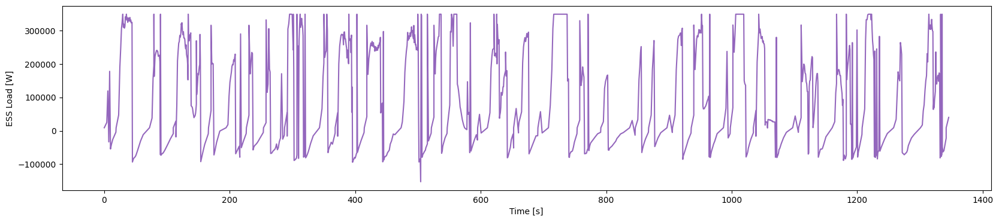

In [39]:
dat = available_routes.get_group(("45",)).reset_index(drop=True)
row = dat.iloc[0]
random.seed(42)
bus = op.load_bus_params(dat['bus'][0])
trip = op.load_trip_params(trip_path)
trip.m_riders = random.uniform(*row.ridership_min_max)
trip.traffic = random.uniform(*traffic_min_max)
trip.chance_sig = random.uniform(*signal_min_max)
trip.v_wind = random.uniform(*wind_speed_min_max)
trip.wind_bearing = gt.compass_heading(random.randrange(*wind_directions_min_max))
trip.seed=int(42)
trip.t_sig = 40
trip.t_stop = 10
ess = op.load_ESS_params(ESS_path)
ess.P_aux = random.randrange(*(p_aux_min_max + (500,)))
bus.f_br = random.uniform(*b_factors)
bus.f_a = random.uniform(*a_factors)
bus.dmax = random.uniform(*max_dist)
result = pd.DataFrame(ts.simulate_trip(gt.load_from_json(dat['path'][0]), trip,bus,ess))
fig, ax = plt.subplots(1, 1, figsize = (20,4), dpi=100)
ax.plot(result['dt'].cumsum(), result['P'].apply(ess.calc_instance_power), c="tab:purple")
ax.set_xlabel("Time [s]")
ax.set_ylabel("ESS Load [W]")


And now, for the comparative Monte Carlo Simulation!! There's a lot in here, so I'm going to break it down into some steps. 
1. The route's shortname is selected and used to get the available group of route save files associated with it. Then, this is further limited to specific runs that align with the collected data so as to limit the scope. In this case, this means that each route shortname will only have 1 monte carlo simulation run in accordance to the GPS data that was collected. 
2. For each possible route iteration in a shortname (in this case, only 1), we will load up the route and then generate a bus, trip, and ESS for each seed available, varying the parameters that were previously defined. 
3. All of these generated options are then passed into Trip_Simulator (via multiprocessing), to be simulated. The results are then processed by the method we set up earlier, as they're a bit tricky to extrapolate from multiprocessing. 
4. After the results are gathered, we go through and plot the histograms and calculate the statistics for each route, including timeline T-Tests from the benchmark data, and comparing histogram fits of the collected acceleration and velocity to the modeled acceleration and velocity. 

-----------------------45-------------------
            dt     grade       v_f       gdx                 geometry
1     4.036697 -5.841519  4.599298  9.354877   POINT (47.69 -122.398)
2     1.611953 -5.841519  6.493849  9.354882   POINT (47.69 -122.398)
3     1.320903 -5.461349  7.587989  9.354887   POINT (47.69 -122.398)
4     1.234265 -5.108984  7.587989  9.354892   POINT (47.69 -122.398)
5     0.903691 -6.539398  7.587989  6.844331   POINT (47.69 -122.398)
...        ...       ...       ...       ...                      ...
1630   1.92623 -2.594544  4.148363  8.885723  POINT (47.662 -122.285)
1631  2.510411 -2.609884   2.93317  8.885719  POINT (47.663 -122.285)
1632   6.05958 -2.625137       0.0  8.885716  POINT (47.663 -122.285)
1633       0.0 -2.625137       0.0  8.885716  POINT (47.663 -122.285)
1634  4.036697 -2.640304  4.029188  8.885713  POINT (47.663 -122.285)

[492450 rows x 5 columns]


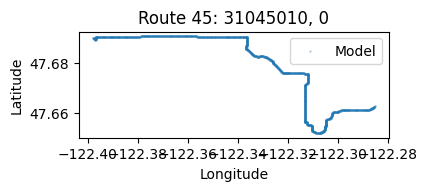

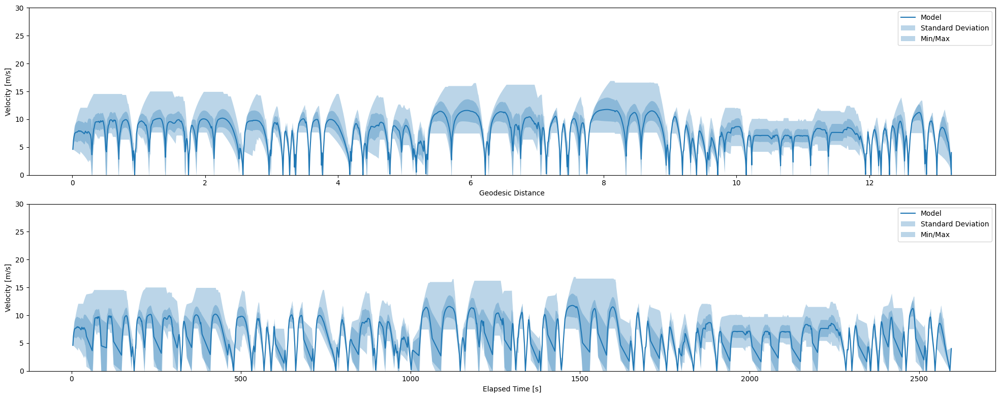

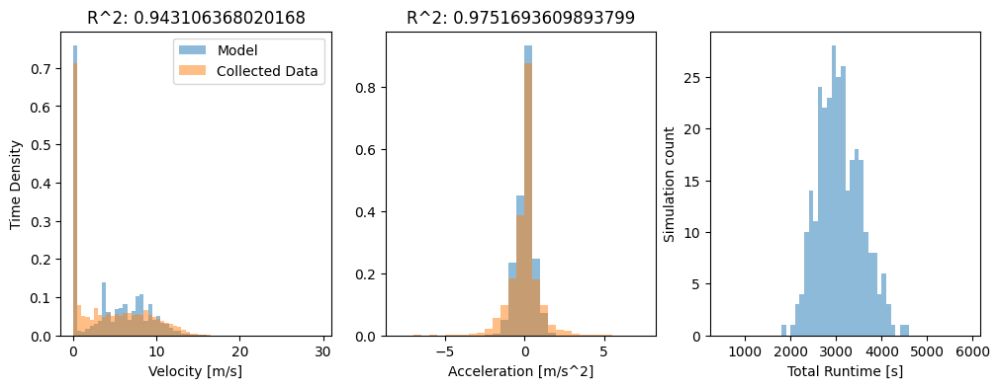

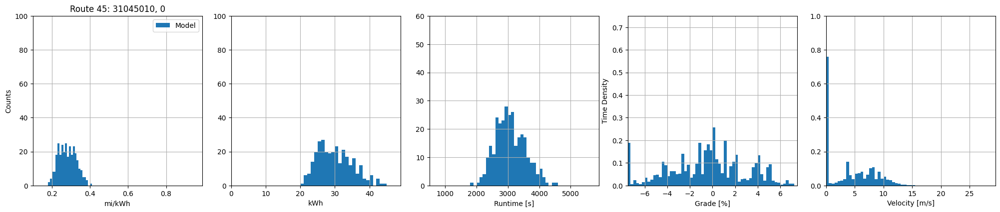

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.18711357594039885), np.float64(0.4000098892390026), np.float64(0.28205524440478025), np.float64(0.04582503884478266))
Energy min/max/mean/std [kWh]: 		(np.float64(20.611686958203126), np.float64(44.06349766842178), np.float64(30.026611080342093), np.float64(4.996049458490272))
Time min/max/mean/std [s]: 		(np.float64(1878.1251324503467), np.float64(4534.648171390194), np.float64(3078.3602521434177), np.float64(474.0254329064824))
Two-Tailed T Test: 		T-score: 0.007019407749263745, P Value: 0.9944040188232127
|Grade| mean/std [%]: 			(np.float64(2.4001478925651556), np.float64(1.8265625916056625))
Velocity mean/std [m/s]: 		(np.float64(4.321378653207029), np.float64(3.8911623647083142))
--------------------------------------------------------------------------------------------------

-----------------------70-------------------
            

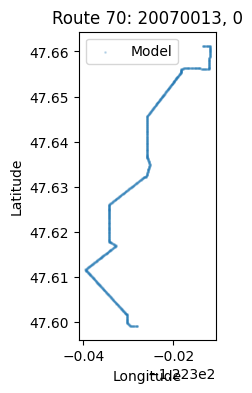

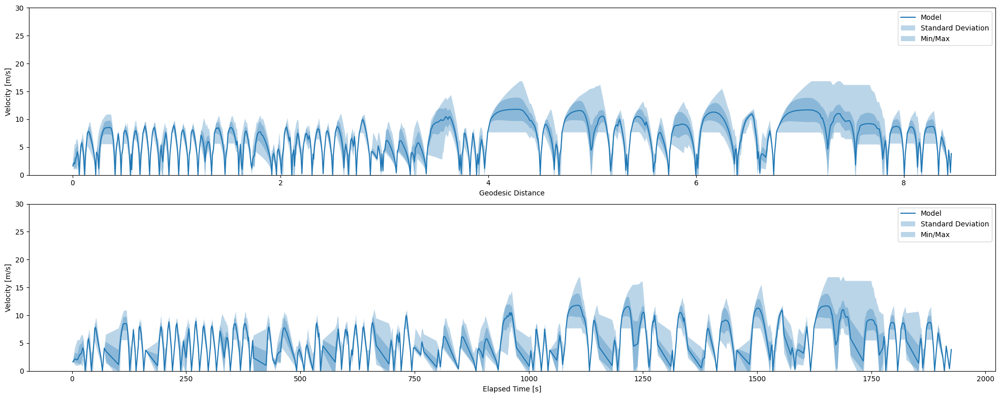

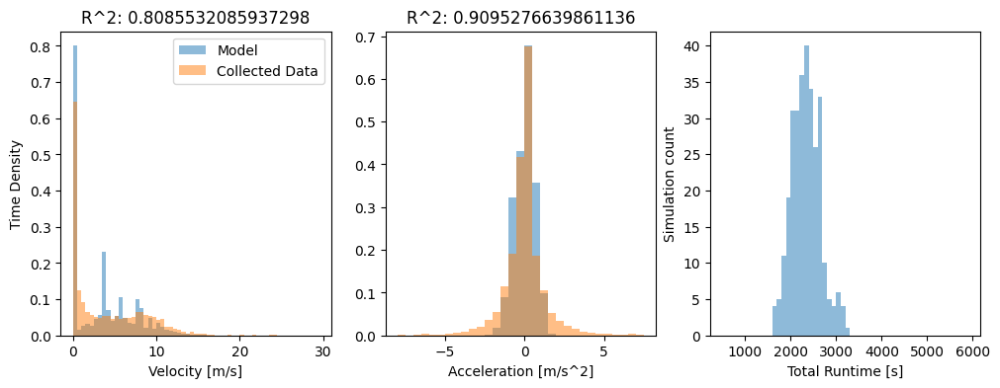

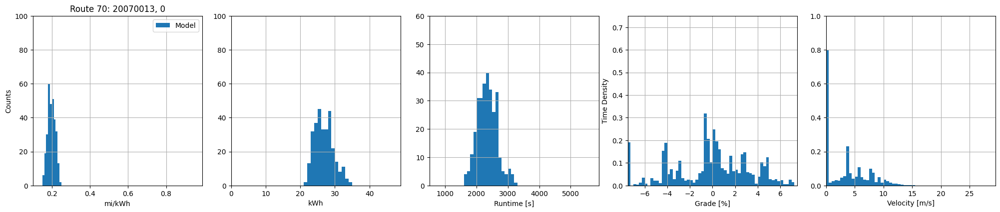

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.1525589222827781), np.float64(0.24664558688409077), np.float64(0.19778767326068272), np.float64(0.019483448772224837))
Energy min/max/mean/std [kWh]: 		(np.float64(21.373223019653658), np.float64(34.5545908191181), np.float64(26.917437841288507), np.float64(2.7131783199460635))
Time min/max/mean/std [s]: 		(np.float64(1624.8958821340962), np.float64(3283.35556670814), np.float64(2342.2176363726276), np.float64(307.6851109412676))
Two-Tailed T Test: 		T-score: 2.305655998797327, P Value: 0.021809519503637048
|Grade| mean/std [%]: 			(np.float64(2.393871704988815), np.float64(1.849340294902651))
Velocity mean/std [m/s]: 		(np.float64(3.6206424058905253), np.float64(3.5294292979301254))
--------------------------------------------------------------------------------------------------

-----------------------8-------------------
            dt 

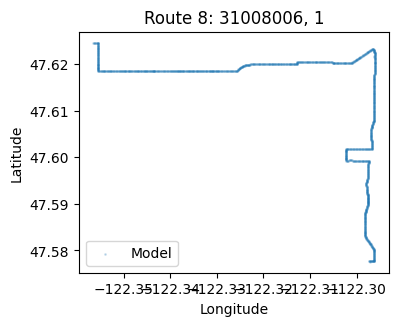

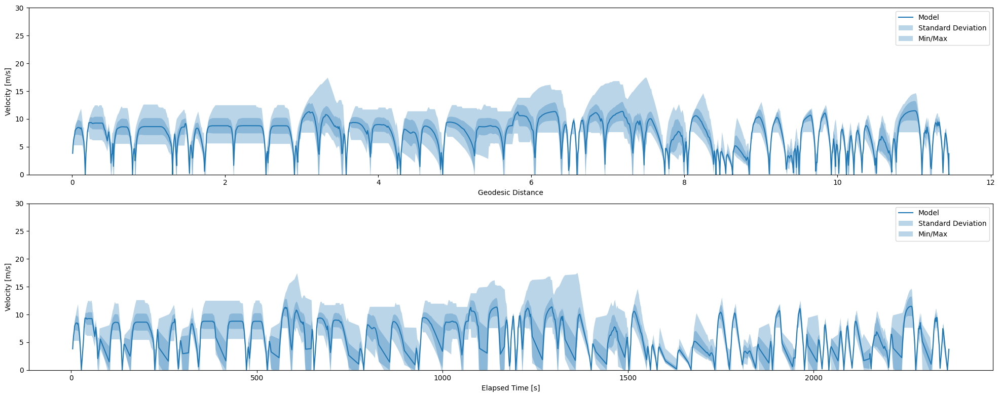

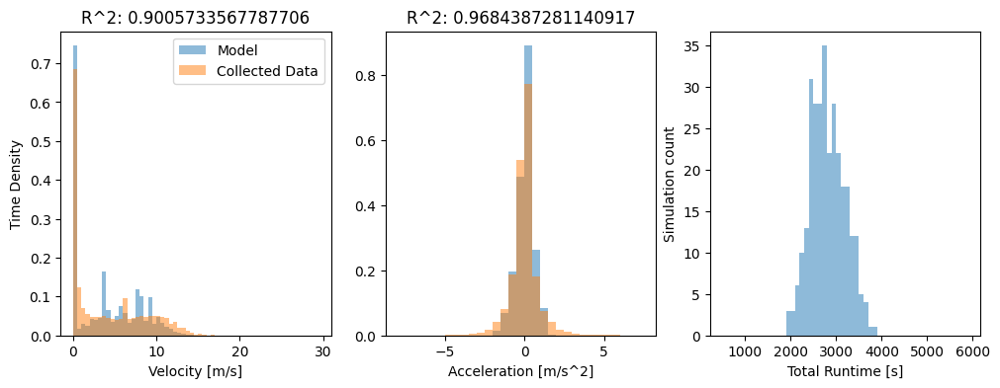

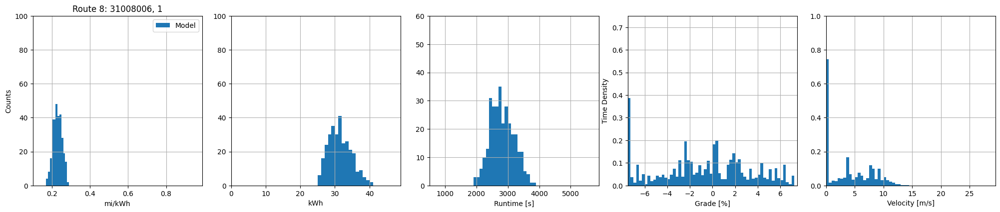

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.17716916203776067), np.float64(0.2843191212076284), np.float64(0.22986599998376137), np.float64(0.023528575195782695))
Energy min/max/mean/std [kWh]: 		(np.float64(25.145058894876193), np.float64(40.35251375282524), np.float64(31.433523292786667), np.float64(3.277096971043152))
Time min/max/mean/std [s]: 		(np.float64(1944.6390534058312), np.float64(3844.620691954276), np.float64(2816.5800248035594), np.float64(375.11166719705875))
Two-Tailed T Test: 		T-score: 0.3449818981851624, P Value: 0.7303489159975152
|Grade| mean/std [%]: 			(np.float64(2.862826185957164), np.float64(2.0090482446779547))
Velocity mean/std [m/s]: 		(np.float64(4.087605836554904), np.float64(3.74143551102434))
--------------------------------------------------------------------------------------------------

-----------------------49-------------------
           dt  

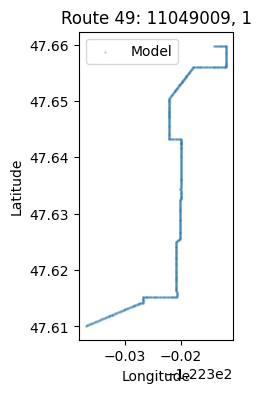

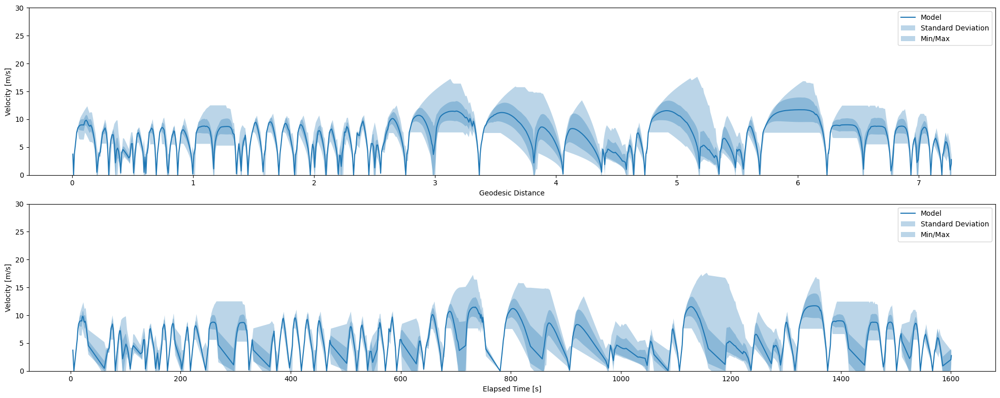

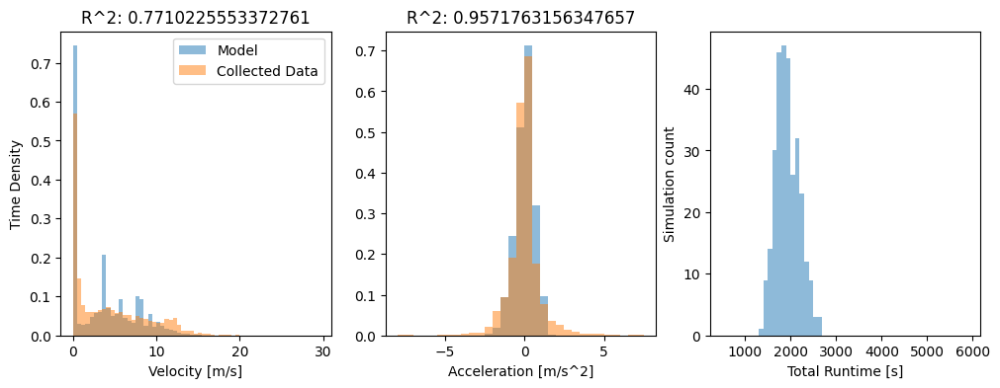

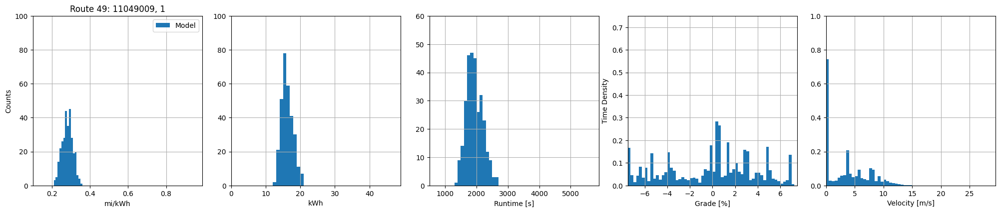

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(np.float64(0.21769794676394535), np.float64(0.3586730556767501), np.float64(0.2821386118549316), np.float64(0.0281283512990083))
Energy min/max/mean/std [kWh]: 		(np.float64(12.640381653716924), np.float64(20.825939702477037), np.float64(16.23261328594582), np.float64(1.6565590627688522))
Time min/max/mean/std [s]: 		(np.float64(1371.6162672902335), np.float64(2645.3790511432853), np.float64(1934.9750449873363), np.float64(253.4549478360897))
Two-Tailed T Test: 		T-score: 11.94639636110591, P Value: 3.5910356578612704e-27
|Grade| mean/std [%]: 			(np.float64(3.021936888079384), np.float64(2.130454867110557))
Velocity mean/std [m/s]: 		(np.float64(3.767534035351201), np.float64(3.559850488647799))
--------------------------------------------------------------------------------------------------



In [40]:

for route_shortname in list(routes.keys())[:]:
    print("-----------------------{}-------------------".format(route_shortname))
    selected_route_instances = available_routes.get_group((route_shortname,)).reset_index(drop=True)
    selected_route_instances['results'] = [[]]*len(selected_route_instances)
    current_route_index = specific_runs[route_shortname]
    current_route_instance = selected_route_instances.iloc[current_route_index]
    for index, row in selected_route_instances[current_route_index:current_route_index+1].iterrows():

        route = gt.load_from_json(row.path)
        busses= []
        trips = []
        esses= []
        for seed in seeds:
            random.seed(int(seed))
            bus = op.load_bus_params(row.bus)
            trip = op.load_trip_params(trip_path)
            trip.m_riders = random.uniform(*row.ridership_min_max)
            trip.traffic = random.uniform(*traffic_min_max)
            trip.chance_sig = random.uniform(*signal_min_max)
            trip.v_wind = random.uniform(*wind_speed_min_max)
            trip.wind_bearing = gt.compass_heading(random.randrange(*wind_directions_min_max))
            trip.seed=int(seed)
            trip.t_sig = random.uniform(*t_sigs)
            trip.t_stop = random.uniform(*t_stops)
            trips.append(trip)
            ess = op.load_ESS_params(ESS_path)
            ess.P_aux = random.randrange(*(p_aux_min_max + (500,)))
            esses.append(ess)
            bus.f_br = random.uniform(*b_factors)
            bus.f_a = random.uniform(*a_factors)
            bus.dmax = random.uniform(*max_dist)
            #print(bus.f_br)
            busses.append(bus)

        all_runs = list(zip([route]*len(trips), trips, busses, esses))
        batched_runs = [all_runs[i:i + batch_size] for i in range(0, len(all_runs), batch_size)]

        res_list = []
        for batch in batched_runs:
            with multiprocessing.Pool(batch_size) as pool:
                res_list.extend(pool.starmap(ts.simulate_trip, batch))

        proc_res = process_result_list(res_list, ess)
        #print(list(proc_res))
        selected_route_instances.at[index, 'results'] = list(proc_res)

    MC= selected_route_instances[current_route_index:current_route_index+1]
    
    # Get the selected instances and plot against the 
    mi_kwh_bins = np.arange(.1, 1, .01)
    kwh_bins = np.arange(0, 50, 1)
    volt_bins = np.arange(20, 50, .5)
    time_bins = np.arange(500, 6000, 100)
    grade_bins = np.arange(-7.5, 7.5, .25)
    vel_bins = np.arange(0, 30, .5)
    vbins = np.arange(0, 30, .5)
    abins = np.arange(-8, 8, .5)
    tbins = np.arange(500, 6000, 100)

    for index, row in MC.iterrows():
        
        # ---- Path Plotting
        fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=100)

        gt.load_from_json(row.path).to_gdf().geometry.apply(lambda x: shapely.ops.transform(gt._flip, x)).plot(ax=ax, markersize=1, color="tab:blue", alpha = .2, zorder = 1)
        ax.set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        ax.legend(["Model", "Collected Data"])

        res = pd.DataFrame(row['results'])

        ddfs = res.apply(lambda x: gpd.GeoDataFrame([x['dt'],x['g'],x['vel'],x['dx'],x['geo']]).T[1:], axis=1)
        lddfs = pd.concat(list(ddfs))
        lddfs = gpd.GeoDataFrame(lddfs)
        print(lddfs)
        lddfs = lddfs[lddfs['dt']!=0].reset_index(drop=True)
        sim = lddfs.groupby('geometry',sort=False).apply(lambda x: (x['dt'].mean(),
                                                         x['grade'].mean(),
                                                         x['v_f'].mean(),
                                                         x['gdx'].mean(),
                                                         x['v_f'].std(),
                                                         x['dt'].std(),
                                                         x['v_f'].min(),
                                                         x['v_f'].max(),
                                                         x['dt'].min(),
                                                         x['dt'].max()), include_groups=False)
        aggregated_sim = pd.DataFrame(sim)
        aggregated_sim['dt'],aggregated_sim['grade'],aggregated_sim['v_f'],aggregated_sim['gdx'],aggregated_sim['sv_f'],aggregated_sim['sdt'],aggregated_sim['mav'],aggregated_sim['miv'],aggregated_sim['mat'],aggregated_sim['mit'] = zip(*aggregated_sim[0])
        aggregated_sim['geometry'] = aggregated_sim.index
        aggregated_sim['gdx']=gt.query_distance_traveled(aggregated_sim['geometry']).cumsum()
        aggregated_sim=gpd.GeoDataFrame(aggregated_sim[['dt',
                                                        'grade',
                                                        'v_f',
                                                        'gdx',
                                                        'geometry',
                                                        'sv_f',
                                                        'sdt',
                                                        'mav',
                                                        'miv',
                                                        'mat',
                                                        'mit']].reset_index(drop=True))

        
        
        
        ## ---- Monte Carlo Profile
        fig, ax = plt.subplots(2, 1, figsize=(20,8), dpi=100)
        plt.tight_layout(pad=2, w_pad=2, h_pad=2)
        ax[0].plot(aggregated_sim['gdx'], aggregated_sim['v_f'])
        ax[0].fill_between(aggregated_sim['gdx'], aggregated_sim['v_f']-aggregated_sim['sv_f'],aggregated_sim['v_f']+aggregated_sim['sv_f'],alpha=.3,zorder = .5)
        ax[0].fill_between(aggregated_sim['gdx'], aggregated_sim['miv'],aggregated_sim['mav'],alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")
        

        ax[0].set_ylim(0, 30)
        ax[0].legend(["Model", "Standard Deviation", "Min/Max", "Collected Data"])
        ax[0].set_xlabel("Geodesic Distance")
        ax[0].set_ylabel("Velocity [m/s]")
        
        ax[1].plot(aggregated_sim['dt'].cumsum(), aggregated_sim['v_f'])
        ax[1].fill_between(aggregated_sim['dt'].cumsum(), aggregated_sim['v_f']-aggregated_sim['sv_f'],aggregated_sim['v_f']+aggregated_sim['sv_f'],alpha=.3,zorder = .5)
        ax[1].fill_between(aggregated_sim['dt'].cumsum(), aggregated_sim['miv'],aggregated_sim['mav'],alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")
        ax[1].set_ylim(0, 30)
        ax[1].legend(["Model", "Standard Deviation", "Min/Max", "Collected Data"])
        ax[1].set_xlabel("Elapsed Time [s]")
        ax[1].set_ylabel("Velocity [m/s]")
        plt.show()

        
        # ---- Histogram Plotting
        fig, ax = plt.subplots(1,3, figsize = (12, 4), dpi=100)

        cm, bm, p = ax[0].hist(lddfs['v_f'], alpha=.5, weights=lddfs['dt'],density=True,bins=vbins)
        
        # Load the collected histogram
        v_hist = v_hists[route_shortname]
        ct, bt, p = ax[0].hist(v_hist[1][:-1], alpha=.5, weights=v_hist[0], density=True, bins=v_hist[1])
        
        v_r2 = rsq(ct, cm)
        ax[0].set_title("R^2: {}".format(v_r2))

        cm, bm, p = ax[1].hist(lddfs['v_f'].diff()/lddfs['dt'], alpha=.5, weights=lddfs['dt'],density=True,bins=abins)
        
        # Load the collected a histogram
        a_hist = a_hists[route_shortname]
        ct, bt, p = ax[1].hist(a_hist[1][:-1], alpha=.5, weights=a_hist[0], density=True, bins=a_hist[1])
        
        a_r2 = rsq(ct, cm)
        ax[1].set_title("R^2: {}".format(a_r2))
        
        # Plot runtime
        cm, bm, p = ax[2].hist(ddfs.apply(lambda x: x['dt'].sum()),alpha=.5, bins=tbins, color="tab:blue")

        ax[0].legend(["Model", "Collected Data"])
        ax[0].set_xlabel("Velocity [m/s]")
        ax[1].set_xlabel("Acceleration [m/s^2]")
        ax[2].set_xlabel("Total Runtime [s]")
        ax[0].set_ylabel("Time Density")
        ax[2].set_ylabel("Simulation count")


        plt.show()

        # Plot the statistics ----------------
        fig, ax = plt.subplots(1, 5, figsize = (20,4), dpi=100)
        plt.tight_layout()



        milage = pd.Series(res['miles']/res['kwh'])
        mimin, mimax, mimean, mistd = milage.min(), milage.max(), milage.mean(), milage.std()
        ax[0].hist(milage, bins=mi_kwh_bins)
        ax[0].set_ylim(0, 100)
        ax[0].set_xlim(mi_kwh_bins.min(), mi_kwh_bins.max())
        ax[0].set_xlabel("mi/kWh")
        ax[0].set_ylabel("Counts")
        ax[0].set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
        ax[0].grid()

        ax[1].hist(res['kwh'], bins=kwh_bins)
        enmin, enmax, enmean, enstd = res['kwh'].min(), res['kwh'].max(), res['kwh'].mean(), res['kwh'].std()
        ax[1].set_ylim(0, 100)
        ax[1].set_xlabel("kWh")
        ax[1].set_xlim(kwh_bins.min(), kwh_bins.max())
        ax[1].grid()

        ax[2].hist(res['tot_time'], bins=time_bins)
        tmin, tmax, tmean, tstd = res['tot_time'].min(), res['tot_time'].max(), res['tot_time'].mean(), res['tot_time'].std()
        ax[2].set_ylim(0, 60)
        ax[2].set_xlim(time_bins.min(), time_bins.max())
        ax[2].set_xlabel("Runtime [s]")
        ax[2].grid()
        ax[0].legend(["Model", "Collected Data"])

        #print(tmean, tstd, len(seeds), stats[route_shortname][0], stats[route_shortname][1], stats[route_shortname][2])
        t_val = t_value_eqn(tmean, tstd, len(seeds), stats[route_shortname][0], stats[route_shortname][1], stats[route_shortname][2])
        p_val = sci_t.sf(abs(t_val), len(seeds) + stats[route_shortname][2] - 2)*2
        
        t = pd.concat(list(res['dt'])).reset_index(drop=True)


        g = pd.concat(list(res['g'])).reset_index(drop=True)
        gvals, gbins, gbcon = ax[4-1].hist(g.apply(abs), bins=grade_bins, weights=t, density=True,alpha = 0)
        ax[4-1].hist(g, bins=grade_bins, weights=t, density=True, color='tab:blue')
        #g.hist(ax=ax[4], bins=grade_bins, weights=t, density=True)
        ax[4-1].set_xlim(-7.5, 7.5)
        ax[4-1].set_ylim(0, .75)
        ax[4-1].set_xlabel("Grade [%]")
        ax[4-1].set_ylabel("Time Density")
        ax[4-1].grid()

        vel = pd.concat(list(res['vel'])).reset_index(drop=True)
        velvals, velbins, velbcon = ax[5-1].hist(vel, bins=vel_bins, weights=t, density=True)
        ax[5-1].set_xlim(vel_bins.min(), vel_bins.max())
        ax[5-1].set_ylim(0, 1)
        ax[5-1].set_xlabel("Velocity [m/s]")
        #ax[5-1].set_ylabel("Time Density")
        ax[5-1].grid()


        plt.show()

        print("-------------------------------------------model statistics---------------------------------------")
        # Print the statistics
        print("Milage min/max/mean/std [mi/kWh]: \t{}".format((mimin, mimax, mimean, mistd)))
        print("Energy min/max/mean/std [kWh]: \t\t{}".format((enmin, enmax, enmean, enstd)))
        print("Time min/max/mean/std [s]: \t\t{}".format((tmin, tmax, tmean, tstd)))
        print("Two-Tailed T Test: \t\tT-score: {}, P Value: {}".format(t_val, p_val))
        print("|Grade| mean/std [%]: \t\t\t{}".format(calculate_statistics_from_hist(gvals, gbins, gbcon)))
        print("Velocity mean/std [m/s]: \t\t{}".format(calculate_statistics_from_hist(velvals, velbins, velbcon)))

        print("--------------------------------------------------------------------------------------------------")
        print()

There's a lot in the simulations above, but ultimately they can be broken down to 3 general values that we're looking at. 
1. __Runtime__:

    The runtime of the monte carlo simulations are being compared to the runtime of the collected data using a two-tailed student's T-Test. The breakdown is as follows:
    | Route  | T-Score VS. Reality | P Value |
    |-------|-----|-------|
    | 45* | -0.7635889550919016 | 0.4457103256018029 |
    | 70 | 1.6400375619219862 | 0.10204196024069481 |
    | 8 | 1.4250543065401782 | 0.155177564592491 |
    | 49** | 8.918429486067792  | 4.752521488238478e-17 |
    
    
    Which, in other words, means that save for the exception of route 49, the Monte Carlo Model distribution of total runtime supports the null hypothesis when being compared to the logged total runtime. This, and any other examination of metrics, are limited by the fact that the bus rides that were taken were a limited sampling, and therefore were not able to encompass all potential times and conditions. 
    
    Using King County's hypothetical runtimes*** for each of these roues, we can also perform a more generalized two-tailed T-Test:
    
    | Route  | Model T-Score VS. Expectation | P Value |
    |-------|-----|-------|
    | 45* | -3.334 | 0.0009 |  
    | 70 | 4.921 | <.00001 |
    | 8 | 17.83 | <.00001  |
    | 49** | 3.689 | <.00001  |
    
    
    | Route  | Expectation T-Score VS. Reality| P Value |
    |-------|-----|-------|
    | 45* | -1.499 | 0.1384 |
    | 70 | -0.07025 | .944 |
    | 8 | 4.851 |  <.00001 |
    | 49** | -2.592 | 0.01 |
    
    We can distill this information down to essentially say that the model, as a whole, is slightly more accurate to the real runtime than the expectation is to the real runtime. Likewise, the model is significantly different from the expectation of the bus runtimes. 
    
2. __Acceleration Distribution__:

    Between acceleration and velocity, acceleration is ultimately the more important metric, as it's both a primary indicator of which decisions are being made and used when calculating out power. To evaluate the accuracy of the acceleration modeling, the histogram distribution of acceleration for both the model and the collected data are compared through an R-squared metric using each bin and the bin height. Aside from route 70 at its r^2 of .88, the remainder are all above .9 - suggesting a reasonably high accuracy of the model to reality. The differences are in how the bus is accelerating and decellerating. The Model appears to spend less time at the lower accelerations than in reality, instead skewing towards middling amounts of acceleration. Likewise, for the decelleration, the model spends less time at the higher decellerations. Ultimately, these differences are not inherent to the model explicitly, and can actually change depending on parameter inputs - there's more elaboration on that below. 
    
3. __Velocity Distribution__: 

    Using the same method of R-squared evaluation with velocity paints a picture of a model that is less accurate to reality - with the best fit being for route 45, and the worst being for route 49. Looking at the graphs themselves, the behavior is consistent - the model is routinely overestimating time spent stopped, and underestimating time spent at lower velocities. In other words, the busses in reality are moving at a crawl more often than they are at a complete stop. 
    
*- In the case of route 45, one sample runtime was underapproximated by ~120 seconds, by virtue of a data logging error. 

**- In the case of route 49, only 2 samples were taken. 

***- Calculated from Tabulated times as reported by King County Metro: https://kingcounty.gov/en/dept/metro/routes-and-service/schedules-and-maps

#### Examining the Acceleration Profile Impact
As seen above, there's a discrepancy between reality and how the bus is modeled to be accelerating. The bus uses an acceleration profile to determine how it moves, and as such, adjusting that can have an impact on the model. So, we're going to compare a few. 

In [20]:
# Load up all the existing data and condense it to make acceleration and decelleration profiles. 

ayes = []
tweights = []
roll_call_1 = []
for route_shortname in routes.keys():
    totalroll = []
    key = []
    for sample in routes[route_shortname]:
        roll = None
        if ".csv" in sample:
            roll = load_phone_log(drivepath, sample.split("/")[-1], sample.split("/")[-1].replace("p", 't'))
        else:
            roll = load_gps_log(sample)
        roll['a']=roll['v'].diff()/roll['dt']
        totalroll.append(roll)
        key.append(sample.split("/")[-1].split(".")[0])
    r45roll = pd.concat(totalroll)
    
    r45roll['geometry'] = r45roll['geometry'].apply(lambda x: shapely.ops.transform(gt._flip, x))
    r45roll = gpd.GeoDataFrame(r45roll)
    r45roll.set_crs(epsg=4326)
    r45roll = r45roll.reset_index(drop=True)
    
    ayes.extend(list(r45roll['a']))
    tweights.extend(r45roll['dt'])
    roll_call_1.append(r45roll)
a = pd.DataFrame([ayes, tweights]).T
apos = a[a[0]>.1]
apos_sort = apos.sort_values(0)[0:-130].reset_index(drop=True)

def rf_spitball(x):
    m, b = x
    a_prof_path = "KC_Example_Data/Acceleration_Profiles/spitball.csv"
    op.generate_a_profile(a_prof_path, m=m, b=b)
    a_prof = pd.read_csv(a_prof_path, header=None)
    a_prof = a_prof.apply(lambda x: x[1]*9.81, axis=1)
    a_prof
    bs = np.arange(-9, 9, .25)
    #fig, ax = plt.subplots(1, 1, figsize=(20, 4), dpi=100)
    a_prof_sort = a_prof.sort_values()[:].reset_index(drop=True)
    fig, ax = plt.subplots(1, 1)
    cm, bm,p =ax.hist(a_prof_sort, density=True, bins=bs, weights=a_prof_sort.apply(lambda x: .5), alpha=.5)
    ct,bt,p = ax.hist(apos_sort[0], density=True, bins=bs, weights=apos_sort[1], alpha=.5)
    rsq_res = rsq(ct, cm)
    plt.close()
    return (1-rsq_res)

#optimizefunc(rf_spitball, [(-10, 10),(-10, 10)])
#plt.plot(a_prof_sort.apply(lambda x: .5).cumsum()/a_prof_sort.apply(lambda x: .5).sum(),a_prof_sort)

NameError: name 'routes' is not defined

By cutting off the acceleration data each time the velocity is less than 1 m/s, we can group the accelerations into segments and take the mean at each second along that segment!

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


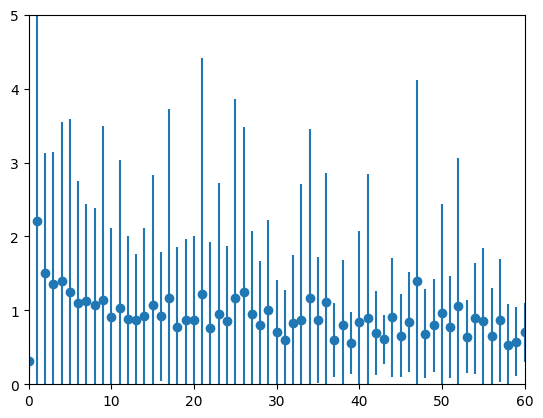

In [26]:
roll_call = pd.concat(roll_call_1).reset_index(drop=True)
nullindexes = list(roll_call[roll_call['v'].apply(abs)<1].index)
roll_call['cdt']=roll_call['dt'].cumsum()
for index in nullindexes:
    roll_call.loc[ index:,'cdt']= roll_call.loc[ index:,'cdt'] - roll_call['cdt'][index]
rpos = roll_call[roll_call['a']>.1]
rpos['cdt'] = rpos["cdt"].apply(lambda x: round(x))
rmean = rpos.groupby(["cdt"])['a'].mean()
fig, ax = plt.subplots(1, 1)
ax.errorbar(rmean.index, rmean.values, yerr = rpos.groupby(["cdt"])['a'].std().values, fmt="o")
ax.set_ylim(0, 5)
ax.set_xlim(0, 60)
plt.show()

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


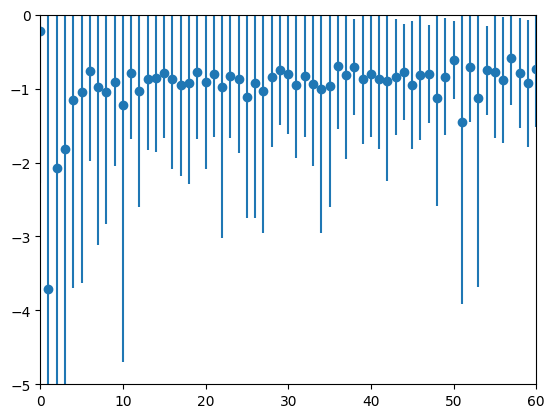

In [27]:
roll_call = pd.concat(roll_call_1).reset_index(drop=True)
nullindexes = list(roll_call[roll_call['v'].apply(abs)<1].index)
roll_call['cdt']=roll_call['dt'].cumsum()
for index in nullindexes:
    roll_call.loc[ index:,'cdt']= roll_call.loc[ index:,'cdt'] - roll_call['cdt'][index]
rpos = roll_call[roll_call['a']<.1]
rpos['cdt'] = rpos["cdt"].apply(lambda x: round(x))
rmean = rpos.groupby(["cdt"])['a'].mean()
fig, ax = plt.subplots(1, 1)
ax.errorbar(rmean.index, rmean.values, yerr = rpos.groupby(["cdt"])['a'].std().values, fmt="o")
ax.set_xlim(0, 60)
ax.set_ylim(-5, 0)
plt.show()

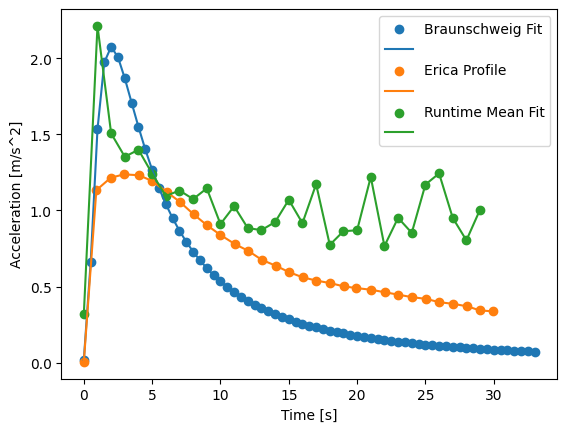

In [28]:
m, b = (-2.7077364683378673, 2.5)
a_prof_path = "KC_Example_Data/Acceleration_Profiles/Braunschweig_Acceleration.csv"
op.generate_a_profile(a_prof_path)
a_prof = pd.read_csv(a_prof_path, header=None)
a_prof[1] = a_prof.apply(lambda x: x[1]*9.81, axis=1)
a_prof
bs = np.arange(-9, 9, .25)
#fig, ax = plt.subplots(1, 1, figsize=(20, 4), dpi=100)
a_prof_sort = a_prof[1].sort_values()[:].reset_index(drop=True)
fig, ax = plt.subplots(1, 1)
ax.scatter(a_prof[0], a_prof[1], c="tab:blue")
ax.plot(a_prof[0], a_prof[1], c="tab:blue")
a_prof_path = "KC_Example_Data/Acceleration_Profiles/Erica_Acceleration.csv"
a_prof = pd.read_csv(a_prof_path, header=None)
a_prof[1] = a_prof.apply(lambda x: x[1]*9.81, axis=1)
ax.scatter(a_prof[0], a_prof[1], c="tab:orange")
ax.plot(a_prof[0], a_prof[1], c="tab:orange")
a_prof_path = "KC_Example_Data/Acceleration_Profiles/Agg_Acceleration.csv"
a_prof = pd.read_csv(a_prof_path, header=None)
a_prof[1] = a_prof.apply(lambda x: x[1]*9.81, axis=1)
ax.scatter(a_prof[0], a_prof[1], c="tab:green")
ax.plot(a_prof[0], a_prof[1], c="tab:green")
ax.set_xlabel("Time [s]")
ax.set_ylabel("Acceleration [m/s^2]")
ax.legend(["Braunschweig Fit", "","Erica Profile", "","Runtime Mean Fit",""])
'''
a_prof_path = "KC_Example_Data/Acceleration_Profiles/Erica_Acceleration.csv"
a_prof = pd.read_csv(a_prof_path, header=None)
a_prof[1] = a_prof.apply(lambda x: x[1]*9.81, axis=1)
a_prof.iloc[6:, 1] = a_prof.iloc[6:, 1].apply(lambda x: x - (-1.1*x+1.3))
a_prof.iloc[11:, 1] = a_prof.iloc[11:, 1].apply(lambda x: x+(-.5*x+.3))
ax.scatter(a_prof[0], a_prof[1], c="green")
a_prof.apply(lambda x: x[1]/9.81, axis=1)
'''
a_prof.to_csv("KC_Example_Data/Acceleration_Profiles/Custom_Acceleration.csv" ,index=False)
#plt.show()

In [29]:
a_prof_path = "KC_Example_Data/Acceleration_Profiles/Custom_Acceleration.csv"
a_prof = pd.read_csv(a_prof_path, header=None)
a_prof[1] = a_prof.apply(lambda x: x[1]*9.81, axis=1)
a_prof[6:].apply(lambda x: x-(0-x)*.5)

,0,1
6,7.5,18.279691
7,9.0,16.118360
8,10.5,16.646922
9,12.0,15.821176
10,13.5,16.852909
11,15.0,13.403367
12,16.5,15.132161
13,18.0,13.011972
14,19.5,12.820674
15,21.0,13.601114


#### Selectivity Analysis Stuff

In [20]:
import ast
def optimizefunc(func, ranges):
    '''
    optimizefunc takes a function with n parameters, and a set of n ranges for each parameter,
    and attempts to minimize the return value of the function. 
    '''
    # Set seed for optimization randomization
    random.seed(42)
    
    # Max iterations is 30
    max_iterations=100
    iterations = 0
    
    rep_iterations = 0
    # Get number of dimensions for hyper-triangle
    ndim = 1+ len(ranges)
    
    # Dictionary for the points
    point_dict = {}
    lowest_max = (9999, 0)
    # render the first point set, this could be done with multiprocessing
    for i in range(ndim):
        args = []
        for j in range(len(ranges)):
            #print(ranges[j])
            arg = random.uniform(*ranges[j])
            args.append(arg)
        result = func(tuple(args))
        point_dict[str(args)]=result

    # Loop the number of times specified
    while iterations < max_iterations:
        
        print("Evaluating literals...", end='\r')
        
        # get the furthest point's parameters
        furthest_pt = ast.literal_eval(max(point_dict, key=point_dict.get))
        furthest_val = point_dict[max(point_dict, key=point_dict.get)]
        
        # Check if the lowest max value is higher than the current
        if furthest_val < lowest_max[0]:
            lowest_max = (furthest_val, furthest_pt)

        # remove it from the dict
        del point_dict[max(point_dict, key=point_dict.get)]
        
        print("Loading hyperplane params...", end='\r')
        # get the vectors for the hyperplane
        hyperplane_vectors = list(point_dict.keys())
        
        # Convert them to actual vectors
        for i in range(len(hyperplane_vectors)):
            hyperplane_vectors[i] = ast.literal_eval(hyperplane_vectors[i])
        
        print("Calculating hyperplane...", end='\r')
        # get the hyperplane equation
        hyperplane_eqn = np.linalg.solve(hyperplane_vectors, [-1]*len(hyperplane_vectors))
        
        print("Evaluating hyperplane normal...", end='\r')
        # get the hyperplane normal
        hyperplane_normal_len = np.sqrt(sum(np.square(hyperplane_eqn)))
        
        # get the normalized hyperplane vector
        normalized_vector = hyperplane_eqn/hyperplane_normal_len
        
        print("Calculating Mirror Point...", end='\r')
        # Get the sign distance for the furthest point
        signdist = sum(normalized_vector*furthest_pt)
        
        # Get the mirrored version of that point
        mirrorpt = furthest_pt -2*normalized_vector*signdist
        
        mirrorpt = ensure_in_range(mirrorpt, ranges)
        
        print("Calculating Centroid...", end='\r')
        # Calculate the centroid of the hyperplane and mirror
        centroid = (sum([np.asarray(ls) for ls in hyperplane_vectors]) + mirrorpt)/(len(hyperplane_vectors)+1)
        centroid = ensure_in_range(centroid, ranges)
        
        print("Running Mirror Point...", end='\r')
        # run the function with the mirror and the centroid
        mir = func(mirrorpt)
        print("Running Centroid Point...", end='\r')
        cent = func(centroid)
        
        # if the mirror result is lower than the centroid, keep it
        if mir < cent:
            point_dict[str(mirrorpt.tolist())] = mir
            
        # otherwise, keep the centroid result
        else:
            point_dict[str(centroid.tolist())] = cent
        
        if point_dict[max(point_dict, key=point_dict.get)] == furthest_val:
            rep_iterations += 1
        
        if rep_iterations > 2: 
            closest_key = min(point_dict, key=point_dict.get)
            closest_val = point_dict[closest_key]
            point_dict = {}
            point_dict[closest_key] = closest_val
            for i in range(ndim-1):
                args = []
                for j in range(len(ranges)):
                    #print(ranges[j])
                    arg = random.uniform(*ranges[j])
                    args.append(arg)
                result = func(tuple(args))
                point_dict[str(args)]=result
            rep_iterations = 0
        # update iterations. 
        print(iterations, point_dict[min(point_dict, key=point_dict.get)], point_dict[max(point_dict, key=point_dict.get)])
        iterations+=1
    
    # return the lowest value parameter set found. 
    print(lowest_max)
    return min(point_dict, key=point_dict.get), point_dict[min(point_dict, key=point_dict.get)]


def runfunction(params):
    '''
    runfunction takes a list of 11 parameters, 
    and then runs a simulation of a trip based on the passed parameters. 
    returns a weighted sum of r^2 values for acceleration and velocity,
    based on bin distribution.
    Also plots them.
    '''
    arg1, arg2,arg3,arg4,arg5,arg6,arg7,arg8,arg9,arg10,arg11,arg12,arg13,arg14 = params
    #print(params)
    
    # Set up the bus, trip, and ESS params
    route = gt.load_from_json(list(selected_route_instances.path)[current_route_index])
    bus = op.load_bus_params(current_route_instance.bus)
    trip = op.load_trip_params(trip_path)
    trip.m_riders = arg1
    trip.traffic = arg2
    trip.chance_sig = arg3
    trip.v_wind = arg4
    trip.wind_bearing = gt.compass_heading(arg5)
    trip.seed=arg6
    ess = op.load_ESS_params(ESS_path)
    ess.P_aux = arg7
    bus.f_br = arg8
    a_prof_path = "KC_Example_Data/Acceleration_Profiles/spitball.csv"
    op.generate_a_profile(a_prof_path, m=arg13, b=arg14)
    bus.a_prof = pd.read_csv(a_prof_path, header=None)
    bus.f_a = arg9
    trip.t_sig = arg10
    trip.t_stop = arg11
    bus.dmax = arg12
    res = process_result_list([ts.simulate_trip(route, trip, bus, ess)], ess).iloc[0]
    model_v = res['vel'][1:]
    model_dt = res['dt'][1:]
    
    #lmix = r45roll.sjoin_nearest(aggregated_sim, how="right")
    fig, ax = plt.subplots(1,3, figsize = (12, 4), dpi=100)
    vbins = np.arange(0, 30, 1)
    abins = np.arange(-8, 8, .5)
    tbins = np.arange(1000, 3000, 100)
    
    ct, bt, p = ax[0].hist(r45roll['v'], alpha=.5, weights=r45roll['dt'], density=True, bins=vbins)
    cm, bm, p = ax[0].hist(model_v, alpha=.5, weights=model_dt,density=True, bins=vbins)
    v_r2 = rsq(ct, cm)

    ct, bt, p = ax[1].hist(r45roll['v'].diff()/r45roll['dt'], alpha=.5, weights=r45roll['dt'], density=True, bins=abins)
    cm, bm, p = ax[1].hist(model_v.diff()/model_dt, alpha=.5, weights=model_dt,density=True, bins=abins)
    a_r2 = rsq(ct, cm)
    ax[0].set_title(v_r2)
    ax[1].set_title(a_r2)
    
    plt.close()
    return (1-v_r2) +(1-a_r2)


def runfunction_power(arg1, arg2,arg3,arg4,arg5,arg6,arg7,arg8,arg9,arg10,arg11):
    '''
    runfunction takes a list of 11 parameters, 
    and then runs a simulation of a trip based on the passed parameters. 
    returns a weighted sum of r^2 values for acceleration and velocity,
    based on bin distribution.
    Also plots them.
    '''

    #print(params)
    
    # Set up the bus, trip, and ESS params
    route = gt.load_from_json(list(selected_route_instances.path)[current_route_index])
    bus = op.load_bus_params('./KC_Example_Data/Saved_Objects/Busses/XDE60.txt')
    trip = op.load_trip_params(trip_path)
    trip.m_riders = arg1
    trip.traffic = arg2
    trip.chance_sig = arg3
    trip.v_wind = arg4
    trip.wind_bearing = gt.compass_heading(arg5)
    trip.seed=arg6
    ess = op.load_ESS_params(ESS_path)
    ess.P_aux = arg7
    bus.f_br = arg8
    bus.f_a = arg9
    trip.t_sig = arg10
    trip.t_stop = arg11
    res = process_result_list([ts.simulate_trip(route, trip, bus, ess)], ess).iloc[0]
    
    return res['miles']/res['kwh']

In [21]:
import SALib
from SALib.sample import sobol as sobsample
from SALib.analyze import sobol
import datetime as dt

results_dict = []
times = np.asarray([0])
def submethod(arg1, arg2,arg3,arg4,arg5,arg6,arg7,arg8,arg9,arg10,arg11):

    out = 0
    try:
        out = runfunction_power(arg1, arg2,arg3,arg4,arg5,arg6,arg7,arg8,arg9,arg10,arg11)
    except:
        out = 0
    return out

for route in list(routes.keys())[:]:
    selected_route_instances = available_routes.get_group((route,)).reset_index(drop=True)
    #selected_route_instances['results'] = [[]]*len(selected_route_instances)
    current_route_index = specific_runs[route]
    current_route_instance = selected_route_instances.iloc[current_route_index:current_route_index+1]

    #for index, row in selected_route_instances[current_route_index:current_route_index+1].iterrows():
    problem = {'num_vars':11,
               'names':['riders',
                        'traffic',
                        'signal chance',
                        'wind speed',
                        'wind bearing',
                        'seed',
                        'aux power',
                        'braking factor',
                        'acceleration factor',
                        'signal time',
                        'stop time'],
               'bounds':np.array([abs_ridership,
                               traffic_min_max,
                               signal_min_max,
                               wind_speed_min_max,
                               wind_directions_min_max,
                               seed_range,
                               p_aux_min_max,
                               b_factors,
                               a_factors,
                               t_sigs,
                               t_stops]).tolist()
              }

    param_values = sobsample.sample(problem, 256).tolist()
    for i in range(len(param_values)):
        param_values[i] = tuple(param_values[i])
    Y = []
    batched_runs = [param_values[i:i + batch_size] for i in range(0, len(param_values), batch_size)]
    print(len(param_values))
    #print(batched_runs[0])
    print(len(batched_runs))


    for i in range(len(param_values))[:]:
        ti = dt.datetime.now()
        params = param_values[i]
        print("{:.2f}% --- Estimated Time Remaining: {:.2f} [minutes]\t".format(i/len(param_values)*100, (times.mean()*len(param_values)*4 - times.sum())/60), end='\r')
        Y.append(submethod(*params))
        tf = dt.datetime.now()
        times = np.append(times, np.asarray((tf-ti).total_seconds()))
        '''
        with multiprocessing.Pool(batch_size) as pool:
            Y.extend(pool.starmap(submethod, batch))
                '''
    
    Si = sobol.analyze(problem, np.asarray(Y))
    results_dict.append({"RT":route,"Si":Si, "vars":problem['names']})

6144
473
99.98% --- Estimated Time Remaining: 810.01 [minutes]		

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\SALib\util\__init__.py:274: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  names = list(pd.unique(groups))


6144
473
99.98% --- Estimated Time Remaining: 457.15 [minutes]	

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\SALib\util\__init__.py:274: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  names = list(pd.unique(groups))


6144
473
99.98% --- Estimated Time Remaining: 234.03 [minutes]	

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\SALib\util\__init__.py:274: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  names = list(pd.unique(groups))


6144
473
99.98% --- Estimated Time Remaining: 0.00 [minutes]			

C:\Users\Sebastian\anaconda3\envs\reRoute_Dynamics_test\Lib\site-packages\SALib\util\__init__.py:274: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  names = list(pd.unique(groups))


In [22]:
def plot_sens(x):
    "Plots a row of the sensitivity analysis"
    
    print(x["RT"])
    fig, ax = plt.subplots(4, 1, figsize=(10, 40), dpi=100)
    
    ax[1].set_title("First Order Sensitivity")
    ax[1].barh(x['vars'], x['Si']['S1'], xerr=x['Si']['S1_conf'])
    ax[1].set_xlim(-1.5, 1.5)
    ax[1].grid()

    ax[0].set_title("Total Order Sensitivity")
    ax[0].barh(x['vars'], x['Si']['ST'], xerr=x['Si']['ST_conf'])
    ax[0].set_xlim(-1.5, 1.5)
    ax[0].grid()

    sis2 = x['Si']['S2']
    sis2c = x['Si']['S2_conf']
    ax[2].imshow(sis2)
    for i in range(len(sis2)):
        for j in range(len(sis2)):
            ax[2].annotate(str(round(sis2[i][j], 3)), xy = (j, i), ha='center', va='center')
    ax[2].set_xticks(range(len(problem['names'])),problem['names'], rotation=45, rotation_mode="anchor", ha="right")
    ax[2].set_yticks(range(len(problem['names'])),problem['names'])
    ax[2].set_title("Second Order Sensitivity")

    ax[3].imshow(sis2c)
    for i in range(len(sis2c)):
        for j in range(len(sis2c)):
            ax[3].annotate(str(round(sis2c[i][j], 3)), xy = (j, i), ha='center', va='center')
    ax[3].set_xticks(range(len(problem['names'])),problem['names'], rotation=45,rotation_mode="anchor", ha="right")
    ax[3].set_yticks(range(len(problem['names'])),problem['names'])
    ax[3].set_title("Second Order Uncertainty ")
    return fig, ax

45
70
8
49


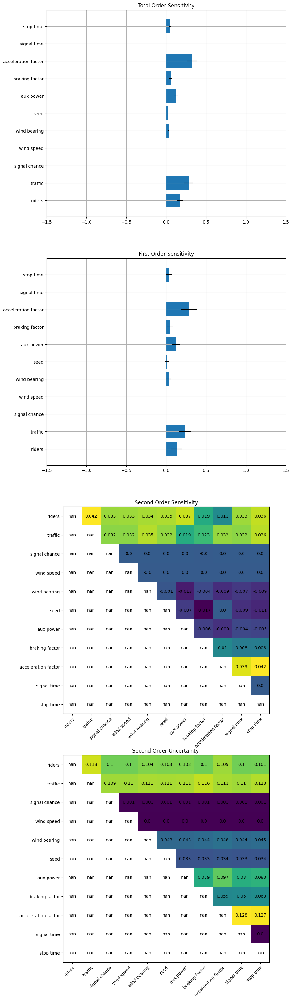

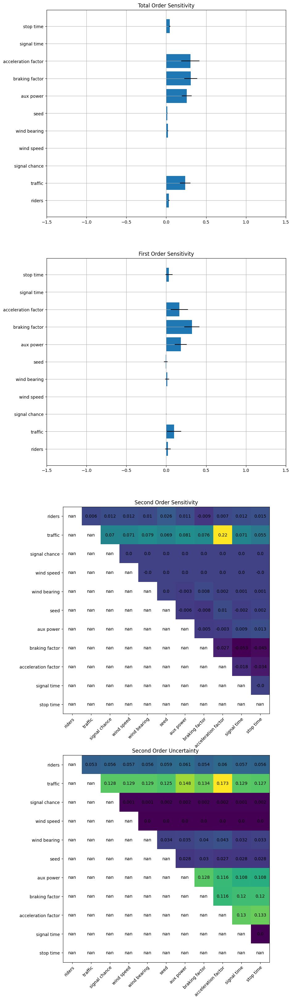

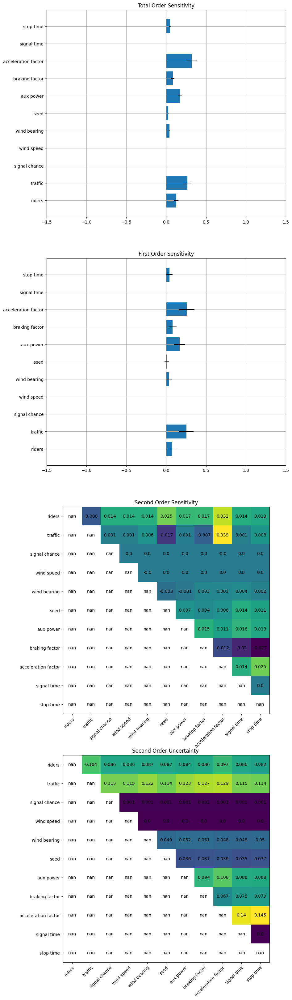

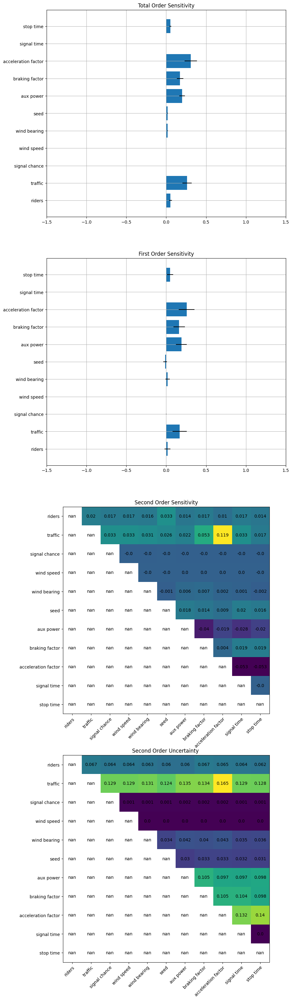

In [23]:
sens_analys = pd.DataFrame(results_dict)

sens_analys['plot'] = sens_analys.apply(lambda x: plot_sens(x), axis=1)

In [33]:
FO = dict(zip(problem['names'],Si['S1']))
FO = dict(sorted(FO.items(), key=lambda item: item[1]))
TO = dict(zip(problem['names'],Si['ST']))
TO = dict(sorted(TO.items(), key=lambda item: item[1]))
print("First Order Contribution:")
for key in FO.keys(): print("\t '{}': {},".format(key, FO[key]))
print("Total order Contribution:")
for key in TO.keys(): print("\t '{}': {},".format(key, TO[key]))
print("Second-Order Contribution:")
import itertools
combos = list(itertools.combinations(range(len(problem['names'])), 2))
combo_dict = {}
for entry in combos:
    key = "['{}' & '{}']".format(problem['names'][entry[0]], problem['names'][entry[1]])
    val = Si['S2'][entry[0],entry[1]]
    combo_dict[key]=val
combo_dict = dict(sorted(combo_dict.items(), key=lambda item: item[1]))
for key in combo_dict.keys(): print("\t '{}': {},".format(key, combo_dict[key]))

First Order Contribution:
	 'signal chance': -9.609405219480282e-06,
	 'wind speed': 0.0,
	 'signal time': 0.0,
	 'wind bearing': 0.01427293310595401,
	 'seed': 0.01575086395700029,
	 'riders': 0.029677610518286823,
	 'stop time': 0.056101588151491515,
	 'aux power': 0.15739217906267883,
	 'braking factor': 0.19286918533478414,
	 'traffic': 0.19457871508078886,
	 'acceleration factor': 0.22111989224339337,
Total order Contribution:
	 'wind speed': 0.0,
	 'signal time': 0.0,
	 'signal chance': 2.5415606528918476e-05,
	 'seed': 0.01368524839955075,
	 'wind bearing': 0.01931466822039986,
	 'riders': 0.04253986235114721,
	 'stop time': 0.05539192071692405,
	 'aux power': 0.1885954228181134,
	 'braking factor': 0.22220350497186522,
	 'traffic': 0.26057168480383885,
	 'acceleration factor': 0.29922603975625484,
Second-Order Contribution:
	 '['braking factor' & 'stop time']': -0.034733491540101684,
	 '['braking factor' & 'signal time']': -0.027749185557147282,
	 '['seed' & 'aux power']': -0.0

In [70]:
specific_runs = {"45":2, "8":1,"49":1,"70":6}
(available_routes.get_group(("49",)).reset_index(drop=True)).iloc[specific_runs["49"]:specific_runs["49"]+1]

,shortname,route_id,shape,direction,path,rider_dict,bus,ridership_min_max
1,49,100447,11049009,1,./KC_Example_Data/Saved_Routes/rt49_sh11049009...,"[{'AM': 32.92239766081872}, {'MID': 36.7933333...",./KC_Example_Data/Saved_Objects/Busses/XT40.txt,"(19.858311786252965, 49.076315789473675)"


In [84]:
np.arange(5, 15, 1).min()

5

#### Comparison Monte Carlo Sim

In [ ]:
r45 = gpd.read_file(routes['49'])[:-1][:]

DSM_rasters_list= gt.get_rasterfiles(dsm_raster_path)#+ "_reproject.tif"
DSM_rasters_list = DSM_rasters_list[DSM_rasters_list.apply(lambda x: 'reproject' in x) == False].reset_index(drop=True)
reprojected_DSMs = gt.reproject_rasterfiles(DSM_rasters_list, verbose=False)

r45 = r45[r45['Speed (m/s)'] != "NaN"]
r45['lat'] = r45['Latitude (°)'].apply(parsecoord)#.apply(lambda x: np.round(x, 5))
r45['lon'] = r45['Longitude (°)'].apply(parsecoord)#.apply(lambda x: np.round(x, 5))
#r45 = r45[r45['Distance (km)'].apply(parsecoord).diff()<.02]

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
r45roll = r45[gt.query_distance_traveled(r45.apply(lambda x: shapely.Point(x.lon, x.lat), axis=1).apply(lambda x: shapely.ops.transform(gt._flip, x)))*1000/r45['Time (s)'].apply(parsecoord).diff() <28]
r45roll = r45roll[['lat','lon','Time (s)']].rolling(10).mean()[10:]
r45roll['geometry']= r45roll.apply(lambda x: shapely.Point(x.lon, x.lat), axis=1)
r45roll = gpd.GeoDataFrame(r45roll)

r45roll.set_crs(epsg=4326)
r45roll['geodesic'] = gt.query_distance_traveled(r45roll['geometry'].apply(lambda x: shapely.ops.transform(gt._flip, x)))
r45roll['raster_elev'] = gt.query_elevation_series(r45roll['geometry'].apply(lambda x: shapely.ops.transform(gt._flip, x)), reprojected_DSMs)*0.3048
r45roll['raster_elev_2'] = pd.Series(gt.smooth_elevation(r45roll['raster_elev'],40,3))
r45roll['dy'] = r45roll['raster_elev_2'].diff()
r45roll['travel_dist'] = r45roll.apply(lambda x: np.sqrt(x['geodesic']**2 + x['dy']**2), axis=1)

r45roll['dt'] = r45roll['Time (s)'].diff()
r45roll['v'] = r45roll['travel_dist']/r45roll['dt']*1000
r45roll['x'] = r45roll['travel_dist'].cumsum()
r45roll['v2'] = r45roll['geodesic']/r45roll['dt']*1000
r45roll['geodesic']=(r45roll['geodesic'].cumsum()*1000)

r45roll = r45roll[r45roll['v2']<28]

fig, ax = plt.subplots(1, 1, figsize = (20, 4), dpi=100)
ax.plot((r45roll['geodesic']),r45roll["v"].apply(float))
ax.plot((r45roll['geodesic']),r45roll["v"].apply(float))
#ax.set_ylim(0, 26.8)
ax.set_xlabel("Geodesic Distance [m]")
ax.set_ylabel("Velocity [m/s]")
ax.legend(["Slope-included travel distance", "Geodesic travel distance"])
ax2 = ax.twinx()

plt.show()
r2 = 1 - (((r45roll["v"] - r45roll["v2"])**2).sum()  / ((r45roll["v2"] - r45roll["v2"].mean())**2).sum())
print("R^2 of travel distance velocity vs geodesic distance velocity: {}".format(r2))

#(r45['Speed (m/s)'].apply(parsecoord).diff()/r45['Time (s)'].apply(parsecoord).diff()).plot()
#r45[gt.query_distance_traveled(r45.apply(lambda x: shapely.Point(x.lon, x.lat), axis=1).apply(lambda x: shapely.ops.transform(gt._flip, x)))*1000/r45['Time (s)'].apply(parsecoord).diff() < 26]

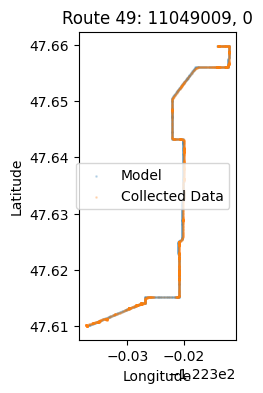

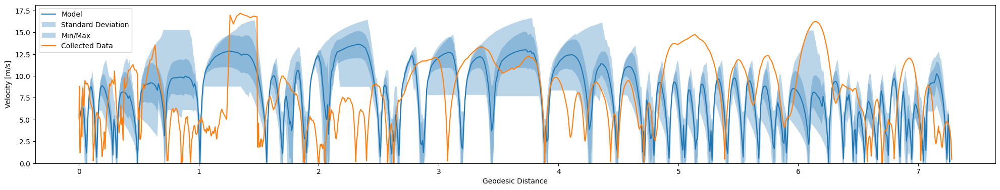

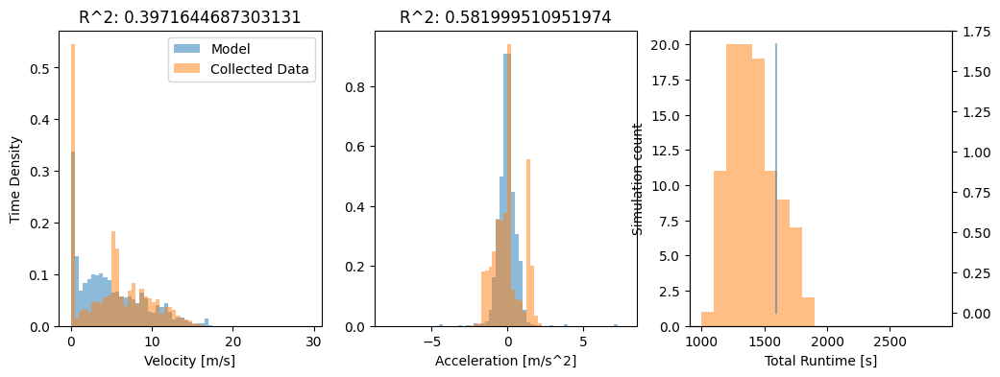

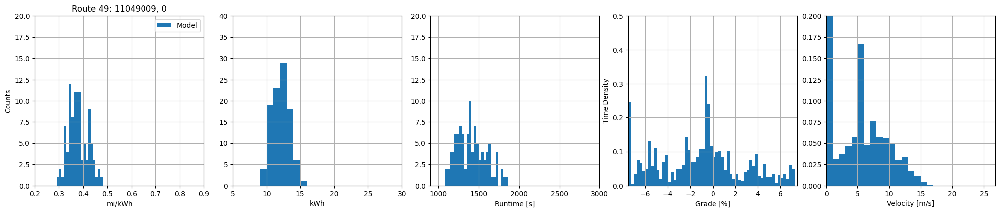

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(0.29410592347268666, 0.4713536310072783, 0.37822589436974846, 0.03993509656164539)
Energy min/max/mean/std [kWh]: 		(9.609638614827627, 15.401043271362088, 12.106476357409742, 1.2602443343638674)
Time min/max/mean/std [s]: 		(1091.6703441784434, 1844.5001938558642, 1410.5739585403521, 180.75684458199285)
|Grade| mean/std [%]: 			(2.8194526377708775, 2.1707562728057286)
Velocity mean/std [m/s]: 		(5.250332108574086, 4.02519538964431)
--------------------------------------------------------------------------------------------------



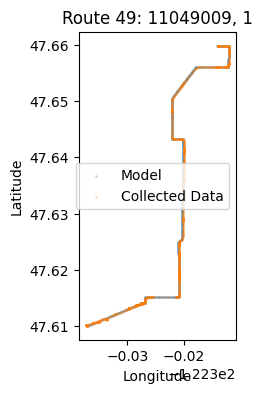

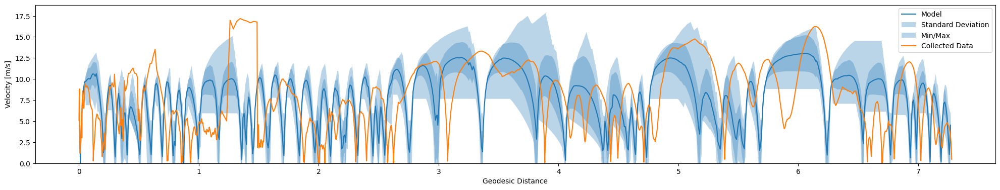

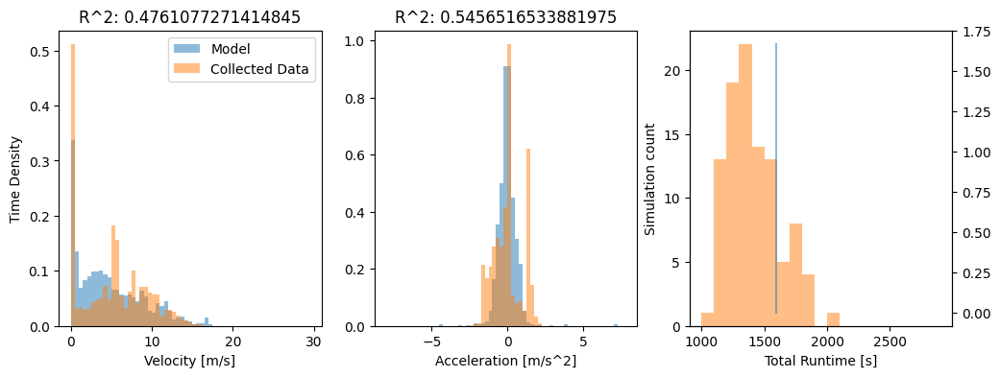

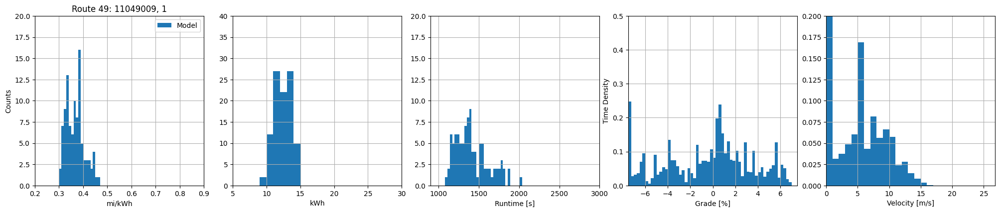

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(0.3037963992936757, 0.4677549360617071, 0.3673599272699014, 0.037743127337362466)
Energy min/max/mean/std [kWh]: 		(9.683608011859267, 14.909839145444279, 12.455094809228797, 1.237633800231949)
Time min/max/mean/std [s]: 		(1096.41453938742, 2016.4748049732605, 1413.9391022552963, 203.64637342338446)
|Grade| mean/std [%]: 			(2.8544580177577537, 2.0506458135125905)
Velocity mean/std [m/s]: 		(5.251048018465937, 3.9282931071539693)
--------------------------------------------------------------------------------------------------



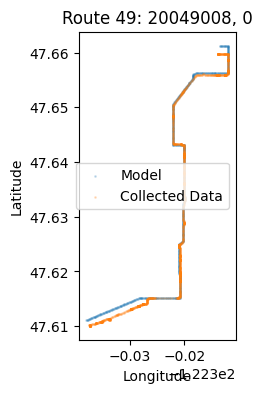

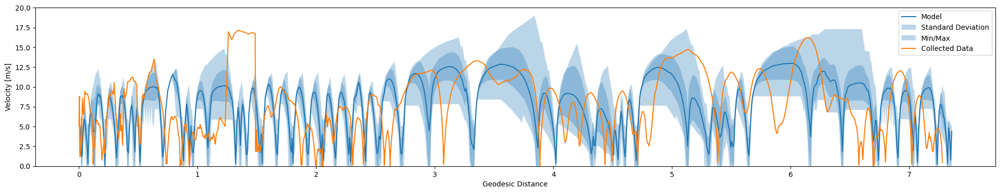

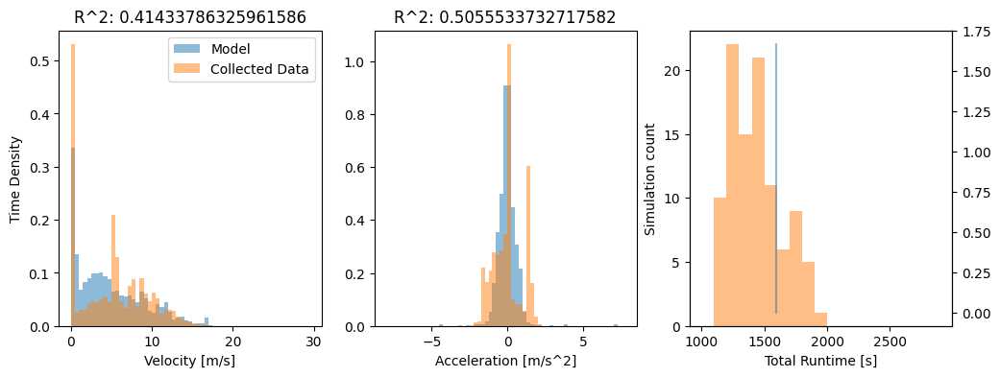

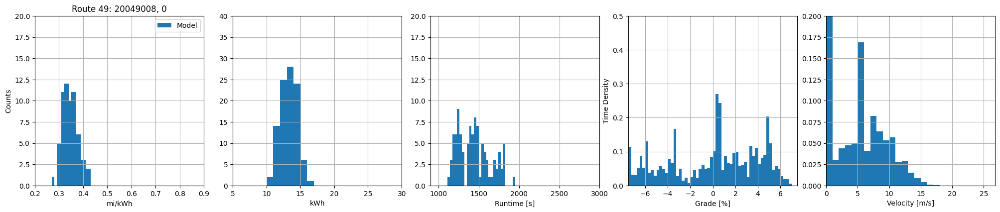

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(0.27998629643715434, 0.42528612944952465, 0.34667040506584335, 0.03177169091500262)
Energy min/max/mean/std [kWh]: 		(10.774893491602755, 16.366560815961854, 13.326451595413738, 1.1985504681652255)
Time min/max/mean/std [s]: 		(1132.5304192916894, 1930.7374803725693, 1440.2219419561047, 199.26916448713052)
|Grade| mean/std [%]: 			(3.1698804992131486, 2.0413705905306796)
Velocity mean/std [m/s]: 		(5.226832997124488, 3.977335345441198)
--------------------------------------------------------------------------------------------------



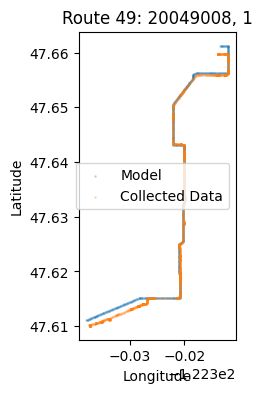

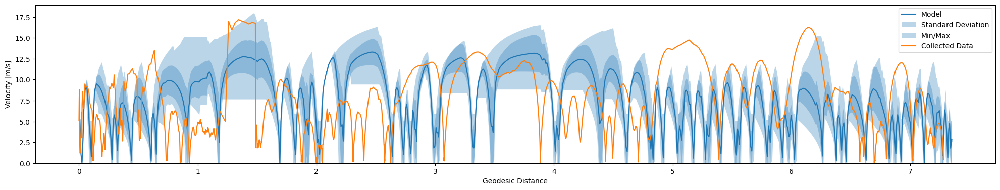

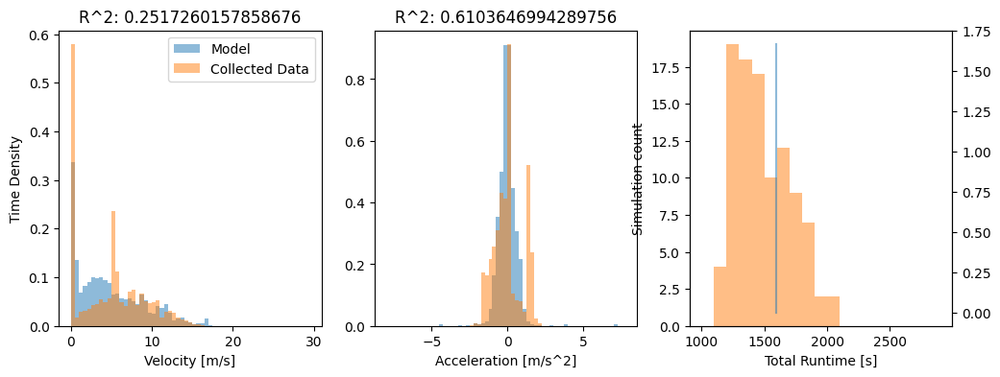

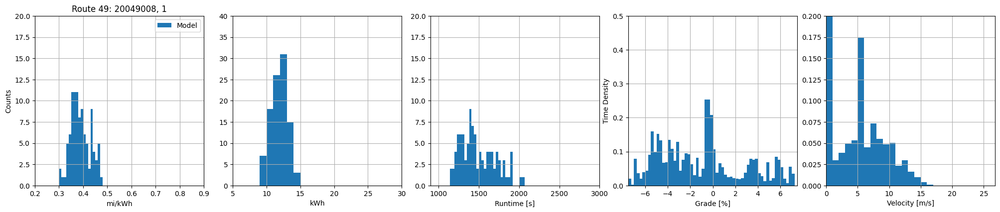

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(0.3063588662488019, 0.47269599959981545, 0.3890950890446916, 0.04005965872522046)
Energy min/max/mean/std [kWh]: 		(9.694702073324974, 14.958427492191683, 11.90057092442413, 1.2137722638207094)
Time min/max/mean/std [s]: 		(1146.6509103752633, 2061.496789067928, 1490.866676037013, 216.5626997597853)
|Grade| mean/std [%]: 			(3.176412654782189, 2.1055718214901558)
Velocity mean/std [m/s]: 		(5.034262068830474, 3.9760972666617036)
--------------------------------------------------------------------------------------------------



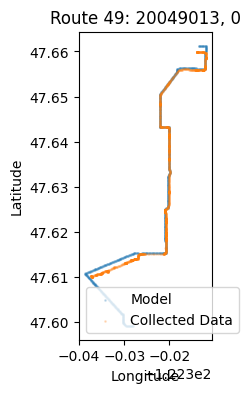

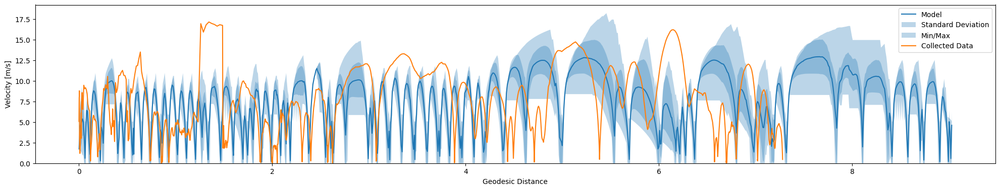

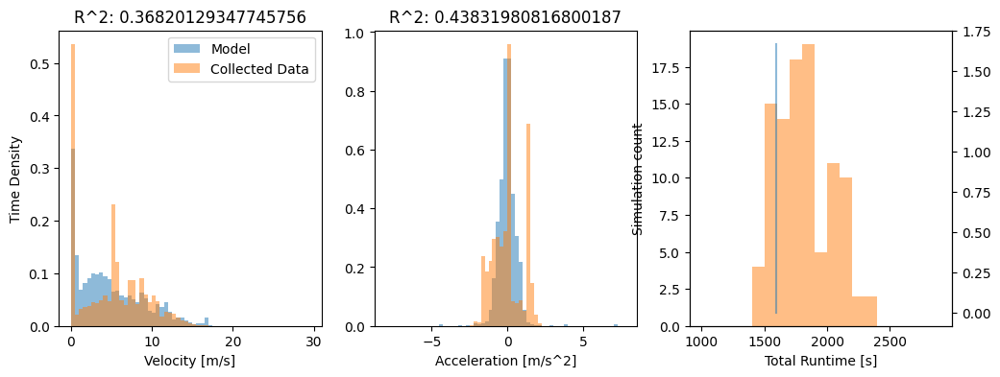

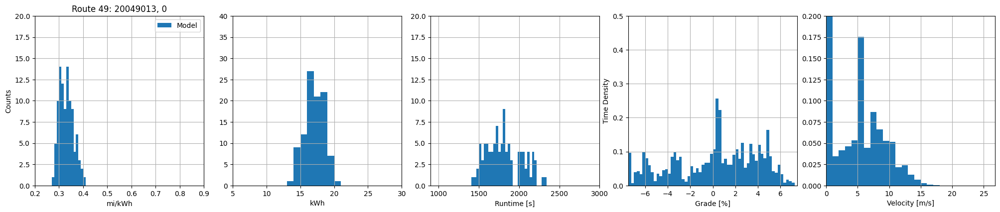

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(0.27623408788865433, 0.4034967816894407, 0.33046857719695777, 0.029511966490121378)
Energy min/max/mean/std [kWh]: 		(13.932191986325465, 20.350836029432106, 17.143153722169085, 1.5024401632897548)
Time min/max/mean/std [s]: 		(1429.031346816586, 2330.804461229796, 1814.2622123847211, 218.85710921395514)
|Grade| mean/std [%]: 			(2.999634156944379, 1.981279195109961)
Velocity mean/std [m/s]: 		(5.087834121377412, 3.846881760970861)
--------------------------------------------------------------------------------------------------



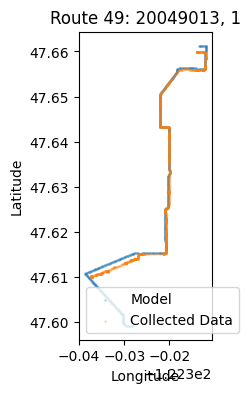

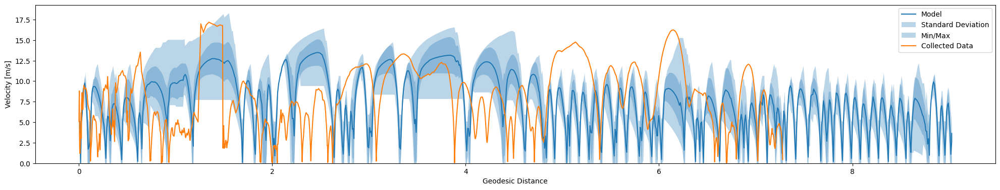

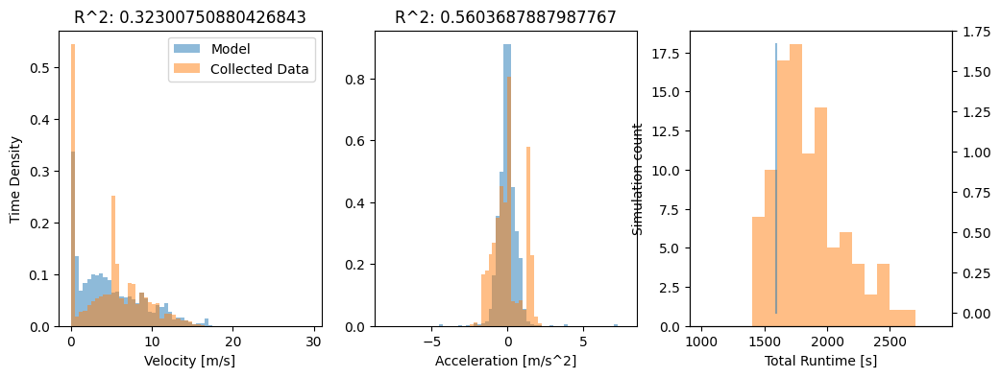

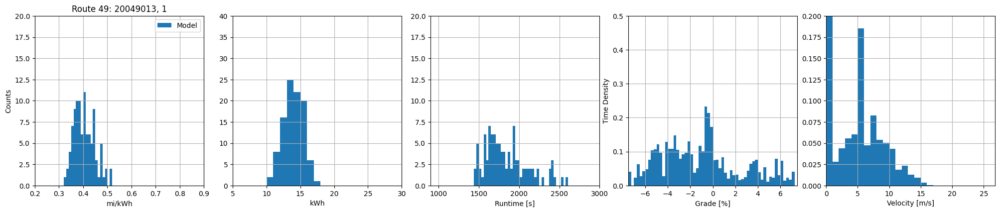

-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(0.32139369173439325, 0.5161126476939747, 0.40563088105228623, 0.04236171713110636)
Energy min/max/mean/std [kWh]: 		(10.89226680745785, 17.491434355942832, 14.005327346111017, 1.4257574136489688)
Time min/max/mean/std [s]: 		(1465.6233060616808, 2608.351131819399, 1849.2289413387518, 269.31260365090594)
|Grade| mean/std [%]: 			(3.0000356900583633, 2.0197689795740765)
Velocity mean/std [m/s]: 		(4.974616653231589, 3.798709581893884)
--------------------------------------------------------------------------------------------------



In [20]:
# Get the selected instances and plot against the 
mi_kwh_bins = np.arange(.2, .9, .01)
kwh_bins = np.arange(5, 30, 1)
volt_bins = np.arange(20, 50, .5)
time_bins = np.arange(15*60, 50*60, 30)
grade_bins = np.arange(-7.5, 7.5, .25)
vel_bins = np.arange(0, 30, .5)
for index, row in selected_route_instances[:].iterrows():
    # Plot the path --------------------------
    fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=100)
    gt.load_from_json(row.path).to_gdf().geometry.apply(lambda x: shapely.ops.transform(gt._flip, x)).plot(ax=ax, markersize=1, color="tab:blue", alpha = .2, zorder = 1)
    r45roll.plot(ax=ax, markersize = 1, color="tab:orange", alpha = .2, zorder = 5)
    ax.set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend(["Model", "Collected Data"])
    
    res = pd.DataFrame(row['results'])


    ddfs = res.apply(lambda x: gpd.GeoDataFrame([x['dt'],x['g'],x['vel'],x['dx'],x['geo']]).T[1:], axis=1)
    lddfs = pd.concat(list(ddfs))
    lddfs = gpd.GeoDataFrame(lddfs)
    lddfs = lddfs[lddfs['dt']!=0].reset_index(drop=True)
    sim = lddfs.groupby('geometry',sort=False).apply(lambda x: (x['dt'].mean(),
                                                     x['grade'].mean(),
                                                     x['v_f'].mean(),
                                                     x['gdx'].mean(),
                                                     x['v_f'].std(),
                                                     x['dt'].std(),
                                                     x['v_f'].min(),
                                                     x['v_f'].max(),
                                                     x['dt'].min(),
                                                     x['dt'].max()), include_groups=False)
    aggregated_sim = pd.DataFrame(sim)
    aggregated_sim['dt'],aggregated_sim['grade'],aggregated_sim['v_f'],aggregated_sim['gdx'],aggregated_sim['sv_f'],aggregated_sim['sdt'],aggregated_sim['mav'],aggregated_sim['miv'],aggregated_sim['mat'],aggregated_sim['mit'] = zip(*aggregated_sim[0])
    aggregated_sim['geometry'] = aggregated_sim.index
    aggregated_sim['gdx']=gt.query_distance_traveled(aggregated_sim['geometry']).cumsum()
    aggregated_sim=gpd.GeoDataFrame(aggregated_sim[['dt',
                                                    'grade',
                                                    'v_f',
                                                    'gdx',
                                                    'geometry',
                                                    'sv_f',
                                                    'sdt',
                                                    'mav',
                                                    'miv',
                                                    'mat',
                                                    'mit']].reset_index(drop=True))

    fig, ax = plt.subplots(1, 1, figsize=(20,4), dpi=100)
    plt.tight_layout(pad=2, w_pad=2, h_pad=2)
    ax.plot(aggregated_sim['gdx'], aggregated_sim['v_f'])
    ax.fill_between(aggregated_sim['gdx'], aggregated_sim['v_f']-aggregated_sim['sv_f'],aggregated_sim['v_f']+aggregated_sim['sv_f'],alpha=.3,zorder = .5)
    ax.fill_between(aggregated_sim['gdx'], aggregated_sim['miv'],aggregated_sim['mav'],alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")
    ax.plot(gt.query_distance_traveled(r45roll['geometry'].apply(lambda x: shapely.ops.transform(gt._flip, x))).cumsum(),r45roll['v'])
    ax.set_ylim(0)
    ax.legend(["Model", "Standard Deviation", "Min/Max", "Collected Data"])
    ax.set_xlabel("Geodesic Distance")
    ax.set_ylabel("Velocity [m/s]")
    plt.show()

    lmix = r45roll.sjoin_nearest(aggregated_sim, how="right")
    fig, ax = plt.subplots(1,3, figsize = (12, 4), dpi=100)
    vbins = np.arange(0, 30, .5)
    abins = np.arange(-8, 8, .25)
    tbins = np.arange(1000, 3000, 100)
    ct, bt, p = ax[0].hist(r45roll['v'], alpha=.5, weights=r45roll['dt'], density=True, bins=vbins)
    cm, bm, p = ax[0].hist(lddfs['v_f'], alpha=.5, weights=lddfs['dt'],density=True, bins=vbins)
    ax[0].get_yaxis().set_visible(False)
    
    v_r2 = rsq(ct, cm)
    ax[0].set_title("R^2: {}".format(v_r2))

    ct, bt, p = ax[1].hist(r45roll['v'].diff()/r45roll['dt'], alpha=.5, weights=r45roll['dt'], density=True, bins=abins)
    cm, bm, p = ax[1].hist(lddfs['v_f'].diff()/lddfs['dt'], alpha=.5, weights=lddfs['dt'],density=True, bins=abins)
    a_r2 = rsq(ct, cm)
    ax[1].set_title("R^2: {}".format(a_r2))
    ax[1].get_yaxis().set_visible(False)

    ax[2].twinx().plot([r45roll['dt'].sum()]*6,np.arange(0,2, 1/3),alpha=.5)
    cm, bm, p = ax[2].hist(ddfs.apply(lambda x: x['dt'].sum()),alpha=.5, bins=tbins, color="tab:orange")

    ax[0].legend(["Model", "Collected Data"])
    ax[0].set_xlabel("Velocity [m/s]")
    ax[1].set_xlabel("Acceleration [m/s^2]")
    ax[2].set_xlabel("Total Runtime [s]")
    ax[0].set_ylabel("Time Density")
    ax[2].set_ylabel("Simulation count")
    
    
    plt.show()

    # Plot the statistics ----------------
    fig, ax = plt.subplots(1, 5, figsize = (20,4), dpi=100)
    plt.tight_layout()



    milage = pd.Series(res['miles']/res['kwh'])
    mimin, mimax, mimean, mistd = milage.min(), milage.max(), milage.mean(), milage.std()
    ax[0].hist(milage, bins=mi_kwh_bins)
    ax[0].set_ylim(0, 20)
    ax[0].set_xlim(.2, .9)
    ax[0].set_xlabel("mi/kWh")
    ax[0].set_ylabel("Counts")
    ax[0].set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
    ax[0].grid()

    ax[1].hist(res['kwh'], bins=kwh_bins)
    enmin, enmax, enmean, enstd = res['kwh'].min(), res['kwh'].max(), res['kwh'].mean(), res['kwh'].std()
    ax[1].set_ylim(0, 40)
    ax[1].set_xlabel("kWh")
    ax[1].set_xlim(5, 30)
    ax[1].grid()

    ax[2].hist(res['tot_time'], bins=time_bins)
    tmin, tmax, tmean, tstd = res['tot_time'].min(), res['tot_time'].max(), res['tot_time'].mean(), res['tot_time'].std()
    ax[2].set_ylim(0, 20)
    ax[2].set_xlim(15*60, 50*60)
    ax[2].set_xlabel("Runtime [s]")
    ax[2].grid()
    ax[0].legend(["Model", "Collected Data"])


    t = pd.concat(list(res['dt'])).reset_index(drop=True)
    '''
    v = pd.concat(list(res['v'])).reset_index(drop=True)
    vvals, vbins, vbcon = ax[3].hist(v, bins=volt_bins, weights=t, density=True)
    ax[3].set_xlim(20, 50)
    ax[3].set_ylim(0, .2)
    ax[3].set_xlabel("Estimated Module Voltage, all runs [V]")
    ax[3].set_ylabel("Time Density")
    ax[3].grid()
    print("Voltage:\n\tmean: {}, std: {}".format(calculate_statistics_from_hist(vvals, vbins, vbcon)))
    '''
    #ax[1,0].axis('off')
    #ax[1,1].axis('off')
    #ax[1,2].axis('off')  

    g = pd.concat(list(res['g'])).reset_index(drop=True)
    gvals, gbins, gbcon = ax[4-1].hist(g.apply(abs), bins=grade_bins, weights=t, density=True, alpha = 0)
    ax[4-1].hist(g, bins=grade_bins, weights=t, density=True, color='tab:blue')
    #g.hist(ax=ax[4], bins=grade_bins, weights=t, density=True)
    ax[4-1].set_xlim(-7.5, 7.5)
    ax[4-1].set_ylim(0, .5)
    ax[4-1].set_xlabel("Grade [%]")
    ax[4-1].set_ylabel("Time Density")
    ax[4-1].grid()

    vel = pd.concat(list(res['vel'])).reset_index(drop=True)
    velvals, velbins, velbcon = ax[5-1].hist(vel, bins=vel_bins, weights=t, density=True)
    ax[5-1].set_xlim(0, 26.822)
    ax[5-1].set_ylim(0, .2)
    ax[5-1].set_xlabel("Velocity [m/s]")
    #ax[5-1].set_ylabel("Time Density")
    ax[5-1].grid()

    
    plt.show()
    '''
    print("Benchmark Velocity Mean: {} m/s, STD: {} m/s, min:  m/s, max: m/s".format((r45roll['v']).mean(), (r45roll['v']).std()))
    print("Model MSE: {}".format(((aggregated_sim['sv_f'] - aggregated_sim['v_f'])**2).mean()))
    r45mix['inrange'] = r45mix.apply(lambda x: x["v_f"]-x['std'] <= x["v"] <= x["v_f"]+x['std'], axis=1)
    trange = r45mix[r45mix['inrange']]['dt'].sum()[0]

    r45mix['inbounds'] = r45mix.apply(lambda x: x["min"] <= x["v"] <= x["max"], axis=1)
    tbounds = r45mix[r45mix['inbounds']]['dt'].sum()[0]

    r45mix['abounds'] = r45mix.apply(lambda x: x['max'] < x["v"] , axis=1)
    tabounds = r45mix[r45mix['abounds']]['dt'].sum()[0]

    r45mix['bbounds'] = r45mix.apply(lambda x: x['min'] > x["v"] , axis=1)
    tbbounds = r45mix[r45mix['bbounds']]['dt'].sum()[0]

'''

    #print("Time spent in : std: {} s, in bounds: {} s, above bounds {} s, below bounds {} s".format(trange, tbounds, tabounds, tbbounds))

    print("-------------------------------------------model statistics---------------------------------------")
    # Print the statistics
    print("Milage min/max/mean/std [mi/kWh]: \t{}".format((mimin, mimax, mimean, mistd)))
    print("Energy min/max/mean/std [kWh]: \t\t{}".format((enmin, enmax, enmean, enstd)))
    print("Time min/max/mean/std [s]: \t\t{}".format((tmin, tmax, tmean, tstd)))
    print("|Grade| mean/std [%]: \t\t\t{}".format(calculate_statistics_from_hist(gvals, gbins, gbcon)))
    print("Velocity mean/std [m/s]: \t\t{}".format(calculate_statistics_from_hist(velvals, velbins, velbcon)))

    print("--------------------------------------------------------------------------------------------------")
    print()

In [98]:
vel_bins = np.arange(0, 30, .5)
m_range = (-8, -1)
b_range = (8, .5)

end = {}
for route_shortname in list(routes.keys())[:]:
    print("-----------------------{}-------------------".format(route_shortname))
    selected_route_instances = available_routes.get_group((route_shortname,)).reset_index(drop=True)
    selected_route_instances['results'] = [[]]*len(selected_route_instances)
    current_route_index = specific_runs[route_shortname]
    current_route_instance = selected_route_instances.iloc[current_route_index]

    totalroll = []
    key = []
    for sample in routes[route_shortname]:
        roll = None
        if ".csv" in sample:
            roll = load_phone_log(drivepath, sample.split("/")[-1], sample.split("/")[-1].replace("p", 't'))
        else:
            roll = load_gps_log(sample)
        #ax[0, 0].plot(roll['gdx'].cumsum(), roll['v'])
        #ax[1,0].plot(roll['dt'].cumsum(), roll['v'])
        roll['a']=roll['v'].diff()/roll['dt']
        totalroll.append(roll)
        key.append(sample.split("/")[-1].split(".")[0])
    r45roll = pd.concat(totalroll)
        
    r45roll['geometry'] = r45roll['geometry'].apply(lambda x: shapely.ops.transform(gt._flip, x))
    r45roll = gpd.GeoDataFrame(r45roll)
    r45roll.set_crs(epsg=4326)
    bestmse = 9999
    lastmse=999
    current_route_index = 1
    current_route_instance = selected_route_instances.iloc[current_route_index]
    opt_resul = optimizefunc(runfunction, [current_route_instance.ridership_min_max,
                               traffic_min_max,
                               signal_min_max,
                               wind_speed_min_max,
                               wind_directions_min_max,
                               (0, 100),
                               p_aux_min_max,
                               b_factors,
                               a_factors,
                               (0, 200),
                               (0,200),
                               max_dist,
                               m_range, 
                               b_range])
    end[route_shortname]=opt_resul
print(end)

-----------------------45-------------------
|████████████████████████████████████████| 97/97 [100%] in 0.7s (133.39/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 1.5s (707.10/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 2.4s (443.10/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 1.2s (891.62/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 1.6s (654.41/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 18.3s (57.33/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 3.2s (326.57/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 1.8s (582.89/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 3.5s (296.15/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 2.9s (355.90/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 2.1s (502.32/s) 
|████████████████████████████████████████| 1047/1047 [100%] in 0.8s (1249.77/s)

on 565: /home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics_Core/Physics_Engine.py:461: RuntimeWarning: invalid value encountered in scalar divide
          dt = -(velocity - v_f) / ea_prof['net_a']
on 568: /home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics_Core/Physics_Engine.py:461: RuntimeWarning: invalid value encountered in scalar divide
          dt = -(velocity - v_f) / ea_prof['net_a']
on 574: /home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics_Core/Physics_Engine.py:461: RuntimeWarning: invalid value encountered in scalar divide
          dt = -(velocity - v_f) / ea_prof['net_a']
on 575: /home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRoute_Dynamics_Core/Physics_Engine.py:461: RuntimeWarning: invalid value encountered in scalar divide
          dt = -(velocity - v_f) / ea_prof['net_a']
on 576: /home/sebastian/Documents/GitHub/reRoute_Dynamics/Examples/../src/reRout

|████████████████████████████████████████| 960/960 [100%] in 1.8s (540.57/s) 
|████████████████████████████████████████| 960/960 [100%] in 2.1s (447.33/s) 
98 0.25460643749482303 0.606433427286404
|████████████████████████████████████████| 960/960 [100%] in 2.1s (461.10/s) 
|████████████████████████████████████████| 960/960 [100%] in 2.2s (436.07/s) 
99 0.25460643749482303 0.725165900003046
(0.39657202266436176, [41.84814936828117, 0.5435209421597224, 0.510459059947801, 7.856190933755679, 71.45542405854917, 59.0289329204077, 7613.3743670378035, 0.27481450294389426, 0.12906581795119698, 93.73863823442649, 87.08208526615911, 264.4512112667431, -3.5093316695298755, 5.209064168822837])
-----------------------8-------------------
|████████████████████████████████████████| 97/97 [100%] in 0.7s (143.60/s) 
|████████████████████████████████████████| 97/97 [100%] in 0.8s (124.07/s) 
|████████████████████████████████████████| 97/97 [100%] in 1.0s (101.59/s) 
|████████████████████████████████████

In [100]:
end = {'45': ('[48.7723188801841, 0.06725133692936326, 0.6245337790492177, 5.46423653434233, 181.1366152831659, 62.37454860370896, 7141.496426617871, 0.1775165165597588, 0.41503484365644233, 77.31433939151506, 105.96592138530545, 200]',0.04842168967426763),'8': ('[48.562365164792126, 0.07799195838071601, 0.36248255612912617, 8.000585490493103, 205.46218250839684, 47.77124734407716, 6333.700854522918, 0.24103963715993937, 0.1717791377034483, 77.23618591363169, 122.91995047926078, 245.94091462118473]', 0.11532016525529132),'49': ('[37.46700799119345, 0.17381576281499267, 0.48925932400105887, 7.260560360758692, 209.8150151177676, 64.84586835963071, 7027.892163316595, 0.22189247177329874, 0.29928651597924516, 58.3011222553984, 72.83081093871988, 230.3704166936511]',0.21830461036976034),'70': ('[40.480217534810706, 0.0, 0.2, 7.293082065739667, 181.1016560986853, 50.649889041183926, 6578.80230581471, 0.1, 0.0, 96.92466128643157, 117.55053658150393, 222.80487093243613]',0.1134774709766736)}

In [104]:
end

{'45': ('[20.258909522437225, 0.17088487405019817, 0.7261451124785891, 11.350443246724387, 45.04809677389737, 27.06703928640617, 7565.291543007712, 0.14192088336141687, 0.0015038102559408629, 77.29768024030025, 144.9802226133951, 160.45137495453125, -6.699460448882004, 3.649059028781789]',
  0.07861693930522384),
 '70': ('[41.33534737021588, 0.5521249538168427, 0.5035190717842455, 7.8353630848527756, 67.83975177052994, 60.632441301947935, 7738.734562266591, 0.24221017562060024, 0.14793863322374223, 92.86616725303081, 83.1326146518963, 262.708352876558, -3.709800900447199, 5.5274032046902954]',
  0.25460643749482303),
 '8': ('[54.422739956675734, 0.6462179319222717, 0.4834366103154843, 5.713966914063993, 131.74696607578306, 58.65007487006578, 6373.767138616104, 0.275569777146518, 0.18914038064372868, 89.25251231292538, 68.32708326537583, 277.92247901197413, -4.299503984289169, 4.7788543741347524]',
  0.16917220597079263),
 '49': ('[41.63607431954503, 0.3807354319557542, 0.57920344360441

-----------------------45-------------------
|████████████████████████████████████████| 97/97 [100%] in 0.6s (169.04/s) 
2893.0
|████████████████████████████████████████| 1585/1585 [100%] in 1.3s (1248.31/s) 
Model is 21.339583043615903 minutes away from reality.


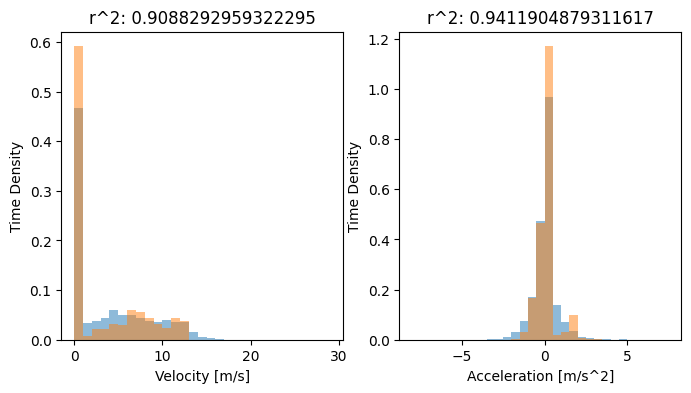

|████████████████████████████████████████| 1585/1585 [100%] in 1.3s (1245.53/s) 
-1.5550116932409264 48.85783406430409


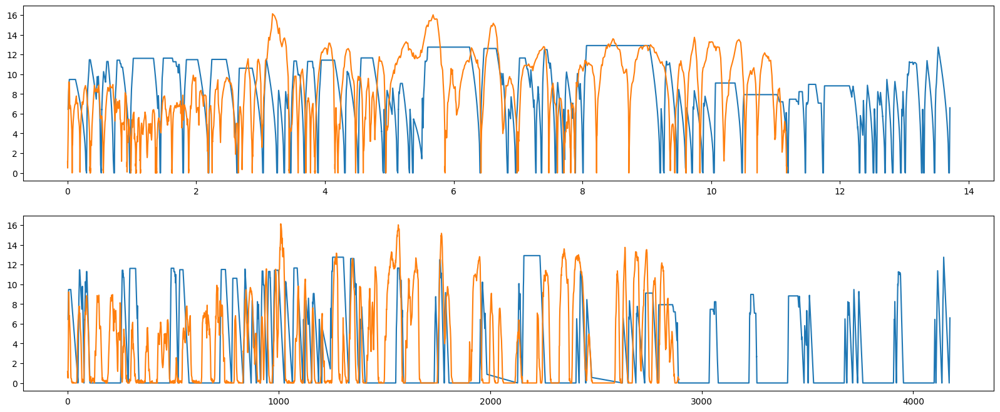

-----------------------------------
-----------------------70-------------------
|████████████████████████████████████████| 97/97 [100%] in 0.5s (201.37/s) 
|████████████████████████████████████████| 97/97 [100%] in 0.6s (175.17/s) 
|████████████████████████████████████████| 97/97 [100%] in 0.5s (195.30/s) 
6353.850337982178
|████████████████████████████████████████| 977/977 [100%] in 0.9s (1082.48/s) 
Model is -67.75235572066411 minutes away from reality.


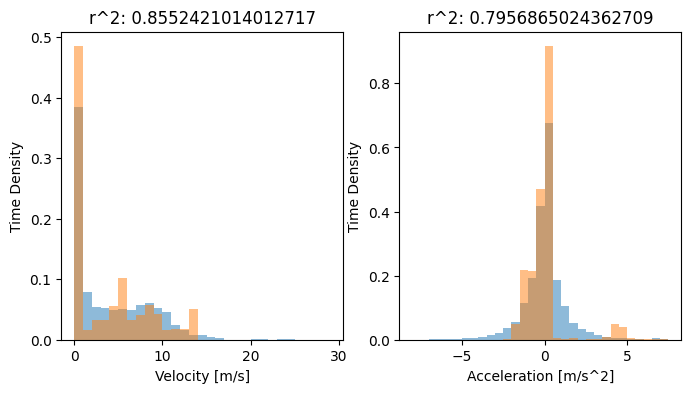

|████████████████████████████████████████| 977/977 [100%] in 0.9s (1084.63/s) 
-1.2104890195565683 54.23883147934092


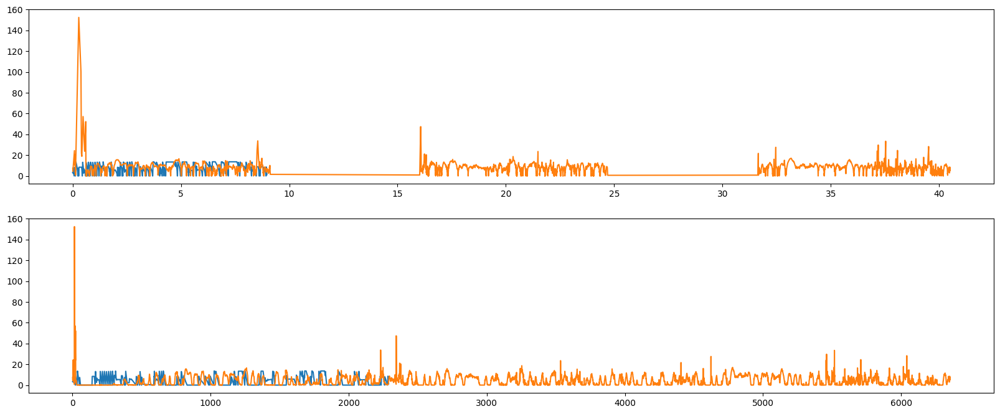

-----------------------------------
-----------------------8-------------------
|████████████████████████████████████████| 97/97 [100%] in 0.5s (182.86/s) 
|████████████████████████████████████████| 97/97 [100%] in 0.8s (127.77/s) 
|████████████████████████████████████████| 97/97 [100%] in 0.7s (147.38/s) 
8343.189867973328
|████████████████████████████████████████| 1354/1354 [100%] in 0.9s (1487.88/s) 
Model is -94.22682089716577 minutes away from reality.


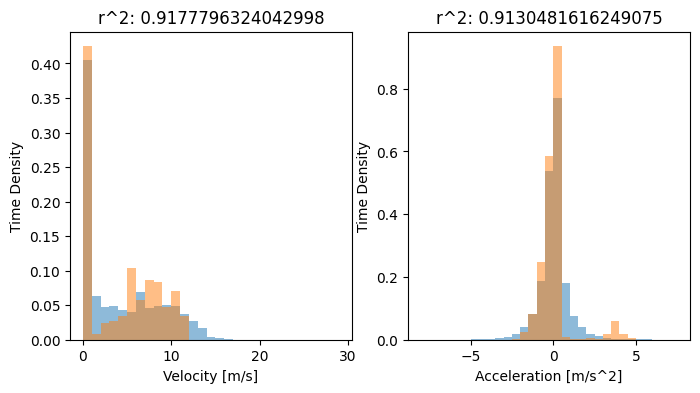

|████████████████████████████████████████| 1354/1354 [100%] in 0.9s (1474.57/s) 
-0.5020762608793339 27.522903461336018


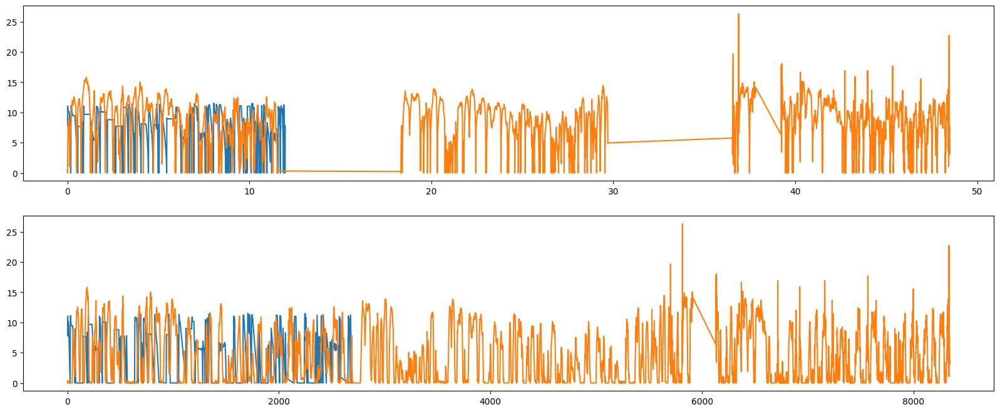

-----------------------------------
-----------------------49-------------------
|████████████████████████████████████████| 97/97 [100%] in 0.4s (268.62/s) 
|████████████████████████████████████████| 97/97 [100%] in 0.4s (217.90/s) 
3484.904515981674
|████████████████████████████████████████| 836/836 [100%] in 0.7s (1209.50/s) 
Model is -29.314086943688828 minutes away from reality.


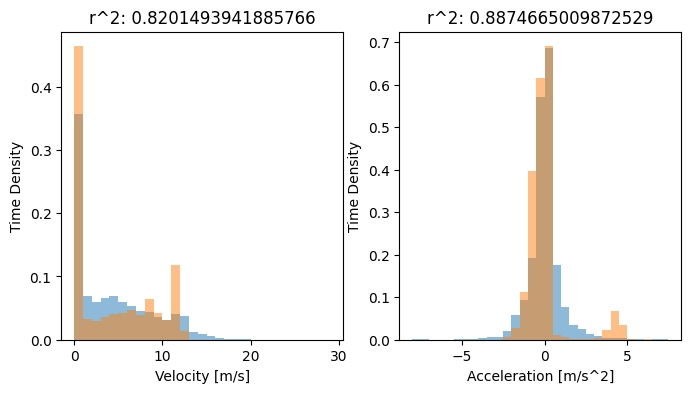

|████████████████████████████████████████| 836/836 [100%] in 0.7s (1148.45/s) 
-0.6422504599719638 32.59353561363774


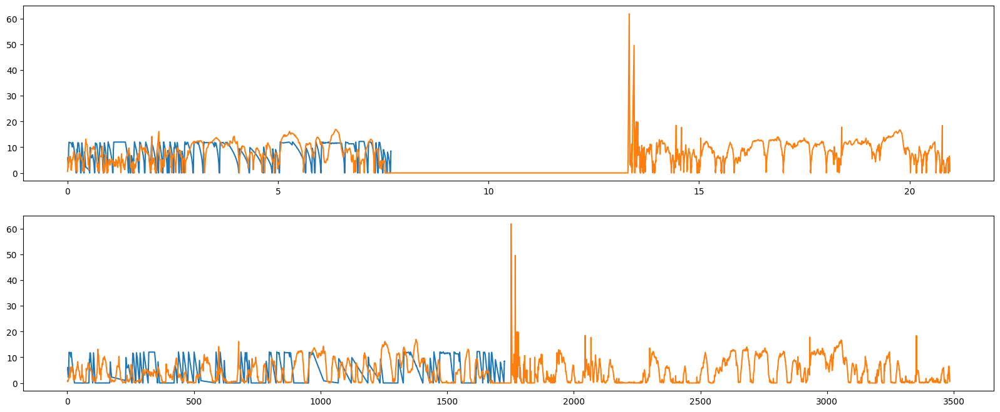

-----------------------------------


In [103]:
def runfunction_load(params):
    arg1, arg2,arg3,arg4,arg5,arg6,arg7,arg8,arg9,arg10,arg11,arg12,arg13,arg14 = params
    #print(params)
    print(r45roll['dt'].sum())
    route = gt.load_from_json(list(selected_route_instances.path)[current_route_index])
    bus = op.load_bus_params(current_route_instance.bus)
    trip = op.load_trip_params(trip_path)
    trip.m_riders = arg1
    trip.traffic = arg2
    trip.chance_sig = arg3
    trip.v_wind = arg4
    trip.wind_bearing = gt.compass_heading(arg5)
    trip.seed=arg6
    ess = op.load_ESS_params(ESS_path)
    ess.P_aux = arg7
    bus.f_br = arg8
    a_prof_path = "KC_Example_Data/Acceleration_Profiles/spitball.csv"
    op.generate_a_profile(a_prof_path, m=arg13, b=arg14)
    bus.a_prof = pd.read_csv(a_prof_path, header=None)
    bus.f_a = arg9
    trip.t_sig = arg10
    trip.t_stop = arg11
    bus.dmax = arg12
    
    res = process_result_list([ts.simulate_trip(route, trip, bus, ess)], ess).iloc[0]
    model_v = res['vel'][1:]
    model_dt = res['dt'][1:]

    #lmix = r45roll.sjoin_nearest(aggregated_sim, how="right")
    fig, ax = plt.subplots(1,2, figsize = (8, 4), dpi=100)
    vbins = np.arange(0, 30, 1)
    abins = np.arange(-8, 8, .5)
    tbins = np.arange(1000, 3000, 100)
    
    ct, bt, p = ax[0].hist(r45roll['v'], alpha=.5, weights=r45roll['dt'], density=True, bins=vbins)
    cm, bm, p = ax[0].hist(model_v, alpha=.5, weights=model_dt,density=True, bins=vbins)
    v_r2 = rsq(ct, cm)

    ct, bt, p = ax[1].hist(r45roll['v'].diff()/r45roll['dt'], alpha=.5, weights=r45roll['dt'], density=True, bins=abins)
    cm, bm, p = ax[1].hist(model_v.diff()/model_dt, alpha=.5, weights=model_dt,density=True, bins=abins)
    a_r2 = rsq(ct, cm)
    ax[0].set_title("r^2: {}".format(v_r2))
    ax[0].set_xlabel("Velocity [m/s]")
    ax[0].set_ylabel("Time Density")
    ax[1].set_title("r^2: {}".format(a_r2))
    ax[1].set_xlabel("Acceleration [m/s^2]")
    ax[1].set_ylabel("Time Density")
    print("Model is {} minutes away from reality.".format((model_dt.sum() - r45roll['dt'].sum())/60))
    plt.show()
            
    return a_r2*1 + v_r2*1
for route_shortname in list(routes.keys())[:]:
    print("-----------------------{}-------------------".format(route_shortname))
    selected_route_instances = available_routes.get_group((route_shortname,)).reset_index(drop=True)
    selected_route_instances['results'] = [[]]*len(selected_route_instances)
    current_route_index = specific_runs[route_shortname]
    current_route_instance = selected_route_instances.iloc[current_route_index]
    
    totalroll = []
    key = []
    for sample in routes[route_shortname]:
        roll = None
        if ".csv" in sample:
            roll = load_phone_log(drivepath, sample.split("/")[-1], sample.split("/")[-1].replace("p", 't'))
        else:
            roll = load_gps_log(sample)
        #ax[0, 0].plot(roll['gdx'].cumsum(), roll['v'])
        #ax[1,0].plot(roll['dt'].cumsum(), roll['v'])
        roll['a']=roll['v'].diff()/roll['dt']
        totalroll.append(roll)
        key.append(sample.split("/")[-1].split(".")[0])
    r45roll = pd.concat(totalroll)
    
    r45roll['geometry'] = r45roll['geometry'].apply(lambda x: shapely.ops.transform(gt._flip, x))
    r45roll = gpd.GeoDataFrame(r45roll)
    r45roll.set_crs(epsg=4326)
    opt_res = runfunction_load(ast.literal_eval(end[route_shortname][0]))
    opt_res = runfunction_load2(ast.literal_eval(end[route_shortname][0]))
    plt.show()
    print("-----------------------------------")
#opt_res = runfunction_load(([38.761466530022965, 0.32264864493686574, 0.33787105427933156, 0, 0, 0, 7151.819629519044, 0.2550711159719013, 0.3051104946837578, 65.86983033873084, 89.67771447263574]))
#opt_res = runfunction_load2([38.761466530022965, 0.32264864493686574, 0.33787105427933156, 0, 0, 0, 7151.819629519044, 0.2550711159719013, 0.3051104946837578, 65.86983033873084, 89.67771447263574])

In [ ]:
opt_resul[0]

In [102]:
def runfunction_load2(params):
    arg1, arg2,arg3,arg4,arg5,arg6,arg7,arg8,arg9,arg10,arg11,arg12,arg13,arg14 = params
    #print(params)
    route = gt.load_from_json(list(selected_route_instances.path)[current_route_index])
    bus = op.load_bus_params(current_route_instance.bus)
    trip = op.load_trip_params(trip_path)
    trip.m_riders = arg1
    trip.traffic = arg2
    trip.chance_sig = arg3
    trip.v_wind = arg4
    trip.wind_bearing = gt.compass_heading(arg5)
    trip.seed=arg6
    ess = op.load_ESS_params(ESS_path)
    ess.P_aux = arg7
    bus.f_br = arg8
    bus.f_a = arg9
    trip.t_sig = arg10
    trip.t_stop = arg11
    bus.dmax = arg12
    a_prof_path = "KC_Example_Data/Acceleration_Profiles/spitball.csv"
    op.generate_a_profile(a_prof_path, m=arg13, b=arg14)
    bus.a_prof = pd.read_csv(a_prof_path, header=None)
    res = process_result_list([ts.simulate_trip(route, trip, bus, ess)], ess).iloc[0]
    model_v = res['vel'][1:]
    model_dx = res['dx'][1:].cumsum()/1000
    fig, ax = plt.subplots(2,1, figsize = (20, 8), dpi=100)
    ax[0].plot(model_dx, model_v)
    
    ax[0].plot(gt.query_distance_traveled(r45roll['geometry'].apply(lambda x: shapely.ops.transform(gt._flip, x))).cumsum(), r45roll['v'])
    
    ax[1].plot(res['dt'][1:].cumsum(), model_v)
    
    ax[1].plot(r45roll['dt'].cumsum(), r45roll['v'])
    #print(res['geo'])
    model_dt = res['dt'][1:].cumsum()
    model_geo = res['geo'][1:].apply(lambda x: shapely.ops.transform(gt._flip, x))
    model = pd.DataFrame([model_v, model_dx, model_dt, model_geo]).T
    model.columns = ['m_v', 'm_gdx', 'm_dt', 'geometry']
    r45roll['t_dx'] = r45roll['gdx']
    r45roll['t_dt'] = r45roll['dt'].cumsum()
    
# combine the result and the benchmark data
    #print(len(model))
    #print(len(r45roll))
    mix = r45roll.sjoin_nearest(gpd.GeoDataFrame(model), how="left")

    #print(mix)
    '''
    # Get the indexes that are actually relevant
    index_matcher = (r45roll['dt'].cumsum()).apply(lambda x: (list((model['m_dt'].cumsum()-x).abs().sort_values().index)[0], list((model['m_dt'].cumsum()-x).abs().sort_values())[0]))
    data_indexes = list(index_matcher.index)
    index_matcher = list(index_matcher)
    index_matcher = pd.DataFrame(index_matcher)
    index_matcher['2'] = data_indexes
    
    # Filter out anything that is repeating an index
    pre_group = None
    with warnings.catch_warnings():
        warnings.simplefilter(action='ignore', category=DeprecationWarning)
        pre_group = pd.Series(index_matcher.groupby(0).apply(lambda x: list(x.sort_values(by=1).reset_index(drop=True).iloc[0]), include_groups=True))
    index_alignment_dict = dict(list(pre_group.apply(lambda x: (int(x[2]), int(x[0])))))
    for row, col in mix.iterrows():
        if row not in index_alignment_dict.keys():
            mix.at[row, 'm_gdx'] = 0
        else:
            print(mix.iloc[index_alignment_dict[row]])
    #mix.dropna(subset=['m_gdx'])
    '''
    #mix = mix.drop_duplicates(subset = ['m_gdx', 'm_dt'])
    
        # Get the r2 and MSE
    r2 = rsq(mix['v'], mix['m_v'])
    mseval = mse(mix['v'],mix['m_v'])
    t_mse=mse(mix['dt'].diff(), mix['t_dt'].diff())
    print(r2, mseval)
            
    return mix

#opt_res_t_sort = opt_res.sort_values("m_dt")
#ax[0].plot(opt_res['t_dx'], opt_res['v'])
#ax[0].plot(opt_res['m_gdx'].cumsum(), opt_res['m_v'])
#ax[1].plot(opt_res['t_dt'], opt_res['v'])
#ax[1].plot(opt_res_t_sort['m_dt'], opt_res_t_sort['m_v'])

In [ ]:
# After getting the mean position over 10 points, then filtering the dsm elevation with a savisky golay filter of 70, 3, the geodesic and travel distance velocities
# almost perfectly line up. 

In [114]:
v_list = np.asarray(res['geo'].apply(lambda x: np.asarray(x)))

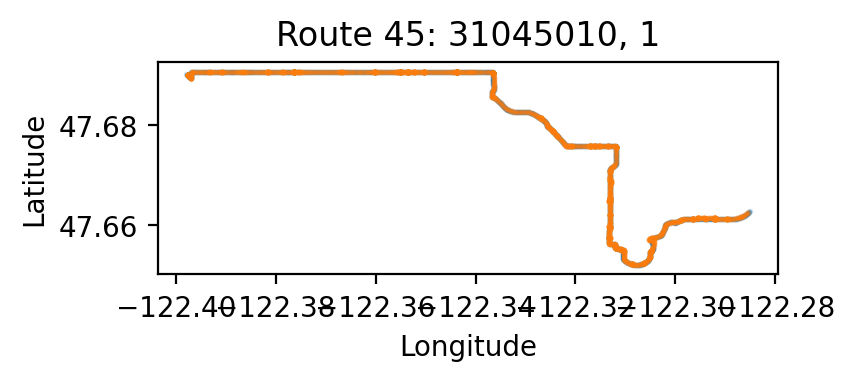

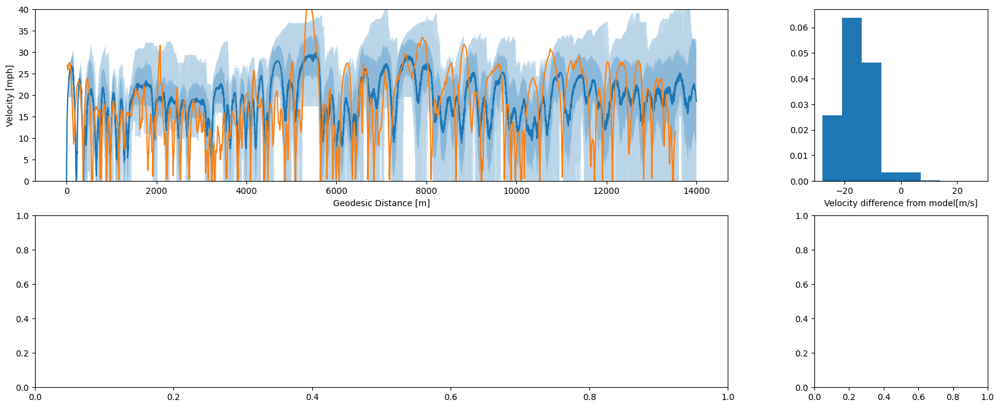

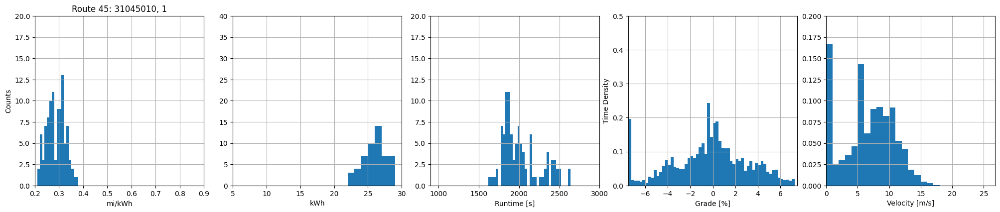

Benchmark Velocity Mean: 3.9188412973617637 m/s, STD: 3.9682464471831627 m/s, min:  m/s, max: m/s
Model MSE: 273.3996593040562
Time spent in : std: 102.00002179849957 s, in bounds: 2099.3649520056993 s, above bounds 1.9979890231000006 s, below bounds 1373.107639730601 s
-------------------------------------------model statistics---------------------------------------
Milage min/max/mean/std [mi/kWh]: 	(0.21751417982578716, 0.37150501900830385, 0.28732717492161536, 0.03734763984074167)
Energy min/max/mean/std [kWh]: 		(22.20316010809442, 37.92205834400562, 29.203596883474674, 3.889315102644838)
Time min/max/mean/std [s]: 		(1635.1955297065838, 2626.1111460946377, 2020.4694009174748, 234.8259225202119)
|Grade| mean/std [%]: 			(2.354462666916538, 1.853288433522828)
Velocity mean/std [m/s]: 		(6.618806296233689, 3.9644387716680374)
--------------------------------------------------------------------------------------------------



In [293]:
# Instance, Run No.
mi_kwh_bins = np.arange(.2, .9, .01)
kwh_bins = np.arange(5, 30, 1)
volt_bins = np.arange(20, 50, .5)
time_bins = np.arange(15*60, 50*60, 30)
grade_bins = np.arange(-7.5, 7.5, .25)
vel_bins = np.arange(0, 26.822, 1)
for index, row in selected_route_instances[3:4].iterrows():
    # Plot the path --------------------------
    fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
    gt.load_from_json(row.path).to_gdf().geometry.apply(lambda x: shapely.ops.transform(gt._flip, x)).plot(ax=ax, markersize=1, color="tab:blue", alpha = .2, zorder = 1)
    r45roll.plot(ax=ax, markersize = 1, color="tab:orange", alpha = .2, zorder = 5)
    ax.set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    
    res = pd.DataFrame(row['results'])
    # Plot the velocity and envelope -------------------
    #print(res.columns)
    v_list = list(res['vel'])
    x_list = list(res['dx'])
    t_list = list(res['dt'])
    
    frame_list = []
    for i in range(len(v_list[:])):
        indiv_frame = pd.DataFrame([v_list[i], x_list[i], t_list[i]]).T

        indiv_frame['dx']=indiv_frame['gdx'].cumsum()
        frame_list.append(indiv_frame)

    expected_v_frame = pd.concat(frame_list).reset_index(drop=True)
    #print(expected_v_frame.columns)
    expected_v_frame['v_f'] = expected_v_frame['v_f']*2.236
    expected_v_frame = expected_v_frame.sort_values('dx')
    v_means = expected_v_frame['v_f'].rolling(window=100).mean()
    v_max = expected_v_frame['v_f'].rolling(window=100).max()
    v_min = expected_v_frame['v_f'].rolling(window=100).min()
    x_means = expected_v_frame['dx'].rolling(window=100).mean()
    v_std = expected_v_frame['v_f'].rolling(window=100).std()
    t_means = expected_v_frame['dt'].rolling(window=100).mean()
    #print(t_means[100:400])
    
    
    fig, ax = plt.subplots(2, 2, figsize=(20, 8), dpi=100, width_ratios=[4,1])

    
    ax[0,0].plot(x_means, v_means, zorder=1)
    ax[0,0].fill_between(x_means, v_means-v_std,v_means+v_std,alpha=.3,zorder = .5)
    ax[0,0].fill_between(x_means, v_min,v_max,alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")
    
    #ax[0].plot(r45['geodesic'].cumsum()*1000,r45["Speed (m/s)"].apply(float)*2.236)
    ax[0,0].plot(r45roll['geodesic'],r45roll["v"].apply(float)*2.236)
    ax[0,0].set_ylim(0, 40)
    ax[0,0].set_xlabel("Geodesic Distance [m]")
    ax[0,0].set_ylabel("Velocity [mph]")
    evfr = expected_v_frame.rolling(window=100).mean()[100:].reset_index(drop=True)
    evfr['std'] = v_std[100:]
    evfr['min'] = v_min[100:]
    evfr['max'] = v_max[100:]
    
    # Use the geodesic distance and find the closest index in the evfr to turn into a dataframe that is then combined with the existing r45mix
    r45mix = pd.concat([r45roll, (r45roll['geodesic']).apply(lambda x: evfr.iloc[list((evfr['dx'].cumsum()-x).abs().sort_values().index)[0]])], axis=1)
    
    statbins = [4*round(-v_std.mean()),
                3*round(-v_std.mean()),
                2*round(-v_std.mean()), 
                round(-v_std.mean()),
                round(v_std.mean()),
                2*round(v_std.mean()),
                3*round(v_std.mean()),
               4*round(v_std.mean())]
    ax[0,1].hist(r45mix['v']-r45mix['v_f'], bins=statbins, density=True)
    ax[0,1].set_xlabel("Velocity difference from model[m/s]") # positive is an overapproximation, negative is underapproximating
    
    '''
    #-------
    ax[1,0].plot(t_means.cumsum()/60, v_means, zorder=1)
    ax[1,0].fill_between(t_means.cumsum()/60, v_means-v_std,v_means+v_std,alpha=.3,zorder = .5)
    ax[1,0].fill_between(t_means.cumsum()/60, v_min,v_max,alpha=.3,zorder = .2, color="tab:blue",edgecolor="None")
    
    #ax[0].plot(r45['geodesic'].cumsum()*1000,r45["Speed (m/s)"].apply(float)*2.236)
    ax[1,0].plot(r45roll['dt'].cumsum(),r45roll["v"].apply(float)*2.236)
    ax[1,0].set_ylim(0, 40)
    ax[1,0].set_xlabel("Time Elapsed [s]")
    ax[1,0].set_ylabel("Velocity [mph]")
    evfr = expected_v_frame.rolling(window=100).mean()[100:].reset_index(drop=True)
    evfr['std'] = v_std[100:]
    evfr['min'] = v_min[100:]
    evfr['max'] = v_max[100:]
    

    ax[1,1].hist(r45mix['v']-r45mix['v_f'], bins=statbins, density=True)
    ax[1,1].set_xlabel("Velocity difference from model[m/s]") # positive is an overapproximation, negative is underapproximating
    '''
    
    plt.show()
    
    # Plot the statistics ----------------
    fig, ax = plt.subplots(1, 5, figsize = (20,4), dpi=100)
    plt.tight_layout()
    
    
        
    milage = pd.Series(res['miles']/res['kwh'])
    mimin, mimax, mimean, mistd = milage.min(), milage.max(), milage.mean(), milage.std()
    ax[0].hist(milage, bins=mi_kwh_bins)
    ax[0].set_ylim(0, 20)
    ax[0].set_xlim(.2, .9)
    ax[0].set_xlabel("mi/kWh")
    ax[0].set_ylabel("Counts")
    ax[0].set_title("Route {}: {}, {}".format(row.shortname, row['shape'], row.direction))
    ax[0].grid()
    
    ax[1].hist(res['kwh'], bins=kwh_bins)
    enmin, enmax, enmean, enstd = res['kwh'].min(), res['kwh'].max(), res['kwh'].mean(), res['kwh'].std()
    ax[1].set_ylim(0, 40)
    ax[1].set_xlabel("kWh")
    ax[1].set_xlim(5, 30)
    ax[1].grid()
    
    ax[2].hist(res['tot_time'], bins=time_bins)
    tmin, tmax, tmean, tstd = res['tot_time'].min(), res['tot_time'].max(), res['tot_time'].mean(), res['tot_time'].std()
    ax[2].set_ylim(0, 20)
    ax[2].set_xlim(15*60, 50*60)
    ax[2].set_xlabel("Runtime [s]")
    ax[2].grid()


    t = pd.concat(list(res['dt'])).reset_index(drop=True)
    '''
    v = pd.concat(list(res['v'])).reset_index(drop=True)
    vvals, vbins, vbcon = ax[3].hist(v, bins=volt_bins, weights=t, density=True)
    ax[3].set_xlim(20, 50)
    ax[3].set_ylim(0, .2)
    ax[3].set_xlabel("Estimated Module Voltage, all runs [V]")
    ax[3].set_ylabel("Time Density")
    ax[3].grid()
    print("Voltage:\n\tmean: {}, std: {}".format(calculate_statistics_from_hist(vvals, vbins, vbcon)))
    '''
    #ax[1,0].axis('off')
    #ax[1,1].axis('off')
    #ax[1,2].axis('off')  
    
    g = pd.concat(list(res['g'])).reset_index(drop=True)
    gvals, gbins, gbcon = ax[4-1].hist(g.apply(abs), bins=grade_bins, weights=t, density=True, alpha = 0)
    ax[4-1].hist(g, bins=grade_bins, weights=t, density=True, color='tab:blue')
    #g.hist(ax=ax[4], bins=grade_bins, weights=t, density=True)
    ax[4-1].set_xlim(-7.5, 7.5)
    ax[4-1].set_ylim(0, .5)
    ax[4-1].set_xlabel("Grade [%]")
    ax[4-1].set_ylabel("Time Density")
    ax[4-1].grid()
    
    vel = pd.concat(list(res['vel'])).reset_index(drop=True)
    velvals, velbins, velbcon = ax[5-1].hist(vel, bins=vel_bins, weights=t, density=True)
    ax[5-1].set_xlim(0, 26.822)
    ax[5-1].set_ylim(0, .2)
    ax[5-1].set_xlabel("Velocity [m/s]")
    #ax[5-1].set_ylabel("Time Density")
    ax[5-1].grid()
    
    plt.show()
    print("Benchmark Velocity Mean: {} m/s, STD: {} m/s, min:  m/s, max: m/s".format((r45roll['v']).mean(), (r45roll['v']).std()))
    print("Model MSE: {}".format(((r45mix['v'] - r45mix['v_f'])**2).mean()))
    r45mix['inrange'] = r45mix.apply(lambda x: x["v_f"]-x['std'] <= x["v"] <= x["v_f"]+x['std'], axis=1)
    trange = r45mix[r45mix['inrange']]['dt'].sum()[0]
    
    r45mix['inbounds'] = r45mix.apply(lambda x: x["min"] <= x["v"] <= x["max"], axis=1)
    tbounds = r45mix[r45mix['inbounds']]['dt'].sum()[0]
    
    r45mix['abounds'] = r45mix.apply(lambda x: x['max'] < x["v"] , axis=1)
    tabounds = r45mix[r45mix['abounds']]['dt'].sum()[0]
    
    r45mix['bbounds'] = r45mix.apply(lambda x: x['min'] > x["v"] , axis=1)
    tbbounds = r45mix[r45mix['bbounds']]['dt'].sum()[0]
    
    
    
    print("Time spent in : std: {} s, in bounds: {} s, above bounds {} s, below bounds {} s".format(trange, tbounds, tabounds, tbbounds))
    
    print("-------------------------------------------model statistics---------------------------------------")
    # Print the statistics
    print("Milage min/max/mean/std [mi/kWh]: \t{}".format((mimin, mimax, mimean, mistd)))
    print("Energy min/max/mean/std [kWh]: \t\t{}".format((enmin, enmax, enmean, enstd)))
    print("Time min/max/mean/std [s]: \t\t{}".format((tmin, tmax, tmean, tstd)))
    print("|Grade| mean/std [%]: \t\t\t{}".format(calculate_statistics_from_hist(gvals, gbins, gbcon)))
    print("Velocity mean/std [m/s]: \t\t{}".format(calculate_statistics_from_hist(velvals, velbins, velbcon)))
    
    print("--------------------------------------------------------------------------------------------------")
    print()
    # >>> For calculating mean, std from bins:
    #https://stackoverflow.com/questions/50786699/how-to-calculate-the-standard-deviation-from-a-histogram-python-matplotlib

In [65]:
r45mix

,lat,lon,Time (s),geometry,geodesic,raster_elev,raster_elev_2,dy,travel_dist,dt,v,x,v2,t_dx,t_dt,v_f,gdx,dt,dx,std,min,max,inrange,inbounds,abounds,bbounds
10,47.662528,-122.285427,5.661994,POINT (-122.28543 47.66253),7.822187e-03,0.017953,0.020818,NaN,NaN,NaN,NaN,NaN,NaN,0.007822,NaN,1.475562,1.155143,0.455000,1.155143,2.182474,19.546748,28.490781,False,False,False,False
11,47.662473,-122.285490,6.565304,POINT (-122.28549 47.66247),1.089252e-02,0.018287,0.021135,3.178250e-04,1.089715e-02,0.903310,12.063581,0.010897,12.058449,0.018715,0.903310,2.270095,1.777143,0.700000,1.777143,3.267372,16.193250,28.933020,False,False,False,True
12,47.662396,-122.285580,7.564155,POINT (-122.28558 47.66240),1.156663e-02,0.018468,0.021458,3.224783e-04,1.157113e-02,0.998851,11.584436,0.022468,11.579936,0.030281,1.902161,2.951123,2.310285,0.910000,2.310285,2.081135,0.000000,13.428515,False,True,False,False
13,47.662315,-122.285677,8.562144,POINT (-122.28568 47.66231),1.200608e-02,0.018827,0.021783,3.249573e-04,1.201048e-02,0.997988,12.034687,0.034479,12.030281,0.042287,2.900149,3.405142,2.665714,1.050000,2.665714,5.218649,0.000000,11.350475,False,False,True,False
14,47.662233,-122.285781,9.559803,POINT (-122.28578 47.66223),1.223198e-02,0.019115,0.022108,3.252622e-04,1.223630e-02,0.997660,12.265006,0.046715,12.260672,0.054519,3.897809,3.972666,3.109999,1.225000,3.109999,1.006804,19.488166,24.493978,False,False,False,True
15,47.662151,-122.285891,10.557532,POINT (-122.28589 47.66215),1.232080e-02,0.019449,0.022431,3.233930e-04,1.232504e-02,0.997729,12.353095,0.059040,12.348842,0.066840,4.895538,4.313180,3.376571,1.330000,3.376571,2.739093,17.104170,26.492650,False,False,False,True
16,47.662071,-122.286003,11.555141,POINT (-122.28600 47.66207),1.216170e-02,0.019830,0.022751,3.193496e-04,1.216589e-02,0.997609,12.195050,0.071206,12.190847,0.079002,5.893147,4.767199,3.731999,1.470000,3.731999,3.570588,12.734103,24.966525,False,False,False,True
17,47.661993,-122.286117,12.555142,POINT (-122.28612 47.66199),1.193653e-02,0.020159,0.023064,3.131321e-04,1.194063e-02,1.000000,11.940627,0.083147,11.936520,0.090938,6.893148,5.107714,3.998571,1.575000,3.998571,3.069556,0.000000,15.542044,False,True,False,False
18,47.661920,-122.286233,13.555143,POINT (-122.28623 47.66192),1.132961e-02,0.020536,0.023369,3.047404e-04,1.133371e-02,1.000001,11.333698,0.094480,11.329601,0.102268,7.893148,5.334723,4.176285,1.645000,4.176285,0.010439,0.000000,0.079871,False,False,True,False
19,47.661852,-122.286345,14.555143,POINT (-122.28635 47.66185),9.691364e-03,0.020848,0.023663,2.941745e-04,9.695827e-03,1.000001,9.695819,0.104176,9.691355,0.111959,8.893149,5.675237,4.442856,1.750000,4.442856,4.887057,0.000000,18.770256,True,True,False,False


In [ ]:
importlib.reload(op)
runs= selected_route_instances.iloc[:]
results = {}
for col, run in runs.iterrows():
    
    bus = op.load_bus_params(run.bus)
    route = gt.load_from_json(run.path)
    trips = []
    esses= []
    shape = run['shape']
    for seed in seeds[:1]:
        random.seed(int(seed))
        trip = op.load_trip_params(trip_path)
        trip.m_riders = random.uniform(*row.ridership_min_max)
        trip.traffic = random.uniform(*traffic_min_max)
        trip.chance_sig = random.uniform(*signal_min_max)
        trip.v_wind = random.uniform(*wind_speed_min_max)
        trip.wind_bearing = gt.compass_heading(random.randrange(*wind_directions_min_max))
        trip.seed=int(seed)
        trips.append(trip)
        ess = op.load_ESS_params(ESS_path)
        ess.P_aux = random.randrange(*(p_aux_min_max + (500,)))
        ess.bus_S_P = (42,17)
        esses.append(ess)
    args = (route, trips[0], bus, esses[0])
    result = gpd.GeoDataFrame(ts.simulate_trip(*args))[1:]
    result = result.set_geometry('geometry').set_crs(epsg=4326)
    result.geometry = result.geometry.apply(lambda x: shapely.ops.transform(gt._flip, x))
    result['BP'] = result['P'].apply(lambda x: esses[0].calc_instance_power(x))
    result['Vm'] = result['BP'].apply(lambda x: esses[0].calc_voltage_simple(x))
    if shape in results.keys():
        results[shape].append(result)
    else:
        results[shape] = []
        results[shape].append(result)
    '''
    fig, ax = plt.subplots(4, 2, figsize = (17, 16), dpi=300, gridspec_kw={'width_ratios':[4, 1.2]})

    # Versus Geodesic Distance
    ax[0, 0].plot(result['gdx'].cumsum(), result['BP'], linewidth=1, zorder=5)
    ax[0,0].set_zorder(5)
    ax[0,0].set_facecolor("None")
    ax[0,0].set_xlabel("Geodesic Distance [meters]")
    ax[0,0].set_ylabel("ESS Load [Watts]")
    ax[0,0].set_ylim(-120000,400000)
    ax[0, 0].legend(["Load"])


    ax002 = ax[0,0].twinx()
    ax002.fill_between(result['cgdx'], result['elevation'], color='#BDBDBD', zorder=0)
    ax002.set_zorder(0)
    ax002.set_ylim(0, .160)
    ax002.set_ylabel("Elevation [km]")

    stops = result[result['dx_to_next']<.5]
    ax002.scatter(stops['cgdx'], stops['elevation'], c='tab:red')
    ax002.legend(["Elevation", "Stop"])

    ax[0, 1].hist(result['BP'], bins=np.arange(-120000, 400000, 10000), weights=result['dx'], density=True)
    ax[0, 1].set_xlabel("Load [W]")
    ax[0, 1].set_ylabel("Distance Density")

    # Versus Time
    ax[1, 0].plot(result['dt'].cumsum()/60, result['BP'], linewidth=1, zorder=5)
    ax[1,0].set_zorder(5)
    ax[1,0].set_facecolor("None")
    ax[1,0].set_xlabel("Elapsed Time [min]")
    ax[1,0].set_ylabel("ESS Load [Watts]")
    ax[1,0].set_ylim(-120000,400000)
    ax[1, 0].legend(["Load"])


    ax102 = ax[1,0].twinx()
    ax102.fill_between(result['cdt']/60, result['elevation'], color='#BDBDBD', zorder=0)
    ax102.set_zorder(0)
    ax102.set_ylim(0, .160)
    ax102.set_ylabel("Elevation [km]")

    ax102.scatter(stops['cdt']/60, stops['elevation'], c='tab:red')
    ax102.legend(["Elevation", "Stop"])

    ax[1, 1].hist(result['BP'], bins=np.arange(-120000, 400000, 10000), weights=result['dt'], density=True)
    ax[1, 1].set_xlabel("Load [W]")
    ax[1, 1].set_ylabel("Time Density")

    # Voltage and time
    ax[2,0].plot(result['dt'].cumsum()/60, result['Vm'], linewidth=1, zorder=5)
    ax[2,0].set_zorder(5)
    ax[2,0].set_facecolor("None")
    ax[2,0].set_xlabel("Elapsed Time [min]")
    ax[2,0].set_ylabel("Module Voltage [V]")
    ax[2,0].set_ylim(35,42)
    ax[2, 0].plot(result['dt'].cumsum()/60, [ess.V_cell*ess.module_S_P[0]]*len(result))
    ax[2, 0].legend(["Estimated Voltage", "Nominal"])

    ax202 = ax[2,0].twinx()
    ax202.fill_between(result['cdt']/60, result['elevation'], color='#BDBDBD', zorder=0)
    ax202.set_zorder(0)
    ax202.set_ylim(0, .160)
    ax202.set_ylabel("Elevation [km]")

    ax202.scatter(stops['cdt']/60, stops['elevation'], c='tab:red')
    ax202.legend(["Elevation", "Stop"])

    ax[2, 1].hist(result['Vm'], bins=np.arange(35, 42, .2), weights=result['dt'], density=True)
    ax[2, 1].set_xlabel("Voltage [V]")
    ax[2, 1].set_ylabel("Time Density")

    # Capacity
    ax[3, 0].plot(result['dt'].cumsum()/60, (result['dt']*(result['BP']/1000)).cumsum()/3600, linewidth=1)
    ax[3, 0].legend(["Energy Used"])
    ax[3,0].set_xlabel("Elapsed Time [min]")
    ax[3,0].set_ylabel("Energy [kWh]")

    ax302 = ax[3,0].twinx()
    ax302.plot(result['dt'].cumsum()/60, ((ess.bus_E_cap()/1000 - (result['dt']*(result['BP']/1000)).cumsum()/3600)/(ess.bus_E_cap()/1000)).clip(0)*100, linewidth=1, c="tab:orange")
    ax302.set_ylabel("SOC [%]")
    ax302.legend(['ESS SOC'])
    ax302.set_ylim(0, 100)


    plt.show()

    result.plot('cdt',  markersize = 3)
    '''
    #plt.show()
    
    
for shape_group in results:
    result = gpd.GeoDataFrame(pd.concat(results[shape_group], ignore_index=True), geometry='geometry')
    result['cdt'] = result['dt'].cumsum()
    result['cgdx'] = result['gdx'].cumsum()
    
    fig, ax = plt.subplots(4, 2, figsize = (17, 16), dpi=300, gridspec_kw={'width_ratios':[4, 1.2]})

    # Versus Geodesic Distance
    ax[0, 0].plot(result['gdx'].cumsum(), result['BP'], linewidth=1, zorder=5)
    ax[0,0].set_zorder(5)
    ax[0,0].set_facecolor("None")
    ax[0,0].set_xlabel("Geodesic Distance [meters]")
    ax[0,0].set_ylabel("ESS Load [Watts]")
    ax[0,0].set_ylim(-120000,400000)
    ax[0, 0].legend(["Load"])


    ax002 = ax[0,0].twinx()
    ax002.fill_between(result['cgdx'], result['elevation'], color='#BDBDBD', zorder=0)
    ax002.set_zorder(0)
    ax002.set_ylim(0, .160)
    ax002.set_ylabel("Elevation [km]")

    stops = result[result['dx_to_next']<.5]
    ax002.scatter(stops['cgdx'], stops['elevation'], c='tab:red')
    ax002.legend(["Elevation", "Stop"])

    ax[0, 1].hist(result['BP'], bins=np.arange(-120000, 400000, 10000), weights=result['dx'], density=True)
    ax[0, 1].set_xlabel("Load [W]")
    ax[0, 1].set_ylabel("Distance Density")

    # Versus Time
    ax[1, 0].plot(result['dt'].cumsum()/60, result['BP'], linewidth=1, zorder=5)
    ax[1,0].set_zorder(5)
    ax[1,0].set_facecolor("None")
    ax[1,0].set_xlabel("Elapsed Time [min]")
    ax[1,0].set_ylabel("ESS Load [Watts]")
    ax[1,0].set_ylim(-120000,400000)
    ax[1, 0].legend(["Load"])


    ax102 = ax[1,0].twinx()
    ax102.fill_between(result['cdt']/60, result['elevation'], color='#BDBDBD', zorder=0)
    ax102.set_zorder(0)
    ax102.set_ylim(0, .160)
    ax102.set_ylabel("Elevation [km]")

    ax102.scatter(stops['cdt']/60, stops['elevation'], c='tab:red')
    ax102.legend(["Elevation", "Stop"])

    ax[1, 1].hist(result['BP'], bins=np.arange(-120000, 400000, 10000), weights=result['dt'], density=True)
    ax[1, 1].set_xlabel("Load [W]")
    ax[1, 1].set_ylabel("Time Density")

    # Voltage and time
    ax[2,0].plot(result['dt'].cumsum()/60, result['Vm'], linewidth=1, zorder=5)
    ax[2,0].set_zorder(5)
    ax[2,0].set_facecolor("None")
    ax[2,0].set_xlabel("Elapsed Time [min]")
    ax[2,0].set_ylabel("Module Voltage [V]")
    ax[2,0].set_ylim(35,42)
    ax[2, 0].plot(result['dt'].cumsum()/60, [ess.V_cell*ess.module_S_P[0]]*len(result))
    ax[2, 0].legend(["Estimated Voltage", "Nominal"])

    ax202 = ax[2,0].twinx()
    ax202.fill_between(result['cdt']/60, result['elevation'], color='#BDBDBD', zorder=0)
    ax202.set_zorder(0)
    ax202.set_ylim(0, .160)
    ax202.set_ylabel("Elevation [km]")

    ax202.scatter(stops['cdt']/60, stops['elevation'], c='tab:red')
    ax202.legend(["Elevation", "Stop"])

    ax[2, 1].hist(result['Vm'], bins=np.arange(35, 42, .2), weights=result['dt'], density=True)
    ax[2, 1].set_xlabel("Voltage [V]")
    ax[2, 1].set_ylabel("Time Density")

    # Capacity
    ax[3, 0].plot(result['dt'].cumsum()/60, (result['dt']*(result['BP']/1000)).cumsum()/3600, linewidth=1)
    ax[3, 0].legend(["Energy Used"])
    ax[3,0].set_xlabel("Elapsed Time [min]")
    ax[3,0].set_ylabel("Energy [kWh]")

    ax302 = ax[3,0].twinx()
    ax302.plot(result['dt'].cumsum()/60, ((ess.bus_E_cap()/1000 - (result['dt']*(result['BP']/1000)).cumsum()/3600)/(ess.bus_E_cap()/1000)).clip(0)*100, linewidth=1, c="tab:orange")
    ax302.set_ylabel("SOC [%]")
    ax302.legend(['ESS SOC'])
    ax302.set_ylim(0, 100)

    #ax[grades]
    ax[3, 1].hist(result['grade'].apply(abs), bins=grade_bins, weights = result['dt'], density=True)
    ax[3,1].set_xlabel("Grade [%]")
    ax[3,1].set_ylabel("Time Density")

    plt.show()
    result.plot('cdt',  markersize = 3)
print(len(results))

In [ ]:
fig, ax = plt.subplots(4, 2, figsize = (17, 16), dpi=300, gridspec_kw={'width_ratios':[4, 1.2]})

# Versus Geodesic Distance
ax[0, 0].plot(result['gdx'].cumsum(), result['BP'], linewidth=1, zorder=5)
ax[0,0].set_zorder(5)
ax[0,0].set_facecolor("None")
ax[0,0].set_xlabel("Geodesic Distance [meters]")
ax[0,0].set_ylabel("ESS Load [Watts]")
ax[0,0].set_ylim(-120000,400000)
ax[0, 0].legend(["Load"])


ax002 = ax[0,0].twinx()
ax002.fill_between(result['cgdx'], result['elevation'], color='#BDBDBD', zorder=0)
ax002.set_zorder(0)
ax002.set_ylim(0, .160)
ax002.set_ylabel("Elevation [km]")

stops = result[result['dx_to_next']<.5]
ax002.scatter(stops['cgdx'], stops['elevation'], c='tab:red')
ax002.legend(["Elevation", "Stop"])

ax[0, 1].hist(result['BP'], bins=np.arange(-120000, 400000, 10000), weights=result['dx'], density=True)
ax[0, 1].set_xlabel("Load [W]")
ax[0, 1].set_ylabel("Distance Density")

# Versus Time
ax[1, 0].plot(result['dt'].cumsum()/60, result['BP'], linewidth=1, zorder=5)
ax[1,0].set_zorder(5)
ax[1,0].set_facecolor("None")
ax[1,0].set_xlabel("Elapsed Time [min]")
ax[1,0].set_ylabel("ESS Load [Watts]")
ax[1,0].set_ylim(-120000,400000)
ax[1, 0].legend(["Load"])


ax102 = ax[1,0].twinx()
ax102.fill_between(result['cdt']/60, result['elevation'], color='#BDBDBD', zorder=0)
ax102.set_zorder(0)
ax102.set_ylim(0, .160)
ax102.set_ylabel("Elevation [km]")

ax102.scatter(stops['cdt']/60, stops['elevation'], c='tab:red')
ax102.legend(["Elevation", "Stop"])

ax[1, 1].hist(result['BP'], bins=np.arange(-120000, 400000, 10000), weights=result['dt'], density=True)
ax[1, 1].set_xlabel("Load [W]")
ax[1, 1].set_ylabel("Time Density")

# Voltage and time
ax[2,0].plot(result['dt'].cumsum()/60, result['Vm'], linewidth=1, zorder=5)
ax[2,0].set_zorder(5)
ax[2,0].set_facecolor("None")
ax[2,0].set_xlabel("Elapsed Time [min]")
ax[2,0].set_ylabel("Module Voltage [V]")
ax[2,0].set_ylim(35,42)
ax[2, 0].plot(result['dt'].cumsum()/60, [ess.V_cell*ess.module_S_P[0]]*len(result))
ax[2, 0].legend(["Estimated Voltage", "Nominal"])

ax202 = ax[2,0].twinx()
ax202.fill_between(result['cdt']/60, result['elevation'], color='#BDBDBD', zorder=0)
ax202.set_zorder(0)
ax202.set_ylim(0, .160)
ax202.set_ylabel("Elevation [km]")

ax202.scatter(stops['cdt']/60, stops['elevation'], c='tab:red')
ax202.legend(["Elevation", "Stop"])

ax[2, 1].hist(result['Vm'], bins=np.arange(35, 42, .2), weights=result['dt'], density=True)
ax[2, 1].set_xlabel("Voltage [V]")
ax[2, 1].set_ylabel("Time Density")

# Capacity
ax[3, 0].plot(result['dt'].cumsum()/60, (result['dt']*(result['BP']/1000)).cumsum()/3600, linewidth=1)
ax[3, 0].legend(["Energy Used"])
ax[3,0].set_xlabel("Elapsed Time [min]")
ax[3,0].set_ylabel("Energy [kWh]")

ax302 = ax[3,0].twinx()
ax302.plot(result['dt'].cumsum()/60, ((ess.bus_E_cap()/1000 - (result['dt']*(result['BP']/1000)).cumsum()/3600)/(ess.bus_E_cap()/1000)).clip(0)*100, linewidth=1, c="tab:orange")
ax302.set_ylabel("SOC [%]")
ax302.legend(['ESS SOC'])
ax302.set_ylim(0, 100)


plt.show()

In [266]:
import shapely
import Geography_Tools as gt
import pandas as pd
import matplotlib.pyplot as plt
import KC_Query_Tools as kcqt
import datetime

timelog = pd.read_csv("timelog_6.csv")

id_filter = timelog[timelog['rt'] == selected_route_instances['route_id'][0]]
#id_filter['bus'] = id_filter['bus'].apply(lambda x: kcqt.bus_type_finder(x) if x != "block" else "NA")
bus_filter = id_filter[id_filter['bus'].isin(['XDE60'])].reset_index(drop=True)

rundata = str(bus_filter['1'][0])
datapoint_strings = pd.Series(rundata[1:-1].replace(")), ", "))|").replace("), (", ")^(").split("|"))
datetimes = datapoint_strings.apply(lambda x: datetime.datetime(*eval(x.split("^")[0][18:])))

geometry = datapoint_strings.apply(lambda x: shapely.Point(x.split("^")[1][1:-2].split(", ")))
dt = datetimes.diff().apply(lambda x: x.total_seconds() if x == x else 0)
geotimes = pd.DataFrame([geometry, dt]).T

geotimes.columns=["geometry", "dt"]
geotimes['pt'] = geotimes['geometry'].apply(lambda x: "{},{}".format(x.x, x.y))

geometry = pd.Series(geotimes.groupby("pt")['dt'].sum().keys())
dt = pd.Series(geotimes.groupby("pt")['dt'].sum().values)
geotimes = pd.DataFrame([geometry, dt]).T
geotimes.columns=["geometry", "dt"]

geotimes['geometry'] = geotimes['geometry'].apply(lambda x: shapely.Point(x.split(",")))
geotimes = gpd.GeoDataFrame(geotimes).set_crs(epsg=4326)

geotimes['dx'] = gt.query_distance_traveled(geotimes['geometry'])*1000
geotimes['geometry'] = geotimes['geometry'].apply(lambda x: shapely.ops.transform(gt._flip, x))

geotimes['dt'] = geotimes['dt'].shift(-1)
geotimes = geotimes[:-1]

geotimes['v'] = (geotimes['dx']/geotimes['dt']).apply(float) * 2.2369
geotimes['v'] = geotimes['v'].apply(lambda x: 60*(x>60) + x*(x<60))

geotimes['t'] = (geotimes['dt'].cumsum()/60).apply(float)

#fig, ax = plt.subplots(1, 1, figsize=(10, 4), dpi=300)
#ax.plot(geotimes['t'], geotimes['v'])

In [270]:
geotimes

,geometry,dt,dx,v,t
0,POINT (-122.32399 47.67818),20.891941,86.822797,9.296116,0.348199
1,POINT (-122.32461 47.67884),20.971234,66.073155,7.047704,0.697720
2,POINT (-122.32510 47.67933),10.470761,76.867401,16.421413,0.872232
3,POINT (-122.32571 47.67989),20.928551,185.328695,19.808431,1.221041
4,POINT (-122.32698 47.68132),31.389787,4.277987,0.304858,1.744205
5,POINT (-122.32703 47.68134),21.770065,400.539052,41.155863,2.107039
6,POINT (-122.33203 47.68259),10.46427,174.754896,37.356569,2.281443
7,POINT (-122.32970 47.68262),20.864192,328.344998,35.202654,2.629180
8,POINT (-122.33396 47.68330),20.923026,325.770863,34.828463,2.977897
9,POINT (-122.33667 47.68559),10.463642,3.835178,0.819878,3.152291


<Axes: >

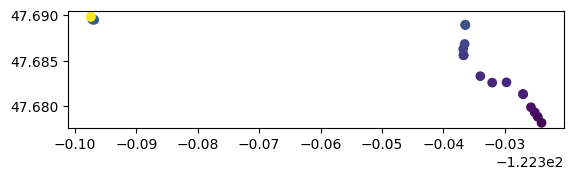

In [290]:
# Cleaning the data:
geotimes_trunc = geotimes[:20]
geotimes_trunc.plot('t')

In [291]:
geotimes_trunc

,geometry,dt,dx,v,t
0,POINT (-122.32399 47.67818),20.891941,86.822797,9.296116,0.348199
1,POINT (-122.32461 47.67884),20.971234,66.073155,7.047704,0.697720
2,POINT (-122.32510 47.67933),10.470761,76.867401,16.421413,0.872232
3,POINT (-122.32571 47.67989),20.928551,185.328695,19.808431,1.221041
4,POINT (-122.32698 47.68132),31.389787,4.277987,0.304858,1.744205
5,POINT (-122.32703 47.68134),21.770065,400.539052,41.155863,2.107039
6,POINT (-122.33203 47.68259),10.46427,174.754896,37.356569,2.281443
7,POINT (-122.32970 47.68262),20.864192,328.344998,35.202654,2.629180
8,POINT (-122.33396 47.68330),20.923026,325.770863,34.828463,2.977897
9,POINT (-122.33667 47.68559),10.463642,3.835178,0.819878,3.152291


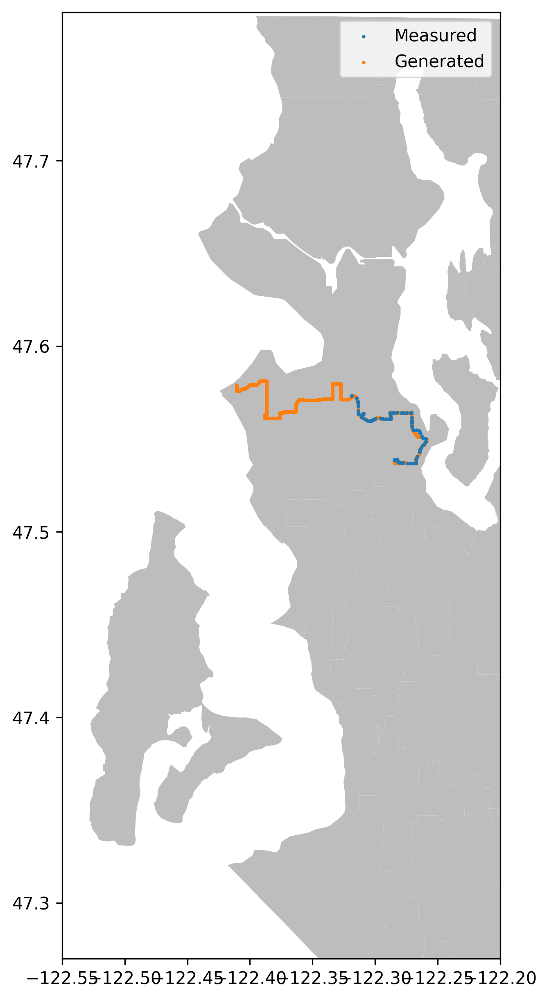

In [67]:
fig, ax = blank_kc_canvas()
gpd.GeoSeries(geometry.apply(lambda x: shapely.ops.transform(kqt._flip, x))).set_crs(epsg=4326).plot(ax=ax, zorder=5, markersize=1)
gpd.GeoSeries(gt.load_from_json(group['path'][idx]).geometry[:]).apply(lambda x: shapely.ops.transform(kqt._flip, x)).set_crs(epsg=4326).plot(ax=ax, markersize=1)
ax.set_xlim(-122.55, -122.2)
ax.set_ylim(47.27, 47.78)
ax.legend(['Measured','Generated'])

In [231]:
import KC_Route_Testing as kcrt
import importlib
import Physics_Engine as pe
import Trip_Simulator as ts
importlib.reload(pe)
importlib.reload(kcrt)
importlib.reload(ts)
importlib.reload(op)


val = xde35_routes.iloc[1:2].apply(lambda x: kcrt.run_trip(route_savepath + "rt1_sh11001003_d0.json", x.trip, x.bus, x.ESS, export_figures=True, seed_list=[1]), axis=1)

AttributeError: 'Series' object has no attribute 'trip'